<a href="https://colab.research.google.com/github/eceugru/Digital_Image_Processing/blob/main/DesenKodlama.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Ön İşleme
Hedeflenen nesneyi öne çıkaran ve haricini baskınlayan en iyi ön işlem adımları bulmak için 3 farklı pipline denenmiş ve pipline1 en iyi sonucu verdiği gözlemlenmiştir.
------------------------
pipline1: Normalizasyon -> Gaussian Filtre -> CLAHE -> Unsharing Masking

pipline2: Normalizasyon -> Bilateral Filtre -> CLAHE -> Gamma Düzeltme

pipline3: Normalizasyon -> Adaptive Median Filtre -> Histogram Eşitleme -> Unsharing Masking

Results for img2.png:
Pipeline 1 Score: 0.1158
Pipeline 2 Score: 0.1159
Pipeline 3 Score: 0.1484


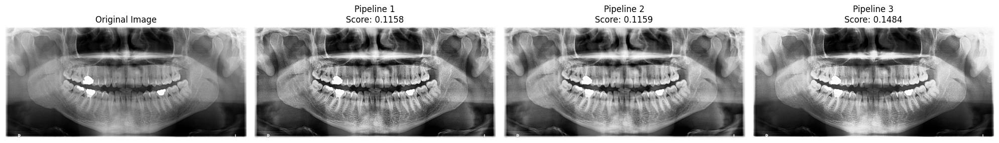

Results for img3.png:
Pipeline 1 Score: 0.1149
Pipeline 2 Score: 0.1156
Pipeline 3 Score: 0.1475


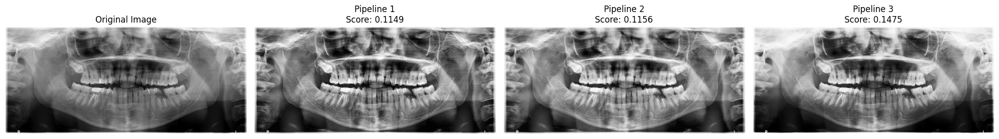

Results for img9.png:
Pipeline 1 Score: 0.1156
Pipeline 2 Score: 0.1156
Pipeline 3 Score: 0.1479


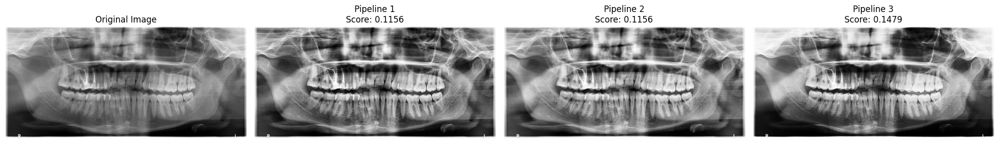

In [ ]:
import numpy as np
import cv2
from scipy.ndimage import gaussian_filter
import matplotlib.pyplot as plt
import pandas as pd

# Gaussian filtresi uygulanarak normalize edilmiş Luma değerlerini hesaplama
def compute_luminance_features(image):
    mu = gaussian_filter(image, sigma=1.5)
    mu_sq = mu * mu
    sigma = gaussian_filter(image**2, sigma=1.5) - mu_sq
    sigma = np.sqrt(np.abs(sigma))
    return mu, sigma

# DCT ile özellik çıkarma
def compute_dct_features(image):
    from skimage.util import view_as_windows
    blocks = view_as_windows(image, (8, 8), step=8)
    dct_features = []
    for block_row in blocks:
        for block in block_row:
            dct = cv2.dct(block.astype(np.float32))
            dct_features.append(dct.flatten())
    return np.array(dct_features)

# Skewness, Kurtosis gibi istatistikler hesaplama
def compute_statistics(features):
    from scipy.stats import kurtosis, skew
    stats = {
        'mean': np.mean(features, axis=0),
        'variance': np.var(features, axis=0),
        'skewness': skew(features, axis=0),
        'kurtosis': kurtosis(features, axis=0)
    }
    return stats

# BRISQUE'nin temel özelliklerini taklit eden bir fonksiyon
def calculate_brisque(image):
    image = image / 255.0
    mu, sigma = compute_luminance_features(image)
    dct_features = compute_dct_features(image)
    stats = compute_statistics(dct_features)
    score = np.mean(stats['mean']) + np.mean(stats['variance'])
    return score

# Gaussian Filtreleme
def apply_gaussian_filter(image, sigma=1):
    return gaussian_filter(image, sigma=sigma)

# Bilateral Filtreleme
def apply_bilateral_filter(image, diameter=9, sigma_color=75, sigma_space=75):
    return cv2.bilateralFilter(image, diameter, sigma_color, sigma_space)

# CLAHE uygulama
def apply_clahe(image):
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    return clahe.apply(image)

# Gamma Düzeltme
def apply_gamma_correction(image, gamma=1.2):
    inv_gamma = 1.0 / gamma
    table = np.array([(i / 255.0) ** inv_gamma * 255 for i in range(256)]).astype("uint8")
    return cv2.LUT(image, table)

# Keskinleştirme
def unsharp_mask(image):
    kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
    return cv2.filter2D(image, -1, kernel)

# Normalizasyon
def normalize_image(image):
    return (image - np.min(image)) / (np.max(image) - np.min(image)) * 255

# Pipeline 1: Normalizasyon -> Gaussian Filtre -> CLAHE -> Unsharp Masking
def pipeline_1(image):
    normalized = normalize_image(image)
    gaussian_filtered = apply_gaussian_filter(normalized)
    clahe_applied = apply_clahe(gaussian_filtered.astype(np.uint8))
    sharpened = unsharp_mask(clahe_applied)
    return sharpened

# Pipeline 2: Normalizasyon -> Bilateral Filtre -> CLAHE -> Gamma Düzeltme
def pipeline_2(image):
    normalized = normalize_image(image)
    bilateral_filtered = apply_bilateral_filter(normalized.astype(np.uint8))
    clahe_applied = apply_clahe(bilateral_filtered.astype(np.uint8))
    gamma_corrected = apply_gamma_correction(clahe_applied)
    return gamma_corrected

# Pipeline 3: Normalizasyon -> Adaptive Median Filtre -> Histogram Eşitleme -> Unsharp Masking
def pipeline_3(image):
    normalized = normalize_image(image)
    adaptive_median_filtered = cv2.medianBlur(normalized.astype(np.uint8), 3)
    histogram_equalized = cv2.equalizeHist(adaptive_median_filtered)
    sharpened = unsharp_mask(histogram_equalized)
    return sharpened

# Görüntüleri yükle ve işle
image_paths = ["img2.png", "img3.png", "img9.png"]

for image_path in image_paths:
    original_image = cv2.imread(image_path, 0)

    # Pipeline'ları uygula
    pipeline_1_image = pipeline_1(original_image)
    pipeline_2_image = pipeline_2(original_image)
    pipeline_3_image = pipeline_3(original_image)

    # BRISQUE skorlarını hesapla
    pipeline_1_score = calculate_brisque(pipeline_1_image)
    pipeline_2_score = calculate_brisque(pipeline_2_image)
    pipeline_3_score = calculate_brisque(pipeline_3_image)

    # Skorları çıktı olarak yazdır
    print(f"Results for {image_path}:")
    print(f"Pipeline 1 Score: {pipeline_1_score:.4f}")
    print(f"Pipeline 2 Score: {pipeline_2_score:.4f}")
    print(f"Pipeline 3 Score: {pipeline_3_score:.4f}")

    # Görselleri görselleştirme
    fig, axes = plt.subplots(1, 4, figsize=(20, 5))
    axes[0].imshow(original_image, cmap='gray')
    axes[0].set_title(f'Original Image')
    axes[0].axis('off')

    axes[1].imshow(pipeline_1_image, cmap='gray')
    axes[1].set_title(f'Pipeline 1\nScore: {pipeline_1_score:.4f}')
    axes[1].axis('off')

    axes[2].imshow(pipeline_2_image, cmap='gray')
    axes[2].set_title(f'Pipeline 2\nScore: {pipeline_2_score:.4f}')
    axes[2].axis('off')

    axes[3].imshow(pipeline_3_image, cmap='gray')
    axes[3].set_title(f'Pipeline 3\nScore: {pipeline_3_score:.4f}')
    axes[3].axis('off')

    plt.tight_layout()
    plt.show()


### Ön işleme uygulanmış görüntüler ile label'ların çarpılması

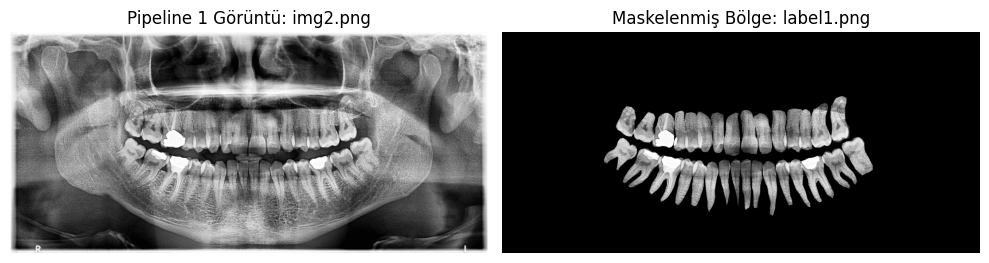

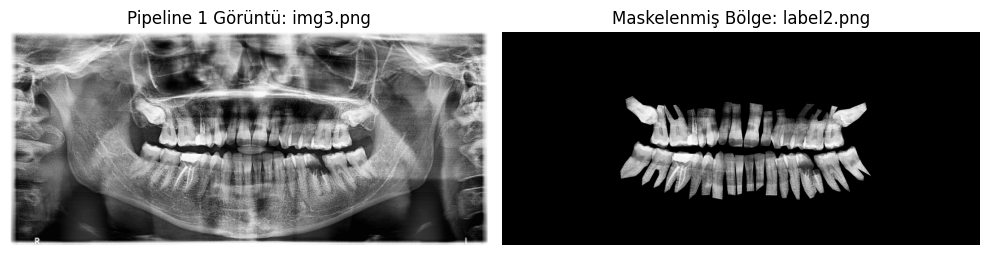

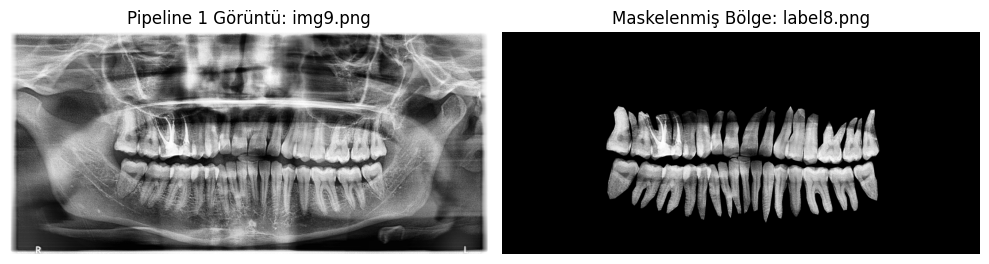

In [ ]:
import numpy as np
import cv2
from scipy.ndimage import gaussian_filter
import matplotlib.pyplot as plt
import pandas as pd

# Gaussian filtresi uygulanarak normalize edilmiş Luma değerlerini hesaplama
def compute_luminance_features(image):
    mu = gaussian_filter(image, sigma=1.5)
    mu_sq = mu * mu
    sigma = gaussian_filter(image**2, sigma=1.5) - mu_sq
    sigma = np.sqrt(np.abs(sigma))
    return mu, sigma

# DCT ile özellik çıkarma
def compute_dct_features(image):
    from skimage.util import view_as_windows
    blocks = view_as_windows(image, (8, 8), step=8)
    dct_features = []
    for block_row in blocks:
        for block in block_row:
            dct = cv2.dct(block.astype(np.float32))
            dct_features.append(dct.flatten())
    return np.array(dct_features)

# Skewness, Kurtosis gibi istatistikler hesaplama
def compute_statistics(features):
    from scipy.stats import kurtosis, skew
    stats = {
        'mean': np.mean(features, axis=0),
        'variance': np.var(features, axis=0),
        'skewness': skew(features, axis=0),
        'kurtosis': kurtosis(features, axis=0)
    }
    return stats

# BRISQUE'nin temel özelliklerini taklit eden bir fonksiyon
def calculate_brisque(image):
    image = image / 255.0
    mu, sigma = compute_luminance_features(image)
    dct_features = compute_dct_features(image)
    stats = compute_statistics(dct_features)
    score = np.mean(stats['mean']) + np.mean(stats['variance'])
    return score

# Gaussian Filtreleme
def apply_gaussian_filter(image, sigma=1):
    return gaussian_filter(image, sigma=sigma)

# Bilateral Filtreleme
def apply_bilateral_filter(image, diameter=9, sigma_color=75, sigma_space=75):
    return cv2.bilateralFilter(image, diameter, sigma_color, sigma_space)

# CLAHE uygulama
def apply_clahe(image):
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    return clahe.apply(image)

# Gamma Düzeltme
def apply_gamma_correction(image, gamma=1.2):
    inv_gamma = 1.0 / gamma
    table = np.array([(i / 255.0) ** inv_gamma * 255 for i in range(256)]).astype("uint8")
    return cv2.LUT(image, table)

# Keskinleştirme
def unsharp_mask(image):
    kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
    return cv2.filter2D(image, -1, kernel)

# Normalizasyon
def normalize_image(image):
    return (image - np.min(image)) / (np.max(image) - np.min(image)) * 255

# Pipeline 1: Normalizasyon -> Gaussian Filtre -> CLAHE -> Unsharp Masking
def pipeline_1(image):
    normalized = normalize_image(image)
    gaussian_filtered = apply_gaussian_filter(normalized)
    clahe_applied = apply_clahe(gaussian_filtered.astype(np.uint8))
    sharpened = unsharp_mask(clahe_applied)
    return sharpened

# Görüntüleri ve etiketleri yükle
image_label_pairs = [
    ("img2.png", "label1.png"),
    ("img3.png", "label2.png"),
    ("img9.png", "label8.png")
]

for image_path, label_path in image_label_pairs:
    # Görüntüyü yükle
    original_image = cv2.imread(image_path, 0)

    # Pipeline 1'i uygula
    pipeline_1_image = pipeline_1(original_image)

    # Maskeyi yükle
    mask = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)

    # Maskeyi boyutlandır ve türünü kontrol et
    resized_mask = cv2.resize(mask, (pipeline_1_image.shape[1], pipeline_1_image.shape[0]))
    resized_mask = resized_mask.astype(np.uint8)

    # Maskeyle işlenmiş görüntüyü çarp
    masked_region = cv2.bitwise_and(pipeline_1_image, pipeline_1_image, mask=resized_mask)

    # Görselleştir
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.title(f"Pipeline 1 Görüntü: {image_path}")
    plt.imshow(pipeline_1_image, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title(f"Maskelenmiş Bölge: {label_path}")
    plt.imshow(masked_region, cmap='gray')
    plt.axis('off')

    plt.tight_layout()
    plt.show()


Sıft ile anahtar noktaların bulunması

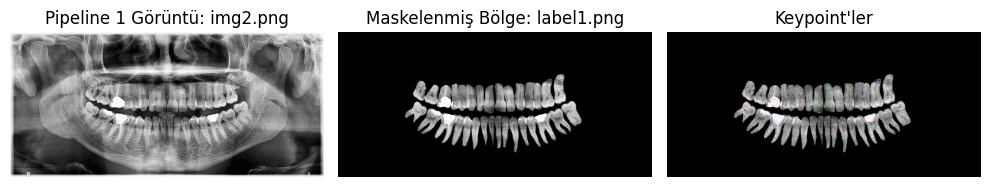

img2.png için keypoint sayısı: 12636


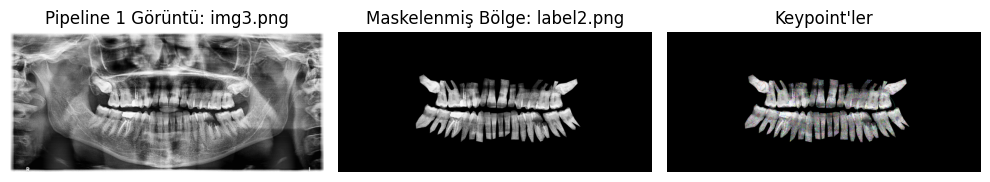

img3.png için keypoint sayısı: 5354


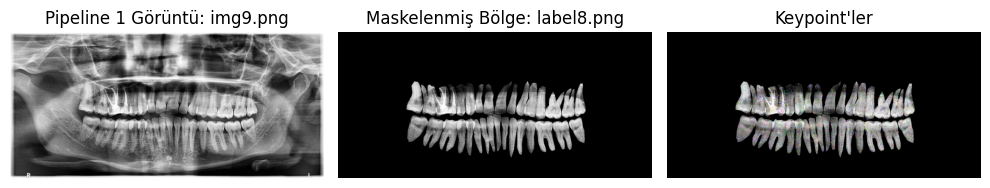

img9.png için keypoint sayısı: 7540


In [ ]:
import numpy as np
import cv2
from scipy.ndimage import gaussian_filter
import matplotlib.pyplot as plt

# Görüntü ön işleme adımları
def normalize_image(image):
    return ((image - np.min(image)) / (np.max(image) - np.min(image)) * 255).astype(np.uint8)

def apply_gaussian_filter(image, sigma=1):
    return gaussian_filter(image, sigma=sigma)

def apply_clahe(image):
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    return clahe.apply(image)

def unsharp_mask(image):
    kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
    return cv2.filter2D(image, -1, kernel)

# Pipeline 1
def pipeline_1(image):
    normalized = normalize_image(image)
    gaussian_filtered = apply_gaussian_filter(normalized)
    clahe_applied = apply_clahe(gaussian_filtered.astype(np.uint8))
    sharpened = unsharp_mask(clahe_applied)
    return sharpened

# Maskeli bölgeye keypoint tespiti ve HoG çıkarımı
def process_with_mask(image, mask):
    sift = cv2.SIFT_create()
    keypoints, descriptors = sift.detectAndCompute(image, None)

    # Diş üzerinde olup olmadığını kontrol et
    valid_keypoints = []
    for kp in keypoints:
        x, y = int(kp.pt[0]), int(kp.pt[1])  # Keypoint koordinatları
        if mask[y, x] > 0:  # Maske üzerindeyse
            valid_keypoints.append(kp)

    return valid_keypoints

# Görüntüleri ve etiketleri yükle
image_label_pairs = [
    ("img2.png", "label1.png"),
    ("img3.png", "label2.png"),
    ("img9.png", "label8.png")
]

for image_path, label_path in image_label_pairs:
    # Görüntüyü yükle
    original_image = cv2.imread(image_path, 0)

    # Pipeline 1'i uygula
    pipeline_1_image = pipeline_1(original_image)

    # Maskeyi yükle ve yeniden boyutlandır
    mask = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)
    resized_mask = cv2.resize(mask, (pipeline_1_image.shape[1], pipeline_1_image.shape[0]))
    resized_mask = resized_mask.astype(np.uint8)

    # Maskeyle işlenmiş görüntüyü çarp
    masked_region = cv2.bitwise_and(pipeline_1_image, pipeline_1_image, mask=resized_mask)

    # Keypoint'leri bul ve görselleştir
    valid_keypoints = process_with_mask(masked_region, resized_mask)
    keypoint_image = cv2.drawKeypoints(masked_region, valid_keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

    # Görselleştir
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 3, 1)
    plt.title(f"Pipeline 1 Görüntü: {image_path}")
    plt.imshow(pipeline_1_image, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.title(f"Maskelenmiş Bölge: {label_path}")
    plt.imshow(masked_region, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.title(f"Keypoint'ler")
    plt.imshow(keypoint_image, cmap='gray')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

    print(f"{image_path} için keypoint sayısı: {len(valid_keypoints)}")


### SIFT+HOG
Maskelenmiş bölgelerde SIFT ile anahtar noktalar dişlerin üzerinde olavak şekilde bulunur ve bu anahtar noktalardan alınacak patchler HOG ile kodlanır.

In [ ]:
import numpy as np
import cv2
import pickle
from skimage.feature import hog
from sklearn.preprocessing import normalize
import matplotlib.pyplot as plt

# HOG hesaplama fonksiyonu
def compute_hog_on_keypoints(image, keypoints, mask=None, patch_size=16, pixels_per_cell=(8, 8), cells_per_block=(2, 2)):
    hog_vectors = []
    keypoint_positions = []
    for kp in keypoints:
        x, y = int(kp.pt[0]), int(kp.pt[1])

        if mask is None or (0 <= y < mask.shape[0] and 0 <= x < mask.shape[1] and mask[y, x] > 0):  # Maske kontrolü
            half_patch = patch_size // 2

            if (y - half_patch >= 0 and y + half_patch < image.shape[0] and
                x - half_patch >= 0 and x + half_patch < image.shape[1]):
                patch = image[y-half_patch:y+half_patch, x-half_patch:x+half_patch]

                hog_features = hog(
                    patch,
                    orientations=9,
                    pixels_per_cell=pixels_per_cell,
                    cells_per_block=cells_per_block,
                    feature_vector=True,
                    channel_axis=None
                )
                hog_vectors.append(hog_features)
                keypoint_positions.append((x, y))

    return np.array(hog_vectors), keypoint_positions

# Pipeline 1
def pipeline_1(image):
    if image is None:
        raise ValueError("Görüntü yüklenemedi. Lütfen geçerli bir dosya yolu sağlayın.")

    normalized = (image - np.min(image)) / (np.max(image) - np.min(image)) * 255
    gaussian_filtered = cv2.GaussianBlur(normalized.astype(np.uint8), (5, 5), 0)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    clahe_applied = clahe.apply(gaussian_filtered)
    kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
    sharpened = cv2.filter2D(clahe_applied, -1, kernel)
    return sharpened

# Görüntü ve etiket çiftlerini yükle
image_label_pairs = [
    ("img2.png", "label1.png"),
    ("img3.png", "label2.png"),
    ("img9.png", "label8.png")
]

# HOG vektörlerini ve keypoint pozisyonlarını biriktirmek için listeler
all_hog_vectors = []
all_keypoint_positions = []

for image_path, label_path in image_label_pairs:
    # Görüntüyü yükle
    original_image = cv2.imread(image_path, 0)
    if original_image is None:
        raise FileNotFoundError(f"Görüntü bulunamadı: {image_path}")

    processed_image = pipeline_1(original_image)

    # Maskeyi yükle ve yeniden boyutlandır
    mask = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)
    if mask is None:
        raise FileNotFoundError(f"Maske bulunamadı: {label_path}")

    resized_mask = cv2.resize(mask, (processed_image.shape[1], processed_image.shape[0]))
    resized_mask = resized_mask.astype(np.uint8)

    # SIFT ile keypoint'leri bul
    sift = cv2.SIFT_create()
    keypoints, _ = sift.detectAndCompute(processed_image, None)

    # HOG vektörlerini hesapla
    keypoint_coords = [(int(kp.pt[0]), int(kp.pt[1])) for kp in keypoints]
    hog_vectors, keypoint_positions = compute_hog_on_keypoints(processed_image, keypoints, resized_mask, patch_size=16)

    if hog_vectors.size > 0:
        all_hog_vectors.append(hog_vectors)
        all_keypoint_positions.extend(keypoint_positions)

# HOG vektörlerini tek bir matriste birleştir
hog_matrix = np.vstack(all_hog_vectors)

# HOG vektörlerini normalize et
hog_matrix = normalize(hog_matrix, axis=1)

# HOG vektörlerini ve keypoint pozisyonlarını kaydet
with open("hog_vectors.pkl", "wb") as f:
    pickle.dump(hog_matrix, f)

with open("model_keypoints.pkl", "wb") as f:
    pickle.dump(all_keypoint_positions, f)

print("Modelleme tamamlandı ve veriler kaydedildi.")

Modelleme tamamlandı ve veriler kaydedildi.


In [ ]:
import numpy as np
import cv2
import pickle
from skimage.feature import hog
import matplotlib.pyplot as plt

# HOG hesaplama fonksiyonu
def compute_hog_on_keypoints(image, keypoints, patch_size=16, pixels_per_cell=(8, 8), cells_per_block=(2, 2)):
    hog_vectors = []
    keypoint_positions = []
    for kp in keypoints:
        x, y = int(kp.pt[0]), int(kp.pt[1])

        half_patch = patch_size // 2
        x_start, x_end = max(0, x - half_patch), min(image.shape[1], x + half_patch)
        y_start, y_end = max(0, y - half_patch), min(image.shape[0], y + half_patch)

        patch = image[y_start:y_end, x_start:x_end]

        if patch.shape[0] == patch_size and patch.shape[1] == patch_size:
            hog_features = hog(
                patch,
                orientations=9,
                pixels_per_cell=pixels_per_cell,
                cells_per_block=cells_per_block,
                feature_vector=True,
                channel_axis=None
            )
            hog_vectors.append(hog_features)
            keypoint_positions.append((x, y))

    return np.array(hog_vectors), keypoint_positions

# Pipeline 1
def pipeline_1(image):
    if image is None:
        raise ValueError("Görüntü yüklenemedi. Lütfen geçerli bir dosya yolu sağlayın.")

    normalized = (image - np.min(image)) / (np.max(image) - np.min(image)) * 255
    gaussian_filtered = cv2.GaussianBlur(normalized.astype(np.uint8), (5, 5), 0)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    enhanced = clahe.apply(gaussian_filtered)
    kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
    sharpened = cv2.filter2D(enhanced, -1, kernel)
    return sharpened

# Cosine Similarity hesaplama fonksiyonu
def cosine_similarity(vector1, vector2):
    dot_product = np.dot(vector1, vector2)
    norm1 = np.linalg.norm(vector1)
    norm2 = np.linalg.norm(vector2)
    return dot_product / (norm1 * norm2)

# Test kısmı
test_image_path = "img5.png"
test_image = cv2.imread(test_image_path, 0)
if test_image is None:
    raise FileNotFoundError(f"Test görüntüsü bulunamadı: {test_image_path}")

processed_test_image = pipeline_1(test_image)

# Modelleme sırasında kullanılan keypoint koordinatlarını yükle
with open("model_keypoints.pkl", "rb") as f:
    model_keypoints = pickle.load(f)

# Modelleme sırasında kullanılan HOG vektörlerini yükle
with open("hog_vectors.pkl", "rb") as f:
    model_hog_vectors = pickle.load(f)

# Keypoint eşleştirme
sift = cv2.SIFT_create()
matched_keypoints = []
equivalent_pixels = np.zeros(processed_test_image.shape, dtype=np.uint8)

for x, y in model_keypoints:
    half_patch = 16 // 2
    x_start, x_end = max(0, x - half_patch), min(processed_test_image.shape[1], x + half_patch)
    y_start, y_end = max(0, y - half_patch), min(processed_test_image.shape[0], y + half_patch)

    patch = processed_test_image[y_start:y_end, x_start:x_end]
    if patch.size == 0:
        continue

    keypoints, _ = sift.detectAndCompute(patch, None)
    for kp in keypoints:
        kp_x = int(kp.pt[0] + x_start)
        kp_y = int(kp.pt[1] + y_start)

        patch_for_hog = processed_test_image[max(0, kp_y - half_patch):min(processed_test_image.shape[0], kp_y + half_patch),
                                             max(0, kp_x - half_patch):min(processed_test_image.shape[1], kp_x + half_patch)]

        if patch_for_hog.shape == (16, 16):
            hog_vector = hog(
                patch_for_hog,
                orientations=9,
                pixels_per_cell=(8, 8),
                cells_per_block=(2, 2),
                feature_vector=True,
                channel_axis=None
            )

            # Karşılaştırma yap
            for model_vector in model_hog_vectors:
                similarity = cosine_similarity(hog_vector, model_vector)
                if similarity > 0.9:  # Daha yüksek similarity daha iyi eşleşme
                    matched_keypoints.append((kp_x, kp_y))
                    equivalent_pixels[kp_y, kp_x] = 255
                    break

# Eşleşen keypoint'leri görüntü üzerinde işaretle
output_image = cv2.cvtColor(processed_test_image, cv2.COLOR_GRAY2BGR)
for x, y in matched_keypoints:
    cv2.circle(output_image, (x, y), 5, (0, 255, 0), -1)

# Görselleştirme
plt.figure(figsize=(10, 10))
plt.subplot(1, 2, 1)
plt.title("Eşleşen Keypoint'ler")
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.show()

print(f"Eşleşen keypoint sayısı: {len(matched_keypoints)}")


FileNotFoundError: Test görüntüsü bulunamadı: img5.png

### HOG İLE BAŞKA BİR DENEME
Burada diş olan bölge ile diş olmayan bölge HOG ile ayrı kodlanmış ve test görüntüsünde diş olan bölge ile diş olmayan bölge ayrımı karşılaştırm metrikleri kullanılarak denenmiş ama sonuç olarak diş bölgeleri doğru bir şekilde tespit edilememiştir.

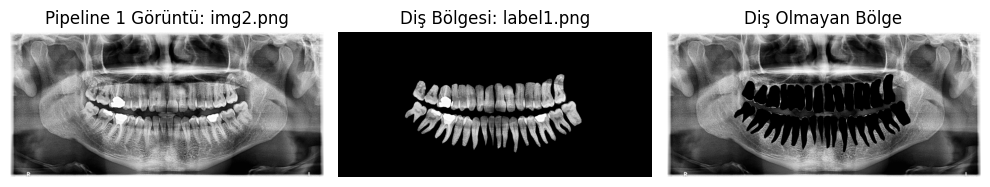

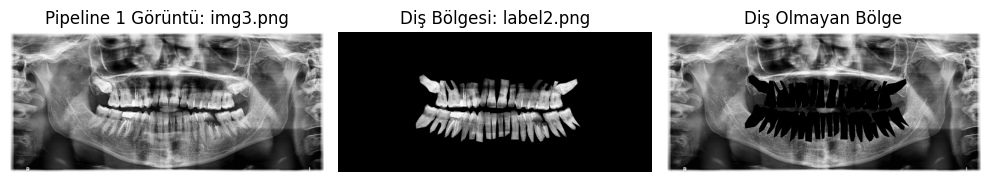

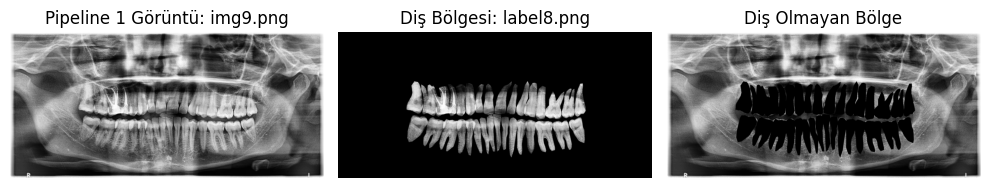

Non-dental coordinates saved.
HOG vektörleri kaydedildi.


In [ ]:
import numpy as np
import cv2
from scipy.ndimage import gaussian_filter
import matplotlib.pyplot as plt
from skimage.feature import hog

# Gaussian filtresi uygulanarak normalize edilmiş Luma değerlerini hesaplama
def compute_luminance_features(image):
    mu = gaussian_filter(image, sigma=1.5)
    mu_sq = mu * mu
    sigma = gaussian_filter(image**2, sigma=1.5) - mu_sq
    sigma = np.sqrt(np.abs(sigma))
    return mu, sigma

# HOG ile özellik çıkarma
def extract_hog_features(image, pixels_per_cell=(8, 8), cells_per_block=(2, 2)):
    features = hog(image, orientations=9, pixels_per_cell=pixels_per_cell, cells_per_block=cells_per_block,
                   block_norm='L2-Hys', visualize=False, feature_vector=True)
    return features

# Pipeline 1: Normalizasyon -> Gaussian Filtre -> CLAHE -> Unsharp Masking
def pipeline_1(image):
    def normalize_image(image):
        return (image - np.min(image)) / (np.max(image) - np.min(image)) * 255

    def apply_gaussian_filter(image, sigma=1):
        return gaussian_filter(image, sigma=sigma)

    def apply_clahe(image):
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
        return clahe.apply(image)

    def unsharp_mask(image):
        kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
        return cv2.filter2D(image, -1, kernel)

    normalized = normalize_image(image)
    gaussian_filtered = apply_gaussian_filter(normalized)
    clahe_applied = apply_clahe(gaussian_filtered.astype(np.uint8))
    sharpened = unsharp_mask(clahe_applied)
    return sharpened

# Görüntüleri ve etiketleri yükle
image_label_pairs = [
    ("img2.png", "label1.png"),
    ("img3.png", "label2.png"),
    ("img9.png", "label8.png")
]

# HOG vektörlerini saklamak için listeler
hog_dental_vectors = []
hog_non_dental_vectors = []

for image_path, label_path in image_label_pairs:
    # Görüntüyü yükle
    original_image = cv2.imread(image_path, 0)
    if original_image is None:
        raise FileNotFoundError(f"Image file not found: {image_path}")

    # Pipeline 1'i uygula
    pipeline_1_image = pipeline_1(original_image)

    # Maskeyi yükle
    mask = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)
    if mask is None:
        raise FileNotFoundError(f"Mask file not found: {label_path}")

    # Maskeyi boyutlandır ve türünü kontrol et
    resized_mask = cv2.resize(mask, (pipeline_1_image.shape[1], pipeline_1_image.shape[0]))
    resized_mask = resized_mask.astype(np.uint8)

    # Diş bölgesini maskele
    dental_region = cv2.bitwise_and(pipeline_1_image, pipeline_1_image, mask=resized_mask)

    # Diş olmayan bölge için maskeyi ters çevir
    inverted_mask = cv2.bitwise_not(resized_mask)
    non_dental_region = cv2.bitwise_and(pipeline_1_image, pipeline_1_image, mask=inverted_mask)

    # Diş bölgesi HOG çıkarımı
    dental_hog = extract_hog_features(dental_region)
    hog_dental_vectors.append(dental_hog)

    # Diş olmayan bölge HOG çıkarımı
    non_dental_hog = extract_hog_features(non_dental_region)
    hog_non_dental_vectors.append(non_dental_hog)

    # Görselleştir
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 3, 1)
    plt.title(f"Pipeline 1 Görüntü: {image_path}")
    plt.imshow(pipeline_1_image, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.title(f"Diş Bölgesi: {label_path}")
    plt.imshow(dental_region, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.title(f"Diş Olmayan Bölge")
    plt.imshow(non_dental_region, cmap='gray')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

# HOG vektörlerinin boyutlarını kontrol et
max_length_dental = max(len(vec) for vec in hog_dental_vectors)
hog_dental_vectors_padded = [np.pad(vec, (0, max_length_dental - len(vec))) for vec in hog_dental_vectors]

max_length_non_dental = max(len(vec) for vec in hog_non_dental_vectors)
hog_non_dental_vectors_padded = [np.pad(vec, (0, max_length_non_dental - len(vec))) for vec in hog_non_dental_vectors]
non_dental_coords = []

for image_path, label_path in image_label_pairs:
    # Görüntüyü yükle
    original_image = cv2.imread(image_path, 0)
    if original_image is None:
        raise FileNotFoundError(f"Image file not found: {image_path}")

    # Maskeyi yükle
    mask = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)
    if mask is None:
        raise FileNotFoundError(f"Mask file not found: {label_path}")

    # Maskeyi boyutlandır
    resized_mask = cv2.resize(mask, (original_image.shape[1], original_image.shape[0]))

    # Diş olmayan bölgeleri bul
    inverted_mask = cv2.bitwise_not(resized_mask)
    coords = np.column_stack(np.where(inverted_mask > 0))
    non_dental_coords.extend(coords.tolist())

# Koordinatları kaydet
np.save("non_dental_coords.npy", np.array(non_dental_coords))
print("Non-dental coordinates saved.")


# HOG vektörlerini kaydet
np.save("hog_dental_vectors.npy", np.array(hog_dental_vectors_padded))
np.save("hog_non_dental_vectors.npy", np.array(hog_non_dental_vectors_padded))
print("HOG vektörleri kaydedildi.")


Patch 21: Dental Similarity = 0.9999999993333334, Non-Dental Similarity = 14.209873896186947
Patch 22: Dental Similarity = 0.9999999993333333, Non-Dental Similarity = 14.221702939933976
Patch 23: Dental Similarity = 0.9999999993333331, Non-Dental Similarity = 14.223580508118017
Patch 24: Dental Similarity = 0.9999999993333335, Non-Dental Similarity = 14.226272373626523
Patch 25: Dental Similarity = 0.9999999993333334, Non-Dental Similarity = 14.213537686997281
Patch 26: Dental Similarity = 0.9999999993333334, Non-Dental Similarity = 14.208581224551828
Patch 27: Dental Similarity = 0.9999999993333334, Non-Dental Similarity = 14.221568360087781
Patch 28: Dental Similarity = 0.9999999993333334, Non-Dental Similarity = 14.212700745665883
Patch 29: Dental Similarity = 0.9999999993333332, Non-Dental Similarity = 14.206316330388983
Patch 30: Dental Similarity = 0.9999999993333333, Non-Dental Similarity = 14.200768537637451
Patch 31: Dental Similarity = 0.9999999993333328, Non-Dental Similarit

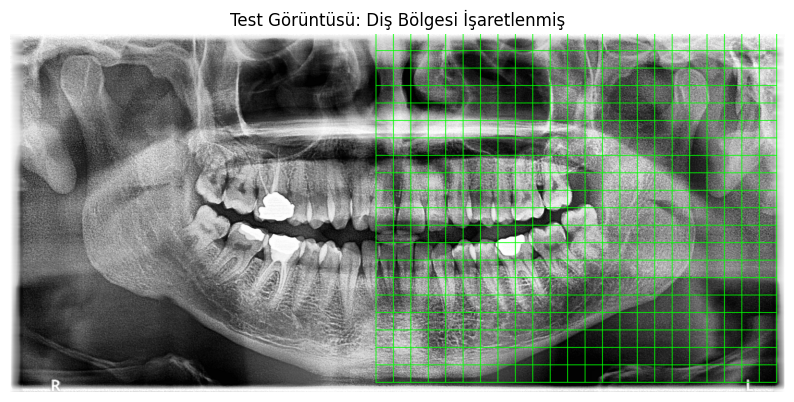

In [ ]:
import numpy as np
import cv2
from scipy.ndimage import gaussian_filter
import matplotlib.pyplot as plt
from skimage.feature import hog

# Gaussian filtresi uygulanarak normalize edilmiş Luma değerlerini hesaplama
def compute_luminance_features(image):
    mu = gaussian_filter(image, sigma=1.5)
    mu_sq = mu * mu
    sigma = gaussian_filter(image**2, sigma=1.5) - mu_sq
    sigma = np.sqrt(np.abs(sigma))
    return mu, sigma

# HOG ile özellik çıkarma ve normalizasyon
def extract_hog_features(image, pixels_per_cell=(8, 8), cells_per_block=(2, 2)):
    features = hog(image, orientations=9, pixels_per_cell=pixels_per_cell, cells_per_block=cells_per_block,
                   block_norm='L2-Hys', visualize=False, feature_vector=True)
    features = features / (np.linalg.norm(features) + 1e-8) if np.linalg.norm(features) != 0 else features
    return features

# Pipeline 1: Normalizasyon -> Gaussian Filtre -> CLAHE -> Unsharp Masking
def pipeline_1(image):
    def normalize_image(image):
        return (image - np.min(image)) / (np.max(image) - np.min(image)) * 255

    def apply_gaussian_filter(image, sigma=1):
        return gaussian_filter(image, sigma=sigma)

    def apply_clahe(image):
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
        return clahe.apply(image)

    def unsharp_mask(image):
        kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
        return cv2.filter2D(image, -1, kernel)

    normalized = normalize_image(image)
    gaussian_filtered = apply_gaussian_filter(normalized)
    clahe_applied = apply_clahe(gaussian_filtered.astype(np.uint8))
    sharpened = unsharp_mask(clahe_applied)
    return sharpened

# Test görüntüsünde HOG çalıştırılması ve karşılaştırma
def process_test_image(test_image_path, dental_hog_vectors, non_dental_hog_vectors, non_dental_coords, threshold=0.5):
    # Test görüntüsünü yükle
    test_image = cv2.imread(test_image_path, 0)
    if test_image is None:
        raise FileNotFoundError(f"Test image file not found: {test_image_path}")

    # Pipeline 1 ile ön işleme
    processed_test_image = pipeline_1(test_image)

    # Test görüntüsünü sabit boyutlarda patch'lere böl
    patch_size = 128  # Sabit patch boyutu
    step_size = patch_size // 2
    test_hog_vectors = []
    patch_coordinates = []

    for y in range(0, processed_test_image.shape[0] - patch_size + 1, step_size):
        for x in range(0, processed_test_image.shape[1] - patch_size + 1, step_size):
            patch = processed_test_image[y:y + patch_size, x:x + patch_size]
            patch_hog = extract_hog_features(patch)
            test_hog_vectors.append(patch_hog)
            patch_coordinates.append((x + patch_size // 2, y + patch_size // 2))

    # Karşılaştırma ve işaretleme
    marked_image = cv2.cvtColor(processed_test_image, cv2.COLOR_GRAY2BGR)
    for idx, test_hog in enumerate(test_hog_vectors):
        x, y = patch_coordinates[idx]

        # Eğer patch diş olmayan koordinatlarda ise atla
        if any(abs(x - coord[0]) < patch_size // 2 and abs(y - coord[1]) < patch_size // 2 for coord in non_dental_coords):
            continue

        try:
            dental_similarity = np.min([np.linalg.norm(test_hog - vec[:len(test_hog)]) for vec in dental_hog_vectors])
            non_dental_similarity = np.min([np.linalg.norm(test_hog - vec[:len(test_hog)]) for vec in non_dental_hog_vectors])
            print(f"Patch {idx}: Dental Similarity = {dental_similarity}, Non-Dental Similarity = {non_dental_similarity}")
        except ValueError as e:
            print(f"Error in similarity calculation for Patch {idx}: {e}")
            continue

        if dental_similarity < non_dental_similarity and (non_dental_similarity - dental_similarity) > threshold:
            cv2.rectangle(marked_image, (x - patch_size // 2, y - patch_size // 2),
                          (x + patch_size // 2, y + patch_size // 2), (0, 255, 0), 2)

    # Görselleştirme
    plt.figure(figsize=(10, 5))
    plt.title("Test Görüntüsü: Diş Bölgesi İşaretlenmiş")
    plt.imshow(marked_image, cmap='gray')
    plt.axis('off')
    plt.show()

# Örnek kullanım
# Kaydedilmiş HOG vektörlerini ve diş olmayan koordinatları yükle
dental_hog_vectors = np.load("hog_dental_vectors.npy", allow_pickle=True)
non_dental_hog_vectors = np.load("hog_non_dental_vectors.npy", allow_pickle=True)
non_dental_coords = np.load("non_dental_coords.npy", allow_pickle=True)

# Test görüntüsünü işleyin
process_test_image("img2.png", dental_hog_vectors, non_dental_hog_vectors, non_dental_coords, threshold=0.5)


### GLCM
Makelenmiş görüntüde SIFT ile anahtar noktalar bulunduktan sonra glcm matrisi hesaplanmış ardından test görüntüsünde ise modelemde kullanılan key pointlerin koordinatları referans alınarak SIFT çalıştırılmıştır ve buradan bulunan anahtar noktlar üzerinden glcm hesaplanmıştır.

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Veriler 'cohog_features_and_keypoints.pkl' dosyasına kaydedildi.


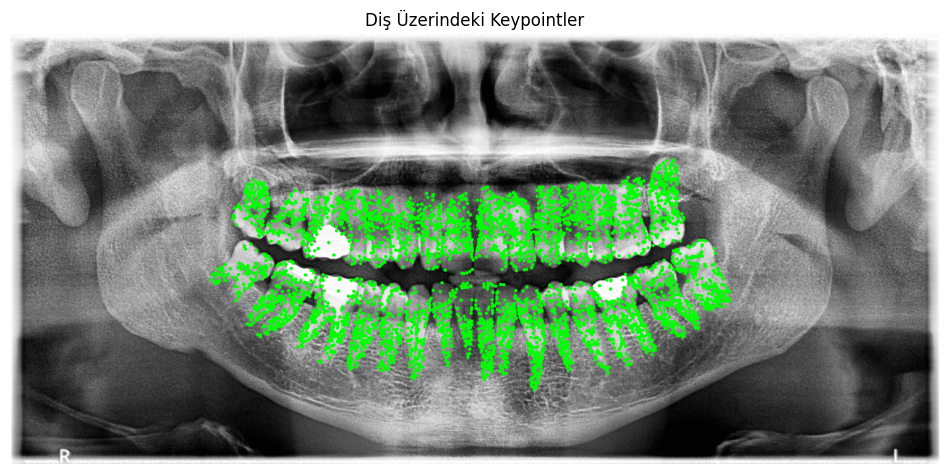

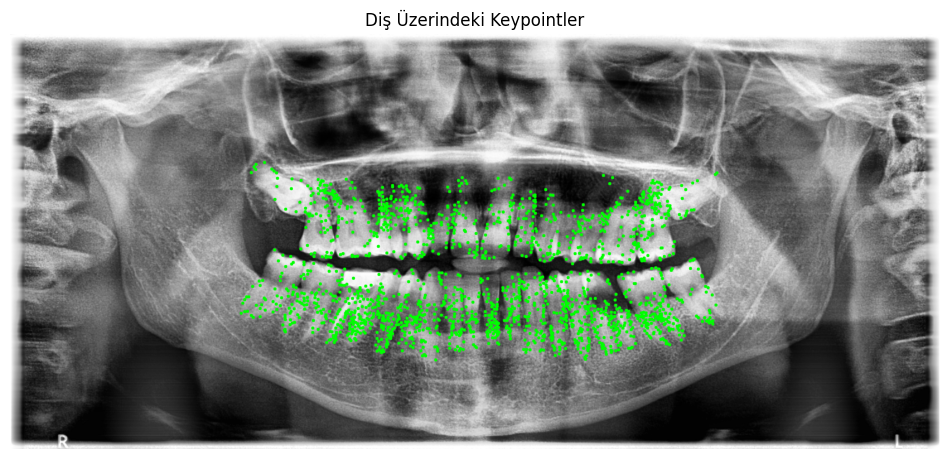

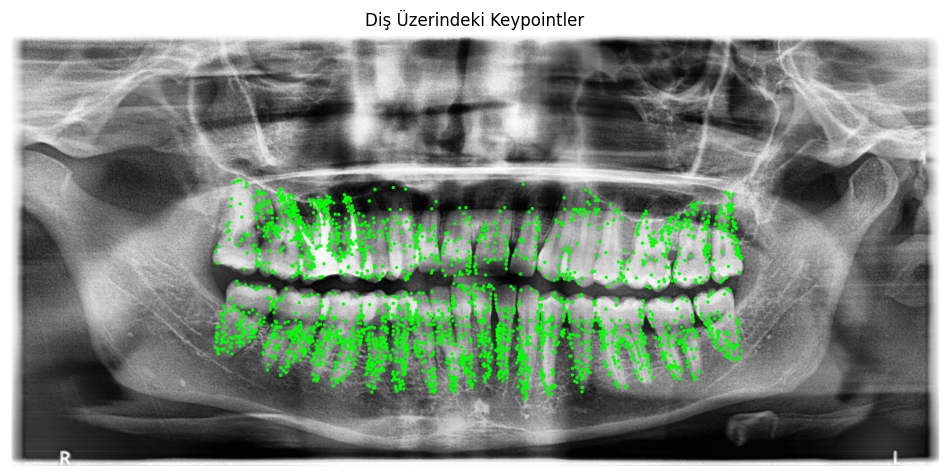

In [ ]:
import numpy as np
import cv2
import pickle
from skimage.feature import greycomatrix, greycoprops
import matplotlib.pyplot as plt

def preprocess_image(image):
    """
    Görüntü ön işleme: Normalizasyon, Gaussian Filtre, CLAHE, Unsharp Masking.

    Args:
        image (ndarray): Giriş görüntüsü.

    Returns:
        ndarray: Ön işlenmiş görüntü.
    """
    # Normalizasyon
    image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX)

    # Gaussian Filtre
    image = cv2.GaussianBlur(image, (5, 5), 0)

    # CLAHE
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    image = clahe.apply(image)

    # Unsharp Masking
    blurred = cv2.GaussianBlur(image, (5, 5), 0)
    image = cv2.addWeighted(image, 1.5, blurred, -0.5, 0)

    return image

def detect_teeth_regions(image):
    """
    Test görüntüsünde diş bölgelerini bulur.

    Args:
        image (ndarray): Giriş görüntüsü.

    Returns:
        ndarray: Diş bölgesini içeren maske.
    """
    # Kenar tespiti
    edges = cv2.Canny(image, threshold1=50, threshold2=150)

    # Morfolojik işlemler
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5))
    dilated = cv2.dilate(edges, kernel, iterations=2)
    eroded = cv2.erode(dilated, kernel, iterations=1)

    return eroded

def extract_cohog_features(image, mask, distances=[1], angles=[0, np.pi/2]):
    """
    CoHoG vektörü üretimi için GLCM matrisleri hesaplanır ve istatistiksel özellikler çıkarılır.

    Args:
        image (ndarray): Giriş görüntüsü.
        mask (ndarray): Diş bölgesi maskesi.
        distances (list): GLCM için mesafeler.
        angles (list): GLCM için açı değerleri (radyan).

    Returns:
        np.ndarray: CoHoG özellik vektörü.
    """
    features = []
    # Maskeyi uygula
    masked_image = np.where(mask > 0, image, 0)

    for angle in angles:
        glcm = greycomatrix(masked_image, distances=distances, angles=[angle],
                            levels=256, symmetric=True, normed=True)
        # İstatistiksel özellikler
        contrast = greycoprops(glcm, 'contrast').flatten()
        dissimilarity = greycoprops(glcm, 'dissimilarity').flatten()
        homogeneity = greycoprops(glcm, 'homogeneity').flatten()
        energy = greycoprops(glcm, 'energy').flatten()
        correlation = greycoprops(glcm, 'correlation').flatten()

        features.extend([contrast, dissimilarity, homogeneity, energy, correlation])

    return np.concatenate(features).flatten()

def extract_keypoints(image, mask):
    """
    Maskelenmiş görüntü üzerinde SIFT algoritması ile keypoint bulma.

    Args:
        image (ndarray): Giriş görüntüsü.
        mask (ndarray): Diş bölgesi maskesi.

    Returns:
        list: Sadece diş bölgesine ait keypointlerin koordinatları.
    """
    sift = cv2.SIFT_create()
    keypoints = sift.detect(image, None)

    # Sadece maskelenmiş alandaki keypointleri filtrele
    valid_keypoints = [kp for kp in keypoints if mask[int(kp.pt[1]), int(kp.pt[0])] > 0]
    keypoint_coords = [(int(kp.pt[0]), int(kp.pt[1])) for kp in valid_keypoints]

    return keypoint_coords

def test_keypoints(image_path, keypoint_coords):
    """
    Test görüntüsünde kaydedilmiş keypoint koordinatlarına göre diş bölgelerini işaretleme.

    Args:
        image_path (str): Test görüntüsünün dosya yolu.
        keypoint_coords (list): Kaydedilmiş keypoint koordinatları.
    """
    # Görüntüyü yükle
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    preprocessed_image = preprocess_image(image)

    # Keypointlerin işaretlenmesi
    result = cv2.cvtColor(preprocessed_image, cv2.COLOR_GRAY2BGR)
    for x, y in keypoint_coords:
        cv2.circle(result, (x, y), radius=5, color=(0, 255, 0), thickness=-1)

    # Görselleştirme
    plt.figure(figsize=(12, 6))
    plt.title("Diş Üzerindeki Keypointler")
    plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.show()

def process_images(image_paths, label_paths, output_file):
    """
    Görüntülerden ve etiketlerinden CoHoG özellik vektörlerini üretir ve kaydeder.

    Args:
        image_paths (list): Görüntü dosya yolları.
        label_paths (list): Etiket dosya yolları.
        output_file (str): Çıktı dosyasının yolu (pkl formatında).
    """
    cohog_features = {}
    keypoint_data = {}

    for img_path, lbl_path in zip(image_paths, label_paths):
        image = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        label = cv2.imread(lbl_path, cv2.IMREAD_GRAYSCALE)

        if image is None or label is None:
            print(f"Dosya yüklenemedi: {img_path} veya {lbl_path}")
            continue

        # Görüntü ön işleme
        preprocessed_image = preprocess_image(image)

        # CoHoG özellikleri
        features = extract_cohog_features(preprocessed_image, label)
        cohog_features[img_path] = features

        # Keypointlerin bulunması
        keypoints = extract_keypoints(preprocessed_image, label)
        keypoint_data[img_path] = keypoints

    with open(output_file, 'wb') as f:
        pickle.dump((cohog_features, keypoint_data), f)
        print(f"Veriler '{output_file}' dosyasına kaydedildi.")

# Görüntü ve label dosya yolları
image_files = ["img2.png", "img3.png", "img9.png"]
label_files = ["label1.png", "label2.png", "label8.png"]

# Çıktı dosyası
output_pkl_file = "cohog_features_and_keypoints.pkl"

# İşlem başlat
process_images(image_files, label_files, output_pkl_file)

# Test işlemi
with open(output_pkl_file, 'rb') as f:
    _, keypoint_data = pickle.load(f)

# Test keypointlerini görselleştir
for img_path in image_files:
    if img_path in keypoint_data:
        test_keypoints(img_path, keypoint_data[img_path])


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Veriler 'cohog_features_and_keypoints.pkl' dosyasına kaydedildi.
Keypoint (615, 752) için en iyi eşleşme: img3.png (Benzerlik: 0.9657545140414806)
Keypoint (619, 736) için en iyi eşleşme: img3.png (Benzerlik: 0.8834456634309168)
Keypoint (619, 736) için en iyi eşleşme: img3.png (Benzerlik: 0.8834456634309168)
Keypoint (619, 736) için en iyi eşleşme: img3.png (Benzerlik: 0.8834456634309168)
Keypoint (625, 743) için en iyi eşleşme: img3.png (Benzerlik: 0.8270369730675227)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (625, 761) için en iyi eşleşme: img3.png (Benzerlik: 0.8698869896558766)
Keypoint (626, 732) için en iyi eşleşme: img3.png (Benzerlik: 0.8507145610930191)
Keypoint (626, 732) için en iyi eşleşme: img3.png (Benzerlik: 0.8507145610930191)
Keypoint (629, 756) için en iyi eşleşme: img3.png (Benzerlik: 0.9647330923133328)
Keypoint (634, 732) için en iyi eşleşme: img3.png (Benzerlik: 0.9339612384042884)
Keypoint (634, 732) için en iyi eşleşme: img3.png (Benzerlik: 0.9339612384042884)
Keypoint (635, 763) için en iyi eşleşme: img3.png (Benzerlik: 0.9224096535908439)
Keypoint (635, 763) için en iyi eşleşme: img3.png (Benzerlik: 0.9224096535908439)
Keypoint (636, 719) için en iyi eşleşme: img3.png (Benzerlik: 0.9327243159580619)
Keypoint (637, 737) için en iyi eşleşme: img3.png (Benzerlik: 0.8264698351781079)
Keypoint (638, 760) için en iyi eşleşme: img3.png (Benzerlik: 0.9737438175167537)
Keypoint (641, 754) için en iyi eşleşme: img3.png (Benzerlik: 0.9831060024600223)
Keypoint (641, 7

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (648, 716) için en iyi eşleşme: img3.png (Benzerlik: 0.9334400561555994)
Keypoint (650, 715) için en iyi eşleşme: img3.png (Benzerlik: 0.9473768394986885)
Keypoint (652, 726) için en iyi eşleşme: img3.png (Benzerlik: 0.8718040541902646)
Keypoint (652, 736) için en iyi eşleşme: img3.png (Benzerlik: 0.8456906961588027)
Keypoint (655, 745) için en iyi eşleşme: img3.png (Benzerlik: 0.9008603113412967)
Keypoint (659, 705) için en iyi eşleşme: img3.png (Benzerlik: 0.8665983100407368)
Keypoint (660, 755) için en iyi eşleşme: img3.png (Benzerlik: 0.9185030052279034)
Keypoint (662, 738) için en iyi eşleşme: img3.png (Benzerlik: 0.782963570433338)
Keypoint (668, 734) için en iyi eşleşme: img3.png (Benzerlik: 0.8393911279825684)
Keypoint (674, 718) için en iyi eşleşme: img3.png (Benzerlik: 0.9747838973696502)
Keypoint (680, 744) için en iyi eşleşme: img3.png (Benzerlik: 0.913357140898196)
Keypoint (681, 566) için en iyi eşleşme: img3.png (Benzerlik: 0.9299428365623431)
Keypoint (683, 563

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (690, 772) için en iyi eşleşme: img3.png (Benzerlik: 0.8577958991127879)
Keypoint (691, 816) için en iyi eşleşme: img3.png (Benzerlik: 0.8265048869025607)
Keypoint (692, 584) için en iyi eşleşme: img3.png (Benzerlik: 0.9386699197676386)
Keypoint (692, 745) için en iyi eşleşme: img3.png (Benzerlik: 0.834910459522273)
Keypoint (694, 773) için en iyi eşleşme: img3.png (Benzerlik: 0.8747721111561126)
Keypoint (694, 792) için en iyi eşleşme: img3.png (Benzerlik: 0.914851032896556)
Keypoint (695, 752) için en iyi eşleşme: img3.png (Benzerlik: 0.9219474287958908)
Keypoint (696, 528) için en iyi eşleşme: img3.png (Benzerlik: 0.9616001155366789)
Keypoint (698, 805) için en iyi eşleşme: img3.png (Benzerlik: 0.9449720069256309)
Keypoint (698, 714) için en iyi eşleşme: img9.png (Benzerlik: 0.9702112085004885)
Keypoint (699, 736) için en iyi eşleşme: img3.png (Benzerlik: 0.8911988779448227)
Keypoint (699, 521) için en iyi eşleşme: img3.png (Benzerlik: 0.9507282582326274)
Keypoint (700, 800

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (701, 701) için en iyi eşleşme: img3.png (Benzerlik: 0.9518987944113457)
Keypoint (701, 701) için en iyi eşleşme: img3.png (Benzerlik: 0.9518987944113457)
Keypoint (702, 789) için en iyi eşleşme: img3.png (Benzerlik: 0.921566185989415)
Keypoint (704, 793) için en iyi eşleşme: img3.png (Benzerlik: 0.8894654929146086)
Keypoint (705, 531) için en iyi eşleşme: img3.png (Benzerlik: 0.922044069175333)
Keypoint (706, 536) için en iyi eşleşme: img3.png (Benzerlik: 0.973150040570077)
Keypoint (707, 720) için en iyi eşleşme: img9.png (Benzerlik: 0.9358191415982675)
Keypoint (707, 711) için en iyi eşleşme: img9.png (Benzerlik: 0.9525829835422214)
Keypoint (712, 706) için en iyi eşleşme: img9.png (Benzerlik: 0.9825841657906297)
Keypoint (715, 766) için en iyi eşleşme: img3.png (Benzerlik: 0.922519251965494)
Keypoint (717, 647) için en iyi eşleşme: img3.png (Benzerlik: 0.923448679799425)
Keypoint (717, 651) için en iyi eşleşme: img3.png (Benzerlik: 0.9536086739025559)
Keypoint (717, 712) i

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (718, 565) için en iyi eşleşme: img3.png (Benzerlik: 0.925774081987445)
Keypoint (718, 777) için en iyi eşleşme: img3.png (Benzerlik: 0.938778301739602)
Keypoint (718, 777) için en iyi eşleşme: img3.png (Benzerlik: 0.938778301739602)
Keypoint (719, 485) için en iyi eşleşme: img3.png (Benzerlik: 0.9443029000726352)
Keypoint (720, 658) için en iyi eşleşme: img3.png (Benzerlik: 0.9233969765188373)
Keypoint (721, 479) için en iyi eşleşme: img3.png (Benzerlik: 0.9459510501396695)
Keypoint (721, 733) için en iyi eşleşme: img9.png (Benzerlik: 0.971312454947306)
Keypoint (722, 718) için en iyi eşleşme: img9.png (Benzerlik: 0.9837116527789148)
Keypoint (722, 510) için en iyi eşleşme: img3.png (Benzerlik: 0.9491489063714139)
Keypoint (723, 470) için en iyi eşleşme: img3.png (Benzerlik: 0.9780344146121707)
Keypoint (724, 504) için en iyi eşleşme: img3.png (Benzerlik: 0.8229829103789134)
Keypoint (724, 540) için en iyi eşleşme: img3.png (Benzerlik: 0.8967502382657306)
Keypoint (725, 514) 

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (725, 726) için en iyi eşleşme: img9.png (Benzerlik: 0.9696900083436502)
Keypoint (725, 726) için en iyi eşleşme: img9.png (Benzerlik: 0.9696900083436502)
Keypoint (725, 564) için en iyi eşleşme: img3.png (Benzerlik: 0.9356773959575532)
Keypoint (726, 488) için en iyi eşleşme: img3.png (Benzerlik: 0.8698597340679158)
Keypoint (726, 530) için en iyi eşleşme: img3.png (Benzerlik: 0.8962691406203013)
Keypoint (727, 460) için en iyi eşleşme: img3.png (Benzerlik: 0.9688137154612239)
Keypoint (727, 736) için en iyi eşleşme: img9.png (Benzerlik: 0.974640991521428)
Keypoint (728, 708) için en iyi eşleşme: img3.png (Benzerlik: 0.9387255608695898)
Keypoint (728, 475) için en iyi eşleşme: img3.png (Benzerlik: 0.9824498710576847)
Keypoint (728, 475) için en iyi eşleşme: img3.png (Benzerlik: 0.9824498710576847)
Keypoint (728, 713) için en iyi eşleşme: img3.png (Benzerlik: 0.9787077807254694)
Keypoint (728, 493) için en iyi eşleşme: img3.png (Benzerlik: 0.8564744075178685)
Keypoint (729, 77

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (732, 490) için en iyi eşleşme: img3.png (Benzerlik: 0.8438647183750633)
Keypoint (732, 545) için en iyi eşleşme: img3.png (Benzerlik: 0.9145193374502384)
Keypoint (732, 767) için en iyi eşleşme: img9.png (Benzerlik: 0.9812424394744744)
Keypoint (732, 862) için en iyi eşleşme: img3.png (Benzerlik: 0.958458896140941)
Keypoint (732, 484) için en iyi eşleşme: img3.png (Benzerlik: 0.9153749928066616)
Keypoint (732, 727) için en iyi eşleşme: img9.png (Benzerlik: 0.9789627101242441)
Keypoint (732, 727) için en iyi eşleşme: img9.png (Benzerlik: 0.9789627101242441)
Keypoint (732, 459) için en iyi eşleşme: img3.png (Benzerlik: 0.9429049541973058)
Keypoint (733, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.9078398037630766)
Keypoint (733, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.9078398037630766)
Keypoint (733, 530) için en iyi eşleşme: img3.png (Benzerlik: 0.8894721924347795)
Keypoint (733, 558) için en iyi eşleşme: img3.png (Benzerlik: 0.9440850200981984)
Keypoint (733, 55

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (737, 891) için en iyi eşleşme: img3.png (Benzerlik: 0.9225635162369439)
Keypoint (737, 748) için en iyi eşleşme: img9.png (Benzerlik: 0.9801240937336343)
Keypoint (737, 748) için en iyi eşleşme: img9.png (Benzerlik: 0.9801240937336343)
Keypoint (737, 874) için en iyi eşleşme: img3.png (Benzerlik: 0.9558885335315025)
Keypoint (737, 891) için en iyi eşleşme: img3.png (Benzerlik: 0.9225635162369439)
Keypoint (737, 642) için en iyi eşleşme: img3.png (Benzerlik: 0.9723219343762172)
Keypoint (738, 867) için en iyi eşleşme: img3.png (Benzerlik: 0.9452851419369209)
Keypoint (738, 557) için en iyi eşleşme: img3.png (Benzerlik: 0.9551606957163287)
Keypoint (738, 464) için en iyi eşleşme: img3.png (Benzerlik: 0.9528376817193949)
Keypoint (740, 856) için en iyi eşleşme: img3.png (Benzerlik: 0.946431162968667)
Keypoint (740, 768) için en iyi eşleşme: img9.png (Benzerlik: 0.9888860285790932)
Keypoint (740, 768) için en iyi eşleşme: img9.png (Benzerlik: 0.9888860285790932)
Keypoint (740, 47

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (740, 760) için en iyi eşleşme: img9.png (Benzerlik: 0.9887090489001501)
Keypoint (740, 503) için en iyi eşleşme: img3.png (Benzerlik: 0.9374556459238403)
Keypoint (740, 503) için en iyi eşleşme: img3.png (Benzerlik: 0.9374556459238403)
Keypoint (741, 512) için en iyi eşleşme: img3.png (Benzerlik: 0.9359046320453176)
Keypoint (741, 512) için en iyi eşleşme: img3.png (Benzerlik: 0.9359046320453176)
Keypoint (741, 525) için en iyi eşleşme: img3.png (Benzerlik: 0.8237501621079838)
Keypoint (741, 485) için en iyi eşleşme: img3.png (Benzerlik: 0.9454225197293731)
Keypoint (741, 445) için en iyi eşleşme: img3.png (Benzerlik: 0.9708753134259928)
Keypoint (742, 459) için en iyi eşleşme: img3.png (Benzerlik: 0.9439381998447284)
Keypoint (742, 459) için en iyi eşleşme: img3.png (Benzerlik: 0.9439381998447284)
Keypoint (742, 755) için en iyi eşleşme: img9.png (Benzerlik: 0.9817888030727328)
Keypoint (743, 463) için en iyi eşleşme: img3.png (Benzerlik: 0.950022367139887)
Keypoint (744, 88

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (745, 731) için en iyi eşleşme: img3.png (Benzerlik: 0.9565556349003058)
Keypoint (745, 524) için en iyi eşleşme: img3.png (Benzerlik: 0.8855319839182277)
Keypoint (745, 524) için en iyi eşleşme: img3.png (Benzerlik: 0.8855319839182277)
Keypoint (745, 522) için en iyi eşleşme: img3.png (Benzerlik: 0.9249255562703421)
Keypoint (746, 714) için en iyi eşleşme: img3.png (Benzerlik: 0.9461691319922131)
Keypoint (746, 752) için en iyi eşleşme: img3.png (Benzerlik: 0.9131635622959989)
Keypoint (747, 841) için en iyi eşleşme: img3.png (Benzerlik: 0.8663233537187183)
Keypoint (747, 496) için en iyi eşleşme: img3.png (Benzerlik: 0.7701014558172753)
Keypoint (747, 488) için en iyi eşleşme: img3.png (Benzerlik: 0.8628614993763537)
Keypoint (748, 532) için en iyi eşleşme: img3.png (Benzerlik: 0.9435484852664218)
Keypoint (748, 532) için en iyi eşleşme: img3.png (Benzerlik: 0.9435484852664218)
Keypoint (748, 532) için en iyi eşleşme: img3.png (Benzerlik: 0.9435484852664218)
Keypoint (749, 8

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (749, 714) için en iyi eşleşme: img3.png (Benzerlik: 0.9041755967598736)
Keypoint (750, 482) için en iyi eşleşme: img9.png (Benzerlik: 0.9863080214418366)
Keypoint (751, 561) için en iyi eşleşme: img2.png (Benzerlik: 0.980128294712542)
Keypoint (751, 515) için en iyi eşleşme: img3.png (Benzerlik: 0.9630895423801307)
Keypoint (751, 515) için en iyi eşleşme: img3.png (Benzerlik: 0.9630895423801307)
Keypoint (751, 584) için en iyi eşleşme: img3.png (Benzerlik: 0.9548572503520288)
Keypoint (752, 452) için en iyi eşleşme: img9.png (Benzerlik: 0.9904427102434418)
Keypoint (752, 752) için en iyi eşleşme: img3.png (Benzerlik: 0.9158380894564814)
Keypoint (752, 702) için en iyi eşleşme: img3.png (Benzerlik: 0.924051694011546)
Keypoint (752, 702) için en iyi eşleşme: img3.png (Benzerlik: 0.924051694011546)
Keypoint (753, 875) için en iyi eşleşme: img3.png (Benzerlik: 0.8650629541075523)
Keypoint (753, 730) için en iyi eşleşme: img3.png (Benzerlik: 0.9601400834307413)
Keypoint (753, 525)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (753, 740) için en iyi eşleşme: img3.png (Benzerlik: 0.9356002716569742)
Keypoint (754, 867) için en iyi eşleşme: img3.png (Benzerlik: 0.8228133347427381)
Keypoint (754, 662) için en iyi eşleşme: img3.png (Benzerlik: 0.9634808671829783)
Keypoint (754, 844) için en iyi eşleşme: img3.png (Benzerlik: 0.9472173938814696)
Keypoint (754, 844) için en iyi eşleşme: img3.png (Benzerlik: 0.9472173938814696)
Keypoint (754, 555) için en iyi eşleşme: img3.png (Benzerlik: 0.9792415686737178)
Keypoint (754, 555) için en iyi eşleşme: img3.png (Benzerlik: 0.9792415686737178)
Keypoint (754, 511) için en iyi eşleşme: img9.png (Benzerlik: 0.9795296728570208)
Keypoint (754, 519) için en iyi eşleşme: img3.png (Benzerlik: 0.9766800074935309)
Keypoint (754, 511) için en iyi eşleşme: img9.png (Benzerlik: 0.9795296728570208)
Keypoint (754, 709) için en iyi eşleşme: img3.png (Benzerlik: 0.9799089238399556)
Keypoint (755, 704) için en iyi eşleşme: img3.png (Benzerlik: 0.960628350990412)
Keypoint (757, 59

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (757, 572) için en iyi eşleşme: img2.png (Benzerlik: 0.9723683496543151)
Keypoint (757, 523) için en iyi eşleşme: img9.png (Benzerlik: 0.9768963345931736)
Keypoint (758, 833) için en iyi eşleşme: img3.png (Benzerlik: 0.9277406899956161)
Keypoint (758, 874) için en iyi eşleşme: img3.png (Benzerlik: 0.767012182160405)
Keypoint (758, 839) için en iyi eşleşme: img3.png (Benzerlik: 0.9113205389010994)
Keypoint (758, 839) için en iyi eşleşme: img3.png (Benzerlik: 0.9113205389010994)
Keypoint (758, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.8654386689806259)
Keypoint (758, 459) için en iyi eşleşme: img9.png (Benzerlik: 0.9879451903500536)
Keypoint (759, 503) için en iyi eşleşme: img9.png (Benzerlik: 0.9642610413390666)
Keypoint (759, 492) için en iyi eşleşme: img9.png (Benzerlik: 0.9889248675072864)
Keypoint (759, 472) için en iyi eşleşme: img9.png (Benzerlik: 0.9682246195727543)
Keypoint (759, 472) için en iyi eşleşme: img9.png (Benzerlik: 0.9682246195727543)
Keypoint (760, 53

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (760, 465) için en iyi eşleşme: img9.png (Benzerlik: 0.9806557183907966)
Keypoint (761, 844) için en iyi eşleşme: img3.png (Benzerlik: 0.9463335565278258)
Keypoint (761, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.9701076423593626)
Keypoint (761, 616) için en iyi eşleşme: img2.png (Benzerlik: 0.9760023125970126)
Keypoint (761, 604) için en iyi eşleşme: img3.png (Benzerlik: 0.9699854421601563)
Keypoint (761, 604) için en iyi eşleşme: img3.png (Benzerlik: 0.9699854421601563)
Keypoint (761, 473) için en iyi eşleşme: img9.png (Benzerlik: 0.9750326611537596)
Keypoint (762, 599) için en iyi eşleşme: img3.png (Benzerlik: 0.978958660800169)
Keypoint (763, 618) için en iyi eşleşme: img9.png (Benzerlik: 0.9799621781493169)
Keypoint (763, 720) için en iyi eşleşme: img9.png (Benzerlik: 0.9762827093815949)
Keypoint (763, 484) için en iyi eşleşme: img9.png (Benzerlik: 0.9856663947448825)
Keypoint (763, 818) için en iyi eşleşme: img3.png (Benzerlik: 0.9239352765695003)
Keypoint (763, 52

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (764, 528) için en iyi eşleşme: img9.png (Benzerlik: 0.9727933382550131)
Keypoint (765, 452) için en iyi eşleşme: img3.png (Benzerlik: 0.9336423301730089)
Keypoint (765, 855) için en iyi eşleşme: img3.png (Benzerlik: 0.8484068713151889)
Keypoint (765, 855) için en iyi eşleşme: img3.png (Benzerlik: 0.8484068713151889)
Keypoint (765, 855) için en iyi eşleşme: img3.png (Benzerlik: 0.8484068713151889)
Keypoint (765, 492) için en iyi eşleşme: img9.png (Benzerlik: 0.9786500148364293)
Keypoint (765, 836) için en iyi eşleşme: img3.png (Benzerlik: 0.9325803401353584)
Keypoint (766, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.8457545795402733)
Keypoint (766, 559) için en iyi eşleşme: img9.png (Benzerlik: 0.9810240096214236)
Keypoint (766, 606) için en iyi eşleşme: img3.png (Benzerlik: 0.9753051860710695)
Keypoint (766, 606) için en iyi eşleşme: img3.png (Benzerlik: 0.9753051860710695)
Keypoint (766, 580) için en iyi eşleşme: img9.png (Benzerlik: 0.9794452944324272)
Keypoint (766, 5

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (766, 500) için en iyi eşleşme: img9.png (Benzerlik: 0.9485066626286579)
Keypoint (766, 732) için en iyi eşleşme: img2.png (Benzerlik: 0.9835905378443249)
Keypoint (766, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.829386452600785)
Keypoint (766, 575) için en iyi eşleşme: img9.png (Benzerlik: 0.9799209406208268)
Keypoint (766, 575) için en iyi eşleşme: img9.png (Benzerlik: 0.9799209406208268)
Keypoint (767, 481) için en iyi eşleşme: img3.png (Benzerlik: 0.9523964544994769)
Keypoint (767, 481) için en iyi eşleşme: img3.png (Benzerlik: 0.9523964544994769)
Keypoint (768, 815) için en iyi eşleşme: img3.png (Benzerlik: 0.9649879478000747)
Keypoint (768, 712) için en iyi eşleşme: img3.png (Benzerlik: 0.974596187217238)
Keypoint (768, 712) için en iyi eşleşme: img3.png (Benzerlik: 0.974596187217238)
Keypoint (768, 602) için en iyi eşleşme: img3.png (Benzerlik: 0.9764443650002615)
Keypoint (769, 528) için en iyi eşleşme: img2.png (Benzerlik: 0.9621044153248037)
Keypoint (769, 528)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (770, 460) için en iyi eşleşme: img3.png (Benzerlik: 0.8958753763656875)
Keypoint (770, 460) için en iyi eşleşme: img3.png (Benzerlik: 0.8958753763656875)
Keypoint (770, 587) için en iyi eşleşme: img9.png (Benzerlik: 0.9759213137601598)
Keypoint (770, 587) için en iyi eşleşme: img9.png (Benzerlik: 0.9759213137601598)
Keypoint (770, 809) için en iyi eşleşme: img3.png (Benzerlik: 0.9660710030357692)
Keypoint (770, 809) için en iyi eşleşme: img3.png (Benzerlik: 0.9660710030357692)
Keypoint (770, 826) için en iyi eşleşme: img3.png (Benzerlik: 0.8699489559313848)
Keypoint (771, 834) için en iyi eşleşme: img3.png (Benzerlik: 0.9094697817850403)
Keypoint (771, 834) için en iyi eşleşme: img3.png (Benzerlik: 0.9094697817850403)
Keypoint (772, 749) için en iyi eşleşme: img3.png (Benzerlik: 0.9802924455159319)
Keypoint (772, 464) için en iyi eşleşme: img3.png (Benzerlik: 0.8528320472606186)
Keypoint (772, 727) için en iyi eşleşme: img3.png (Benzerlik: 0.9536751067081632)
Keypoint (772, 5

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (773, 715) için en iyi eşleşme: img3.png (Benzerlik: 0.9167493996469975)
Keypoint (773, 715) için en iyi eşleşme: img3.png (Benzerlik: 0.9167493996469975)
Keypoint (773, 857) için en iyi eşleşme: img3.png (Benzerlik: 0.9203285306334343)
Keypoint (773, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.9473771936689744)
Keypoint (773, 470) için en iyi eşleşme: img3.png (Benzerlik: 0.8203026020844079)
Keypoint (773, 612) için en iyi eşleşme: img3.png (Benzerlik: 0.9576474806287435)
Keypoint (773, 736) için en iyi eşleşme: img3.png (Benzerlik: 0.9215078337534844)
Keypoint (773, 803) için en iyi eşleşme: img3.png (Benzerlik: 0.9634274569815364)
Keypoint (773, 803) için en iyi eşleşme: img3.png (Benzerlik: 0.9634274569815364)
Keypoint (773, 546) için en iyi eşleşme: img9.png (Benzerlik: 0.9770423779654159)
Keypoint (773, 496) için en iyi eşleşme: img3.png (Benzerlik: 0.6887012923530931)
Keypoint (774, 475) için en iyi eşleşme: img3.png (Benzerlik: 0.8322045805558078)
Keypoint (774, 4

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (774, 584) için en iyi eşleşme: img9.png (Benzerlik: 0.980389262844847)
Keypoint (774, 487) için en iyi eşleşme: img3.png (Benzerlik: 0.7487258336249951)
Keypoint (774, 572) için en iyi eşleşme: img9.png (Benzerlik: 0.9828486736534081)
Keypoint (775, 481) için en iyi eşleşme: img3.png (Benzerlik: 0.8376739390013512)
Keypoint (775, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.9187398441997909)
Keypoint (776, 493) için en iyi eşleşme: img3.png (Benzerlik: 0.7456769133419004)
Keypoint (776, 493) için en iyi eşleşme: img3.png (Benzerlik: 0.7456769133419004)
Keypoint (776, 557) için en iyi eşleşme: img3.png (Benzerlik: 0.9464915268021661)
Keypoint (776, 466) için en iyi eşleşme: img3.png (Benzerlik: 0.8283380091588373)
Keypoint (777, 461) için en iyi eşleşme: img3.png (Benzerlik: 0.867789590096594)
Keypoint (777, 673) için en iyi eşleşme: img3.png (Benzerlik: 0.9454968158394933)
Keypoint (777, 807) için en iyi eşleşme: img3.png (Benzerlik: 0.9683685621396161)
Keypoint (777, 530

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (777, 816) için en iyi eşleşme: img3.png (Benzerlik: 0.9569486900543002)
Keypoint (777, 455) için en iyi eşleşme: img3.png (Benzerlik: 0.9093781406082216)
Keypoint (777, 455) için en iyi eşleşme: img3.png (Benzerlik: 0.9093781406082216)
Keypoint (777, 455) için en iyi eşleşme: img3.png (Benzerlik: 0.9093781406082216)
Keypoint (778, 714) için en iyi eşleşme: img3.png (Benzerlik: 0.9399568088221659)
Keypoint (778, 829) için en iyi eşleşme: img3.png (Benzerlik: 0.8942888087403214)
Keypoint (778, 474) için en iyi eşleşme: img3.png (Benzerlik: 0.8632323671140376)
Keypoint (779, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.953123906855198)
Keypoint (779, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.8838028803854817)
Keypoint (779, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.8838028803854817)
Keypoint (780, 849) için en iyi eşleşme: img3.png (Benzerlik: 0.9466995719881931)
Keypoint (780, 893) için en iyi eşleşme: img3.png (Benzerlik: 0.9460206581687703)
Keypoint (780, 89

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (781, 717) için en iyi eşleşme: img3.png (Benzerlik: 0.9460193955938303)
Keypoint (781, 717) için en iyi eşleşme: img3.png (Benzerlik: 0.9460193955938303)
Keypoint (781, 470) için en iyi eşleşme: img3.png (Benzerlik: 0.8720051434941462)
Keypoint (782, 709) için en iyi eşleşme: img3.png (Benzerlik: 0.9391322504694091)
Keypoint (782, 681) için en iyi eşleşme: img3.png (Benzerlik: 0.9301052834419491)
Keypoint (782, 741) için en iyi eşleşme: img3.png (Benzerlik: 0.8709546216690428)
Keypoint (782, 734) için en iyi eşleşme: img3.png (Benzerlik: 0.9010030813674089)
Keypoint (782, 674) için en iyi eşleşme: img3.png (Benzerlik: 0.9305043879319432)
Keypoint (782, 827) için en iyi eşleşme: img3.png (Benzerlik: 0.9679885001677337)
Keypoint (783, 717) için en iyi eşleşme: img3.png (Benzerlik: 0.9410011215921883)
Keypoint (783, 693) için en iyi eşleşme: img3.png (Benzerlik: 0.9539465363080976)
Keypoint (783, 507) için en iyi eşleşme: img3.png (Benzerlik: 0.7953749448588155)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (783, 507) için en iyi eşleşme: img3.png (Benzerlik: 0.7953749448588155)
Keypoint (783, 917) için en iyi eşleşme: img3.png (Benzerlik: 0.9551324903858746)
Keypoint (784, 720) için en iyi eşleşme: img3.png (Benzerlik: 0.9059279263394973)
Keypoint (785, 521) için en iyi eşleşme: img3.png (Benzerlik: 0.8763632050044068)
Keypoint (786, 852) için en iyi eşleşme: img3.png (Benzerlik: 0.9634496994790076)
Keypoint (786, 714) için en iyi eşleşme: img3.png (Benzerlik: 0.9472225136769711)
Keypoint (786, 714) için en iyi eşleşme: img3.png (Benzerlik: 0.9472225136769711)
Keypoint (786, 471) için en iyi eşleşme: img3.png (Benzerlik: 0.9596935244303354)
Keypoint (786, 836) için en iyi eşleşme: img3.png (Benzerlik: 0.9667703455129024)
Keypoint (786, 836) için en iyi eşleşme: img3.png (Benzerlik: 0.9667703455129024)
Keypoint (787, 502) için en iyi eşleşme: img3.png (Benzerlik: 0.8155284807785116)
Keypoint (787, 502) için en iyi eşleşme: img3.png (Benzerlik: 0.8155284807785116)
Keypoint (787, 5

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (788, 488) için en iyi eşleşme: img3.png (Benzerlik: 0.8752785761791071)
Keypoint (788, 607) için en iyi eşleşme: img3.png (Benzerlik: 0.9277074240694337)
Keypoint (788, 607) için en iyi eşleşme: img3.png (Benzerlik: 0.9277074240694337)
Keypoint (789, 514) için en iyi eşleşme: img3.png (Benzerlik: 0.8385037336238047)
Keypoint (789, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.8819338708225619)
Keypoint (789, 810) için en iyi eşleşme: img3.png (Benzerlik: 0.9868264240806208)
Keypoint (789, 915) için en iyi eşleşme: img3.png (Benzerlik: 0.9420595190785589)
Keypoint (790, 528) için en iyi eşleşme: img3.png (Benzerlik: 0.9082295515549241)
Keypoint (791, 680) için en iyi eşleşme: img3.png (Benzerlik: 0.8442833642178258)
Keypoint (791, 804) için en iyi eşleşme: img3.png (Benzerlik: 0.9741080363345538)
Keypoint (791, 810) için en iyi eşleşme: img3.png (Benzerlik: 0.9829506439229598)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (791, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.8513807473088368)
Keypoint (791, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.8513807473088368)
Keypoint (792, 905) için en iyi eşleşme: img2.png (Benzerlik: 0.9882648243076779)
Keypoint (793, 839) için en iyi eşleşme: img3.png (Benzerlik: 0.9618551275353004)
Keypoint (793, 896) için en iyi eşleşme: img9.png (Benzerlik: 0.9863578578644575)
Keypoint (793, 896) için en iyi eşleşme: img9.png (Benzerlik: 0.9863578578644575)
Keypoint (794, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.9524900826073661)
Keypoint (794, 830) için en iyi eşleşme: img3.png (Benzerlik: 0.9864221453417886)
Keypoint (794, 802) için en iyi eşleşme: img3.png (Benzerlik: 0.8823822204097502)
Keypoint (795, 844) için en iyi eşleşme: img3.png (Benzerlik: 0.9402166179554203)
Keypoint (795, 602) için en iyi eşleşme: img3.png (Benzerlik: 0.9552391955668961)
Keypoint (796, 503) için en iyi eşleşme: img3.png (Benzerlik: 0.8451431762854102)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (796, 588) için en iyi eşleşme: img3.png (Benzerlik: 0.8795537833422706)
Keypoint (797, 814) için en iyi eşleşme: img3.png (Benzerlik: 0.9482965404557205)
Keypoint (797, 814) için en iyi eşleşme: img3.png (Benzerlik: 0.9482965404557205)
Keypoint (797, 689) için en iyi eşleşme: img3.png (Benzerlik: 0.8852482877071506)
Keypoint (798, 805) için en iyi eşleşme: img3.png (Benzerlik: 0.8942343692544865)
Keypoint (798, 823) için en iyi eşleşme: img3.png (Benzerlik: 0.9538888264934371)
Keypoint (798, 706) için en iyi eşleşme: img3.png (Benzerlik: 0.9446017118649112)
Keypoint (799, 634) için en iyi eşleşme: img3.png (Benzerlik: 0.89314747369466)
Keypoint (799, 634) için en iyi eşleşme: img3.png (Benzerlik: 0.89314747369466)
Keypoint (799, 828) için en iyi eşleşme: img3.png (Benzerlik: 0.9663794668814951)
Keypoint (800, 902) için en iyi eşleşme: img3.png (Benzerlik: 0.9715970365261546)
Keypoint (800, 828) için en iyi eşleşme: img3.png (Benzerlik: 0.9652993149989456)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (801, 845) için en iyi eşleşme: img3.png (Benzerlik: 0.9283827160095895)
Keypoint (801, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.9482772198345071)
Keypoint (801, 785) için en iyi eşleşme: img3.png (Benzerlik: 0.9708476414045828)
Keypoint (801, 572) için en iyi eşleşme: img3.png (Benzerlik: 0.8987666569875891)
Keypoint (801, 891) için en iyi eşleşme: img3.png (Benzerlik: 0.9234458638992509)
Keypoint (801, 891) için en iyi eşleşme: img3.png (Benzerlik: 0.9234458638992509)
Keypoint (801, 798) için en iyi eşleşme: img3.png (Benzerlik: 0.8727357889909406)
Keypoint (802, 882) için en iyi eşleşme: img3.png (Benzerlik: 0.9469143268053688)
Keypoint (802, 882) için en iyi eşleşme: img3.png (Benzerlik: 0.9469143268053688)
Keypoint (802, 882) için en iyi eşleşme: img3.png (Benzerlik: 0.9469143268053688)
Keypoint (802, 838) için en iyi eşleşme: img3.png (Benzerlik: 0.9569908669123733)
Keypoint (802, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.9468287056133916)
Keypoint (802, 8

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (805, 829) için en iyi eşleşme: img3.png (Benzerlik: 0.9577767593924316)
Keypoint (805, 604) için en iyi eşleşme: img3.png (Benzerlik: 0.9434281055281728)
Keypoint (805, 903) için en iyi eşleşme: img3.png (Benzerlik: 0.8883502426071544)
Keypoint (805, 609) için en iyi eşleşme: img3.png (Benzerlik: 0.9153114394290349)
Keypoint (806, 824) için en iyi eşleşme: img3.png (Benzerlik: 0.9579414133696855)
Keypoint (806, 824) için en iyi eşleşme: img3.png (Benzerlik: 0.9579414133696855)
Keypoint (808, 804) için en iyi eşleşme: img3.png (Benzerlik: 0.8390839824924057)
Keypoint (808, 804) için en iyi eşleşme: img3.png (Benzerlik: 0.8390839824924057)
Keypoint (808, 812) için en iyi eşleşme: img3.png (Benzerlik: 0.8946231960428976)
Keypoint (808, 898) için en iyi eşleşme: img3.png (Benzerlik: 0.8490041795384177)
Keypoint (808, 898) için en iyi eşleşme: img3.png (Benzerlik: 0.8490041795384177)
Keypoint (808, 601) için en iyi eşleşme: img3.png (Benzerlik: 0.9215786108104429)
Keypoint (809, 8

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/


Keypoint (810, 739) için en iyi eşleşme: img3.png (Benzerlik: 0.9794407171589035)
Keypoint (811, 731) için en iyi eşleşme: img3.png (Benzerlik: 0.9686348138826052)
Keypoint (812, 868) için en iyi eşleşme: img3.png (Benzerlik: 0.938441602632035)
Keypoint (813, 898) için en iyi eşleşme: img3.png (Benzerlik: 0.8662158057244427)
Keypoint (813, 898) için en iyi eşleşme: img3.png (Benzerlik: 0.8662158057244427)
Keypoint (813, 573) için en iyi eşleşme: img3.png (Benzerlik: 0.9198237969536097)
Keypoint (813, 558) için en iyi eşleşme: img3.png (Benzerlik: 0.7694975141737598)
Keypoint (813, 558) için en iyi eşleşme: img3.png (Benzerlik: 0.7694975141737598)
Keypoint (813, 905) için en iyi eşleşme: img3.png (Benzerlik: 0.8919232713272032)
Keypoint (814, 871) için en iyi eşleşme: img3.png (Benzerlik: 0.9669795729005369)
Keypoint (814, 871) için en iyi eşleşme: img3.png (Benzerlik: 0.9669795729005369)
Keypoint (814, 789) için en iyi eşleşme: img3.png (Benzerlik: 0.9775160184440606)
Keypoint (814, 8

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (814, 771) için en iyi eşleşme: img3.png (Benzerlik: 0.958077180250871)
Keypoint (816, 731) için en iyi eşleşme: img3.png (Benzerlik: 0.9836769945335225)
Keypoint (817, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.9830743491351093)
Keypoint (817, 610) için en iyi eşleşme: img3.png (Benzerlik: 0.930822107541201)
Keypoint (818, 809) için en iyi eşleşme: img3.png (Benzerlik: 0.8031719895419329)
Keypoint (818, 709) için en iyi eşleşme: img3.png (Benzerlik: 0.9393650648026084)
Keypoint (818, 887) için en iyi eşleşme: img3.png (Benzerlik: 0.9758197548538605)
Keypoint (820, 773) için en iyi eşleşme: img3.png (Benzerlik: 0.9272802607078596)
Keypoint (820, 773) için en iyi eşleşme: img3.png (Benzerlik: 0.9272802607078596)
Keypoint (820, 770) için en iyi eşleşme: img3.png (Benzerlik: 0.9410845422401708)
Keypoint (821, 893) için en iyi eşleşme: img3.png (Benzerlik: 0.954935559484453)
Keypoint (821, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.9801249272384266)
Keypoint (822, 566)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (822, 636) için en iyi eşleşme: img3.png (Benzerlik: 0.9471340832336195)
Keypoint (823, 703) için en iyi eşleşme: img3.png (Benzerlik: 0.9008338074482587)
Keypoint (823, 640) için en iyi eşleşme: img3.png (Benzerlik: 0.9610381488444552)
Keypoint (823, 803) için en iyi eşleşme: img3.png (Benzerlik: 0.8801312927689114)
Keypoint (823, 869) için en iyi eşleşme: img3.png (Benzerlik: 0.9666177659993526)
Keypoint (823, 869) için en iyi eşleşme: img3.png (Benzerlik: 0.9666177659993526)
Keypoint (824, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.8803333579631379)
Keypoint (824, 558) için en iyi eşleşme: img3.png (Benzerlik: 0.8282664681171928)
Keypoint (824, 746) için en iyi eşleşme: img3.png (Benzerlik: 0.882838653194442)
Keypoint (825, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.9138520773110723)
Keypoint (825, 730) için en iyi eşleşme: img3.png (Benzerlik: 0.9829182759900269)
Keypoint (825, 886) için en iyi eşleşme: img3.png (Benzerlik: 0.9218541850281526)
Keypoint (825, 60

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (826, 893) için en iyi eşleşme: img3.png (Benzerlik: 0.9127866155234671)
Keypoint (826, 811) için en iyi eşleşme: img3.png (Benzerlik: 0.8804949098024618)
Keypoint (826, 775) için en iyi eşleşme: img3.png (Benzerlik: 0.9368078514138577)
Keypoint (827, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.8279782682482253)
Keypoint (827, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.8279782682482253)
Keypoint (828, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.9858425611079693)
Keypoint (828, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.9858425611079693)
Keypoint (828, 565) için en iyi eşleşme: img3.png (Benzerlik: 0.937242222050962)
Keypoint (828, 565) için en iyi eşleşme: img3.png (Benzerlik: 0.937242222050962)
Keypoint (829, 826) için en iyi eşleşme: img3.png (Benzerlik: 0.9438850124946567)
Keypoint (829, 826) için en iyi eşleşme: img3.png (Benzerlik: 0.9438850124946567)
Keypoint (829, 853) için en iyi eşleşme: img3.png (Benzerlik: 0.9568725567145067)
Keypoint (829, 548

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (829, 895) için en iyi eşleşme: img3.png (Benzerlik: 0.9351053262732842)
Keypoint (830, 858) için en iyi eşleşme: img3.png (Benzerlik: 0.9255333677795297)
Keypoint (830, 886) için en iyi eşleşme: img3.png (Benzerlik: 0.9492862487353495)
Keypoint (830, 705) için en iyi eşleşme: img3.png (Benzerlik: 0.9106172484610342)
Keypoint (831, 533) için en iyi eşleşme: img3.png (Benzerlik: 0.9425013832937448)
Keypoint (832, 763) için en iyi eşleşme: img3.png (Benzerlik: 0.9125323951863226)
Keypoint (832, 736) için en iyi eşleşme: img3.png (Benzerlik: 0.9617594348589009)
Keypoint (833, 802) için en iyi eşleşme: img3.png (Benzerlik: 0.8042345691574624)
Keypoint (833, 802) için en iyi eşleşme: img3.png (Benzerlik: 0.8042345691574624)
Keypoint (834, 788) için en iyi eşleşme: img3.png (Benzerlik: 0.8987209963561764)
Keypoint (834, 788) için en iyi eşleşme: img3.png (Benzerlik: 0.8987209963561764)
Keypoint (834, 788) için en iyi eşleşme: img3.png (Benzerlik: 0.8987209963561764)
Keypoint (835, 8

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (836, 887) için en iyi eşleşme: img3.png (Benzerlik: 0.9538923150239764)
Keypoint (836, 607) için en iyi eşleşme: img3.png (Benzerlik: 0.979384412196875)
Keypoint (837, 728) için en iyi eşleşme: img3.png (Benzerlik: 0.932954931204987)
Keypoint (838, 845) için en iyi eşleşme: img3.png (Benzerlik: 0.9172470563269506)
Keypoint (838, 561) için en iyi eşleşme: img3.png (Benzerlik: 0.8301834009871161)
Keypoint (838, 808) için en iyi eşleşme: img3.png (Benzerlik: 0.9236928241861668)
Keypoint (838, 734) için en iyi eşleşme: img3.png (Benzerlik: 0.8605685401516564)
Keypoint (838, 734) için en iyi eşleşme: img3.png (Benzerlik: 0.8605685401516564)
Keypoint (839, 697) için en iyi eşleşme: img3.png (Benzerlik: 0.9773275425524957)
Keypoint (839, 581) için en iyi eşleşme: img3.png (Benzerlik: 0.9610554644501225)
Keypoint (840, 534) için en iyi eşleşme: img3.png (Benzerlik: 0.9521673475193619)
Keypoint (840, 886) için en iyi eşleşme: img3.png (Benzerlik: 0.9783371769946545)
Keypoint (841, 842

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (843, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.8436071612814791)
Keypoint (843, 734) için en iyi eşleşme: img3.png (Benzerlik: 0.8536230784817865)
Keypoint (844, 706) için en iyi eşleşme: img3.png (Benzerlik: 0.9811108901205545)
Keypoint (844, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.9691171746351176)
Keypoint (844, 724) için en iyi eşleşme: img3.png (Benzerlik: 0.9416065334607157)
Keypoint (844, 863) için en iyi eşleşme: img2.png (Benzerlik: 0.9908644469362246)
Keypoint (845, 850) için en iyi eşleşme: img3.png (Benzerlik: 0.9603574765173417)
Keypoint (845, 586) için en iyi eşleşme: img3.png (Benzerlik: 0.9518698997190674)
Keypoint (845, 756) için en iyi eşleşme: img3.png (Benzerlik: 0.9613877105198998)
Keypoint (845, 512) için en iyi eşleşme: img3.png (Benzerlik: 0.8755830491029712)
Keypoint (846, 516) için en iyi eşleşme: img3.png (Benzerlik: 0.9101111597928145)
Keypoint (847, 630) için en iyi eşleşme: img3.png (Benzerlik: 0.9502094165394243)
Keypoint (848, 8

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (852, 785) için en iyi eşleşme: img3.png (Benzerlik: 0.8570639788301899)
Keypoint (852, 588) için en iyi eşleşme: img3.png (Benzerlik: 0.8945215753389446)
Keypoint (852, 738) için en iyi eşleşme: img3.png (Benzerlik: 0.9322504170591072)
Keypoint (852, 514) için en iyi eşleşme: img3.png (Benzerlik: 0.8995300331958266)
Keypoint (852, 514) için en iyi eşleşme: img3.png (Benzerlik: 0.8995300331958266)
Keypoint (853, 508) için en iyi eşleşme: img3.png (Benzerlik: 0.9278163036603883)
Keypoint (854, 556) için en iyi eşleşme: img3.png (Benzerlik: 0.746660140654749)
Keypoint (854, 556) için en iyi eşleşme: img3.png (Benzerlik: 0.746660140654749)
Keypoint (854, 801) için en iyi eşleşme: img3.png (Benzerlik: 0.9684547396785896)
Keypoint (854, 764) için en iyi eşleşme: img3.png (Benzerlik: 0.966886654502457)
Keypoint (855, 862) için en iyi eşleşme: img3.png (Benzerlik: 0.9462838072694002)
Keypoint (855, 614) için en iyi eşleşme: img3.png (Benzerlik: 0.9121082111566241)
Keypoint (856, 873)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (859, 755) için en iyi eşleşme: img3.png (Benzerlik: 0.8566402100924239)
Keypoint (860, 489) için en iyi eşleşme: img3.png (Benzerlik: 0.870067766036749)
Keypoint (860, 717) için en iyi eşleşme: img3.png (Benzerlik: 0.9148345970442475)
Keypoint (861, 547) için en iyi eşleşme: img3.png (Benzerlik: 0.8280326032503061)
Keypoint (861, 742) için en iyi eşleşme: img3.png (Benzerlik: 0.961702364585041)
Keypoint (861, 495) için en iyi eşleşme: img3.png (Benzerlik: 0.896260519106371)
Keypoint (861, 516) için en iyi eşleşme: img3.png (Benzerlik: 0.9314280646664721)
Keypoint (862, 807) için en iyi eşleşme: img3.png (Benzerlik: 0.9247113284291332)
Keypoint (863, 577) için en iyi eşleşme: img3.png (Benzerlik: 0.9477364566580545)
Keypoint (863, 577) için en iyi eşleşme: img3.png (Benzerlik: 0.9477364566580545)
Keypoint (863, 769) için en iyi eşleşme: img3.png (Benzerlik: 0.9482625969919599)
Keypoint (863, 866) için en iyi eşleşme: img3.png (Benzerlik: 0.9115861708436241)
Keypoint (863, 752)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (865, 625) için en iyi eşleşme: img3.png (Benzerlik: 0.9282876510664957)
Keypoint (865, 557) için en iyi eşleşme: img3.png (Benzerlik: 0.8287165597496654)
Keypoint (865, 587) için en iyi eşleşme: img3.png (Benzerlik: 0.8661438125992609)
Keypoint (865, 572) için en iyi eşleşme: img3.png (Benzerlik: 0.9689386856104364)
Keypoint (866, 829) için en iyi eşleşme: img3.png (Benzerlik: 0.9099442352261229)
Keypoint (866, 701) için en iyi eşleşme: img3.png (Benzerlik: 0.9436044014474)
Keypoint (866, 813) için en iyi eşleşme: img3.png (Benzerlik: 0.8947394222970991)
Keypoint (866, 805) için en iyi eşleşme: img3.png (Benzerlik: 0.9550215917555974)
Keypoint (866, 805) için en iyi eşleşme: img3.png (Benzerlik: 0.9550215917555974)
Keypoint (868, 562) için en iyi eşleşme: img3.png (Benzerlik: 0.9360827036131593)
Keypoint (868, 792) için en iyi eşleşme: img3.png (Benzerlik: 0.935676645320657)
Keypoint (868, 540) için en iyi eşleşme: img3.png (Benzerlik: 0.8838885520583586)
Keypoint (869, 860) 

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/


Keypoint (869, 849) için en iyi eşleşme: img3.png (Benzerlik: 0.8625792145869349)
Keypoint (869, 840) için en iyi eşleşme: img3.png (Benzerlik: 0.8611679232907669)
Keypoint (869, 836) için en iyi eşleşme: img3.png (Benzerlik: 0.8708360008365689)
Keypoint (869, 836) için en iyi eşleşme: img3.png (Benzerlik: 0.8708360008365689)
Keypoint (870, 808) için en iyi eşleşme: img3.png (Benzerlik: 0.9313379934279769)
Keypoint (872, 580) için en iyi eşleşme: img9.png (Benzerlik: 0.9826060108558571)
Keypoint (872, 845) için en iyi eşleşme: img3.png (Benzerlik: 0.9058788171024545)
Keypoint (872, 797) için en iyi eşleşme: img3.png (Benzerlik: 0.9355728506967456)
Keypoint (873, 797) için en iyi eşleşme: img3.png (Benzerlik: 0.939377579656778)
Keypoint (873, 479) için en iyi eşleşme: img3.png (Benzerlik: 0.9497463347273094)
Keypoint (874, 759) için en iyi eşleşme: img3.png (Benzerlik: 0.9209818421483551)
Keypoint (874, 852) için en iyi eşleşme: img3.png (Benzerlik: 0.8988412112387788)
Keypoint (874, 5

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (874, 513) için en iyi eşleşme: img3.png (Benzerlik: 0.9367089606997996)
Keypoint (874, 750) için en iyi eşleşme: img3.png (Benzerlik: 0.9036120717851925)
Keypoint (874, 569) için en iyi eşleşme: img9.png (Benzerlik: 0.9851562843106771)
Keypoint (874, 776) için en iyi eşleşme: img3.png (Benzerlik: 0.9263786116049475)
Keypoint (875, 515) için en iyi eşleşme: img3.png (Benzerlik: 0.9486634841660934)
Keypoint (875, 515) için en iyi eşleşme: img3.png (Benzerlik: 0.9486634841660934)
Keypoint (875, 515) için en iyi eşleşme: img3.png (Benzerlik: 0.9486634841660934)
Keypoint (876, 837) için en iyi eşleşme: img3.png (Benzerlik: 0.9524385439878769)
Keypoint (877, 785) için en iyi eşleşme: img3.png (Benzerlik: 0.9282699255524314)
Keypoint (878, 845) için en iyi eşleşme: img3.png (Benzerlik: 0.9436461127358783)
Keypoint (878, 815) için en iyi eşleşme: img3.png (Benzerlik: 0.8936907207242374)
Keypoint (881, 958) için en iyi eşleşme: img9.png (Benzerlik: 0.984912148057694)
Keypoint (881, 60

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (883, 569) için en iyi eşleşme: img9.png (Benzerlik: 0.9930266140606339)
Keypoint (883, 835) için en iyi eşleşme: img3.png (Benzerlik: 0.9505401516425775)
Keypoint (886, 821) için en iyi eşleşme: img3.png (Benzerlik: 0.9047697988336689)
Keypoint (886, 761) için en iyi eşleşme: img3.png (Benzerlik: 0.9229037532872102)
Keypoint (886, 934) için en iyi eşleşme: img3.png (Benzerlik: 0.9903131092958316)
Keypoint (887, 539) için en iyi eşleşme: img3.png (Benzerlik: 0.9123751557662428)
Keypoint (888, 598) için en iyi eşleşme: img9.png (Benzerlik: 0.9936015614078234)
Keypoint (888, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.9727476970062591)
Keypoint (888, 812) için en iyi eşleşme: img3.png (Benzerlik: 0.9702773917627207)
Keypoint (888, 812) için en iyi eşleşme: img3.png (Benzerlik: 0.9702773917627207)
Keypoint (888, 812) için en iyi eşleşme: img3.png (Benzerlik: 0.9702773917627207)
Keypoint (890, 754) için en iyi eşleşme: img3.png (Benzerlik: 0.9357775195686082)
Keypoint (890, 5

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (891, 952) için en iyi eşleşme: img3.png (Benzerlik: 0.9136265424706967)
Keypoint (891, 952) için en iyi eşleşme: img3.png (Benzerlik: 0.9136265424706967)
Keypoint (891, 921) için en iyi eşleşme: img3.png (Benzerlik: 0.9674105597924688)
Keypoint (892, 939) için en iyi eşleşme: img3.png (Benzerlik: 0.9689672303827863)
Keypoint (892, 824) için en iyi eşleşme: img3.png (Benzerlik: 0.9490871740562713)
Keypoint (893, 813) için en iyi eşleşme: img3.png (Benzerlik: 0.964816133150425)
Keypoint (893, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.9820687509650213)
Keypoint (893, 543) için en iyi eşleşme: img3.png (Benzerlik: 0.9510349508993791)
Keypoint (893, 552) için en iyi eşleşme: img9.png (Benzerlik: 0.9896846609657896)
Keypoint (894, 484) için en iyi eşleşme: img9.png (Benzerlik: 0.965156780605192)
Keypoint (894, 484) için en iyi eşleşme: img9.png (Benzerlik: 0.965156780605192)
Keypoint (894, 638) için en iyi eşleşme: img3.png (Benzerlik: 0.9519670057967385)
Keypoint (894, 643)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (896, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.9176600179770333)
Keypoint (896, 902) için en iyi eşleşme: img9.png (Benzerlik: 0.99088876795078)
Keypoint (896, 942) için en iyi eşleşme: img3.png (Benzerlik: 0.8600257981982737)
Keypoint (896, 942) için en iyi eşleşme: img3.png (Benzerlik: 0.8600257981982737)
Keypoint (896, 957) için en iyi eşleşme: img3.png (Benzerlik: 0.9599256745001542)
Keypoint (896, 957) için en iyi eşleşme: img3.png (Benzerlik: 0.9599256745001542)
Keypoint (896, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.9658320679986433)
Keypoint (896, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.9658320679986433)
Keypoint (897, 609) için en iyi eşleşme: img9.png (Benzerlik: 0.9935555125219758)
Keypoint (897, 634) için en iyi eşleşme: img3.png (Benzerlik: 0.9512807402405751)
Keypoint (898, 538) için en iyi eşleşme: img3.png (Benzerlik: 0.9599404562481921)
Keypoint (898, 566) için en iyi eşleşme: img2.png (Benzerlik: 0.9900186956022533)
Keypoint (898, 566

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (899, 529) için en iyi eşleşme: img9.png (Benzerlik: 0.9944960791105033)
Keypoint (899, 506) için en iyi eşleşme: img9.png (Benzerlik: 0.9413673511889716)
Keypoint (899, 523) için en iyi eşleşme: img9.png (Benzerlik: 0.9914073719744396)
Keypoint (899, 918) için en iyi eşleşme: img3.png (Benzerlik: 0.9518797133016853)
Keypoint (899, 796) için en iyi eşleşme: img3.png (Benzerlik: 0.9432142200437733)
Keypoint (900, 792) için en iyi eşleşme: img3.png (Benzerlik: 0.940115204053185)
Keypoint (900, 792) için en iyi eşleşme: img3.png (Benzerlik: 0.940115204053185)
Keypoint (900, 547) için en iyi eşleşme: img3.png (Benzerlik: 0.9868388302439706)
Keypoint (900, 801) için en iyi eşleşme: img3.png (Benzerlik: 0.9333992704587376)
Keypoint (901, 900) için en iyi eşleşme: img9.png (Benzerlik: 0.9689494131100058)
Keypoint (901, 550) için en iyi eşleşme: img2.png (Benzerlik: 0.9919682185530867)
Keypoint (901, 550) için en iyi eşleşme: img2.png (Benzerlik: 0.9919682185530867)
Keypoint (902, 760

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (903, 544) için en iyi eşleşme: img3.png (Benzerlik: 0.965449360625581)
Keypoint (903, 662) için en iyi eşleşme: img3.png (Benzerlik: 0.882254064200396)
Keypoint (904, 737) için en iyi eşleşme: img3.png (Benzerlik: 0.9339750029674564)
Keypoint (904, 887) için en iyi eşleşme: img9.png (Benzerlik: 0.9897448577197684)
Keypoint (904, 887) için en iyi eşleşme: img9.png (Benzerlik: 0.9897448577197684)
Keypoint (904, 790) için en iyi eşleşme: img3.png (Benzerlik: 0.9439731210792383)
Keypoint (905, 939) için en iyi eşleşme: img3.png (Benzerlik: 0.7767345761212724)
Keypoint (905, 939) için en iyi eşleşme: img3.png (Benzerlik: 0.7767345761212724)
Keypoint (905, 644) için en iyi eşleşme: img3.png (Benzerlik: 0.7959611334828881)
Keypoint (905, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.8992943717623749)
Keypoint (906, 506) için en iyi eşleşme: img9.png (Benzerlik: 0.958507261036225)
Keypoint (906, 766) için en iyi eşleşme: img3.png (Benzerlik: 0.957659978417618)
Keypoint (906, 896) 

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (907, 913) için en iyi eşleşme: img3.png (Benzerlik: 0.9733819324134506)
Keypoint (908, 609) için en iyi eşleşme: img3.png (Benzerlik: 0.9810122948696576)
Keypoint (908, 680) için en iyi eşleşme: img3.png (Benzerlik: 0.916996333468574)
Keypoint (908, 626) için en iyi eşleşme: img3.png (Benzerlik: 0.9498100196355526)
Keypoint (909, 792) için en iyi eşleşme: img3.png (Benzerlik: 0.9509341658068122)
Keypoint (909, 884) için en iyi eşleşme: img9.png (Benzerlik: 0.9920415990160412)
Keypoint (909, 761) için en iyi eşleşme: img3.png (Benzerlik: 0.9260687327199993)
Keypoint (909, 519) için en iyi eşleşme: img3.png (Benzerlik: 0.9898829495387241)
Keypoint (909, 619) için en iyi eşleşme: img3.png (Benzerlik: 0.9901336700136071)
Keypoint (909, 615) için en iyi eşleşme: img3.png (Benzerlik: 0.9921835242544872)
Keypoint (910, 888) için en iyi eşleşme: img9.png (Benzerlik: 0.9862819178801532)
Keypoint (910, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.8932157883782363)
Keypoint (911, 51

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (913, 656) için en iyi eşleşme: img3.png (Benzerlik: 0.6795691202426141)
Keypoint (913, 892) için en iyi eşleşme: img9.png (Benzerlik: 0.9920011922489209)
Keypoint (914, 632) için en iyi eşleşme: img3.png (Benzerlik: 0.8364406262233353)
Keypoint (915, 788) için en iyi eşleşme: img3.png (Benzerlik: 0.9115370869058721)
Keypoint (915, 775) için en iyi eşleşme: img3.png (Benzerlik: 0.9493337810037044)
Keypoint (915, 775) için en iyi eşleşme: img3.png (Benzerlik: 0.9493337810037044)
Keypoint (915, 775) için en iyi eşleşme: img3.png (Benzerlik: 0.9493337810037044)
Keypoint (915, 935) için en iyi eşleşme: img3.png (Benzerlik: 0.8590154309984926)
Keypoint (915, 935) için en iyi eşleşme: img3.png (Benzerlik: 0.8590154309984926)
Keypoint (915, 663) için en iyi eşleşme: img3.png (Benzerlik: 0.8893575661179524)
Keypoint (915, 663) için en iyi eşleşme: img3.png (Benzerlik: 0.8893575661179524)
Keypoint (915, 615) için en iyi eşleşme: img3.png (Benzerlik: 0.9891819791244034)
Keypoint (915, 6

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (917, 625) için en iyi eşleşme: img3.png (Benzerlik: 0.9508374835966384)
Keypoint (917, 625) için en iyi eşleşme: img3.png (Benzerlik: 0.9508374835966384)
Keypoint (918, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.9797501698489054)
Keypoint (918, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.8722717110232465)
Keypoint (920, 633) için en iyi eşleşme: img3.png (Benzerlik: 0.891212618376183)
Keypoint (920, 863) için en iyi eşleşme: img2.png (Benzerlik: 0.989380304370862)
Keypoint (921, 755) için en iyi eşleşme: img3.png (Benzerlik: 0.8901646125641982)
Keypoint (922, 644) için en iyi eşleşme: img3.png (Benzerlik: 0.7224476989947639)
Keypoint (923, 723) için en iyi eşleşme: img3.png (Benzerlik: 0.9588476194281674)
Keypoint (923, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.9847507676896063)
Keypoint (924, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.8632975290970947)
Keypoint (924, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.9416116023212473)
Keypoint (924, 577

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (925, 591) için en iyi eşleşme: img2.png (Benzerlik: 0.9909362063869734)
Keypoint (925, 591) için en iyi eşleşme: img2.png (Benzerlik: 0.9909362063869734)
Keypoint (927, 681) için en iyi eşleşme: img3.png (Benzerlik: 0.9530931102614321)
Keypoint (927, 856) için en iyi eşleşme: img3.png (Benzerlik: 0.799955789471128)
Keypoint (927, 629) için en iyi eşleşme: img3.png (Benzerlik: 0.9460231079602103)
Keypoint (928, 530) için en iyi eşleşme: img3.png (Benzerlik: 0.8977132613754414)
Keypoint (928, 607) için en iyi eşleşme: img3.png (Benzerlik: 0.9414435007832469)
Keypoint (929, 625) için en iyi eşleşme: img3.png (Benzerlik: 0.9797761752545984)
Keypoint (929, 845) için en iyi eşleşme: img3.png (Benzerlik: 0.9654242458988923)
Keypoint (929, 915) için en iyi eşleşme: img3.png (Benzerlik: 0.9901791058457199)
Keypoint (929, 574) için en iyi eşleşme: img9.png (Benzerlik: 0.9947294998623948)
Keypoint (929, 859) için en iyi eşleşme: img3.png (Benzerlik: 0.8519300373511326)
Keypoint (929, 75

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (930, 730) için en iyi eşleşme: img9.png (Benzerlik: 0.9465276375613532)
Keypoint (930, 908) için en iyi eşleşme: img3.png (Benzerlik: 0.9739928321718732)
Keypoint (932, 882) için en iyi eşleşme: img3.png (Benzerlik: 0.9461413862606632)
Keypoint (932, 663) için en iyi eşleşme: img3.png (Benzerlik: 0.9484503019824346)
Keypoint (932, 554) için en iyi eşleşme: img3.png (Benzerlik: 0.9727387730197469)
Keypoint (932, 554) için en iyi eşleşme: img3.png (Benzerlik: 0.9727387730197469)
Keypoint (933, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.9326948355844087)
Keypoint (933, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.9397861681728225)
Keypoint (933, 531) için en iyi eşleşme: img3.png (Benzerlik: 0.9344892740781893)
Keypoint (934, 849) için en iyi eşleşme: img3.png (Benzerlik: 0.8451291911117421)
Keypoint (934, 849) için en iyi eşleşme: img3.png (Benzerlik: 0.8451291911117421)
Keypoint (935, 806) için en iyi eşleşme: img3.png (Benzerlik: 0.8464630886887686)
Keypoint (935, 5

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (936, 915) için en iyi eşleşme: img3.png (Benzerlik: 0.938848333095481)
Keypoint (936, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.946151539685446)
Keypoint (936, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.946151539685446)
Keypoint (937, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.8869598813282678)
Keypoint (937, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.9792678727071094)
Keypoint (937, 606) için en iyi eşleşme: img3.png (Benzerlik: 0.8721428556119509)
Keypoint (937, 881) için en iyi eşleşme: img3.png (Benzerlik: 0.9297527517662961)
Keypoint (938, 595) için en iyi eşleşme: img9.png (Benzerlik: 0.9923146559680339)
Keypoint (938, 613) için en iyi eşleşme: img3.png (Benzerlik: 0.9692821161452948)
Keypoint (938, 864) için en iyi eşleşme: img3.png (Benzerlik: 0.9081916718733133)
Keypoint (938, 802) için en iyi eşleşme: img3.png (Benzerlik: 0.8042858020906744)
Keypoint (939, 508) için en iyi eşleşme: img3.png (Benzerlik: 0.9140359012275903)
Keypoint (939, 557)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (941, 853) için en iyi eşleşme: img3.png (Benzerlik: 0.8455045116705688)
Keypoint (941, 538) için en iyi eşleşme: img3.png (Benzerlik: 0.8889385354740181)
Keypoint (942, 845) için en iyi eşleşme: img3.png (Benzerlik: 0.9048248435927408)
Keypoint (942, 579) için en iyi eşleşme: img3.png (Benzerlik: 0.9256393959571132)
Keypoint (942, 833) için en iyi eşleşme: img3.png (Benzerlik: 0.8524952796571599)
Keypoint (942, 797) için en iyi eşleşme: img3.png (Benzerlik: 0.7930734203214201)
Keypoint (943, 515) için en iyi eşleşme: img3.png (Benzerlik: 0.9410292391695819)
Keypoint (943, 551) için en iyi eşleşme: img3.png (Benzerlik: 0.9701638557689669)
Keypoint (943, 656) için en iyi eşleşme: img3.png (Benzerlik: 0.9461135197350399)
Keypoint (944, 498) için en iyi eşleşme: img3.png (Benzerlik: 0.8818215146871838)
Keypoint (944, 498) için en iyi eşleşme: img3.png (Benzerlik: 0.8818215146871838)
Keypoint (944, 820) için en iyi eşleşme: img3.png (Benzerlik: 0.7223312356716202)
Keypoint (944, 8

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (946, 829) için en iyi eşleşme: img3.png (Benzerlik: 0.7880712154327564)
Keypoint (946, 573) için en iyi eşleşme: img3.png (Benzerlik: 0.8471455767629178)
Keypoint (948, 527) için en iyi eşleşme: img3.png (Benzerlik: 0.7995718493593716)
Keypoint (948, 527) için en iyi eşleşme: img3.png (Benzerlik: 0.7995718493593716)
Keypoint (948, 898) için en iyi eşleşme: img3.png (Benzerlik: 0.7807689638265353)
Keypoint (949, 772) için en iyi eşleşme: img3.png (Benzerlik: 0.8984028204352648)
Keypoint (949, 815) için en iyi eşleşme: img3.png (Benzerlik: 0.6407707232678672)
Keypoint (949, 1000) için en iyi eşleşme: img3.png (Benzerlik: 0.9090219632664317)
Keypoint (949, 852) için en iyi eşleşme: img3.png (Benzerlik: 0.8719485866680982)
Keypoint (950, 545) için en iyi eşleşme: img3.png (Benzerlik: 0.9016388217695595)
Keypoint (950, 833) için en iyi eşleşme: img3.png (Benzerlik: 0.8945538030587951)
Keypoint (950, 833) için en iyi eşleşme: img3.png (Benzerlik: 0.8945538030587951)
Keypoint (950, 

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/


Keypoint (952, 561) için en iyi eşleşme: img3.png (Benzerlik: 0.955122640470767)
Keypoint (952, 561) için en iyi eşleşme: img3.png (Benzerlik: 0.955122640470767)
Keypoint (953, 571) için en iyi eşleşme: img3.png (Benzerlik: 0.8593428205449487)
Keypoint (954, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.8819081001481577)
Keypoint (954, 796) için en iyi eşleşme: img3.png (Benzerlik: 0.8528841515525382)
Keypoint (954, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.8819217114248148)
Keypoint (955, 747) için en iyi eşleşme: img3.png (Benzerlik: 0.7613279530129211)
Keypoint (955, 533) için en iyi eşleşme: img3.png (Benzerlik: 0.962668165302602)
Keypoint (955, 771) için en iyi eşleşme: img3.png (Benzerlik: 0.8401465268397368)
Keypoint (955, 808) için en iyi eşleşme: img3.png (Benzerlik: 0.6287173752132773)
Keypoint (956, 842) için en iyi eşleşme: img3.png (Benzerlik: 0.8931603965942296)
Keypoint (957, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.8209676025652334)
Keypoint (958, 754

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (960, 499) için en iyi eşleşme: img3.png (Benzerlik: 0.8582545469363844)
Keypoint (961, 833) için en iyi eşleşme: img3.png (Benzerlik: 0.8591617458289604)
Keypoint (961, 786) için en iyi eşleşme: img3.png (Benzerlik: 0.9368777392242635)
Keypoint (961, 852) için en iyi eşleşme: img3.png (Benzerlik: 0.8838042198316596)
Keypoint (961, 852) için en iyi eşleşme: img3.png (Benzerlik: 0.8838042198316596)
Keypoint (962, 550) için en iyi eşleşme: img3.png (Benzerlik: 0.9415521416726662)
Keypoint (963, 845) için en iyi eşleşme: img3.png (Benzerlik: 0.8900828228774743)
Keypoint (963, 868) için en iyi eşleşme: img3.png (Benzerlik: 0.8639999860567901)
Keypoint (964, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.9473199816050493)
Keypoint (964, 818) için en iyi eşleşme: img3.png (Benzerlik: 0.8075279701139497)
Keypoint (964, 881) için en iyi eşleşme: img3.png (Benzerlik: 0.796273365699007)
Keypoint (965, 966) için en iyi eşleşme: img3.png (Benzerlik: 0.9146152911882165)
Keypoint (965, 96

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (966, 536) için en iyi eşleşme: img3.png (Benzerlik: 0.9813397197083413)
Keypoint (966, 529) için en iyi eşleşme: img3.png (Benzerlik: 0.9528788055347635)
Keypoint (968, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.8752795307823857)
Keypoint (968, 549) için en iyi eşleşme: img3.png (Benzerlik: 0.9495720350567004)
Keypoint (969, 502) için en iyi eşleşme: img3.png (Benzerlik: 0.910638640498738)
Keypoint (969, 742) için en iyi eşleşme: img3.png (Benzerlik: 0.6237824047451065)
Keypoint (970, 511) için en iyi eşleşme: img3.png (Benzerlik: 0.8201408722406572)
Keypoint (970, 511) için en iyi eşleşme: img3.png (Benzerlik: 0.8201408722406572)
Keypoint (970, 977) için en iyi eşleşme: img3.png (Benzerlik: 0.9172896747378377)
Keypoint (970, 958) için en iyi eşleşme: img3.png (Benzerlik: 0.9487156756687045)
Keypoint (971, 535) için en iyi eşleşme: img3.png (Benzerlik: 0.9539964977641111)
Keypoint (971, 561) için en iyi eşleşme: img3.png (Benzerlik: 0.9890784752798489)
Keypoint (971, 56

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (973, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.9318187733990607)
Keypoint (973, 823) için en iyi eşleşme: img3.png (Benzerlik: 0.8274309249048933)
Keypoint (974, 505) için en iyi eşleşme: img3.png (Benzerlik: 0.9209537015160626)
Keypoint (974, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.8642667927255469)
Keypoint (975, 865) için en iyi eşleşme: img3.png (Benzerlik: 0.829337069243168)
Keypoint (975, 638) için en iyi eşleşme: img3.png (Benzerlik: 0.7828786196864831)
Keypoint (976, 540) için en iyi eşleşme: img3.png (Benzerlik: 0.9583588754973188)
Keypoint (976, 540) için en iyi eşleşme: img3.png (Benzerlik: 0.9583588754973188)
Keypoint (976, 960) için en iyi eşleşme: img3.png (Benzerlik: 0.9379078524742938)
Keypoint (977, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.9043473781953018)
Keypoint (977, 991) için en iyi eşleşme: img3.png (Benzerlik: 0.9243698214240621)
Keypoint (978, 869) için en iyi eşleşme: img3.png (Benzerlik: 0.9054413635485442)
Keypoint (979, 92

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (981, 879) için en iyi eşleşme: img3.png (Benzerlik: 0.9206428229001129)
Keypoint (981, 879) için en iyi eşleşme: img3.png (Benzerlik: 0.9206428229001129)
Keypoint (981, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.9078014863613986)
Keypoint (981, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.9078014863613986)
Keypoint (982, 488) için en iyi eşleşme: img3.png (Benzerlik: 0.8859325684267135)
Keypoint (982, 968) için en iyi eşleşme: img3.png (Benzerlik: 0.8508898876791603)
Keypoint (982, 911) için en iyi eşleşme: img3.png (Benzerlik: 0.8097330551171097)
Keypoint (983, 973) için en iyi eşleşme: img3.png (Benzerlik: 0.9247077782113221)
Keypoint (983, 930) için en iyi eşleşme: img3.png (Benzerlik: 0.9304696206602827)
Keypoint (983, 526) için en iyi eşleşme: img3.png (Benzerlik: 0.9670027249516048)
Keypoint (984, 900) için en iyi eşleşme: img3.png (Benzerlik: 0.9335395480011236)
Keypoint (985, 867) için en iyi eşleşme: img3.png (Benzerlik: 0.8719251326145306)
Keypoint (985, 9

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (986, 878) için en iyi eşleşme: img3.png (Benzerlik: 0.9298635264469423)
Keypoint (987, 842) için en iyi eşleşme: img3.png (Benzerlik: 0.7932672741594808)
Keypoint (987, 584) için en iyi eşleşme: img3.png (Benzerlik: 0.8750967595270631)
Keypoint (987, 584) için en iyi eşleşme: img3.png (Benzerlik: 0.8750967595270631)
Keypoint (988, 547) için en iyi eşleşme: img3.png (Benzerlik: 0.9291628606451905)
Keypoint (988, 907) için en iyi eşleşme: img3.png (Benzerlik: 0.8219432907467953)
Keypoint (989, 528) için en iyi eşleşme: img3.png (Benzerlik: 0.9813390150755165)
Keypoint (989, 845) için en iyi eşleşme: img3.png (Benzerlik: 0.7572747484602339)
Keypoint (989, 972) için en iyi eşleşme: img3.png (Benzerlik: 0.8757068204480928)
Keypoint (989, 928) için en iyi eşleşme: img3.png (Benzerlik: 0.9029255747965649)
Keypoint (989, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.9063995534684134)
Keypoint (990, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.9369146525950012)
Keypoint (991, 9

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (991, 977) için en iyi eşleşme: img3.png (Benzerlik: 0.7904989931576175)
Keypoint (991, 919) için en iyi eşleşme: img3.png (Benzerlik: 0.8737361374037532)
Keypoint (993, 913) için en iyi eşleşme: img3.png (Benzerlik: 0.9443314374794054)
Keypoint (993, 864) için en iyi eşleşme: img3.png (Benzerlik: 0.8178951902407566)
Keypoint (993, 850) için en iyi eşleşme: img3.png (Benzerlik: 0.794519373487812)
Keypoint (994, 972) için en iyi eşleşme: img3.png (Benzerlik: 0.8469320778564704)
Keypoint (995, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.977115297312647)
Keypoint (995, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.977115297312647)
Keypoint (996, 922) için en iyi eşleşme: img3.png (Benzerlik: 0.9352954452306476)
Keypoint (997, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.9110052298806233)
Keypoint (999, 590) için en iyi eşleşme: img3.png (Benzerlik: 0.9631608661092861)
Keypoint (999, 602) için en iyi eşleşme: img3.png (Benzerlik: 0.8935294335642564)
Keypoint (1001, 940

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1002, 899) için en iyi eşleşme: img3.png (Benzerlik: 0.8785562316993722)
Keypoint (1002, 521) için en iyi eşleşme: img3.png (Benzerlik: 0.9647775088365041)
Keypoint (1003, 891) için en iyi eşleşme: img3.png (Benzerlik: 0.9145763993748971)
Keypoint (1003, 891) için en iyi eşleşme: img3.png (Benzerlik: 0.9145763993748971)
Keypoint (1004, 499) için en iyi eşleşme: img3.png (Benzerlik: 0.9011977602069473)
Keypoint (1004, 499) için en iyi eşleşme: img3.png (Benzerlik: 0.9011977602069473)
Keypoint (1004, 883) için en iyi eşleşme: img3.png (Benzerlik: 0.933339468246737)
Keypoint (1004, 917) için en iyi eşleşme: img3.png (Benzerlik: 0.9417321258444407)
Keypoint (1005, 931) için en iyi eşleşme: img3.png (Benzerlik: 0.9832731698182238)
Keypoint (1005, 786) için en iyi eşleşme: img3.png (Benzerlik: 0.8532487064118076)
Keypoint (1005, 516) için en iyi eşleşme: img3.png (Benzerlik: 0.9621621022894034)
Keypoint (1007, 535) için en iyi eşleşme: img3.png (Benzerlik: 0.9783189570461449)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1009, 918) için en iyi eşleşme: img3.png (Benzerlik: 0.8598106970618419)
Keypoint (1009, 579) için en iyi eşleşme: img3.png (Benzerlik: 0.9753243359766565)
Keypoint (1009, 748) için en iyi eşleşme: img3.png (Benzerlik: 0.8127470358258106)
Keypoint (1010, 935) için en iyi eşleşme: img3.png (Benzerlik: 0.9914122957216589)
Keypoint (1010, 866) için en iyi eşleşme: img3.png (Benzerlik: 0.8702697150778542)
Keypoint (1010, 506) için en iyi eşleşme: img3.png (Benzerlik: 0.8941898054191835)
Keypoint (1012, 910) için en iyi eşleşme: img3.png (Benzerlik: 0.9198335586363406)
Keypoint (1013, 940) için en iyi eşleşme: img2.png (Benzerlik: 0.9916147844129198)
Keypoint (1013, 940) için en iyi eşleşme: img2.png (Benzerlik: 0.9916147844129198)
Keypoint (1013, 573) için en iyi eşleşme: img3.png (Benzerlik: 0.9587980145228266)
Keypoint (1013, 573) için en iyi eşleşme: img3.png (Benzerlik: 0.9587980145228266)
Keypoint (1013, 516) için en iyi eşleşme: img3.png (Benzerlik: 0.8949999659930717)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1014, 582) için en iyi eşleşme: img9.png (Benzerlik: 0.9723223873366734)
Keypoint (1014, 553) için en iyi eşleşme: img9.png (Benzerlik: 0.9902663612294819)
Keypoint (1014, 553) için en iyi eşleşme: img9.png (Benzerlik: 0.9902663612294819)
Keypoint (1014, 561) için en iyi eşleşme: img3.png (Benzerlik: 0.9631763270172417)
Keypoint (1014, 561) için en iyi eşleşme: img3.png (Benzerlik: 0.9631763270172417)
Keypoint (1015, 612) için en iyi eşleşme: img3.png (Benzerlik: 0.8375087172704786)
Keypoint (1015, 844) için en iyi eşleşme: img3.png (Benzerlik: 0.8256858155582932)
Keypoint (1015, 879) için en iyi eşleşme: img3.png (Benzerlik: 0.9020742634963546)
Keypoint (1015, 879) için en iyi eşleşme: img3.png (Benzerlik: 0.9020742634963546)
Keypoint (1015, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.9299293833672103)
Keypoint (1015, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.9299293833672103)
Keypoint (1016, 545) için en iyi eşleşme: img3.png (Benzerlik: 0.9494538023477946)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1017, 908) için en iyi eşleşme: img3.png (Benzerlik: 0.9296957782605517)
Keypoint (1017, 835) için en iyi eşleşme: img3.png (Benzerlik: 0.9529566628839496)
Keypoint (1017, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.9709289977114736)
Keypoint (1018, 888) için en iyi eşleşme: img3.png (Benzerlik: 0.8889751819259173)
Keypoint (1018, 840) için en iyi eşleşme: img3.png (Benzerlik: 0.8035181741627715)
Keypoint (1019, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9017178092729375)
Keypoint (1019, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9017178092729375)
Keypoint (1020, 551) için en iyi eşleşme: img3.png (Benzerlik: 0.9845535710519605)
Keypoint (1020, 515) için en iyi eşleşme: img3.png (Benzerlik: 0.8574213794968536)
Keypoint (1021, 564) için en iyi eşleşme: img3.png (Benzerlik: 0.9725968251303092)
Keypoint (1021, 909) için en iyi eşleşme: img9.png (Benzerlik: 0.9958109350842401)
Keypoint (1021, 593) için en iyi eşleşme: img3.png (Benzerlik: 0.8214415885718271)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1022, 609) için en iyi eşleşme: img3.png (Benzerlik: 0.9021888929874068)
Keypoint (1022, 539) için en iyi eşleşme: img3.png (Benzerlik: 0.8265743870944795)
Keypoint (1023, 922) için en iyi eşleşme: img3.png (Benzerlik: 0.9896188399631144)
Keypoint (1023, 922) için en iyi eşleşme: img3.png (Benzerlik: 0.9896188399631144)
Keypoint (1023, 525) için en iyi eşleşme: img3.png (Benzerlik: 0.9599131799782428)
Keypoint (1023, 917) için en iyi eşleşme: img3.png (Benzerlik: 0.9978671390286024)
Keypoint (1024, 892) için en iyi eşleşme: img9.png (Benzerlik: 0.9841475679719126)
Keypoint (1026, 884) için en iyi eşleşme: img9.png (Benzerlik: 0.9691486070597013)
Keypoint (1026, 551) için en iyi eşleşme: img3.png (Benzerlik: 0.8278304741485013)
Keypoint (1026, 556) için en iyi eşleşme: img3.png (Benzerlik: 0.9751406148080894)
Keypoint (1026, 556) için en iyi eşleşme: img3.png (Benzerlik: 0.9751406148080894)
Keypoint (1027, 869) için en iyi eşleşme: img3.png (Benzerlik: 0.9683611768053971)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1029, 860) için en iyi eşleşme: img3.png (Benzerlik: 0.9416399408950569)
Keypoint (1029, 688) için en iyi eşleşme: img3.png (Benzerlik: 0.9021805911619826)
Keypoint (1029, 528) için en iyi eşleşme: img3.png (Benzerlik: 0.9269885433946983)
Keypoint (1030, 517) için en iyi eşleşme: img3.png (Benzerlik: 0.9040452807370212)
Keypoint (1031, 876) için en iyi eşleşme: img9.png (Benzerlik: 0.9825394876876643)
Keypoint (1031, 563) için en iyi eşleşme: img3.png (Benzerlik: 0.9703538370169065)
Keypoint (1031, 563) için en iyi eşleşme: img3.png (Benzerlik: 0.9703538370169065)
Keypoint (1031, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.8471181138279731)
Keypoint (1031, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.8471181138279731)
Keypoint (1031, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.8471181138279731)
Keypoint (1032, 487) için en iyi eşleşme: img3.png (Benzerlik: 0.8438762813487435)
Keypoint (1033, 889) için en iyi eşleşme: img9.png (Benzerlik: 0.9433531319331252)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1034, 574) için en iyi eşleşme: img3.png (Benzerlik: 0.8683820165387185)
Keypoint (1034, 864) için en iyi eşleşme: img3.png (Benzerlik: 0.9268153123203671)
Keypoint (1034, 822) için en iyi eşleşme: img3.png (Benzerlik: 0.8210495353164345)
Keypoint (1035, 802) için en iyi eşleşme: img3.png (Benzerlik: 0.9019179421561505)
Keypoint (1035, 869) için en iyi eşleşme: img2.png (Benzerlik: 0.9746517358157407)
Keypoint (1035, 509) için en iyi eşleşme: img3.png (Benzerlik: 0.8590827096883203)
Keypoint (1035, 509) için en iyi eşleşme: img3.png (Benzerlik: 0.8590827096883203)
Keypoint (1035, 483) için en iyi eşleşme: img3.png (Benzerlik: 0.8380228104439441)
Keypoint (1035, 996) için en iyi eşleşme: img3.png (Benzerlik: 0.7612421657594555)
Keypoint (1036, 875) için en iyi eşleşme: img9.png (Benzerlik: 0.9750475279594008)
Keypoint (1036, 987) için en iyi eşleşme: img3.png (Benzerlik: 0.8704628056537357)
Keypoint (1037, 1019) için en iyi eşleşme: img3.png (Benzerlik: 0.8490215275643855)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1038, 634) için en iyi eşleşme: img3.png (Benzerlik: 0.9358626488150762)
Keypoint (1038, 532) için en iyi eşleşme: img3.png (Benzerlik: 0.9027962743566927)
Keypoint (1038, 516) için en iyi eşleşme: img3.png (Benzerlik: 0.8938104300374464)
Keypoint (1038, 516) için en iyi eşleşme: img3.png (Benzerlik: 0.8938104300374464)
Keypoint (1039, 585) için en iyi eşleşme: img3.png (Benzerlik: 0.9525871747617949)
Keypoint (1039, 496) için en iyi eşleşme: img3.png (Benzerlik: 0.8658241543488371)
Keypoint (1040, 987) için en iyi eşleşme: img3.png (Benzerlik: 0.8869310210113053)
Keypoint (1040, 987) için en iyi eşleşme: img3.png (Benzerlik: 0.8869310210113053)
Keypoint (1040, 1013) için en iyi eşleşme: img3.png (Benzerlik: 0.8506272791951726)
Keypoint (1042, 1025) için en iyi eşleşme: img3.png (Benzerlik: 0.9553690999909127)
Keypoint (1042, 967) için en iyi eşleşme: img3.png (Benzerlik: 0.7936196588952563)
Keypoint (1042, 1012) için en iyi eşleşme: img3.png (Benzerlik: 0.8734112700589778)
K

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1043, 628) için en iyi eşleşme: img3.png (Benzerlik: 0.9265045733194369)
Keypoint (1043, 979) için en iyi eşleşme: img3.png (Benzerlik: 0.892681190955839)
Keypoint (1044, 946) için en iyi eşleşme: img3.png (Benzerlik: 0.9887826302636978)
Keypoint (1044, 946) için en iyi eşleşme: img3.png (Benzerlik: 0.9887826302636978)
Keypoint (1044, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.9020568694835994)
Keypoint (1044, 659) için en iyi eşleşme: img3.png (Benzerlik: 0.9091432706302197)
Keypoint (1044, 997) için en iyi eşleşme: img3.png (Benzerlik: 0.8252310935225218)
Keypoint (1044, 1003) için en iyi eşleşme: img3.png (Benzerlik: 0.8808450439669911)
Keypoint (1044, 754) için en iyi eşleşme: img3.png (Benzerlik: 0.9384365236376312)
Keypoint (1045, 753) için en iyi eşleşme: img3.png (Benzerlik: 0.9320917031621738)
Keypoint (1045, 616) için en iyi eşleşme: img3.png (Benzerlik: 0.9659370079198657)
Keypoint (1045, 647) için en iyi eşleşme: img3.png (Benzerlik: 0.7821141839650033)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1046, 704) için en iyi eşleşme: img3.png (Benzerlik: 0.9329130489850812)
Keypoint (1046, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.8054777142897459)
Keypoint (1047, 530) için en iyi eşleşme: img3.png (Benzerlik: 0.9011940560494955)
Keypoint (1047, 964) için en iyi eşleşme: img3.png (Benzerlik: 0.7065649883063189)
Keypoint (1048, 481) için en iyi eşleşme: img3.png (Benzerlik: 0.8264329209808414)
Keypoint (1048, 827) için en iyi eşleşme: img3.png (Benzerlik: 0.6971095934212523)
Keypoint (1048, 807) için en iyi eşleşme: img3.png (Benzerlik: 0.8960479714479608)
Keypoint (1049, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.986442097188797)
Keypoint (1049, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.986442097188797)
Keypoint (1049, 1020) için en iyi eşleşme: img3.png (Benzerlik: 0.9585684122084637)
Keypoint (1050, 930) için en iyi eşleşme: img3.png (Benzerlik: 0.9732860667455506)
Keypoint (1050, 930) için en iyi eşleşme: img3.png (Benzerlik: 0.9732860667455506)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1051, 800) için en iyi eşleşme: img3.png (Benzerlik: 0.873206285420134)
Keypoint (1052, 787) için en iyi eşleşme: img3.png (Benzerlik: 0.9341026548001562)
Keypoint (1052, 957) için en iyi eşleşme: img3.png (Benzerlik: 0.8088237304315817)
Keypoint (1052, 957) için en iyi eşleşme: img3.png (Benzerlik: 0.8088237304315817)
Keypoint (1052, 957) için en iyi eşleşme: img3.png (Benzerlik: 0.8088237304315817)
Keypoint (1052, 914) için en iyi eşleşme: img3.png (Benzerlik: 0.9802034036940307)
Keypoint (1052, 914) için en iyi eşleşme: img3.png (Benzerlik: 0.9802034036940307)
Keypoint (1052, 921) için en iyi eşleşme: img3.png (Benzerlik: 0.9747439229424265)
Keypoint (1053, 499) için en iyi eşleşme: img3.png (Benzerlik: 0.8373763751634388)
Keypoint (1053, 934) için en iyi eşleşme: img3.png (Benzerlik: 0.972973334846113)
Keypoint (1053, 506) için en iyi eşleşme: img3.png (Benzerlik: 0.8251008682887728)
Keypoint (1053, 702) için en iyi eşleşme: img3.png (Benzerlik: 0.9581357202104829)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1054, 517) için en iyi eşleşme: img3.png (Benzerlik: 0.7715077131167726)
Keypoint (1054, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9705089304880845)
Keypoint (1054, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9705089304880845)
Keypoint (1054, 753) için en iyi eşleşme: img3.png (Benzerlik: 0.9678504582742568)
Keypoint (1054, 689) için en iyi eşleşme: img3.png (Benzerlik: 0.9343525555622681)
Keypoint (1055, 928) için en iyi eşleşme: img3.png (Benzerlik: 0.9531133347191337)
Keypoint (1056, 481) için en iyi eşleşme: img3.png (Benzerlik: 0.8005064448575075)
Keypoint (1056, 918) için en iyi eşleşme: img3.png (Benzerlik: 0.9768284745571614)
Keypoint (1056, 881) için en iyi eşleşme: img3.png (Benzerlik: 0.9836283014883461)
Keypoint (1057, 632) için en iyi eşleşme: img3.png (Benzerlik: 0.9108083117537628)
Keypoint (1057, 632) için en iyi eşleşme: img3.png (Benzerlik: 0.9108083117537628)
Keypoint (1057, 477) için en iyi eşleşme: img3.png (Benzerlik: 0.7431714094480701)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1058, 534) için en iyi eşleşme: img3.png (Benzerlik: 0.9761415518441485)
Keypoint (1058, 486) için en iyi eşleşme: img3.png (Benzerlik: 0.811434429487554)
Keypoint (1058, 900) için en iyi eşleşme: img3.png (Benzerlik: 0.9710333938278264)
Keypoint (1058, 900) için en iyi eşleşme: img3.png (Benzerlik: 0.9710333938278264)
Keypoint (1059, 821) için en iyi eşleşme: img3.png (Benzerlik: 0.8597302247608577)
Keypoint (1059, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.9800184177545329)
Keypoint (1059, 969) için en iyi eşleşme: img3.png (Benzerlik: 0.9019130520002115)
Keypoint (1060, 962) için en iyi eşleşme: img3.png (Benzerlik: 0.8754231714039467)
Keypoint (1060, 948) için en iyi eşleşme: img3.png (Benzerlik: 0.977287653008388)
Keypoint (1061, 1018) için en iyi eşleşme: img3.png (Benzerlik: 0.9630671825312932)
Keypoint (1061, 896) için en iyi eşleşme: img2.png (Benzerlik: 0.9681768247008751)
Keypoint (1061, 896) için en iyi eşleşme: img2.png (Benzerlik: 0.9681768247008751)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1061, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.9599047564671818)
Keypoint (1061, 812) için en iyi eşleşme: img3.png (Benzerlik: 0.9134009407881851)
Keypoint (1061, 994) için en iyi eşleşme: img3.png (Benzerlik: 0.9651800257628442)
Keypoint (1062, 748) için en iyi eşleşme: img3.png (Benzerlik: 0.937685782694433)
Keypoint (1062, 793) için en iyi eşleşme: img3.png (Benzerlik: 0.8679275859837848)
Keypoint (1062, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.9137684804138388)
Keypoint (1062, 988) için en iyi eşleşme: img3.png (Benzerlik: 0.9346904819245709)
Keypoint (1062, 863) için en iyi eşleşme: img2.png (Benzerlik: 0.9647310218556064)
Keypoint (1063, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.9696264523723951)
Keypoint (1063, 632) için en iyi eşleşme: img3.png (Benzerlik: 0.9700779612150898)
Keypoint (1064, 544) için en iyi eşleşme: img3.png (Benzerlik: 0.8725337114335129)
Keypoint (1064, 905) için en iyi eşleşme: img3.png (Benzerlik: 0.9230669441541459)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1066, 887) için en iyi eşleşme: img3.png (Benzerlik: 0.8749338918351448)
Keypoint (1066, 910) için en iyi eşleşme: img3.png (Benzerlik: 0.9455814446782473)
Keypoint (1066, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.8732395425415944)
Keypoint (1067, 480) için en iyi eşleşme: img3.png (Benzerlik: 0.6965224382693044)
Keypoint (1067, 854) için en iyi eşleşme: img3.png (Benzerlik: 0.8858562417991888)
Keypoint (1069, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.845058250600437)
Keypoint (1069, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.8814405269159649)
Keypoint (1069, 680) için en iyi eşleşme: img3.png (Benzerlik: 0.954232020011155)
Keypoint (1069, 765) için en iyi eşleşme: img3.png (Benzerlik: 0.6118743967170486)
Keypoint (1069, 989) için en iyi eşleşme: img3.png (Benzerlik: 0.9631445377181842)
Keypoint (1069, 980) için en iyi eşleşme: img3.png (Benzerlik: 0.951250358071928)
Keypoint (1069, 927) için en iyi eşleşme: img3.png (Benzerlik: 0.873217461888103)
Keypoint

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1070, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.8957200203259084)
Keypoint (1070, 548) için en iyi eşleşme: img3.png (Benzerlik: 0.9103154342671327)
Keypoint (1072, 761) için en iyi eşleşme: img3.png (Benzerlik: 0.620035810094367)
Keypoint (1072, 761) için en iyi eşleşme: img3.png (Benzerlik: 0.620035810094367)
Keypoint (1072, 589) için en iyi eşleşme: img3.png (Benzerlik: 0.9118528922507315)
Keypoint (1072, 845) için en iyi eşleşme: img3.png (Benzerlik: 0.5799420435838827)
Keypoint (1072, 845) için en iyi eşleşme: img3.png (Benzerlik: 0.5799420435838827)
Keypoint (1072, 932) için en iyi eşleşme: img3.png (Benzerlik: 0.9082290359390391)
Keypoint (1073, 801) için en iyi eşleşme: img3.png (Benzerlik: 0.9346333939408008)
Keypoint (1073, 702) için en iyi eşleşme: img3.png (Benzerlik: 0.7910319429717609)
Keypoint (1073, 917) için en iyi eşleşme: img3.png (Benzerlik: 0.9610600296917539)
Keypoint (1074, 544) için en iyi eşleşme: img3.png (Benzerlik: 0.8827110060595463)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1075, 558) için en iyi eşleşme: img2.png (Benzerlik: 0.9947470330868812)
Keypoint (1075, 691) için en iyi eşleşme: img3.png (Benzerlik: 0.93735599221582)
Keypoint (1075, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.8606971617393554)
Keypoint (1075, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.8606971617393554)
Keypoint (1075, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.8606971617393554)
Keypoint (1076, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.870340720520118)
Keypoint (1076, 901) için en iyi eşleşme: img3.png (Benzerlik: 0.8358219524271705)
Keypoint (1076, 878) için en iyi eşleşme: img3.png (Benzerlik: 0.8943058775871613)
Keypoint (1076, 878) için en iyi eşleşme: img3.png (Benzerlik: 0.8943058775871613)
Keypoint (1076, 751) için en iyi eşleşme: img3.png (Benzerlik: 0.7865179219807062)
Keypoint (1077, 565) için en iyi eşleşme: img9.png (Benzerlik: 0.993064507108228)
Keypoint (1078, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.9123549073258701)
Keypoint

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1078, 895) için en iyi eşleşme: img3.png (Benzerlik: 0.8028653662166794)
Keypoint (1078, 983) için en iyi eşleşme: img3.png (Benzerlik: 0.9119858224211167)
Keypoint (1078, 506) için en iyi eşleşme: img3.png (Benzerlik: 0.8319035940858833)
Keypoint (1078, 506) için en iyi eşleşme: img3.png (Benzerlik: 0.8319035940858833)
Keypoint (1079, 915) için en iyi eşleşme: img3.png (Benzerlik: 0.9136848818065393)
Keypoint (1079, 910) için en iyi eşleşme: img3.png (Benzerlik: 0.880598054027449)
Keypoint (1079, 910) için en iyi eşleşme: img3.png (Benzerlik: 0.880598054027449)
Keypoint (1080, 518) için en iyi eşleşme: img3.png (Benzerlik: 0.7670619650726109)
Keypoint (1080, 518) için en iyi eşleşme: img3.png (Benzerlik: 0.7670619650726109)
Keypoint (1080, 771) için en iyi eşleşme: img3.png (Benzerlik: 0.64829873424064)
Keypoint (1080, 975) için en iyi eşleşme: img3.png (Benzerlik: 0.9248892087235654)
Keypoint (1081, 809) için en iyi eşleşme: img3.png (Benzerlik: 0.8537079382494498)
Keypoint

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1081, 941) için en iyi eşleşme: img3.png (Benzerlik: 0.9214375585521641)
Keypoint (1081, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.914004519376302)
Keypoint (1081, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.914004519376302)
Keypoint (1081, 855) için en iyi eşleşme: img3.png (Benzerlik: 0.7537815289781357)
Keypoint (1082, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.8872364624733685)
Keypoint (1082, 536) için en iyi eşleşme: img3.png (Benzerlik: 0.9027028157796476)
Keypoint (1083, 512) için en iyi eşleşme: img3.png (Benzerlik: 0.9076629366783323)
Keypoint (1083, 565) için en iyi eşleşme: img3.png (Benzerlik: 0.9699326306299941)
Keypoint (1084, 922) için en iyi eşleşme: img3.png (Benzerlik: 0.8093297636785415)
Keypoint (1084, 584) için en iyi eşleşme: img3.png (Benzerlik: 0.9652869704178672)
Keypoint (1084, 985) için en iyi eşleşme: img3.png (Benzerlik: 0.8396080894743246)
Keypoint (1084, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.9315840680906035)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1085, 684) için en iyi eşleşme: img3.png (Benzerlik: 0.8598904964965227)
Keypoint (1086, 664) için en iyi eşleşme: img3.png (Benzerlik: 0.8896862185253906)
Keypoint (1086, 545) için en iyi eşleşme: img3.png (Benzerlik: 0.942573754000444)
Keypoint (1086, 947) için en iyi eşleşme: img3.png (Benzerlik: 0.8888773339884183)
Keypoint (1086, 947) için en iyi eşleşme: img3.png (Benzerlik: 0.8888773339884183)
Keypoint (1087, 592) için en iyi eşleşme: img3.png (Benzerlik: 0.7241690468082783)
Keypoint (1087, 592) için en iyi eşleşme: img3.png (Benzerlik: 0.7241690468082783)
Keypoint (1087, 606) için en iyi eşleşme: img3.png (Benzerlik: 0.8108423921088441)
Keypoint (1087, 636) için en iyi eşleşme: img3.png (Benzerlik: 0.8327926280886456)
Keypoint (1087, 571) için en iyi eşleşme: img3.png (Benzerlik: 0.9767378761837424)
Keypoint (1088, 559) için en iyi eşleşme: img3.png (Benzerlik: 0.9805217087301724)
Keypoint (1089, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.7411306543427493)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1089, 960) için en iyi eşleşme: img3.png (Benzerlik: 0.968659231563203)
Keypoint (1090, 791) için en iyi eşleşme: img3.png (Benzerlik: 0.8886857866005996)
Keypoint (1090, 690) için en iyi eşleşme: img3.png (Benzerlik: 0.9060180013709505)
Keypoint (1090, 690) için en iyi eşleşme: img3.png (Benzerlik: 0.9060180013709505)
Keypoint (1090, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.9429240864769143)
Keypoint (1090, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.9429240864769143)
Keypoint (1090, 524) için en iyi eşleşme: img3.png (Benzerlik: 0.8907237225590035)
Keypoint (1090, 578) için en iyi eşleşme: img3.png (Benzerlik: 0.8994445302186678)
Keypoint (1090, 578) için en iyi eşleşme: img3.png (Benzerlik: 0.8994445302186678)
Keypoint (1090, 619) için en iyi eşleşme: img3.png (Benzerlik: 0.9039011941532276)
Keypoint (1091, 588) için en iyi eşleşme: img3.png (Benzerlik: 0.7080666361824344)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1092, 533) için en iyi eşleşme: img3.png (Benzerlik: 0.933715867500523)
Keypoint (1093, 937) için en iyi eşleşme: img3.png (Benzerlik: 0.9402000935141782)
Keypoint (1093, 937) için en iyi eşleşme: img3.png (Benzerlik: 0.9402000935141782)
Keypoint (1093, 937) için en iyi eşleşme: img3.png (Benzerlik: 0.9402000935141782)
Keypoint (1093, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.8546262105265642)
Keypoint (1093, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.8546262105265642)
Keypoint (1093, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.9561467432002824)
Keypoint (1093, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.9561467432002824)
Keypoint (1093, 819) için en iyi eşleşme: img3.png (Benzerlik: 0.775956304677922)
Keypoint (1093, 593) için en iyi eşleşme: img3.png (Benzerlik: 0.7007034933181445)
Keypoint (1093, 943) için en iyi eşleşme: img3.png (Benzerlik: 0.9425130635233575)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1094, 518) için en iyi eşleşme: img3.png (Benzerlik: 0.9061286153934968)
Keypoint (1094, 869) için en iyi eşleşme: img3.png (Benzerlik: 0.8219353331141834)
Keypoint (1094, 869) için en iyi eşleşme: img3.png (Benzerlik: 0.8219353331141834)
Keypoint (1095, 897) için en iyi eşleşme: img3.png (Benzerlik: 0.8417003997548822)
Keypoint (1096, 577) için en iyi eşleşme: img3.png (Benzerlik: 0.9191219337299458)
Keypoint (1096, 824) için en iyi eşleşme: img3.png (Benzerlik: 0.7469414402352447)
Keypoint (1096, 599) için en iyi eşleşme: img3.png (Benzerlik: 0.8746189805253295)
Keypoint (1097, 614) için en iyi eşleşme: img3.png (Benzerlik: 0.9145060213072146)
Keypoint (1097, 587) için en iyi eşleşme: img3.png (Benzerlik: 0.66778984848563)
Keypoint (1098, 930) için en iyi eşleşme: img3.png (Benzerlik: 0.8193250172935325)
Keypoint (1098, 691) için en iyi eşleşme: img2.png (Benzerlik: 0.9634265524742274)
Keypoint (1098, 555) için en iyi eşleşme: img3.png (Benzerlik: 0.9404598172370082)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1098, 860) için en iyi eşleşme: img3.png (Benzerlik: 0.7498450894053764)
Keypoint (1098, 875) için en iyi eşleşme: img3.png (Benzerlik: 0.8151405972821901)
Keypoint (1098, 875) için en iyi eşleşme: img3.png (Benzerlik: 0.8151405972821901)
Keypoint (1099, 516) için en iyi eşleşme: img3.png (Benzerlik: 0.9630623544915164)
Keypoint (1099, 565) için en iyi eşleşme: img3.png (Benzerlik: 0.9811140294671565)
Keypoint (1099, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.8357883464702761)
Keypoint (1100, 626) için en iyi eşleşme: img3.png (Benzerlik: 0.9054710154219293)
Keypoint (1100, 764) için en iyi eşleşme: img3.png (Benzerlik: 0.7394370362573892)
Keypoint (1100, 547) için en iyi eşleşme: img3.png (Benzerlik: 0.9732825265245896)
Keypoint (1100, 559) için en iyi eşleşme: img3.png (Benzerlik: 0.9671288316629273)
Keypoint (1100, 582) için en iyi eşleşme: img3.png (Benzerlik: 0.666027978470467)
Keypoint (1100, 582) için en iyi eşleşme: img3.png (Benzerlik: 0.666027978470467)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1100, 914) için en iyi eşleşme: img3.png (Benzerlik: 0.8624222930492095)
Keypoint (1101, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9067800585284103)
Keypoint (1102, 757) için en iyi eşleşme: img3.png (Benzerlik: 0.9533370712845034)
Keypoint (1102, 603) için en iyi eşleşme: img3.png (Benzerlik: 0.8936413442115457)
Keypoint (1104, 549) için en iyi eşleşme: img3.png (Benzerlik: 0.8776085235747607)
Keypoint (1104, 495) için en iyi eşleşme: img3.png (Benzerlik: 0.8607040854182967)
Keypoint (1104, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.8667607758247339)
Keypoint (1104, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.8667607758247339)
Keypoint (1105, 935) için en iyi eşleşme: img9.png (Benzerlik: 0.9903773246634203)
Keypoint (1105, 935) için en iyi eşleşme: img9.png (Benzerlik: 0.9903773246634203)
Keypoint (1105, 814) için en iyi eşleşme: img3.png (Benzerlik: 0.8209510776021959)
Keypoint (1105, 619) için en iyi eşleşme: img3.png (Benzerlik: 0.9339450076374456)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1105, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.8528575562359675)
Keypoint (1105, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.8007362744827152)
Keypoint (1105, 670) için en iyi eşleşme: img3.png (Benzerlik: 0.8274842097609508)
Keypoint (1106, 564) için en iyi eşleşme: img3.png (Benzerlik: 0.9650692024199239)
Keypoint (1106, 564) için en iyi eşleşme: img3.png (Benzerlik: 0.9650692024199239)
Keypoint (1106, 768) için en iyi eşleşme: img3.png (Benzerlik: 0.700607277867889)
Keypoint (1107, 518) için en iyi eşleşme: img3.png (Benzerlik: 0.8683640497601425)
Keypoint (1107, 518) için en iyi eşleşme: img3.png (Benzerlik: 0.8683640497601425)
Keypoint (1108, 629) için en iyi eşleşme: img3.png (Benzerlik: 0.9298762499208508)
Keypoint (1108, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.7638431005454761)
Keypoint (1108, 579) için en iyi eşleşme: img3.png (Benzerlik: 0.8191854237742764)
Keypoint (1108, 547) için en iyi eşleşme: img3.png (Benzerlik: 0.9002352711208912)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1108, 587) için en iyi eşleşme: img3.png (Benzerlik: 0.6762157864669847)
Keypoint (1108, 587) için en iyi eşleşme: img3.png (Benzerlik: 0.6762157864669847)
Keypoint (1109, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.9536870906412471)
Keypoint (1109, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.9536870906412471)
Keypoint (1109, 768) için en iyi eşleşme: img3.png (Benzerlik: 0.7743716377922705)
Keypoint (1110, 829) için en iyi eşleşme: img3.png (Benzerlik: 0.8437945641581819)
Keypoint (1111, 890) için en iyi eşleşme: img3.png (Benzerlik: 0.7681895121905272)
Keypoint (1111, 657) için en iyi eşleşme: img3.png (Benzerlik: 0.8720912370302168)
Keypoint (1112, 667) için en iyi eşleşme: img3.png (Benzerlik: 0.819415335921763)
Keypoint (1112, 650) için en iyi eşleşme: img3.png (Benzerlik: 0.9475238465638572)
Keypoint (1112, 624) için en iyi eşleşme: img3.png (Benzerlik: 0.9434012794148234)
Keypoint (1113, 589) için en iyi eşleşme: img3.png (Benzerlik: 0.6255776955598729)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1113, 548) için en iyi eşleşme: img3.png (Benzerlik: 0.8341698407731398)
Keypoint (1113, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.8676752939898504)
Keypoint (1113, 900) için en iyi eşleşme: img3.png (Benzerlik: 0.7702547055687912)
Keypoint (1114, 823) için en iyi eşleşme: img3.png (Benzerlik: 0.8347212528913428)
Keypoint (1114, 780) için en iyi eşleşme: img3.png (Benzerlik: 0.582949407983663)
Keypoint (1114, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.8682253606190885)
Keypoint (1116, 768) için en iyi eşleşme: img3.png (Benzerlik: 0.8309059809018096)
Keypoint (1116, 891) için en iyi eşleşme: img3.png (Benzerlik: 0.7904716196772096)
Keypoint (1116, 891) için en iyi eşleşme: img3.png (Benzerlik: 0.7904716196772096)
Keypoint (1116, 891) için en iyi eşleşme: img3.png (Benzerlik: 0.7904716196772096)
Keypoint (1116, 689) için en iyi eşleşme: img3.png (Benzerlik: 0.8466944827317444)
Keypoint (1116, 689) için en iyi eşleşme: img3.png (Benzerlik: 0.8466944827317444)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1116, 891) için en iyi eşleşme: img3.png (Benzerlik: 0.7904716196772096)
Keypoint (1116, 891) için en iyi eşleşme: img3.png (Benzerlik: 0.7904716196772096)
Keypoint (1116, 559) için en iyi eşleşme: img3.png (Benzerlik: 0.8485887964348472)
Keypoint (1117, 762) için en iyi eşleşme: img3.png (Benzerlik: 0.6369645789556775)
Keypoint (1118, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.9069199136157661)
Keypoint (1118, 540) için en iyi eşleşme: img3.png (Benzerlik: 0.6896198708698015)
Keypoint (1118, 806) için en iyi eşleşme: img3.png (Benzerlik: 0.6403504455843996)
Keypoint (1120, 649) için en iyi eşleşme: img3.png (Benzerlik: 0.9548997707158638)
Keypoint (1120, 898) için en iyi eşleşme: img3.png (Benzerlik: 0.7919140580281049)
Keypoint (1120, 883) için en iyi eşleşme: img3.png (Benzerlik: 0.8903488625208942)
Keypoint (1121, 708) için en iyi eşleşme: img3.png (Benzerlik: 0.9728016235357001)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1121, 679) için en iyi eşleşme: img3.png (Benzerlik: 0.9171292682051059)
Keypoint (1122, 857) için en iyi eşleşme: img3.png (Benzerlik: 0.7014806652213117)
Keypoint (1122, 569) için en iyi eşleşme: img3.png (Benzerlik: 0.8912397705582263)
Keypoint (1123, 557) için en iyi eşleşme: img3.png (Benzerlik: 0.7637910624339845)
Keypoint (1124, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.9503157798449061)
Keypoint (1124, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.9503157798449061)
Keypoint (1125, 567) için en iyi eşleşme: img3.png (Benzerlik: 0.8996594861686524)
Keypoint (1125, 513) için en iyi eşleşme: img3.png (Benzerlik: 0.8638114604735654)
Keypoint (1125, 513) için en iyi eşleşme: img3.png (Benzerlik: 0.8638114604735654)
Keypoint (1125, 592) için en iyi eşleşme: img3.png (Benzerlik: 0.6365072628799219)
Keypoint (1126, 480) için en iyi eşleşme: img3.png (Benzerlik: 0.8841079793111569)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1127, 564) için en iyi eşleşme: img3.png (Benzerlik: 0.8694724391535995)
Keypoint (1127, 870) için en iyi eşleşme: img3.png (Benzerlik: 0.7089340961533672)
Keypoint (1127, 1020) için en iyi eşleşme: img3.png (Benzerlik: 0.8803528449428052)
Keypoint (1127, 1020) için en iyi eşleşme: img3.png (Benzerlik: 0.8803528449428052)
Keypoint (1128, 559) için en iyi eşleşme: img3.png (Benzerlik: 0.8360422866539026)
Keypoint (1128, 485) için en iyi eşleşme: img3.png (Benzerlik: 0.8822838788277225)
Keypoint (1129, 507) için en iyi eşleşme: img3.png (Benzerlik: 0.90281861006103)
Keypoint (1129, 507) için en iyi eşleşme: img3.png (Benzerlik: 0.90281861006103)
Keypoint (1129, 507) için en iyi eşleşme: img3.png (Benzerlik: 0.90281861006103)
Keypoint (1129, 507) için en iyi eşleşme: img3.png (Benzerlik: 0.90281861006103)
Keypoint (1130, 638) için en iyi eşleşme: img3.png (Benzerlik: 0.9630328678104646)
Keypoint (1130, 549) için en iyi eşleşme: img3.png (Benzerlik: 0.8226050768538671)
Keypoint (

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1130, 652) için en iyi eşleşme: img3.png (Benzerlik: 0.9706420898236828)
Keypoint (1131, 515) için en iyi eşleşme: img3.png (Benzerlik: 0.9146393038506531)
Keypoint (1131, 515) için en iyi eşleşme: img3.png (Benzerlik: 0.9146393038506531)
Keypoint (1131, 711) için en iyi eşleşme: img9.png (Benzerlik: 0.982466621312875)
Keypoint (1131, 690) için en iyi eşleşme: img9.png (Benzerlik: 0.9722879723571491)
Keypoint (1131, 842) için en iyi eşleşme: img3.png (Benzerlik: 0.6208192058033857)
Keypoint (1132, 1017) için en iyi eşleşme: img3.png (Benzerlik: 0.8625555926593164)
Keypoint (1132, 823) için en iyi eşleşme: img3.png (Benzerlik: 0.7973019687278016)
Keypoint (1132, 487) için en iyi eşleşme: img3.png (Benzerlik: 0.912077763114753)
Keypoint (1133, 1008) için en iyi eşleşme: img3.png (Benzerlik: 0.8725294691547999)
Keypoint (1133, 921) için en iyi eşleşme: img3.png (Benzerlik: 0.9803703919460286)
Keypoint (1133, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.8933590323780327)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1133, 907) için en iyi eşleşme: img3.png (Benzerlik: 0.9892529138737428)
Keypoint (1134, 973) için en iyi eşleşme: img9.png (Benzerlik: 0.9901749569082827)
Keypoint (1134, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.9394496571309612)
Keypoint (1134, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.9394496571309612)
Keypoint (1134, 805) için en iyi eşleşme: img3.png (Benzerlik: 0.597064098672999)
Keypoint (1135, 981) için en iyi eşleşme: img9.png (Benzerlik: 0.989748771308924)
Keypoint (1135, 565) için en iyi eşleşme: img3.png (Benzerlik: 0.955749544601434)
Keypoint (1135, 565) için en iyi eşleşme: img3.png (Benzerlik: 0.955749544601434)
Keypoint (1136, 885) için en iyi eşleşme: img2.png (Benzerlik: 0.9709141583876253)
Keypoint (1136, 885) için en iyi eşleşme: img2.png (Benzerlik: 0.9709141583876253)
Keypoint (1136, 894) için en iyi eşleşme: img3.png (Benzerlik: 0.9894164644112743)
Keypoint (1136, 894) için en iyi eşleşme: img3.png (Benzerlik: 0.9894164644112743)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1137, 1013) için en iyi eşleşme: img3.png (Benzerlik: 0.8536837755441447)
Keypoint (1137, 904) için en iyi eşleşme: img9.png (Benzerlik: 0.995223700835541)
Keypoint (1137, 913) için en iyi eşleşme: img3.png (Benzerlik: 0.9929712494346657)
Keypoint (1137, 913) için en iyi eşleşme: img3.png (Benzerlik: 0.9929712494346657)
Keypoint (1137, 529) için en iyi eşleşme: img3.png (Benzerlik: 0.8875484717878687)
Keypoint (1137, 529) için en iyi eşleşme: img3.png (Benzerlik: 0.8875484717878687)
Keypoint (1137, 1029) için en iyi eşleşme: img3.png (Benzerlik: 0.8696740504152777)
Keypoint (1137, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.9565105954683282)
Keypoint (1137, 1008) için en iyi eşleşme: img3.png (Benzerlik: 0.9556282420092431)
Keypoint (1137, 946) için en iyi eşleşme: img3.png (Benzerlik: 0.856138653908094)
Keypoint (1138, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.8645194239934437)
Keypoint (1138, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.8645194239934437)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1138, 1001) için en iyi eşleşme: img3.png (Benzerlik: 0.9928059669658953)
Keypoint (1138, 1001) için en iyi eşleşme: img3.png (Benzerlik: 0.9928059669658953)
Keypoint (1138, 827) için en iyi eşleşme: img3.png (Benzerlik: 0.8478542652812466)
Keypoint (1138, 703) için en iyi eşleşme: img2.png (Benzerlik: 0.9789039992278563)
Keypoint (1139, 544) için en iyi eşleşme: img3.png (Benzerlik: 0.7636028121449051)
Keypoint (1139, 638) için en iyi eşleşme: img9.png (Benzerlik: 0.9760342906276216)
Keypoint (1139, 638) için en iyi eşleşme: img9.png (Benzerlik: 0.9760342906276216)
Keypoint (1139, 871) için en iyi eşleşme: img3.png (Benzerlik: 0.9774218686073417)
Keypoint (1139, 871) için en iyi eşleşme: img3.png (Benzerlik: 0.9774218686073417)
Keypoint (1139, 571) için en iyi eşleşme: img3.png (Benzerlik: 0.943405064416645)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1139, 880) için en iyi eşleşme: img9.png (Benzerlik: 0.971140557783426)
Keypoint (1139, 880) için en iyi eşleşme: img9.png (Benzerlik: 0.971140557783426)
Keypoint (1140, 769) için en iyi eşleşme: img3.png (Benzerlik: 0.8870830045521861)
Keypoint (1140, 978) için en iyi eşleşme: img3.png (Benzerlik: 0.9816047600046482)
Keypoint (1140, 791) için en iyi eşleşme: img3.png (Benzerlik: 0.7851485893436567)
Keypoint (1140, 928) için en iyi eşleşme: img3.png (Benzerlik: 0.985667206134726)
Keypoint (1140, 539) için en iyi eşleşme: img3.png (Benzerlik: 0.7311375016802795)
Keypoint (1141, 889) için en iyi eşleşme: img9.png (Benzerlik: 0.9890027009503757)
Keypoint (1141, 924) için en iyi eşleşme: img9.png (Benzerlik: 0.9889844733154142)
Keypoint (1141, 924) için en iyi eşleşme: img9.png (Benzerlik: 0.9889844733154142)
Keypoint (1141, 780) için en iyi eşleşme: img3.png (Benzerlik: 0.890716527474362)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1142, 941) için en iyi eşleşme: img3.png (Benzerlik: 0.915561434520111)
Keypoint (1142, 907) için en iyi eşleşme: img9.png (Benzerlik: 0.9963107900668874)
Keypoint (1142, 919) için en iyi eşleşme: img2.png (Benzerlik: 0.9956597429727317)
Keypoint (1142, 919) için en iyi eşleşme: img2.png (Benzerlik: 0.9956597429727317)
Keypoint (1144, 847) için en iyi eşleşme: img3.png (Benzerlik: 0.6682166686706129)
Keypoint (1144, 885) için en iyi eşleşme: img9.png (Benzerlik: 0.9689629391409464)
Keypoint (1145, 622) için en iyi eşleşme: img3.png (Benzerlik: 0.963320903161814)
Keypoint (1145, 622) için en iyi eşleşme: img3.png (Benzerlik: 0.963320903161814)
Keypoint (1145, 622) için en iyi eşleşme: img3.png (Benzerlik: 0.963320903161814)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1145, 880) için en iyi eşleşme: img9.png (Benzerlik: 0.9677005980092307)
Keypoint (1145, 876) için en iyi eşleşme: img9.png (Benzerlik: 0.9736632222512018)
Keypoint (1145, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.9930158256774848)
Keypoint (1145, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.9930158256774848)
Keypoint (1146, 905) için en iyi eşleşme: img9.png (Benzerlik: 0.9936089495625822)
Keypoint (1146, 905) için en iyi eşleşme: img9.png (Benzerlik: 0.9936089495625822)
Keypoint (1146, 905) için en iyi eşleşme: img9.png (Benzerlik: 0.9936089495625822)
Keypoint (1146, 1015) için en iyi eşleşme: img3.png (Benzerlik: 0.9717031290281924)
Keypoint (1147, 692) için en iyi eşleşme: img3.png (Benzerlik: 0.9792390938705169)
Keypoint (1147, 1026) için en iyi eşleşme: img3.png (Benzerlik: 0.8926533203073711)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1147, 578) için en iyi eşleşme: img3.png (Benzerlik: 0.9574748334228356)
Keypoint (1147, 698) için en iyi eşleşme: img2.png (Benzerlik: 0.9871476067391897)
Keypoint (1148, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.9288337603252556)
Keypoint (1148, 1021) için en iyi eşleşme: img3.png (Benzerlik: 0.9576294507909073)
Keypoint (1148, 537) için en iyi eşleşme: img3.png (Benzerlik: 0.8133898898225462)
Keypoint (1148, 537) için en iyi eşleşme: img3.png (Benzerlik: 0.8133898898225462)
Keypoint (1148, 775) için en iyi eşleşme: img3.png (Benzerlik: 0.9102946226318498)
Keypoint (1148, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.8858966269919026)
Keypoint (1148, 838) için en iyi eşleşme: img3.png (Benzerlik: 0.9570636499674684)
Keypoint (1150, 593) için en iyi eşleşme: img3.png (Benzerlik: 0.7218401013069313)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1150, 681) için en iyi eşleşme: img3.png (Benzerlik: 0.9062133646692881)
Keypoint (1151, 574) için en iyi eşleşme: img3.png (Benzerlik: 0.851093834684199)
Keypoint (1151, 974) için en iyi eşleşme: img2.png (Benzerlik: 0.994724706242968)
Keypoint (1151, 937) için en iyi eşleşme: img3.png (Benzerlik: 0.9735651521673737)
Keypoint (1151, 652) için en iyi eşleşme: img3.png (Benzerlik: 0.8562745360594516)
Keypoint (1151, 866) için en iyi eşleşme: img3.png (Benzerlik: 0.9748146946907017)
Keypoint (1151, 866) için en iyi eşleşme: img3.png (Benzerlik: 0.9748146946907017)
Keypoint (1152, 514) için en iyi eşleşme: img3.png (Benzerlik: 0.8969127232699844)
Keypoint (1153, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.974304112564695)
Keypoint (1153, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.974304112564695)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1153, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.8730428705140311)
Keypoint (1153, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.8730428705140311)
Keypoint (1153, 559) için en iyi eşleşme: img3.png (Benzerlik: 0.8928605572699393)
Keypoint (1153, 559) için en iyi eşleşme: img3.png (Benzerlik: 0.8928605572699393)
Keypoint (1153, 982) için en iyi eşleşme: img3.png (Benzerlik: 0.9258589068818049)
Keypoint (1153, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.7877570266804649)
Keypoint (1154, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.8001590071469905)
Keypoint (1154, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.8001590071469905)
Keypoint (1155, 629) için en iyi eşleşme: img3.png (Benzerlik: 0.8581054490568745)
Keypoint (1155, 629) için en iyi eşleşme: img3.png (Benzerlik: 0.8581054490568745)
Keypoint (1155, 509) için en iyi eşleşme: img3.png (Benzerlik: 0.8909953659623816)
Keypoint (1156, 961) için en iyi eşleşme: img3.png (Benzerlik: 0.9075905224653813)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1156, 961) için en iyi eşleşme: img3.png (Benzerlik: 0.9075905224653813)
Keypoint (1156, 588) için en iyi eşleşme: img3.png (Benzerlik: 0.7702452640552588)
Keypoint (1156, 1021) için en iyi eşleşme: img3.png (Benzerlik: 0.879665564481757)
Keypoint (1156, 814) için en iyi eşleşme: img3.png (Benzerlik: 0.7344184643748818)
Keypoint (1156, 854) için en iyi eşleşme: img3.png (Benzerlik: 0.7298705629883613)
Keypoint (1157, 537) için en iyi eşleşme: img3.png (Benzerlik: 0.8400272554595812)
Keypoint (1157, 594) için en iyi eşleşme: img3.png (Benzerlik: 0.7546335978935715)
Keypoint (1157, 901) için en iyi eşleşme: img3.png (Benzerlik: 0.960156324499937)
Keypoint (1158, 999) için en iyi eşleşme: img3.png (Benzerlik: 0.9546386912032004)
Keypoint (1158, 906) için en iyi eşleşme: img3.png (Benzerlik: 0.8671816733553258)
Keypoint (1158, 906) için en iyi eşleşme: img3.png (Benzerlik: 0.8671816733553258)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1158, 968) için en iyi eşleşme: img3.png (Benzerlik: 0.9843802216484893)
Keypoint (1158, 861) için en iyi eşleşme: img3.png (Benzerlik: 0.851495221151053)
Keypoint (1158, 861) için en iyi eşleşme: img3.png (Benzerlik: 0.851495221151053)
Keypoint (1158, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.7702249097056816)
Keypoint (1159, 922) için en iyi eşleşme: img3.png (Benzerlik: 0.9453418366624682)
Keypoint (1159, 822) için en iyi eşleşme: img3.png (Benzerlik: 0.7314001188566885)
Keypoint (1159, 1011) için en iyi eşleşme: img3.png (Benzerlik: 0.9276344597498335)
Keypoint (1159, 1027) için en iyi eşleşme: img3.png (Benzerlik: 0.8773495459140948)
Keypoint (1160, 804) için en iyi eşleşme: img3.png (Benzerlik: 0.714171405687268)
Keypoint (1161, 502) için en iyi eşleşme: img3.png (Benzerlik: 0.9736458064551673)
Keypoint (1162, 589) için en iyi eşleşme: img3.png (Benzerlik: 0.8571990839430751)
Keypoint (1162, 609) için en iyi eşleşme: img3.png (Benzerlik: 0.889846215036493)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1162, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.7181308079410894)
Keypoint (1163, 633) için en iyi eşleşme: img3.png (Benzerlik: 0.8860445304182146)
Keypoint (1163, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.7763428656553928)
Keypoint (1163, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.8994436360821437)
Keypoint (1163, 971) için en iyi eşleşme: img3.png (Benzerlik: 0.8909098965338431)
Keypoint (1163, 542) için en iyi eşleşme: img3.png (Benzerlik: 0.7771581970480174)
Keypoint (1164, 856) için en iyi eşleşme: img3.png (Benzerlik: 0.8339689690842329)
Keypoint (1164, 935) için en iyi eşleşme: img3.png (Benzerlik: 0.9522836944560009)
Keypoint (1164, 640) için en iyi eşleşme: img3.png (Benzerlik: 0.9131081118813801)
Keypoint (1165, 650) için en iyi eşleşme: img3.png (Benzerlik: 0.8280032027481402)
Keypoint (1165, 682) için en iyi eşleşme: img3.png (Benzerlik: 0.9399823975325201)
Keypoint (1165, 983) için en iyi eşleşme: img3.png (Benzerlik: 0.7937629824190495)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1165, 983) için en iyi eşleşme: img3.png (Benzerlik: 0.7937629824190495)
Keypoint (1165, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.9938593724644093)
Keypoint (1165, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.9938593724644093)
Keypoint (1165, 960) için en iyi eşleşme: img3.png (Benzerlik: 0.9586823527818085)
Keypoint (1166, 499) için en iyi eşleşme: img3.png (Benzerlik: 0.9610932098609433)
Keypoint (1166, 669) için en iyi eşleşme: img3.png (Benzerlik: 0.9091987987285499)
Keypoint (1166, 767) için en iyi eşleşme: img3.png (Benzerlik: 0.9047729378337472)
Keypoint (1167, 527) için en iyi eşleşme: img3.png (Benzerlik: 0.9688566811998113)
Keypoint (1167, 1005) için en iyi eşleşme: img3.png (Benzerlik: 0.8759820169905448)
Keypoint (1167, 798) için en iyi eşleşme: img3.png (Benzerlik: 0.7210580158375358)
Keypoint (1167, 787) için en iyi eşleşme: img3.png (Benzerlik: 0.84284691315729)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1168, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.9185245639842793)
Keypoint (1168, 559) için en iyi eşleşme: img3.png (Benzerlik: 0.9581552515797521)
Keypoint (1168, 620) için en iyi eşleşme: img3.png (Benzerlik: 0.9566357548063925)
Keypoint (1168, 522) için en iyi eşleşme: img3.png (Benzerlik: 0.9137959551177962)
Keypoint (1168, 522) için en iyi eşleşme: img3.png (Benzerlik: 0.9137959551177962)
Keypoint (1169, 951) için en iyi eşleşme: img3.png (Benzerlik: 0.7162696557222525)
Keypoint (1169, 569) için en iyi eşleşme: img3.png (Benzerlik: 0.7678963078355104)
Keypoint (1169, 943) için en iyi eşleşme: img3.png (Benzerlik: 0.7190855441860632)
Keypoint (1170, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.93057927040441)
Keypoint (1170, 961) için en iyi eşleşme: img3.png (Benzerlik: 0.8957349100786036)
Keypoint (1170, 605) için en iyi eşleşme: img3.png (Benzerlik: 0.9574940197667333)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1170, 992) için en iyi eşleşme: img3.png (Benzerlik: 0.8553826048204416)
Keypoint (1171, 864) için en iyi eşleşme: img3.png (Benzerlik: 0.8969787167682988)
Keypoint (1171, 688) için en iyi eşleşme: img3.png (Benzerlik: 0.9529498885602323)
Keypoint (1172, 542) için en iyi eşleşme: img3.png (Benzerlik: 0.7764185879334241)
Keypoint (1172, 537) için en iyi eşleşme: img3.png (Benzerlik: 0.8528594098135902)
Keypoint (1173, 649) için en iyi eşleşme: img3.png (Benzerlik: 0.8113492602091369)
Keypoint (1173, 987) için en iyi eşleşme: img3.png (Benzerlik: 0.7587931803619256)
Keypoint (1173, 1002) için en iyi eşleşme: img3.png (Benzerlik: 0.7795248126519262)
Keypoint (1174, 582) için en iyi eşleşme: img3.png (Benzerlik: 0.8497181690964524)
Keypoint (1174, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.7803545105366377)
Keypoint (1174, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.7803545105366377)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1174, 904) için en iyi eşleşme: img9.png (Benzerlik: 0.9967895983391625)
Keypoint (1174, 561) için en iyi eşleşme: img3.png (Benzerlik: 0.8525344279525335)
Keypoint (1174, 784) için en iyi eşleşme: img3.png (Benzerlik: 0.9359747981819718)
Keypoint (1175, 998) için en iyi eşleşme: img3.png (Benzerlik: 0.8309765005706101)
Keypoint (1176, 966) için en iyi eşleşme: img3.png (Benzerlik: 0.9759003516404123)
Keypoint (1176, 966) için en iyi eşleşme: img3.png (Benzerlik: 0.9759003516404123)
Keypoint (1180, 976) için en iyi eşleşme: img3.png (Benzerlik: 0.875240054403936)
Keypoint (1180, 661) için en iyi eşleşme: img3.png (Benzerlik: 0.8482185561096017)
Keypoint (1181, 594) için en iyi eşleşme: img3.png (Benzerlik: 0.8993166494814594)
Keypoint (1181, 594) için en iyi eşleşme: img3.png (Benzerlik: 0.8993166494814594)
Keypoint (1181, 779) için en iyi eşleşme: img3.png (Benzerlik: 0.9678123185961329)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1181, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.774504708262102)
Keypoint (1182, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.8898997242758093)
Keypoint (1183, 584) için en iyi eşleşme: img3.png (Benzerlik: 0.7890897536889079)
Keypoint (1183, 587) için en iyi eşleşme: img3.png (Benzerlik: 0.7864834648727117)
Keypoint (1183, 973) için en iyi eşleşme: img3.png (Benzerlik: 0.9196653876367937)
Keypoint (1183, 973) için en iyi eşleşme: img3.png (Benzerlik: 0.9196653876367937)
Keypoint (1183, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9498738939134879)
Keypoint (1183, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9498738939134879)
Keypoint (1183, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.9125100353363167)
Keypoint (1184, 785) için en iyi eşleşme: img3.png (Benzerlik: 0.9092303336243026)
Keypoint (1185, 599) için en iyi eşleşme: img3.png (Benzerlik: 0.9450805787733629)
Keypoint (1185, 572) için en iyi eşleşme: img3.png (Benzerlik: 0.8796814217148916)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (1185, 572) için en iyi eşleşme: img3.png (Benzerlik: 0.8796814217148916)
Keypoint (1185, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.9600581021335818)
Keypoint (1185, 692) için en iyi eşleşme: img9.png (Benzerlik: 0.9719816614635808)
Keypoint (1185, 581) için en iyi eşleşme: img3.png (Benzerlik: 0.8201774595046322)
Keypoint (1186, 935) için en iyi eşleşme: img3.png (Benzerlik: 0.9208808173474848)
Keypoint (1186, 567) için en iyi eşleşme: img3.png (Benzerlik: 0.764555074728699)
Keypoint (1186, 557) için en iyi eşleşme: img3.png (Benzerlik: 0.6547178698461599)
Keypoint (1187, 624) için en iyi eşleşme: img3.png (Benzerlik: 0.8824875084885305)
Keypoint (1187, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.9096775011451617)
Keypoint (1188, 609) için en iyi eşleşme: img3.png (Benzerlik: 0.9299177890582885)
Keypoint (1188, 569) için en iyi eşleşme: img3.png (Benzerlik: 0.8681202849052161)
Keypoint (1189, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.9613561961714934)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1189, 777) için en iyi eşleşme: img3.png (Benzerlik: 0.9529943419591113)
Keypoint (1190, 683) için en iyi eşleşme: img3.png (Benzerlik: 0.9732837329403949)
Keypoint (1190, 860) için en iyi eşleşme: img9.png (Benzerlik: 0.9866490785222203)
Keypoint (1190, 663) için en iyi eşleşme: img3.png (Benzerlik: 0.8165409760307394)
Keypoint (1191, 618) için en iyi eşleşme: img3.png (Benzerlik: 0.8978301962939282)
Keypoint (1192, 587) için en iyi eşleşme: img3.png (Benzerlik: 0.6564327735781335)
Keypoint (1192, 934) için en iyi eşleşme: img3.png (Benzerlik: 0.9877592644898564)
Keypoint (1192, 679) için en iyi eşleşme: img3.png (Benzerlik: 0.9657051357895443)
Keypoint (1193, 842) için en iyi eşleşme: img3.png (Benzerlik: 0.9036888550948511)
Keypoint (1193, 856) için en iyi eşleşme: img3.png (Benzerlik: 0.9646779131588883)
Keypoint (1193, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.9870625552587639)
Keypoint (1193, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.9688500113422577)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1194, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.9848365756246641)
Keypoint (1195, 632) için en iyi eşleşme: img3.png (Benzerlik: 0.8713526671937589)
Keypoint (1195, 795) için en iyi eşleşme: img3.png (Benzerlik: 0.9642440324197475)
Keypoint (1195, 931) için en iyi eşleşme: img3.png (Benzerlik: 0.9741431927974198)
Keypoint (1195, 640) için en iyi eşleşme: img3.png (Benzerlik: 0.9426744522825371)
Keypoint (1196, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.7728205457571767)
Keypoint (1196, 658) için en iyi eşleşme: img3.png (Benzerlik: 0.8273019953859707)
Keypoint (1196, 564) için en iyi eşleşme: img3.png (Benzerlik: 0.8050782083024418)
Keypoint (1197, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.8913051809862849)
Keypoint (1199, 907) için en iyi eşleşme: img2.png (Benzerlik: 0.9878022034622925)
Keypoint (1200, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.8463850228876486)
Keypoint (1200, 882) için en iyi eşleşme: img3.png (Benzerlik: 0.8829837351321982)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1201, 609) için en iyi eşleşme: img3.png (Benzerlik: 0.8937263413559314)
Keypoint (1201, 609) için en iyi eşleşme: img3.png (Benzerlik: 0.8937263413559314)
Keypoint (1202, 713) için en iyi eşleşme: img9.png (Benzerlik: 0.9627282420133104)
Keypoint (1202, 713) için en iyi eşleşme: img9.png (Benzerlik: 0.9627282420133104)
Keypoint (1203, 586) için en iyi eşleşme: img3.png (Benzerlik: 0.6698733112965138)
Keypoint (1204, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.8704496529629252)
Keypoint (1204, 546) için en iyi eşleşme: img3.png (Benzerlik: 0.9565389325255506)
Keypoint (1204, 546) için en iyi eşleşme: img3.png (Benzerlik: 0.9565389325255506)
Keypoint (1205, 640) için en iyi eşleşme: img3.png (Benzerlik: 0.963720735406363)
Keypoint (1205, 589) için en iyi eşleşme: img3.png (Benzerlik: 0.636233291214568)
Keypoint (1205, 589) için en iyi eşleşme: img3.png (Benzerlik: 0.636233291214568)
Keypoint (1205, 649) için en iyi eşleşme: img9.png (Benzerlik: 0.9717900234802535)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1209, 849) için en iyi eşleşme: img3.png (Benzerlik: 0.7522745780552033)
Keypoint (1209, 849) için en iyi eşleşme: img3.png (Benzerlik: 0.7522745780552033)
Keypoint (1209, 670) için en iyi eşleşme: img3.png (Benzerlik: 0.9446555671111623)
Keypoint (1209, 655) için en iyi eşleşme: img3.png (Benzerlik: 0.9583167449884449)
Keypoint (1212, 619) için en iyi eşleşme: img3.png (Benzerlik: 0.9121516575765158)
Keypoint (1213, 827) için en iyi eşleşme: img3.png (Benzerlik: 0.8789470686159635)
Keypoint (1213, 661) için en iyi eşleşme: img3.png (Benzerlik: 0.9359985075025737)
Keypoint (1213, 634) için en iyi eşleşme: img3.png (Benzerlik: 0.9671333175518901)
Keypoint (1213, 867) için en iyi eşleşme: img9.png (Benzerlik: 0.9892054682098261)
Keypoint (1213, 675) için en iyi eşleşme: img9.png (Benzerlik: 0.9638189710091992)
Keypoint (1213, 675) için en iyi eşleşme: img9.png (Benzerlik: 0.9638189710091992)
Keypoint (1214, 857) için en iyi eşleşme: img3.png (Benzerlik: 0.8622000436775925)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1214, 581) için en iyi eşleşme: img3.png (Benzerlik: 0.7359052924491922)
Keypoint (1214, 517) için en iyi eşleşme: img3.png (Benzerlik: 0.881217813749962)
Keypoint (1214, 690) için en iyi eşleşme: img3.png (Benzerlik: 0.9578795175396971)
Keypoint (1214, 593) için en iyi eşleşme: img3.png (Benzerlik: 0.6193242487740461)
Keypoint (1215, 874) için en iyi eşleşme: img9.png (Benzerlik: 0.9526854797229274)
Keypoint (1215, 849) için en iyi eşleşme: img3.png (Benzerlik: 0.8673927935895003)
Keypoint (1215, 554) için en iyi eşleşme: img3.png (Benzerlik: 0.9450782997700681)
Keypoint (1216, 938) için en iyi eşleşme: img3.png (Benzerlik: 0.9845771504296423)
Keypoint (1216, 938) için en iyi eşleşme: img3.png (Benzerlik: 0.9845771504296423)
Keypoint (1217, 527) için en iyi eşleşme: img3.png (Benzerlik: 0.9386368465209582)
Keypoint (1217, 827) için en iyi eşleşme: img3.png (Benzerlik: 0.9578465044454305)
Keypoint (1218, 860) için en iyi eşleşme: img9.png (Benzerlik: 0.9854738704959517)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1218, 900) için en iyi eşleşme: img9.png (Benzerlik: 0.986307659624124)
Keypoint (1218, 900) için en iyi eşleşme: img9.png (Benzerlik: 0.986307659624124)
Keypoint (1218, 921) için en iyi eşleşme: img9.png (Benzerlik: 0.9919402884707742)
Keypoint (1219, 820) için en iyi eşleşme: img3.png (Benzerlik: 0.8856078972499486)
Keypoint (1219, 827) için en iyi eşleşme: img3.png (Benzerlik: 0.9689183122552633)
Keypoint (1220, 513) için en iyi eşleşme: img3.png (Benzerlik: 0.9156462300067548)
Keypoint (1221, 981) için en iyi eşleşme: img3.png (Benzerlik: 0.9903073592935803)
Keypoint (1221, 645) için en iyi eşleşme: img3.png (Benzerlik: 0.9007680666084456)
Keypoint (1221, 568) için en iyi eşleşme: img9.png (Benzerlik: 0.9945127189968674)
Keypoint (1223, 1006) için en iyi eşleşme: img3.png (Benzerlik: 0.9240170318934644)
Keypoint (1223, 524) için en iyi eşleşme: img3.png (Benzerlik: 0.9125132116225991)
Keypoint (1223, 937) için en iyi eşleşme: img2.png (Benzerlik: 0.9859112171028857)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1225, 598) için en iyi eşleşme: img3.png (Benzerlik: 0.9841272298721959)
Keypoint (1225, 598) için en iyi eşleşme: img3.png (Benzerlik: 0.9841272298721959)
Keypoint (1225, 502) için en iyi eşleşme: img3.png (Benzerlik: 0.9744239752780707)
Keypoint (1225, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.9165636331579678)
Keypoint (1225, 619) için en iyi eşleşme: img2.png (Benzerlik: 0.9662228052235302)
Keypoint (1225, 588) için en iyi eşleşme: img3.png (Benzerlik: 0.7785100278403391)
Keypoint (1226, 630) için en iyi eşleşme: img3.png (Benzerlik: 0.9588937153349131)
Keypoint (1226, 630) için en iyi eşleşme: img3.png (Benzerlik: 0.9588937153349131)
Keypoint (1226, 876) için en iyi eşleşme: img3.png (Benzerlik: 0.8951277238669936)
Keypoint (1226, 565) için en iyi eşleşme: img3.png (Benzerlik: 0.989122424100774)
Keypoint (1227, 604) için en iyi eşleşme: img3.png (Benzerlik: 0.9821773884014388)
Keypoint (1227, 604) için en iyi eşleşme: img3.png (Benzerlik: 0.9821773884014388)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1227, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.9462340757892944)
Keypoint (1228, 555) için en iyi eşleşme: img3.png (Benzerlik: 0.8530403113162764)
Keypoint (1228, 1050) için en iyi eşleşme: img3.png (Benzerlik: 0.9606359047061921)
Keypoint (1228, 1050) için en iyi eşleşme: img3.png (Benzerlik: 0.9606359047061921)
Keypoint (1229, 692) için en iyi eşleşme: img3.png (Benzerlik: 0.9316838799144362)
Keypoint (1229, 692) için en iyi eşleşme: img3.png (Benzerlik: 0.9316838799144362)
Keypoint (1229, 517) için en iyi eşleşme: img3.png (Benzerlik: 0.8367691271427612)
Keypoint (1229, 517) için en iyi eşleşme: img3.png (Benzerlik: 0.8367691271427612)
Keypoint (1229, 517) için en iyi eşleşme: img3.png (Benzerlik: 0.8367691271427612)
Keypoint (1229, 972) için en iyi eşleşme: img3.png (Benzerlik: 0.7134788324828928)
Keypoint (1229, 934) için en iyi eşleşme: img3.png (Benzerlik: 0.9708389280003217)
Keypoint (1229, 584) için en iyi eşleşme: img3.png (Benzerlik: 0.7953444910873964)
Ke

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1229, 915) için en iyi eşleşme: img3.png (Benzerlik: 0.9705702184446425)
Keypoint (1230, 880) için en iyi eşleşme: img2.png (Benzerlik: 0.9678194086149401)
Keypoint (1230, 794) için en iyi eşleşme: img3.png (Benzerlik: 0.8613653088771152)
Keypoint (1231, 564) için en iyi eşleşme: img3.png (Benzerlik: 0.9446055596745458)
Keypoint (1231, 897) için en iyi eşleşme: img9.png (Benzerlik: 0.9790776614724425)
Keypoint (1231, 897) için en iyi eşleşme: img9.png (Benzerlik: 0.9790776614724425)
Keypoint (1232, 542) için en iyi eşleşme: img3.png (Benzerlik: 0.9806030582996268)
Keypoint (1232, 672) için en iyi eşleşme: img9.png (Benzerlik: 0.9769689816491471)
Keypoint (1232, 697) için en iyi eşleşme: img9.png (Benzerlik: 0.9450326014589538)
Keypoint (1233, 968) için en iyi eşleşme: img3.png (Benzerlik: 0.7286969168296288)
Keypoint (1233, 968) için en iyi eşleşme: img3.png (Benzerlik: 0.7286969168296288)
Keypoint (1233, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.8912615366870965)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1234, 599) için en iyi eşleşme: img3.png (Benzerlik: 0.9862759962572559)
Keypoint (1234, 1040) için en iyi eşleşme: img3.png (Benzerlik: 0.9299373213776277)
Keypoint (1234, 1040) için en iyi eşleşme: img3.png (Benzerlik: 0.9299373213776277)
Keypoint (1235, 871) için en iyi eşleşme: img9.png (Benzerlik: 0.9787736913224947)
Keypoint (1235, 1045) için en iyi eşleşme: img3.png (Benzerlik: 0.983250524219097)
Keypoint (1235, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.8472097670172469)
Keypoint (1235, 678) için en iyi eşleşme: img9.png (Benzerlik: 0.9732816226193566)
Keypoint (1236, 536) için en iyi eşleşme: img2.png (Benzerlik: 0.9714756678255734)
Keypoint (1237, 861) için en iyi eşleşme: img9.png (Benzerlik: 0.9685267624497061)
Keypoint (1237, 889) için en iyi eşleşme: img9.png (Benzerlik: 0.989598076930253)
Keypoint (1237, 1017) için en iyi eşleşme: img3.png (Benzerlik: 0.9770826892376695)
Keypoint (1237, 881) için en iyi eşleşme: img9.png (Benzerlik: 0.9894540230069343)
Ke

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1238, 869) için en iyi eşleşme: img9.png (Benzerlik: 0.9766072217958729)
Keypoint (1238, 662) için en iyi eşleşme: img3.png (Benzerlik: 0.979055295337018)
Keypoint (1238, 777) için en iyi eşleşme: img3.png (Benzerlik: 0.9510547534696494)
Keypoint (1238, 777) için en iyi eşleşme: img3.png (Benzerlik: 0.9510547534696494)
Keypoint (1238, 866) için en iyi eşleşme: img9.png (Benzerlik: 0.978253919307284)
Keypoint (1238, 1055) için en iyi eşleşme: img3.png (Benzerlik: 0.8843446655687573)
Keypoint (1239, 885) için en iyi eşleşme: img9.png (Benzerlik: 0.9902624252896746)
Keypoint (1240, 989) için en iyi eşleşme: img3.png (Benzerlik: 0.9414607052498175)
Keypoint (1240, 989) için en iyi eşleşme: img3.png (Benzerlik: 0.9414607052498175)
Keypoint (1241, 964) için en iyi eşleşme: img3.png (Benzerlik: 0.7560972122715774)
Keypoint (1241, 997) için en iyi eşleşme: img3.png (Benzerlik: 0.9420205795021236)
Keypoint (1241, 997) için en iyi eşleşme: img3.png (Benzerlik: 0.9420205795021236)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1241, 565) için en iyi eşleşme: img3.png (Benzerlik: 0.8482327021244483)
Keypoint (1242, 955) için en iyi eşleşme: img3.png (Benzerlik: 0.9127224961984914)
Keypoint (1242, 790) için en iyi eşleşme: img3.png (Benzerlik: 0.8878816197584519)
Keypoint (1243, 918) için en iyi eşleşme: img3.png (Benzerlik: 0.9323176697696255)
Keypoint (1243, 918) için en iyi eşleşme: img3.png (Benzerlik: 0.9323176697696255)
Keypoint (1243, 1028) için en iyi eşleşme: img3.png (Benzerlik: 0.8932039714486188)
Keypoint (1243, 1028) için en iyi eşleşme: img3.png (Benzerlik: 0.8932039714486188)
Keypoint (1244, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.8909524195375822)
Keypoint (1244, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.8909524195375822)
Keypoint (1244, 907) için en iyi eşleşme: img3.png (Benzerlik: 0.927659210784304)
Keypoint (1244, 907) için en iyi eşleşme: img3.png (Benzerlik: 0.927659210784304)
Keypoint (1244, 899) için en iyi eşleşme: img3.png (Benzerlik: 0.9661466194974035)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1245, 625) için en iyi eşleşme: img3.png (Benzerlik: 0.9825065357591645)
Keypoint (1245, 1045) için en iyi eşleşme: img3.png (Benzerlik: 0.9214374889086451)
Keypoint (1245, 577) için en iyi eşleşme: img3.png (Benzerlik: 0.8293299821317657)
Keypoint (1245, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.8844238639728083)
Keypoint (1245, 913) için en iyi eşleşme: img3.png (Benzerlik: 0.898664186277564)
Keypoint (1246, 890) için en iyi eşleşme: img3.png (Benzerlik: 0.9723270523511839)
Keypoint (1246, 931) için en iyi eşleşme: img3.png (Benzerlik: 0.7999529724277399)
Keypoint (1247, 911) için en iyi eşleşme: img3.png (Benzerlik: 0.8784593233258232)
Keypoint (1247, 911) için en iyi eşleşme: img3.png (Benzerlik: 0.8784593233258232)
Keypoint (1247, 664) için en iyi eşleşme: img3.png (Benzerlik: 0.9545641041541305)
Keypoint (1247, 664) için en iyi eşleşme: img3.png (Benzerlik: 0.9545641041541305)
Keypoint (1248, 614) için en iyi eşleşme: img3.png (Benzerlik: 0.9580198288894981)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1248, 522) için en iyi eşleşme: img3.png (Benzerlik: 0.9331033689088086)
Keypoint (1248, 522) için en iyi eşleşme: img3.png (Benzerlik: 0.9331033689088086)
Keypoint (1248, 656) için en iyi eşleşme: img3.png (Benzerlik: 0.9804409739421098)
Keypoint (1249, 1027) için en iyi eşleşme: img3.png (Benzerlik: 0.9324112852710071)
Keypoint (1249, 565) için en iyi eşleşme: img3.png (Benzerlik: 0.8305891171660449)
Keypoint (1249, 939) için en iyi eşleşme: img3.png (Benzerlik: 0.8515245116768037)
Keypoint (1249, 939) için en iyi eşleşme: img3.png (Benzerlik: 0.8515245116768037)
Keypoint (1249, 993) için en iyi eşleşme: img3.png (Benzerlik: 0.9350433063225961)
Keypoint (1249, 831) için en iyi eşleşme: img3.png (Benzerlik: 0.91784571415205)
Keypoint (1249, 1008) için en iyi eşleşme: img3.png (Benzerlik: 0.971480945758664)
Keypoint (1250, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.9528585653866964)
Keypoint (1250, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.9528585653866964)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1250, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9125538101747581)
Keypoint (1251, 577) için en iyi eşleşme: img3.png (Benzerlik: 0.8168661797543313)
Keypoint (1251, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.9744938516854514)
Keypoint (1252, 862) için en iyi eşleşme: img2.png (Benzerlik: 0.9818035522062136)
Keypoint (1252, 1030) için en iyi eşleşme: img3.png (Benzerlik: 0.8902701375900164)
Keypoint (1253, 1013) için en iyi eşleşme: img3.png (Benzerlik: 0.9689881858904102)
Keypoint (1253, 877) için en iyi eşleşme: img3.png (Benzerlik: 0.9253027277244005)
Keypoint (1253, 968) için en iyi eşleşme: img3.png (Benzerlik: 0.9581485801666251)
Keypoint (1253, 984) için en iyi eşleşme: img3.png (Benzerlik: 0.9450699564838275)
Keypoint (1253, 984) için en iyi eşleşme: img3.png (Benzerlik: 0.9450699564838275)
Keypoint (1253, 941) için en iyi eşleşme: img3.png (Benzerlik: 0.8956435165896327)
Keypoint (1253, 976) için en iyi eşleşme: img3.png (Benzerlik: 0.930990235094772)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1254, 1008) için en iyi eşleşme: img3.png (Benzerlik: 0.9767628098150355)
Keypoint (1254, 1008) için en iyi eşleşme: img3.png (Benzerlik: 0.9767628098150355)
Keypoint (1254, 980) için en iyi eşleşme: img3.png (Benzerlik: 0.9406223857258257)
Keypoint (1254, 849) için en iyi eşleşme: img3.png (Benzerlik: 0.8136013294472716)
Keypoint (1256, 554) için en iyi eşleşme: img3.png (Benzerlik: 0.7310879655087639)
Keypoint (1256, 535) için en iyi eşleşme: img3.png (Benzerlik: 0.9452089066038971)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (1256, 1015) için en iyi eşleşme: img3.png (Benzerlik: 0.9606557326790509)
Keypoint (1256, 1015) için en iyi eşleşme: img3.png (Benzerlik: 0.9606557326790509)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (1257, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.7503100505557919)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1258, 857) için en iyi eşleşme: img3.png (Benzerlik: 0.9551648116848438)
Keypoint (1259, 619) için en iyi eşleşme: img3.png (Benzerlik: 0.9914859172994046)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1259, 549) için en iyi eşleşme: img3.png (Benzerlik: 0.7800527739384969)
Keypoint (1259, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.9394428199969801)
Keypoint (1260, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.9298689583015811)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1260, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.9298689583015811)
Keypoint (1260, 629) için en iyi eşleşme: img3.png (Benzerlik: 0.9696814717987566)
Keypoint (1260, 567) için en iyi eşleşme: img3.png (Benzerlik: 0.8018182669069167)
Keypoint (1260, 567) için en iyi eşleşme: img3.png (Benzerlik: 0.8018182669069167)
Keypoint (1261, 1018) için en iyi eşleşme: img3.png (Benzerlik: 0.9870146395174592)
Keypoint (1261, 948) için en iyi eşleşme: img3.png (Benzerlik: 0.9591430217895015)
Keypoint (1261, 644) için en iyi eşleşme: img2.png (Benzerlik: 0.9881277340973798)
Keypoint (1261, 952) için en iyi eşleşme: img3.png (Benzerlik: 0.9376082984859426)
Keypoint (1261, 586) için en iyi eşleşme: img3.png (Benzerlik: 0.7289157938020688)
Keypoint (1261, 845) için en iyi eşleşme: img3.png (Benzerlik: 0.996672091235317)
Keypoint (1261, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.6889303216692544)
Keypoint (1261, 604) için en iyi eşleşme: img3.png (Benzerlik: 0.9545935791412565)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1263, 986) için en iyi eşleşme: img3.png (Benzerlik: 0.925172502582384)
Keypoint (1265, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.9683884041471107)
Keypoint (1265, 996) için en iyi eşleşme: img3.png (Benzerlik: 0.9599150341622475)
Keypoint (1265, 606) için en iyi eşleşme: img3.png (Benzerlik: 0.9813729407621496)
Keypoint (1265, 617) için en iyi eşleşme: img3.png (Benzerlik: 0.986760599856044)
Keypoint (1266, 549) için en iyi eşleşme: img3.png (Benzerlik: 0.8822798872275707)
Keypoint (1266, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.8434081457621099)
Keypoint (1266, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.8434081457621099)
Keypoint (1267, 581) için en iyi eşleşme: img3.png (Benzerlik: 0.6903484881878887)
Keypoint (1267, 581) için en iyi eşleşme: img3.png (Benzerlik: 0.6903484881878887)
Keypoint (1267, 632) için en iyi eşleşme: img3.png (Benzerlik: 0.9426263832958633)
Keypoint (1268, 537) için en iyi eşleşme: img3.png (Benzerlik: 0.735985936457947)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1269, 871) için en iyi eşleşme: img9.png (Benzerlik: 0.9713130881295643)
Keypoint (1269, 555) için en iyi eşleşme: img3.png (Benzerlik: 0.9006085649852442)
Keypoint (1269, 848) için en iyi eşleşme: img3.png (Benzerlik: 0.9152391177141116)
Keypoint (1269, 848) için en iyi eşleşme: img3.png (Benzerlik: 0.9152391177141116)
Keypoint (1270, 591) için en iyi eşleşme: img3.png (Benzerlik: 0.64622405924308)
Keypoint (1270, 896) için en iyi eşleşme: img9.png (Benzerlik: 0.9798317124640477)
Keypoint (1271, 857) için en iyi eşleşme: img3.png (Benzerlik: 0.9641295637903481)
Keypoint (1272, 886) için en iyi eşleşme: img9.png (Benzerlik: 0.9911457300096578)
Keypoint (1273, 530) için en iyi eşleşme: img3.png (Benzerlik: 0.7662756337952712)
Keypoint (1273, 530) için en iyi eşleşme: img3.png (Benzerlik: 0.7662756337952712)
Keypoint (1273, 612) için en iyi eşleşme: img3.png (Benzerlik: 0.9658644541724395)
Keypoint (1275, 487) için en iyi eşleşme: img3.png (Benzerlik: 0.9838709203200372)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1277, 862) için en iyi eşleşme: img9.png (Benzerlik: 0.9936710626004444)
Keypoint (1277, 668) için en iyi eşleşme: img3.png (Benzerlik: 0.8904030259407548)
Keypoint (1277, 603) için en iyi eşleşme: img3.png (Benzerlik: 0.9445401457948138)
Keypoint (1277, 607) için en iyi eşleşme: img3.png (Benzerlik: 0.9785614106166646)
Keypoint (1277, 697) için en iyi eşleşme: img3.png (Benzerlik: 0.9032542177993649)
Keypoint (1277, 697) için en iyi eşleşme: img3.png (Benzerlik: 0.9032542177993649)
Keypoint (1277, 697) için en iyi eşleşme: img3.png (Benzerlik: 0.9032542177993649)
Keypoint (1277, 619) için en iyi eşleşme: img3.png (Benzerlik: 0.9127292346372866)
Keypoint (1278, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.9664009418004019)
Keypoint (1279, 824) için en iyi eşleşme: img9.png (Benzerlik: 0.9896744010663442)
Keypoint (1279, 824) için en iyi eşleşme: img9.png (Benzerlik: 0.9896744010663442)
Keypoint (1279, 824) için en iyi eşleşme: img9.png (Benzerlik: 0.9896744010663442)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1279, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.9931156624072485)
Keypoint (1279, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.9931156624072485)
Keypoint (1279, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.9931156624072485)
Keypoint (1280, 563) için en iyi eşleşme: img3.png (Benzerlik: 0.9758950542120015)
Keypoint (1280, 841) için en iyi eşleşme: img3.png (Benzerlik: 0.883994538631633)
Keypoint (1281, 700) için en iyi eşleşme: img3.png (Benzerlik: 0.834046448019417)
Keypoint (1281, 700) için en iyi eşleşme: img3.png (Benzerlik: 0.834046448019417)
Keypoint (1281, 718) için en iyi eşleşme: img3.png (Benzerlik: 0.9172437789321961)
Keypoint (1282, 687) için en iyi eşleşme: img3.png (Benzerlik: 0.9147845014845005)
Keypoint (1282, 687) için en iyi eşleşme: img3.png (Benzerlik: 0.9147845014845005)
Keypoint (1284, 845) için en iyi eşleşme: img3.png (Benzerlik: 0.8972763942317507)
Keypoint (1284, 672) için en iyi eşleşme: img3.png (Benzerlik: 0.9385187601173137)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1285, 815) için en iyi eşleşme: img3.png (Benzerlik: 0.9432869303092646)
Keypoint (1286, 680) için en iyi eşleşme: img3.png (Benzerlik: 0.9085100703655891)
Keypoint (1286, 680) için en iyi eşleşme: img3.png (Benzerlik: 0.9085100703655891)
Keypoint (1287, 569) için en iyi eşleşme: img9.png (Benzerlik: 0.9879649445123234)
Keypoint (1289, 627) için en iyi eşleşme: img3.png (Benzerlik: 0.9237248776020808)
Keypoint (1289, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.9861300736999482)
Keypoint (1289, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.844786826747425)
Keypoint (1289, 808) için en iyi eşleşme: img3.png (Benzerlik: 0.8108970326580255)
Keypoint (1289, 563) için en iyi eşleşme: img9.png (Benzerlik: 0.9870210358200888)
Keypoint (1289, 563) için en iyi eşleşme: img9.png (Benzerlik: 0.9870210358200888)
Keypoint (1290, 538) için en iyi eşleşme: img3.png (Benzerlik: 0.9063917286513532)
Keypoint (1291, 844) için en iyi eşleşme: img3.png (Benzerlik: 0.9082873600879442)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1294, 627) için en iyi eşleşme: img3.png (Benzerlik: 0.981781733873416)
Keypoint (1294, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.8920869832303784)
Keypoint (1294, 508) için en iyi eşleşme: img3.png (Benzerlik: 0.9054585935542708)
Keypoint (1295, 718) için en iyi eşleşme: img3.png (Benzerlik: 0.9882751340232283)
Keypoint (1295, 784) için en iyi eşleşme: img3.png (Benzerlik: 0.8821216322943992)
Keypoint (1296, 491) için en iyi eşleşme: img3.png (Benzerlik: 0.8696121050206639)
Keypoint (1297, 556) için en iyi eşleşme: img3.png (Benzerlik: 0.9695095552790194)
Keypoint (1297, 556) için en iyi eşleşme: img3.png (Benzerlik: 0.9695095552790194)
Keypoint (1297, 623) için en iyi eşleşme: img3.png (Benzerlik: 0.9869308072440324)
Keypoint (1297, 826) için en iyi eşleşme: img3.png (Benzerlik: 0.8287431002151115)
Keypoint (1297, 850) için en iyi eşleşme: img9.png (Benzerlik: 0.9942543408338083)
Keypoint (1298, 836) için en iyi eşleşme: img3.png (Benzerlik: 0.9506998438726831)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1300, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.9845409963129786)
Keypoint (1300, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.9845409963129786)
Keypoint (1301, 860) için en iyi eşleşme: img3.png (Benzerlik: 0.974579408894302)
Keypoint (1301, 623) için en iyi eşleşme: img9.png (Benzerlik: 0.9882974793756951)
Keypoint (1301, 684) için en iyi eşleşme: img9.png (Benzerlik: 0.9535137093000403)
Keypoint (1301, 838) için en iyi eşleşme: img3.png (Benzerlik: 0.9168569739575054)
Keypoint (1305, 670) için en iyi eşleşme: img9.png (Benzerlik: 0.9731535354815897)
Keypoint (1305, 670) için en iyi eşleşme: img9.png (Benzerlik: 0.9731535354815897)
Keypoint (1305, 631) için en iyi eşleşme: img2.png (Benzerlik: 0.986862978138733)
Keypoint (1305, 591) için en iyi eşleşme: img3.png (Benzerlik: 0.8466688483039094)
Keypoint (1305, 591) için en iyi eşleşme: img3.png (Benzerlik: 0.8466688483039094)
Keypoint (1306, 582) için en iyi eşleşme: img3.png (Benzerlik: 0.8144660845582795)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1307, 713) için en iyi eşleşme: img3.png (Benzerlik: 0.9424450209540729)
Keypoint (1307, 656) için en iyi eşleşme: img9.png (Benzerlik: 0.9899940871463934)
Keypoint (1307, 677) için en iyi eşleşme: img9.png (Benzerlik: 0.952980658808454)
Keypoint (1307, 529) için en iyi eşleşme: img3.png (Benzerlik: 0.9780946054287067)
Keypoint (1308, 838) için en iyi eşleşme: img3.png (Benzerlik: 0.9039381151714048)
Keypoint (1309, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.8964786887931925)
Keypoint (1309, 637) için en iyi eşleşme: img3.png (Benzerlik: 0.9173830716459661)
Keypoint (1309, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.9849085330075312)
Keypoint (1309, 567) için en iyi eşleşme: img3.png (Benzerlik: 0.969990972831358)
Keypoint (1310, 681) için en iyi eşleşme: img9.png (Benzerlik: 0.9734131126240755)
Keypoint (1310, 646) için en iyi eşleşme: img3.png (Benzerlik: 0.9344229501039942)
Keypoint (1310, 588) için en iyi eşleşme: img3.png (Benzerlik: 0.8608316031656269)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1310, 869) için en iyi eşleşme: img3.png (Benzerlik: 0.9054191580881601)
Keypoint (1310, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.8076316077928366)
Keypoint (1310, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.8076316077928366)
Keypoint (1310, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.8076316077928366)
Keypoint (1311, 563) için en iyi eşleşme: img3.png (Benzerlik: 0.9626775491311281)
Keypoint (1311, 659) için en iyi eşleşme: img9.png (Benzerlik: 0.9828506301198114)
Keypoint (1312, 887) için en iyi eşleşme: img3.png (Benzerlik: 0.9748631777289601)
Keypoint (1313, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.7525199354579507)
Keypoint (1313, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.8902151083066109)
Keypoint (1313, 592) için en iyi eşleşme: img3.png (Benzerlik: 0.7413458023544224)
Keypoint (1313, 540) için en iyi eşleşme: img3.png (Benzerlik: 0.9573662015623315)
Keypoint (1313, 908) için en iyi eşleşme: img3.png (Benzerlik: 0.9554122555326422)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1314, 835) için en iyi eşleşme: img3.png (Benzerlik: 0.8811399787256193)
Keypoint (1314, 678) için en iyi eşleşme: img9.png (Benzerlik: 0.9770571930687949)
Keypoint (1314, 643) için en iyi eşleşme: img3.png (Benzerlik: 0.8691920646630538)
Keypoint (1314, 697) için en iyi eşleşme: img9.png (Benzerlik: 0.9853208349632695)
Keypoint (1315, 825) için en iyi eşleşme: img3.png (Benzerlik: 0.8126341717327841)
Keypoint (1315, 548) için en iyi eşleşme: img3.png (Benzerlik: 0.8965377770153048)
Keypoint (1315, 848) için en iyi eşleşme: img3.png (Benzerlik: 0.959640702947424)
Keypoint (1317, 581) için en iyi eşleşme: img3.png (Benzerlik: 0.7480161161325838)
Keypoint (1317, 883) için en iyi eşleşme: img3.png (Benzerlik: 0.9637630317103033)
Keypoint (1317, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.9676919181319569)
Keypoint (1317, 788) için en iyi eşleşme: img3.png (Benzerlik: 0.8954292055298319)
Keypoint (1318, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.87216598906902)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1318, 835) için en iyi eşleşme: img3.png (Benzerlik: 0.9243619337781823)
Keypoint (1318, 543) için en iyi eşleşme: img3.png (Benzerlik: 0.9191582388509041)
Keypoint (1319, 901) için en iyi eşleşme: img2.png (Benzerlik: 0.9893908976911788)
Keypoint (1319, 530) için en iyi eşleşme: img3.png (Benzerlik: 0.987267860937286)
Keypoint (1319, 590) için en iyi eşleşme: img3.png (Benzerlik: 0.7046572370461859)
Keypoint (1319, 590) için en iyi eşleşme: img3.png (Benzerlik: 0.7046572370461859)
Keypoint (1320, 622) için en iyi eşleşme: img3.png (Benzerlik: 0.936657357567129)
Keypoint (1320, 672) için en iyi eşleşme: img3.png (Benzerlik: 0.9763283020764377)
Keypoint (1321, 910) için en iyi eşleşme: img2.png (Benzerlik: 0.9898778331408259)
Keypoint (1321, 661) için en iyi eşleşme: img3.png (Benzerlik: 0.8844963164991629)
Keypoint (1321, 620) için en iyi eşleşme: img3.png (Benzerlik: 0.9313014982096547)
Keypoint (1322, 761) için en iyi eşleşme: img3.png (Benzerlik: 0.8699063463932577)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1323, 652) için en iyi eşleşme: img3.png (Benzerlik: 0.8779302557194654)
Keypoint (1323, 883) için en iyi eşleşme: img3.png (Benzerlik: 0.9840481990033872)
Keypoint (1323, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.9803361128557027)
Keypoint (1323, 930) için en iyi eşleşme: img2.png (Benzerlik: 0.9858675620983005)
Keypoint (1324, 634) için en iyi eşleşme: img3.png (Benzerlik: 0.9478298852636099)
Keypoint (1324, 853) için en iyi eşleşme: img3.png (Benzerlik: 0.9648134589548784)
Keypoint (1324, 853) için en iyi eşleşme: img3.png (Benzerlik: 0.9648134589548784)
Keypoint (1324, 948) için en iyi eşleşme: img3.png (Benzerlik: 0.9613868529866223)
Keypoint (1324, 948) için en iyi eşleşme: img3.png (Benzerlik: 0.9613868529866223)
Keypoint (1324, 846) için en iyi eşleşme: img2.png (Benzerlik: 0.984866321189074)
Keypoint (1325, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.9900959921064024)
Keypoint (1325, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.9900959921064024)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1325, 913) için en iyi eşleşme: img3.png (Benzerlik: 0.9908074526801618)
Keypoint (1325, 831) için en iyi eşleşme: img3.png (Benzerlik: 0.9697458184411013)
Keypoint (1325, 831) için en iyi eşleşme: img3.png (Benzerlik: 0.9697458184411013)
Keypoint (1326, 906) için en iyi eşleşme: img2.png (Benzerlik: 0.9905336456048839)
Keypoint (1326, 974) için en iyi eşleşme: img3.png (Benzerlik: 0.9406380253766657)
Keypoint (1326, 960) için en iyi eşleşme: img3.png (Benzerlik: 0.9188344390289825)
Keypoint (1326, 667) için en iyi eşleşme: img3.png (Benzerlik: 0.8986767244688686)
Keypoint (1327, 861) için en iyi eşleşme: img9.png (Benzerlik: 0.9861747633336821)
Keypoint (1329, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.964296833172967)
Keypoint (1329, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.964296833172967)
Keypoint (1329, 626) için en iyi eşleşme: img3.png (Benzerlik: 0.9459869754432623)
Keypoint (1330, 632) için en iyi eşleşme: img3.png (Benzerlik: 0.9657679506287141)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1332, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.9777368716110828)
Keypoint (1332, 722) için en iyi eşleşme: img3.png (Benzerlik: 0.9743859641540648)
Keypoint (1333, 989) için en iyi eşleşme: img3.png (Benzerlik: 0.9540770298810176)
Keypoint (1333, 824) için en iyi eşleşme: img3.png (Benzerlik: 0.9135791092581272)
Keypoint (1333, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.9779254613401128)
Keypoint (1333, 676) için en iyi eşleşme: img3.png (Benzerlik: 0.8904900317519054)
Keypoint (1334, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.9349258899119692)
Keypoint (1334, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.9349258899119692)
Keypoint (1334, 652) için en iyi eşleşme: img3.png (Benzerlik: 0.9578965820413005)
Keypoint (1334, 953) için en iyi eşleşme: img3.png (Benzerlik: 0.9365431893593837)
Keypoint (1334, 1000) için en iyi eşleşme: img3.png (Benzerlik: 0.7731086518133738)
Keypoint (1334, 976) için en iyi eşleşme: img3.png (Benzerlik: 0.9769728973170745)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1335, 610) için en iyi eşleşme: img3.png (Benzerlik: 0.9029241344621126)
Keypoint (1336, 868) için en iyi eşleşme: img9.png (Benzerlik: 0.9745184658670646)
Keypoint (1336, 857) için en iyi eşleşme: img9.png (Benzerlik: 0.9748533031260505)
Keypoint (1336, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9858427266048995)
Keypoint (1337, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.9710925551372283)
Keypoint (1337, 989) için en iyi eşleşme: img3.png (Benzerlik: 0.9699742597496778)
Keypoint (1337, 989) için en iyi eşleşme: img3.png (Benzerlik: 0.9699742597496778)
Keypoint (1338, 885) için en iyi eşleşme: img9.png (Benzerlik: 0.9910954682791282)
Keypoint (1338, 549) için en iyi eşleşme: img3.png (Benzerlik: 0.9602627115528116)
Keypoint (1338, 549) için en iyi eşleşme: img3.png (Benzerlik: 0.9602627115528116)
Keypoint (1338, 862) için en iyi eşleşme: img9.png (Benzerlik: 0.9777735998647246)
Keypoint (1339, 538) için en iyi eşleşme: img3.png (Benzerlik: 0.8610088140913755)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1339, 977) için en iyi eşleşme: img3.png (Benzerlik: 0.961600659661747)
Keypoint (1340, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.9705962091093965)
Keypoint (1340, 840) için en iyi eşleşme: img9.png (Benzerlik: 0.9786955481230486)
Keypoint (1340, 554) için en iyi eşleşme: img3.png (Benzerlik: 0.9773398518256712)
Keypoint (1341, 615) için en iyi eşleşme: img3.png (Benzerlik: 0.940605304758012)
Keypoint (1341, 573) için en iyi eşleşme: img3.png (Benzerlik: 0.9698142823013229)
Keypoint (1341, 888) için en iyi eşleşme: img9.png (Benzerlik: 0.993961766751005)
Keypoint (1342, 854) için en iyi eşleşme: img9.png (Benzerlik: 0.960133779786665)
Keypoint (1342, 854) için en iyi eşleşme: img9.png (Benzerlik: 0.960133779786665)
Keypoint (1342, 561) için en iyi eşleşme: img3.png (Benzerlik: 0.9833424850952096)
Keypoint (1342, 1005) için en iyi eşleşme: img3.png (Benzerlik: 0.7495947845230497)
Keypoint (1342, 1005) için en iyi eşleşme: img3.png (Benzerlik: 0.7495947845230497)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1343, 605) için en iyi eşleşme: img3.png (Benzerlik: 0.9786395916438979)
Keypoint (1343, 901) için en iyi eşleşme: img3.png (Benzerlik: 0.985684977501367)
Keypoint (1344, 984) için en iyi eşleşme: img3.png (Benzerlik: 0.9561626217282924)
Keypoint (1344, 821) için en iyi eşleşme: img3.png (Benzerlik: 0.9271961827839815)
Keypoint (1344, 821) için en iyi eşleşme: img3.png (Benzerlik: 0.9271961827839815)
Keypoint (1344, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.9353769706672567)
Keypoint (1344, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.9353769706672567)
Keypoint (1345, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.9868423380722843)
Keypoint (1345, 689) için en iyi eşleşme: img3.png (Benzerlik: 0.9470962392744857)
Keypoint (1345, 689) için en iyi eşleşme: img3.png (Benzerlik: 0.9470962392744857)
Keypoint (1345, 813) için en iyi eşleşme: img3.png (Benzerlik: 0.8464780855303579)
Keypoint (1345, 813) için en iyi eşleşme: img3.png (Benzerlik: 0.8464780855303579)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1346, 905) için en iyi eşleşme: img3.png (Benzerlik: 0.9245349328691918)
Keypoint (1346, 602) için en iyi eşleşme: img9.png (Benzerlik: 0.9889718585840431)
Keypoint (1346, 523) için en iyi eşleşme: img3.png (Benzerlik: 0.9031304767296733)
Keypoint (1346, 572) için en iyi eşleşme: img2.png (Benzerlik: 0.9884708812842441)
Keypoint (1346, 572) için en iyi eşleşme: img2.png (Benzerlik: 0.9884708812842441)
Keypoint (1346, 663) için en iyi eşleşme: img3.png (Benzerlik: 0.9835975359779988)
Keypoint (1346, 536) için en iyi eşleşme: img3.png (Benzerlik: 0.9179038828789416)
Keypoint (1347, 864) için en iyi eşleşme: img9.png (Benzerlik: 0.9578244892107711)
Keypoint (1347, 793) için en iyi eşleşme: img3.png (Benzerlik: 0.6154175998345527)
Keypoint (1348, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.9891339742677407)
Keypoint (1348, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.9891339742677407)
Keypoint (1348, 571) için en iyi eşleşme: img9.png (Benzerlik: 0.9862194993424314)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1348, 922) için en iyi eşleşme: img3.png (Benzerlik: 0.9594123440937132)
Keypoint (1348, 625) için en iyi eşleşme: img2.png (Benzerlik: 0.9902982546195404)
Keypoint (1349, 927) için en iyi eşleşme: img3.png (Benzerlik: 0.9524704772541053)
Keypoint (1349, 561) için en iyi eşleşme: img3.png (Benzerlik: 0.986604951530525)
Keypoint (1349, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.8450872439026125)
Keypoint (1349, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.8450872439026125)
Keypoint (1349, 667) için en iyi eşleşme: img9.png (Benzerlik: 0.9892410871983487)
Keypoint (1349, 953) için en iyi eşleşme: img3.png (Benzerlik: 0.8606717120611431)
Keypoint (1349, 953) için en iyi eşleşme: img3.png (Benzerlik: 0.8606717120611431)
Keypoint (1349, 953) için en iyi eşleşme: img3.png (Benzerlik: 0.8606717120611431)
Keypoint (1349, 851) için en iyi eşleşme: img9.png (Benzerlik: 0.9795273506769873)
Keypoint (1349, 802) için en iyi eşleşme: img3.png (Benzerlik: 0.6276977250693644)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1349, 835) için en iyi eşleşme: img3.png (Benzerlik: 0.9807460539934544)
Keypoint (1349, 522) için en iyi eşleşme: img3.png (Benzerlik: 0.9192596820320784)
Keypoint (1350, 915) için en iyi eşleşme: img3.png (Benzerlik: 0.9537257200711723)
Keypoint (1350, 514) için en iyi eşleşme: img3.png (Benzerlik: 0.9557222409329753)
Keypoint (1350, 514) için en iyi eşleşme: img3.png (Benzerlik: 0.9557222409329753)
Keypoint (1350, 941) için en iyi eşleşme: img3.png (Benzerlik: 0.9794093952651828)
Keypoint (1351, 601) için en iyi eşleşme: img3.png (Benzerlik: 0.9895623602166026)
Keypoint (1351, 543) için en iyi eşleşme: img9.png (Benzerlik: 0.9922655567068805)
Keypoint (1353, 508) için en iyi eşleşme: img3.png (Benzerlik: 0.8921549554582909)
Keypoint (1353, 955) için en iyi eşleşme: img3.png (Benzerlik: 0.9018371326719582)
Keypoint (1353, 606) için en iyi eşleşme: img9.png (Benzerlik: 0.9901401705081733)
Keypoint (1353, 606) için en iyi eşleşme: img9.png (Benzerlik: 0.9901401705081733)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1355, 785) için en iyi eşleşme: img3.png (Benzerlik: 0.9521654280780754)
Keypoint (1356, 576) için en iyi eşleşme: img9.png (Benzerlik: 0.9823833433021371)
Keypoint (1356, 576) için en iyi eşleşme: img9.png (Benzerlik: 0.9823833433021371)
Keypoint (1356, 669) için en iyi eşleşme: img9.png (Benzerlik: 0.9851235696081576)
Keypoint (1356, 573) için en iyi eşleşme: img3.png (Benzerlik: 0.9865808170833128)
Keypoint (1356, 799) için en iyi eşleşme: img3.png (Benzerlik: 0.6306936066807273)
Keypoint (1356, 799) için en iyi eşleşme: img3.png (Benzerlik: 0.6306936066807273)
Keypoint (1356, 532) için en iyi eşleşme: img3.png (Benzerlik: 0.939767015640917)
Keypoint (1356, 532) için en iyi eşleşme: img3.png (Benzerlik: 0.939767015640917)
Keypoint (1357, 632) için en iyi eşleşme: img3.png (Benzerlik: 0.9720825878191227)
Keypoint (1357, 513) için en iyi eşleşme: img3.png (Benzerlik: 0.8544763537258213)
Keypoint (1358, 597) için en iyi eşleşme: img3.png (Benzerlik: 0.9631779916213343)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1360, 515) için en iyi eşleşme: img3.png (Benzerlik: 0.8838310824708537)
Keypoint (1361, 668) için en iyi eşleşme: img9.png (Benzerlik: 0.9840859428983663)
Keypoint (1361, 608) için en iyi eşleşme: img9.png (Benzerlik: 0.99078577424165)
Keypoint (1361, 549) için en iyi eşleşme: img3.png (Benzerlik: 0.985292640055773)
Keypoint (1361, 549) için en iyi eşleşme: img3.png (Benzerlik: 0.985292640055773)
Keypoint (1362, 591) için en iyi eşleşme: img3.png (Benzerlik: 0.7011987110536655)
Keypoint (1362, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.9615004010683237)
Keypoint (1362, 577) için en iyi eşleşme: img3.png (Benzerlik: 0.9392090518366256)
Keypoint (1362, 577) için en iyi eşleşme: img3.png (Benzerlik: 0.9392090518366256)
Keypoint (1362, 543) için en iyi eşleşme: img3.png (Benzerlik: 0.9881988990030044)
Keypoint (1362, 581) için en iyi eşleşme: img3.png (Benzerlik: 0.7144885941208862)
Keypoint (1362, 804) için en iyi eşleşme: img3.png (Benzerlik: 0.6567812713407974)
Keypoint

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1364, 660) için en iyi eşleşme: img9.png (Benzerlik: 0.9868571295709911)
Keypoint (1364, 665) için en iyi eşleşme: img9.png (Benzerlik: 0.9937398736221207)
Keypoint (1364, 665) için en iyi eşleşme: img9.png (Benzerlik: 0.9937398736221207)
Keypoint (1365, 625) için en iyi eşleşme: img3.png (Benzerlik: 0.9864515173203111)
Keypoint (1365, 641) için en iyi eşleşme: img9.png (Benzerlik: 0.9804235531248867)
Keypoint (1365, 571) için en iyi eşleşme: img3.png (Benzerlik: 0.9864524118476874)
Keypoint (1366, 604) için en iyi eşleşme: img9.png (Benzerlik: 0.9908299037183553)
Keypoint (1366, 557) için en iyi eşleşme: img9.png (Benzerlik: 0.9945476262910102)
Keypoint (1367, 781) için en iyi eşleşme: img3.png (Benzerlik: 0.8647770262479922)
Keypoint (1368, 669) için en iyi eşleşme: img9.png (Benzerlik: 0.9857392412891174)
Keypoint (1368, 628) için en iyi eşleşme: img9.png (Benzerlik: 0.9901551802054388)
Keypoint (1368, 628) için en iyi eşleşme: img9.png (Benzerlik: 0.9901551802054388)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1368, 601) için en iyi eşleşme: img3.png (Benzerlik: 0.9893307546736358)
Keypoint (1369, 571) için en iyi eşleşme: img3.png (Benzerlik: 0.9471776178643442)
Keypoint (1370, 839) için en iyi eşleşme: img3.png (Benzerlik: 0.8084708220606791)
Keypoint (1370, 857) için en iyi eşleşme: img3.png (Benzerlik: 0.9581126847099041)
Keypoint (1370, 621) için en iyi eşleşme: img3.png (Benzerlik: 0.9871633796199089)
Keypoint (1372, 571) için en iyi eşleşme: img3.png (Benzerlik: 0.9530141649692737)
Keypoint (1372, 571) için en iyi eşleşme: img3.png (Benzerlik: 0.9530141649692737)
Keypoint (1372, 617) için en iyi eşleşme: img3.png (Benzerlik: 0.9884298702430723)
Keypoint (1373, 863) için en iyi eşleşme: img3.png (Benzerlik: 0.968455907691585)
Keypoint (1373, 518) için en iyi eşleşme: img9.png (Benzerlik: 0.9895333239933379)
Keypoint (1373, 518) için en iyi eşleşme: img9.png (Benzerlik: 0.9895333239933379)
Keypoint (1373, 607) için en iyi eşleşme: img3.png (Benzerlik: 0.988646197399786)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1374, 877) için en iyi eşleşme: img3.png (Benzerlik: 0.9852678197216588)
Keypoint (1374, 579) için en iyi eşleşme: img3.png (Benzerlik: 0.729512263007861)
Keypoint (1374, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.8702400216784033)
Keypoint (1374, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.8702400216784033)
Keypoint (1375, 498) için en iyi eşleşme: img3.png (Benzerlik: 0.9780429265438285)
Keypoint (1375, 498) için en iyi eşleşme: img3.png (Benzerlik: 0.9780429265438285)
Keypoint (1375, 652) için en iyi eşleşme: img3.png (Benzerlik: 0.9664393926981888)
Keypoint (1376, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.9616876890915445)
Keypoint (1376, 577) için en iyi eşleşme: img3.png (Benzerlik: 0.9006679676889859)
Keypoint (1376, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.9741222174966232)
Keypoint (1377, 606) için en iyi eşleşme: img3.png (Benzerlik: 0.9451622711176058)
Keypoint (1377, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.6714526185127786)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1378, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.9834241681012821)
Keypoint (1378, 634) için en iyi eşleşme: img3.png (Benzerlik: 0.9711448885112041)
Keypoint (1380, 895) için en iyi eşleşme: img3.png (Benzerlik: 0.867518587443664)
Keypoint (1380, 570) için en iyi eşleşme: img3.png (Benzerlik: 0.8148097477620436)
Keypoint (1380, 814) için en iyi eşleşme: img3.png (Benzerlik: 0.9371339353156314)
Keypoint (1381, 507) için en iyi eşleşme: img3.png (Benzerlik: 0.9619312983643682)
Keypoint (1381, 507) için en iyi eşleşme: img3.png (Benzerlik: 0.9619312983643682)
Keypoint (1381, 771) için en iyi eşleşme: img3.png (Benzerlik: 0.9175612489556455)
Keypoint (1381, 771) için en iyi eşleşme: img3.png (Benzerlik: 0.9175612489556455)
Keypoint (1381, 496) için en iyi eşleşme: img3.png (Benzerlik: 0.9848010684394739)
Keypoint (1382, 584) için en iyi eşleşme: img3.png (Benzerlik: 0.6940121929328757)
Keypoint (1382, 584) için en iyi eşleşme: img3.png (Benzerlik: 0.6940121929328757)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1383, 632) için en iyi eşleşme: img3.png (Benzerlik: 0.9800359648622523)
Keypoint (1383, 632) için en iyi eşleşme: img3.png (Benzerlik: 0.9800359648622523)
Keypoint (1383, 732) için en iyi eşleşme: img3.png (Benzerlik: 0.8979519306360403)
Keypoint (1384, 777) için en iyi eşleşme: img3.png (Benzerlik: 0.8736107985134733)
Keypoint (1384, 915) için en iyi eşleşme: img2.png (Benzerlik: 0.988781080842232)
Keypoint (1385, 581) için en iyi eşleşme: img3.png (Benzerlik: 0.7248793861641507)
Keypoint (1386, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.9676181147772479)
Keypoint (1386, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.9676181147772479)
Keypoint (1386, 636) için en iyi eşleşme: img3.png (Benzerlik: 0.9603311477958729)
Keypoint (1386, 493) için en iyi eşleşme: img3.png (Benzerlik: 0.9576541431306657)
Keypoint (1386, 493) için en iyi eşleşme: img3.png (Benzerlik: 0.9576541431306657)
Keypoint (1386, 898) için en iyi eşleşme: img3.png (Benzerlik: 0.9877959143728775)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1386, 902) için en iyi eşleşme: img3.png (Benzerlik: 0.9939361896594087)
Keypoint (1386, 564) için en iyi eşleşme: img3.png (Benzerlik: 0.9413241599005908)
Keypoint (1387, 630) için en iyi eşleşme: img9.png (Benzerlik: 0.9812532008374076)
Keypoint (1387, 763) için en iyi eşleşme: img3.png (Benzerlik: 0.8046311767972488)
Keypoint (1388, 913) için en iyi eşleşme: img9.png (Benzerlik: 0.9792363521849494)
Keypoint (1388, 531) için en iyi eşleşme: img3.png (Benzerlik: 0.984529200052204)
Keypoint (1388, 733) için en iyi eşleşme: img3.png (Benzerlik: 0.8570746759225073)
Keypoint (1388, 895) için en iyi eşleşme: img9.png (Benzerlik: 0.9950391105715976)
Keypoint (1389, 598) için en iyi eşleşme: img3.png (Benzerlik: 0.9751059877327333)
Keypoint (1389, 911) için en iyi eşleşme: img9.png (Benzerlik: 0.972132563111078)
Keypoint (1389, 928) için en iyi eşleşme: img9.png (Benzerlik: 0.9879624359589785)
Keypoint (1389, 928) için en iyi eşleşme: img9.png (Benzerlik: 0.9879624359589785)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1390, 645) için en iyi eşleşme: img3.png (Benzerlik: 0.9787284346808567)
Keypoint (1390, 863) için en iyi eşleşme: img9.png (Benzerlik: 0.9493436114343783)
Keypoint (1390, 922) için en iyi eşleşme: img9.png (Benzerlik: 0.9839471376706678)
Keypoint (1390, 888) için en iyi eşleşme: img9.png (Benzerlik: 0.9947936568192216)
Keypoint (1390, 504) için en iyi eşleşme: img3.png (Benzerlik: 0.9382845578896384)
Keypoint (1390, 504) için en iyi eşleşme: img3.png (Benzerlik: 0.9382845578896384)
Keypoint (1391, 897) için en iyi eşleşme: img9.png (Benzerlik: 0.9889463081491879)
Keypoint (1392, 772) için en iyi eşleşme: img3.png (Benzerlik: 0.8315660850447276)
Keypoint (1392, 650) için en iyi eşleşme: img3.png (Benzerlik: 0.9788861792734016)
Keypoint (1392, 628) için en iyi eşleşme: img9.png (Benzerlik: 0.9823379076165755)
Keypoint (1392, 628) için en iyi eşleşme: img9.png (Benzerlik: 0.9823379076165755)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1392, 775) için en iyi eşleşme: img3.png (Benzerlik: 0.8703827585013719)
Keypoint (1393, 939) için en iyi eşleşme: img9.png (Benzerlik: 0.9940802061173354)
Keypoint (1393, 939) için en iyi eşleşme: img9.png (Benzerlik: 0.9940802061173354)
Keypoint (1393, 768) için en iyi eşleşme: img3.png (Benzerlik: 0.8142068244040801)
Keypoint (1393, 768) için en iyi eşleşme: img3.png (Benzerlik: 0.8142068244040801)
Keypoint (1393, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.7796067241154077)
Keypoint (1393, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.7796067241154077)
Keypoint (1394, 954) için en iyi eşleşme: img3.png (Benzerlik: 0.9850631590284644)
Keypoint (1394, 917) için en iyi eşleşme: img9.png (Benzerlik: 0.9835498542728356)
Keypoint (1394, 503) için en iyi eşleşme: img3.png (Benzerlik: 0.9597084839073464)
Keypoint (1394, 873) için en iyi eşleşme: img9.png (Benzerlik: 0.9445306186839276)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1395, 926) için en iyi eşleşme: img9.png (Benzerlik: 0.9944888179265674)
Keypoint (1395, 644) için en iyi eşleşme: img3.png (Benzerlik: 0.9781861994389573)
Keypoint (1396, 488) için en iyi eşleşme: img3.png (Benzerlik: 0.9585497724610224)
Keypoint (1397, 507) için en iyi eşleşme: img3.png (Benzerlik: 0.9002654581897387)
Keypoint (1397, 891) için en iyi eşleşme: img9.png (Benzerlik: 0.9876092781596946)
Keypoint (1397, 891) için en iyi eşleşme: img9.png (Benzerlik: 0.9876092781596946)
Keypoint (1397, 891) için en iyi eşleşme: img9.png (Benzerlik: 0.9876092781596946)
Keypoint (1398, 731) için en iyi eşleşme: img3.png (Benzerlik: 0.9174093156801906)
Keypoint (1398, 592) için en iyi eşleşme: img3.png (Benzerlik: 0.7988949787741024)
Keypoint (1398, 923) için en iyi eşleşme: img9.png (Benzerlik: 0.9938480013696537)
Keypoint (1398, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.9921307314425075)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1398, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.9921307314425075)
Keypoint (1398, 653) için en iyi eşleşme: img3.png (Benzerlik: 0.9779370820051614)
Keypoint (1398, 653) için en iyi eşleşme: img3.png (Benzerlik: 0.9779370820051614)
Keypoint (1399, 762) için en iyi eşleşme: img3.png (Benzerlik: 0.7447851981343788)
Keypoint (1399, 938) için en iyi eşleşme: img9.png (Benzerlik: 0.9948737529159202)
Keypoint (1399, 663) için en iyi eşleşme: img3.png (Benzerlik: 0.9765464737843015)
Keypoint (1400, 518) için en iyi eşleşme: img3.png (Benzerlik: 0.9361477696813275)
Keypoint (1400, 641) için en iyi eşleşme: img3.png (Benzerlik: 0.9630960381239303)
Keypoint (1400, 775) için en iyi eşleşme: img3.png (Benzerlik: 0.8630456699450589)
Keypoint (1401, 586) için en iyi eşleşme: img3.png (Benzerlik: 0.7991374162350074)
Keypoint (1401, 989) için en iyi eşleşme: img3.png (Benzerlik: 0.8931634967336894)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1401, 904) için en iyi eşleşme: img9.png (Benzerlik: 0.9774585928035576)
Keypoint (1401, 633) için en iyi eşleşme: img3.png (Benzerlik: 0.9740395370046798)
Keypoint (1401, 921) için en iyi eşleşme: img2.png (Benzerlik: 0.994463480418632)
Keypoint (1401, 921) için en iyi eşleşme: img2.png (Benzerlik: 0.994463480418632)
Keypoint (1401, 605) için en iyi eşleşme: img3.png (Benzerlik: 0.9769296993707461)
Keypoint (1401, 947) için en iyi eşleşme: img2.png (Benzerlik: 0.9913430296127951)
Keypoint (1402, 545) için en iyi eşleşme: img3.png (Benzerlik: 0.9529765414320199)
Keypoint (1402, 650) için en iyi eşleşme: img3.png (Benzerlik: 0.9660223098033219)
Keypoint (1402, 570) için en iyi eşleşme: img3.png (Benzerlik: 0.8851710669927499)
Keypoint (1402, 980) için en iyi eşleşme: img3.png (Benzerlik: 0.8797017756138734)
Keypoint (1402, 577) için en iyi eşleşme: img3.png (Benzerlik: 0.8257243226312061)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1402, 577) için en iyi eşleşme: img3.png (Benzerlik: 0.8257243226312061)
Keypoint (1402, 889) için en iyi eşleşme: img9.png (Benzerlik: 0.9688230064953562)
Keypoint (1402, 889) için en iyi eşleşme: img9.png (Benzerlik: 0.9688230064953562)
Keypoint (1402, 622) için en iyi eşleşme: img3.png (Benzerlik: 0.9245134726002928)
Keypoint (1403, 909) için en iyi eşleşme: img9.png (Benzerlik: 0.9853971011431015)
Keypoint (1403, 909) için en iyi eşleşme: img9.png (Benzerlik: 0.9853971011431015)
Keypoint (1403, 881) için en iyi eşleşme: img9.png (Benzerlik: 0.9764681043137442)
Keypoint (1403, 661) için en iyi eşleşme: img3.png (Benzerlik: 0.9648426384575146)
Keypoint (1404, 896) için en iyi eşleşme: img9.png (Benzerlik: 0.9732954503215804)
Keypoint (1405, 913) için en iyi eşleşme: img9.png (Benzerlik: 0.9896061363697879)
Keypoint (1405, 913) için en iyi eşleşme: img9.png (Benzerlik: 0.9896061363697879)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1406, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.9783785536339251)
Keypoint (1406, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.9783785536339251)
Keypoint (1406, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.9682736145647477)
Keypoint (1406, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.9934652377689689)
Keypoint (1406, 625) için en iyi eşleşme: img3.png (Benzerlik: 0.926563076658108)
Keypoint (1406, 978) için en iyi eşleşme: img3.png (Benzerlik: 0.9438207804488477)
Keypoint (1407, 964) için en iyi eşleşme: img3.png (Benzerlik: 0.9700241775912388)
Keypoint (1407, 726) için en iyi eşleşme: img3.png (Benzerlik: 0.8160143135124861)
Keypoint (1407, 885) için en iyi eşleşme: img9.png (Benzerlik: 0.9854346492611367)
Keypoint (1407, 657) için en iyi eşleşme: img2.png (Benzerlik: 0.974122033571038)
Keypoint (1407, 617) için en iyi eşleşme: img3.png (Benzerlik: 0.9176078084431333)
Keypoint (1408, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.9902885301473083)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1408, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.9902885301473083)
Keypoint (1408, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.7341375953707678)
Keypoint (1408, 877) için en iyi eşleşme: img9.png (Benzerlik: 0.9898129281061023)
Keypoint (1408, 628) için en iyi eşleşme: img3.png (Benzerlik: 0.9301885788142313)
Keypoint (1409, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.9773542018916482)
Keypoint (1409, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.9773542018916482)
Keypoint (1409, 898) için en iyi eşleşme: img9.png (Benzerlik: 0.9898713517748858)
Keypoint (1410, 918) için en iyi eşleşme: img9.png (Benzerlik: 0.9934138217091228)
Keypoint (1410, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.9912458196939564)
Keypoint (1410, 771) için en iyi eşleşme: img3.png (Benzerlik: 0.9445902700845382)
Keypoint (1410, 771) için en iyi eşleşme: img3.png (Benzerlik: 0.9445902700845382)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1410, 771) için en iyi eşleşme: img3.png (Benzerlik: 0.9445902700845382)
Keypoint (1411, 910) için en iyi eşleşme: img9.png (Benzerlik: 0.988639854336827)
Keypoint (1411, 854) için en iyi eşleşme: img3.png (Benzerlik: 0.9694538329691949)
Keypoint (1411, 926) için en iyi eşleşme: img3.png (Benzerlik: 0.993243800533559)
Keypoint (1412, 844) için en iyi eşleşme: img2.png (Benzerlik: 0.9819669814048836)
Keypoint (1412, 673) için en iyi eşleşme: img3.png (Benzerlik: 0.9271344263505963)
Keypoint (1412, 935) için en iyi eşleşme: img3.png (Benzerlik: 0.9910911406945321)
Keypoint (1412, 935) için en iyi eşleşme: img3.png (Benzerlik: 0.9910911406945321)
Keypoint (1413, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.986729921358785)
Keypoint (1413, 682) için en iyi eşleşme: img3.png (Benzerlik: 0.8701810063407818)
Keypoint (1413, 682) için en iyi eşleşme: img3.png (Benzerlik: 0.8701810063407818)
Keypoint (1413, 682) için en iyi eşleşme: img3.png (Benzerlik: 0.8701810063407818)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1413, 645) için en iyi eşleşme: img3.png (Benzerlik: 0.9318249803106147)
Keypoint (1413, 813) için en iyi eşleşme: img3.png (Benzerlik: 0.9693645863619654)
Keypoint (1413, 879) için en iyi eşleşme: img3.png (Benzerlik: 0.9552463035854654)
Keypoint (1414, 629) için en iyi eşleşme: img3.png (Benzerlik: 0.9602743941517582)
Keypoint (1414, 655) için en iyi eşleşme: img3.png (Benzerlik: 0.9532552039392977)
Keypoint (1415, 664) için en iyi eşleşme: img3.png (Benzerlik: 0.9555654073923563)
Keypoint (1415, 720) için en iyi eşleşme: img3.png (Benzerlik: 0.8266884317770986)
Keypoint (1417, 691) için en iyi eşleşme: img3.png (Benzerlik: 0.839449881161385)
Keypoint (1425, 829) için en iyi eşleşme: img3.png (Benzerlik: 0.9461082971367749)
Keypoint (1426, 684) için en iyi eşleşme: img3.png (Benzerlik: 0.9702681911404126)
Keypoint (1426, 815) için en iyi eşleşme: img3.png (Benzerlik: 0.9592964648856107)
Keypoint (1426, 839) için en iyi eşleşme: img3.png (Benzerlik: 0.9071570855187151)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (1429, 564) için en iyi eşleşme: img3.png (Benzerlik: 0.8462099143440747)
Keypoint (1430, 508) için en iyi eşleşme: img3.png (Benzerlik: 0.9631438597746411)
Keypoint (1430, 557) için en iyi eşleşme: img3.png (Benzerlik: 0.8941645087862394)
Keypoint (1431, 585) için en iyi eşleşme: img3.png (Benzerlik: 0.6588804689268536)
Keypoint (1431, 653) için en iyi eşleşme: img9.png (Benzerlik: 0.9743800414706368)
Keypoint (1433, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.7669583328668931)
Keypoint (1433, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.7669583328668931)
Keypoint (1433, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.9786151779825)
Keypoint (1433, 842) için en iyi eşleşme: img3.png (Benzerlik: 0.9397493641007969)
Keypoint (1433, 561) için en iyi eşleşme: img3.png (Benzerlik: 0.9305128558027523)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1433, 659) için en iyi eşleşme: img9.png (Benzerlik: 0.9824224281542686)
Keypoint (1433, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.8898760360164458)
Keypoint (1434, 643) için en iyi eşleşme: img9.png (Benzerlik: 0.9587002661205819)
Keypoint (1434, 628) için en iyi eşleşme: img9.png (Benzerlik: 0.8855172757356997)
Keypoint (1435, 843) için en iyi eşleşme: img3.png (Benzerlik: 0.9462451328251686)
Keypoint (1435, 637) için en iyi eşleşme: img9.png (Benzerlik: 0.9113092611149639)
Keypoint (1435, 537) için en iyi eşleşme: img2.png (Benzerlik: 0.9689392087060273)
Keypoint (1435, 902) için en iyi eşleşme: img3.png (Benzerlik: 0.9801114058127252)
Keypoint (1435, 902) için en iyi eşleşme: img3.png (Benzerlik: 0.9801114058127252)
Keypoint (1436, 952) için en iyi eşleşme: img3.png (Benzerlik: 0.940273114001735)
Keypoint (1436, 952) için en iyi eşleşme: img3.png (Benzerlik: 0.940273114001735)
Keypoint (1436, 855) için en iyi eşleşme: img3.png (Benzerlik: 0.9224024243854102)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1436, 593) için en iyi eşleşme: img3.png (Benzerlik: 0.8356874941480252)
Keypoint (1436, 933) için en iyi eşleşme: img9.png (Benzerlik: 0.9869517359245923)
Keypoint (1436, 933) için en iyi eşleşme: img9.png (Benzerlik: 0.9869517359245923)
Keypoint (1437, 924) için en iyi eşleşme: img9.png (Benzerlik: 0.9900082723612039)
Keypoint (1437, 678) için en iyi eşleşme: img9.png (Benzerlik: 0.9577174192759194)
Keypoint (1437, 678) için en iyi eşleşme: img9.png (Benzerlik: 0.9577174192759194)
Keypoint (1437, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.9820379875984868)
Keypoint (1437, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.9607056655829189)
Keypoint (1437, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.6511467306394141)
Keypoint (1437, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.7940832528204207)
Keypoint (1437, 616) için en iyi eşleşme: img3.png (Benzerlik: 0.8658425745717938)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1438, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.9840004738035879)
Keypoint (1438, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.9840004738035879)
Keypoint (1438, 533) için en iyi eşleşme: img9.png (Benzerlik: 0.9827864485288911)
Keypoint (1438, 634) için en iyi eşleşme: img3.png (Benzerlik: 0.8080504966764593)
Keypoint (1439, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.9676987796140687)
Keypoint (1439, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.9676987796140687)
Keypoint (1439, 641) için en iyi eşleşme: img3.png (Benzerlik: 0.7973519441931749)
Keypoint (1439, 566) için en iyi eşleşme: img3.png (Benzerlik: 0.9204080788498739)
Keypoint (1439, 527) için en iyi eşleşme: img3.png (Benzerlik: 0.9829275576421486)
Keypoint (1439, 883) için en iyi eşleşme: img3.png (Benzerlik: 0.977700045390371)
Keypoint (1440, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.9499846502623168)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1440, 597) için en iyi eşleşme: img3.png (Benzerlik: 0.9367703322309281)
Keypoint (1440, 623) için en iyi eşleşme: img3.png (Benzerlik: 0.8883239541369833)
Keypoint (1440, 547) için en iyi eşleşme: img9.png (Benzerlik: 0.9652786719390049)
Keypoint (1440, 856) için en iyi eşleşme: img3.png (Benzerlik: 0.974489902566723)
Keypoint (1440, 856) için en iyi eşleşme: img3.png (Benzerlik: 0.974489902566723)
Keypoint (1441, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.9196769489109821)
Keypoint (1441, 542) için en iyi eşleşme: img9.png (Benzerlik: 0.9739171869323316)
Keypoint (1441, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.9506586887066809)
Keypoint (1441, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.9506586887066809)
Keypoint (1441, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.9503275144837317)
Keypoint (1441, 509) için en iyi eşleşme: img3.png (Benzerlik: 0.9684431891611882)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1441, 637) için en iyi eşleşme: img3.png (Benzerlik: 0.7786915889928173)
Keypoint (1441, 554) için en iyi eşleşme: img3.png (Benzerlik: 0.9667510784189378)
Keypoint (1442, 953) için en iyi eşleşme: img3.png (Benzerlik: 0.9657284985642737)
Keypoint (1442, 609) için en iyi eşleşme: img3.png (Benzerlik: 0.9411419726463504)
Keypoint (1442, 653) için en iyi eşleşme: img9.png (Benzerlik: 0.9569352441354328)
Keypoint (1442, 921) için en iyi eşleşme: img3.png (Benzerlik: 0.9580394738442971)
Keypoint (1443, 591) için en iyi eşleşme: img3.png (Benzerlik: 0.7878465993877416)
Keypoint (1443, 972) için en iyi eşleşme: img3.png (Benzerlik: 0.9725721665165744)
Keypoint (1443, 972) için en iyi eşleşme: img3.png (Benzerlik: 0.9725721665165744)
Keypoint (1443, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.5809902753095709)
Keypoint (1444, 965) için en iyi eşleşme: img3.png (Benzerlik: 0.9658609617205673)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1444, 965) için en iyi eşleşme: img3.png (Benzerlik: 0.9658609617205673)
Keypoint (1444, 900) için en iyi eşleşme: img3.png (Benzerlik: 0.9860868613252454)
Keypoint (1444, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.9698436861648084)
Keypoint (1444, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.9698436861648084)
Keypoint (1444, 871) için en iyi eşleşme: img9.png (Benzerlik: 0.9856806786766006)
Keypoint (1444, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.9011964521991781)
Keypoint (1444, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.9334341950696522)
Keypoint (1444, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.9334341950696522)
Keypoint (1445, 1006) için en iyi eşleşme: img3.png (Benzerlik: 0.9778018065117119)
Keypoint (1445, 960) için en iyi eşleşme: img3.png (Benzerlik: 0.9140505070627252)
Keypoint (1445, 960) için en iyi eşleşme: img3.png (Benzerlik: 0.9140505070627252)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1445, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.7958778473566502)
Keypoint (1445, 523) için en iyi eşleşme: img3.png (Benzerlik: 0.9604123807492492)
Keypoint (1445, 569) için en iyi eşleşme: img3.png (Benzerlik: 0.9088028959504726)
Keypoint (1445, 1011) için en iyi eşleşme: img3.png (Benzerlik: 0.9571720755090829)
Keypoint (1445, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.9871400067503568)
Keypoint (1445, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.9871400067503568)
Keypoint (1445, 474) için en iyi eşleşme: img3.png (Benzerlik: 0.6207218530636082)
Keypoint (1445, 1018) için en iyi eşleşme: img3.png (Benzerlik: 0.9683527228948331)
Keypoint (1446, 951) için en iyi eşleşme: img3.png (Benzerlik: 0.9608635849299967)
Keypoint (1446, 1031) için en iyi eşleşme: img3.png (Benzerlik: 0.9581165790532794)
Keypoint (1447, 1045) için en iyi eşleşme: img3.png (Benzerlik: 0.9228264790396749)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1447, 1045) için en iyi eşleşme: img3.png (Benzerlik: 0.9228264790396749)
Keypoint (1447, 1045) için en iyi eşleşme: img3.png (Benzerlik: 0.9228264790396749)
Keypoint (1448, 987) için en iyi eşleşme: img3.png (Benzerlik: 0.8820853828805088)
Keypoint (1448, 957) için en iyi eşleşme: img3.png (Benzerlik: 0.974437326942365)
Keypoint (1448, 545) için en iyi eşleşme: img9.png (Benzerlik: 0.9856886732623884)
Keypoint (1448, 541) için en iyi eşleşme: img2.png (Benzerlik: 0.9848432416383586)
Keypoint (1448, 541) için en iyi eşleşme: img2.png (Benzerlik: 0.9848432416383586)
Keypoint (1448, 1039) için en iyi eşleşme: img3.png (Benzerlik: 0.8912018096317764)
Keypoint (1448, 618) için en iyi eşleşme: img9.png (Benzerlik: 0.9819210175821151)
Keypoint (1449, 1053) için en iyi eşleşme: img3.png (Benzerlik: 0.9900126459309214)
Keypoint (1449, 588) için en iyi eşleşme: img3.png (Benzerlik: 0.8629185266808831)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1450, 629) için en iyi eşleşme: img9.png (Benzerlik: 0.9665820328640592)
Keypoint (1450, 983) için en iyi eşleşme: img3.png (Benzerlik: 0.919366963519111)
Keypoint (1450, 983) için en iyi eşleşme: img3.png (Benzerlik: 0.919366963519111)
Keypoint (1450, 917) için en iyi eşleşme: img3.png (Benzerlik: 0.9892786977640243)
Keypoint (1450, 917) için en iyi eşleşme: img3.png (Benzerlik: 0.9892786977640243)
Keypoint (1450, 877) için en iyi eşleşme: img9.png (Benzerlik: 0.9848651136718221)
Keypoint (1450, 877) için en iyi eşleşme: img9.png (Benzerlik: 0.9848651136718221)
Keypoint (1450, 940) için en iyi eşleşme: img9.png (Benzerlik: 0.9893951660499017)
Keypoint (1450, 765) için en iyi eşleşme: img3.png (Benzerlik: 0.7532622893064542)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1451, 774) için en iyi eşleşme: img3.png (Benzerlik: 0.9160153883798227)
Keypoint (1451, 774) için en iyi eşleşme: img3.png (Benzerlik: 0.9160153883798227)
Keypoint (1451, 516) için en iyi eşleşme: img3.png (Benzerlik: 0.9577391045836338)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1451, 1019) için en iyi eşleşme: img3.png (Benzerlik: 0.9441943542821212)
Keypoint (1451, 532) için en iyi eşleşme: img3.png (Benzerlik: 0.9902781805247657)
Keypoint (1452, 1057) için en iyi eşleşme: img3.png (Benzerlik: 0.9855396880730163)
Keypoint (1452, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.984692106517109)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1452, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.984692106517109)
Keypoint (1452, 895) için en iyi eşleşme: img9.png (Benzerlik: 0.9870113363843136)
Keypoint (1452, 886) için en iyi eşleşme: img9.png (Benzerlik: 0.9902695852478458)
Keypoint (1452, 926) için en iyi eşleşme: img3.png (Benzerlik: 0.9895202734944012)
Keypoint (1453, 913) için en iyi eşleşme: img3.png (Benzerlik: 0.9922217416159287)
Keypoint (1453, 1005) için en iyi eşleşme: img3.png (Benzerlik: 0.9778445621925834)
Keypoint (1453, 944) için en iyi eşleşme: img2.png (Benzerlik: 0.989817496016423)
Keypoint (1453, 944) için en iyi eşleşme: img2.png (Benzerlik: 0.989817496016423)
Keypoint (1453, 471) için en iyi eşleşme: img3.png (Benzerlik: 0.6602974851094779)
Keypoint (1454, 1052) için en iyi eşleşme: img3.png (Benzerlik: 0.9551437611745333)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1454, 544) için en iyi eşleşme: img2.png (Benzerlik: 0.9885836569584723)
Keypoint (1454, 1023) için en iyi eşleşme: img3.png (Benzerlik: 0.9468786042721749)
Keypoint (1454, 992) için en iyi eşleşme: img3.png (Benzerlik: 0.9268915727489057)
Keypoint (1454, 593) için en iyi eşleşme: img3.png (Benzerlik: 0.9690173198561768)
Keypoint (1455, 901) için en iyi eşleşme: img9.png (Benzerlik: 0.9840944913081574)
Keypoint (1455, 936) için en iyi eşleşme: img9.png (Benzerlik: 0.9912423408415297)
Keypoint (1455, 930) için en iyi eşleşme: img3.png (Benzerlik: 0.9931708934052577)
Keypoint (1456, 1012) için en iyi eşleşme: img3.png (Benzerlik: 0.9805616703530117)
Keypoint (1456, 911) için en iyi eşleşme: img9.png (Benzerlik: 0.9932536003242374)
Keypoint (1457, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.9904883669347887)
Keypoint (1457, 588) için en iyi eşleşme: img3.png (Benzerlik: 0.9150011558628229)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1457, 1025) için en iyi eşleşme: img3.png (Benzerlik: 0.9191623723143463)
Keypoint (1457, 997) için en iyi eşleşme: img3.png (Benzerlik: 0.9650258328031847)
Keypoint (1457, 997) için en iyi eşleşme: img3.png (Benzerlik: 0.9650258328031847)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1457, 969) için en iyi eşleşme: img3.png (Benzerlik: 0.9857227128606131)
Keypoint (1458, 992) için en iyi eşleşme: img3.png (Benzerlik: 0.9097382522197552)
Keypoint (1458, 537) için en iyi eşleşme: img3.png (Benzerlik: 0.9912500346611185)
Keypoint (1458, 537) için en iyi eşleşme: img3.png (Benzerlik: 0.9912500346611185)
Keypoint (1458, 854) için en iyi eşleşme: img9.png (Benzerlik: 0.9750201532717891)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1458, 1042) için en iyi eşleşme: img3.png (Benzerlik: 0.9774763009923266)
Keypoint (1458, 680) için en iyi eşleşme: img9.png (Benzerlik: 0.9762364226520096)
Keypoint (1458, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.931941151557335)
Keypoint (1459, 890) için en iyi eşleşme: img9.png (Benzerlik: 0.9771116009513343)
Keypoint (1459, 900) için en iyi eşleşme: img9.png (Benzerlik: 0.9809636982475295)
Keypoint (1459, 489) için en iyi eşleşme: img3.png (Benzerlik: 0.9850863216983742)
Keypoint (1459, 489) için en iyi eşleşme: img3.png (Benzerlik: 0.9850863216983742)
Keypoint (1459, 489) için en iyi eşleşme: img3.png (Benzerlik: 0.9850863216983742)
Keypoint (1460, 933) için en iyi eşleşme: img2.png (Benzerlik: 0.9931121107101195)
Keypoint (1460, 505) için en iyi eşleşme: img3.png (Benzerlik: 0.9743452607336385)
Keypoint (1460, 505) için en iyi eşleşme: img3.png (Benzerlik: 0.9743452607336385)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1461, 534) için en iyi eşleşme: img9.png (Benzerlik: 0.9934540652933216)
Keypoint (1461, 979) için en iyi eşleşme: img3.png (Benzerlik: 0.9752971369645963)
Keypoint (1461, 979) için en iyi eşleşme: img3.png (Benzerlik: 0.9752971369645963)
Keypoint (1461, 622) için en iyi eşleşme: img3.png (Benzerlik: 0.9780490909415415)
Keypoint (1461, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.9572983707029173)
Keypoint (1461, 1024) için en iyi eşleşme: img3.png (Benzerlik: 0.9235261026538624)
Keypoint (1461, 780) için en iyi eşleşme: img3.png (Benzerlik: 0.8463271600466417)
Keypoint (1461, 468) için en iyi eşleşme: img3.png (Benzerlik: 0.8019101063813032)
Keypoint (1461, 618) için en iyi eşleşme: img3.png (Benzerlik: 0.9465668168034286)
Keypoint (1462, 772) için en iyi eşleşme: img3.png (Benzerlik: 0.8800765354722114)
Keypoint (1462, 772) için en iyi eşleşme: img3.png (Benzerlik: 0.8800765354722114)
Keypoint (1462, 523) için en iyi eşleşme: img3.png (Benzerlik: 0.988846460529062)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1463, 984) için en iyi eşleşme: img3.png (Benzerlik: 0.9378501293175276)
Keypoint (1463, 984) için en iyi eşleşme: img3.png (Benzerlik: 0.9378501293175276)
Keypoint (1463, 1020) için en iyi eşleşme: img3.png (Benzerlik: 0.9411586215187975)
Keypoint (1463, 879) için en iyi eşleşme: img9.png (Benzerlik: 0.9600247971851291)
Keypoint (1463, 880) için en iyi eşleşme: img9.png (Benzerlik: 0.9604215762507723)
Keypoint (1463, 880) için en iyi eşleşme: img9.png (Benzerlik: 0.9604215762507723)
Keypoint (1464, 898) için en iyi eşleşme: img9.png (Benzerlik: 0.9904970239312183)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1464, 928) için en iyi eşleşme: img2.png (Benzerlik: 0.994018266017554)
Keypoint (1464, 842) için en iyi eşleşme: img3.png (Benzerlik: 0.9836121801029585)
Keypoint (1465, 622) için en iyi eşleşme: img3.png (Benzerlik: 0.9685980973842191)
Keypoint (1465, 990) için en iyi eşleşme: img3.png (Benzerlik: 0.9513342240164882)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1465, 1011) için en iyi eşleşme: img3.png (Benzerlik: 0.9485329718735649)
Keypoint (1466, 564) için en iyi eşleşme: img3.png (Benzerlik: 0.9229776034828464)
Keypoint (1466, 1024) için en iyi eşleşme: img3.png (Benzerlik: 0.9276509714761147)
Keypoint (1466, 835) için en iyi eşleşme: img3.png (Benzerlik: 0.9564456067437299)
Keypoint (1466, 957) için en iyi eşleşme: img3.png (Benzerlik: 0.9753859618050238)
Keypoint (1466, 574) için en iyi eşleşme: img3.png (Benzerlik: 0.8512240629895175)
Keypoint (1466, 574) için en iyi eşleşme: img3.png (Benzerlik: 0.8512240629895175)
Keypoint (1466, 559) için en iyi eşleşme: img3.png (Benzerlik: 0.9807698851073001)
Keypoint (1466, 559) için en iyi eşleşme: img3.png (Benzerlik: 0.9807698851073001)
Keypoint (1466, 599) için en iyi eşleşme: img3.png (Benzerlik: 0.9434589240618108)
Keypoint (1466, 936) için en iyi eşleşme: img2.png (Benzerlik: 0.9936054451763422)
Keypoint (1466, 536) için en iyi eşleşme: img9.png (Benzerlik: 0.9931696196866474)
Ke

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1467, 917) için en iyi eşleşme: img9.png (Benzerlik: 0.9872646164316022)
Keypoint (1467, 503) için en iyi eşleşme: img3.png (Benzerlik: 0.9304924681885178)
Keypoint (1467, 1008) için en iyi eşleşme: img3.png (Benzerlik: 0.966336961301043)
Keypoint (1468, 974) için en iyi eşleşme: img3.png (Benzerlik: 0.9866900868738235)
Keypoint (1468, 546) için en iyi eşleşme: img2.png (Benzerlik: 0.9936868311402509)
Keypoint (1468, 482) için en iyi eşleşme: img3.png (Benzerlik: 0.8962423506364873)
Keypoint (1468, 932) için en iyi eşleşme: img3.png (Benzerlik: 0.9857381470566218)
Keypoint (1469, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.9851395684825155)
Keypoint (1469, 524) için en iyi eşleşme: img9.png (Benzerlik: 0.9847922523386549)
Keypoint (1470, 909) için en iyi eşleşme: img2.png (Benzerlik: 0.9898225264548207)
Keypoint (1470, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.9730605041275164)
Keypoint (1470, 504) için en iyi eşleşme: img3.png (Benzerlik: 0.948744066263331)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1470, 985) için en iyi eşleşme: img3.png (Benzerlik: 0.9161717596817048)
Keypoint (1470, 577) için en iyi eşleşme: img3.png (Benzerlik: 0.7562968521844279)
Keypoint (1470, 561) için en iyi eşleşme: img3.png (Benzerlik: 0.8166159118852626)
Keypoint (1471, 763) için en iyi eşleşme: img3.png (Benzerlik: 0.7917397336689938)
Keypoint (1471, 588) için en iyi eşleşme: img3.png (Benzerlik: 0.698286358903957)
Keypoint (1471, 609) için en iyi eşleşme: img3.png (Benzerlik: 0.9671129758569601)
Keypoint (1471, 591) için en iyi eşleşme: img3.png (Benzerlik: 0.7883778694416134)
Keypoint (1471, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.9875351076192118)
Keypoint (1471, 1024) için en iyi eşleşme: img3.png (Benzerlik: 0.9243089149717715)
Keypoint (1472, 657) için en iyi eşleşme: img3.png (Benzerlik: 0.9685939924985714)
Keypoint (1472, 657) için en iyi eşleşme: img3.png (Benzerlik: 0.9685939924985714)
Keypoint (1472, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.9838289018779308)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1472, 573) için en iyi eşleşme: img3.png (Benzerlik: 0.7731236802448617)
Keypoint (1473, 1001) için en iyi eşleşme: img3.png (Benzerlik: 0.9335422462797067)
Keypoint (1473, 661) için en iyi eşleşme: img3.png (Benzerlik: 0.9730866661908368)
Keypoint (1473, 628) için en iyi eşleşme: img3.png (Benzerlik: 0.9471833272113204)
Keypoint (1473, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.9812650697622404)
Keypoint (1473, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.951027349213804)
Keypoint (1473, 1027) için en iyi eşleşme: img3.png (Benzerlik: 0.9407793621011555)
Keypoint (1473, 1027) için en iyi eşleşme: img3.png (Benzerlik: 0.9407793621011555)
Keypoint (1473, 1017) için en iyi eşleşme: img3.png (Benzerlik: 0.9490325863420719)
Keypoint (1474, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9475110743523361)
Keypoint (1474, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.9493068808078372)
Keypoint (1474, 1033) için en iyi eşleşme: img3.png (Benzerlik: 0.9560614909066238)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (1474, 982) için en iyi eşleşme: img3.png (Benzerlik: 0.9680656193525085)
Keypoint (1474, 982) için en iyi eşleşme: img3.png (Benzerlik: 0.9680656193525085)
Keypoint (1474, 993) için en iyi eşleşme: img3.png (Benzerlik: 0.9336945636524666)
Keypoint (1474, 993) için en iyi eşleşme: img3.png (Benzerlik: 0.9336945636524666)
Keypoint (1475, 881) için en iyi eşleşme: img3.png (Benzerlik: 0.9460096185846006)
Keypoint (1475, 881) için en iyi eşleşme: img3.png (Benzerlik: 0.9460096185846006)
Keypoint (1475, 893) için en iyi eşleşme: img3.png (Benzerlik: 0.9597902666033536)
Keypoint (1475, 562) için en iyi eşleşme: img3.png (Benzerlik: 0.7333568912981444)
Keypoint (1475, 813) için en iyi eşleşme: img3.png (Benzerlik: 0.9792166558474927)
Keypoint (1475, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.9729000227849787)
Keypoint (1475, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.9729000227849787)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1476, 612) için en iyi eşleşme: img3.png (Benzerlik: 0.968793607459361)
Keypoint (1476, 922) için en iyi eşleşme: img3.png (Benzerlik: 0.9784974646195091)
Keypoint (1476, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.9804225321353115)
Keypoint (1476, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.9804225321353115)
Keypoint (1476, 825) için en iyi eşleşme: img3.png (Benzerlik: 0.9264722356098866)
Keypoint (1477, 1019) için en iyi eşleşme: img3.png (Benzerlik: 0.9588215370023168)
Keypoint (1477, 1008) için en iyi eşleşme: img3.png (Benzerlik: 0.9301862463289925)
Keypoint (1477, 1008) için en iyi eşleşme: img3.png (Benzerlik: 0.9301862463289925)
Keypoint (1477, 854) için en iyi eşleşme: img3.png (Benzerlik: 0.9787441638835941)
Keypoint (1477, 932) için en iyi eşleşme: img3.png (Benzerlik: 0.9152808658817664)
Keypoint (1477, 833) için en iyi eşleşme: img3.png (Benzerlik: 0.9528502192379292)
Keypoint (1477, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.7454652513467416)
Ke

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1477, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.9801939445796298)
Keypoint (1477, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.9801939445796298)
Keypoint (1477, 489) için en iyi eşleşme: img3.png (Benzerlik: 0.9594069169026911)
Keypoint (1477, 768) için en iyi eşleşme: img3.png (Benzerlik: 0.9308952582725734)
Keypoint (1477, 953) için en iyi eşleşme: img3.png (Benzerlik: 0.8961154009834522)
Keypoint (1477, 953) için en iyi eşleşme: img3.png (Benzerlik: 0.8961154009834522)
Keypoint (1478, 601) için en iyi eşleşme: img3.png (Benzerlik: 0.9744762745184329)
Keypoint (1478, 952) için en iyi eşleşme: img3.png (Benzerlik: 0.9087205497936874)
Keypoint (1478, 790) için en iyi eşleşme: img3.png (Benzerlik: 0.7876932674310051)
Keypoint (1478, 605) için en iyi eşleşme: img3.png (Benzerlik: 0.9836184793083603)
Keypoint (1478, 979) için en iyi eşleşme: img3.png (Benzerlik: 0.9196377742961573)
Keypoint (1479, 969) için en iyi eşleşme: img3.png (Benzerlik: 0.9432298089572483)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1480, 495) için en iyi eşleşme: img3.png (Benzerlik: 0.9850113624166318)
Keypoint (1481, 646) için en iyi eşleşme: img3.png (Benzerlik: 0.9020544422990766)
Keypoint (1481, 961) için en iyi eşleşme: img3.png (Benzerlik: 0.955088578610001)
Keypoint (1481, 961) için en iyi eşleşme: img3.png (Benzerlik: 0.955088578610001)
Keypoint (1481, 657) için en iyi eşleşme: img3.png (Benzerlik: 0.9656327181801536)
Keypoint (1483, 831) için en iyi eşleşme: img3.png (Benzerlik: 0.9178880409849647)
Keypoint (1484, 589) için en iyi eşleşme: img3.png (Benzerlik: 0.758038786352106)
Keypoint (1484, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.7214368895955174)
Keypoint (1484, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.9283828094930401)
Keypoint (1484, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.9283828094930401)
Keypoint (1485, 564) için en iyi eşleşme: img3.png (Benzerlik: 0.7087320249782532)
Keypoint (1485, 564) için en iyi eşleşme: img3.png (Benzerlik: 0.7087320249782532)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1485, 518) için en iyi eşleşme: img3.png (Benzerlik: 0.8282827685157605)
Keypoint (1486, 537) için en iyi eşleşme: img3.png (Benzerlik: 0.7064273713298928)
Keypoint (1486, 537) için en iyi eşleşme: img3.png (Benzerlik: 0.7064273713298928)
Keypoint (1486, 648) için en iyi eşleşme: img3.png (Benzerlik: 0.9187985542906971)
Keypoint (1486, 621) için en iyi eşleşme: img3.png (Benzerlik: 0.8738030618814002)
Keypoint (1486, 661) için en iyi eşleşme: img3.png (Benzerlik: 0.9382016142741337)
Keypoint (1486, 661) için en iyi eşleşme: img3.png (Benzerlik: 0.9382016142741337)
Keypoint (1486, 771) için en iyi eşleşme: img3.png (Benzerlik: 0.9747799022581878)
Keypoint (1489, 651) için en iyi eşleşme: img3.png (Benzerlik: 0.9233803976526993)
Keypoint (1489, 823) için en iyi eşleşme: img3.png (Benzerlik: 0.8432084315477903)
Keypoint (1490, 811) için en iyi eşleşme: img3.png (Benzerlik: 0.8987481953728605)
Keypoint (1490, 793) için en iyi eşleşme: img3.png (Benzerlik: 0.7991199316371872)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1492, 922) için en iyi eşleşme: img3.png (Benzerlik: 0.9757120266215676)
Keypoint (1492, 922) için en iyi eşleşme: img3.png (Benzerlik: 0.9757120266215676)
Keypoint (1492, 843) için en iyi eşleşme: img3.png (Benzerlik: 0.9043257027617398)
Keypoint (1492, 570) için en iyi eşleşme: img3.png (Benzerlik: 0.7641695609727277)
Keypoint (1492, 570) için en iyi eşleşme: img3.png (Benzerlik: 0.7641695609727277)
Keypoint (1493, 577) için en iyi eşleşme: img3.png (Benzerlik: 0.6978309250294953)
Keypoint (1493, 577) için en iyi eşleşme: img3.png (Benzerlik: 0.6978309250294953)
Keypoint (1493, 498) için en iyi eşleşme: img3.png (Benzerlik: 0.9286029236663566)
Keypoint (1493, 498) için en iyi eşleşme: img3.png (Benzerlik: 0.9286029236663566)
Keypoint (1493, 789) için en iyi eşleşme: img3.png (Benzerlik: 0.9643683724616245)
Keypoint (1494, 526) için en iyi eşleşme: img3.png (Benzerlik: 0.8595266665233225)
Keypoint (1494, 534) için en iyi eşleşme: img3.png (Benzerlik: 0.9087516353221268)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1494, 888) için en iyi eşleşme: img3.png (Benzerlik: 0.9260014650782488)
Keypoint (1494, 513) için en iyi eşleşme: img3.png (Benzerlik: 0.9024620737271355)
Keypoint (1495, 877) için en iyi eşleşme: img3.png (Benzerlik: 0.9859740304179783)
Keypoint (1496, 824) için en iyi eşleşme: img3.png (Benzerlik: 0.9905673729619165)
Keypoint (1496, 868) için en iyi eşleşme: img9.png (Benzerlik: 0.9809588371461392)
Keypoint (1496, 868) için en iyi eşleşme: img9.png (Benzerlik: 0.9809588371461392)
Keypoint (1496, 883) için en iyi eşleşme: img9.png (Benzerlik: 0.9922235945250977)
Keypoint (1496, 522) için en iyi eşleşme: img3.png (Benzerlik: 0.8592120778127036)
Keypoint (1497, 613) için en iyi eşleşme: img3.png (Benzerlik: 0.9408409239524527)
Keypoint (1497, 613) için en iyi eşleşme: img3.png (Benzerlik: 0.9408409239524527)
Keypoint (1497, 529) için en iyi eşleşme: img3.png (Benzerlik: 0.9089450740227818)
Keypoint (1498, 921) için en iyi eşleşme: img2.png (Benzerlik: 0.9940835505386899)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1498, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.9172192690795182)
Keypoint (1499, 849) için en iyi eşleşme: img9.png (Benzerlik: 0.9442207494872328)
Keypoint (1499, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.6800760378954411)
Keypoint (1499, 1031) için en iyi eşleşme: img3.png (Benzerlik: 0.9089946878749016)
Keypoint (1500, 984) için en iyi eşleşme: img9.png (Benzerlik: 0.9898717709224851)
Keypoint (1500, 519) için en iyi eşleşme: img3.png (Benzerlik: 0.9086811527064523)
Keypoint (1500, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.9687756067158553)
Keypoint (1500, 905) için en iyi eşleşme: img9.png (Benzerlik: 0.9852203926301065)
Keypoint (1501, 950) için en iyi eşleşme: img3.png (Benzerlik: 0.9403089854130374)
Keypoint (1501, 950) için en iyi eşleşme: img3.png (Benzerlik: 0.9403089854130374)
Keypoint (1501, 516) için en iyi eşleşme: img3.png (Benzerlik: 0.9367493991963926)
Keypoint (1501, 516) için en iyi eşleşme: img3.png (Benzerlik: 0.9367493991963926)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1501, 599) için en iyi eşleşme: img3.png (Benzerlik: 0.9113595595139693)
Keypoint (1501, 599) için en iyi eşleşme: img3.png (Benzerlik: 0.9113595595139693)
Keypoint (1501, 916) için en iyi eşleşme: img9.png (Benzerlik: 0.9868987006554252)
Keypoint (1501, 916) için en iyi eşleşme: img9.png (Benzerlik: 0.9868987006554252)
Keypoint (1501, 899) için en iyi eşleşme: img9.png (Benzerlik: 0.9808724691368503)
Keypoint (1501, 592) için en iyi eşleşme: img3.png (Benzerlik: 0.6845196106828441)
Keypoint (1501, 1012) için en iyi eşleşme: img3.png (Benzerlik: 0.985962702720525)
Keypoint (1501, 1012) için en iyi eşleşme: img3.png (Benzerlik: 0.985962702720525)
Keypoint (1501, 1019) için en iyi eşleşme: img3.png (Benzerlik: 0.9743061128515532)
Keypoint (1502, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.9116042447864079)
Keypoint (1502, 614) için en iyi eşleşme: img3.png (Benzerlik: 0.9601613242669109)
Keypoint (1502, 766) için en iyi eşleşme: img9.png (Benzerlik: 0.9774241848352351)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1503, 969) için en iyi eşleşme: img2.png (Benzerlik: 0.9901822061522443)
Keypoint (1503, 969) için en iyi eşleşme: img2.png (Benzerlik: 0.9901822061522443)
Keypoint (1503, 880) için en iyi eşleşme: img9.png (Benzerlik: 0.9569849296498754)
Keypoint (1503, 671) için en iyi eşleşme: img3.png (Benzerlik: 0.9087568836771799)
Keypoint (1503, 563) için en iyi eşleşme: img3.png (Benzerlik: 0.9553742055180221)
Keypoint (1505, 682) için en iyi eşleşme: img3.png (Benzerlik: 0.8311009894448106)
Keypoint (1505, 910) için en iyi eşleşme: img9.png (Benzerlik: 0.9730145697341657)
Keypoint (1505, 582) için en iyi eşleşme: img3.png (Benzerlik: 0.63913538660049)
Keypoint (1505, 582) için en iyi eşleşme: img3.png (Benzerlik: 0.63913538660049)
Keypoint (1505, 942) için en iyi eşleşme: img2.png (Benzerlik: 0.9942888724719312)
Keypoint (1505, 942) için en iyi eşleşme: img2.png (Benzerlik: 0.9942888724719312)
Keypoint (1506, 884) için en iyi eşleşme: img9.png (Benzerlik: 0.9446211388264826)
Keypoint

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1506, 720) için en iyi eşleşme: img3.png (Benzerlik: 0.8617081077963024)
Keypoint (1506, 503) için en iyi eşleşme: img3.png (Benzerlik: 0.9614052181061019)
Keypoint (1506, 509) için en iyi eşleşme: img3.png (Benzerlik: 0.9482060679527269)
Keypoint (1506, 509) için en iyi eşleşme: img3.png (Benzerlik: 0.9482060679527269)
Keypoint (1506, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.9749242686090254)
Keypoint (1507, 1025) için en iyi eşleşme: img3.png (Benzerlik: 0.9851111506517414)
Keypoint (1507, 557) için en iyi eşleşme: img3.png (Benzerlik: 0.7679014233439451)
Keypoint (1507, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.9324571396828636)
Keypoint (1508, 953) için en iyi eşleşme: img2.png (Benzerlik: 0.993887486053222)
Keypoint (1508, 673) için en iyi eşleşme: img3.png (Benzerlik: 0.926111301676486)
Keypoint (1508, 1036) için en iyi eşleşme: img3.png (Benzerlik: 0.9741778964426054)
Keypoint (1508, 1036) için en iyi eşleşme: img3.png (Benzerlik: 0.9741778964426054)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1509, 869) için en iyi eşleşme: img9.png (Benzerlik: 0.9415464729385942)
Keypoint (1509, 869) için en iyi eşleşme: img9.png (Benzerlik: 0.9415464729385942)
Keypoint (1509, 613) için en iyi eşleşme: img3.png (Benzerlik: 0.9593319047529472)
Keypoint (1509, 937) için en iyi eşleşme: img9.png (Benzerlik: 0.966595837114079)
Keypoint (1509, 877) için en iyi eşleşme: img9.png (Benzerlik: 0.9408642590791485)
Keypoint (1510, 838) için en iyi eşleşme: img9.png (Benzerlik: 0.9368572758945029)
Keypoint (1510, 688) için en iyi eşleşme: img3.png (Benzerlik: 0.9664416434460319)
Keypoint (1510, 567) için en iyi eşleşme: img3.png (Benzerlik: 0.8598475555987707)
Keypoint (1510, 503) için en iyi eşleşme: img3.png (Benzerlik: 0.972800390827025)
Keypoint (1510, 928) için en iyi eşleşme: img9.png (Benzerlik: 0.9791721835801459)
Keypoint (1510, 928) için en iyi eşleşme: img9.png (Benzerlik: 0.9791721835801459)
Keypoint (1510, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.8551636087418965)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1510, 969) için en iyi eşleşme: img2.png (Benzerlik: 0.9907100220254702)
Keypoint (1511, 913) için en iyi eşleşme: img9.png (Benzerlik: 0.9699590225826961)
Keypoint (1511, 913) için en iyi eşleşme: img9.png (Benzerlik: 0.9699590225826961)
Keypoint (1511, 984) için en iyi eşleşme: img2.png (Benzerlik: 0.9918402725465245)
Keypoint (1511, 767) için en iyi eşleşme: img2.png (Benzerlik: 0.9607202210204525)
Keypoint (1512, 864) için en iyi eşleşme: img9.png (Benzerlik: 0.9391142053381354)
Keypoint (1512, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.942659260183919)
Keypoint (1512, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.942659260183919)
Keypoint (1512, 670) için en iyi eşleşme: img3.png (Benzerlik: 0.892689830298992)
Keypoint (1512, 1041) için en iyi eşleşme: img3.png (Benzerlik: 0.9611039194925752)
Keypoint (1512, 665) için en iyi eşleşme: img3.png (Benzerlik: 0.9565040301399742)
Keypoint (1513, 921) için en iyi eşleşme: img9.png (Benzerlik: 0.9825729418314383)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1513, 638) için en iyi eşleşme: img2.png (Benzerlik: 0.9956752307982846)
Keypoint (1513, 629) için en iyi eşleşme: img9.png (Benzerlik: 0.9869708728605957)
Keypoint (1514, 1013) için en iyi eşleşme: img3.png (Benzerlik: 0.9670992507314662)
Keypoint (1514, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.8951585897768168)
Keypoint (1515, 1001) için en iyi eşleşme: img3.png (Benzerlik: 0.9566777356184999)
Keypoint (1515, 814) için en iyi eşleşme: img3.png (Benzerlik: 0.9788025671866005)
Keypoint (1516, 851) için en iyi eşleşme: img9.png (Benzerlik: 0.949719504545519)
Keypoint (1516, 861) için en iyi eşleşme: img9.png (Benzerlik: 0.9452582287159266)
Keypoint (1516, 1010) için en iyi eşleşme: img3.png (Benzerlik: 0.963838607230678)
Keypoint (1516, 927) için en iyi eşleşme: img9.png (Benzerlik: 0.9665636225925376)
Keypoint (1516, 927) için en iyi eşleşme: img9.png (Benzerlik: 0.9665636225925376)
Keypoint (1517, 1018) için en iyi eşleşme: img3.png (Benzerlik: 0.9685501141848236)
Ke

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1517, 976) için en iyi eşleşme: img3.png (Benzerlik: 0.9900789195362054)
Keypoint (1517, 679) için en iyi eşleşme: img2.png (Benzerlik: 0.9904277690361133)
Keypoint (1517, 699) için en iyi eşleşme: img9.png (Benzerlik: 0.9607292717488458)
Keypoint (1517, 699) için en iyi eşleşme: img9.png (Benzerlik: 0.9607292717488458)
Keypoint (1517, 989) için en iyi eşleşme: img3.png (Benzerlik: 0.9617227599011443)
Keypoint (1517, 989) için en iyi eşleşme: img3.png (Benzerlik: 0.9617227599011443)
Keypoint (1517, 597) için en iyi eşleşme: img3.png (Benzerlik: 0.9101293262977503)
Keypoint (1517, 597) için en iyi eşleşme: img3.png (Benzerlik: 0.9101293262977503)
Keypoint (1518, 896) için en iyi eşleşme: img9.png (Benzerlik: 0.9841057260100313)
Keypoint (1518, 1038) için en iyi eşleşme: img3.png (Benzerlik: 0.9610152600672748)
Keypoint (1518, 659) için en iyi eşleşme: img9.png (Benzerlik: 0.9824861433250234)
Keypoint (1518, 914) için en iyi eşleşme: img9.png (Benzerlik: 0.9928501227671161)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1518, 919) için en iyi eşleşme: img9.png (Benzerlik: 0.984093682599903)
Keypoint (1519, 829) için en iyi eşleşme: img3.png (Benzerlik: 0.9573602374502362)
Keypoint (1519, 958) için en iyi eşleşme: img3.png (Benzerlik: 0.9884678483153487)
Keypoint (1519, 641) için en iyi eşleşme: img9.png (Benzerlik: 0.9936836742912183)
Keypoint (1520, 899) için en iyi eşleşme: img2.png (Benzerlik: 0.9935212949383015)
Keypoint (1520, 579) için en iyi eşleşme: img3.png (Benzerlik: 0.8149074791945825)
Keypoint (1520, 573) için en iyi eşleşme: img3.png (Benzerlik: 0.9063466685498204)
Keypoint (1520, 573) için en iyi eşleşme: img3.png (Benzerlik: 0.9063466685498204)
Keypoint (1521, 508) için en iyi eşleşme: img3.png (Benzerlik: 0.9883408793389974)
Keypoint (1521, 1019) için en iyi eşleşme: img3.png (Benzerlik: 0.97604945634387)
Keypoint (1521, 991) için en iyi eşleşme: img3.png (Benzerlik: 0.9682610891629362)
Keypoint (1521, 991) için en iyi eşleşme: img3.png (Benzerlik: 0.9682610891629362)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1522, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.9409084005583053)
Keypoint (1522, 852) için en iyi eşleşme: img3.png (Benzerlik: 0.9387785651050646)
Keypoint (1522, 846) için en iyi eşleşme: img3.png (Benzerlik: 0.9231252146268103)
Keypoint (1522, 978) için en iyi eşleşme: img2.png (Benzerlik: 0.9895113970602208)
Keypoint (1522, 881) için en iyi eşleşme: img3.png (Benzerlik: 0.9808999310490727)
Keypoint (1523, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.8977633024879333)
Keypoint (1523, 622) için en iyi eşleşme: img9.png (Benzerlik: 0.9924975190722812)
Keypoint (1523, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.9646388884816506)
Keypoint (1523, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.949115778013975)
Keypoint (1523, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.949115778013975)
Keypoint (1524, 1004) için en iyi eşleşme: img3.png (Benzerlik: 0.9692875520447131)
Keypoint (1524, 841) için en iyi eşleşme: img3.png (Benzerlik: 0.8683792985963371)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1524, 900) için en iyi eşleşme: img3.png (Benzerlik: 0.9283836097867599)
Keypoint (1524, 496) için en iyi eşleşme: img3.png (Benzerlik: 0.9771711264882597)
Keypoint (1524, 637) için en iyi eşleşme: img9.png (Benzerlik: 0.9925043050007147)
Keypoint (1525, 524) için en iyi eşleşme: img3.png (Benzerlik: 0.9553630021631344)
Keypoint (1525, 824) için en iyi eşleşme: img3.png (Benzerlik: 0.7449710285150506)
Keypoint (1526, 897) için en iyi eşleşme: img3.png (Benzerlik: 0.9691695644225353)
Keypoint (1526, 941) için en iyi eşleşme: img2.png (Benzerlik: 0.984750445340542)
Keypoint (1526, 941) için en iyi eşleşme: img2.png (Benzerlik: 0.984750445340542)
Keypoint (1526, 532) için en iyi eşleşme: img3.png (Benzerlik: 0.8232051216269278)
Keypoint (1526, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.9862941327805671)
Keypoint (1526, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.9862941327805671)
Keypoint (1526, 663) için en iyi eşleşme: img9.png (Benzerlik: 0.9933135326094877)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1526, 663) için en iyi eşleşme: img9.png (Benzerlik: 0.9933135326094877)
Keypoint (1526, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.9922175368433475)
Keypoint (1527, 675) için en iyi eşleşme: img9.png (Benzerlik: 0.9706585445140176)
Keypoint (1527, 946) için en iyi eşleşme: img3.png (Benzerlik: 0.9814937175413505)
Keypoint (1527, 601) için en iyi eşleşme: img3.png (Benzerlik: 0.9908460881586262)
Keypoint (1527, 870) için en iyi eşleşme: img3.png (Benzerlik: 0.9776703690928444)
Keypoint (1529, 610) için en iyi eşleşme: img3.png (Benzerlik: 0.9848399746554958)
Keypoint (1529, 566) için en iyi eşleşme: img3.png (Benzerlik: 0.9860882787683112)
Keypoint (1529, 494) için en iyi eşleşme: img3.png (Benzerlik: 0.9467077002410674)
Keypoint (1529, 552) için en iyi eşleşme: img9.png (Benzerlik: 0.987315230671309)
Keypoint (1529, 960) için en iyi eşleşme: img3.png (Benzerlik: 0.9702223265374027)
Keypoint (1529, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.9849581758335904)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/


Keypoint (1530, 955) için en iyi eşleşme: img3.png (Benzerlik: 0.9378728912735245)
Keypoint (1530, 591) için en iyi eşleşme: img3.png (Benzerlik: 0.8554728201051274)
Keypoint (1530, 591) için en iyi eşleşme: img3.png (Benzerlik: 0.8554728201051274)
Keypoint (1530, 509) için en iyi eşleşme: img3.png (Benzerlik: 0.9775160201843864)
Keypoint (1530, 509) için en iyi eşleşme: img3.png (Benzerlik: 0.9775160201843864)
Keypoint (1530, 490) için en iyi eşleşme: img3.png (Benzerlik: 0.9470394308842184)
Keypoint (1531, 579) için en iyi eşleşme: img3.png (Benzerlik: 0.9597073785059557)
Keypoint (1531, 579) için en iyi eşleşme: img3.png (Benzerlik: 0.9597073785059557)
Keypoint (1531, 835) için en iyi eşleşme: img3.png (Benzerlik: 0.8876471174819176)
Keypoint (1531, 841) için en iyi eşleşme: img3.png (Benzerlik: 0.8238272845318738)
Keypoint (1532, 655) için en iyi eşleşme: img9.png (Benzerlik: 0.9911174450967175)
Keypoint (1532, 923) için en iyi eşleşme: img3.png (Benzerlik: 0.9750855618837659)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1533, 640) için en iyi eşleşme: img9.png (Benzerlik: 0.9757337780722127)
Keypoint (1533, 588) için en iyi eşleşme: img3.png (Benzerlik: 0.8365677426317901)
Keypoint (1533, 588) için en iyi eşleşme: img3.png (Benzerlik: 0.8365677426317901)
Keypoint (1534, 866) için en iyi eşleşme: img2.png (Benzerlik: 0.9872725011830924)
Keypoint (1534, 917) için en iyi eşleşme: img2.png (Benzerlik: 0.992708840713468)
Keypoint (1534, 917) için en iyi eşleşme: img2.png (Benzerlik: 0.992708840713468)
Keypoint (1534, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.9791495173488346)
Keypoint (1534, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.9791495173488346)
Keypoint (1534, 701) için en iyi eşleşme: img9.png (Benzerlik: 0.9861548704211798)
Keypoint (1534, 926) için en iyi eşleşme: img3.png (Benzerlik: 0.928209431441412)
Keypoint (1534, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.8512429951418437)
Keypoint (1534, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.8512429951418437)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1535, 509) için en iyi eşleşme: img3.png (Benzerlik: 0.960486610142265)
Keypoint (1536, 606) için en iyi eşleşme: img3.png (Benzerlik: 0.9524823787606621)
Keypoint (1536, 852) için en iyi eşleşme: img3.png (Benzerlik: 0.8437925323501828)
Keypoint (1536, 904) için en iyi eşleşme: img9.png (Benzerlik: 0.992810289693204)
Keypoint (1536, 840) için en iyi eşleşme: img3.png (Benzerlik: 0.8220229268897024)
Keypoint (1536, 840) için en iyi eşleşme: img3.png (Benzerlik: 0.8220229268897024)
Keypoint (1536, 527) için en iyi eşleşme: img3.png (Benzerlik: 0.8140331600720061)
Keypoint (1537, 610) için en iyi eşleşme: img3.png (Benzerlik: 0.932822169964909)
Keypoint (1537, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.8403229066398346)
Keypoint (1537, 653) için en iyi eşleşme: img9.png (Benzerlik: 0.9831713834006398)
Keypoint (1537, 653) için en iyi eşleşme: img9.png (Benzerlik: 0.9831713834006398)
Keypoint (1537, 899) için en iyi eşleşme: img2.png (Benzerlik: 0.9924951572306999)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1538, 678) için en iyi eşleşme: img3.png (Benzerlik: 0.9762835976009889)
Keypoint (1538, 880) için en iyi eşleşme: img9.png (Benzerlik: 0.9895684888824255)
Keypoint (1539, 644) için en iyi eşleşme: img9.png (Benzerlik: 0.9901209256992215)
Keypoint (1539, 836) için en iyi eşleşme: img3.png (Benzerlik: 0.9265950609675252)
Keypoint (1539, 836) için en iyi eşleşme: img3.png (Benzerlik: 0.9265950609675252)
Keypoint (1539, 577) için en iyi eşleşme: img3.png (Benzerlik: 0.9574575205300535)
Keypoint (1540, 828) için en iyi eşleşme: img3.png (Benzerlik: 0.9427375956661728)
Keypoint (1540, 601) için en iyi eşleşme: img3.png (Benzerlik: 0.9397486807829631)
Keypoint (1540, 842) için en iyi eşleşme: img3.png (Benzerlik: 0.7784337108334416)
Keypoint (1540, 584) için en iyi eşleşme: img3.png (Benzerlik: 0.710156707086311)
Keypoint (1540, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9904337360306606)
Keypoint (1540, 617) için en iyi eşleşme: img3.png (Benzerlik: 0.9850830034836281)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1541, 833) için en iyi eşleşme: img3.png (Benzerlik: 0.9533684983602365)
Keypoint (1541, 897) için en iyi eşleşme: img3.png (Benzerlik: 0.9907000046245855)
Keypoint (1541, 485) için en iyi eşleşme: img3.png (Benzerlik: 0.7432479019900686)
Keypoint (1541, 590) için en iyi eşleşme: img3.png (Benzerlik: 0.703612981832531)
Keypoint (1541, 504) için en iyi eşleşme: img3.png (Benzerlik: 0.9734626217784703)
Keypoint (1542, 709) için en iyi eşleşme: img3.png (Benzerlik: 0.9625112331385388)
Keypoint (1542, 876) için en iyi eşleşme: img3.png (Benzerlik: 0.98723780959749)
Keypoint (1543, 861) için en iyi eşleşme: img2.png (Benzerlik: 0.9871044965603702)
Keypoint (1543, 609) için en iyi eşleşme: img3.png (Benzerlik: 0.962858167080465)
Keypoint (1543, 609) için en iyi eşleşme: img3.png (Benzerlik: 0.962858167080465)
Keypoint (1543, 824) için en iyi eşleşme: img3.png (Benzerlik: 0.7854506992616926)
Keypoint (1544, 581) için en iyi eşleşme: img3.png (Benzerlik: 0.7786411401033182)
Keypoint 

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1544, 622) için en iyi eşleşme: img2.png (Benzerlik: 0.982656275541879)
Keypoint (1545, 524) için en iyi eşleşme: img3.png (Benzerlik: 0.918077666424553)
Keypoint (1545, 843) için en iyi eşleşme: img3.png (Benzerlik: 0.7838632063559834)
Keypoint (1545, 808) için en iyi eşleşme: img3.png (Benzerlik: 0.8585932513926691)
Keypoint (1545, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.8078994469464069)
Keypoint (1546, 800) için en iyi eşleşme: img3.png (Benzerlik: 0.6742313229879621)
Keypoint (1546, 616) için en iyi eşleşme: img2.png (Benzerlik: 0.9833900559921848)
Keypoint (1546, 616) için en iyi eşleşme: img2.png (Benzerlik: 0.9833900559921848)
Keypoint (1546, 858) için en iyi eşleşme: img9.png (Benzerlik: 0.9887359980903637)
Keypoint (1546, 850) için en iyi eşleşme: img3.png (Benzerlik: 0.8727140358515985)
Keypoint (1547, 490) için en iyi eşleşme: img3.png (Benzerlik: 0.9732563930699739)
Keypoint (1547, 490) için en iyi eşleşme: img3.png (Benzerlik: 0.9732563930699739)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1547, 519) için en iyi eşleşme: img3.png (Benzerlik: 0.8501553631777888)
Keypoint (1548, 785) için en iyi eşleşme: img3.png (Benzerlik: 0.5859121249450958)
Keypoint (1549, 869) için en iyi eşleşme: img9.png (Benzerlik: 0.990712315036029)
Keypoint (1549, 869) için en iyi eşleşme: img9.png (Benzerlik: 0.990712315036029)
Keypoint (1549, 511) için en iyi eşleşme: img3.png (Benzerlik: 0.9374213112292845)
Keypoint (1549, 714) için en iyi eşleşme: img3.png (Benzerlik: 0.9032220333654926)
Keypoint (1549, 675) için en iyi eşleşme: img3.png (Benzerlik: 0.8688226875122035)
Keypoint (1549, 497) için en iyi eşleşme: img3.png (Benzerlik: 0.9296102250276891)
Keypoint (1550, 671) için en iyi eşleşme: img3.png (Benzerlik: 0.8960821424613492)
Keypoint (1550, 605) için en iyi eşleşme: img3.png (Benzerlik: 0.9345623384017595)
Keypoint (1550, 628) için en iyi eşleşme: img3.png (Benzerlik: 0.9665523834643887)
Keypoint (1550, 647) için en iyi eşleşme: img3.png (Benzerlik: 0.8788450905305695)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1551, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.8842644343904037)
Keypoint (1551, 612) için en iyi eşleşme: img3.png (Benzerlik: 0.9682248035890079)
Keypoint (1552, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.7618392282114492)
Keypoint (1552, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.7618392282114492)
Keypoint (1552, 542) için en iyi eşleşme: img3.png (Benzerlik: 0.974886630872007)
Keypoint (1552, 502) için en iyi eşleşme: img3.png (Benzerlik: 0.9827080674094447)
Keypoint (1552, 502) için en iyi eşleşme: img3.png (Benzerlik: 0.9827080674094447)
Keypoint (1553, 509) için en iyi eşleşme: img3.png (Benzerlik: 0.972250847215536)
Keypoint (1554, 639) için en iyi eşleşme: img3.png (Benzerlik: 0.9596429706238309)
Keypoint (1554, 639) için en iyi eşleşme: img3.png (Benzerlik: 0.9596429706238309)
Keypoint (1554, 811) için en iyi eşleşme: img3.png (Benzerlik: 0.7600464355008876)
Keypoint (1555, 516) için en iyi eşleşme: img3.png (Benzerlik: 0.8673741495158868)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1556, 835) için en iyi eşleşme: img3.png (Benzerlik: 0.9507011212685543)
Keypoint (1556, 844) için en iyi eşleşme: img3.png (Benzerlik: 0.9384428495064334)
Keypoint (1556, 670) için en iyi eşleşme: img3.png (Benzerlik: 0.9164272368246523)
Keypoint (1556, 670) için en iyi eşleşme: img3.png (Benzerlik: 0.9164272368246523)
Keypoint (1557, 645) için en iyi eşleşme: img3.png (Benzerlik: 0.8953528590061722)
Keypoint (1558, 816) için en iyi eşleşme: img3.png (Benzerlik: 0.9790287155376627)
Keypoint (1558, 848) için en iyi eşleşme: img3.png (Benzerlik: 0.9821041637765644)
Keypoint (1558, 857) için en iyi eşleşme: img9.png (Benzerlik: 0.983450639805761)
Keypoint (1559, 506) için en iyi eşleşme: img3.png (Benzerlik: 0.9766976916044061)
Keypoint (1559, 506) için en iyi eşleşme: img3.png (Benzerlik: 0.9766976916044061)
Keypoint (1559, 692) için en iyi eşleşme: img3.png (Benzerlik: 0.969645482381672)
Keypoint (1560, 672) için en iyi eşleşme: img3.png (Benzerlik: 0.9121370943931773)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1560, 672) için en iyi eşleşme: img3.png (Benzerlik: 0.9121370943931773)
Keypoint (1561, 866) için en iyi eşleşme: img9.png (Benzerlik: 0.9734014880295372)
Keypoint (1561, 574) için en iyi eşleşme: img9.png (Benzerlik: 0.991570536170905)
Keypoint (1561, 666) için en iyi eşleşme: img3.png (Benzerlik: 0.8943828581204389)
Keypoint (1562, 611) için en iyi eşleşme: img3.png (Benzerlik: 0.9029288699531917)
Keypoint (1562, 611) için en iyi eşleşme: img3.png (Benzerlik: 0.9029288699531917)
Keypoint (1562, 658) için en iyi eşleşme: img3.png (Benzerlik: 0.9025902769234376)
Keypoint (1562, 660) için en iyi eşleşme: img3.png (Benzerlik: 0.8907151869562551)
Keypoint (1564, 681) için en iyi eşleşme: img3.png (Benzerlik: 0.882023655859509)
Keypoint (1564, 512) için en iyi eşleşme: img3.png (Benzerlik: 0.9867293705750041)
Keypoint (1564, 840) için en iyi eşleşme: img9.png (Benzerlik: 0.993966383359156)
Keypoint (1564, 685) için en iyi eşleşme: img3.png (Benzerlik: 0.9020295515956008)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1564, 844) için en iyi eşleşme: img9.png (Benzerlik: 0.9943785782804577)
Keypoint (1564, 636) için en iyi eşleşme: img3.png (Benzerlik: 0.9718300180904812)
Keypoint (1565, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.9867011398633846)
Keypoint (1565, 854) için en iyi eşleşme: img9.png (Benzerlik: 0.9940321876677585)
Keypoint (1565, 854) için en iyi eşleşme: img9.png (Benzerlik: 0.9940321876677585)
Keypoint (1565, 654) için en iyi eşleşme: img3.png (Benzerlik: 0.9550795013072055)
Keypoint (1565, 676) için en iyi eşleşme: img3.png (Benzerlik: 0.9009265873794726)
Keypoint (1565, 575) için en iyi eşleşme: img2.png (Benzerlik: 0.9915549275066707)
Keypoint (1566, 822) için en iyi eşleşme: img9.png (Benzerlik: 0.9939199448846443)
Keypoint (1566, 875) için en iyi eşleşme: img3.png (Benzerlik: 0.9823908888433719)
Keypoint (1567, 882) için en iyi eşleşme: img2.png (Benzerlik: 0.9875769081199642)
Keypoint (1567, 526) için en iyi eşleşme: img3.png (Benzerlik: 0.9868514126138893)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1568, 506) için en iyi eşleşme: img3.png (Benzerlik: 0.9848957865117678)
Keypoint (1568, 672) için en iyi eşleşme: img3.png (Benzerlik: 0.9704262480444491)
Keypoint (1570, 786) için en iyi eşleşme: img3.png (Benzerlik: 0.8736722547193237)
Keypoint (1570, 886) için en iyi eşleşme: img3.png (Benzerlik: 0.9696896078876506)
Keypoint (1572, 842) için en iyi eşleşme: img9.png (Benzerlik: 0.9908008156489978)
Keypoint (1572, 639) için en iyi eşleşme: img9.png (Benzerlik: 0.9786759327739303)
Keypoint (1573, 693) için en iyi eşleşme: img3.png (Benzerlik: 0.9286771203774129)
Keypoint (1573, 529) için en iyi eşleşme: img9.png (Benzerlik: 0.9882378921114935)
Keypoint (1573, 509) için en iyi eşleşme: img3.png (Benzerlik: 0.9887213674356844)
Keypoint (1574, 721) için en iyi eşleşme: img3.png (Benzerlik: 0.9243450004876039)
Keypoint (1574, 649) için en iyi eşleşme: img9.png (Benzerlik: 0.9769835099618686)
Keypoint (1574, 850) için en iyi eşleşme: img9.png (Benzerlik: 0.9920547859430559)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1577, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9553564964125768)
Keypoint (1577, 645) için en iyi eşleşme: img9.png (Benzerlik: 0.978244956376057)
Keypoint (1577, 814) için en iyi eşleşme: img9.png (Benzerlik: 0.994161422044125)
Keypoint (1577, 669) için en iyi eşleşme: img9.png (Benzerlik: 0.9597472148990956)
Keypoint (1577, 584) için en iyi eşleşme: img3.png (Benzerlik: 0.9154899495568208)
Keypoint (1577, 593) için en iyi eşleşme: img3.png (Benzerlik: 0.9472126188236054)
Keypoint (1577, 527) için en iyi eşleşme: img2.png (Benzerlik: 0.9841987559912823)
Keypoint (1578, 512) için en iyi eşleşme: img3.png (Benzerlik: 0.9409854711756864)
Keypoint (1579, 636) için en iyi eşleşme: img9.png (Benzerlik: 0.9910181442893727)
Keypoint (1579, 681) için en iyi eşleşme: img9.png (Benzerlik: 0.978286173527438)
Keypoint (1579, 535) için en iyi eşleşme: img3.png (Benzerlik: 0.9908072678695632)
Keypoint (1580, 617) için en iyi eşleşme: img3.png (Benzerlik: 0.9490769444361838)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1580, 628) için en iyi eşleşme: img3.png (Benzerlik: 0.9914577556402797)
Keypoint (1580, 846) için en iyi eşleşme: img3.png (Benzerlik: 0.9519781455167556)
Keypoint (1581, 836) için en iyi eşleşme: img3.png (Benzerlik: 0.9876620063035636)
Keypoint (1581, 816) için en iyi eşleşme: img3.png (Benzerlik: 0.9060143076194883)
Keypoint (1581, 816) için en iyi eşleşme: img3.png (Benzerlik: 0.9060143076194883)
Keypoint (1581, 720) için en iyi eşleşme: img9.png (Benzerlik: 0.9949549467880043)
Keypoint (1581, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.9556710366641294)
Keypoint (1581, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.9556710366641294)
Keypoint (1582, 828) için en iyi eşleşme: img3.png (Benzerlik: 0.9017426762389698)
Keypoint (1582, 774) için en iyi eşleşme: img3.png (Benzerlik: 0.8876968616476042)
Keypoint (1582, 774) için en iyi eşleşme: img3.png (Benzerlik: 0.8876968616476042)
Keypoint (1582, 544) için en iyi eşleşme: img3.png (Benzerlik: 0.9635876815211362)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1582, 571) için en iyi eşleşme: img3.png (Benzerlik: 0.8913454172021502)
Keypoint (1583, 526) için en iyi eşleşme: img3.png (Benzerlik: 0.9826475882890656)
Keypoint (1583, 810) için en iyi eşleşme: img3.png (Benzerlik: 0.7016620911426791)
Keypoint (1583, 897) için en iyi eşleşme: img3.png (Benzerlik: 0.9776131667712458)
Keypoint (1583, 642) için en iyi eşleşme: img9.png (Benzerlik: 0.9906901820160792)
Keypoint (1584, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.9830989815916754)
Keypoint (1584, 588) için en iyi eşleşme: img3.png (Benzerlik: 0.8773194069103285)
Keypoint (1584, 614) için en iyi eşleşme: img3.png (Benzerlik: 0.9905507729014559)
Keypoint (1584, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.9461636157169413)
Keypoint (1585, 578) için en iyi eşleşme: img3.png (Benzerlik: 0.8678657736505764)
Keypoint (1585, 578) için en iyi eşleşme: img3.png (Benzerlik: 0.8678657736505764)
Keypoint (1585, 878) için en iyi eşleşme: img3.png (Benzerlik: 0.9048200157180823)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1585, 624) için en iyi eşleşme: img3.png (Benzerlik: 0.9870263634896993)
Keypoint (1585, 664) için en iyi eşleşme: img9.png (Benzerlik: 0.9956643862605453)
Keypoint (1585, 664) için en iyi eşleşme: img9.png (Benzerlik: 0.9956643862605453)
Keypoint (1585, 585) için en iyi eşleşme: img3.png (Benzerlik: 0.8676735573467949)
Keypoint (1586, 860) için en iyi eşleşme: img3.png (Benzerlik: 0.9186762792415761)
Keypoint (1586, 535) için en iyi eşleşme: img3.png (Benzerlik: 0.9482608262341092)
Keypoint (1586, 952) için en iyi eşleşme: img3.png (Benzerlik: 0.948314539299512)
Keypoint (1586, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.9869907942138978)
Keypoint (1586, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.9511298053053049)
Keypoint (1586, 569) için en iyi eşleşme: img3.png (Benzerlik: 0.9045292910507535)
Keypoint (1587, 957) için en iyi eşleşme: img3.png (Benzerlik: 0.9055775817713139)
Keypoint (1587, 695) için en iyi eşleşme: img3.png (Benzerlik: 0.983108025547504)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1588, 597) için en iyi eşleşme: img3.png (Benzerlik: 0.9663998082655546)
Keypoint (1588, 604) için en iyi eşleşme: img2.png (Benzerlik: 0.9885446125012248)
Keypoint (1589, 581) için en iyi eşleşme: img3.png (Benzerlik: 0.938617101402854)
Keypoint (1589, 680) için en iyi eşleşme: img9.png (Benzerlik: 0.9836505833034458)
Keypoint (1589, 624) için en iyi eşleşme: img3.png (Benzerlik: 0.9862230584480394)
Keypoint (1589, 624) için en iyi eşleşme: img3.png (Benzerlik: 0.9862230584480394)
Keypoint (1590, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.9517399746231848)
Keypoint (1590, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.982202717185048)
Keypoint (1590, 862) için en iyi eşleşme: img3.png (Benzerlik: 0.9070816489501068)
Keypoint (1590, 980) için en iyi eşleşme: img3.png (Benzerlik: 0.9758117035551486)
Keypoint (1591, 953) için en iyi eşleşme: img3.png (Benzerlik: 0.9278249038981549)
Keypoint (1591, 565) için en iyi eşleşme: img3.png (Benzerlik: 0.9518530052415273)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1592, 667) için en iyi eşleşme: img3.png (Benzerlik: 0.9741638662676704)
Keypoint (1592, 948) için en iyi eşleşme: img3.png (Benzerlik: 0.9560549246477736)
Keypoint (1592, 948) için en iyi eşleşme: img3.png (Benzerlik: 0.9560549246477736)
Keypoint (1593, 572) için en iyi eşleşme: img2.png (Benzerlik: 0.979139727804715)
Keypoint (1593, 613) için en iyi eşleşme: img3.png (Benzerlik: 0.9889158686374786)
Keypoint (1593, 865) için en iyi eşleşme: img3.png (Benzerlik: 0.8603164173178647)
Keypoint (1593, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.8886865919247312)
Keypoint (1594, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.9415831303162219)
Keypoint (1594, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.9767983891676972)
Keypoint (1594, 928) için en iyi eşleşme: img3.png (Benzerlik: 0.9854189323285323)
Keypoint (1594, 928) için en iyi eşleşme: img3.png (Benzerlik: 0.9854189323285323)
Keypoint (1594, 978) için en iyi eşleşme: img3.png (Benzerlik: 0.9869121896894061)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1595, 1072) için en iyi eşleşme: img3.png (Benzerlik: 0.9152504877527282)
Keypoint (1596, 1057) için en iyi eşleşme: img3.png (Benzerlik: 0.8975674132478803)
Keypoint (1596, 665) için en iyi eşleşme: img3.png (Benzerlik: 0.8627387913307916)
Keypoint (1596, 715) için en iyi eşleşme: img9.png (Benzerlik: 0.9941842844055192)
Keypoint (1596, 1052) için en iyi eşleşme: img3.png (Benzerlik: 0.9180302686097361)
Keypoint (1597, 593) için en iyi eşleşme: img3.png (Benzerlik: 0.8500100199926056)
Keypoint (1597, 593) için en iyi eşleşme: img3.png (Benzerlik: 0.8500100199926056)
Keypoint (1597, 955) için en iyi eşleşme: img3.png (Benzerlik: 0.9403543299850521)
Keypoint (1597, 1005) için en iyi eşleşme: img3.png (Benzerlik: 0.9826981761253429)
Keypoint (1597, 821) için en iyi eşleşme: img3.png (Benzerlik: 0.7256365818486952)
Keypoint (1597, 1066) için en iyi eşleşme: img3.png (Benzerlik: 0.9303544723328278)
Keypoint (1597, 962) için en iyi eşleşme: img3.png (Benzerlik: 0.9570048914322216)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1598, 1079) için en iyi eşleşme: img3.png (Benzerlik: 0.9298913614157388)
Keypoint (1598, 644) için en iyi eşleşme: img3.png (Benzerlik: 0.9243822424910556)
Keypoint (1598, 635) için en iyi eşleşme: img3.png (Benzerlik: 0.9574998256272386)
Keypoint (1600, 1022) için en iyi eşleşme: img2.png (Benzerlik: 0.9893647608121713)
Keypoint (1600, 706) için en iyi eşleşme: img9.png (Benzerlik: 0.9909992824886221)
Keypoint (1600, 706) için en iyi eşleşme: img9.png (Benzerlik: 0.9909992824886221)
Keypoint (1600, 1032) için en iyi eşleşme: img3.png (Benzerlik: 0.9695651550503356)
Keypoint (1600, 668) için en iyi eşleşme: img3.png (Benzerlik: 0.8638285598365915)
Keypoint (1600, 668) için en iyi eşleşme: img3.png (Benzerlik: 0.8638285598365915)
Keypoint (1600, 668) için en iyi eşleşme: img3.png (Benzerlik: 0.8638285598365915)
Keypoint (1601, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.9614207994953742)
Keypoint (1601, 840) için en iyi eşleşme: img3.png (Benzerlik: 0.9732870815093199)
K

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1602, 972) için en iyi eşleşme: img3.png (Benzerlik: 0.9789322417054619)
Keypoint (1602, 900) için en iyi eşleşme: img3.png (Benzerlik: 0.9370001180755613)
Keypoint (1602, 900) için en iyi eşleşme: img3.png (Benzerlik: 0.9370001180755613)
Keypoint (1602, 959) için en iyi eşleşme: img3.png (Benzerlik: 0.9790731745347883)
Keypoint (1602, 818) için en iyi eşleşme: img3.png (Benzerlik: 0.6689152391717947)
Keypoint (1602, 818) için en iyi eşleşme: img3.png (Benzerlik: 0.6689152391717947)
Keypoint (1602, 1002) için en iyi eşleşme: img2.png (Benzerlik: 0.9886465367117964)
Keypoint (1602, 1002) için en iyi eşleşme: img2.png (Benzerlik: 0.9886465367117964)
Keypoint (1602, 1066) için en iyi eşleşme: img3.png (Benzerlik: 0.9491396541998814)
Keypoint (1603, 1049) için en iyi eşleşme: img3.png (Benzerlik: 0.9680585006202482)
Keypoint (1603, 605) için en iyi eşleşme: img3.png (Benzerlik: 0.871028018524412)
Keypoint (1603, 605) için en iyi eşleşme: img3.png (Benzerlik: 0.871028018524412)
Ke

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1604, 662) için en iyi eşleşme: img3.png (Benzerlik: 0.8405523643832846)
Keypoint (1604, 868) için en iyi eşleşme: img3.png (Benzerlik: 0.8893363217356033)
Keypoint (1604, 986) için en iyi eşleşme: img9.png (Benzerlik: 0.98901990165123)
Keypoint (1604, 1088) için en iyi eşleşme: img3.png (Benzerlik: 0.9030844610704993)
Keypoint (1604, 836) için en iyi eşleşme: img3.png (Benzerlik: 0.9581296304489811)
Keypoint (1604, 836) için en iyi eşleşme: img3.png (Benzerlik: 0.9581296304489811)
Keypoint (1605, 680) için en iyi eşleşme: img3.png (Benzerlik: 0.8797462699571186)
Keypoint (1605, 987) için en iyi eşleşme: img9.png (Benzerlik: 0.9895985393703928)
Keypoint (1605, 987) için en iyi eşleşme: img9.png (Benzerlik: 0.9895985393703928)
Keypoint (1605, 691) için en iyi eşleşme: img3.png (Benzerlik: 0.8290863497185238)
Keypoint (1605, 881) için en iyi eşleşme: img3.png (Benzerlik: 0.9532247844631501)
Keypoint (1605, 930) için en iyi eşleşme: img3.png (Benzerlik: 0.9797297815427011)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1605, 930) için en iyi eşleşme: img3.png (Benzerlik: 0.9797297815427011)
Keypoint (1605, 979) için en iyi eşleşme: img3.png (Benzerlik: 0.986898800016242)
Keypoint (1606, 1046) için en iyi eşleşme: img3.png (Benzerlik: 0.9686056369701406)
Keypoint (1606, 993) için en iyi eşleşme: img9.png (Benzerlik: 0.982557782381541)
Keypoint (1606, 891) için en iyi eşleşme: img3.png (Benzerlik: 0.9395107716917712)
Keypoint (1606, 891) için en iyi eşleşme: img3.png (Benzerlik: 0.9395107716917712)
Keypoint (1606, 856) için en iyi eşleşme: img3.png (Benzerlik: 0.8588345312551057)
Keypoint (1606, 1015) için en iyi eşleşme: img3.png (Benzerlik: 0.9872492126568033)
Keypoint (1606, 997) için en iyi eşleşme: img9.png (Benzerlik: 0.9862986273152524)
Keypoint (1607, 574) için en iyi eşleşme: img3.png (Benzerlik: 0.9679321956196231)
Keypoint (1607, 574) için en iyi eşleşme: img3.png (Benzerlik: 0.9679321956196231)
Keypoint (1607, 1080) için en iyi eşleşme: img3.png (Benzerlik: 0.9395918890878309)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1607, 1029) için en iyi eşleşme: img3.png (Benzerlik: 0.9776384550347895)
Keypoint (1607, 1033) için en iyi eşleşme: img3.png (Benzerlik: 0.9523416089074684)
Keypoint (1607, 983) için en iyi eşleşme: img3.png (Benzerlik: 0.9804787380560104)
Keypoint (1607, 1039) için en iyi eşleşme: img3.png (Benzerlik: 0.932067254110669)
Keypoint (1608, 1024) için en iyi eşleşme: img3.png (Benzerlik: 0.9865431459132279)
Keypoint (1608, 959) için en iyi eşleşme: img3.png (Benzerlik: 0.9843286411677059)
Keypoint (1608, 1065) için en iyi eşleşme: img3.png (Benzerlik: 0.8642310371500662)
Keypoint (1609, 589) için en iyi eşleşme: img3.png (Benzerlik: 0.7996273664770354)
Keypoint (1609, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.9280980367025073)
Keypoint (1609, 834) için en iyi eşleşme: img9.png (Benzerlik: 0.9932521993465611)
Keypoint (1609, 606) için en iyi eşleşme: img3.png (Benzerlik: 0.9600863135375766)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (1609, 562) için en iyi eşleşme: img3.png (Benzerlik: 0.9400270731116344)
Keypoint (1610, 613) için en iyi eşleşme: img3.png (Benzerlik: 0.9347923246386812)
Keypoint (1610, 1074) için en iyi eşleşme: img3.png (Benzerlik: 0.9598362442266869)
Keypoint (1611, 1017) için en iyi eşleşme: img3.png (Benzerlik: 0.981222743201061)
Keypoint (1611, 625) için en iyi eşleşme: img3.png (Benzerlik: 0.9473307938130504)
Keypoint (1611, 987) için en iyi eşleşme: img3.png (Benzerlik: 0.9817645570570662)
Keypoint (1611, 840) için en iyi eşleşme: img3.png (Benzerlik: 0.989475657896729)
Keypoint (1611, 555) için en iyi eşleşme: img3.png (Benzerlik: 0.9341598181244494)
Keypoint (1611, 1082) için en iyi eşleşme: img3.png (Benzerlik: 0.9223685324165705)
Keypoint (1611, 578) için en iyi eşleşme: img3.png (Benzerlik: 0.8643456234522526)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1611, 578) için en iyi eşleşme: img3.png (Benzerlik: 0.8643456234522526)
Keypoint (1612, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.9709477706503352)
Keypoint (1612, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.9709477706503352)
Keypoint (1612, 785) için en iyi eşleşme: img3.png (Benzerlik: 0.9040674519521203)
Keypoint (1612, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.9584379400136462)
Keypoint (1612, 996) için en iyi eşleşme: img9.png (Benzerlik: 0.9864420117575112)
Keypoint (1612, 996) için en iyi eşleşme: img9.png (Benzerlik: 0.9864420117575112)
Keypoint (1612, 644) için en iyi eşleşme: img3.png (Benzerlik: 0.938714930329652)
Keypoint (1613, 496) için en iyi eşleşme: img3.png (Benzerlik: 0.978855883781349)
Keypoint (1613, 478) için en iyi eşleşme: img3.png (Benzerlik: 0.6199760862423901)
Keypoint (1613, 957) için en iyi eşleşme: img2.png (Benzerlik: 0.9869957494670282)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1613, 607) için en iyi eşleşme: img3.png (Benzerlik: 0.9550228847628035)
Keypoint (1613, 974) için en iyi eşleşme: img3.png (Benzerlik: 0.8586058905976434)
Keypoint (1613, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.88877203275279)
Keypoint (1614, 558) için en iyi eşleşme: img2.png (Benzerlik: 0.991158944914294)
Keypoint (1614, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.9494919646044543)
Keypoint (1614, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.9494919646044543)
Keypoint (1614, 1006) için en iyi eşleşme: img3.png (Benzerlik: 0.9868316101914842)
Keypoint (1614, 1016) için en iyi eşleşme: img3.png (Benzerlik: 0.9597586688136633)
Keypoint (1615, 1053) için en iyi eşleşme: img3.png (Benzerlik: 0.9042482370497209)
Keypoint (1615, 564) için en iyi eşleşme: img9.png (Benzerlik: 0.9895257330600816)
Keypoint (1615, 888) için en iyi eşleşme: img3.png (Benzerlik: 0.9647388303150355)
Keypoint (1616, 548) için en iyi eşleşme: img3.png (Benzerlik: 0.9830118444954189)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1616, 793) için en iyi eşleşme: img3.png (Benzerlik: 0.8992777073054298)
Keypoint (1616, 1043) için en iyi eşleşme: img3.png (Benzerlik: 0.9571717921163182)
Keypoint (1616, 803) için en iyi eşleşme: img3.png (Benzerlik: 0.8416880619112724)
Keypoint (1616, 803) için en iyi eşleşme: img3.png (Benzerlik: 0.8416880619112724)
Keypoint (1616, 982) için en iyi eşleşme: img3.png (Benzerlik: 0.935058327334962)
Keypoint (1616, 634) için en iyi eşleşme: img3.png (Benzerlik: 0.9694066000693048)
Keypoint (1616, 634) için en iyi eşleşme: img3.png (Benzerlik: 0.9694066000693048)
Keypoint (1617, 1038) için en iyi eşleşme: img3.png (Benzerlik: 0.9597325868021517)
Keypoint (1617, 1038) için en iyi eşleşme: img3.png (Benzerlik: 0.9597325868021517)
Keypoint (1617, 1038) için en iyi eşleşme: img3.png (Benzerlik: 0.9597325868021517)
Keypoint (1617, 517) için en iyi eşleşme: img3.png (Benzerlik: 0.8452214023620743)
Keypoint (1617, 532) için en iyi eşleşme: img3.png (Benzerlik: 0.9616548321719547)
K

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1617, 574) için en iyi eşleşme: img9.png (Benzerlik: 0.9907685075407936)
Keypoint (1617, 590) için en iyi eşleşme: img3.png (Benzerlik: 0.9066652582072152)
Keypoint (1618, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.9684522458036166)
Keypoint (1618, 845) için en iyi eşleşme: img9.png (Benzerlik: 0.9909370281127796)
Keypoint (1618, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.9106480624989695)
Keypoint (1618, 996) için en iyi eşleşme: img3.png (Benzerlik: 0.9774569099948234)
Keypoint (1618, 996) için en iyi eşleşme: img3.png (Benzerlik: 0.9774569099948234)
Keypoint (1618, 668) için en iyi eşleşme: img3.png (Benzerlik: 0.9403282253749499)
Keypoint (1618, 870) için en iyi eşleşme: img3.png (Benzerlik: 0.917040278578122)
Keypoint (1618, 870) için en iyi eşleşme: img3.png (Benzerlik: 0.917040278578122)
Keypoint (1618, 976) için en iyi eşleşme: img3.png (Benzerlik: 0.9215502502340598)
Keypoint (1618, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.9847781556801202)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1618, 1057) için en iyi eşleşme: img3.png (Benzerlik: 0.9016944829428396)
Keypoint (1618, 1000) için en iyi eşleşme: img3.png (Benzerlik: 0.9732130891028998)
Keypoint (1618, 1000) için en iyi eşleşme: img3.png (Benzerlik: 0.9732130891028998)
Keypoint (1619, 1048) için en iyi eşleşme: img3.png (Benzerlik: 0.9715137210299042)
Keypoint (1620, 468) için en iyi eşleşme: img3.png (Benzerlik: 0.5935261014472677)
Keypoint (1620, 629) için en iyi eşleşme: img9.png (Benzerlik: 0.9823811300308195)
Keypoint (1620, 875) için en iyi eşleşme: img3.png (Benzerlik: 0.9521549888927383)
Keypoint (1620, 852) için en iyi eşleşme: img9.png (Benzerlik: 0.9709862296427314)
Keypoint (1620, 852) için en iyi eşleşme: img9.png (Benzerlik: 0.9709862296427314)
Keypoint (1620, 796) için en iyi eşleşme: img3.png (Benzerlik: 0.8920890463294432)
Keypoint (1620, 665) için en iyi eşleşme: img3.png (Benzerlik: 0.914236817047532)
Keypoint (1620, 665) için en iyi eşleşme: img3.png (Benzerlik: 0.914236817047532)
Ke

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1621, 808) için en iyi eşleşme: img3.png (Benzerlik: 0.7933999962948121)
Keypoint (1621, 802) için en iyi eşleşme: img3.png (Benzerlik: 0.888501225833516)
Keypoint (1621, 993) için en iyi eşleşme: img3.png (Benzerlik: 0.9481194996126752)
Keypoint (1621, 993) için en iyi eşleşme: img3.png (Benzerlik: 0.9481194996126752)
Keypoint (1621, 557) için en iyi eşleşme: img2.png (Benzerlik: 0.9910970445028399)
Keypoint (1621, 827) için en iyi eşleşme: img9.png (Benzerlik: 0.9910134448015568)
Keypoint (1621, 624) için en iyi eşleşme: img9.png (Benzerlik: 0.9842575652845279)
Keypoint (1621, 1011) için en iyi eşleşme: img3.png (Benzerlik: 0.9718577358742198)
Keypoint (1622, 676) için en iyi eşleşme: img3.png (Benzerlik: 0.9083744447782719)
Keypoint (1622, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.9162614039435657)
Keypoint (1622, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.9162614039435657)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1622, 578) için en iyi eşleşme: img3.png (Benzerlik: 0.9509827025362343)
Keypoint (1622, 844) için en iyi eşleşme: img9.png (Benzerlik: 0.9952759370834774)
Keypoint (1622, 894) için en iyi eşleşme: img3.png (Benzerlik: 0.9660649632696113)
Keypoint (1622, 511) için en iyi eşleşme: img3.png (Benzerlik: 0.9577559205072146)
Keypoint (1622, 1008) için en iyi eşleşme: img3.png (Benzerlik: 0.9568969346834076)
Keypoint (1622, 632) için en iyi eşleşme: img9.png (Benzerlik: 0.9815493172709937)
Keypoint (1622, 632) için en iyi eşleşme: img9.png (Benzerlik: 0.9815493172709937)
Keypoint (1622, 1000) için en iyi eşleşme: img3.png (Benzerlik: 0.9465095630190811)
Keypoint (1623, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.8616354896570491)
Keypoint (1623, 485) için en iyi eşleşme: img3.png (Benzerlik: 0.7306903767437014)
Keypoint (1624, 588) için en iyi eşleşme: img3.png (Benzerlik: 0.7764253944407147)
Keypoint (1624, 1040) için en iyi eşleşme: img3.png (Benzerlik: 0.9159621171322488)
K

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1624, 561) için en iyi eşleşme: img9.png (Benzerlik: 0.9912587328746432)
Keypoint (1624, 990) için en iyi eşleşme: img3.png (Benzerlik: 0.9487128238909283)
Keypoint (1625, 897) için en iyi eşleşme: img3.png (Benzerlik: 0.9520606431124974)
Keypoint (1625, 897) için en iyi eşleşme: img3.png (Benzerlik: 0.9520606431124974)
Keypoint (1625, 551) için en iyi eşleşme: img3.png (Benzerlik: 0.9855449464665011)
Keypoint (1625, 601) için en iyi eşleşme: img3.png (Benzerlik: 0.9154371941137739)
Keypoint (1625, 551) için en iyi eşleşme: img3.png (Benzerlik: 0.9855449464665011)
Keypoint (1625, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.7924992464515802)
Keypoint (1625, 488) için en iyi eşleşme: img3.png (Benzerlik: 0.739145724897728)
Keypoint (1625, 478) için en iyi eşleşme: img3.png (Benzerlik: 0.7074153104563149)
Keypoint (1625, 478) için en iyi eşleşme: img3.png (Benzerlik: 0.7074153104563149)
Keypoint (1626, 472) için en iyi eşleşme: img3.png (Benzerlik: 0.6628793031218435)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1626, 1018) için en iyi eşleşme: img3.png (Benzerlik: 0.9599147162138286)
Keypoint (1626, 529) için en iyi eşleşme: img2.png (Benzerlik: 0.9879863160424025)
Keypoint (1626, 1003) için en iyi eşleşme: img3.png (Benzerlik: 0.9474289791752243)
Keypoint (1626, 1003) için en iyi eşleşme: img3.png (Benzerlik: 0.9474289791752243)
Keypoint (1626, 832) için en iyi eşleşme: img3.png (Benzerlik: 0.9779494006991727)
Keypoint (1626, 661) için en iyi eşleşme: img3.png (Benzerlik: 0.9231326250314689)
Keypoint (1627, 1029) için en iyi eşleşme: img3.png (Benzerlik: 0.970288594985968)
Keypoint (1628, 877) için en iyi eşleşme: img9.png (Benzerlik: 0.9854147853086599)
Keypoint (1628, 846) için en iyi eşleşme: img3.png (Benzerlik: 0.9799258950027084)
Keypoint (1628, 984) için en iyi eşleşme: img3.png (Benzerlik: 0.9175702987452142)
Keypoint (1628, 847) için en iyi eşleşme: img3.png (Benzerlik: 0.990929211214859)
Keypoint (1628, 969) için en iyi eşleşme: img3.png (Benzerlik: 0.9233607926142288)
Ke

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1629, 917) için en iyi eşleşme: img3.png (Benzerlik: 0.9893302463534344)
Keypoint (1629, 917) için en iyi eşleşme: img3.png (Benzerlik: 0.9893302463534344)
Keypoint (1629, 524) için en iyi eşleşme: img3.png (Benzerlik: 0.9366704469593589)
Keypoint (1629, 497) için en iyi eşleşme: img9.png (Benzerlik: 0.9920521373365189)
Keypoint (1629, 882) için en iyi eşleşme: img9.png (Benzerlik: 0.9901035631720286)
Keypoint (1629, 694) için en iyi eşleşme: img9.png (Benzerlik: 0.9641811929669231)
Keypoint (1629, 468) için en iyi eşleşme: img3.png (Benzerlik: 0.5794246154703183)
Keypoint (1630, 818) için en iyi eşleşme: img3.png (Benzerlik: 0.7673636667382974)
Keypoint (1630, 992) için en iyi eşleşme: img3.png (Benzerlik: 0.9841907360494505)
Keypoint (1630, 531) için en iyi eşleşme: img9.png (Benzerlik: 0.979814971996848)
Keypoint (1630, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.9384771149809061)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1630, 908) için en iyi eşleşme: img3.png (Benzerlik: 0.9905744548378047)
Keypoint (1631, 963) için en iyi eşleşme: img3.png (Benzerlik: 0.9336652972070312)
Keypoint (1631, 974) için en iyi eşleşme: img3.png (Benzerlik: 0.9614992777690641)
Keypoint (1631, 565) için en iyi eşleşme: img3.png (Benzerlik: 0.9748604687460972)
Keypoint (1631, 565) için en iyi eşleşme: img3.png (Benzerlik: 0.9748604687460972)
Keypoint (1632, 967) için en iyi eşleşme: img3.png (Benzerlik: 0.9305999054749122)
Keypoint (1632, 959) için en iyi eşleşme: img3.png (Benzerlik: 0.9509260170171978)
Keypoint (1633, 488) için en iyi eşleşme: img3.png (Benzerlik: 0.8006305740216692)
Keypoint (1633, 488) için en iyi eşleşme: img3.png (Benzerlik: 0.8006305740216692)
Keypoint (1633, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.9366148190508907)
Keypoint (1633, 947) için en iyi eşleşme: img3.png (Benzerlik: 0.9769874236782824)
Keypoint (1633, 904) için en iyi eşleşme: img9.png (Benzerlik: 0.9946323278060112)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1634, 917) için en iyi eşleşme: img9.png (Benzerlik: 0.9886148289864208)
Keypoint (1634, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.9598249119877902)
Keypoint (1634, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.9598249119877902)
Keypoint (1635, 629) için en iyi eşleşme: img3.png (Benzerlik: 0.9461597962690931)
Keypoint (1635, 629) için en iyi eşleşme: img3.png (Benzerlik: 0.9461597962690931)
Keypoint (1635, 615) için en iyi eşleşme: img3.png (Benzerlik: 0.9749357811030814)
Keypoint (1635, 594) için en iyi eşleşme: img3.png (Benzerlik: 0.7989119421809915)
Keypoint (1635, 613) için en iyi eşleşme: img3.png (Benzerlik: 0.9708804959705736)
Keypoint (1635, 613) için en iyi eşleşme: img3.png (Benzerlik: 0.9708804959705736)
Keypoint (1635, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.9895847664680283)
Keypoint (1635, 586) için en iyi eşleşme: img3.png (Benzerlik: 0.8058308544421434)
Keypoint (1635, 685) için en iyi eşleşme: img9.png (Benzerlik: 0.9430333171608478)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1635, 827) için en iyi eşleşme: img3.png (Benzerlik: 0.8495847134182002)
Keypoint (1636, 928) için en iyi eşleşme: img3.png (Benzerlik: 0.9371318141562578)
Keypoint (1637, 941) için en iyi eşleşme: img3.png (Benzerlik: 0.9820238215659758)
Keypoint (1637, 581) için en iyi eşleşme: img2.png (Benzerlik: 0.9928255188179729)
Keypoint (1637, 947) için en iyi eşleşme: img3.png (Benzerlik: 0.9837053920878654)
Keypoint (1637, 625) için en iyi eşleşme: img3.png (Benzerlik: 0.9394683165102875)
Keypoint (1638, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.9451506700438347)
Keypoint (1639, 680) için en iyi eşleşme: img9.png (Benzerlik: 0.9355194264778318)
Keypoint (1639, 680) için en iyi eşleşme: img9.png (Benzerlik: 0.9355194264778318)
Keypoint (1639, 633) için en iyi eşleşme: img3.png (Benzerlik: 0.949102536562208)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1639, 569) için en iyi eşleşme: img9.png (Benzerlik: 0.9936468645226366)
Keypoint (1641, 541) için en iyi eşleşme: img2.png (Benzerlik: 0.9842547723238766)
Keypoint (1641, 541) için en iyi eşleşme: img2.png (Benzerlik: 0.9842547723238766)
Keypoint (1641, 507) için en iyi eşleşme: img3.png (Benzerlik: 0.9765295862671644)
Keypoint (1642, 589) için en iyi eşleşme: img3.png (Benzerlik: 0.9919057195472113)
Keypoint (1642, 800) için en iyi eşleşme: img3.png (Benzerlik: 0.8886158761763256)
Keypoint (1643, 640) için en iyi eşleşme: img3.png (Benzerlik: 0.9529211285655131)
Keypoint (1644, 695) için en iyi eşleşme: img9.png (Benzerlik: 0.8283651115493358)
Keypoint (1644, 545) için en iyi eşleşme: img3.png (Benzerlik: 0.9837109253438344)
Keypoint (1645, 494) için en iyi eşleşme: img3.png (Benzerlik: 0.9681000210236952)
Keypoint (1646, 599) için en iyi eşleşme: img3.png (Benzerlik: 0.9663052210503226)
Keypoint (1646, 505) için en iyi eşleşme: img3.png (Benzerlik: 0.9537133595591715)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1646, 479) için en iyi eşleşme: img3.png (Benzerlik: 0.604201079542043)
Keypoint (1646, 479) için en iyi eşleşme: img3.png (Benzerlik: 0.604201079542043)
Keypoint (1646, 527) için en iyi eşleşme: img9.png (Benzerlik: 0.9851591750464317)
Keypoint (1648, 788) için en iyi eşleşme: img3.png (Benzerlik: 0.9151463304057811)
Keypoint (1648, 515) için en iyi eşleşme: img3.png (Benzerlik: 0.9457230046814226)
Keypoint (1649, 483) için en iyi eşleşme: img3.png (Benzerlik: 0.6188396762671673)
Keypoint (1650, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.9565308767665686)
Keypoint (1650, 491) için en iyi eşleşme: img3.png (Benzerlik: 0.7353064955283515)
Keypoint (1651, 586) için en iyi eşleşme: img3.png (Benzerlik: 0.9895428428403662)
Keypoint (1651, 586) için en iyi eşleşme: img3.png (Benzerlik: 0.9895428428403662)
Keypoint (1651, 556) için en iyi eşleşme: img3.png (Benzerlik: 0.9840721784222162)
Keypoint (1652, 768) için en iyi eşleşme: img3.png (Benzerlik: 0.9244406514039425)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1653, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.9522872281130468)
Keypoint (1653, 704) için en iyi eşleşme: img9.png (Benzerlik: 0.9449207260321834)
Keypoint (1653, 800) için en iyi eşleşme: img3.png (Benzerlik: 0.8645261478806834)
Keypoint (1653, 532) için en iyi eşleşme: img3.png (Benzerlik: 0.987328241357668)
Keypoint (1654, 494) için en iyi eşleşme: img3.png (Benzerlik: 0.8162897463209802)
Keypoint (1654, 688) için en iyi eşleşme: img9.png (Benzerlik: 0.9617497669582027)
Keypoint (1654, 688) için en iyi eşleşme: img9.png (Benzerlik: 0.9617497669582027)
Keypoint (1654, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.9394453583907212)
Keypoint (1654, 645) için en iyi eşleşme: img3.png (Benzerlik: 0.9837917118797962)
Keypoint (1654, 666) için en iyi eşleşme: img9.png (Benzerlik: 0.9848154885141434)
Keypoint (1654, 515) için en iyi eşleşme: img3.png (Benzerlik: 0.9216240641156689)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1654, 671) için en iyi eşleşme: img9.png (Benzerlik: 0.9710955866620352)
Keypoint (1655, 479) için en iyi eşleşme: img3.png (Benzerlik: 0.6145232022659026)
Keypoint (1655, 479) için en iyi eşleşme: img3.png (Benzerlik: 0.6145232022659026)
Keypoint (1655, 564) için en iyi eşleşme: img3.png (Benzerlik: 0.9702348802431563)
Keypoint (1656, 902) için en iyi eşleşme: img3.png (Benzerlik: 0.9724317598239186)
Keypoint (1656, 662) için en iyi eşleşme: img9.png (Benzerlik: 0.9837372245232613)
Keypoint (1658, 511) için en iyi eşleşme: img3.png (Benzerlik: 0.9779634308802079)
Keypoint (1658, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.8879492008548698)
Keypoint (1658, 846) için en iyi eşleşme: img3.png (Benzerlik: 0.6149722869482486)
Keypoint (1658, 474) için en iyi eşleşme: img3.png (Benzerlik: 0.7092164117621754)
Keypoint (1658, 474) için en iyi eşleşme: img3.png (Benzerlik: 0.7092164117621754)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1658, 474) için en iyi eşleşme: img3.png (Benzerlik: 0.7092164117621754)
Keypoint (1658, 633) için en iyi eşleşme: img3.png (Benzerlik: 0.9336783490464181)
Keypoint (1658, 774) için en iyi eşleşme: img3.png (Benzerlik: 0.9329890074079881)
Keypoint (1659, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.7661778331812363)
Keypoint (1659, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.7661778331812363)
Keypoint (1659, 657) için en iyi eşleşme: img9.png (Benzerlik: 0.9761193002067979)
Keypoint (1659, 890) için en iyi eşleşme: img3.png (Benzerlik: 0.9199726579660932)
Keypoint (1660, 915) için en iyi eşleşme: img9.png (Benzerlik: 0.9878326032148264)
Keypoint (1660, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.846087881952056)
Keypoint (1660, 542) için en iyi eşleşme: img3.png (Benzerlik: 0.9395722487136399)
Keypoint (1660, 640) için en iyi eşleşme: img3.png (Benzerlik: 0.8003909006297348)
Keypoint (1660, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.9789040182845565)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1661, 584) için en iyi eşleşme: img3.png (Benzerlik: 0.9318318577280396)
Keypoint (1661, 848) için en iyi eşleşme: img3.png (Benzerlik: 0.74458827851366)
Keypoint (1661, 848) için en iyi eşleşme: img3.png (Benzerlik: 0.74458827851366)
Keypoint (1661, 624) için en iyi eşleşme: img3.png (Benzerlik: 0.9583752804428562)
Keypoint (1661, 486) için en iyi eşleşme: img3.png (Benzerlik: 0.6015205411061878)
Keypoint (1662, 516) için en iyi eşleşme: img3.png (Benzerlik: 0.959720889811654)
Keypoint (1662, 528) için en iyi eşleşme: img3.png (Benzerlik: 0.9215487048127694)
Keypoint (1662, 528) için en iyi eşleşme: img3.png (Benzerlik: 0.9215487048127694)
Keypoint (1662, 903) için en iyi eşleşme: img3.png (Benzerlik: 0.9441573334551384)
Keypoint (1662, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.8180072366158195)
Keypoint (1663, 558) için en iyi eşleşme: img3.png (Benzerlik: 0.9786881019353424)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1663, 469) için en iyi eşleşme: img3.png (Benzerlik: 0.6058003860481702)
Keypoint (1664, 921) için en iyi eşleşme: img3.png (Benzerlik: 0.9369735346098299)
Keypoint (1664, 540) için en iyi eşleşme: img3.png (Benzerlik: 0.9250763790530097)
Keypoint (1664, 540) için en iyi eşleşme: img3.png (Benzerlik: 0.9250763790530097)
Keypoint (1665, 796) için en iyi eşleşme: img3.png (Benzerlik: 0.8358825301386585)
Keypoint (1666, 850) için en iyi eşleşme: img3.png (Benzerlik: 0.8253872647830987)
Keypoint (1666, 912) için en iyi eşleşme: img9.png (Benzerlik: 0.9866233912695722)
Keypoint (1666, 840) için en iyi eşleşme: img3.png (Benzerlik: 0.7340446984996266)
Keypoint (1667, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.9597063671752136)
Keypoint (1667, 554) için en iyi eşleşme: img3.png (Benzerlik: 0.9560080092253589)
Keypoint (1668, 698) için en iyi eşleşme: img3.png (Benzerlik: 0.8294985562551852)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1668, 855) için en iyi eşleşme: img3.png (Benzerlik: 0.8907360623727901)
Keypoint (1668, 923) için en iyi eşleşme: img3.png (Benzerlik: 0.9674949336797009)
Keypoint (1668, 511) için en iyi eşleşme: img3.png (Benzerlik: 0.8804463029028368)
Keypoint (1669, 617) için en iyi eşleşme: img3.png (Benzerlik: 0.841845305372691)
Keypoint (1669, 617) için en iyi eşleşme: img3.png (Benzerlik: 0.841845305372691)
Keypoint (1669, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.8438985620881815)
Keypoint (1669, 900) için en iyi eşleşme: img3.png (Benzerlik: 0.9820707048209881)
Keypoint (1669, 571) için en iyi eşleşme: img3.png (Benzerlik: 0.9861419264841251)
Keypoint (1670, 562) için en iyi eşleşme: img3.png (Benzerlik: 0.9097371938969493)
Keypoint (1670, 562) için en iyi eşleşme: img3.png (Benzerlik: 0.9097371938969493)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1670, 876) için en iyi eşleşme: img3.png (Benzerlik: 0.9871224318090552)
Keypoint (1670, 679) için en iyi eşleşme: img3.png (Benzerlik: 0.9284652745270586)
Keypoint (1670, 679) için en iyi eşleşme: img3.png (Benzerlik: 0.9284652745270586)
Keypoint (1672, 668) için en iyi eşleşme: img3.png (Benzerlik: 0.9255007868534963)
Keypoint (1672, 603) için en iyi eşleşme: img3.png (Benzerlik: 0.7933827420991317)
Keypoint (1672, 603) için en iyi eşleşme: img3.png (Benzerlik: 0.7933827420991317)
Keypoint (1673, 637) için en iyi eşleşme: img3.png (Benzerlik: 0.7871804613571918)
Keypoint (1673, 648) için en iyi eşleşme: img3.png (Benzerlik: 0.9382004413718045)
Keypoint (1673, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.9519527303645511)
Keypoint (1673, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.9763402852137553)
Keypoint (1674, 536) için en iyi eşleşme: img3.png (Benzerlik: 0.9556113153685294)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1674, 656) için en iyi eşleşme: img3.png (Benzerlik: 0.9529447480023263)
Keypoint (1675, 813) için en iyi eşleşme: img3.png (Benzerlik: 0.6892744237403947)
Keypoint (1675, 886) için en iyi eşleşme: img3.png (Benzerlik: 0.9518341624240524)
Keypoint (1675, 629) için en iyi eşleşme: img3.png (Benzerlik: 0.9004514725899195)
Keypoint (1676, 688) için en iyi eşleşme: img3.png (Benzerlik: 0.8122875080589865)
Keypoint (1676, 781) için en iyi eşleşme: img3.png (Benzerlik: 0.8901699745748132)
Keypoint (1676, 665) için en iyi eşleşme: img3.png (Benzerlik: 0.9497364698700995)
Keypoint (1677, 621) için en iyi eşleşme: img3.png (Benzerlik: 0.8947566247737341)
Keypoint (1677, 474) için en iyi eşleşme: img3.png (Benzerlik: 0.6407480494332319)
Keypoint (1677, 574) için en iyi eşleşme: img3.png (Benzerlik: 0.9442598620719502)
Keypoint (1677, 828) için en iyi eşleşme: img3.png (Benzerlik: 0.7358101491044443)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1677, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.9627742949665741)
Keypoint (1677, 672) için en iyi eşleşme: img3.png (Benzerlik: 0.9271426464561596)
Keypoint (1677, 567) için en iyi eşleşme: img3.png (Benzerlik: 0.9503352539644243)
Keypoint (1677, 567) için en iyi eşleşme: img3.png (Benzerlik: 0.9503352539644243)
Keypoint (1677, 897) için en iyi eşleşme: img3.png (Benzerlik: 0.9640602200275395)
Keypoint (1678, 636) için en iyi eşleşme: img3.png (Benzerlik: 0.9450459225123781)
Keypoint (1678, 910) için en iyi eşleşme: img3.png (Benzerlik: 0.9786607881334699)
Keypoint (1678, 535) için en iyi eşleşme: img3.png (Benzerlik: 0.9046552791002885)
Keypoint (1678, 651) için en iyi eşleşme: img3.png (Benzerlik: 0.9749817965779353)
Keypoint (1678, 535) için en iyi eşleşme: img3.png (Benzerlik: 0.9046552791002885)
Keypoint (1679, 954) için en iyi eşleşme: img3.png (Benzerlik: 0.9460908155853536)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1679, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.9512446337845581)
Keypoint (1679, 907) için en iyi eşleşme: img3.png (Benzerlik: 0.9613360715373006)
Keypoint (1680, 488) için en iyi eşleşme: img3.png (Benzerlik: 0.5817757068669389)
Keypoint (1680, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.8667851245297671)
Keypoint (1681, 630) için en iyi eşleşme: img3.png (Benzerlik: 0.932805640088301)
Keypoint (1681, 908) için en iyi eşleşme: img3.png (Benzerlik: 0.9005536191157115)
Keypoint (1681, 610) için en iyi eşleşme: img3.png (Benzerlik: 0.8254142254064374)
Keypoint (1681, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.8916374015942181)
Keypoint (1681, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.8916374015942181)
Keypoint (1681, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.8916374015942181)
Keypoint (1681, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.973132519169211)
Keypoint (1681, 700) için en iyi eşleşme: img3.png (Benzerlik: 0.8034628982087324)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1682, 876) için en iyi eşleşme: img9.png (Benzerlik: 0.9928907359860941)
Keypoint (1682, 513) için en iyi eşleşme: img3.png (Benzerlik: 0.875848697143917)
Keypoint (1682, 479) için en iyi eşleşme: img3.png (Benzerlik: 0.6029340670136356)
Keypoint (1682, 573) için en iyi eşleşme: img3.png (Benzerlik: 0.9011548649289818)
Keypoint (1682, 622) için en iyi eşleşme: img3.png (Benzerlik: 0.8496537334954892)
Keypoint (1683, 517) için en iyi eşleşme: img3.png (Benzerlik: 0.8430032696036962)
Keypoint (1683, 517) için en iyi eşleşme: img3.png (Benzerlik: 0.8430032696036962)
Keypoint (1683, 972) için en iyi eşleşme: img3.png (Benzerlik: 0.9165714487451126)
Keypoint (1683, 798) için en iyi eşleşme: img3.png (Benzerlik: 0.8561930736556358)
Keypoint (1683, 532) için en iyi eşleşme: img3.png (Benzerlik: 0.8889431868637558)
Keypoint (1683, 565) için en iyi eşleşme: img3.png (Benzerlik: 0.8618273304516962)
Keypoint (1684, 881) için en iyi eşleşme: img2.png (Benzerlik: 0.9948151117360843)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1685, 509) için en iyi eşleşme: img3.png (Benzerlik: 0.9651315090117943)
Keypoint (1685, 585) için en iyi eşleşme: img3.png (Benzerlik: 0.8861424609182944)
Keypoint (1685, 549) için en iyi eşleşme: img3.png (Benzerlik: 0.936384786904041)
Keypoint (1685, 549) için en iyi eşleşme: img3.png (Benzerlik: 0.936384786904041)
Keypoint (1685, 628) için en iyi eşleşme: img3.png (Benzerlik: 0.8587147911012972)
Keypoint (1685, 628) için en iyi eşleşme: img3.png (Benzerlik: 0.8587147911012972)
Keypoint (1685, 628) için en iyi eşleşme: img3.png (Benzerlik: 0.8587147911012972)
Keypoint (1685, 948) için en iyi eşleşme: img3.png (Benzerlik: 0.9474552743129635)
Keypoint (1685, 948) için en iyi eşleşme: img3.png (Benzerlik: 0.9474552743129635)
Keypoint (1685, 684) için en iyi eşleşme: img3.png (Benzerlik: 0.8560547921045594)
Keypoint (1685, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.9795913369613074)
Keypoint (1686, 540) için en iyi eşleşme: img3.png (Benzerlik: 0.850126633574234)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1686, 976) için en iyi eşleşme: img3.png (Benzerlik: 0.9310307433500774)
Keypoint (1686, 957) için en iyi eşleşme: img3.png (Benzerlik: 0.9202735055799673)
Keypoint (1686, 602) için en iyi eşleşme: img3.png (Benzerlik: 0.6312134789521666)
Keypoint (1686, 766) için en iyi eşleşme: img3.png (Benzerlik: 0.7214740147674525)
Keypoint (1686, 871) için en iyi eşleşme: img9.png (Benzerlik: 0.978568852363458)
Keypoint (1687, 513) için en iyi eşleşme: img3.png (Benzerlik: 0.862101072245223)
Keypoint (1688, 498) için en iyi eşleşme: img3.png (Benzerlik: 0.7308316093270255)
Keypoint (1688, 498) için en iyi eşleşme: img3.png (Benzerlik: 0.7308316093270255)
Keypoint (1688, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.9635794161310396)
Keypoint (1688, 981) için en iyi eşleşme: img3.png (Benzerlik: 0.8801096786385025)
Keypoint (1689, 919) için en iyi eşleşme: img3.png (Benzerlik: 0.8734896607098483)
Keypoint (1689, 536) için en iyi eşleşme: img3.png (Benzerlik: 0.8378458579238809)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1689, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.8212805347178757)
Keypoint (1689, 508) için en iyi eşleşme: img3.png (Benzerlik: 0.9645517009008531)
Keypoint (1690, 614) için en iyi eşleşme: img3.png (Benzerlik: 0.9435630794225089)
Keypoint (1690, 686) için en iyi eşleşme: img3.png (Benzerlik: 0.8539106534035318)
Keypoint (1690, 819) için en iyi eşleşme: img3.png (Benzerlik: 0.8398270563022262)
Keypoint (1690, 965) için en iyi eşleşme: img3.png (Benzerlik: 0.9057591881903052)
Keypoint (1691, 888) için en iyi eşleşme: img9.png (Benzerlik: 0.9979761016229313)
Keypoint (1691, 932) için en iyi eşleşme: img3.png (Benzerlik: 0.9649164791002334)
Keypoint (1691, 932) için en iyi eşleşme: img3.png (Benzerlik: 0.9649164791002334)
Keypoint (1692, 524) için en iyi eşleşme: img3.png (Benzerlik: 0.7785041141354262)
Keypoint (1692, 524) için en iyi eşleşme: img3.png (Benzerlik: 0.7785041141354262)
Keypoint (1692, 504) için en iyi eşleşme: img3.png (Benzerlik: 0.9582443553381821)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1693, 513) için en iyi eşleşme: img3.png (Benzerlik: 0.6961993502809217)
Keypoint (1693, 862) için en iyi eşleşme: img9.png (Benzerlik: 0.9411119368214809)
Keypoint (1693, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.9721194454109554)
Keypoint (1693, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.9721194454109554)
Keypoint (1694, 974) için en iyi eşleşme: img3.png (Benzerlik: 0.9249381003098268)
Keypoint (1694, 675) için en iyi eşleşme: img3.png (Benzerlik: 0.9211399144491124)
Keypoint (1694, 960) için en iyi eşleşme: img3.png (Benzerlik: 0.931326957186389)
Keypoint (1694, 960) için en iyi eşleşme: img3.png (Benzerlik: 0.931326957186389)
Keypoint (1694, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.921280777684786)
Keypoint (1694, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.8010795887170346)
Keypoint (1694, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.8010795887170346)
Keypoint (1694, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.9342040883610152)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1696, 609) için en iyi eşleşme: img3.png (Benzerlik: 0.9572399233355757)
Keypoint (1696, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.9496576134888557)
Keypoint (1696, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.9496576134888557)
Keypoint (1696, 964) için en iyi eşleşme: img3.png (Benzerlik: 0.9258666192757911)
Keypoint (1696, 964) için en iyi eşleşme: img3.png (Benzerlik: 0.9258666192757911)
Keypoint (1696, 990) için en iyi eşleşme: img3.png (Benzerlik: 0.9337635776292011)
Keypoint (1696, 998) için en iyi eşleşme: img3.png (Benzerlik: 0.8661869935741758)
Keypoint (1696, 953) için en iyi eşleşme: img3.png (Benzerlik: 0.969387414996862)
Keypoint (1697, 1001) için en iyi eşleşme: img3.png (Benzerlik: 0.8131218815273832)
Keypoint (1698, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.8831439857298016)
Keypoint (1698, 891) için en iyi eşleşme: img9.png (Benzerlik: 0.9971915080155416)
Keypoint (1698, 870) için en iyi eşleşme: img9.png (Benzerlik: 0.9874575703882743)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1699, 1009) için en iyi eşleşme: img3.png (Benzerlik: 0.8587104640510781)
Keypoint (1699, 856) için en iyi eşleşme: img9.png (Benzerlik: 0.9429540820479411)
Keypoint (1699, 548) için en iyi eşleşme: img3.png (Benzerlik: 0.9375492304868243)
Keypoint (1699, 672) için en iyi eşleşme: img3.png (Benzerlik: 0.9140363969929676)
Keypoint (1699, 832) için en iyi eşleşme: img3.png (Benzerlik: 0.9970183544896319)
Keypoint (1699, 926) için en iyi eşleşme: img3.png (Benzerlik: 0.9072290138675025)
Keypoint (1700, 884) için en iyi eşleşme: img9.png (Benzerlik: 0.9931547156888596)
Keypoint (1700, 884) için en iyi eşleşme: img9.png (Benzerlik: 0.9931547156888596)
Keypoint (1701, 1005) için en iyi eşleşme: img3.png (Benzerlik: 0.9596504524962158)
Keypoint (1701, 1005) için en iyi eşleşme: img3.png (Benzerlik: 0.9596504524962158)
Keypoint (1701, 941) için en iyi eşleşme: img3.png (Benzerlik: 0.9116230310526696)
Keypoint (1701, 506) için en iyi eşleşme: img3.png (Benzerlik: 0.9613312007812161)
K

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1702, 564) için en iyi eşleşme: img9.png (Benzerlik: 0.9940085977499533)
Keypoint (1702, 564) için en iyi eşleşme: img9.png (Benzerlik: 0.9940085977499533)
Keypoint (1702, 876) için en iyi eşleşme: img9.png (Benzerlik: 0.9656980351629719)
Keypoint (1702, 990) için en iyi eşleşme: img3.png (Benzerlik: 0.8740560829580998)
Keypoint (1702, 996) için en iyi eşleşme: img3.png (Benzerlik: 0.8547521347827163)
Keypoint (1702, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.8487124755256142)
Keypoint (1702, 895) için en iyi eşleşme: img9.png (Benzerlik: 0.9932957323857482)
Keypoint (1703, 579) için en iyi eşleşme: img3.png (Benzerlik: 0.9726802945664508)
Keypoint (1703, 892) için en iyi eşleşme: img9.png (Benzerlik: 0.9911479660171222)
Keypoint (1703, 776) için en iyi eşleşme: img3.png (Benzerlik: 0.9253076137963787)
Keypoint (1704, 819) için en iyi eşleşme: img3.png (Benzerlik: 0.8995011365033261)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1705, 900) için en iyi eşleşme: img9.png (Benzerlik: 0.9983141923945825)
Keypoint (1705, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.9905461290427141)
Keypoint (1705, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.9880900766510746)
Keypoint (1705, 961) için en iyi eşleşme: img2.png (Benzerlik: 0.9917109805287445)
Keypoint (1705, 1011) için en iyi eşleşme: img3.png (Benzerlik: 0.9648638367595657)
Keypoint (1705, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.9554645690261936)
Keypoint (1705, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.9554645690261936)
Keypoint (1705, 543) için en iyi eşleşme: img3.png (Benzerlik: 0.84753460707764)
Keypoint (1706, 980) için en iyi eşleşme: img3.png (Benzerlik: 0.9287257637666682)
Keypoint (1706, 1018) için en iyi eşleşme: img3.png (Benzerlik: 0.9462083288022823)
Keypoint (1706, 511) için en iyi eşleşme: img3.png (Benzerlik: 0.9512057110649871)
Keypoint (1706, 952) için en iyi eşleşme: img2.png (Benzerlik: 0.987797065857774)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1707, 988) için en iyi eşleşme: img3.png (Benzerlik: 0.919879746143289)
Keypoint (1707, 988) için en iyi eşleşme: img3.png (Benzerlik: 0.919879746143289)
Keypoint (1708, 692) için en iyi eşleşme: img9.png (Benzerlik: 0.9886456288713918)
Keypoint (1708, 957) için en iyi eşleşme: img9.png (Benzerlik: 0.9914650013360514)
Keypoint (1708, 583) için en iyi eşleşme: img9.png (Benzerlik: 0.9922288729176122)
Keypoint (1708, 583) için en iyi eşleşme: img9.png (Benzerlik: 0.9922288729176122)
Keypoint (1708, 583) için en iyi eşleşme: img9.png (Benzerlik: 0.9922288729176122)
Keypoint (1708, 917) için en iyi eşleşme: img2.png (Benzerlik: 0.9952658129734203)
Keypoint (1708, 905) için en iyi eşleşme: img2.png (Benzerlik: 0.9968330613087631)
Keypoint (1709, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.989279097325326)
Keypoint (1709, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.989279097325326)
Keypoint (1709, 474) için en iyi eşleşme: img3.png (Benzerlik: 0.623348167074928)
Keypoint 

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1709, 839) için en iyi eşleşme: img3.png (Benzerlik: 0.9020155894214142)
Keypoint (1709, 839) için en iyi eşleşme: img3.png (Benzerlik: 0.9020155894214142)
Keypoint (1709, 493) için en iyi eşleşme: img3.png (Benzerlik: 0.5855313670664052)
Keypoint (1709, 944) için en iyi eşleşme: img9.png (Benzerlik: 0.990544783555613)
Keypoint (1709, 1029) için en iyi eşleşme: img9.png (Benzerlik: 0.9926575808920978)
Keypoint (1710, 545) için en iyi eşleşme: img3.png (Benzerlik: 0.831786750110995)
Keypoint (1710, 1010) için en iyi eşleşme: img3.png (Benzerlik: 0.9882712008405363)
Keypoint (1710, 563) için en iyi eşleşme: img9.png (Benzerlik: 0.9895585112360574)
Keypoint (1711, 540) için en iyi eşleşme: img3.png (Benzerlik: 0.8291822544739071)
Keypoint (1711, 685) için en iyi eşleşme: img2.png (Benzerlik: 0.9968064843175191)
Keypoint (1712, 463) için en iyi eşleşme: img3.png (Benzerlik: 0.5588556244314574)
Keypoint (1713, 581) için en iyi eşleşme: img3.png (Benzerlik: 0.9704013141965206)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1713, 562) için en iyi eşleşme: img3.png (Benzerlik: 0.993046620403303)
Keypoint (1713, 969) için en iyi eşleşme: img3.png (Benzerlik: 0.9915617459308123)
Keypoint (1713, 841) için en iyi eşleşme: img3.png (Benzerlik: 0.9118139637991093)
Keypoint (1713, 977) için en iyi eşleşme: img3.png (Benzerlik: 0.9807722106842102)
Keypoint (1713, 1001) için en iyi eşleşme: img3.png (Benzerlik: 0.9840791951579082)
Keypoint (1714, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.9213299557428465)
Keypoint (1714, 495) için en iyi eşleşme: img3.png (Benzerlik: 0.5840456260464155)
Keypoint (1715, 1024) için en iyi eşleşme: img9.png (Benzerlik: 0.9941482165883527)
Keypoint (1716, 996) için en iyi eşleşme: img3.png (Benzerlik: 0.9780850934270229)
Keypoint (1717, 504) için en iyi eşleşme: img3.png (Benzerlik: 0.9227278363284308)
Keypoint (1717, 635) için en iyi eşleşme: img3.png (Benzerlik: 0.9257157916818435)
Keypoint (1717, 684) için en iyi eşleşme: img9.png (Benzerlik: 0.9970423437206182)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1723, 675) için en iyi eşleşme: img9.png (Benzerlik: 0.991083752530113)
Keypoint (1725, 867) için en iyi eşleşme: img3.png (Benzerlik: 0.9652615276635534)
Keypoint (1725, 556) için en iyi eşleşme: img3.png (Benzerlik: 0.9950594081837972)
Keypoint (1725, 569) için en iyi eşleşme: img3.png (Benzerlik: 0.9707928155136387)
Keypoint (1726, 522) için en iyi eşleşme: img3.png (Benzerlik: 0.8067061216324338)
Keypoint (1727, 511) için en iyi eşleşme: img3.png (Benzerlik: 0.9678793735183434)
Keypoint (1727, 848) için en iyi eşleşme: img3.png (Benzerlik: 0.799312605035522)
Keypoint (1727, 848) için en iyi eşleşme: img3.png (Benzerlik: 0.799312605035522)
Keypoint (1729, 781) için en iyi eşleşme: img3.png (Benzerlik: 0.9561757590876327)
Keypoint (1729, 535) için en iyi eşleşme: img3.png (Benzerlik: 0.711267557367976)
Keypoint (1729, 535) için en iyi eşleşme: img3.png (Benzerlik: 0.711267557367976)
Keypoint (1729, 818) için en iyi eşleşme: img3.png (Benzerlik: 0.6838990143258917)
Keypoint 

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1730, 808) için en iyi eşleşme: img3.png (Benzerlik: 0.8261116404763078)
Keypoint (1731, 877) için en iyi eşleşme: img3.png (Benzerlik: 0.93720515124114)
Keypoint (1731, 483) için en iyi eşleşme: img3.png (Benzerlik: 0.578173040116923)
Keypoint (1731, 483) için en iyi eşleşme: img3.png (Benzerlik: 0.578173040116923)
Keypoint (1732, 869) için en iyi eşleşme: img3.png (Benzerlik: 0.9313778609874516)
Keypoint (1732, 869) için en iyi eşleşme: img3.png (Benzerlik: 0.9313778609874516)
Keypoint (1733, 468) için en iyi eşleşme: img3.png (Benzerlik: 0.5802128120993347)
Keypoint (1733, 468) için en iyi eşleşme: img3.png (Benzerlik: 0.5802128120993347)
Keypoint (1733, 888) için en iyi eşleşme: img3.png (Benzerlik: 0.9705076745571706)
Keypoint (1733, 616) için en iyi eşleşme: img3.png (Benzerlik: 0.9952725434663272)
Keypoint (1734, 816) için en iyi eşleşme: img3.png (Benzerlik: 0.6030488952315307)
Keypoint (1734, 568) için en iyi eşleşme: img9.png (Benzerlik: 0.9920197702527738)
Keypoint

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1734, 471) için en iyi eşleşme: img3.png (Benzerlik: 0.6384938205408239)
Keypoint (1734, 845) için en iyi eşleşme: img3.png (Benzerlik: 0.698280354721068)
Keypoint (1736, 551) için en iyi eşleşme: img3.png (Benzerlik: 0.8405445717436542)
Keypoint (1736, 551) için en iyi eşleşme: img3.png (Benzerlik: 0.8405445717436542)
Keypoint (1736, 546) için en iyi eşleşme: img3.png (Benzerlik: 0.8813748252541539)
Keypoint (1737, 680) için en iyi eşleşme: img3.png (Benzerlik: 0.9509938474970493)
Keypoint (1737, 557) için en iyi eşleşme: img3.png (Benzerlik: 0.8969476367940665)
Keypoint (1737, 642) için en iyi eşleşme: img3.png (Benzerlik: 0.9879301250861982)
Keypoint (1738, 489) için en iyi eşleşme: img3.png (Benzerlik: 0.5969667392566155)
Keypoint (1738, 496) için en iyi eşleşme: img3.png (Benzerlik: 0.6677087660083866)
Keypoint (1738, 769) için en iyi eşleşme: img3.png (Benzerlik: 0.8481541505394186)
Keypoint (1738, 887) için en iyi eşleşme: img3.png (Benzerlik: 0.9809322211867842)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1739, 566) için en iyi eşleşme: img3.png (Benzerlik: 0.9915364819416171)
Keypoint (1739, 611) için en iyi eşleşme: img3.png (Benzerlik: 0.9906963149012145)
Keypoint (1739, 611) için en iyi eşleşme: img3.png (Benzerlik: 0.9906963149012145)
Keypoint (1740, 625) için en iyi eşleşme: img9.png (Benzerlik: 0.9802118587825168)
Keypoint (1740, 616) için en iyi eşleşme: img3.png (Benzerlik: 0.9954160232035273)
Keypoint (1740, 571) için en iyi eşleşme: img9.png (Benzerlik: 0.9921579711322559)
Keypoint (1740, 571) için en iyi eşleşme: img9.png (Benzerlik: 0.9921579711322559)
Keypoint (1740, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.8692882263659116)
Keypoint (1741, 894) için en iyi eşleşme: img3.png (Benzerlik: 0.9406701258512783)
Keypoint (1741, 471) için en iyi eşleşme: img3.png (Benzerlik: 0.6541290130005557)
Keypoint (1741, 906) için en iyi eşleşme: img3.png (Benzerlik: 0.985536971200726)
Keypoint (1741, 517) için en iyi eşleşme: img3.png (Benzerlik: 0.9685093688309636)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1742, 486) için en iyi eşleşme: img3.png (Benzerlik: 0.6128005266018712)
Keypoint (1742, 486) için en iyi eşleşme: img3.png (Benzerlik: 0.6128005266018712)
Keypoint (1742, 855) için en iyi eşleşme: img3.png (Benzerlik: 0.9013831864207095)
Keypoint (1742, 636) için en iyi eşleşme: img3.png (Benzerlik: 0.9833694890984923)
Keypoint (1742, 527) için en iyi eşleşme: img3.png (Benzerlik: 0.9469740212038751)
Keypoint (1743, 697) için en iyi eşleşme: img3.png (Benzerlik: 0.8582687714093303)
Keypoint (1743, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.9479086356291473)
Keypoint (1743, 558) için en iyi eşleşme: img3.png (Benzerlik: 0.9496185286065517)
Keypoint (1744, 465) için en iyi eşleşme: img3.png (Benzerlik: 0.5897392592071065)
Keypoint (1744, 465) için en iyi eşleşme: img3.png (Benzerlik: 0.5897392592071065)
Keypoint (1744, 465) için en iyi eşleşme: img3.png (Benzerlik: 0.5897392592071065)
Keypoint (1744, 537) için en iyi eşleşme: img3.png (Benzerlik: 0.8743195596255604)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1745, 615) için en iyi eşleşme: img3.png (Benzerlik: 0.9238669598446202)
Keypoint (1745, 568) için en iyi eşleşme: img9.png (Benzerlik: 0.9934830884287321)
Keypoint (1745, 568) için en iyi eşleşme: img9.png (Benzerlik: 0.9934830884287321)
Keypoint (1745, 521) için en iyi eşleşme: img3.png (Benzerlik: 0.9911190408747559)
Keypoint (1745, 521) için en iyi eşleşme: img3.png (Benzerlik: 0.9911190408747559)
Keypoint (1745, 639) için en iyi eşleşme: img2.png (Benzerlik: 0.97986717444823)
Keypoint (1745, 639) için en iyi eşleşme: img2.png (Benzerlik: 0.97986717444823)
Keypoint (1747, 893) için en iyi eşleşme: img3.png (Benzerlik: 0.8683545320038321)
Keypoint (1747, 760) için en iyi eşleşme: img3.png (Benzerlik: 0.7146084994158279)
Keypoint (1747, 673) için en iyi eşleşme: img3.png (Benzerlik: 0.9645794025419593)
Keypoint (1747, 651) için en iyi eşleşme: img9.png (Benzerlik: 0.9780477253389845)
Keypoint (1747, 651) için en iyi eşleşme: img9.png (Benzerlik: 0.9780477253389845)
Keypoint

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1749, 866) için en iyi eşleşme: img3.png (Benzerlik: 0.9263595246464005)
Keypoint (1749, 866) için en iyi eşleşme: img3.png (Benzerlik: 0.9263595246464005)
Keypoint (1749, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.902117265383011)
Keypoint (1749, 532) için en iyi eşleşme: img3.png (Benzerlik: 0.9422162594102291)
Keypoint (1749, 914) için en iyi eşleşme: img3.png (Benzerlik: 0.9883019161440121)
Keypoint (1749, 462) için en iyi eşleşme: img3.png (Benzerlik: 0.6123331059880515)
Keypoint (1749, 587) için en iyi eşleşme: img9.png (Benzerlik: 0.9878126782585963)
Keypoint (1749, 485) için en iyi eşleşme: img3.png (Benzerlik: 0.6743196678159228)
Keypoint (1750, 490) için en iyi eşleşme: img3.png (Benzerlik: 0.8452913162368155)
Keypoint (1750, 832) için en iyi eşleşme: img3.png (Benzerlik: 0.8712420809807792)
Keypoint (1750, 456) için en iyi eşleşme: img3.png (Benzerlik: 0.6074120889187852)
Keypoint (1750, 505) için en iyi eşleşme: img9.png (Benzerlik: 0.9948406448467971)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1751, 501) için en iyi eşleşme: img3.png (Benzerlik: 0.9959046859300787)
Keypoint (1753, 563) için en iyi eşleşme: img3.png (Benzerlik: 0.9905293606609761)
Keypoint (1753, 481) için en iyi eşleşme: img3.png (Benzerlik: 0.6293822195730416)
Keypoint (1753, 695) için en iyi eşleşme: img3.png (Benzerlik: 0.805682202053018)
Keypoint (1754, 521) için en iyi eşleşme: img3.png (Benzerlik: 0.9957911557729063)
Keypoint (1754, 521) için en iyi eşleşme: img3.png (Benzerlik: 0.9957911557729063)
Keypoint (1754, 832) için en iyi eşleşme: img3.png (Benzerlik: 0.8499955923285276)
Keypoint (1755, 845) için en iyi eşleşme: img3.png (Benzerlik: 0.9789320220829406)
Keypoint (1755, 476) için en iyi eşleşme: img3.png (Benzerlik: 0.7401389931107719)
Keypoint (1755, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.9026935099330943)
Keypoint (1756, 941) için en iyi eşleşme: img3.png (Benzerlik: 0.9514854232251463)
Keypoint (1756, 632) için en iyi eşleşme: img9.png (Benzerlik: 0.9759090348967928)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1757, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.939697067393443)
Keypoint (1757, 685) için en iyi eşleşme: img3.png (Benzerlik: 0.8995336696174758)
Keypoint (1757, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.939697067393443)
Keypoint (1757, 765) için en iyi eşleşme: img3.png (Benzerlik: 0.8566945347947416)
Keypoint (1757, 931) için en iyi eşleşme: img3.png (Benzerlik: 0.977163729271585)
Keypoint (1758, 890) için en iyi eşleşme: img3.png (Benzerlik: 0.8756033971916214)
Keypoint (1758, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.7596012567839979)
Keypoint (1758, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.7596012567839979)
Keypoint (1758, 458) için en iyi eşleşme: img3.png (Benzerlik: 0.6668404951940665)
Keypoint (1758, 458) için en iyi eşleşme: img3.png (Benzerlik: 0.6668404951940665)
Keypoint (1759, 468) için en iyi eşleşme: img3.png (Benzerlik: 0.7470899203658086)
Keypoint (1759, 674) için en iyi eşleşme: img3.png (Benzerlik: 0.9328879615483866)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1761, 578) için en iyi eşleşme: img3.png (Benzerlik: 0.9585984609290079)
Keypoint (1761, 488) için en iyi eşleşme: img3.png (Benzerlik: 0.9914707121165411)
Keypoint (1761, 476) için en iyi eşleşme: img3.png (Benzerlik: 0.9775231605084915)
Keypoint (1761, 705) için en iyi eşleşme: img3.png (Benzerlik: 0.8208814606552979)
Keypoint (1761, 463) için en iyi eşleşme: img3.png (Benzerlik: 0.7681562665270724)
Keypoint (1762, 482) için en iyi eşleşme: img3.png (Benzerlik: 0.987960341139129)
Keypoint (1762, 482) için en iyi eşleşme: img3.png (Benzerlik: 0.987960341139129)
Keypoint (1763, 923) için en iyi eşleşme: img3.png (Benzerlik: 0.7699038797726574)
Keypoint (1763, 923) için en iyi eşleşme: img3.png (Benzerlik: 0.7699038797726574)
Keypoint (1763, 923) için en iyi eşleşme: img3.png (Benzerlik: 0.7699038797726574)
Keypoint (1763, 513) için en iyi eşleşme: img9.png (Benzerlik: 0.9940577380623198)
Keypoint (1763, 513) için en iyi eşleşme: img9.png (Benzerlik: 0.9940577380623198)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1764, 499) için en iyi eşleşme: img9.png (Benzerlik: 0.9950687855521443)
Keypoint (1764, 535) için en iyi eşleşme: img3.png (Benzerlik: 0.9951657443861655)
Keypoint (1765, 909) için en iyi eşleşme: img9.png (Benzerlik: 0.9783739091710882)
Keypoint (1765, 909) için en iyi eşleşme: img9.png (Benzerlik: 0.9783739091710882)
Keypoint (1765, 681) için en iyi eşleşme: img3.png (Benzerlik: 0.9328311736599386)
Keypoint (1765, 876) için en iyi eşleşme: img9.png (Benzerlik: 0.9936548070393176)
Keypoint (1765, 876) için en iyi eşleşme: img9.png (Benzerlik: 0.9936548070393176)
Keypoint (1765, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.7115002108486752)
Keypoint (1765, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.7115002108486752)
Keypoint (1766, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.9473978680018852)
Keypoint (1766, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.9473978680018852)
Keypoint (1766, 694) için en iyi eşleşme: img3.png (Benzerlik: 0.8987638246246932)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1766, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.7144069652240591)
Keypoint (1766, 506) için en iyi eşleşme: img9.png (Benzerlik: 0.9954641294144586)
Keypoint (1766, 530) için en iyi eşleşme: img9.png (Benzerlik: 0.9908074642408888)
Keypoint (1766, 571) için en iyi eşleşme: img3.png (Benzerlik: 0.9242756594597878)
Keypoint (1768, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.944386937777077)
Keypoint (1768, 624) için en iyi eşleşme: img3.png (Benzerlik: 0.9564975344232173)
Keypoint (1768, 951) için en iyi eşleşme: img3.png (Benzerlik: 0.9824440703191839)
Keypoint (1768, 841) için en iyi eşleşme: img9.png (Benzerlik: 0.9709817636581616)
Keypoint (1768, 841) için en iyi eşleşme: img9.png (Benzerlik: 0.9709817636581616)
Keypoint (1769, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.9424614748820985)
Keypoint (1769, 849) için en iyi eşleşme: img9.png (Benzerlik: 0.9448417464225101)
Keypoint (1769, 788) için en iyi eşleşme: img3.png (Benzerlik: 0.8706323779444127)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1771, 856) için en iyi eşleşme: img9.png (Benzerlik: 0.9470480666418181)
Keypoint (1771, 856) için en iyi eşleşme: img9.png (Benzerlik: 0.9470480666418181)
Keypoint (1771, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.9156202998910904)
Keypoint (1771, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.9156202998910904)
Keypoint (1771, 525) için en iyi eşleşme: img9.png (Benzerlik: 0.9901685641055622)
Keypoint (1772, 688) için en iyi eşleşme: img9.png (Benzerlik: 0.9679391758814928)
Keypoint (1772, 577) için en iyi eşleşme: img3.png (Benzerlik: 0.9899653459440901)
Keypoint (1773, 509) için en iyi eşleşme: img9.png (Benzerlik: 0.9824922484042484)
Keypoint (1773, 942) için en iyi eşleşme: img3.png (Benzerlik: 0.9747072441107658)
Keypoint (1773, 942) için en iyi eşleşme: img3.png (Benzerlik: 0.9747072441107658)
Keypoint (1773, 832) için en iyi eşleşme: img3.png (Benzerlik: 0.6739528329008606)
Keypoint (1773, 908) için en iyi eşleşme: img9.png (Benzerlik: 0.9549581787254551)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1774, 493) için en iyi eşleşme: img3.png (Benzerlik: 0.9685967788805325)
Keypoint (1774, 620) için en iyi eşleşme: img3.png (Benzerlik: 0.9650344360988808)
Keypoint (1774, 620) için en iyi eşleşme: img3.png (Benzerlik: 0.9650344360988808)
Keypoint (1774, 794) için en iyi eşleşme: img3.png (Benzerlik: 0.8617285959076453)
Keypoint (1774, 794) için en iyi eşleşme: img3.png (Benzerlik: 0.8617285959076453)
Keypoint (1775, 628) için en iyi eşleşme: img3.png (Benzerlik: 0.9700837179154029)
Keypoint (1775, 481) için en iyi eşleşme: img3.png (Benzerlik: 0.8320017439493822)
Keypoint (1775, 610) için en iyi eşleşme: img3.png (Benzerlik: 0.7778295728769075)
Keypoint (1775, 632) için en iyi eşleşme: img2.png (Benzerlik: 0.9728283524800102)
Keypoint (1775, 632) için en iyi eşleşme: img2.png (Benzerlik: 0.9728283524800102)
Keypoint (1775, 632) için en iyi eşleşme: img2.png (Benzerlik: 0.9728283524800102)
Keypoint (1775, 531) için en iyi eşleşme: img9.png (Benzerlik: 0.9875574395863687)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1776, 968) için en iyi eşleşme: img3.png (Benzerlik: 0.9654698568772296)
Keypoint (1776, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.8841074209669697)
Keypoint (1777, 865) için en iyi eşleşme: img9.png (Benzerlik: 0.9851687270442994)
Keypoint (1777, 488) için en iyi eşleşme: img3.png (Benzerlik: 0.9141778385844529)
Keypoint (1777, 488) için en iyi eşleşme: img3.png (Benzerlik: 0.9141778385844529)
Keypoint (1777, 573) için en iyi eşleşme: img3.png (Benzerlik: 0.9934437774440819)
Keypoint (1777, 580) için en iyi eşleşme: img2.png (Benzerlik: 0.9922245572243007)
Keypoint (1777, 973) için en iyi eşleşme: img3.png (Benzerlik: 0.9542353282735864)
Keypoint (1777, 973) için en iyi eşleşme: img3.png (Benzerlik: 0.9542353282735864)
Keypoint (1777, 465) için en iyi eşleşme: img3.png (Benzerlik: 0.6891962913421633)
Keypoint (1778, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.8020564729270656)
Keypoint (1778, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.8020564729270656)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1778, 556) için en iyi eşleşme: img3.png (Benzerlik: 0.9013792807340645)
Keypoint (1778, 503) için en iyi eşleşme: img3.png (Benzerlik: 0.9877893227146182)
Keypoint (1779, 593) için en iyi eşleşme: img2.png (Benzerlik: 0.9929758558915694)
Keypoint (1779, 844) için en iyi eşleşme: img9.png (Benzerlik: 0.972698420736651)
Keypoint (1779, 951) için en iyi eşleşme: img3.png (Benzerlik: 0.9146835587648905)
Keypoint (1780, 520) için en iyi eşleşme: img9.png (Benzerlik: 0.9825370101154678)
Keypoint (1780, 520) için en iyi eşleşme: img9.png (Benzerlik: 0.9825370101154678)
Keypoint (1780, 862) için en iyi eşleşme: img9.png (Benzerlik: 0.9779399258569702)
Keypoint (1780, 777) için en iyi eşleşme: img3.png (Benzerlik: 0.9111767431632348)
Keypoint (1780, 856) için en iyi eşleşme: img9.png (Benzerlik: 0.9715685093729745)
Keypoint (1781, 919) için en iyi eşleşme: img3.png (Benzerlik: 0.7458809431240613)
Keypoint (1781, 903) için en iyi eşleşme: img2.png (Benzerlik: 0.9932289563982742)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/


Keypoint (1781, 840) için en iyi eşleşme: img2.png (Benzerlik: 0.9603533500908228)
Keypoint (1781, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.9127470508969466)
Keypoint (1782, 628) için en iyi eşleşme: img9.png (Benzerlik: 0.9907286264598041)
Keypoint (1782, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.9900500566572924)
Keypoint (1782, 469) için en iyi eşleşme: img3.png (Benzerlik: 0.647766396922306)
Keypoint (1783, 501) için en iyi eşleşme: img3.png (Benzerlik: 0.9837893494480008)
Keypoint (1783, 501) için en iyi eşleşme: img3.png (Benzerlik: 0.9837893494480008)
Keypoint (1783, 573) için en iyi eşleşme: img2.png (Benzerlik: 0.9934352333291876)
Keypoint (1783, 567) için en iyi eşleşme: img3.png (Benzerlik: 0.974197329832818)
Keypoint (1783, 567) için en iyi eşleşme: img3.png (Benzerlik: 0.974197329832818)
Keypoint (1783, 594) için en iyi eşleşme: img3.png (Benzerlik: 0.9580669882515549)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1783, 791) için en iyi eşleşme: img3.png (Benzerlik: 0.9253119857811174)
Keypoint (1783, 791) için en iyi eşleşme: img3.png (Benzerlik: 0.9253119857811174)
Keypoint (1784, 972) için en iyi eşleşme: img3.png (Benzerlik: 0.9367744543490851)
Keypoint (1784, 879) için en iyi eşleşme: img3.png (Benzerlik: 0.965928411163514)
Keypoint (1784, 850) için en iyi eşleşme: img3.png (Benzerlik: 0.8749923050592844)
Keypoint (1784, 863) için en iyi eşleşme: img3.png (Benzerlik: 0.8458007174312959)
Keypoint (1784, 859) için en iyi eşleşme: img3.png (Benzerlik: 0.8674812620786052)
Keypoint (1785, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9927853945925579)
Keypoint (1785, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9927853945925579)
Keypoint (1785, 837) için en iyi eşleşme: img3.png (Benzerlik: 0.8840954275129062)
Keypoint (1785, 837) için en iyi eşleşme: img3.png (Benzerlik: 0.8840954275129062)
Keypoint (1785, 593) için en iyi eşleşme: img3.png (Benzerlik: 0.9457132395323437)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1785, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.9923783381833947)
Keypoint (1785, 687) için en iyi eşleşme: img9.png (Benzerlik: 0.9534074043271406)
Keypoint (1785, 687) için en iyi eşleşme: img9.png (Benzerlik: 0.9534074043271406)
Keypoint (1785, 548) için en iyi eşleşme: img9.png (Benzerlik: 0.9927729175484965)
Keypoint (1785, 548) için en iyi eşleşme: img9.png (Benzerlik: 0.9927729175484965)
Keypoint (1785, 543) için en iyi eşleşme: img2.png (Benzerlik: 0.9940727342768109)
Keypoint (1785, 800) için en iyi eşleşme: img3.png (Benzerlik: 0.8621991876569195)
Keypoint (1786, 806) için en iyi eşleşme: img3.png (Benzerlik: 0.8374416875013014)
Keypoint (1786, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.962524456670612)
Keypoint (1786, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.962524456670612)
Keypoint (1786, 475) için en iyi eşleşme: img3.png (Benzerlik: 0.6974086392616643)
Keypoint (1787, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9960448546125281)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1788, 897) için en iyi eşleşme: img3.png (Benzerlik: 0.9829723835876802)
Keypoint (1788, 632) için en iyi eşleşme: img9.png (Benzerlik: 0.989967644922137)
Keypoint (1788, 469) için en iyi eşleşme: img3.png (Benzerlik: 0.5813502252217232)
Keypoint (1789, 489) için en iyi eşleşme: img3.png (Benzerlik: 0.5969260545852683)
Keypoint (1789, 489) için en iyi eşleşme: img3.png (Benzerlik: 0.5969260545852683)
Keypoint (1789, 680) için en iyi eşleşme: img9.png (Benzerlik: 0.9680611052774173)
Keypoint (1790, 942) için en iyi eşleşme: img2.png (Benzerlik: 0.9953943895271073)
Keypoint (1790, 856) için en iyi eşleşme: img3.png (Benzerlik: 0.8865661190031173)
Keypoint (1791, 791) için en iyi eşleşme: img3.png (Benzerlik: 0.9123978566364681)
Keypoint (1791, 996) için en iyi eşleşme: img3.png (Benzerlik: 0.9959746865600668)
Keypoint (1792, 871) için en iyi eşleşme: img3.png (Benzerlik: 0.9151274127599417)
Keypoint (1792, 492) için en iyi eşleşme: img3.png (Benzerlik: 0.567604191820623)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1793, 986) için en iyi eşleşme: img3.png (Benzerlik: 0.9954615244799517)
Keypoint (1793, 631) için en iyi eşleşme: img9.png (Benzerlik: 0.9931799133064991)
Keypoint (1793, 631) için en iyi eşleşme: img9.png (Benzerlik: 0.9931799133064991)
Keypoint (1793, 631) için en iyi eşleşme: img9.png (Benzerlik: 0.9931799133064991)
Keypoint (1793, 799) için en iyi eşleşme: img3.png (Benzerlik: 0.8937031026977578)
Keypoint (1793, 950) için en iyi eşleşme: img3.png (Benzerlik: 0.9814128151992721)
Keypoint (1794, 478) için en iyi eşleşme: img3.png (Benzerlik: 0.6883021270991145)
Keypoint (1797, 974) için en iyi eşleşme: img3.png (Benzerlik: 0.9896502236852147)
Keypoint (1797, 974) için en iyi eşleşme: img3.png (Benzerlik: 0.9896502236852147)
Keypoint (1797, 473) için en iyi eşleşme: img3.png (Benzerlik: 0.6341148685540271)
Keypoint (1798, 484) için en iyi eşleşme: img3.png (Benzerlik: 0.5903064307285544)
Keypoint (1798, 811) için en iyi eşleşme: img3.png (Benzerlik: 0.6589211443542529)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (1798, 969) için en iyi eşleşme: img2.png (Benzerlik: 0.993243708964884)
Keypoint (1799, 799) için en iyi eşleşme: img3.png (Benzerlik: 0.8766150062514749)
Keypoint (1799, 1009) için en iyi eşleşme: img3.png (Benzerlik: 0.9300182351391326)
Keypoint (1799, 1009) için en iyi eşleşme: img3.png (Benzerlik: 0.9300182351391326)
Keypoint (1800, 936) için en iyi eşleşme: img9.png (Benzerlik: 0.9883222159139091)
Keypoint (1800, 950) için en iyi eşleşme: img9.png (Benzerlik: 0.9908171923685778)
Keypoint (1800, 610) için en iyi eşleşme: img3.png (Benzerlik: 0.8259551746687137)
Keypoint (1801, 972) için en iyi eşleşme: img3.png (Benzerlik: 0.9890477890777741)
Keypoint (1801, 578) için en iyi eşleşme: img9.png (Benzerlik: 0.9908470296239331)
Keypoint (1802, 469) için en iyi eşleşme: img3.png (Benzerlik: 0.6407110848723248)
Keypoint (1803, 830) için en iyi eşleşme: img3.png (Benzerlik: 0.6810801856398397)
Keypoint (1803, 624) için en iyi eşleşme: img3.png (Benzerlik: 0.9732215598966728)
Ke

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1804, 770) için en iyi eşleşme: img3.png (Benzerlik: 0.9345313759702106)
Keypoint (1804, 978) için en iyi eşleşme: img3.png (Benzerlik: 0.9900738965445796)
Keypoint (1804, 512) için en iyi eşleşme: img3.png (Benzerlik: 0.8669017210412034)
Keypoint (1804, 512) için en iyi eşleşme: img3.png (Benzerlik: 0.8669017210412034)
Keypoint (1804, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.959519516656753)
Keypoint (1804, 517) için en iyi eşleşme: img3.png (Benzerlik: 0.8893183160489617)
Keypoint (1805, 808) için en iyi eşleşme: img3.png (Benzerlik: 0.6049839666298349)
Keypoint (1805, 538) için en iyi eşleşme: img3.png (Benzerlik: 0.9623657088526261)
Keypoint (1805, 538) için en iyi eşleşme: img3.png (Benzerlik: 0.9623657088526261)
Keypoint (1805, 538) için en iyi eşleşme: img3.png (Benzerlik: 0.9623657088526261)
Keypoint (1806, 496) için en iyi eşleşme: img3.png (Benzerlik: 0.7151571035971437)
Keypoint (1806, 693) için en iyi eşleşme: img3.png (Benzerlik: 0.8927134587691733)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1809, 585) için en iyi eşleşme: img9.png (Benzerlik: 0.9808971598278193)
Keypoint (1809, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.9643843291499458)
Keypoint (1809, 581) için en iyi eşleşme: img2.png (Benzerlik: 0.9809200387698002)
Keypoint (1810, 980) için en iyi eşleşme: img3.png (Benzerlik: 0.9530719051217498)
Keypoint (1810, 980) için en iyi eşleşme: img3.png (Benzerlik: 0.9530719051217498)
Keypoint (1810, 832) için en iyi eşleşme: img3.png (Benzerlik: 0.6660816905212232)
Keypoint (1812, 826) için en iyi eşleşme: img3.png (Benzerlik: 0.7374307907039934)
Keypoint (1812, 1008) için en iyi eşleşme: img3.png (Benzerlik: 0.9932327490443335)
Keypoint (1812, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.8299446263939197)
Keypoint (1812, 539) için en iyi eşleşme: img3.png (Benzerlik: 0.9362768704265771)
Keypoint (1813, 827) için en iyi eşleşme: img3.png (Benzerlik: 0.7080853869112769)
Keypoint (1814, 472) için en iyi eşleşme: img3.png (Benzerlik: 0.6007852327250001)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1815, 682) için en iyi eşleşme: img3.png (Benzerlik: 0.7491524582578185)
Keypoint (1815, 548) için en iyi eşleşme: img3.png (Benzerlik: 0.9589892216930805)
Keypoint (1815, 548) için en iyi eşleşme: img3.png (Benzerlik: 0.9589892216930805)
Keypoint (1815, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.9689579661389347)
Keypoint (1816, 480) için en iyi eşleşme: img3.png (Benzerlik: 0.6276967456354213)
Keypoint (1816, 480) için en iyi eşleşme: img3.png (Benzerlik: 0.6276967456354213)
Keypoint (1817, 462) için en iyi eşleşme: img3.png (Benzerlik: 0.5782455057205916)
Keypoint (1817, 470) için en iyi eşleşme: img3.png (Benzerlik: 0.6228022368819904)
Keypoint (1817, 529) için en iyi eşleşme: img3.png (Benzerlik: 0.8487016258302156)
Keypoint (1817, 529) için en iyi eşleşme: img3.png (Benzerlik: 0.8487016258302156)
Keypoint (1817, 856) için en iyi eşleşme: img3.png (Benzerlik: 0.8409973324350419)
Keypoint (1817, 856) için en iyi eşleşme: img3.png (Benzerlik: 0.8409973324350419)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1818, 1021) için en iyi eşleşme: img3.png (Benzerlik: 0.9952445659685479)
Keypoint (1820, 569) için en iyi eşleşme: img3.png (Benzerlik: 0.9070144480069939)
Keypoint (1820, 569) için en iyi eşleşme: img3.png (Benzerlik: 0.9070144480069939)
Keypoint (1820, 850) için en iyi eşleşme: img3.png (Benzerlik: 0.7277735406723113)
Keypoint (1821, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.9458939808640855)
Keypoint (1821, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.9458939808640855)
Keypoint (1821, 875) için en iyi eşleşme: img3.png (Benzerlik: 0.8738806242297421)
Keypoint (1821, 510) için en iyi eşleşme: img3.png (Benzerlik: 0.9010776750827457)
Keypoint (1821, 503) için en iyi eşleşme: img3.png (Benzerlik: 0.7846828399618451)
Keypoint (1821, 503) için en iyi eşleşme: img3.png (Benzerlik: 0.7846828399618451)
Keypoint (1821, 482) için en iyi eşleşme: img3.png (Benzerlik: 0.6467829459456537)
Keypoint (1821, 1018) için en iyi eşleşme: img9.png (Benzerlik: 0.9951186941058514)
Ke

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1822, 569) için en iyi eşleşme: img3.png (Benzerlik: 0.8889545181266574)
Keypoint (1822, 569) için en iyi eşleşme: img3.png (Benzerlik: 0.8889545181266574)
Keypoint (1823, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.9449502123491922)
Keypoint (1823, 867) için en iyi eşleşme: img3.png (Benzerlik: 0.8742188463316547)
Keypoint (1823, 686) için en iyi eşleşme: img3.png (Benzerlik: 0.7845586776614975)
Keypoint (1823, 686) için en iyi eşleşme: img3.png (Benzerlik: 0.7845586776614975)
Keypoint (1824, 475) için en iyi eşleşme: img3.png (Benzerlik: 0.6012437670394883)
Keypoint (1825, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.6830335970066761)
Keypoint (1825, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.8037247106179961)
Keypoint (1825, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.6665693010109179)
Keypoint (1825, 547) için en iyi eşleşme: img3.png (Benzerlik: 0.929431004200645)
Keypoint (1825, 542) için en iyi eşleşme: img3.png (Benzerlik: 0.9188507694473751)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1826, 603) için en iyi eşleşme: img3.png (Benzerlik: 0.6119731325607288)
Keypoint (1826, 1019) için en iyi eşleşme: img9.png (Benzerlik: 0.994254062275447)
Keypoint (1826, 1019) için en iyi eşleşme: img9.png (Benzerlik: 0.994254062275447)
Keypoint (1827, 845) için en iyi eşleşme: img3.png (Benzerlik: 0.6247257610691581)
Keypoint (1827, 753) için en iyi eşleşme: img3.png (Benzerlik: 0.9333414091802346)
Keypoint (1827, 1028) için en iyi eşleşme: img3.png (Benzerlik: 0.9916590335562965)
Keypoint (1827, 1028) için en iyi eşleşme: img3.png (Benzerlik: 0.9916590335562965)
Keypoint (1827, 494) için en iyi eşleşme: img3.png (Benzerlik: 0.8287611053599337)
Keypoint (1828, 606) için en iyi eşleşme: img3.png (Benzerlik: 0.5964786331127853)
Keypoint (1829, 535) için en iyi eşleşme: img3.png (Benzerlik: 0.8586354218575827)
Keypoint (1829, 882) için en iyi eşleşme: img3.png (Benzerlik: 0.8827962956420006)
Keypoint (1829, 821) için en iyi eşleşme: img3.png (Benzerlik: 0.726161478456977)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1829, 649) için en iyi eşleşme: img3.png (Benzerlik: 0.6089817940108757)
Keypoint (1829, 677) için en iyi eşleşme: img3.png (Benzerlik: 0.7553380082560452)
Keypoint (1830, 613) için en iyi eşleşme: img3.png (Benzerlik: 0.6668907865067737)
Keypoint (1830, 613) için en iyi eşleşme: img3.png (Benzerlik: 0.6668907865067737)
Keypoint (1830, 554) için en iyi eşleşme: img3.png (Benzerlik: 0.903829106172449)
Keypoint (1830, 828) için en iyi eşleşme: img3.png (Benzerlik: 0.7275319516373824)
Keypoint (1830, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.8974452683532529)
Keypoint (1830, 504) için en iyi eşleşme: img3.png (Benzerlik: 0.7898221907880031)
Keypoint (1830, 1038) için en iyi eşleşme: img3.png (Benzerlik: 0.9608541279013367)
Keypoint (1831, 840) için en iyi eşleşme: img3.png (Benzerlik: 0.6183092984108248)
Keypoint (1831, 485) için en iyi eşleşme: img3.png (Benzerlik: 0.6854989592983688)
Keypoint (1832, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.9041927943936868)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1832, 499) için en iyi eşleşme: img3.png (Benzerlik: 0.7760161135884189)
Keypoint (1833, 515) için en iyi eşleşme: img3.png (Benzerlik: 0.823437991217034)
Keypoint (1833, 515) için en iyi eşleşme: img3.png (Benzerlik: 0.823437991217034)
Keypoint (1833, 1020) için en iyi eşleşme: img3.png (Benzerlik: 0.9237678889563556)
Keypoint (1833, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.8194542763253665)
Keypoint (1833, 549) için en iyi eşleşme: img3.png (Benzerlik: 0.9092948470547239)
Keypoint (1834, 685) için en iyi eşleşme: img3.png (Benzerlik: 0.7727696451796672)
Keypoint (1834, 623) için en iyi eşleşme: img3.png (Benzerlik: 0.9874272240135757)
Keypoint (1834, 503) için en iyi eşleşme: img3.png (Benzerlik: 0.7726884696662878)
Keypoint (1835, 910) için en iyi eşleşme: img3.png (Benzerlik: 0.9740432333558612)
Keypoint (1836, 933) için en iyi eşleşme: img3.png (Benzerlik: 0.9849723399591485)
Keypoint (1837, 868) için en iyi eşleşme: img3.png (Benzerlik: 0.7760175732315935)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1837, 680) için en iyi eşleşme: img3.png (Benzerlik: 0.7803411631023183)
Keypoint (1837, 521) için en iyi eşleşme: img3.png (Benzerlik: 0.9212633147394501)
Keypoint (1838, 544) için en iyi eşleşme: img3.png (Benzerlik: 0.8940569418866353)
Keypoint (1838, 544) için en iyi eşleşme: img3.png (Benzerlik: 0.8940569418866353)
Keypoint (1838, 863) için en iyi eşleşme: img3.png (Benzerlik: 0.7494577458105027)
Keypoint (1838, 654) için en iyi eşleşme: img3.png (Benzerlik: 0.627095387897063)
Keypoint (1838, 780) için en iyi eşleşme: img3.png (Benzerlik: 0.9138856434631587)
Keypoint (1838, 691) için en iyi eşleşme: img3.png (Benzerlik: 0.8281987756901488)
Keypoint (1838, 822) için en iyi eşleşme: img3.png (Benzerlik: 0.7900037928268308)
Keypoint (1838, 644) için en iyi eşleşme: img3.png (Benzerlik: 0.6068215239589259)
Keypoint (1839, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.8802384966908582)
Keypoint (1839, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.8802384966908582)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1839, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.7340865187167032)
Keypoint (1840, 685) için en iyi eşleşme: img3.png (Benzerlik: 0.7318615662465705)
Keypoint (1840, 937) için en iyi eşleşme: img3.png (Benzerlik: 0.9838439468100662)
Keypoint (1840, 913) için en iyi eşleşme: img3.png (Benzerlik: 0.8776826434349942)
Keypoint (1840, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.7962558394633134)
Keypoint (1840, 571) için en iyi eşleşme: img3.png (Benzerlik: 0.7506983796060124)
Keypoint (1841, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.9351689076636345)
Keypoint (1841, 629) için en iyi eşleşme: img3.png (Benzerlik: 0.817894072414984)
Keypoint (1842, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.9310361195216647)
Keypoint (1842, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.7527902381362076)
Keypoint (1842, 514) için en iyi eşleşme: img3.png (Benzerlik: 0.7722052299358761)
Keypoint (1842, 835) için en iyi eşleşme: img3.png (Benzerlik: 0.6192906988651146)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1843, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.7739817018607336)
Keypoint (1843, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.8913758961214746)
Keypoint (1843, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.8913758961214746)
Keypoint (1844, 544) için en iyi eşleşme: img3.png (Benzerlik: 0.8716284569073841)
Keypoint (1844, 609) için en iyi eşleşme: img3.png (Benzerlik: 0.5781939370545044)
Keypoint (1845, 497) için en iyi eşleşme: img3.png (Benzerlik: 0.8914110372218014)
Keypoint (1845, 646) için en iyi eşleşme: img3.png (Benzerlik: 0.6853335301979396)
Keypoint (1845, 862) için en iyi eşleşme: img3.png (Benzerlik: 0.8152801198694213)
Keypoint (1845, 501) için en iyi eşleşme: img3.png (Benzerlik: 0.8472530024572322)
Keypoint (1845, 501) için en iyi eşleşme: img3.png (Benzerlik: 0.8472530024572322)
Keypoint (1845, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.8551020439776736)
Keypoint (1845, 535) için en iyi eşleşme: img3.png (Benzerlik: 0.8502693938828064)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1846, 820) için en iyi eşleşme: img3.png (Benzerlik: 0.7716294219816764)
Keypoint (1846, 934) için en iyi eşleşme: img3.png (Benzerlik: 0.9621341289725822)
Keypoint (1847, 946) için en iyi eşleşme: img3.png (Benzerlik: 0.9784391760588627)
Keypoint (1847, 874) için en iyi eşleşme: img3.png (Benzerlik: 0.8075115659026084)
Keypoint (1848, 827) için en iyi eşleşme: img3.png (Benzerlik: 0.7152067479957942)
Keypoint (1849, 667) için en iyi eşleşme: img3.png (Benzerlik: 0.9191776769517477)
Keypoint (1849, 602) için en iyi eşleşme: img3.png (Benzerlik: 0.5835282870318318)
Keypoint (1849, 483) için en iyi eşleşme: img3.png (Benzerlik: 0.6163384439694775)
Keypoint (1850, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.6547917473635971)
Keypoint (1850, 959) için en iyi eşleşme: img3.png (Benzerlik: 0.8392883016130034)
Keypoint (1850, 499) için en iyi eşleşme: img3.png (Benzerlik: 0.8998997721834993)
Keypoint (1850, 578) için en iyi eşleşme: img3.png (Benzerlik: 0.8824613727954158)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1851, 865) için en iyi eşleşme: img3.png (Benzerlik: 0.8911649216697107)
Keypoint (1851, 582) için en iyi eşleşme: img3.png (Benzerlik: 0.8918175681965914)
Keypoint (1852, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.8794982439423233)
Keypoint (1852, 842) için en iyi eşleşme: img3.png (Benzerlik: 0.6981075317251025)
Keypoint (1852, 842) için en iyi eşleşme: img3.png (Benzerlik: 0.6981075317251025)
Keypoint (1852, 522) için en iyi eşleşme: img3.png (Benzerlik: 0.8650538861059437)
Keypoint (1852, 506) için en iyi eşleşme: img3.png (Benzerlik: 0.8354921269600062)
Keypoint (1852, 506) için en iyi eşleşme: img3.png (Benzerlik: 0.8354921269600062)
Keypoint (1852, 536) için en iyi eşleşme: img3.png (Benzerlik: 0.837415402730549)
Keypoint (1854, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.8566190240211891)
Keypoint (1856, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.8623595048877528)
Keypoint (1857, 607) için en iyi eşleşme: img3.png (Benzerlik: 0.5957184900610947)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1859, 867) için en iyi eşleşme: img3.png (Benzerlik: 0.8739076260218671)
Keypoint (1859, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.8231130843699468)
Keypoint (1859, 977) için en iyi eşleşme: img3.png (Benzerlik: 0.9189906145302668)
Keypoint (1860, 911) için en iyi eşleşme: img3.png (Benzerlik: 0.9716400990954229)
Keypoint (1860, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.9350086135479139)
Keypoint (1861, 983) için en iyi eşleşme: img3.png (Benzerlik: 0.9116794665996317)
Keypoint (1861, 811) için en iyi eşleşme: img3.png (Benzerlik: 0.6485059734838701)
Keypoint (1862, 878) için en iyi eşleşme: img3.png (Benzerlik: 0.8075817458240347)
Keypoint (1862, 574) için en iyi eşleşme: img3.png (Benzerlik: 0.9656361889309332)
Keypoint (1862, 574) için en iyi eşleşme: img3.png (Benzerlik: 0.9656361889309332)
Keypoint (1863, 584) için en iyi eşleşme: img3.png (Benzerlik: 0.9747841789780232)
Keypoint (1863, 824) için en iyi eşleşme: img3.png (Benzerlik: 0.6803801790564261)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1864, 679) için en iyi eşleşme: img9.png (Benzerlik: 0.9773053768977616)
Keypoint (1864, 989) için en iyi eşleşme: img3.png (Benzerlik: 0.8942766608920847)
Keypoint (1865, 964) için en iyi eşleşme: img3.png (Benzerlik: 0.9946273950544462)
Keypoint (1865, 887) için en iyi eşleşme: img3.png (Benzerlik: 0.8641413879977988)
Keypoint (1866, 897) için en iyi eşleşme: img3.png (Benzerlik: 0.9606731009745764)
Keypoint (1866, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.9505493600291243)
Keypoint (1867, 624) için en iyi eşleşme: img3.png (Benzerlik: 0.8641805678995216)
Keypoint (1868, 918) için en iyi eşleşme: img3.png (Benzerlik: 0.9899195580729852)
Keypoint (1868, 832) için en iyi eşleşme: img3.png (Benzerlik: 0.6613171539280853)
Keypoint (1868, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.9500337698311321)
Keypoint (1868, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.9500337698311321)
Keypoint (1869, 601) için en iyi eşleşme: img3.png (Benzerlik: 0.7096445833473243)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1869, 957) için en iyi eşleşme: img9.png (Benzerlik: 0.9922728303691749)
Keypoint (1869, 977) için en iyi eşleşme: img2.png (Benzerlik: 0.9937132013781319)
Keypoint (1869, 464) için en iyi eşleşme: img3.png (Benzerlik: 0.7180694489237617)
Keypoint (1870, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.9864603157879713)
Keypoint (1871, 556) için en iyi eşleşme: img3.png (Benzerlik: 0.9651311380582471)
Keypoint (1871, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.976860412808652)
Keypoint (1871, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.7787054112393698)
Keypoint (1872, 942) için en iyi eşleşme: img3.png (Benzerlik: 0.986302225388518)
Keypoint (1872, 942) için en iyi eşleşme: img3.png (Benzerlik: 0.986302225388518)
Keypoint (1872, 942) için en iyi eşleşme: img3.png (Benzerlik: 0.986302225388518)
Keypoint (1872, 984) için en iyi eşleşme: img3.png (Benzerlik: 0.9902289676562979)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1873, 594) için en iyi eşleşme: img3.png (Benzerlik: 0.8672511215556626)
Keypoint (1873, 616) için en iyi eşleşme: img3.png (Benzerlik: 0.9893889155756933)
Keypoint (1873, 616) için en iyi eşleşme: img3.png (Benzerlik: 0.9893889155756933)
Keypoint (1873, 856) için en iyi eşleşme: img3.png (Benzerlik: 0.8981620354389152)
Keypoint (1873, 856) için en iyi eşleşme: img3.png (Benzerlik: 0.8981620354389152)
Keypoint (1873, 876) için en iyi eşleşme: img3.png (Benzerlik: 0.8812404452116972)
Keypoint (1873, 624) için en iyi eşleşme: img3.png (Benzerlik: 0.9489821229262048)
Keypoint (1875, 577) için en iyi eşleşme: img3.png (Benzerlik: 0.9167169136884649)
Keypoint (1875, 937) için en iyi eşleşme: img3.png (Benzerlik: 0.9875601491855928)
Keypoint (1875, 819) için en iyi eşleşme: img3.png (Benzerlik: 0.7479233135857112)
Keypoint (1875, 452) için en iyi eşleşme: img3.png (Benzerlik: 0.6689618482664693)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1875, 452) için en iyi eşleşme: img3.png (Benzerlik: 0.6689618482664693)
Keypoint (1875, 752) için en iyi eşleşme: img3.png (Benzerlik: 0.9451200498347632)
Keypoint (1876, 515) için en iyi eşleşme: img3.png (Benzerlik: 0.8232720779426608)
Keypoint (1876, 865) için en iyi eşleşme: img3.png (Benzerlik: 0.8968111437580676)
Keypoint (1876, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.8478714355902891)
Keypoint (1876, 790) için en iyi eşleşme: img3.png (Benzerlik: 0.9305106626883802)
Keypoint (1876, 602) için en iyi eşleşme: img3.png (Benzerlik: 0.9194198521437813)
Keypoint (1876, 837) için en iyi eşleşme: img3.png (Benzerlik: 0.667651923147994)
Keypoint (1877, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.9756850946528863)
Keypoint (1878, 860) için en iyi eşleşme: img3.png (Benzerlik: 0.9094419969402339)
Keypoint (1878, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.9904928139719252)
Keypoint (1879, 776) için en iyi eşleşme: img3.png (Benzerlik: 0.7571347927491265)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1879, 883) için en iyi eşleşme: img3.png (Benzerlik: 0.9088912372615179)
Keypoint (1880, 800) için en iyi eşleşme: img3.png (Benzerlik: 0.8702646256119284)
Keypoint (1880, 1000) için en iyi eşleşme: img3.png (Benzerlik: 0.9841330076710215)
Keypoint (1881, 451) için en iyi eşleşme: img3.png (Benzerlik: 0.6909917454911888)
Keypoint (1881, 451) için en iyi eşleşme: img3.png (Benzerlik: 0.6909917454911888)
Keypoint (1882, 879) için en iyi eşleşme: img3.png (Benzerlik: 0.887922436174818)
Keypoint (1883, 955) için en iyi eşleşme: img3.png (Benzerlik: 0.9838513093964885)
Keypoint (1883, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.9858289210695647)
Keypoint (1884, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.7444839624796542)
Keypoint (1884, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.8880416198248074)
Keypoint (1884, 735) için en iyi eşleşme: img3.png (Benzerlik: 0.8581862431806238)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1885, 514) için en iyi eşleşme: img3.png (Benzerlik: 0.7485287706790297)
Keypoint (1885, 581) için en iyi eşleşme: img3.png (Benzerlik: 0.9923744372787633)
Keypoint (1885, 802) için en iyi eşleşme: img3.png (Benzerlik: 0.9033595401131402)
Keypoint (1885, 802) için en iyi eşleşme: img3.png (Benzerlik: 0.9033595401131402)
Keypoint (1885, 838) için en iyi eşleşme: img3.png (Benzerlik: 0.9063158752654515)
Keypoint (1886, 517) için en iyi eşleşme: img3.png (Benzerlik: 0.7484506148099433)
Keypoint (1886, 979) için en iyi eşleşme: img3.png (Benzerlik: 0.9213752932156312)
Keypoint (1886, 823) için en iyi eşleşme: img3.png (Benzerlik: 0.6562599541587371)
Keypoint (1886, 451) için en iyi eşleşme: img3.png (Benzerlik: 0.7204628903163499)
Keypoint (1886, 451) için en iyi eşleşme: img3.png (Benzerlik: 0.7204628903163499)
Keypoint (1886, 499) için en iyi eşleşme: img3.png (Benzerlik: 0.9589650745011268)
Keypoint (1886, 458) için en iyi eşleşme: img3.png (Benzerlik: 0.7095018828713616)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1887, 995) için en iyi eşleşme: img3.png (Benzerlik: 0.980447384187555)
Keypoint (1887, 601) için en iyi eşleşme: img3.png (Benzerlik: 0.9951925165462657)
Keypoint (1887, 449) için en iyi eşleşme: img3.png (Benzerlik: 0.7014210801720443)
Keypoint (1887, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.966378876305809)
Keypoint (1888, 863) için en iyi eşleşme: img9.png (Benzerlik: 0.9821932583750705)
Keypoint (1889, 471) için en iyi eşleşme: img3.png (Benzerlik: 0.6108660742406098)
Keypoint (1889, 471) için en iyi eşleşme: img3.png (Benzerlik: 0.6108660742406098)
Keypoint (1890, 888) için en iyi eşleşme: img2.png (Benzerlik: 0.991883629222123)
Keypoint (1890, 828) için en iyi eşleşme: img3.png (Benzerlik: 0.8363555657213346)
Keypoint (1890, 576) için en iyi eşleşme: img9.png (Benzerlik: 0.992440188537893)
Keypoint (1890, 576) için en iyi eşleşme: img9.png (Benzerlik: 0.992440188537893)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1890, 1013) için en iyi eşleşme: img3.png (Benzerlik: 0.9895405148365256)
Keypoint (1891, 747) için en iyi eşleşme: img3.png (Benzerlik: 0.7431243953720457)
Keypoint (1891, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.9330748990035801)
Keypoint (1891, 506) için en iyi eşleşme: img3.png (Benzerlik: 0.9175434427192278)
Keypoint (1891, 506) için en iyi eşleşme: img3.png (Benzerlik: 0.9175434427192278)
Keypoint (1891, 489) için en iyi eşleşme: img3.png (Benzerlik: 0.7358931358765405)
Keypoint (1892, 439) için en iyi eşleşme: img3.png (Benzerlik: 0.6750869403554408)
Keypoint (1892, 621) için en iyi eşleşme: img9.png (Benzerlik: 0.9878516867722625)
Keypoint (1892, 878) için en iyi eşleşme: img9.png (Benzerlik: 0.9940484498705366)
Keypoint (1892, 593) için en iyi eşleşme: img3.png (Benzerlik: 0.9855633016255375)
Keypoint (1893, 849) için en iyi eşleşme: img3.png (Benzerlik: 0.9359364107428464)
Keypoint (1893, 849) için en iyi eşleşme: img3.png (Benzerlik: 0.9359364107428464)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1893, 765) için en iyi eşleşme: img3.png (Benzerlik: 0.5997194082137722)
Keypoint (1893, 838) için en iyi eşleşme: img9.png (Benzerlik: 0.9858297136563428)
Keypoint (1894, 757) için en iyi eşleşme: img3.png (Benzerlik: 0.7970313263094471)
Keypoint (1894, 534) için en iyi eşleşme: img3.png (Benzerlik: 0.9421183365005693)
Keypoint (1894, 484) için en iyi eşleşme: img3.png (Benzerlik: 0.6421355832066357)
Keypoint (1894, 992) için en iyi eşleşme: img3.png (Benzerlik: 0.9698642441286298)
Keypoint (1894, 1007) için en iyi eşleşme: img3.png (Benzerlik: 0.9666925588726484)
Keypoint (1894, 1007) için en iyi eşleşme: img3.png (Benzerlik: 0.9666925588726484)
Keypoint (1894, 460) için en iyi eşleşme: img3.png (Benzerlik: 0.7845535390728215)
Keypoint (1896, 679) için en iyi eşleşme: img9.png (Benzerlik: 0.960067263081245)
Keypoint (1896, 490) için en iyi eşleşme: img3.png (Benzerlik: 0.6991081256941043)
Keypoint (1896, 490) için en iyi eşleşme: img3.png (Benzerlik: 0.6991081256941043)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1897, 748) için en iyi eşleşme: img3.png (Benzerlik: 0.697990197700085)
Keypoint (1897, 519) için en iyi eşleşme: img3.png (Benzerlik: 0.717326469393095)
Keypoint (1897, 551) için en iyi eşleşme: img9.png (Benzerlik: 0.9853703667699012)
Keypoint (1897, 501) için en iyi eşleşme: img3.png (Benzerlik: 0.9012312353917559)
Keypoint (1898, 545) için en iyi eşleşme: img3.png (Benzerlik: 0.972245268422703)
Keypoint (1898, 833) için en iyi eşleşme: img9.png (Benzerlik: 0.9658069420314497)
Keypoint (1898, 833) için en iyi eşleşme: img9.png (Benzerlik: 0.9658069420314497)
Keypoint (1898, 899) için en iyi eşleşme: img9.png (Benzerlik: 0.9553984632304868)
Keypoint (1898, 899) için en iyi eşleşme: img9.png (Benzerlik: 0.9553984632304868)
Keypoint (1898, 575) için en iyi eşleşme: img9.png (Benzerlik: 0.9941141926455521)
Keypoint (1898, 755) için en iyi eşleşme: img3.png (Benzerlik: 0.8029757130840864)
Keypoint (1898, 467) için en iyi eşleşme: img3.png (Benzerlik: 0.7162295447215268)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1899, 478) için en iyi eşleşme: img3.png (Benzerlik: 0.6181794604581906)
Keypoint (1899, 601) için en iyi eşleşme: img3.png (Benzerlik: 0.7998915369559845)
Keypoint (1900, 485) için en iyi eşleşme: img3.png (Benzerlik: 0.6308037484549964)
Keypoint (1900, 485) için en iyi eşleşme: img3.png (Benzerlik: 0.6308037484549964)
Keypoint (1900, 893) için en iyi eşleşme: img9.png (Benzerlik: 0.9791351857573068)
Keypoint (1900, 875) için en iyi eşleşme: img9.png (Benzerlik: 0.9963384597053047)
Keypoint (1901, 481) için en iyi eşleşme: img3.png (Benzerlik: 0.6282839448070596)
Keypoint (1901, 481) için en iyi eşleşme: img3.png (Benzerlik: 0.6282839448070596)
Keypoint (1901, 1009) için en iyi eşleşme: img3.png (Benzerlik: 0.955097290900484)
Keypoint (1901, 745) için en iyi eşleşme: img3.png (Benzerlik: 0.7232433144610321)
Keypoint (1901, 861) için en iyi eşleşme: img9.png (Benzerlik: 0.9771054011188014)
Keypoint (1901, 861) için en iyi eşleşme: img9.png (Benzerlik: 0.9771054011188014)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1902, 553) için en iyi eşleşme: img9.png (Benzerlik: 0.9939265788379376)
Keypoint (1902, 462) için en iyi eşleşme: img3.png (Benzerlik: 0.780573233287125)
Keypoint (1902, 462) için en iyi eşleşme: img3.png (Benzerlik: 0.780573233287125)
Keypoint (1903, 558) için en iyi eşleşme: img9.png (Benzerlik: 0.9954446887021876)
Keypoint (1903, 535) için en iyi eşleşme: img3.png (Benzerlik: 0.9628254633707787)
Keypoint (1903, 473) için en iyi eşleşme: img3.png (Benzerlik: 0.5998018904700463)
Keypoint (1904, 570) için en iyi eşleşme: img9.png (Benzerlik: 0.9937381330666213)
Keypoint (1904, 570) için en iyi eşleşme: img9.png (Benzerlik: 0.9937381330666213)
Keypoint (1904, 503) için en iyi eşleşme: img3.png (Benzerlik: 0.9142204688887955)
Keypoint (1904, 903) için en iyi eşleşme: img9.png (Benzerlik: 0.9428079059241229)
Keypoint (1904, 548) için en iyi eşleşme: img2.png (Benzerlik: 0.9903621036057358)
Keypoint (1905, 488) için en iyi eşleşme: img3.png (Benzerlik: 0.7868622314436232)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1905, 812) için en iyi eşleşme: img3.png (Benzerlik: 0.851799701957676)
Keypoint (1905, 855) için en iyi eşleşme: img3.png (Benzerlik: 0.8348956147510201)
Keypoint (1905, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.8551184049842432)
Keypoint (1905, 763) için en iyi eşleşme: img3.png (Benzerlik: 0.5916012065768064)
Keypoint (1906, 867) için en iyi eşleşme: img9.png (Benzerlik: 0.9884767907699027)
Keypoint (1906, 867) için en iyi eşleşme: img9.png (Benzerlik: 0.9884767907699027)
Keypoint (1906, 895) için en iyi eşleşme: img2.png (Benzerlik: 0.9981880021541484)
Keypoint (1906, 754) için en iyi eşleşme: img3.png (Benzerlik: 0.8909267601978866)
Keypoint (1906, 911) için en iyi eşleşme: img3.png (Benzerlik: 0.947651990308807)
Keypoint (1906, 911) için en iyi eşleşme: img3.png (Benzerlik: 0.947651990308807)
Keypoint (1907, 478) için en iyi eşleşme: img3.png (Benzerlik: 0.6019718015561286)
Keypoint (1908, 760) için en iyi eşleşme: img3.png (Benzerlik: 0.6143244052201292)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1908, 824) için en iyi eşleşme: img9.png (Benzerlik: 0.9942476544487663)
Keypoint (1908, 593) için en iyi eşleşme: img3.png (Benzerlik: 0.9183906088426372)
Keypoint (1908, 558) için en iyi eşleşme: img3.png (Benzerlik: 0.9939267085521846)
Keypoint (1908, 771) için en iyi eşleşme: img3.png (Benzerlik: 0.5917462383702318)
Keypoint (1909, 540) için en iyi eşleşme: img3.png (Benzerlik: 0.9721667677234993)
Keypoint (1909, 745) için en iyi eşleşme: img3.png (Benzerlik: 0.7304714610587217)
Keypoint (1909, 587) için en iyi eşleşme: img3.png (Benzerlik: 0.917976297936142)
Keypoint (1909, 888) için en iyi eşleşme: img3.png (Benzerlik: 0.9918213862928807)
Keypoint (1909, 493) için en iyi eşleşme: img3.png (Benzerlik: 0.8352632151889026)
Keypoint (1909, 523) için en iyi eşleşme: img3.png (Benzerlik: 0.8793246868369118)
Keypoint (1910, 467) için en iyi eşleşme: img3.png (Benzerlik: 0.6833660248476997)
Keypoint (1910, 449) için en iyi eşleşme: img3.png (Benzerlik: 0.6907660560691974)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1911, 601) için en iyi eşleşme: img3.png (Benzerlik: 0.9057163780278761)
Keypoint (1911, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.8964888843077686)
Keypoint (1911, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.8964888843077686)
Keypoint (1911, 824) için en iyi eşleşme: img9.png (Benzerlik: 0.9787478786740619)
Keypoint (1912, 621) için en iyi eşleşme: img3.png (Benzerlik: 0.9529007926429576)
Keypoint (1912, 837) için en iyi eşleşme: img9.png (Benzerlik: 0.99462191872268)
Keypoint (1913, 799) için en iyi eşleşme: img3.png (Benzerlik: 0.8503412580902308)
Keypoint (1913, 893) için en iyi eşleşme: img2.png (Benzerlik: 0.9981258174124211)
Keypoint (1913, 740) için en iyi eşleşme: img3.png (Benzerlik: 0.7041776265434164)
Keypoint (1913, 484) için en iyi eşleşme: img3.png (Benzerlik: 0.6739200299990957)
Keypoint (1913, 779) için en iyi eşleşme: img3.png (Benzerlik: 0.931785096431751)
Keypoint (1913, 859) için en iyi eşleşme: img3.png (Benzerlik: 0.9408117533926829)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1914, 537) için en iyi eşleşme: img3.png (Benzerlik: 0.935978890054367)
Keypoint (1915, 845) için en iyi eşleşme: img3.png (Benzerlik: 0.9683522223768455)
Keypoint (1916, 768) için en iyi eşleşme: img3.png (Benzerlik: 0.7628639725043395)
Keypoint (1917, 745) için en iyi eşleşme: img3.png (Benzerlik: 0.7198447731327747)
Keypoint (1917, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.868662722039444)
Keypoint (1917, 490) için en iyi eşleşme: img3.png (Benzerlik: 0.8459926586576683)
Keypoint (1917, 444) için en iyi eşleşme: img3.png (Benzerlik: 0.7805085989768128)
Keypoint (1917, 521) için en iyi eşleşme: img3.png (Benzerlik: 0.9156971924466567)
Keypoint (1917, 521) için en iyi eşleşme: img3.png (Benzerlik: 0.9156971924466567)
Keypoint (1917, 497) için en iyi eşleşme: img3.png (Benzerlik: 0.9093746971991256)
Keypoint (1917, 497) için en iyi eşleşme: img3.png (Benzerlik: 0.9093746971991256)
Keypoint (1917, 887) için en iyi eşleşme: img3.png (Benzerlik: 0.9900334876910147)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1918, 582) için en iyi eşleşme: img9.png (Benzerlik: 0.9904548146061714)
Keypoint (1919, 604) için en iyi eşleşme: img3.png (Benzerlik: 0.8562075857037126)
Keypoint (1920, 477) için en iyi eşleşme: img3.png (Benzerlik: 0.641404467506972)
Keypoint (1920, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.9502446966146108)
Keypoint (1921, 913) için en iyi eşleşme: img3.png (Benzerlik: 0.8998508677362003)
Keypoint (1921, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.9835550085421013)
Keypoint (1921, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.9835550085421013)
Keypoint (1921, 855) için en iyi eşleşme: img3.png (Benzerlik: 0.7941914447215848)
Keypoint (1921, 525) için en iyi eşleşme: img3.png (Benzerlik: 0.8963442763226399)
Keypoint (1921, 928) için en iyi eşleşme: img3.png (Benzerlik: 0.863927856145312)
Keypoint (1921, 771) için en iyi eşleşme: img3.png (Benzerlik: 0.8375774651691055)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (1921, 747) için en iyi eşleşme: img3.png (Benzerlik: 0.8971034740497504)
Keypoint (1921, 848) için en iyi eşleşme: img3.png (Benzerlik: 0.9482704420277797)
Keypoint (1922, 448) için en iyi eşleşme: img3.png (Benzerlik: 0.7001816809409442)
Keypoint (1923, 492) için en iyi eşleşme: img3.png (Benzerlik: 0.8657874275483657)
Keypoint (1923, 456) için en iyi eşleşme: img3.png (Benzerlik: 0.6914990422251449)
Keypoint (1923, 583) için en iyi eşleşme: img2.png (Benzerlik: 0.9921684967250335)
Keypoint (1923, 643) için en iyi eşleşme: img3.png (Benzerlik: 0.9591808008254404)
Keypoint (1924, 862) için en iyi eşleşme: img3.png (Benzerlik: 0.794042850865595)
Keypoint (1924, 554) için en iyi eşleşme: img3.png (Benzerlik: 0.9550096026704129)
Keypoint (1925, 727) için en iyi eşleşme: img3.png (Benzerlik: 0.8720583911235245)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1925, 757) için en iyi eşleşme: img3.png (Benzerlik: 0.9253326539418929)
Keypoint (1926, 441) için en iyi eşleşme: img3.png (Benzerlik: 0.9233991579127907)
Keypoint (1926, 858) için en iyi eşleşme: img3.png (Benzerlik: 0.8291894349651426)
Keypoint (1926, 868) için en iyi eşleşme: img3.png (Benzerlik: 0.8645761613586724)
Keypoint (1926, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.8969156492731055)
Keypoint (1926, 518) için en iyi eşleşme: img3.png (Benzerlik: 0.7637816737932458)
Keypoint (1927, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.8612878273508658)
Keypoint (1927, 550) için en iyi eşleşme: img3.png (Benzerlik: 0.9775048336830696)
Keypoint (1928, 490) için en iyi eşleşme: img3.png (Benzerlik: 0.6926629991094638)
Keypoint (1928, 769) için en iyi eşleşme: img3.png (Benzerlik: 0.9524273586837121)
Keypoint (1928, 934) için en iyi eşleşme: img3.png (Benzerlik: 0.8704438172544804)
Keypoint (1928, 864) için en iyi eşleşme: img3.png (Benzerlik: 0.8281754694713862)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1929, 777) için en iyi eşleşme: img3.png (Benzerlik: 0.9380844213868824)
Keypoint (1929, 926) için en iyi eşleşme: img3.png (Benzerlik: 0.9038091157949137)
Keypoint (1929, 947) için en iyi eşleşme: img3.png (Benzerlik: 0.8290071026423382)
Keypoint (1929, 947) için en iyi eşleşme: img3.png (Benzerlik: 0.8290071026423382)
Keypoint (1930, 452) için en iyi eşleşme: img3.png (Benzerlik: 0.7662531708012886)
Keypoint (1930, 573) için en iyi eşleşme: img2.png (Benzerlik: 0.9925558866272755)
Keypoint (1930, 573) için en iyi eşleşme: img2.png (Benzerlik: 0.9925558866272755)
Keypoint (1930, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.8878233392394677)
Keypoint (1930, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.8878233392394677)
Keypoint (1930, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.9479971147825498)
Keypoint (1931, 463) için en iyi eşleşme: img3.png (Benzerlik: 0.7969110279562234)
Keypoint (1932, 875) için en iyi eşleşme: img3.png (Benzerlik: 0.8776231894692756)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1932, 457) için en iyi eşleşme: img3.png (Benzerlik: 0.7409668380795155)
Keypoint (1932, 567) için en iyi eşleşme: img2.png (Benzerlik: 0.9923674949982254)
Keypoint (1933, 918) için en iyi eşleşme: img3.png (Benzerlik: 0.9694545257372372)
Keypoint (1933, 888) için en iyi eşleşme: img3.png (Benzerlik: 0.9045944197332421)
Keypoint (1933, 888) için en iyi eşleşme: img3.png (Benzerlik: 0.9045944197332421)
Keypoint (1933, 672) için en iyi eşleşme: img3.png (Benzerlik: 0.9292881052723683)
Keypoint (1934, 721) için en iyi eşleşme: img3.png (Benzerlik: 0.8802165365193878)
Keypoint (1934, 577) için en iyi eşleşme: img3.png (Benzerlik: 0.9917008148109351)
Keypoint (1936, 893) için en iyi eşleşme: img3.png (Benzerlik: 0.88439133950397)
Keypoint (1937, 789) için en iyi eşleşme: img3.png (Benzerlik: 0.9317061253738088)
Keypoint (1937, 906) için en iyi eşleşme: img3.png (Benzerlik: 0.7856802904094348)
Keypoint (1937, 637) için en iyi eşleşme: img3.png (Benzerlik: 0.9312050497237297)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1938, 926) için en iyi eşleşme: img3.png (Benzerlik: 0.9296063498998657)
Keypoint (1938, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.7830546925808594)
Keypoint (1938, 963) için en iyi eşleşme: img3.png (Benzerlik: 0.8424967954405178)
Keypoint (1938, 727) için en iyi eşleşme: img3.png (Benzerlik: 0.7086991792303188)
Keypoint (1938, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.8186457157351854)
Keypoint (1939, 659) için en iyi eşleşme: img3.png (Benzerlik: 0.8962015326211648)
Keypoint (1940, 594) için en iyi eşleşme: img3.png (Benzerlik: 0.8955639629048651)
Keypoint (1940, 665) için en iyi eşleşme: img3.png (Benzerlik: 0.8125791247921968)
Keypoint (1940, 449) için en iyi eşleşme: img3.png (Benzerlik: 0.7908488740704517)
Keypoint (1940, 449) için en iyi eşleşme: img3.png (Benzerlik: 0.7908488740704517)
Keypoint (1940, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.7466118974971026)
Keypoint (1940, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.7466118974971026)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1940, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.7466118974971026)
Keypoint (1940, 792) için en iyi eşleşme: img3.png (Benzerlik: 0.9272751592500018)
Keypoint (1941, 602) için en iyi eşleşme: img3.png (Benzerlik: 0.8423606071719052)
Keypoint (1941, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.7931205371717192)
Keypoint (1943, 636) için en iyi eşleşme: img3.png (Benzerlik: 0.9323071816224623)
Keypoint (1943, 636) için en iyi eşleşme: img3.png (Benzerlik: 0.9323071816224623)
Keypoint (1944, 610) için en iyi eşleşme: img3.png (Benzerlik: 0.8954228500912587)
Keypoint (1945, 963) için en iyi eşleşme: img3.png (Benzerlik: 0.8801037413194857)
Keypoint (1945, 963) için en iyi eşleşme: img3.png (Benzerlik: 0.8801037413194857)
Keypoint (1945, 923) için en iyi eşleşme: img3.png (Benzerlik: 0.9338345535656717)
Keypoint (1945, 894) için en iyi eşleşme: img3.png (Benzerlik: 0.863804236042177)
Keypoint (1946, 715) için en iyi eşleşme: img3.png (Benzerlik: 0.957245626498607)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1949, 906) için en iyi eşleşme: img3.png (Benzerlik: 0.9301401604046806)
Keypoint (1949, 780) için en iyi eşleşme: img3.png (Benzerlik: 0.8818890033674773)
Keypoint (1950, 958) için en iyi eşleşme: img3.png (Benzerlik: 0.8276879724436238)
Keypoint (1951, 764) için en iyi eşleşme: img3.png (Benzerlik: 0.8990600407855142)
Keypoint (1951, 764) için en iyi eşleşme: img3.png (Benzerlik: 0.8990600407855142)
Keypoint (1951, 764) için en iyi eşleşme: img3.png (Benzerlik: 0.8990600407855142)
Keypoint (1953, 654) için en iyi eşleşme: img3.png (Benzerlik: 0.9680226755022585)
Keypoint (1953, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.9594806672208569)
Keypoint (1954, 937) için en iyi eşleşme: img3.png (Benzerlik: 0.8885564094400563)
Keypoint (1954, 761) için en iyi eşleşme: img3.png (Benzerlik: 0.8867207656329905)
Keypoint (1955, 620) için en iyi eşleşme: img3.png (Benzerlik: 0.8942171960801453)
Keypoint (1956, 968) için en iyi eşleşme: img3.png (Benzerlik: 0.9805948071963884)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1957, 919) için en iyi eşleşme: img2.png (Benzerlik: 0.9891767891885906)
Keypoint (1958, 948) için en iyi eşleşme: img3.png (Benzerlik: 0.9196428369708521)
Keypoint (1958, 815) için en iyi eşleşme: img3.png (Benzerlik: 0.7184639088890274)
Keypoint (1958, 493) için en iyi eşleşme: img3.png (Benzerlik: 0.7394843074492279)
Keypoint (1958, 483) için en iyi eşleşme: img3.png (Benzerlik: 0.6205586607213609)
Keypoint (1958, 483) için en iyi eşleşme: img3.png (Benzerlik: 0.6205586607213609)
Keypoint (1958, 628) için en iyi eşleşme: img2.png (Benzerlik: 0.983489861530756)
Keypoint (1958, 785) için en iyi eşleşme: img3.png (Benzerlik: 0.8983803315426577)
Keypoint (1959, 805) için en iyi eşleşme: img3.png (Benzerlik: 0.9016798120583395)
Keypoint (1959, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.9874924673640486)
Keypoint (1959, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.9874924673640486)
Keypoint (1959, 466) için en iyi eşleşme: img3.png (Benzerlik: 0.6945827973174087)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1962, 719) için en iyi eşleşme: img9.png (Benzerlik: 0.9849361059683835)
Keypoint (1962, 768) için en iyi eşleşme: img3.png (Benzerlik: 0.8914830910088373)
Keypoint (1963, 454) için en iyi eşleşme: img3.png (Benzerlik: 0.803934046833809)
Keypoint (1963, 533) için en iyi eşleşme: img3.png (Benzerlik: 0.9711597371187175)
Keypoint (1963, 463) için en iyi eşleşme: img3.png (Benzerlik: 0.7341235982588162)
Keypoint (1964, 610) için en iyi eşleşme: img3.png (Benzerlik: 0.7604780223029064)
Keypoint (1964, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.8040159746657661)
Keypoint (1964, 524) için en iyi eşleşme: img3.png (Benzerlik: 0.9405276379674259)
Keypoint (1964, 825) için en iyi eşleşme: img3.png (Benzerlik: 0.8952447551947756)
Keypoint (1965, 550) için en iyi eşleşme: img3.png (Benzerlik: 0.855739574104795)
Keypoint (1965, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.9571418151100047)
Keypoint (1965, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.9492462514857162)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1965, 585) için en iyi eşleşme: img3.png (Benzerlik: 0.9017731184975754)
Keypoint (1965, 981) için en iyi eşleşme: img3.png (Benzerlik: 0.9793652106250968)
Keypoint (1965, 799) için en iyi eşleşme: img3.png (Benzerlik: 0.9293057159524857)
Keypoint (1965, 591) için en iyi eşleşme: img3.png (Benzerlik: 0.8581494115316617)
Keypoint (1966, 765) için en iyi eşleşme: img3.png (Benzerlik: 0.9209975049397856)
Keypoint (1966, 937) için en iyi eşleşme: img3.png (Benzerlik: 0.9006894389218012)
Keypoint (1966, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.9106116785224352)
Keypoint (1966, 515) için en iyi eşleşme: img3.png (Benzerlik: 0.9702723117097987)
Keypoint (1966, 460) için en iyi eşleşme: img3.png (Benzerlik: 0.7635217674968897)
Keypoint (1966, 460) için en iyi eşleşme: img3.png (Benzerlik: 0.7635217674968897)
Keypoint (1967, 478) için en iyi eşleşme: img3.png (Benzerlik: 0.6835959741446943)
Keypoint (1967, 969) için en iyi eşleşme: img3.png (Benzerlik: 0.9310420372229744)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1967, 436) için en iyi eşleşme: img3.png (Benzerlik: 0.8037476660928359)
Keypoint (1968, 537) için en iyi eşleşme: img3.png (Benzerlik: 0.9208447060507452)
Keypoint (1968, 647) için en iyi eşleşme: img3.png (Benzerlik: 0.9763897596528415)
Keypoint (1968, 455) için en iyi eşleşme: img3.png (Benzerlik: 0.7907330075595437)
Keypoint (1968, 545) için en iyi eşleşme: img3.png (Benzerlik: 0.8812407895714387)
Keypoint (1968, 471) için en iyi eşleşme: img3.png (Benzerlik: 0.6897896843411097)
Keypoint (1969, 963) için en iyi eşleşme: img3.png (Benzerlik: 0.9384186651084622)
Keypoint (1969, 465) için en iyi eşleşme: img3.png (Benzerlik: 0.7033368623573554)
Keypoint (1969, 833) için en iyi eşleşme: img3.png (Benzerlik: 0.8326997291806112)
Keypoint (1969, 448) için en iyi eşleşme: img3.png (Benzerlik: 0.8567954724341972)
Keypoint (1969, 713) için en iyi eşleşme: img9.png (Benzerlik: 0.970776457132106)
Keypoint (1969, 713) için en iyi eşleşme: img9.png (Benzerlik: 0.970776457132106)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1970, 761) için en iyi eşleşme: img3.png (Benzerlik: 0.9302605381760407)
Keypoint (1970, 751) için en iyi eşleşme: img3.png (Benzerlik: 0.9433036922643726)
Keypoint (1970, 952) için en iyi eşleşme: img3.png (Benzerlik: 0.9446938491541531)
Keypoint (1971, 577) için en iyi eşleşme: img3.png (Benzerlik: 0.8077363701631032)
Keypoint (1971, 577) için en iyi eşleşme: img3.png (Benzerlik: 0.8077363701631032)
Keypoint (1971, 709) için en iyi eşleşme: img9.png (Benzerlik: 0.9706405290519821)
Keypoint (1971, 841) için en iyi eşleşme: img3.png (Benzerlik: 0.8499220233351299)
Keypoint (1971, 784) için en iyi eşleşme: img3.png (Benzerlik: 0.9100934270831333)
Keypoint (1972, 542) için en iyi eşleşme: img3.png (Benzerlik: 0.9103754819877671)
Keypoint (1972, 852) için en iyi eşleşme: img3.png (Benzerlik: 0.8953249816680607)
Keypoint (1973, 433) için en iyi eşleşme: img3.png (Benzerlik: 0.7799777173037352)
Keypoint (1973, 797) için en iyi eşleşme: img3.png (Benzerlik: 0.89510047829745)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1973, 831) için en iyi eşleşme: img3.png (Benzerlik: 0.8588579427263804)
Keypoint (1973, 530) için en iyi eşleşme: img3.png (Benzerlik: 0.8990903897702818)
Keypoint (1973, 420) için en iyi eşleşme: img3.png (Benzerlik: 0.9653201022279059)
Keypoint (1974, 594) için en iyi eşleşme: img3.png (Benzerlik: 0.8565044279189237)
Keypoint (1974, 468) için en iyi eşleşme: img3.png (Benzerlik: 0.6768230001840023)
Keypoint (1974, 713) için en iyi eşleşme: img9.png (Benzerlik: 0.9802637210249784)
Keypoint (1975, 967) için en iyi eşleşme: img3.png (Benzerlik: 0.9664183319294294)
Keypoint (1975, 957) için en iyi eşleşme: img3.png (Benzerlik: 0.9908285733397654)
Keypoint (1976, 839) için en iyi eşleşme: img3.png (Benzerlik: 0.7221909487043162)
Keypoint (1976, 846) için en iyi eşleşme: img3.png (Benzerlik: 0.8257218139859667)
Keypoint (1976, 860) için en iyi eşleşme: img3.png (Benzerlik: 0.8975449797133215)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1976, 615) için en iyi eşleşme: img3.png (Benzerlik: 0.7699304989125232)
Keypoint (1976, 615) için en iyi eşleşme: img3.png (Benzerlik: 0.7699304989125232)
Keypoint (1977, 472) için en iyi eşleşme: img3.png (Benzerlik: 0.6547851666757301)
Keypoint (1977, 868) için en iyi eşleşme: img3.png (Benzerlik: 0.8973543806214235)
Keypoint (1977, 868) için en iyi eşleşme: img3.png (Benzerlik: 0.8973543806214235)
Keypoint (1977, 776) için en iyi eşleşme: img3.png (Benzerlik: 0.9226137112199316)
Keypoint (1977, 429) için en iyi eşleşme: img3.png (Benzerlik: 0.7804588198107947)
Keypoint (1977, 571) için en iyi eşleşme: img3.png (Benzerlik: 0.7970848739669841)
Keypoint (1978, 806) için en iyi eşleşme: img3.png (Benzerlik: 0.847642939040071)
Keypoint (1978, 432) için en iyi eşleşme: img3.png (Benzerlik: 0.7839796691630249)
Keypoint (1978, 432) için en iyi eşleşme: img3.png (Benzerlik: 0.7839796691630249)
Keypoint (1978, 702) için en iyi eşleşme: img9.png (Benzerlik: 0.9714529696319201)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1980, 440) için en iyi eşleşme: img3.png (Benzerlik: 0.8949091135085785)
Keypoint (1980, 847) için en iyi eşleşme: img3.png (Benzerlik: 0.869323244456135)
Keypoint (1980, 623) için en iyi eşleşme: img3.png (Benzerlik: 0.8679408319415041)
Keypoint (1980, 408) için en iyi eşleşme: img3.png (Benzerlik: 0.9506383516857331)
Keypoint (1980, 416) için en iyi eşleşme: img3.png (Benzerlik: 0.9456630562810964)
Keypoint (1981, 544) için en iyi eşleşme: img3.png (Benzerlik: 0.9326947953603617)
Keypoint (1981, 614) için en iyi eşleşme: img3.png (Benzerlik: 0.8984083615076703)
Keypoint (1981, 745) için en iyi eşleşme: img3.png (Benzerlik: 0.8543939886628981)
Keypoint (1981, 468) için en iyi eşleşme: img3.png (Benzerlik: 0.7066755031369224)
Keypoint (1981, 871) için en iyi eşleşme: img3.png (Benzerlik: 0.8454704436080788)
Keypoint (1982, 866) için en iyi eşleşme: img3.png (Benzerlik: 0.8715894081047569)
Keypoint (1982, 501) için en iyi eşleşme: img3.png (Benzerlik: 0.7807311360829076)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1982, 492) için en iyi eşleşme: img3.png (Benzerlik: 0.7884493673936636)
Keypoint (1984, 524) için en iyi eşleşme: img3.png (Benzerlik: 0.9457362321659666)
Keypoint (1984, 573) için en iyi eşleşme: img3.png (Benzerlik: 0.9200119611547173)
Keypoint (1984, 441) için en iyi eşleşme: img3.png (Benzerlik: 0.9021679213019376)
Keypoint (1984, 441) için en iyi eşleşme: img3.png (Benzerlik: 0.9021679213019376)
Keypoint (1984, 511) için en iyi eşleşme: img3.png (Benzerlik: 0.8584270029522002)
Keypoint (1984, 511) için en iyi eşleşme: img3.png (Benzerlik: 0.8584270029522002)
Keypoint (1985, 547) için en iyi eşleşme: img3.png (Benzerlik: 0.8841311894092815)
Keypoint (1985, 806) için en iyi eşleşme: img3.png (Benzerlik: 0.8682469293402723)
Keypoint (1985, 459) için en iyi eşleşme: img3.png (Benzerlik: 0.729802979564964)
Keypoint (1986, 569) için en iyi eşleşme: img3.png (Benzerlik: 0.7823364174614185)
Keypoint (1986, 763) için en iyi eşleşme: img3.png (Benzerlik: 0.8404821588336673)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (1987, 526) için en iyi eşleşme: img3.png (Benzerlik: 0.9609648514973985)
Keypoint (1987, 767) için en iyi eşleşme: img3.png (Benzerlik: 0.9392886513927708)
Keypoint (1987, 495) için en iyi eşleşme: img3.png (Benzerlik: 0.7141915883313226)
Keypoint (1988, 831) için en iyi eşleşme: img3.png (Benzerlik: 0.8623135053975055)
Keypoint (1988, 412) için en iyi eşleşme: img3.png (Benzerlik: 0.857467693300835)
Keypoint (1988, 452) için en iyi eşleşme: img3.png (Benzerlik: 0.9278526029464361)
Keypoint (1989, 433) için en iyi eşleşme: img3.png (Benzerlik: 0.7896438907069661)
Keypoint (1989, 401) için en iyi eşleşme: img3.png (Benzerlik: 0.8914725792912652)
Keypoint (1989, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.9153338005408161)
Keypoint (1989, 734) için en iyi eşleşme: img3.png (Benzerlik: 0.6636486091115883)
Keypoint (1989, 443) için en iyi eşleşme: img3.png (Benzerlik: 0.8453563931144099)
Keypoint (1989, 443) için en iyi eşleşme: img3.png (Benzerlik: 0.8453563931144099)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1989, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.8961338123529052)
Keypoint (1990, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.7109490456112821)
Keypoint (1990, 868) için en iyi eşleşme: img3.png (Benzerlik: 0.9268410084060812)
Keypoint (1990, 645) için en iyi eşleşme: img2.png (Benzerlik: 0.9815528970479093)
Keypoint (1990, 769) için en iyi eşleşme: img3.png (Benzerlik: 0.8964555005841897)
Keypoint (1991, 843) için en iyi eşleşme: img3.png (Benzerlik: 0.8867508252487243)
Keypoint (1991, 461) için en iyi eşleşme: img3.png (Benzerlik: 0.7658995989753108)
Keypoint (1992, 533) için en iyi eşleşme: img3.png (Benzerlik: 0.9569635877511289)
Keypoint (1993, 865) için en iyi eşleşme: img3.png (Benzerlik: 0.9584190294097166)
Keypoint (1993, 865) için en iyi eşleşme: img3.png (Benzerlik: 0.9584190294097166)
Keypoint (1993, 725) için en iyi eşleşme: img3.png (Benzerlik: 0.6793132764657)
Keypoint (1993, 725) için en iyi eşleşme: img3.png (Benzerlik: 0.6793132764657)
Keypoint (

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1993, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.9887510573163748)
Keypoint (1994, 648) için en iyi eşleşme: img3.png (Benzerlik: 0.9652149406916437)
Keypoint (1994, 824) için en iyi eşleşme: img3.png (Benzerlik: 0.7177760782479424)
Keypoint (1994, 486) için en iyi eşleşme: img3.png (Benzerlik: 0.8185828814240645)
Keypoint (1994, 487) için en iyi eşleşme: img3.png (Benzerlik: 0.8162358984793116)
Keypoint (1994, 789) için en iyi eşleşme: img3.png (Benzerlik: 0.9107719763888629)
Keypoint (1994, 509) için en iyi eşleşme: img3.png (Benzerlik: 0.9313094286537396)
Keypoint (1996, 721) için en iyi eşleşme: img3.png (Benzerlik: 0.8282969476547817)
Keypoint (1996, 584) için en iyi eşleşme: img2.png (Benzerlik: 0.9873677271029518)
Keypoint (1996, 481) için en iyi eşleşme: img3.png (Benzerlik: 0.78646069764129)
Keypoint (1996, 452) için en iyi eşleşme: img3.png (Benzerlik: 0.9121591738641346)
Keypoint (1996, 824) için en iyi eşleşme: img3.png (Benzerlik: 0.6598411186277032)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1997, 883) için en iyi eşleşme: img3.png (Benzerlik: 0.8894766905388504)
Keypoint (1997, 768) için en iyi eşleşme: img3.png (Benzerlik: 0.8735510291899219)
Keypoint (1997, 641) için en iyi eşleşme: img3.png (Benzerlik: 0.9645053914456393)
Keypoint (1997, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.9183885677662996)
Keypoint (1997, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.9183885677662996)
Keypoint (1998, 466) için en iyi eşleşme: img3.png (Benzerlik: 0.6507288093483314)
Keypoint (1998, 466) için en iyi eşleşme: img3.png (Benzerlik: 0.6507288093483314)
Keypoint (1998, 859) için en iyi eşleşme: img3.png (Benzerlik: 0.9362099916123391)
Keypoint (1999, 630) için en iyi eşleşme: img3.png (Benzerlik: 0.9437396106112502)
Keypoint (1999, 458) için en iyi eşleşme: img3.png (Benzerlik: 0.7152337612417675)
Keypoint (2000, 800) için en iyi eşleşme: img3.png (Benzerlik: 0.58249758498102)
Keypoint (2000, 394) için en iyi eşleşme: img3.png (Benzerlik: 0.7949684129661315)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2002, 477) için en iyi eşleşme: img3.png (Benzerlik: 0.7113815581401306)
Keypoint (2002, 736) için en iyi eşleşme: img3.png (Benzerlik: 0.6849006092573229)
Keypoint (2002, 588) için en iyi eşleşme: img2.png (Benzerlik: 0.9836459472654003)
Keypoint (2002, 436) için en iyi eşleşme: img3.png (Benzerlik: 0.788912327310404)
Keypoint (2002, 491) için en iyi eşleşme: img3.png (Benzerlik: 0.9028364863390799)
Keypoint (2002, 692) için en iyi eşleşme: img3.png (Benzerlik: 0.8327794903680181)
Keypoint (2002, 562) için en iyi eşleşme: img3.png (Benzerlik: 0.9315516482871059)
Keypoint (2002, 536) için en iyi eşleşme: img3.png (Benzerlik: 0.9065064315259427)
Keypoint (2003, 837) için en iyi eşleşme: img3.png (Benzerlik: 0.9096044089622535)
Keypoint (2003, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.9337060418206073)
Keypoint (2003, 846) için en iyi eşleşme: img3.png (Benzerlik: 0.8561688074376952)
Keypoint (2003, 804) için en iyi eşleşme: img3.png (Benzerlik: 0.5780103378471395)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2004, 826) için en iyi eşleşme: img3.png (Benzerlik: 0.683323857814779)
Keypoint (2004, 540) için en iyi eşleşme: img3.png (Benzerlik: 0.8667860751136968)
Keypoint (2004, 404) için en iyi eşleşme: img3.png (Benzerlik: 0.9118624969014832)
Keypoint (2004, 468) için en iyi eşleşme: img3.png (Benzerlik: 0.6147200926693078)
Keypoint (2004, 883) için en iyi eşleşme: img3.png (Benzerlik: 0.8869334495979532)
Keypoint (2004, 883) için en iyi eşleşme: img3.png (Benzerlik: 0.8869334495979532)
Keypoint (2004, 883) için en iyi eşleşme: img3.png (Benzerlik: 0.8869334495979532)
Keypoint (2004, 458) için en iyi eşleşme: img3.png (Benzerlik: 0.7085292974737628)
Keypoint (2004, 458) için en iyi eşleşme: img3.png (Benzerlik: 0.7085292974737628)
Keypoint (2004, 446) için en iyi eşleşme: img3.png (Benzerlik: 0.7740928287704374)
Keypoint (2005, 519) için en iyi eşleşme: img2.png (Benzerlik: 0.9799958754666771)
Keypoint (2005, 869) için en iyi eşleşme: img3.png (Benzerlik: 0.9605598391222856)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2005, 432) için en iyi eşleşme: img3.png (Benzerlik: 0.8188548710594936)
Keypoint (2005, 432) için en iyi eşleşme: img3.png (Benzerlik: 0.8188548710594936)
Keypoint (2005, 519) için en iyi eşleşme: img2.png (Benzerlik: 0.9799958754666771)
Keypoint (2005, 890) için en iyi eşleşme: img3.png (Benzerlik: 0.7577316753103145)
Keypoint (2005, 830) için en iyi eşleşme: img3.png (Benzerlik: 0.840838294231437)
Keypoint (2005, 439) için en iyi eşleşme: img3.png (Benzerlik: 0.8313024630611313)
Keypoint (2006, 581) için en iyi eşleşme: img2.png (Benzerlik: 0.9847994949464309)
Keypoint (2006, 876) için en iyi eşleşme: img3.png (Benzerlik: 0.914683909022215)
Keypoint (2006, 488) için en iyi eşleşme: img3.png (Benzerlik: 0.8855282838215627)
Keypoint (2006, 412) için en iyi eşleşme: img3.png (Benzerlik: 0.8570643066400772)
Keypoint (2006, 901) için en iyi eşleşme: img3.png (Benzerlik: 0.7679721717932673)
Keypoint (2006, 758) için en iyi eşleşme: img3.png (Benzerlik: 0.7048176909478259)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2007, 463) için en iyi eşleşme: img3.png (Benzerlik: 0.6433382290679813)
Keypoint (2007, 821) için en iyi eşleşme: img3.png (Benzerlik: 0.6357622191590822)
Keypoint (2007, 821) için en iyi eşleşme: img3.png (Benzerlik: 0.6357622191590822)
Keypoint (2008, 596) için en iyi eşleşme: img2.png (Benzerlik: 0.9820833102673566)
Keypoint (2008, 858) için en iyi eşleşme: img3.png (Benzerlik: 0.9257149892855053)
Keypoint (2008, 569) için en iyi eşleşme: img2.png (Benzerlik: 0.9867500188122338)
Keypoint (2008, 569) için en iyi eşleşme: img2.png (Benzerlik: 0.9867500188122338)
Keypoint (2008, 510) için en iyi eşleşme: img3.png (Benzerlik: 0.974902679832602)
Keypoint (2009, 459) için en iyi eşleşme: img3.png (Benzerlik: 0.74916295864275)
Keypoint (2009, 419) için en iyi eşleşme: img3.png (Benzerlik: 0.8075539728887673)
Keypoint (2009, 429) için en iyi eşleşme: img3.png (Benzerlik: 0.8816069026800066)
Keypoint (2009, 484) için en iyi eşleşme: img3.png (Benzerlik: 0.825827244701298)
Keypoint

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2010, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.8114513513965039)
Keypoint (2010, 460) için en iyi eşleşme: img3.png (Benzerlik: 0.7705153080068157)
Keypoint (2010, 387) için en iyi eşleşme: img3.png (Benzerlik: 0.805146649686677)
Keypoint (2010, 387) için en iyi eşleşme: img3.png (Benzerlik: 0.805146649686677)
Keypoint (2011, 447) için en iyi eşleşme: img3.png (Benzerlik: 0.7759139743059658)
Keypoint (2012, 547) için en iyi eşleşme: img3.png (Benzerlik: 0.9282911113699405)
Keypoint (2012, 877) için en iyi eşleşme: img3.png (Benzerlik: 0.934587537931643)
Keypoint (2012, 439) için en iyi eşleşme: img3.png (Benzerlik: 0.8789290158475597)
Keypoint (2012, 494) için en iyi eşleşme: img3.png (Benzerlik: 0.9056677238817363)
Keypoint (2013, 830) için en iyi eşleşme: img3.png (Benzerlik: 0.8570901162309152)
Keypoint (2013, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.9743295887804995)
Keypoint (2013, 505) için en iyi eşleşme: img3.png (Benzerlik: 0.8713721962197648)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2013, 749) için en iyi eşleşme: img3.png (Benzerlik: 0.8065226248400643)
Keypoint (2013, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.7077168610651581)
Keypoint (2013, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.7077168610651581)
Keypoint (2013, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.7077168610651581)
Keypoint (2013, 559) için en iyi eşleşme: img3.png (Benzerlik: 0.9299645392988181)
Keypoint (2014, 479) için en iyi eşleşme: img3.png (Benzerlik: 0.8460263590123163)
Keypoint (2015, 489) için en iyi eşleşme: img3.png (Benzerlik: 0.8828375334101586)
Keypoint (2015, 827) için en iyi eşleşme: img3.png (Benzerlik: 0.8285742762100679)
Keypoint (2015, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.9159127649830449)
Keypoint (2016, 430) için en iyi eşleşme: img3.png (Benzerlik: 0.8676877854986609)
Keypoint (2016, 435) için en iyi eşleşme: img3.png (Benzerlik: 0.8791285961501282)
Keypoint (2017, 831) için en iyi eşleşme: img3.png (Benzerlik: 0.8768666554881503)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2017, 563) için en iyi eşleşme: img3.png (Benzerlik: 0.9449735634103136)
Keypoint (2017, 570) için en iyi eşleşme: img3.png (Benzerlik: 0.9624975479827012)
Keypoint (2017, 472) için en iyi eşleşme: img3.png (Benzerlik: 0.7478810478729849)
Keypoint (2017, 426) için en iyi eşleşme: img3.png (Benzerlik: 0.8831561090656913)
Keypoint (2017, 558) için en iyi eşleşme: img3.png (Benzerlik: 0.9127597871537474)
Keypoint (2017, 558) için en iyi eşleşme: img3.png (Benzerlik: 0.9127597871537474)
Keypoint (2017, 558) için en iyi eşleşme: img3.png (Benzerlik: 0.9127597871537474)
Keypoint (2018, 867) için en iyi eşleşme: img3.png (Benzerlik: 0.9710803394777333)
Keypoint (2018, 503) için en iyi eşleşme: img3.png (Benzerlik: 0.8330946012173929)
Keypoint (2019, 572) için en iyi eşleşme: img3.png (Benzerlik: 0.9521419252269023)
Keypoint (2019, 572) için en iyi eşleşme: img3.png (Benzerlik: 0.9521419252269023)
Keypoint (2019, 714) için en iyi eşleşme: img3.png (Benzerlik: 0.7537237829239368)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2019, 765) için en iyi eşleşme: img3.png (Benzerlik: 0.7454678095593097)
Keypoint (2020, 824) için en iyi eşleşme: img3.png (Benzerlik: 0.7247619471704991)
Keypoint (2020, 759) için en iyi eşleşme: img3.png (Benzerlik: 0.7527691410777871)
Keypoint (2020, 404) için en iyi eşleşme: img3.png (Benzerlik: 0.8851617044347538)
Keypoint (2020, 806) için en iyi eşleşme: img3.png (Benzerlik: 0.7044256968439986)
Keypoint (2020, 412) için en iyi eşleşme: img3.png (Benzerlik: 0.9427204228907328)
Keypoint (2020, 412) için en iyi eşleşme: img3.png (Benzerlik: 0.9427204228907328)
Keypoint (2021, 707) için en iyi eşleşme: img3.png (Benzerlik: 0.7767890042652137)
Keypoint (2021, 749) için en iyi eşleşme: img3.png (Benzerlik: 0.73405821419949)
Keypoint (2021, 749) için en iyi eşleşme: img3.png (Benzerlik: 0.73405821419949)
Keypoint (2021, 749) için en iyi eşleşme: img3.png (Benzerlik: 0.73405821419949)
Keypoint (2021, 521) için en iyi eşleşme: img3.png (Benzerlik: 0.9624727063080283)
Keypoint (

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2021, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.8967202185084449)
Keypoint (2022, 810) için en iyi eşleşme: img3.png (Benzerlik: 0.8161250371470198)
Keypoint (2022, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.9366406343068626)
Keypoint (2022, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.9366406343068626)
Keypoint (2022, 444) için en iyi eşleşme: img3.png (Benzerlik: 0.7904835702336667)
Keypoint (2022, 732) için en iyi eşleşme: img3.png (Benzerlik: 0.7950151898512252)
Keypoint (2022, 454) için en iyi eşleşme: img3.png (Benzerlik: 0.8698461969095505)
Keypoint (2023, 761) için en iyi eşleşme: img3.png (Benzerlik: 0.8471307906506318)
Keypoint (2023, 397) için en iyi eşleşme: img3.png (Benzerlik: 0.7770594518159435)
Keypoint (2023, 428) için en iyi eşleşme: img3.png (Benzerlik: 0.9170657058777133)
Keypoint (2023, 501) için en iyi eşleşme: img3.png (Benzerlik: 0.7618555531479506)
Keypoint (2024, 913) için en iyi eşleşme: img3.png (Benzerlik: 0.8379643446259813)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (2025, 765) için en iyi eşleşme: img3.png (Benzerlik: 0.8189234912652692)
Keypoint (2025, 765) için en iyi eşleşme: img3.png (Benzerlik: 0.8189234912652692)
Keypoint (2025, 765) için en iyi eşleşme: img3.png (Benzerlik: 0.8189234912652692)
Keypoint (2025, 448) için en iyi eşleşme: img3.png (Benzerlik: 0.8777252383456915)
Keypoint (2025, 481) için en iyi eşleşme: img3.png (Benzerlik: 0.890910588023423)
Keypoint (2025, 814) için en iyi eşleşme: img3.png (Benzerlik: 0.8616224985521651)
Keypoint (2025, 814) için en iyi eşleşme: img3.png (Benzerlik: 0.8616224985521651)
Keypoint (2025, 420) için en iyi eşleşme: img3.png (Benzerlik: 0.9339145930401805)
Keypoint (2025, 420) için en iyi eşleşme: img3.png (Benzerlik: 0.9339145930401805)
Keypoint (2025, 881) için en iyi eşleşme: img3.png (Benzerlik: 0.8522440961980557)
Keypoint (2026, 518) için en iyi eşleşme: img3.png (Benzerlik: 0.8847236101019749)
Keypoint (2026, 527) için en iyi eşleşme: img3.png (Benzerlik: 0.9762328381700707)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2027, 485) için en iyi eşleşme: img3.png (Benzerlik: 0.901126196536837)
Keypoint (2027, 824) için en iyi eşleşme: img3.png (Benzerlik: 0.7880186982984182)
Keypoint (2027, 693) için en iyi eşleşme: img3.png (Benzerlik: 0.8986509905760293)
Keypoint (2027, 737) için en iyi eşleşme: img3.png (Benzerlik: 0.8322753549406571)
Keypoint (2027, 427) için en iyi eşleşme: img3.png (Benzerlik: 0.948829204363796)
Keypoint (2027, 427) için en iyi eşleşme: img3.png (Benzerlik: 0.948829204363796)
Keypoint (2027, 480) için en iyi eşleşme: img3.png (Benzerlik: 0.8775089019824656)
Keypoint (2028, 802) için en iyi eşleşme: img3.png (Benzerlik: 0.8569098580053116)
Keypoint (2028, 683) için en iyi eşleşme: img3.png (Benzerlik: 0.9353906860532787)
Keypoint (2028, 547) için en iyi eşleşme: img3.png (Benzerlik: 0.9050831942756833)
Keypoint (2028, 563) için en iyi eşleşme: img3.png (Benzerlik: 0.9399621647009159)
Keypoint (2028, 563) için en iyi eşleşme: img3.png (Benzerlik: 0.9399621647009159)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2029, 444) için en iyi eşleşme: img3.png (Benzerlik: 0.9176890411763203)
Keypoint (2029, 444) için en iyi eşleşme: img3.png (Benzerlik: 0.9176890411763203)
Keypoint (2029, 743) için en iyi eşleşme: img3.png (Benzerlik: 0.7968752671098117)
Keypoint (2029, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.9334759642398137)
Keypoint (2029, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.8628729686569894)
Keypoint (2029, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.8628729686569894)
Keypoint (2029, 790) için en iyi eşleşme: img3.png (Benzerlik: 0.8891213255658003)
Keypoint (2030, 905) için en iyi eşleşme: img3.png (Benzerlik: 0.9383812053579873)
Keypoint (2030, 905) için en iyi eşleşme: img3.png (Benzerlik: 0.9383812053579873)
Keypoint (2030, 758) için en iyi eşleşme: img3.png (Benzerlik: 0.8723090780928403)
Keypoint (2030, 389) için en iyi eşleşme: img3.png (Benzerlik: 0.7336381826825308)
Keypoint (2030, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.9850047820919935)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2031, 698) için en iyi eşleşme: img3.png (Benzerlik: 0.8196899007681175)
Keypoint (2031, 632) için en iyi eşleşme: img3.png (Benzerlik: 0.9026472017699421)
Keypoint (2031, 441) için en iyi eşleşme: img3.png (Benzerlik: 0.9190549427034264)
Keypoint (2031, 663) için en iyi eşleşme: img3.png (Benzerlik: 0.9801165183350613)
Keypoint (2033, 754) için en iyi eşleşme: img3.png (Benzerlik: 0.8399064602473442)
Keypoint (2033, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.957871258152326)
Keypoint (2033, 413) için en iyi eşleşme: img3.png (Benzerlik: 0.9412448136244886)
Keypoint (2033, 385) için en iyi eşleşme: img3.png (Benzerlik: 0.7320025033396726)
Keypoint (2033, 385) için en iyi eşleşme: img3.png (Benzerlik: 0.7320025033396726)
Keypoint (2033, 385) için en iyi eşleşme: img3.png (Benzerlik: 0.7320025033396726)
Keypoint (2034, 798) için en iyi eşleşme: img3.png (Benzerlik: 0.9177208851211567)
Keypoint (2034, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.9932861710303423)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2034, 477) için en iyi eşleşme: img3.png (Benzerlik: 0.8391800868638403)
Keypoint (2034, 538) için en iyi eşleşme: img3.png (Benzerlik: 0.9531849122655688)
Keypoint (2035, 490) için en iyi eşleşme: img3.png (Benzerlik: 0.8085852032377318)
Keypoint (2036, 503) için en iyi eşleşme: img3.png (Benzerlik: 0.8422423717573287)
Keypoint (2036, 503) için en iyi eşleşme: img3.png (Benzerlik: 0.8422423717573287)
Keypoint (2036, 446) için en iyi eşleşme: img3.png (Benzerlik: 0.972688539201914)
Keypoint (2036, 914) için en iyi eşleşme: img3.png (Benzerlik: 0.9254092789519416)
Keypoint (2037, 545) için en iyi eşleşme: img3.png (Benzerlik: 0.8320420069132436)
Keypoint (2038, 831) için en iyi eşleşme: img9.png (Benzerlik: 0.9755381943555025)
Keypoint (2038, 776) için en iyi eşleşme: img3.png (Benzerlik: 0.9368393567502811)
Keypoint (2038, 582) için en iyi eşleşme: img3.png (Benzerlik: 0.9854051842102913)
Keypoint (2038, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.8513798820072781)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2038, 412) için en iyi eşleşme: img3.png (Benzerlik: 0.9240106681870683)
Keypoint (2038, 503) için en iyi eşleşme: img3.png (Benzerlik: 0.8806105308192633)
Keypoint (2038, 503) için en iyi eşleşme: img3.png (Benzerlik: 0.8806105308192633)
Keypoint (2038, 485) için en iyi eşleşme: img3.png (Benzerlik: 0.8133086548838746)
Keypoint (2039, 835) için en iyi eşleşme: img9.png (Benzerlik: 0.9726714787324154)
Keypoint (2039, 815) için en iyi eşleşme: img3.png (Benzerlik: 0.9955394891185442)
Keypoint (2039, 421) için en iyi eşleşme: img3.png (Benzerlik: 0.9859486585277797)
Keypoint (2039, 421) için en iyi eşleşme: img3.png (Benzerlik: 0.9859486585277797)
Keypoint (2039, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.9638768013738971)
Keypoint (2039, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.9638768013738971)
Keypoint (2039, 660) için en iyi eşleşme: img3.png (Benzerlik: 0.9700029851630149)
Keypoint (2039, 543) için en iyi eşleşme: img3.png (Benzerlik: 0.8173851155052795)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2039, 491) için en iyi eşleşme: img3.png (Benzerlik: 0.8475022763014772)
Keypoint (2040, 549) için en iyi eşleşme: img3.png (Benzerlik: 0.8304266931428481)
Keypoint (2040, 579) için en iyi eşleşme: img3.png (Benzerlik: 0.9852340310446307)
Keypoint (2040, 579) için en iyi eşleşme: img3.png (Benzerlik: 0.9852340310446307)
Keypoint (2040, 427) için en iyi eşleşme: img3.png (Benzerlik: 0.9893409344351837)
Keypoint (2040, 427) için en iyi eşleşme: img3.png (Benzerlik: 0.9893409344351837)
Keypoint (2041, 480) için en iyi eşleşme: img3.png (Benzerlik: 0.768318662342725)
Keypoint (2041, 597) için en iyi eşleşme: img3.png (Benzerlik: 0.8576109428572549)
Keypoint (2041, 416) için en iyi eşleşme: img3.png (Benzerlik: 0.9745754079889757)
Keypoint (2041, 405) için en iyi eşleşme: img3.png (Benzerlik: 0.9232085099175478)
Keypoint (2041, 766) için en iyi eşleşme: img3.png (Benzerlik: 0.9467952506077989)
Keypoint (2041, 524) için en iyi eşleşme: img3.png (Benzerlik: 0.8984204176066943)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2041, 459) için en iyi eşleşme: img3.png (Benzerlik: 0.8794926651495653)
Keypoint (2041, 773) için en iyi eşleşme: img3.png (Benzerlik: 0.9324092980373911)
Keypoint (2041, 717) için en iyi eşleşme: img3.png (Benzerlik: 0.8447963013319164)
Keypoint (2041, 405) için en iyi eşleşme: img3.png (Benzerlik: 0.9232085099175478)
Keypoint (2041, 688) için en iyi eşleşme: img3.png (Benzerlik: 0.9225829646653211)
Keypoint (2042, 441) için en iyi eşleşme: img3.png (Benzerlik: 0.9548506438240179)
Keypoint (2042, 797) için en iyi eşleşme: img3.png (Benzerlik: 0.9242934676921212)
Keypoint (2042, 456) için en iyi eşleşme: img3.png (Benzerlik: 0.8515151921809053)
Keypoint (2042, 456) için en iyi eşleşme: img3.png (Benzerlik: 0.8515151921809053)
Keypoint (2043, 666) için en iyi eşleşme: img3.png (Benzerlik: 0.9285355792539486)
Keypoint (2043, 503) için en iyi eşleşme: img3.png (Benzerlik: 0.9380068439123258)
Keypoint (2043, 542) için en iyi eşleşme: img3.png (Benzerlik: 0.7975887646165251)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2043, 485) için en iyi eşleşme: img3.png (Benzerlik: 0.7865618984655646)
Keypoint (2044, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.9654634231147458)
Keypoint (2044, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.9654634231147458)
Keypoint (2044, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.8854080085332761)
Keypoint (2044, 722) için en iyi eşleşme: img3.png (Benzerlik: 0.8108590197391502)
Keypoint (2044, 841) için en iyi eşleşme: img9.png (Benzerlik: 0.9439977184724618)
Keypoint (2044, 558) için en iyi eşleşme: img3.png (Benzerlik: 0.9310985820213621)
Keypoint (2044, 558) için en iyi eşleşme: img3.png (Benzerlik: 0.9310985820213621)
Keypoint (2045, 569) için en iyi eşleşme: img3.png (Benzerlik: 0.9576066243383123)
Keypoint (2045, 797) için en iyi eşleşme: img3.png (Benzerlik: 0.9265122711959822)
Keypoint (2045, 827) için en iyi eşleşme: img9.png (Benzerlik: 0.985048624192864)
Keypoint (2045, 923) için en iyi eşleşme: img3.png (Benzerlik: 0.8998430052432663)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2046, 660) için en iyi eşleşme: img3.png (Benzerlik: 0.9131177460212649)
Keypoint (2046, 609) için en iyi eşleşme: img3.png (Benzerlik: 0.8853040830654595)
Keypoint (2046, 835) için en iyi eşleşme: img9.png (Benzerlik: 0.9608984686196421)
Keypoint (2046, 701) için en iyi eşleşme: img3.png (Benzerlik: 0.8547811434235685)
Keypoint (2047, 792) için en iyi eşleşme: img3.png (Benzerlik: 0.9347586048251085)
Keypoint (2048, 822) için en iyi eşleşme: img9.png (Benzerlik: 0.9928713713513935)
Keypoint (2049, 814) için en iyi eşleşme: img3.png (Benzerlik: 0.9452029533997683)
Keypoint (2049, 814) için en iyi eşleşme: img3.png (Benzerlik: 0.9452029533997683)
Keypoint (2049, 697) için en iyi eşleşme: img3.png (Benzerlik: 0.904795196757711)
Keypoint (2049, 922) için en iyi eşleşme: img3.png (Benzerlik: 0.8892394188973826)
Keypoint (2050, 842) için en iyi eşleşme: img9.png (Benzerlik: 0.9417133956153406)
Keypoint (2051, 672) için en iyi eşleşme: img3.png (Benzerlik: 0.9544494066090508)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2051, 833) için en iyi eşleşme: img9.png (Benzerlik: 0.9683356288758387)
Keypoint (2051, 852) için en iyi eşleşme: img9.png (Benzerlik: 0.9368869388519171)
Keypoint (2052, 720) için en iyi eşleşme: img3.png (Benzerlik: 0.7279581885559987)
Keypoint (2052, 854) için en iyi eşleşme: img9.png (Benzerlik: 0.9391346214863704)
Keypoint (2052, 633) için en iyi eşleşme: img9.png (Benzerlik: 0.9729885398716462)
Keypoint (2053, 919) için en iyi eşleşme: img3.png (Benzerlik: 0.8490830792173437)
Keypoint (2053, 919) için en iyi eşleşme: img3.png (Benzerlik: 0.8490830792173437)
Keypoint (2053, 713) için en iyi eşleşme: img3.png (Benzerlik: 0.9379920352337742)
Keypoint (2053, 713) için en iyi eşleşme: img3.png (Benzerlik: 0.9379920352337742)
Keypoint (2054, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.9647218141651576)
Keypoint (2054, 801) için en iyi eşleşme: img3.png (Benzerlik: 0.9461175530395636)
Keypoint (2054, 824) için en iyi eşleşme: img3.png (Benzerlik: 0.925449640224879)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2056, 897) için en iyi eşleşme: img3.png (Benzerlik: 0.975400029105674)
Keypoint (2057, 550) için en iyi eşleşme: img3.png (Benzerlik: 0.9263383904999358)
Keypoint (2057, 842) için en iyi eşleşme: img9.png (Benzerlik: 0.9630272294662322)
Keypoint (2057, 691) için en iyi eşleşme: img9.png (Benzerlik: 0.9817222721077363)
Keypoint (2057, 721) için en iyi eşleşme: img3.png (Benzerlik: 0.6748803794832382)
Keypoint (2058, 917) için en iyi eşleşme: img3.png (Benzerlik: 0.9862977975492512)
Keypoint (2059, 927) için en iyi eşleşme: img3.png (Benzerlik: 0.8993884837901704)
Keypoint (2060, 901) için en iyi eşleşme: img3.png (Benzerlik: 0.9626674036011865)
Keypoint (2060, 858) için en iyi eşleşme: img9.png (Benzerlik: 0.9737863085515814)
Keypoint (2061, 840) için en iyi eşleşme: img3.png (Benzerlik: 0.9458294584014986)
Keypoint (2061, 840) için en iyi eşleşme: img3.png (Benzerlik: 0.9458294584014986)
Keypoint (2061, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.9142194698175425)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2063, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.9754947807801557)
Keypoint (2063, 725) için en iyi eşleşme: img3.png (Benzerlik: 0.8567336391792987)
Keypoint (2065, 913) için en iyi eşleşme: img9.png (Benzerlik: 0.9879992781890513)
Keypoint (2066, 856) için en iyi eşleşme: img3.png (Benzerlik: 0.9368621448686824)
Keypoint (2066, 862) için en iyi eşleşme: img3.png (Benzerlik: 0.9264387931207572)
Keypoint (2066, 728) için en iyi eşleşme: img3.png (Benzerlik: 0.9297396191396922)
Keypoint (2066, 728) için en iyi eşleşme: img3.png (Benzerlik: 0.9297396191396922)
Keypoint (2067, 733) için en iyi eşleşme: img3.png (Benzerlik: 0.8959902361740177)
Keypoint (2068, 816) için en iyi eşleşme: img3.png (Benzerlik: 0.9128856190716395)
Keypoint (2068, 849) için en iyi eşleşme: img3.png (Benzerlik: 0.9172586377827551)
Keypoint (2070, 680) için en iyi eşleşme: img9.png (Benzerlik: 0.9673320498266558)
Keypoint (2070, 680) için en iyi eşleşme: img9.png (Benzerlik: 0.9673320498266558)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (2072, 720) için en iyi eşleşme: img9.png (Benzerlik: 0.9990316442567566)
Keypoint (2073, 757) için en iyi eşleşme: img3.png (Benzerlik: 0.8745067753983466)
Keypoint (2073, 686) için en iyi eşleşme: img9.png (Benzerlik: 0.9602042147201532)
Keypoint (2074, 869) için en iyi eşleşme: img3.png (Benzerlik: 0.8714253100512845)
Keypoint (2074, 821) için en iyi eşleşme: img3.png (Benzerlik: 0.9011324574507952)
Keypoint (2074, 821) için en iyi eşleşme: img3.png (Benzerlik: 0.9011324574507952)
Keypoint (2074, 828) için en iyi eşleşme: img3.png (Benzerlik: 0.9167545332483499)
Keypoint (2076, 754) için en iyi eşleşme: img3.png (Benzerlik: 0.8787986725795297)
Keypoint (2076, 649) için en iyi eşleşme: img3.png (Benzerlik: 0.8993287064754126)
Keypoint (2077, 698) için en iyi eşleşme: img9.png (Benzerlik: 0.93245091727447)
Keypoint (2078, 839) için en iyi eşleşme: img3.png (Benzerlik: 0.9217243334504078)
Keypoint (2079, 860) için en iyi eşleşme: img3.png (Benzerlik: 0.9246915555673244)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2080, 652) için en iyi eşleşme: img3.png (Benzerlik: 0.9222015883954157)
Keypoint (2081, 850) için en iyi eşleşme: img3.png (Benzerlik: 0.9117418484919928)
Keypoint (2081, 866) için en iyi eşleşme: img3.png (Benzerlik: 0.9043823100527809)
Keypoint (2082, 730) için en iyi eşleşme: img3.png (Benzerlik: 0.9072943251374654)
Keypoint (2082, 684) için en iyi eşleşme: img9.png (Benzerlik: 0.9849715960209968)
Keypoint (2082, 684) için en iyi eşleşme: img9.png (Benzerlik: 0.9849715960209968)
Keypoint (2083, 721) için en iyi eşleşme: img9.png (Benzerlik: 0.9945162509768276)
Keypoint (2083, 706) için en iyi eşleşme: img9.png (Benzerlik: 0.9449896146864244)
Keypoint (2086, 876) için en iyi eşleşme: img3.png (Benzerlik: 0.8578746263905745)
Keypoint (2086, 876) için en iyi eşleşme: img3.png (Benzerlik: 0.8578746263905745)
Keypoint (2086, 861) için en iyi eşleşme: img3.png (Benzerlik: 0.888321912133969)
Keypoint (2086, 685) için en iyi eşleşme: img2.png (Benzerlik: 0.9794215133833812)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (2087, 701) için en iyi eşleşme: img3.png (Benzerlik: 0.956587493478188)
Keypoint (2087, 701) için en iyi eşleşme: img3.png (Benzerlik: 0.956587493478188)
Keypoint (2088, 784) için en iyi eşleşme: img3.png (Benzerlik: 0.8182929938026129)
Keypoint (2089, 717) için en iyi eşleşme: img3.png (Benzerlik: 0.9292029326964484)
Keypoint (2089, 717) için en iyi eşleşme: img3.png (Benzerlik: 0.9292029326964484)
Keypoint (2090, 679) için en iyi eşleşme: img3.png (Benzerlik: 0.9539606118754569)
Keypoint (2091, 684) için en iyi eşleşme: img9.png (Benzerlik: 0.9825003423270232)
Keypoint (2091, 703) için en iyi eşleşme: img3.png (Benzerlik: 0.9520954535245449)
Keypoint (2091, 703) için en iyi eşleşme: img3.png (Benzerlik: 0.9520954535245449)
Keypoint (2091, 736) için en iyi eşleşme: img3.png (Benzerlik: 0.8833954339729709)
Keypoint (2091, 736) için en iyi eşleşme: img3.png (Benzerlik: 0.8833954339729709)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2091, 724) için en iyi eşleşme: img3.png (Benzerlik: 0.8598428840131129)
Keypoint (2092, 857) için en iyi eşleşme: img3.png (Benzerlik: 0.8495635781910476)
Keypoint (2092, 883) için en iyi eşleşme: img3.png (Benzerlik: 0.8721029438588167)
Keypoint (2092, 746) için en iyi eşleşme: img3.png (Benzerlik: 0.9159040333968007)
Keypoint (2093, 741) için en iyi eşleşme: img3.png (Benzerlik: 0.9154607999927667)
Keypoint (2093, 847) için en iyi eşleşme: img3.png (Benzerlik: 0.8693181709254901)
Keypoint (2093, 646) için en iyi eşleşme: img3.png (Benzerlik: 0.9645276146731175)
Keypoint (2093, 869) için en iyi eşleşme: img3.png (Benzerlik: 0.985228993648959)
Keypoint (2093, 737) için en iyi eşleşme: img3.png (Benzerlik: 0.921921175769697)
Keypoint (2093, 878) için en iyi eşleşme: img3.png (Benzerlik: 0.9108873774046011)
Keypoint (2093, 878) için en iyi eşleşme: img3.png (Benzerlik: 0.9108873774046011)
Keypoint (2093, 720) için en iyi eşleşme: img3.png (Benzerlik: 0.9368395440123509)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (2093, 720) için en iyi eşleşme: img3.png (Benzerlik: 0.9368395440123509)
Keypoint (2093, 864) için en iyi eşleşme: img3.png (Benzerlik: 0.9207507405223139)
Keypoint (2094, 713) için en iyi eşleşme: img3.png (Benzerlik: 0.9550721059289816)
Keypoint (2094, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.978721635834317)
Keypoint (2096, 640) için en iyi eşleşme: img3.png (Benzerlik: 0.9616017718128319)
Keypoint (2096, 680) için en iyi eşleşme: img2.png (Benzerlik: 0.9787081537387728)
Keypoint (2096, 852) için en iyi eşleşme: img3.png (Benzerlik: 0.875556718757335)
Keypoint (2097, 704) için en iyi eşleşme: img3.png (Benzerlik: 0.9418498273267685)
Keypoint (2097, 798) için en iyi eşleşme: img3.png (Benzerlik: 0.9099008601705603)
Keypoint (2097, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.9336769674539737)
Keypoint (2097, 899) için en iyi eşleşme: img3.png (Benzerlik: 0.9177056178632811)
Keypoint (2098, 736) için en iyi eşleşme: img3.png (Benzerlik: 0.9337391001030572)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (2101, 855) için en iyi eşleşme: img3.png (Benzerlik: 0.9532206895685047)
Keypoint (2101, 719) için en iyi eşleşme: img3.png (Benzerlik: 0.9243127648879808)
Keypoint (2101, 754) için en iyi eşleşme: img3.png (Benzerlik: 0.9292021804892612)
Keypoint (2102, 867) için en iyi eşleşme: img3.png (Benzerlik: 0.9808639459569645)
Keypoint (2102, 701) için en iyi eşleşme: img3.png (Benzerlik: 0.9122853307449237)
Keypoint (2103, 871) için en iyi eşleşme: img3.png (Benzerlik: 0.9821999266848327)
Keypoint (2103, 682) için en iyi eşleşme: img3.png (Benzerlik: 0.9784910384987048)
Keypoint (2103, 808) için en iyi eşleşme: img3.png (Benzerlik: 0.9513045045530176)
Keypoint (2104, 767) için en iyi eşleşme: img3.png (Benzerlik: 0.925841190512365)
Keypoint (2104, 767) için en iyi eşleşme: img3.png (Benzerlik: 0.925841190512365)
Keypoint (2105, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.9639341922462518)
Keypoint (2105, 716) için en iyi eşleşme: img3.png (Benzerlik: 0.940354320350977)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (2107, 705) için en iyi eşleşme: img3.png (Benzerlik: 0.9381063564951697)
Keypoint (2107, 868) için en iyi eşleşme: img3.png (Benzerlik: 0.9749243925347986)
Keypoint (2107, 676) için en iyi eşleşme: img2.png (Benzerlik: 0.9786115685024079)
Keypoint (2107, 897) için en iyi eşleşme: img3.png (Benzerlik: 0.9498704110948691)
Keypoint (2107, 799) için en iyi eşleşme: img3.png (Benzerlik: 0.9412374837905334)
Keypoint (2107, 799) için en iyi eşleşme: img3.png (Benzerlik: 0.9412374837905334)
Keypoint (2107, 799) için en iyi eşleşme: img3.png (Benzerlik: 0.9412374837905334)
Keypoint (2108, 680) için en iyi eşleşme: img3.png (Benzerlik: 0.9702672215684087)
Keypoint (2109, 632) için en iyi eşleşme: img3.png (Benzerlik: 0.9766735166654045)
Keypoint (2114, 671) için en iyi eşleşme: img3.png (Benzerlik: 0.9575241437302227)
Keypoint (2114, 671) için en iyi eşleşme: img3.png (Benzerlik: 0.9575241437302227)
Keypoint (2114, 676) için en iyi eşleşme: img3.png (Benzerlik: 0.9610578741928814)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2114, 813) için en iyi eşleşme: img3.png (Benzerlik: 0.8821773131351796)
Keypoint (2116, 826) için en iyi eşleşme: img3.png (Benzerlik: 0.858091576682044)
Keypoint (2117, 801) için en iyi eşleşme: img3.png (Benzerlik: 0.8771407510164361)
Keypoint (2117, 667) için en iyi eşleşme: img2.png (Benzerlik: 0.9684367525331271)
Keypoint (2118, 748) için en iyi eşleşme: img3.png (Benzerlik: 0.951728832273474)
Keypoint (2118, 648) için en iyi eşleşme: img3.png (Benzerlik: 0.9770929314390467)
Keypoint (2118, 645) için en iyi eşleşme: img3.png (Benzerlik: 0.9778654889425259)
Keypoint (2119, 680) için en iyi eşleşme: img3.png (Benzerlik: 0.947449118098683)
Keypoint (2119, 680) için en iyi eşleşme: img3.png (Benzerlik: 0.947449118098683)
Keypoint (2120, 631) için en iyi eşleşme: img2.png (Benzerlik: 0.9815403719355035)
Keypoint (2121, 768) için en iyi eşleşme: img3.png (Benzerlik: 0.9051931739833953)
Keypoint (2121, 812) için en iyi eşleşme: img3.png (Benzerlik: 0.8903864954885313)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2123, 774) için en iyi eşleşme: img3.png (Benzerlik: 0.8758847793270298)
Keypoint (2126, 836) için en iyi eşleşme: img2.png (Benzerlik: 0.9954949352878304)
Keypoint (2126, 704) için en iyi eşleşme: img3.png (Benzerlik: 0.9609069213683278)
Keypoint (2127, 820) için en iyi eşleşme: img2.png (Benzerlik: 0.9943783564026143)
Keypoint (2129, 832) için en iyi eşleşme: img2.png (Benzerlik: 0.9965860195800902)
Keypoint (2129, 827) için en iyi eşleşme: img2.png (Benzerlik: 0.9967824326093069)
Keypoint (2129, 711) için en iyi eşleşme: img3.png (Benzerlik: 0.9255048206361676)
Keypoint (2129, 711) için en iyi eşleşme: img3.png (Benzerlik: 0.9255048206361676)
Keypoint (2129, 633) için en iyi eşleşme: img3.png (Benzerlik: 0.9415911231335163)
Keypoint (2130, 824) için en iyi eşleşme: img3.png (Benzerlik: 0.9966543668101138)
Keypoint (2131, 768) için en iyi eşleşme: img3.png (Benzerlik: 0.890811757010635)
Keypoint (2131, 768) için en iyi eşleşme: img3.png (Benzerlik: 0.890811757010635)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2131, 763) için en iyi eşleşme: img3.png (Benzerlik: 0.9507671105991427)
Keypoint (2131, 839) için en iyi eşleşme: img2.png (Benzerlik: 0.9948175905265898)
Keypoint (2133, 820) için en iyi eşleşme: img2.png (Benzerlik: 0.9964362238077183)
Keypoint (2134, 809) için en iyi eşleşme: img2.png (Benzerlik: 0.9915987320550772)
Keypoint (2134, 809) için en iyi eşleşme: img2.png (Benzerlik: 0.9915987320550772)
Keypoint (2134, 843) için en iyi eşleşme: img3.png (Benzerlik: 0.9657604727830487)
Keypoint (2134, 780) için en iyi eşleşme: img3.png (Benzerlik: 0.9554930060300895)
Keypoint (2134, 780) için en iyi eşleşme: img3.png (Benzerlik: 0.9554930060300895)
Keypoint (2134, 834) için en iyi eşleşme: img3.png (Benzerlik: 0.994335466380005)
Keypoint (2134, 834) için en iyi eşleşme: img3.png (Benzerlik: 0.994335466380005)
Keypoint (2134, 834) için en iyi eşleşme: img3.png (Benzerlik: 0.994335466380005)
Keypoint (2135, 830) için en iyi eşleşme: img3.png (Benzerlik: 0.9962051494932677)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2138, 775) için en iyi eşleşme: img3.png (Benzerlik: 0.8637636192835847)
Keypoint (2138, 827) için en iyi eşleşme: img3.png (Benzerlik: 0.995890588801219)
Keypoint (2138, 812) için en iyi eşleşme: img3.png (Benzerlik: 0.9955703808341293)
Keypoint (2138, 794) için en iyi eşleşme: img3.png (Benzerlik: 0.9645519683788739)
Keypoint (2141, 752) için en iyi eşleşme: img3.png (Benzerlik: 0.9786694251151145)
Keypoint (2141, 772) için en iyi eşleşme: img3.png (Benzerlik: 0.918227883465052)
Keypoint (2144, 836) için en iyi eşleşme: img3.png (Benzerlik: 0.9681503100206471)
Keypoint (2145, 831) için en iyi eşleşme: img3.png (Benzerlik: 0.9486363152291278)
Keypoint (2145, 757) için en iyi eşleşme: img3.png (Benzerlik: 0.9705833306521874)
Keypoint (2146, 813) için en iyi eşleşme: img3.png (Benzerlik: 0.9928857563902589)
Keypoint (2148, 796) için en iyi eşleşme: img9.png (Benzerlik: 0.9875986045284156)
Keypoint (2148, 843) için en iyi eşleşme: img3.png (Benzerlik: 0.9613006002343)
Keypoint 

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (2150, 780) için en iyi eşleşme: img9.png (Benzerlik: 0.978192802456279)
Keypoint (2151, 832) için en iyi eşleşme: img3.png (Benzerlik: 0.9184576925053796)
Keypoint (2151, 793) için en iyi eşleşme: img9.png (Benzerlik: 0.9872880335756674)
Keypoint (2152, 838) için en iyi eşleşme: img3.png (Benzerlik: 0.9568780346847243)
Keypoint (2152, 838) için en iyi eşleşme: img3.png (Benzerlik: 0.9568780346847243)
Keypoint (2152, 787) için en iyi eşleşme: img9.png (Benzerlik: 0.9787048508849282)
Keypoint (2152, 819) için en iyi eşleşme: img3.png (Benzerlik: 0.9638878151511154)
Keypoint (2152, 819) için en iyi eşleşme: img3.png (Benzerlik: 0.9638878151511154)
Keypoint (2153, 773) için en iyi eşleşme: img9.png (Benzerlik: 0.9793276748248526)
Keypoint (2153, 773) için en iyi eşleşme: img9.png (Benzerlik: 0.9793276748248526)
Keypoint (2153, 723) için en iyi eşleşme: img3.png (Benzerlik: 0.9660050591070894)
Keypoint (2156, 703) için en iyi eşleşme: img2.png (Benzerlik: 0.9787376051005473)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2156, 769) için en iyi eşleşme: img2.png (Benzerlik: 0.9831489782913826)
Keypoint (2156, 656) için en iyi eşleşme: img3.png (Benzerlik: 0.9542224489268678)
Keypoint (2157, 731) için en iyi eşleşme: img3.png (Benzerlik: 0.9688726611299503)
Keypoint (2157, 731) için en iyi eşleşme: img3.png (Benzerlik: 0.9688726611299503)
Keypoint (2158, 832) için en iyi eşleşme: img3.png (Benzerlik: 0.894652468966976)
Keypoint (2158, 671) için en iyi eşleşme: img3.png (Benzerlik: 0.9739039946909256)
Keypoint (2158, 804) için en iyi eşleşme: img3.png (Benzerlik: 0.9761149560597921)
Keypoint (2158, 763) için en iyi eşleşme: img9.png (Benzerlik: 0.9859164062672668)
Keypoint (2158, 763) için en iyi eşleşme: img9.png (Benzerlik: 0.9859164062672668)
Keypoint (2159, 815) için en iyi eşleşme: img3.png (Benzerlik: 0.9263586256349507)
Keypoint (2160, 786) için en iyi eşleşme: img3.png (Benzerlik: 0.9830796009053704)
Keypoint (2160, 786) için en iyi eşleşme: img3.png (Benzerlik: 0.9830796009053704)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2161, 790) için en iyi eşleşme: img3.png (Benzerlik: 0.9880386715625111)
Keypoint (2162, 821) için en iyi eşleşme: img3.png (Benzerlik: 0.8742157210849081)
Keypoint (2163, 805) için en iyi eşleşme: img3.png (Benzerlik: 0.9541363862412554)
Keypoint (2164, 775) için en iyi eşleşme: img3.png (Benzerlik: 0.8728289869040255)
Keypoint (2165, 813) için en iyi eşleşme: img3.png (Benzerlik: 0.8818369943612498)
Keypoint (2166, 830) için en iyi eşleşme: img3.png (Benzerlik: 0.9272150965670529)
Keypoint (2166, 736) için en iyi eşleşme: img3.png (Benzerlik: 0.9195464525791907)
Keypoint (2166, 718) için en iyi eşleşme: img3.png (Benzerlik: 0.9578193977299241)
Keypoint (2166, 718) için en iyi eşleşme: img3.png (Benzerlik: 0.9578193977299241)
Keypoint (2166, 718) için en iyi eşleşme: img3.png (Benzerlik: 0.9578193977299241)
Keypoint (2167, 782) için en iyi eşleşme: img3.png (Benzerlik: 0.9821078925875067)
Keypoint (2168, 821) için en iyi eşleşme: img3.png (Benzerlik: 0.9452397869231067)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (2169, 734) için en iyi eşleşme: img3.png (Benzerlik: 0.9129715341724457)
Keypoint (2169, 725) için en iyi eşleşme: img3.png (Benzerlik: 0.9238771849757241)
Keypoint (2169, 801) için en iyi eşleşme: img3.png (Benzerlik: 0.9226296875659205)
Keypoint (2171, 792) için en iyi eşleşme: img3.png (Benzerlik: 0.9869391675247309)
Keypoint (2171, 833) için en iyi eşleşme: img3.png (Benzerlik: 0.93046988737876)
Keypoint (2172, 810) için en iyi eşleşme: img3.png (Benzerlik: 0.9349428352904035)
Keypoint (2173, 787) için en iyi eşleşme: img3.png (Benzerlik: 0.9893997509050766)
Keypoint (2173, 735) için en iyi eşleşme: img3.png (Benzerlik: 0.9006340455945664)
Keypoint (2173, 796) için en iyi eşleşme: img3.png (Benzerlik: 0.9805030444440865)
Keypoint (2174, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.9023413961285341)
Keypoint (2176, 786) için en iyi eşleşme: img3.png (Benzerlik: 0.9837166479051677)
Keypoint (2176, 735) için en iyi eşleşme: img3.png (Benzerlik: 0.939280115032729)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2179, 766) için en iyi eşleşme: img9.png (Benzerlik: 0.9877605662172242)
Keypoint (2179, 741) için en iyi eşleşme: img3.png (Benzerlik: 0.9131303560333738)
Keypoint (2182, 750) için en iyi eşleşme: img3.png (Benzerlik: 0.9445805977059932)
Keypoint (2184, 833) için en iyi eşleşme: img3.png (Benzerlik: 0.9505543085991456)
Keypoint (2185, 799) için en iyi eşleşme: img3.png (Benzerlik: 0.94392995823051)
Keypoint (2185, 787) için en iyi eşleşme: img3.png (Benzerlik: 0.8993472856778206)
Keypoint (2185, 767) için en iyi eşleşme: img9.png (Benzerlik: 0.986315469240201)
Keypoint (2185, 767) için en iyi eşleşme: img9.png (Benzerlik: 0.986315469240201)
Keypoint (2186, 813) için en iyi eşleşme: img3.png (Benzerlik: 0.9516606166926014)
Keypoint (2188, 806) için en iyi eşleşme: img3.png (Benzerlik: 0.9444363803558018)
Keypoint (2189, 795) için en iyi eşleşme: img3.png (Benzerlik: 0.9556286650294079)
Keypoint (2189, 795) için en iyi eşleşme: img3.png (Benzerlik: 0.9556286650294079)
Keypoint

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2191, 818) için en iyi eşleşme: img3.png (Benzerlik: 0.9649797544732475)
Keypoint (2193, 812) için en iyi eşleşme: img3.png (Benzerlik: 0.9657713188017341)
Keypoint (2193, 776) için en iyi eşleşme: img3.png (Benzerlik: 0.8627724580743055)
Keypoint (2193, 786) için en iyi eşleşme: img3.png (Benzerlik: 0.8282949826720515)
Keypoint (2200, 808) için en iyi eşleşme: img3.png (Benzerlik: 0.9409577092781337)
Keypoint (2200, 808) için en iyi eşleşme: img3.png (Benzerlik: 0.9409577092781337)
Keypoint (2200, 784) için en iyi eşleşme: img3.png (Benzerlik: 0.8274112371061483)
Keypoint (2202, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.9769983991463497)
Keypoint (2202, 789) için en iyi eşleşme: img3.png (Benzerlik: 0.7956951426428798)
Keypoint (733, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.9289109881811249)
Keypoint (738, 853) için en iyi eşleşme: img3.png (Benzerlik: 0.9411359503169782)
Keypoint (738, 853) için en iyi eşleşme: img3.png (Benzerlik: 0.9411359503169782)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (750, 833) için en iyi eşleşme: img3.png (Benzerlik: 0.865181012169533)
Keypoint (753, 879) için en iyi eşleşme: img3.png (Benzerlik: 0.8863345047776404)
Keypoint (757, 833) için en iyi eşleşme: img3.png (Benzerlik: 0.9308569720678622)
Keypoint (757, 833) için en iyi eşleşme: img3.png (Benzerlik: 0.9308569720678622)
Keypoint (765, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.9355158006288902)
Keypoint (765, 439) için en iyi eşleşme: img3.png (Benzerlik: 0.9013248944588702)
Keypoint (765, 439) için en iyi eşleşme: img3.png (Benzerlik: 0.9013248944588702)
Keypoint (769, 800) için en iyi eşleşme: img3.png (Benzerlik: 0.9643973392240797)
Keypoint (769, 800) için en iyi eşleşme: img3.png (Benzerlik: 0.9643973392240797)
Keypoint (771, 898) için en iyi eşleşme: img3.png (Benzerlik: 0.9605544994996684)
Keypoint (774, 421) için en iyi eşleşme: img3.png (Benzerlik: 0.9305042644442209)
Keypoint (779, 429) için en iyi eşleşme: img3.png (Benzerlik: 0.91262010579189)
Keypoint (780, 413)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (781, 860) için en iyi eşleşme: img3.png (Benzerlik: 0.9732574496433505)
Keypoint (790, 783) için en iyi eşleşme: img3.png (Benzerlik: 0.9382832543946306)
Keypoint (790, 783) için en iyi eşleşme: img3.png (Benzerlik: 0.9382832543946306)
Keypoint (790, 783) için en iyi eşleşme: img3.png (Benzerlik: 0.9382832543946306)
Keypoint (793, 797) için en iyi eşleşme: img3.png (Benzerlik: 0.9016758871694207)
Keypoint (793, 896) için en iyi eşleşme: img9.png (Benzerlik: 0.9863578578644575)
Keypoint (793, 896) için en iyi eşleşme: img9.png (Benzerlik: 0.9863578578644575)
Keypoint (793, 870) için en iyi eşleşme: img3.png (Benzerlik: 0.9480002084364758)
Keypoint (798, 858) için en iyi eşleşme: img3.png (Benzerlik: 0.9587684292587042)
Keypoint (801, 781) için en iyi eşleşme: img3.png (Benzerlik: 0.9628165010101041)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (806, 837) için en iyi eşleşme: img3.png (Benzerlik: 0.9462833679140374)
Keypoint (807, 407) için en iyi eşleşme: img3.png (Benzerlik: 0.9680176836752246)
Keypoint (809, 875) için en iyi eşleşme: img3.png (Benzerlik: 0.959722338303178)
Keypoint (810, 842) için en iyi eşleşme: img3.png (Benzerlik: 0.9769681004648019)
Keypoint (810, 842) için en iyi eşleşme: img3.png (Benzerlik: 0.9769681004648019)
Keypoint (830, 428) için en iyi eşleşme: img3.png (Benzerlik: 0.8697509974349589)
Keypoint (834, 848) için en iyi eşleşme: img3.png (Benzerlik: 0.9240813780453182)
Keypoint (834, 881) için en iyi eşleşme: img3.png (Benzerlik: 0.9066340522475208)
Keypoint (837, 434) için en iyi eşleşme: img3.png (Benzerlik: 0.9004833480635095)
Keypoint (839, 684) için en iyi eşleşme: img3.png (Benzerlik: 0.9734083837157754)
Keypoint (839, 684) için en iyi eşleşme: img3.png (Benzerlik: 0.9734083837157754)
Keypoint (840, 808) için en iyi eşleşme: img3.png (Benzerlik: 0.929027362096551)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (840, 524) için en iyi eşleşme: img3.png (Benzerlik: 0.9436583747170476)
Keypoint (844, 856) için en iyi eşleşme: img3.png (Benzerlik: 0.9891420998857452)
Keypoint (844, 856) için en iyi eşleşme: img3.png (Benzerlik: 0.9891420998857452)
Keypoint (845, 440) için en iyi eşleşme: img3.png (Benzerlik: 0.8667466044175629)
Keypoint (846, 483) için en iyi eşleşme: img3.png (Benzerlik: 0.867448909642521)
Keypoint (846, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.9858850886660837)
Keypoint (847, 830) için en iyi eşleşme: img3.png (Benzerlik: 0.897148173659084)
Keypoint (848, 457) için en iyi eşleşme: img3.png (Benzerlik: 0.8993002126809512)
Keypoint (851, 719) için en iyi eşleşme: img3.png (Benzerlik: 0.9542824330839734)
Keypoint (857, 782) için en iyi eşleşme: img3.png (Benzerlik: 0.8973824078450056)
Keypoint (857, 782) için en iyi eşleşme: img3.png (Benzerlik: 0.8973824078450056)
Keypoint (857, 861) için en iyi eşleşme: img3.png (Benzerlik: 0.8945243987456312)
Keypoint (857, 861

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (858, 769) için en iyi eşleşme: img3.png (Benzerlik: 0.9322219548594612)
Keypoint (861, 836) için en iyi eşleşme: img3.png (Benzerlik: 0.8203379230178616)
Keypoint (861, 836) için en iyi eşleşme: img3.png (Benzerlik: 0.8203379230178616)
Keypoint (862, 758) için en iyi eşleşme: img3.png (Benzerlik: 0.8716713262980265)
Keypoint (865, 701) için en iyi eşleşme: img3.png (Benzerlik: 0.9360352045697448)
Keypoint (865, 922) için en iyi eşleşme: img9.png (Benzerlik: 0.9936627759666311)
Keypoint (870, 939) için en iyi eşleşme: img9.png (Benzerlik: 0.9740252101931327)
Keypoint (870, 939) için en iyi eşleşme: img9.png (Benzerlik: 0.9740252101931327)
Keypoint (872, 898) için en iyi eşleşme: img3.png (Benzerlik: 0.8752196018699715)
Keypoint (872, 936) için en iyi eşleşme: img9.png (Benzerlik: 0.9803961823557548)
Keypoint (872, 891) için en iyi eşleşme: img3.png (Benzerlik: 0.8910875304483311)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (873, 944) için en iyi eşleşme: img9.png (Benzerlik: 0.9931639422981788)
Keypoint (873, 905) için en iyi eşleşme: img3.png (Benzerlik: 0.9665812762948544)
Keypoint (874, 555) için en iyi eşleşme: img3.png (Benzerlik: 0.8026129859660698)
Keypoint (874, 737) için en iyi eşleşme: img3.png (Benzerlik: 0.886428254131595)
Keypoint (877, 808) için en iyi eşleşme: img3.png (Benzerlik: 0.9324573922592443)
Keypoint (882, 831) için en iyi eşleşme: img3.png (Benzerlik: 0.9320295410847121)
Keypoint (882, 814) için en iyi eşleşme: img3.png (Benzerlik: 0.9596877698285582)
Keypoint (882, 814) için en iyi eşleşme: img3.png (Benzerlik: 0.9596877698285582)
Keypoint (885, 869) için en iyi eşleşme: img3.png (Benzerlik: 0.8797946403590066)
Keypoint (885, 869) için en iyi eşleşme: img3.png (Benzerlik: 0.8797946403590066)
Keypoint (888, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.9304304479662874)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (888, 921) için en iyi eşleşme: img3.png (Benzerlik: 0.9616147976250012)
Keypoint (889, 906) için en iyi eşleşme: img3.png (Benzerlik: 0.9411936705239229)
Keypoint (889, 906) için en iyi eşleşme: img3.png (Benzerlik: 0.9411936705239229)
Keypoint (890, 705) için en iyi eşleşme: img3.png (Benzerlik: 0.9351786346104105)
Keypoint (891, 879) için en iyi eşleşme: img3.png (Benzerlik: 0.9634825821100814)
Keypoint (892, 490) için en iyi eşleşme: img9.png (Benzerlik: 0.9763083385246283)
Keypoint (892, 490) için en iyi eşleşme: img9.png (Benzerlik: 0.9763083385246283)
Keypoint (893, 729) için en iyi eşleşme: img3.png (Benzerlik: 0.898399044759129)
Keypoint (894, 459) için en iyi eşleşme: img2.png (Benzerlik: 0.9932450689223923)
Keypoint (894, 857) için en iyi eşleşme: img3.png (Benzerlik: 0.8700661985088164)
Keypoint (895, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.9815384204362374)
Keypoint (896, 826) için en iyi eşleşme: img3.png (Benzerlik: 0.9338867352667971)
Keypoint (898, 72

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (899, 796) için en iyi eşleşme: img3.png (Benzerlik: 0.9432142200437733)
Keypoint (899, 801) için en iyi eşleşme: img3.png (Benzerlik: 0.9422714665898602)
Keypoint (901, 871) için en iyi eşleşme: img9.png (Benzerlik: 0.9692338363235393)
Keypoint (902, 914) için en iyi eşleşme: img3.png (Benzerlik: 0.9804485204466691)
Keypoint (907, 804) için en iyi eşleşme: img3.png (Benzerlik: 0.9482790169578074)
Keypoint (907, 563) için en iyi eşleşme: img3.png (Benzerlik: 0.9918187492557469)
Keypoint (910, 846) için en iyi eşleşme: img9.png (Benzerlik: 0.9565514458689621)
Keypoint (911, 824) için en iyi eşleşme: img2.png (Benzerlik: 0.9877769629640476)
Keypoint (912, 890) için en iyi eşleşme: img9.png (Benzerlik: 0.9929613647538755)
Keypoint (912, 832) için en iyi eşleşme: img9.png (Benzerlik: 0.9892932095915308)
Keypoint (917, 899) için en iyi eşleşme: img3.png (Benzerlik: 0.9560787843219801)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (919, 533) için en iyi eşleşme: img3.png (Benzerlik: 0.7205501159119729)
Keypoint (919, 850) için en iyi eşleşme: img9.png (Benzerlik: 0.9605279309765145)
Keypoint (919, 850) için en iyi eşleşme: img9.png (Benzerlik: 0.9605279309765145)
Keypoint (922, 681) için en iyi eşleşme: img3.png (Benzerlik: 0.9478439848705079)
Keypoint (923, 464) için en iyi eşleşme: img3.png (Benzerlik: 0.9736298680243342)
Keypoint (923, 768) için en iyi eşleşme: img3.png (Benzerlik: 0.9029430345565668)
Keypoint (923, 768) için en iyi eşleşme: img3.png (Benzerlik: 0.9029430345565668)
Keypoint (925, 854) için en iyi eşleşme: img3.png (Benzerlik: 0.8360120878426957)
Keypoint (925, 821) için en iyi eşleşme: img2.png (Benzerlik: 0.9974639420474718)
Keypoint (931, 762) için en iyi eşleşme: img3.png (Benzerlik: 0.8634173357432745)
Keypoint (931, 762) için en iyi eşleşme: img3.png (Benzerlik: 0.8634173357432745)
Keypoint (932, 723) için en iyi eşleşme: img9.png (Benzerlik: 0.9318395440310066)
Keypoint (932, 8

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (932, 731) için en iyi eşleşme: img9.png (Benzerlik: 0.9323724321435732)
Keypoint (933, 823) için en iyi eşleşme: img3.png (Benzerlik: 0.9943380847140662)
Keypoint (933, 846) için en iyi eşleşme: img3.png (Benzerlik: 0.8674809333116669)
Keypoint (933, 775) için en iyi eşleşme: img3.png (Benzerlik: 0.9159030354099519)
Keypoint (934, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.9522308008670097)
Keypoint (936, 563) için en iyi eşleşme: img3.png (Benzerlik: 0.9891011312664177)
Keypoint (936, 564) için en iyi eşleşme: img3.png (Benzerlik: 0.9882968452551583)
Keypoint (937, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.9702053816503604)
Keypoint (938, 613) için en iyi eşleşme: img3.png (Benzerlik: 0.9692821161452948)
Keypoint (941, 858) için en iyi eşleşme: img3.png (Benzerlik: 0.9059192815448112)
Keypoint (941, 858) için en iyi eşleşme: img3.png (Benzerlik: 0.9059192815448112)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (943, 670) için en iyi eşleşme: img2.png (Benzerlik: 0.990665928731008)
Keypoint (943, 670) için en iyi eşleşme: img2.png (Benzerlik: 0.990665928731008)
Keypoint (943, 835) için en iyi eşleşme: img3.png (Benzerlik: 0.8673726072170045)
Keypoint (944, 750) için en iyi eşleşme: img3.png (Benzerlik: 0.9946101754377165)
Keypoint (944, 570) için en iyi eşleşme: img3.png (Benzerlik: 0.8838860561347359)
Keypoint (944, 570) için en iyi eşleşme: img3.png (Benzerlik: 0.8838860561347359)
Keypoint (944, 761) için en iyi eşleşme: img3.png (Benzerlik: 0.81601910531602)
Keypoint (944, 481) için en iyi eşleşme: img3.png (Benzerlik: 0.8715492222332969)
Keypoint (944, 846) için en iyi eşleşme: img3.png (Benzerlik: 0.8978109803105505)
Keypoint (947, 594) için en iyi eşleşme: img3.png (Benzerlik: 0.9907542267178386)
Keypoint (949, 577) için en iyi eşleşme: img3.png (Benzerlik: 0.8560314785861293)
Keypoint (951, 570) için en iyi eşleşme: img3.png (Benzerlik: 0.8613844041710628)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (953, 751) için en iyi eşleşme: img3.png (Benzerlik: 0.661081053707293)
Keypoint (954, 537) için en iyi eşleşme: img3.png (Benzerlik: 0.9420202883298167)
Keypoint (954, 490) için en iyi eşleşme: img3.png (Benzerlik: 0.7629029440011129)
Keypoint (955, 512) için en iyi eşleşme: img3.png (Benzerlik: 0.8791028265360669)
Keypoint (955, 697) için en iyi eşleşme: img9.png (Benzerlik: 0.9709848955019466)
Keypoint (955, 697) için en iyi eşleşme: img9.png (Benzerlik: 0.9709848955019466)
Keypoint (957, 820) için en iyi eşleşme: img3.png (Benzerlik: 0.7612092759070707)
Keypoint (959, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.9385579047667043)
Keypoint (959, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.9385579047667043)
Keypoint (960, 932) için en iyi eşleşme: img3.png (Benzerlik: 0.9120903746794304)
Keypoint (960, 932) için en iyi eşleşme: img3.png (Benzerlik: 0.9120903746794304)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (960, 946) için en iyi eşleşme: img3.png (Benzerlik: 0.9476058706751386)
Keypoint (961, 505) için en iyi eşleşme: img3.png (Benzerlik: 0.8181526820884581)
Keypoint (962, 908) için en iyi eşleşme: img3.png (Benzerlik: 0.9368768220757436)
Keypoint (963, 727) için en iyi eşleşme: img3.png (Benzerlik: 0.8958378906235525)
Keypoint (964, 705) için en iyi eşleşme: img9.png (Benzerlik: 0.9576822596969816)
Keypoint (965, 852) için en iyi eşleşme: img3.png (Benzerlik: 0.9008417500322584)
Keypoint (966, 694) için en iyi eşleşme: img3.png (Benzerlik: 0.9341434249417395)
Keypoint (966, 533) için en iyi eşleşme: img3.png (Benzerlik: 0.9566922799538083)
Keypoint (967, 836) için en iyi eşleşme: img3.png (Benzerlik: 0.8815601844087575)
Keypoint (968, 826) için en iyi eşleşme: img3.png (Benzerlik: 0.8317892060733156)
Keypoint (970, 868) için en iyi eşleşme: img3.png (Benzerlik: 0.8761395332145455)
Keypoint (971, 570) için en iyi eşleşme: img3.png (Benzerlik: 0.9808340747701624)
Keypoint (971, 5

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (972, 855) için en iyi eşleşme: img3.png (Benzerlik: 0.8212540451676728)
Keypoint (972, 855) için en iyi eşleşme: img3.png (Benzerlik: 0.8212540451676728)
Keypoint (975, 882) için en iyi eşleşme: img3.png (Benzerlik: 0.8789909049570843)
Keypoint (977, 489) için en iyi eşleşme: img3.png (Benzerlik: 0.9347287191386221)
Keypoint (977, 461) için en iyi eşleşme: img3.png (Benzerlik: 0.7867104329594827)
Keypoint (977, 841) için en iyi eşleşme: img3.png (Benzerlik: 0.8385742551241597)
Keypoint (977, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.9254549261931982)
Keypoint (978, 863) için en iyi eşleşme: img3.png (Benzerlik: 0.8304669392718184)
Keypoint (978, 506) için en iyi eşleşme: img3.png (Benzerlik: 0.8700968488612759)
Keypoint (980, 810) için en iyi eşleşme: img3.png (Benzerlik: 0.8948505207330345)
Keypoint (983, 479) için en iyi eşleşme: img3.png (Benzerlik: 0.7962054687851381)
Keypoint (984, 497) için en iyi eşleşme: img3.png (Benzerlik: 0.9704710113091706)
Keypoint (984, 7

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (985, 628) için en iyi eşleşme: img3.png (Benzerlik: 0.8952908189933214)
Keypoint (985, 628) için en iyi eşleşme: img3.png (Benzerlik: 0.8952908189933214)
Keypoint (985, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.8708307223862095)
Keypoint (985, 878) için en iyi eşleşme: img3.png (Benzerlik: 0.9253344986517815)
Keypoint (988, 465) için en iyi eşleşme: img3.png (Benzerlik: 0.7883334843899475)
Keypoint (988, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.9268511930007501)
Keypoint (988, 594) için en iyi eşleşme: img3.png (Benzerlik: 0.896775226508466)
Keypoint (989, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.8843656363030381)
Keypoint (990, 706) için en iyi eşleşme: img3.png (Benzerlik: 0.8828099755834982)
Keypoint (992, 496) için en iyi eşleşme: img9.png (Benzerlik: 0.987717278668374)
Keypoint (993, 824) için en iyi eşleşme: img3.png (Benzerlik: 0.7532485843665729)
Keypoint (993, 520) için en iyi eşleşme: img2.png (Benzerlik: 0.9871209549161235)
Keypoint (993, 466

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (995, 615) için en iyi eşleşme: img2.png (Benzerlik: 0.968081774888225)
Keypoint (995, 915) için en iyi eşleşme: img3.png (Benzerlik: 0.9410154284037424)
Keypoint (997, 479) için en iyi eşleşme: img2.png (Benzerlik: 0.9915290437034918)
Keypoint (998, 495) için en iyi eşleşme: img9.png (Benzerlik: 0.9710226008916029)
Keypoint (998, 503) için en iyi eşleşme: img9.png (Benzerlik: 0.99270888148804)
Keypoint (999, 629) için en iyi eşleşme: img3.png (Benzerlik: 0.9530650346081206)
Keypoint (1000, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.8786458902350637)
Keypoint (1000, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.8786458902350637)
Keypoint (1000, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.8786458902350637)
Keypoint (1000, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.8786458902350637)
Keypoint (1000, 548) için en iyi eşleşme: img3.png (Benzerlik: 0.973573684044963)
Keypoint (1001, 591) için en iyi eşleşme: img3.png (Benzerlik: 0.9520290091016689)
Keypoint (1002

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1002, 703) için en iyi eşleşme: img3.png (Benzerlik: 0.9141712102414155)
Keypoint (1002, 708) için en iyi eşleşme: img3.png (Benzerlik: 0.8898845925670227)
Keypoint (1002, 523) için en iyi eşleşme: img3.png (Benzerlik: 0.959119575774737)
Keypoint (1003, 902) için en iyi eşleşme: img3.png (Benzerlik: 0.904240661956952)
Keypoint (1003, 815) için en iyi eşleşme: img3.png (Benzerlik: 0.8920652557523151)
Keypoint (1004, 978) için en iyi eşleşme: img3.png (Benzerlik: 0.8514772159044182)
Keypoint (1004, 978) için en iyi eşleşme: img3.png (Benzerlik: 0.8514772159044182)
Keypoint (1005, 503) için en iyi eşleşme: img3.png (Benzerlik: 0.8859786268879772)
Keypoint (1005, 692) için en iyi eşleşme: img3.png (Benzerlik: 0.8896604310077386)
Keypoint (1005, 480) için en iyi eşleşme: img3.png (Benzerlik: 0.8082335180715554)
Keypoint (1005, 480) için en iyi eşleşme: img3.png (Benzerlik: 0.8082335180715554)
Keypoint (1006, 544) için en iyi eşleşme: img3.png (Benzerlik: 0.9831685341098754)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1007, 621) için en iyi eşleşme: img3.png (Benzerlik: 0.9676933147889729)
Keypoint (1009, 706) için en iyi eşleşme: img3.png (Benzerlik: 0.8739189052845314)
Keypoint (1010, 732) için en iyi eşleşme: img3.png (Benzerlik: 0.8338119298073206)
Keypoint (1011, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.9753162742959292)
Keypoint (1012, 505) için en iyi eşleşme: img3.png (Benzerlik: 0.8223332196005791)
Keypoint (1012, 970) için en iyi eşleşme: img3.png (Benzerlik: 0.8916732140580264)
Keypoint (1012, 970) için en iyi eşleşme: img3.png (Benzerlik: 0.8916732140580264)
Keypoint (1012, 752) için en iyi eşleşme: img3.png (Benzerlik: 0.5772382480853051)
Keypoint (1012, 562) için en iyi eşleşme: img3.png (Benzerlik: 0.9467386692276768)
Keypoint (1013, 879) için en iyi eşleşme: img3.png (Benzerlik: 0.915155623152128)
Keypoint (1015, 943) için en iyi eşleşme: img3.png (Benzerlik: 0.9400139904014266)
Keypoint (1017, 613) için en iyi eşleşme: img3.png (Benzerlik: 0.8865081053444595)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1017, 708) için en iyi eşleşme: img3.png (Benzerlik: 0.9559253461870106)
Keypoint (1017, 824) için en iyi eşleşme: img3.png (Benzerlik: 0.8129467988908589)
Keypoint (1017, 968) için en iyi eşleşme: img3.png (Benzerlik: 0.9633908508410102)
Keypoint (1017, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.9252027679768016)
Keypoint (1017, 476) için en iyi eşleşme: img3.png (Benzerlik: 0.8495897894039043)
Keypoint (1017, 476) için en iyi eşleşme: img3.png (Benzerlik: 0.8495897894039043)
Keypoint (1018, 735) için en iyi eşleşme: img3.png (Benzerlik: 0.9365018965925702)
Keypoint (1018, 507) için en iyi eşleşme: img3.png (Benzerlik: 0.8161547227273791)
Keypoint (1018, 507) için en iyi eşleşme: img3.png (Benzerlik: 0.8161547227273791)
Keypoint (1018, 656) için en iyi eşleşme: img3.png (Benzerlik: 0.733263624106754)
Keypoint (1019, 694) için en iyi eşleşme: img3.png (Benzerlik: 0.9213548173734479)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1021, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.8683972614832258)
Keypoint (1022, 503) için en iyi eşleşme: img3.png (Benzerlik: 0.8572938275380194)
Keypoint (1024, 496) için en iyi eşleşme: img3.png (Benzerlik: 0.8670978983903564)
Keypoint (1024, 845) için en iyi eşleşme: img3.png (Benzerlik: 0.6542531012874283)
Keypoint (1024, 830) için en iyi eşleşme: img3.png (Benzerlik: 0.7532319573349994)
Keypoint (1024, 653) için en iyi eşleşme: img3.png (Benzerlik: 0.81352149610226)
Keypoint (1025, 511) için en iyi eşleşme: img3.png (Benzerlik: 0.8658078041373498)
Keypoint (1025, 511) için en iyi eşleşme: img3.png (Benzerlik: 0.8658078041373498)
Keypoint (1025, 913) için en iyi eşleşme: img3.png (Benzerlik: 0.9972406942143671)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1025, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.6787149168399763)
Keypoint (1026, 844) için en iyi eşleşme: img3.png (Benzerlik: 0.7332074009116251)
Keypoint (1026, 963) için en iyi eşleşme: img3.png (Benzerlik: 0.721051552767149)
Keypoint (1026, 963) için en iyi eşleşme: img3.png (Benzerlik: 0.721051552767149)
Keypoint (1027, 522) için en iyi eşleşme: img3.png (Benzerlik: 0.9058467394423474)
Keypoint (1028, 978) için en iyi eşleşme: img3.png (Benzerlik: 0.8322747992189283)
Keypoint (1028, 978) için en iyi eşleşme: img3.png (Benzerlik: 0.8322747992189283)
Keypoint (1029, 513) için en iyi eşleşme: img3.png (Benzerlik: 0.8412168479883276)
Keypoint (1029, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.8498608393695014)
Keypoint (1030, 973) için en iyi eşleşme: img3.png (Benzerlik: 0.8637975230857606)
Keypoint (1031, 540) için en iyi eşleşme: img3.png (Benzerlik: 0.7394347159447616)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1031, 831) için en iyi eşleşme: img3.png (Benzerlik: 0.7788653259225572)
Keypoint (1032, 899) için en iyi eşleşme: img3.png (Benzerlik: 0.9937632368369476)
Keypoint (1032, 960) için en iyi eşleşme: img3.png (Benzerlik: 0.7106789202709864)
Keypoint (1032, 960) için en iyi eşleşme: img3.png (Benzerlik: 0.7106789202709864)
Keypoint (1033, 932) için en iyi eşleşme: img9.png (Benzerlik: 0.9448009881210947)
Keypoint (1034, 969) için en iyi eşleşme: img3.png (Benzerlik: 0.8978474238246101)
Keypoint (1034, 952) için en iyi eşleşme: img3.png (Benzerlik: 0.7253836048362433)
Keypoint (1035, 521) için en iyi eşleşme: img3.png (Benzerlik: 0.8934177462666961)
Keypoint (1035, 946) için en iyi eşleşme: img9.png (Benzerlik: 0.9869706801007692)
Keypoint (1035, 752) için en iyi eşleşme: img3.png (Benzerlik: 0.9379428550991759)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1036, 848) için en iyi eşleşme: img3.png (Benzerlik: 0.9375068317153442)
Keypoint (1036, 510) için en iyi eşleşme: img3.png (Benzerlik: 0.8551094522682787)
Keypoint (1038, 641) için en iyi eşleşme: img3.png (Benzerlik: 0.8846669258928732)
Keypoint (1038, 530) için en iyi eşleşme: img3.png (Benzerlik: 0.9057623322432706)
Keypoint (1038, 887) için en iyi eşleşme: img9.png (Benzerlik: 0.9487296867800712)
Keypoint (1039, 523) için en iyi eşleşme: img3.png (Benzerlik: 0.8828864204064841)
Keypoint (1039, 782) için en iyi eşleşme: img3.png (Benzerlik: 0.8259945963857392)
Keypoint (1039, 921) için en iyi eşleşme: img9.png (Benzerlik: 0.9692042706980717)
Keypoint (1041, 614) için en iyi eşleşme: img3.png (Benzerlik: 0.9558160220290071)
Keypoint (1041, 597) için en iyi eşleşme: img3.png (Benzerlik: 0.8621057417395565)
Keypoint (1042, 589) için en iyi eşleşme: img3.png (Benzerlik: 0.9473035147102767)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1042, 879) için en iyi eşleşme: img9.png (Benzerlik: 0.911671203969746)
Keypoint (1042, 579) için en iyi eşleşme: img3.png (Benzerlik: 0.8980476444748322)
Keypoint (1042, 519) için en iyi eşleşme: img3.png (Benzerlik: 0.8898789942410797)
Keypoint (1044, 548) için en iyi eşleşme: img3.png (Benzerlik: 0.9570654921373458)
Keypoint (1044, 548) için en iyi eşleşme: img3.png (Benzerlik: 0.9570654921373458)
Keypoint (1045, 795) için en iyi eşleşme: img3.png (Benzerlik: 0.893033138412749)
Keypoint (1045, 840) için en iyi eşleşme: img3.png (Benzerlik: 0.568716116190716)
Keypoint (1046, 818) için en iyi eşleşme: img3.png (Benzerlik: 0.8416533432128148)
Keypoint (1046, 818) için en iyi eşleşme: img3.png (Benzerlik: 0.8416533432128148)
Keypoint (1046, 782) için en iyi eşleşme: img3.png (Benzerlik: 0.7395429133647504)
Keypoint (1046, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.7173525211698154)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/


Keypoint (1047, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.9890659585903326)
Keypoint (1047, 925) için en iyi eşleşme: img9.png (Benzerlik: 0.9878357505994989)
Keypoint (1048, 906) için en iyi eşleşme: img3.png (Benzerlik: 0.976604594022473)
Keypoint (1048, 537) için en iyi eşleşme: img3.png (Benzerlik: 0.9164494545534876)
Keypoint (1048, 699) için en iyi eşleşme: img3.png (Benzerlik: 0.9016322445760795)
Keypoint (1048, 699) için en iyi eşleşme: img3.png (Benzerlik: 0.9016322445760795)
Keypoint (1049, 529) için en iyi eşleşme: img3.png (Benzerlik: 0.9148680165686291)
Keypoint (1051, 796) için en iyi eşleşme: img3.png (Benzerlik: 0.9061840441662206)
Keypoint (1052, 931) için en iyi eşleşme: img3.png (Benzerlik: 0.9659612513662945)
Keypoint (1053, 585) için en iyi eşleşme: img3.png (Benzerlik: 0.8905894061757618)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1053, 777) için en iyi eşleşme: img3.png (Benzerlik: 0.7711094081529002)
Keypoint (1053, 763) için en iyi eşleşme: img3.png (Benzerlik: 0.921612592300293)
Keypoint (1056, 696) için en iyi eşleşme: img3.png (Benzerlik: 0.9276242984288924)
Keypoint (1057, 911) için en iyi eşleşme: img3.png (Benzerlik: 0.9741889073062403)
Keypoint (1060, 797) için en iyi eşleşme: img3.png (Benzerlik: 0.8413858565001247)
Keypoint (1061, 745) için en iyi eşleşme: img3.png (Benzerlik: 0.9442860682365208)
Keypoint (1062, 899) için en iyi eşleşme: img3.png (Benzerlik: 0.9656920187759661)
Keypoint (1064, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.919865563739763)
Keypoint (1064, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.919865563739763)
Keypoint (1064, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.9514263889105659)
Keypoint (1064, 848) için en iyi eşleşme: img3.png (Benzerlik: 0.5849242934601343)
Keypoint (1066, 460) için en iyi eşleşme: img3.png (Benzerlik: 0.6545222339867467)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1067, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.9227851893908989)
Keypoint (1068, 793) için en iyi eşleşme: img3.png (Benzerlik: 0.8526637831380341)
Keypoint (1068, 597) için en iyi eşleşme: img3.png (Benzerlik: 0.8676151322682454)
Keypoint (1069, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.9946437276295533)
Keypoint (1070, 955) için en iyi eşleşme: img3.png (Benzerlik: 0.986267997570223)
Keypoint (1070, 547) için en iyi eşleşme: img3.png (Benzerlik: 0.8952045950281692)
Keypoint (1070, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.8685834483302534)
Keypoint (1071, 838) için en iyi eşleşme: img3.png (Benzerlik: 0.6066997125002378)
Keypoint (1074, 950) için en iyi eşleşme: img3.png (Benzerlik: 0.9894500776549213)
Keypoint (1074, 875) için en iyi eşleşme: img3.png (Benzerlik: 0.919023930591781)
Keypoint (1075, 854) için en iyi eşleşme: img3.png (Benzerlik: 0.7872331783006146)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1076, 809) için en iyi eşleşme: img3.png (Benzerlik: 0.8883845373750455)
Keypoint (1076, 918) için en iyi eşleşme: img3.png (Benzerlik: 0.9558025739537124)
Keypoint (1076, 918) için en iyi eşleşme: img3.png (Benzerlik: 0.9558025739537124)
Keypoint (1076, 918) için en iyi eşleşme: img3.png (Benzerlik: 0.9558025739537124)
Keypoint (1077, 815) için en iyi eşleşme: img3.png (Benzerlik: 0.7974479641778731)
Keypoint (1077, 967) için en iyi eşleşme: img3.png (Benzerlik: 0.9870682306270463)
Keypoint (1077, 967) için en iyi eşleşme: img3.png (Benzerlik: 0.9870682306270463)
Keypoint (1077, 935) için en iyi eşleşme: img3.png (Benzerlik: 0.9331213742783409)
Keypoint (1078, 926) için en iyi eşleşme: img3.png (Benzerlik: 0.9054196456091086)
Keypoint (1079, 489) için en iyi eşleşme: img3.png (Benzerlik: 0.9167160673190853)
Keypoint (1080, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.9035076966231235)
Keypoint (1081, 972) için en iyi eşleşme: img3.png (Benzerlik: 0.9625335596000271)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1082, 548) için en iyi eşleşme: img3.png (Benzerlik: 0.9216745710043165)
Keypoint (1082, 903) için en iyi eşleşme: img3.png (Benzerlik: 0.8046135843819594)
Keypoint (1083, 882) için en iyi eşleşme: img3.png (Benzerlik: 0.8769967627729942)
Keypoint (1084, 950) için en iyi eşleşme: img3.png (Benzerlik: 0.8229099458228313)
Keypoint (1084, 470) için en iyi eşleşme: img3.png (Benzerlik: 0.6153054752768827)
Keypoint (1084, 594) için en iyi eşleşme: img3.png (Benzerlik: 0.7849571720688048)
Keypoint (1084, 914) için en iyi eşleşme: img3.png (Benzerlik: 0.8453133377657316)
Keypoint (1085, 705) için en iyi eşleşme: img3.png (Benzerlik: 0.8364812487516768)
Keypoint (1085, 701) için en iyi eşleşme: img3.png (Benzerlik: 0.8098232445358602)
Keypoint (1085, 900) için en iyi eşleşme: img3.png (Benzerlik: 0.7512625180268726)
Keypoint (1086, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.7995880648914728)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1086, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.9447141754092733)
Keypoint (1086, 838) için en iyi eşleşme: img3.png (Benzerlik: 0.6462536327415506)
Keypoint (1086, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.9349988919317032)
Keypoint (1087, 628) için en iyi eşleşme: img3.png (Benzerlik: 0.9234583145305414)
Keypoint (1088, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.794811867537765)
Keypoint (1089, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.8857550543978888)
Keypoint (1089, 774) için en iyi eşleşme: img3.png (Benzerlik: 0.6577807752798774)
Keypoint (1090, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.9168470351458033)
Keypoint (1091, 941) için en iyi eşleşme: img3.png (Benzerlik: 0.9349353784243503)
Keypoint (1093, 898) için en iyi eşleşme: img3.png (Benzerlik: 0.8421018469828354)
Keypoint (1093, 824) için en iyi eşleşme: img3.png (Benzerlik: 0.7660044147273897)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1093, 965) için en iyi eşleşme: img3.png (Benzerlik: 0.9864864855316912)
Keypoint (1093, 883) için en iyi eşleşme: img3.png (Benzerlik: 0.8593207866985787)
Keypoint (1094, 705) için en iyi eşleşme: img3.png (Benzerlik: 0.8898589333508758)
Keypoint (1094, 524) için en iyi eşleşme: img3.png (Benzerlik: 0.8639753703985089)
Keypoint (1094, 567) için en iyi eşleşme: img9.png (Benzerlik: 0.984920952276229)
Keypoint (1094, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.785458612843403)
Keypoint (1094, 488) için en iyi eşleşme: img3.png (Benzerlik: 0.9222063689386367)
Keypoint (1094, 878) için en iyi eşleşme: img3.png (Benzerlik: 0.9029972704184563)
Keypoint (1095, 851) için en iyi eşleşme: img3.png (Benzerlik: 0.8449653958285517)
Keypoint (1096, 952) için en iyi eşleşme: img3.png (Benzerlik: 0.9404395581304088)
Keypoint (1096, 914) için en iyi eşleşme: img3.png (Benzerlik: 0.8202190719903742)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1097, 970) için en iyi eşleşme: img3.png (Benzerlik: 0.9012935163422815)
Keypoint (1098, 941) için en iyi eşleşme: img3.png (Benzerlik: 0.9184777571532505)
Keypoint (1098, 941) için en iyi eşleşme: img3.png (Benzerlik: 0.9184777571532505)
Keypoint (1102, 815) için en iyi eşleşme: img3.png (Benzerlik: 0.7960564001874637)
Keypoint (1102, 918) için en iyi eşleşme: img3.png (Benzerlik: 0.7874793820728548)
Keypoint (1102, 704) için en iyi eşleşme: img3.png (Benzerlik: 0.9495237004645285)
Keypoint (1103, 837) için en iyi eşleşme: img3.png (Benzerlik: 0.6393785970668494)
Keypoint (1103, 820) için en iyi eşleşme: img3.png (Benzerlik: 0.8185491496248912)
Keypoint (1103, 820) için en iyi eşleşme: img3.png (Benzerlik: 0.8185491496248912)
Keypoint (1103, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.9442277288907657)
Keypoint (1104, 870) için en iyi eşleşme: img3.png (Benzerlik: 0.7761026494398853)
Keypoint (1105, 830) için en iyi eşleşme: img3.png (Benzerlik: 0.711626425465875)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1110, 848) için en iyi eşleşme: img3.png (Benzerlik: 0.7421298722949523)
Keypoint (1110, 848) için en iyi eşleşme: img3.png (Benzerlik: 0.7421298722949523)
Keypoint (1110, 848) için en iyi eşleşme: img3.png (Benzerlik: 0.7421298722949523)
Keypoint (1110, 804) için en iyi eşleşme: img3.png (Benzerlik: 0.6394537441412772)
Keypoint (1110, 902) için en iyi eşleşme: img3.png (Benzerlik: 0.850934970005194)
Keypoint (1111, 948) için en iyi eşleşme: img3.png (Benzerlik: 0.8925111972851927)
Keypoint (1111, 813) için en iyi eşleşme: img3.png (Benzerlik: 0.7657673797409916)
Keypoint (1111, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.8649530258271221)
Keypoint (1111, 932) için en iyi eşleşme: img2.png (Benzerlik: 0.9910257989620209)
Keypoint (1111, 932) için en iyi eşleşme: img2.png (Benzerlik: 0.9910257989620209)
Keypoint (1112, 528) için en iyi eşleşme: img3.png (Benzerlik: 0.7942078797879912)
Keypoint (1113, 917) için en iyi eşleşme: img3.png (Benzerlik: 0.839434154817106)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1115, 831) için en iyi eşleşme: img3.png (Benzerlik: 0.6989590048285979)
Keypoint (1116, 906) için en iyi eşleşme: img3.png (Benzerlik: 0.7984836311466281)
Keypoint (1117, 864) için en iyi eşleşme: img3.png (Benzerlik: 0.7835528514410207)
Keypoint (1118, 547) için en iyi eşleşme: img3.png (Benzerlik: 0.7698167609618464)
Keypoint (1119, 931) için en iyi eşleşme: img3.png (Benzerlik: 0.9559689078942291)
Keypoint (1120, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.8866333888342771)
Keypoint (1121, 840) için en iyi eşleşme: img3.png (Benzerlik: 0.5885634799032312)
Keypoint (1122, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.907736799961622)
Keypoint (1123, 907) için en iyi eşleşme: img3.png (Benzerlik: 0.8882735998502541)
Keypoint (1125, 561) için en iyi eşleşme: img3.png (Benzerlik: 0.8498796206886744)
Keypoint (1125, 672) için en iyi eşleşme: img3.png (Benzerlik: 0.9685048733818987)
Keypoint (1126, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.8646037324626862)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1127, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.9373158999198966)
Keypoint (1128, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9451429305306822)
Keypoint (1128, 799) için en iyi eşleşme: img3.png (Benzerlik: 0.6667023899214026)
Keypoint (1129, 867) için en iyi eşleşme: img3.png (Benzerlik: 0.7039688122971339)
Keypoint (1129, 702) için en iyi eşleşme: img9.png (Benzerlik: 0.9817457427619405)
Keypoint (1132, 901) için en iyi eşleşme: img3.png (Benzerlik: 0.9482027615409859)
Keypoint (1133, 888) için en iyi eşleşme: img3.png (Benzerlik: 0.9701218132050403)
Keypoint (1134, 841) için en iyi eşleşme: img3.png (Benzerlik: 0.6232327567293051)
Keypoint (1134, 664) için en iyi eşleşme: img3.png (Benzerlik: 0.983849833052955)
Keypoint (1134, 812) için en iyi eşleşme: img3.png (Benzerlik: 0.6161354818704854)
Keypoint (1137, 597) için en iyi eşleşme: img3.png (Benzerlik: 0.8702425133544496)
Keypoint (1137, 816) için en iyi eşleşme: img3.png (Benzerlik: 0.7440969685635159)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1138, 703) için en iyi eşleşme: img2.png (Benzerlik: 0.9789039992278563)
Keypoint (1140, 696) için en iyi eşleşme: img3.png (Benzerlik: 0.9807976148476784)
Keypoint (1140, 696) için en iyi eşleşme: img3.png (Benzerlik: 0.9807976148476784)
Keypoint (1141, 654) için en iyi eşleşme: img3.png (Benzerlik: 0.9754499231235956)
Keypoint (1141, 884) için en iyi eşleşme: img9.png (Benzerlik: 0.966790047826472)
Keypoint (1142, 933) için en iyi eşleşme: img3.png (Benzerlik: 0.9780242352097377)
Keypoint (1142, 933) için en iyi eşleşme: img3.png (Benzerlik: 0.9780242352097377)
Keypoint (1143, 856) için en iyi eşleşme: img3.png (Benzerlik: 0.7596898973080876)
Keypoint (1143, 856) için en iyi eşleşme: img3.png (Benzerlik: 0.7596898973080876)
Keypoint (1143, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.9966129877464354)
Keypoint (1144, 625) için en iyi eşleşme: img3.png (Benzerlik: 0.9744067442496865)
Keypoint (1145, 842) için en iyi eşleşme: img3.png (Benzerlik: 0.7076256552723731)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1148, 900) için en iyi eşleşme: img9.png (Benzerlik: 0.9822331961719872)
Keypoint (1150, 868) için en iyi eşleşme: img2.png (Benzerlik: 0.9763181564907886)
Keypoint (1151, 847) için en iyi eşleşme: img3.png (Benzerlik: 0.8404160061645649)
Keypoint (1152, 896) için en iyi eşleşme: img2.png (Benzerlik: 0.9916714455470388)
Keypoint (1153, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.8586142892709953)
Keypoint (1153, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.8586142892709953)
Keypoint (1153, 886) için en iyi eşleşme: img3.png (Benzerlik: 0.9678859660362642)
Keypoint (1154, 629) için en iyi eşleşme: img3.png (Benzerlik: 0.8610172106747628)
Keypoint (1154, 639) için en iyi eşleşme: img2.png (Benzerlik: 0.9336766174471884)
Keypoint (1159, 866) için en iyi eşleşme: img3.png (Benzerlik: 0.8348587949404952)
Keypoint (1160, 986) için en iyi eşleşme: img3.png (Benzerlik: 0.925756805971079)
Keypoint (1162, 632) için en iyi eşleşme: img3.png (Benzerlik: 0.8647149804676065)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1164, 1005) için en iyi eşleşme: img3.png (Benzerlik: 0.8929131828483018)
Keypoint (1164, 601) için en iyi eşleşme: img3.png (Benzerlik: 0.9007745688705078)
Keypoint (1164, 642) için en iyi eşleşme: img3.png (Benzerlik: 0.9110950532708985)
Keypoint (1164, 843) için en iyi eşleşme: img3.png (Benzerlik: 0.6373081774197462)
Keypoint (1164, 965) için en iyi eşleşme: img3.png (Benzerlik: 0.9719585995384958)
Keypoint (1164, 965) için en iyi eşleşme: img3.png (Benzerlik: 0.9719585995384958)
Keypoint (1165, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.9375977936628558)
Keypoint (1165, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.9375977936628558)
Keypoint (1166, 857) için en iyi eşleşme: img3.png (Benzerlik: 0.870349141856748)
Keypoint (1166, 879) için en iyi eşleşme: img3.png (Benzerlik: 0.775168976796971)
Keypoint (1166, 499) için en iyi eşleşme: img3.png (Benzerlik: 0.9610932098609433)
Keypoint (1166, 499) için en iyi eşleşme: img3.png (Benzerlik: 0.9610932098609433)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1168, 832) için en iyi eşleşme: img3.png (Benzerlik: 0.5547132589200235)
Keypoint (1169, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.9784756091846074)
Keypoint (1169, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.9207505129177908)
Keypoint (1169, 861) için en iyi eşleşme: img3.png (Benzerlik: 0.8911435021369081)
Keypoint (1169, 502) için en iyi eşleşme: img3.png (Benzerlik: 0.9452607208296404)
Keypoint (1169, 974) için en iyi eşleşme: img3.png (Benzerlik: 0.8091776249032882)
Keypoint (1170, 899) için en iyi eşleşme: img9.png (Benzerlik: 0.9968309138603764)
Keypoint (1170, 585) için en iyi eşleşme: img3.png (Benzerlik: 0.8875160897518013)
Keypoint (1170, 837) için en iyi eşleşme: img3.png (Benzerlik: 0.5601724511143159)
Keypoint (1170, 837) için en iyi eşleşme: img3.png (Benzerlik: 0.5601724511143159)
Keypoint (1170, 837) için en iyi eşleşme: img3.png (Benzerlik: 0.5601724511143159)
Keypoint (1170, 572) için en iyi eşleşme: img3.png (Benzerlik: 0.7541148783928798)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1170, 1001) için en iyi eşleşme: img3.png (Benzerlik: 0.8046038628022274)
Keypoint (1170, 1001) için en iyi eşleşme: img3.png (Benzerlik: 0.8046038628022274)
Keypoint (1170, 526) için en iyi eşleşme: img3.png (Benzerlik: 0.9650896783543025)
Keypoint (1170, 573) için en iyi eşleşme: img3.png (Benzerlik: 0.7544334668512065)
Keypoint (1171, 511) için en iyi eşleşme: img3.png (Benzerlik: 0.8731737975200182)
Keypoint (1171, 812) için en iyi eşleşme: img3.png (Benzerlik: 0.8210719020783585)
Keypoint (1172, 539) için en iyi eşleşme: img3.png (Benzerlik: 0.8251876172233055)
Keypoint (1172, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.9002381282497701)
Keypoint (1173, 805) için en iyi eşleşme: img3.png (Benzerlik: 0.8116031965445101)
Keypoint (1173, 891) için en iyi eşleşme: img3.png (Benzerlik: 0.9910652732613808)
Keypoint (1173, 992) için en iyi eşleşme: img3.png (Benzerlik: 0.8190006094337585)
Keypoint (1173, 504) için en iyi eşleşme: img3.png (Benzerlik: 0.8999226599027084)
Ke

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1177, 818) için en iyi eşleşme: img3.png (Benzerlik: 0.8517582693065888)
Keypoint (1178, 614) için en iyi eşleşme: img3.png (Benzerlik: 0.9620497277623671)
Keypoint (1178, 1010) için en iyi eşleşme: img3.png (Benzerlik: 0.9445130556394307)
Keypoint (1178, 930) için en iyi eşleşme: img3.png (Benzerlik: 0.9564237465276462)
Keypoint (1178, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.805222217699329)
Keypoint (1178, 549) için en iyi eşleşme: img3.png (Benzerlik: 0.8092253569575557)
Keypoint (1178, 968) için en iyi eşleşme: img3.png (Benzerlik: 0.977901796288075)
Keypoint (1178, 923) için en iyi eşleşme: img3.png (Benzerlik: 0.9414305075407119)
Keypoint (1178, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.7812464072653984)
Keypoint (1180, 502) için en iyi eşleşme: img3.png (Benzerlik: 0.8803719919899521)
Keypoint (1181, 908) için en iyi eşleşme: img3.png (Benzerlik: 0.8807012401271264)
Keypoint (1181, 486) için en iyi eşleşme: img3.png (Benzerlik: 0.9257338742853479)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1181, 802) için en iyi eşleşme: img3.png (Benzerlik: 0.9313164108209967)
Keypoint (1181, 903) için en iyi eşleşme: img3.png (Benzerlik: 0.9267631302643351)
Keypoint (1181, 903) için en iyi eşleşme: img3.png (Benzerlik: 0.9267631302643351)
Keypoint (1181, 903) için en iyi eşleşme: img3.png (Benzerlik: 0.9267631302643351)
Keypoint (1182, 1001) için en iyi eşleşme: img3.png (Benzerlik: 0.9125738908403207)
Keypoint (1182, 515) için en iyi eşleşme: img3.png (Benzerlik: 0.902126637617676)
Keypoint (1182, 854) için en iyi eşleşme: img3.png (Benzerlik: 0.9892028307688392)
Keypoint (1183, 893) için en iyi eşleşme: img3.png (Benzerlik: 0.9669393827966141)
Keypoint (1183, 893) için en iyi eşleşme: img3.png (Benzerlik: 0.9669393827966141)
Keypoint (1184, 937) için en iyi eşleşme: img3.png (Benzerlik: 0.8465813724985807)
Keypoint (1184, 937) için en iyi eşleşme: img3.png (Benzerlik: 0.8465813724985807)
Keypoint (1184, 539) için en iyi eşleşme: img3.png (Benzerlik: 0.8708603315570811)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1185, 1007) için en iyi eşleşme: img3.png (Benzerlik: 0.9718101350953342)
Keypoint (1185, 604) için en iyi eşleşme: img3.png (Benzerlik: 0.9047662413817609)
Keypoint (1185, 901) için en iyi eşleşme: img3.png (Benzerlik: 0.9763913939052825)
Keypoint (1185, 927) için en iyi eşleşme: img3.png (Benzerlik: 0.9488606666767452)
Keypoint (1185, 822) için en iyi eşleşme: img3.png (Benzerlik: 0.75283836426878)
Keypoint (1185, 526) için en iyi eşleşme: img3.png (Benzerlik: 0.9155954159145829)
Keypoint (1186, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.6687241766083742)
Keypoint (1186, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.6533020778202309)
Keypoint (1187, 840) için en iyi eşleşme: img3.png (Benzerlik: 0.8110961838556099)
Keypoint (1187, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.9808492952018703)
Keypoint (1188, 839) için en iyi eşleşme: img3.png (Benzerlik: 0.798663742191955)
Keypoint (1188, 578) için en iyi eşleşme: img3.png (Benzerlik: 0.8825718550210275)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1189, 544) için en iyi eşleşme: img3.png (Benzerlik: 0.8942044969062334)
Keypoint (1190, 908) için en iyi eşleşme: img3.png (Benzerlik: 0.983549873273217)
Keypoint (1192, 601) için en iyi eşleşme: img3.png (Benzerlik: 0.9083480520495616)
Keypoint (1193, 985) için en iyi eşleşme: img3.png (Benzerlik: 0.9421220207440977)
Keypoint (1193, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.7711973436792058)
Keypoint (1193, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.896730348740783)
Keypoint (1194, 612) için en iyi eşleşme: img3.png (Benzerlik: 0.9377815015574649)
Keypoint (1194, 612) için en iyi eşleşme: img3.png (Benzerlik: 0.9377815015574649)
Keypoint (1194, 840) için en iyi eşleşme: img3.png (Benzerlik: 0.8977985422964169)
Keypoint (1194, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.9118435617348135)
Keypoint (1194, 992) için en iyi eşleşme: img3.png (Benzerlik: 0.9112840953916477)
Keypoint (1195, 694) için en iyi eşleşme: img9.png (Benzerlik: 0.9755977017067922)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1195, 523) için en iyi eşleşme: img3.png (Benzerlik: 0.9660612880464599)
Keypoint (1195, 968) için en iyi eşleşme: img3.png (Benzerlik: 0.8850174716378538)
Keypoint (1196, 977) için en iyi eşleşme: img3.png (Benzerlik: 0.8699057703246844)
Keypoint (1197, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.9732316460166115)
Keypoint (1197, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.9732316460166115)
Keypoint (1198, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.6649074997252497)
Keypoint (1198, 546) için en iyi eşleşme: img3.png (Benzerlik: 0.9000001907953452)
Keypoint (1198, 902) için en iyi eşleşme: img3.png (Benzerlik: 0.9675295057373516)
Keypoint (1198, 983) için en iyi eşleşme: img3.png (Benzerlik: 0.912352555833582)
Keypoint (1198, 622) için en iyi eşleşme: img3.png (Benzerlik: 0.9431663052274658)
Keypoint (1199, 955) için en iyi eşleşme: img3.png (Benzerlik: 0.9503968289174356)
Keypoint (1199, 955) için en iyi eşleşme: img3.png (Benzerlik: 0.9503968289174356)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (1199, 930) için en iyi eşleşme: img3.png (Benzerlik: 0.9640197814371679)
Keypoint (1199, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.8253039256072927)
Keypoint (1199, 605) için en iyi eşleşme: img3.png (Benzerlik: 0.9007823922733846)
Keypoint (1200, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.9119358948211692)
Keypoint (1200, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.9119358948211692)
Keypoint (1202, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.9748057870750045)
Keypoint (1202, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.9748057870750045)
Keypoint (1202, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.9214245000889449)
Keypoint (1202, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.9214245000889449)
Keypoint (1203, 962) için en iyi eşleşme: img9.png (Benzerlik: 0.9841657042217288)
Keypoint (1204, 644) için en iyi eşleşme: img3.png (Benzerlik: 0.9677830107919904)
Keypoint (1205, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.9505437692426576)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1206, 582) için en iyi eşleşme: img3.png (Benzerlik: 0.7015803224644245)
Keypoint (1207, 965) için en iyi eşleşme: img9.png (Benzerlik: 0.9886621759782785)
Keypoint (1207, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.8242191143060272)
Keypoint (1207, 521) için en iyi eşleşme: img3.png (Benzerlik: 0.950133798653064)
Keypoint (1208, 545) için en iyi eşleşme: img3.png (Benzerlik: 0.9707843545890329)
Keypoint (1208, 617) için en iyi eşleşme: img3.png (Benzerlik: 0.9356447306415192)
Keypoint (1208, 891) için en iyi eşleşme: img9.png (Benzerlik: 0.9881611502088188)
Keypoint (1208, 891) için en iyi eşleşme: img9.png (Benzerlik: 0.9881611502088188)
Keypoint (1208, 959) için en iyi eşleşme: img9.png (Benzerlik: 0.9819354814494472)
Keypoint (1208, 522) için en iyi eşleşme: img3.png (Benzerlik: 0.9490692525818507)
Keypoint (1209, 569) için en iyi eşleşme: img3.png (Benzerlik: 0.8660954022234022)
Keypoint (1209, 514) için en iyi eşleşme: img3.png (Benzerlik: 0.94525349060851)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1210, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.982945568854799)
Keypoint (1210, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.982945568854799)
Keypoint (1213, 950) için en iyi eşleşme: img9.png (Benzerlik: 0.9931880755636175)
Keypoint (1213, 887) için en iyi eşleşme: img9.png (Benzerlik: 0.9750190520615782)
Keypoint (1213, 484) için en iyi eşleşme: img3.png (Benzerlik: 0.9293033407247936)
Keypoint (1213, 484) için en iyi eşleşme: img3.png (Benzerlik: 0.9293033407247936)
Keypoint (1213, 480) için en iyi eşleşme: img3.png (Benzerlik: 0.9261342639159312)
Keypoint (1213, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.9859129099365218)
Keypoint (1214, 570) için en iyi eşleşme: img3.png (Benzerlik: 0.9361682518378802)
Keypoint (1216, 904) için en iyi eşleşme: img9.png (Benzerlik: 0.9850022889866139)
Keypoint (1217, 831) için en iyi eşleşme: img3.png (Benzerlik: 0.966801864415122)
Keypoint (1217, 690) için en iyi eşleşme: img3.png (Benzerlik: 0.9535368483557283)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1218, 532) için en iyi eşleşme: img3.png (Benzerlik: 0.9748096361087355)
Keypoint (1218, 574) için en iyi eşleşme: img3.png (Benzerlik: 0.9038657233238087)
Keypoint (1219, 759) için en iyi eşleşme: img3.png (Benzerlik: 0.9044084362323533)
Keypoint (1219, 932) için en iyi eşleşme: img2.png (Benzerlik: 0.9892744478051059)
Keypoint (1223, 605) için en iyi eşleşme: img3.png (Benzerlik: 0.9814023522500418)
Keypoint (1224, 525) için en iyi eşleşme: img3.png (Benzerlik: 0.9245069173689303)
Keypoint (1225, 922) için en iyi eşleşme: img3.png (Benzerlik: 0.9890096443190449)
Keypoint (1225, 751) için en iyi eşleşme: img2.png (Benzerlik: 0.9938912728617619)
Keypoint (1226, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.8554165090630271)
Keypoint (1227, 911) için en iyi eşleşme: img3.png (Benzerlik: 0.9166066049561579)
Keypoint (1230, 868) için en iyi eşleşme: img3.png (Benzerlik: 0.8543911348395247)
Keypoint (1230, 905) için en iyi eşleşme: img2.png (Benzerlik: 0.9792235744561633)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1232, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.8390771431067293)
Keypoint (1232, 921) için en iyi eşleşme: img3.png (Benzerlik: 0.9790601151860034)
Keypoint (1233, 980) için en iyi eşleşme: img3.png (Benzerlik: 0.9219557914280966)
Keypoint (1233, 825) için en iyi eşleşme: img3.png (Benzerlik: 0.7843161015867937)
Keypoint (1233, 898) için en iyi eşleşme: img9.png (Benzerlik: 0.982550312600307)
Keypoint (1234, 767) için en iyi eşleşme: img3.png (Benzerlik: 0.7326226678711467)
Keypoint (1234, 903) için en iyi eşleşme: img2.png (Benzerlik: 0.9813587078683275)
Keypoint (1234, 903) için en iyi eşleşme: img2.png (Benzerlik: 0.9813587078683275)
Keypoint (1234, 483) için en iyi eşleşme: img3.png (Benzerlik: 0.9769867758555915)
Keypoint (1236, 559) için en iyi eşleşme: img3.png (Benzerlik: 0.8168025447822784)
Keypoint (1237, 865) için en iyi eşleşme: img9.png (Benzerlik: 0.9813024254606737)
Keypoint (1237, 865) için en iyi eşleşme: img9.png (Benzerlik: 0.9813024254606737)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1239, 706) için en iyi eşleşme: img9.png (Benzerlik: 0.9453238777708886)
Keypoint (1239, 860) için en iyi eşleşme: img9.png (Benzerlik: 0.9697656785878389)
Keypoint (1239, 860) için en iyi eşleşme: img9.png (Benzerlik: 0.9697656785878389)
Keypoint (1240, 876) için en iyi eşleşme: img9.png (Benzerlik: 0.9893830829525402)
Keypoint (1240, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.8765955839200656)
Keypoint (1241, 479) için en iyi eşleşme: img3.png (Benzerlik: 0.948532116865706)
Keypoint (1241, 479) için en iyi eşleşme: img3.png (Benzerlik: 0.948532116865706)
Keypoint (1241, 857) için en iyi eşleşme: img9.png (Benzerlik: 0.9867640406421667)
Keypoint (1241, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.8957510264136844)
Keypoint (1241, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.8957510264136844)
Keypoint (1241, 915) için en iyi eşleşme: img3.png (Benzerlik: 0.9642294046797528)
Keypoint (1241, 559) için en iyi eşleşme: img3.png (Benzerlik: 0.8306001361714338)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1243, 711) için en iyi eşleşme: img9.png (Benzerlik: 0.9550930501935876)
Keypoint (1244, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.8030902483627876)
Keypoint (1244, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.9855604006485804)
Keypoint (1244, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.9855604006485804)
Keypoint (1244, 1004) için en iyi eşleşme: img3.png (Benzerlik: 0.948010027736588)
Keypoint (1244, 1004) için en iyi eşleşme: img3.png (Benzerlik: 0.948010027736588)
Keypoint (1247, 485) için en iyi eşleşme: img3.png (Benzerlik: 0.9749690827982629)
Keypoint (1247, 485) için en iyi eşleşme: img3.png (Benzerlik: 0.9749690827982629)
Keypoint (1248, 516) için en iyi eşleşme: img3.png (Benzerlik: 0.9556291810218035)
Keypoint (1249, 620) için en iyi eşleşme: img3.png (Benzerlik: 0.9668310925251619)
Keypoint (1249, 620) için en iyi eşleşme: img3.png (Benzerlik: 0.9668310925251619)
Keypoint (1249, 586) için en iyi eşleşme: img3.png (Benzerlik: 0.7536483770106841)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1251, 865) için en iyi eşleşme: img2.png (Benzerlik: 0.9852238152574769)
Keypoint (1252, 955) için en iyi eşleşme: img3.png (Benzerlik: 0.9367381435885503)
Keypoint (1252, 955) için en iyi eşleşme: img3.png (Benzerlik: 0.9367381435885503)
Keypoint (1252, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.9303716981401005)
Keypoint (1253, 699) için en iyi eşleşme: img3.png (Benzerlik: 0.8205336744155132)
Keypoint (1253, 834) için en iyi eşleşme: img3.png (Benzerlik: 0.9439022726383495)
Keypoint (1253, 537) için en iyi eşleşme: img3.png (Benzerlik: 0.927099328143622)
Keypoint (1254, 666) için en iyi eşleşme: img3.png (Benzerlik: 0.9882225918487374)
Keypoint (1254, 666) için en iyi eşleşme: img3.png (Benzerlik: 0.9882225918487374)
Keypoint (1254, 527) için en iyi eşleşme: img3.png (Benzerlik: 0.9139876667536367)
Keypoint (1254, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.7351942908079363)
Keypoint (1254, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.783660148416902)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1256, 980) için en iyi eşleşme: img3.png (Benzerlik: 0.9145733746509176)
Keypoint (1257, 849) için en iyi eşleşme: img3.png (Benzerlik: 0.8369452867478707)
Keypoint (1257, 518) için en iyi eşleşme: img3.png (Benzerlik: 0.9093025438076789)
Keypoint (1257, 481) için en iyi eşleşme: img3.png (Benzerlik: 0.7790440882747196)
Keypoint (1257, 481) için en iyi eşleşme: img3.png (Benzerlik: 0.7790440882747196)
Keypoint (1258, 491) için en iyi eşleşme: img3.png (Benzerlik: 0.9434289314269039)
Keypoint (1258, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.9096475636448469)
Keypoint (1259, 901) için en iyi eşleşme: img3.png (Benzerlik: 0.9264455024063055)
Keypoint (1259, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.893368397693077)
Keypoint (1260, 869) için en iyi eşleşme: img2.png (Benzerlik: 0.9835717519975403)
Keypoint (1260, 527) için en iyi eşleşme: img3.png (Benzerlik: 0.9224173303290667)
Keypoint (1260, 516) için en iyi eşleşme: img3.png (Benzerlik: 0.8576504892491416)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1261, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.7617420693944269)
Keypoint (1261, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.7617420693944269)
Keypoint (1261, 584) için en iyi eşleşme: img3.png (Benzerlik: 0.7076804580074993)
Keypoint (1262, 497) için en iyi eşleşme: img3.png (Benzerlik: 0.892527276311922)
Keypoint (1263, 827) için en iyi eşleşme: img3.png (Benzerlik: 0.9848698889028406)
Keypoint (1263, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9286082084273158)
Keypoint (1264, 785) için en iyi eşleşme: img3.png (Benzerlik: 0.9244868946450431)
Keypoint (1265, 616) için en iyi eşleşme: img3.png (Benzerlik: 0.9892327707121766)
Keypoint (1265, 567) için en iyi eşleşme: img3.png (Benzerlik: 0.8506261764476903)
Keypoint (1265, 626) için en iyi eşleşme: img3.png (Benzerlik: 0.9746608247554275)
Keypoint (1267, 947) için en iyi eşleşme: img3.png (Benzerlik: 0.9601421348345481)
Keypoint (1267, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.9645158656863149)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1270, 559) için en iyi eşleşme: img3.png (Benzerlik: 0.8953567653202685)
Keypoint (1270, 989) için en iyi eşleşme: img3.png (Benzerlik: 0.9662644948445194)
Keypoint (1270, 989) için en iyi eşleşme: img3.png (Benzerlik: 0.9662644948445194)
Keypoint (1273, 526) için en iyi eşleşme: img3.png (Benzerlik: 0.7795885037639713)
Keypoint (1274, 748) için en iyi eşleşme: img3.png (Benzerlik: 0.8580613415277206)
Keypoint (1274, 748) için en iyi eşleşme: img3.png (Benzerlik: 0.8580613415277206)
Keypoint (1274, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.9743047118967055)
Keypoint (1274, 961) için en iyi eşleşme: img9.png (Benzerlik: 0.98980145487967)
Keypoint (1277, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.9040872285925928)
Keypoint (1277, 968) için en iyi eşleşme: img3.png (Benzerlik: 0.9913358488523133)
Keypoint (1277, 919) için en iyi eşleşme: img3.png (Benzerlik: 0.9116917398115635)
Keypoint (1278, 994) için en iyi eşleşme: img3.png (Benzerlik: 0.9840302313025678)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1278, 994) için en iyi eşleşme: img3.png (Benzerlik: 0.9840302313025678)
Keypoint (1278, 994) için en iyi eşleşme: img3.png (Benzerlik: 0.9840302313025678)
Keypoint (1278, 759) için en iyi eşleşme: img3.png (Benzerlik: 0.6844491903136719)
Keypoint (1280, 980) için en iyi eşleşme: img3.png (Benzerlik: 0.9897421394917661)
Keypoint (1282, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9917239175240301)
Keypoint (1282, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9917239175240301)
Keypoint (1282, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9917239175240301)
Keypoint (1283, 898) için en iyi eşleşme: img9.png (Benzerlik: 0.9722747536687071)
Keypoint (1283, 701) için en iyi eşleşme: img3.png (Benzerlik: 0.890604909128123)
Keypoint (1284, 908) için en iyi eşleşme: img9.png (Benzerlik: 0.9956241944658293)
Keypoint (1285, 531) için en iyi eşleşme: img3.png (Benzerlik: 0.8596024419765234)
Keypoint (1285, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.9719042850484243)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1286, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.9917270583356802)
Keypoint (1286, 512) için en iyi eşleşme: img3.png (Benzerlik: 0.9911514906896047)
Keypoint (1288, 897) için en iyi eşleşme: img9.png (Benzerlik: 0.9940496309155928)
Keypoint (1288, 604) için en iyi eşleşme: img3.png (Benzerlik: 0.8711643034268591)
Keypoint (1290, 915) için en iyi eşleşme: img3.png (Benzerlik: 0.9135095906412056)
Keypoint (1290, 915) için en iyi eşleşme: img3.png (Benzerlik: 0.9135095906412056)
Keypoint (1290, 931) için en iyi eşleşme: img9.png (Benzerlik: 0.9895869472660059)
Keypoint (1291, 904) için en iyi eşleşme: img9.png (Benzerlik: 0.9956876983191885)
Keypoint (1292, 897) için en iyi eşleşme: img9.png (Benzerlik: 0.9963040011790048)
Keypoint (1293, 659) için en iyi eşleşme: img9.png (Benzerlik: 0.9875823915964513)
Keypoint (1293, 487) için en iyi eşleşme: img3.png (Benzerlik: 0.9683026407705082)
Keypoint (1294, 855) için en iyi eşleşme: img9.png (Benzerlik: 0.9830166154403136)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1294, 781) için en iyi eşleşme: img3.png (Benzerlik: 0.8849684047727261)
Keypoint (1295, 711) için en iyi eşleşme: img3.png (Benzerlik: 0.9425330658795533)
Keypoint (1295, 857) için en iyi eşleşme: img9.png (Benzerlik: 0.9759882895644211)
Keypoint (1297, 540) için en iyi eşleşme: img3.png (Benzerlik: 0.839455798605914)
Keypoint (1297, 846) için en iyi eşleşme: img3.png (Benzerlik: 0.9882949417976604)
Keypoint (1297, 890) için en iyi eşleşme: img9.png (Benzerlik: 0.993631999603018)
Keypoint (1297, 890) için en iyi eşleşme: img9.png (Benzerlik: 0.993631999603018)
Keypoint (1297, 556) için en iyi eşleşme: img3.png (Benzerlik: 0.9695095552790194)
Keypoint (1297, 556) için en iyi eşleşme: img3.png (Benzerlik: 0.9695095552790194)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1297, 556) için en iyi eşleşme: img3.png (Benzerlik: 0.9695095552790194)
Keypoint (1298, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.9557431484495842)
Keypoint (1298, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.9557431484495842)
Keypoint (1298, 927) için en iyi eşleşme: img3.png (Benzerlik: 0.9199140621383143)
Keypoint (1298, 927) için en iyi eşleşme: img3.png (Benzerlik: 0.9199140621383143)
Keypoint (1299, 881) için en iyi eşleşme: img9.png (Benzerlik: 0.9740351099448601)
Keypoint (1299, 489) için en iyi eşleşme: img3.png (Benzerlik: 0.8918978451377421)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1300, 702) için en iyi eşleşme: img2.png (Benzerlik: 0.9838209908279697)
Keypoint (1301, 905) için en iyi eşleşme: img3.png (Benzerlik: 0.9723662970519731)
Keypoint (1301, 592) için en iyi eşleşme: img3.png (Benzerlik: 0.8207884109816321)
Keypoint (1301, 592) için en iyi eşleşme: img3.png (Benzerlik: 0.8207884109816321)
Keypoint (1301, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.9072325387496281)
Keypoint (1302, 850) için en iyi eşleşme: img3.png (Benzerlik: 0.9764012252101778)
Keypoint (1302, 808) için en iyi eşleşme: img3.png (Benzerlik: 0.6039435999767738)
Keypoint (1302, 864) için en iyi eşleşme: img3.png (Benzerlik: 0.8988527110316891)
Keypoint (1302, 890) için en iyi eşleşme: img3.png (Benzerlik: 0.9350400199209163)
Keypoint (1303, 534) için en iyi eşleşme: img3.png (Benzerlik: 0.8964090190477066)
Keypoint (1303, 1004) için en iyi eşleşme: img3.png (Benzerlik: 0.9276174042272401)
Keypoint (1305, 971) için en iyi eşleşme: img3.png (Benzerlik: 0.9549905359227597)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (1306, 876) için en iyi eşleşme: img3.png (Benzerlik: 0.9599842735517162)
Keypoint (1307, 692) için en iyi eşleşme: img9.png (Benzerlik: 0.965303278586583)
Keypoint (1308, 1020) için en iyi eşleşme: img3.png (Benzerlik: 0.8951977674308911)
Keypoint (1309, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.9114531317051993)
Keypoint (1309, 540) için en iyi eşleşme: img3.png (Benzerlik: 0.9186075178412026)
Keypoint (1309, 567) için en iyi eşleşme: img3.png (Benzerlik: 0.969990972831358)
Keypoint (1310, 993) için en iyi eşleşme: img3.png (Benzerlik: 0.9386984081369418)
Keypoint (1310, 993) için en iyi eşleşme: img3.png (Benzerlik: 0.9386984081369418)
Keypoint (1310, 938) için en iyi eşleşme: img3.png (Benzerlik: 0.9489216228476344)
Keypoint (1311, 972) için en iyi eşleşme: img3.png (Benzerlik: 0.9173756691240826)
Keypoint (1312, 667) için en iyi eşleşme: img9.png (Benzerlik: 0.9881191107656304)
Keypoint (1312, 792) için en iyi eşleşme: img3.png (Benzerlik: 0.8680297431040506)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1313, 699) için en iyi eşleşme: img9.png (Benzerlik: 0.9845875238554291)
Keypoint (1314, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.9793527059882132)
Keypoint (1314, 1016) için en iyi eşleşme: img3.png (Benzerlik: 0.9463455792228758)
Keypoint (1315, 836) için en iyi eşleşme: img3.png (Benzerlik: 0.8685063068143434)
Keypoint (1315, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.9305902802102662)
Keypoint (1317, 912) için en iyi eşleşme: img2.png (Benzerlik: 0.9898858046638137)
Keypoint (1317, 976) için en iyi eşleşme: img3.png (Benzerlik: 0.9097801467639989)
Keypoint (1317, 828) için en iyi eşleşme: img3.png (Benzerlik: 0.8832421043314642)
Keypoint (1318, 1020) için en iyi eşleşme: img3.png (Benzerlik: 0.9187071200712521)
Keypoint (1318, 569) için en iyi eşleşme: img3.png (Benzerlik: 0.847288856949499)
Keypoint (1318, 569) için en iyi eşleşme: img3.png (Benzerlik: 0.847288856949499)
Keypoint (1322, 876) için en iyi eşleşme: img3.png (Benzerlik: 0.973027332876191)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1323, 933) için en iyi eşleşme: img2.png (Benzerlik: 0.9861061521241722)
Keypoint (1324, 860) için en iyi eşleşme: img3.png (Benzerlik: 0.9719947409308902)
Keypoint (1325, 589) için en iyi eşleşme: img3.png (Benzerlik: 0.6694708377081718)
Keypoint (1325, 589) için en iyi eşleşme: img3.png (Benzerlik: 0.6694708377081718)
Keypoint (1327, 646) için en iyi eşleşme: img3.png (Benzerlik: 0.8915660177246135)
Keypoint (1328, 625) için en iyi eşleşme: img3.png (Benzerlik: 0.9347399522237427)
Keypoint (1328, 625) için en iyi eşleşme: img3.png (Benzerlik: 0.9347399522237427)
Keypoint (1328, 617) için en iyi eşleşme: img3.png (Benzerlik: 0.9089509553123925)
Keypoint (1328, 636) için en iyi eşleşme: img3.png (Benzerlik: 0.9538262078343693)
Keypoint (1329, 934) için en iyi eşleşme: img3.png (Benzerlik: 0.9770138316756957)
Keypoint (1329, 858) için en iyi eşleşme: img9.png (Benzerlik: 0.9828555586356396)
Keypoint (1331, 764) için en iyi eşleşme: img3.png (Benzerlik: 0.9217668312439565)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1333, 947) için en iyi eşleşme: img3.png (Benzerlik: 0.9407202962951713)
Keypoint (1334, 621) için en iyi eşleşme: img3.png (Benzerlik: 0.909599081357527)
Keypoint (1334, 621) için en iyi eşleşme: img3.png (Benzerlik: 0.909599081357527)
Keypoint (1334, 649) için en iyi eşleşme: img3.png (Benzerlik: 0.9195192825372743)
Keypoint (1334, 631) için en iyi eşleşme: img3.png (Benzerlik: 0.9718976921839181)
Keypoint (1335, 607) için en iyi eşleşme: img3.png (Benzerlik: 0.9634368815317785)
Keypoint (1340, 623) için en iyi eşleşme: img3.png (Benzerlik: 0.9756258938452606)
Keypoint (1341, 688) için en iyi eşleşme: img3.png (Benzerlik: 0.9632699936935901)
Keypoint (1341, 688) için en iyi eşleşme: img3.png (Benzerlik: 0.9632699936935901)
Keypoint (1341, 636) için en iyi eşleşme: img9.png (Benzerlik: 0.9846023428746744)
Keypoint (1341, 659) için en iyi eşleşme: img3.png (Benzerlik: 0.9387777569068608)
Keypoint (1342, 646) için en iyi eşleşme: img3.png (Benzerlik: 0.9699036905805215)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1346, 858) için en iyi eşleşme: img9.png (Benzerlik: 0.9680733924613675)
Keypoint (1346, 858) için en iyi eşleşme: img9.png (Benzerlik: 0.9680733924613675)
Keypoint (1346, 888) için en iyi eşleşme: img9.png (Benzerlik: 0.9949067511016056)
Keypoint (1347, 992) için en iyi eşleşme: img3.png (Benzerlik: 0.9516851480115905)
Keypoint (1347, 992) için en iyi eşleşme: img3.png (Benzerlik: 0.9516851480115905)
Keypoint (1350, 1033) için en iyi eşleşme: img3.png (Benzerlik: 0.967868850096041)
Keypoint (1351, 872) için en iyi eşleşme: img9.png (Benzerlik: 0.9506014477161506)
Keypoint (1351, 872) için en iyi eşleşme: img9.png (Benzerlik: 0.9506014477161506)
Keypoint (1351, 932) için en iyi eşleşme: img3.png (Benzerlik: 0.9863202976272849)
Keypoint (1352, 599) için en iyi eşleşme: img3.png (Benzerlik: 0.9891376495310152)
Keypoint (1352, 992) için en iyi eşleşme: img3.png (Benzerlik: 0.9874562187543251)
Keypoint (1354, 926) için en iyi eşleşme: img3.png (Benzerlik: 0.9700011984499167)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1357, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9154285802855693)
Keypoint (1359, 697) için en iyi eşleşme: img3.png (Benzerlik: 0.9741503955269724)
Keypoint (1360, 769) için en iyi eşleşme: img3.png (Benzerlik: 0.8903812729132277)
Keypoint (1361, 571) için en iyi eşleşme: img3.png (Benzerlik: 0.9877001319925999)
Keypoint (1361, 571) için en iyi eşleşme: img3.png (Benzerlik: 0.9877001319925999)
Keypoint (1361, 907) için en iyi eşleşme: img3.png (Benzerlik: 0.9132015930329919)
Keypoint (1361, 907) için en iyi eşleşme: img3.png (Benzerlik: 0.9132015930329919)
Keypoint (1361, 757) için en iyi eşleşme: img3.png (Benzerlik: 0.7247500501415589)
Keypoint (1362, 952) için en iyi eşleşme: img3.png (Benzerlik: 0.9438347887294973)
Keypoint (1362, 777) için en iyi eşleşme: img3.png (Benzerlik: 0.9231329251157151)
Keypoint (1362, 777) için en iyi eşleşme: img3.png (Benzerlik: 0.9231329251157151)
Keypoint (1365, 787) için en iyi eşleşme: img3.png (Benzerlik: 0.8448811110119976)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1368, 597) için en iyi eşleşme: img3.png (Benzerlik: 0.9024975692111594)
Keypoint (1368, 605) için en iyi eşleşme: img9.png (Benzerlik: 0.9907391850138312)
Keypoint (1369, 861) için en iyi eşleşme: img3.png (Benzerlik: 0.972169270569409)
Keypoint (1370, 574) için en iyi eşleşme: img3.png (Benzerlik: 0.9003305296565295)
Keypoint (1370, 757) için en iyi eşleşme: img3.png (Benzerlik: 0.718042739251275)
Keypoint (1375, 857) için en iyi eşleşme: img3.png (Benzerlik: 0.9155021390760645)
Keypoint (1375, 857) için en iyi eşleşme: img3.png (Benzerlik: 0.9155021390760645)
Keypoint (1375, 848) için en iyi eşleşme: img3.png (Benzerlik: 0.9053238073067692)
Keypoint (1375, 848) için en iyi eşleşme: img3.png (Benzerlik: 0.9053238073067692)
Keypoint (1378, 853) için en iyi eşleşme: img3.png (Benzerlik: 0.9649703906788906)
Keypoint (1381, 837) için en iyi eşleşme: img3.png (Benzerlik: 0.8119913903511903)
Keypoint (1381, 837) için en iyi eşleşme: img3.png (Benzerlik: 0.8119913903511903)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1382, 829) için en iyi eşleşme: img3.png (Benzerlik: 0.8358072642790364)
Keypoint (1382, 761) için en iyi eşleşme: img3.png (Benzerlik: 0.8246664696256404)
Keypoint (1383, 677) için en iyi eşleşme: img3.png (Benzerlik: 0.9054256803492658)
Keypoint (1383, 898) için en iyi eşleşme: img3.png (Benzerlik: 0.9275535821201617)
Keypoint (1384, 662) için en iyi eşleşme: img3.png (Benzerlik: 0.9492857049934685)
Keypoint (1385, 585) için en iyi eşleşme: img3.png (Benzerlik: 0.7389595884214485)
Keypoint (1388, 549) için en iyi eşleşme: img3.png (Benzerlik: 0.9109087381429205)
Keypoint (1388, 631) için en iyi eşleşme: img2.png (Benzerlik: 0.9813956481624436)
Keypoint (1388, 872) için en iyi eşleşme: img9.png (Benzerlik: 0.9587182386986135)
Keypoint (1388, 485) için en iyi eşleşme: img3.png (Benzerlik: 0.7642703367999852)
Keypoint (1388, 545) için en iyi eşleşme: img3.png (Benzerlik: 0.9148708831752232)
Keypoint (1389, 604) için en iyi eşleşme: img3.png (Benzerlik: 0.981168802896633)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1393, 866) için en iyi eşleşme: img9.png (Benzerlik: 0.9463495385261146)
Keypoint (1394, 962) için en iyi eşleşme: img3.png (Benzerlik: 0.9869864586916905)
Keypoint (1394, 844) için en iyi eşleşme: img9.png (Benzerlik: 0.9638191115339956)
Keypoint (1394, 844) için en iyi eşleşme: img9.png (Benzerlik: 0.9638191115339956)
Keypoint (1394, 982) için en iyi eşleşme: img3.png (Benzerlik: 0.9505896337504272)
Keypoint (1394, 996) için en iyi eşleşme: img3.png (Benzerlik: 0.9166954555080579)
Keypoint (1394, 499) için en iyi eşleşme: img3.png (Benzerlik: 0.9841504316757762)
Keypoint (1394, 499) için en iyi eşleşme: img3.png (Benzerlik: 0.9841504316757762)
Keypoint (1395, 908) için en iyi eşleşme: img9.png (Benzerlik: 0.9595802330892393)
Keypoint (1400, 862) için en iyi eşleşme: img9.png (Benzerlik: 0.9664386939225398)
Keypoint (1400, 862) için en iyi eşleşme: img9.png (Benzerlik: 0.9664386939225398)
Keypoint (1401, 935) için en iyi eşleşme: img9.png (Benzerlik: 0.9955171848452801)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1401, 954) için en iyi eşleşme: img3.png (Benzerlik: 0.989151063951963)
Keypoint (1401, 947) için en iyi eşleşme: img2.png (Benzerlik: 0.9913430296127951)
Keypoint (1401, 573) için en iyi eşleşme: img3.png (Benzerlik: 0.8427645849525405)
Keypoint (1401, 573) için en iyi eşleşme: img3.png (Benzerlik: 0.8427645849525405)
Keypoint (1402, 926) için en iyi eşleşme: img3.png (Benzerlik: 0.9951808606217211)
Keypoint (1403, 677) için en iyi eşleşme: img3.png (Benzerlik: 0.9748966905740716)
Keypoint (1403, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.9345020028517951)
Keypoint (1404, 912) için en iyi eşleşme: img9.png (Benzerlik: 0.9866847233791646)
Keypoint (1404, 912) için en iyi eşleşme: img9.png (Benzerlik: 0.9866847233791646)
Keypoint (1405, 922) için en iyi eşleşme: img3.png (Benzerlik: 0.9934944738703816)
Keypoint (1405, 922) için en iyi eşleşme: img3.png (Benzerlik: 0.9934944738703816)
Keypoint (1405, 654) için en iyi eşleşme: img3.png (Benzerlik: 0.9733366108682956)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1407, 911) için en iyi eşleşme: img9.png (Benzerlik: 0.9824204967309483)
Keypoint (1408, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.9804288084656769)
Keypoint (1408, 872) için en iyi eşleşme: img2.png (Benzerlik: 0.9891673073211413)
Keypoint (1408, 872) için en iyi eşleşme: img2.png (Benzerlik: 0.9891673073211413)
Keypoint (1408, 666) için en iyi eşleşme: img3.png (Benzerlik: 0.968028946759181)
Keypoint (1408, 631) için en iyi eşleşme: img3.png (Benzerlik: 0.9597598386143624)
Keypoint (1408, 853) için en iyi eşleşme: img9.png (Benzerlik: 0.9783505652174026)
Keypoint (1409, 570) için en iyi eşleşme: img3.png (Benzerlik: 0.9758322754514231)
Keypoint (1409, 570) için en iyi eşleşme: img3.png (Benzerlik: 0.9758322754514231)
Keypoint (1409, 622) için en iyi eşleşme: img3.png (Benzerlik: 0.8433661383722499)
Keypoint (1409, 896) için en iyi eşleşme: img9.png (Benzerlik: 0.9880541367869058)
Keypoint (1410, 557) için en iyi eşleşme: img3.png (Benzerlik: 0.9773381001339637)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1410, 542) için en iyi eşleşme: img3.png (Benzerlik: 0.988445332638223)
Keypoint (1411, 803) için en iyi eşleşme: img3.png (Benzerlik: 0.9270786915655427)
Keypoint (1412, 1001) için en iyi eşleşme: img3.png (Benzerlik: 0.899224127177148)
Keypoint (1413, 604) için en iyi eşleşme: img3.png (Benzerlik: 0.9706176818233017)
Keypoint (1413, 947) için en iyi eşleşme: img3.png (Benzerlik: 0.9861435647078264)
Keypoint (1416, 952) için en iyi eşleşme: img3.png (Benzerlik: 0.9792734433105711)
Keypoint (1416, 874) için en iyi eşleşme: img3.png (Benzerlik: 0.951339043682147)
Keypoint (1417, 845) için en iyi eşleşme: img3.png (Benzerlik: 0.9453462553748835)
Keypoint (1417, 560) için en iyi eşleşme: img9.png (Benzerlik: 0.9724934635044443)
Keypoint (1419, 810) için en iyi eşleşme: img3.png (Benzerlik: 0.9788039085150828)
Keypoint (1419, 810) için en iyi eşleşme: img3.png (Benzerlik: 0.9788039085150828)
Keypoint (1419, 991) için en iyi eşleşme: img3.png (Benzerlik: 0.9648249939677618)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1421, 763) için en iyi eşleşme: img3.png (Benzerlik: 0.7505222139814643)
Keypoint (1421, 910) için en iyi eşleşme: img3.png (Benzerlik: 0.9840945542269889)
Keypoint (1422, 464) için en iyi eşleşme: img3.png (Benzerlik: 0.6238918443298018)
Keypoint (1422, 533) için en iyi eşleşme: img9.png (Benzerlik: 0.9900599860078881)
Keypoint (1424, 569) için en iyi eşleşme: img3.png (Benzerlik: 0.8124020004441895)
Keypoint (1424, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.9229214415691681)
Keypoint (1425, 1004) için en iyi eşleşme: img3.png (Benzerlik: 0.9409500222810568)
Keypoint (1425, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.9158669799769098)
Keypoint (1425, 666) için en iyi eşleşme: img3.png (Benzerlik: 0.8773379596071237)
Keypoint (1425, 545) için en iyi eşleşme: img9.png (Benzerlik: 0.9473504397604753)
Keypoint (1425, 545) için en iyi eşleşme: img9.png (Benzerlik: 0.9473504397604753)
Keypoint (1425, 481) için en iyi eşleşme: img3.png (Benzerlik: 0.7149785918745983)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1427, 766) için en iyi eşleşme: img3.png (Benzerlik: 0.7166551017967396)
Keypoint (1428, 997) için en iyi eşleşme: img3.png (Benzerlik: 0.9064414360987751)
Keypoint (1428, 498) için en iyi eşleşme: img3.png (Benzerlik: 0.9565088733992716)
Keypoint (1428, 952) için en iyi eşleşme: img3.png (Benzerlik: 0.9374731096138086)
Keypoint (1429, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.9688983448749392)
Keypoint (1429, 809) için en iyi eşleşme: img3.png (Benzerlik: 0.9090054634945969)
Keypoint (1431, 946) için en iyi eşleşme: img3.png (Benzerlik: 0.919781930862797)
Keypoint (1432, 473) için en iyi eşleşme: img3.png (Benzerlik: 0.6006418317489205)
Keypoint (1432, 473) için en iyi eşleşme: img3.png (Benzerlik: 0.6006418317489205)
Keypoint (1432, 828) için en iyi eşleşme: img3.png (Benzerlik: 0.9381457325857872)
Keypoint (1433, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.9809168275677654)
Keypoint (1433, 837) için en iyi eşleşme: img3.png (Benzerlik: 0.9496312743044031)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1434, 455) için en iyi eşleşme: img3.png (Benzerlik: 0.565853989092601)
Keypoint (1434, 455) için en iyi eşleşme: img3.png (Benzerlik: 0.565853989092601)
Keypoint (1435, 815) için en iyi eşleşme: img3.png (Benzerlik: 0.8682007283707214)
Keypoint (1435, 815) için en iyi eşleşme: img3.png (Benzerlik: 0.8682007283707214)
Keypoint (1435, 893) için en iyi eşleşme: img3.png (Benzerlik: 0.9801935354598232)
Keypoint (1437, 1000) için en iyi eşleşme: img3.png (Benzerlik: 0.8891347290836689)
Keypoint (1437, 574) için en iyi eşleşme: img3.png (Benzerlik: 0.8301707757544159)
Keypoint (1439, 976) için en iyi eşleşme: img3.png (Benzerlik: 0.9734771976309088)
Keypoint (1439, 976) için en iyi eşleşme: img3.png (Benzerlik: 0.9734771976309088)
Keypoint (1441, 938) için en iyi eşleşme: img3.png (Benzerlik: 0.9523407292020469)
Keypoint (1441, 938) için en iyi eşleşme: img3.png (Benzerlik: 0.9523407292020469)
Keypoint (1441, 622) için en iyi eşleşme: img3.png (Benzerlik: 0.8872457817382141)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1444, 626) için en iyi eşleşme: img9.png (Benzerlik: 0.9372548748624915)
Keypoint (1444, 626) için en iyi eşleşme: img9.png (Benzerlik: 0.9372548748624915)
Keypoint (1445, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.6364884855862221)
Keypoint (1445, 465) için en iyi eşleşme: img3.png (Benzerlik: 0.7396303497647386)
Keypoint (1446, 535) için en iyi eşleşme: img3.png (Benzerlik: 0.9842387459988394)
Keypoint (1446, 865) için en iyi eşleşme: img9.png (Benzerlik: 0.9823307241438314)
Keypoint (1448, 913) için en iyi eşleşme: img3.png (Benzerlik: 0.9882784917798154)
Keypoint (1449, 474) için en iyi eşleşme: img3.png (Benzerlik: 0.6266483732959458)
Keypoint (1450, 885) için en iyi eşleşme: img2.png (Benzerlik: 0.9913090059915454)
Keypoint (1452, 661) için en iyi eşleşme: img9.png (Benzerlik: 0.9627913482216971)
Keypoint (1455, 838) için en iyi eşleşme: img9.png (Benzerlik: 0.9556340213849205)
Keypoint (1455, 838) için en iyi eşleşme: img9.png (Benzerlik: 0.9556340213849205)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1456, 910) için en iyi eşleşme: img9.png (Benzerlik: 0.9934577251470197)
Keypoint (1456, 924) için en iyi eşleşme: img9.png (Benzerlik: 0.9948096655697117)
Keypoint (1458, 683) için en iyi eşleşme: img9.png (Benzerlik: 0.9753777005758476)
Keypoint (1459, 929) için en iyi eşleşme: img2.png (Benzerlik: 0.9942983858063003)
Keypoint (1460, 939) için en iyi eşleşme: img9.png (Benzerlik: 0.99191012753671)
Keypoint (1461, 904) için en iyi eşleşme: img9.png (Benzerlik: 0.9896038874623874)
Keypoint (1462, 945) için en iyi eşleşme: img2.png (Benzerlik: 0.9910649911766137)
Keypoint (1465, 880) için en iyi eşleşme: img9.png (Benzerlik: 0.9609334872414524)
Keypoint (1465, 900) için en iyi eşleşme: img9.png (Benzerlik: 0.989805243265847)
Keypoint (1465, 892) için en iyi eşleşme: img9.png (Benzerlik: 0.9864268864946182)
Keypoint (1465, 892) için en iyi eşleşme: img9.png (Benzerlik: 0.9864268864946182)
Keypoint (1468, 850) için en iyi eşleşme: img3.png (Benzerlik: 0.9842421422153409)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1470, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9883876354745866)
Keypoint (1470, 959) için en iyi eşleşme: img3.png (Benzerlik: 0.9750649550041006)
Keypoint (1470, 959) için en iyi eşleşme: img3.png (Benzerlik: 0.9750649550041006)
Keypoint (1470, 985) için en iyi eşleşme: img3.png (Benzerlik: 0.9161717596817048)
Keypoint (1471, 691) için en iyi eşleşme: img2.png (Benzerlik: 0.9809951536824036)
Keypoint (1472, 601) için en iyi eşleşme: img3.png (Benzerlik: 0.9566948352189149)
Keypoint (1473, 708) için en iyi eşleşme: img3.png (Benzerlik: 0.7401365988906728)
Keypoint (1473, 708) için en iyi eşleşme: img3.png (Benzerlik: 0.7401365988906728)
Keypoint (1475, 990) için en iyi eşleşme: img3.png (Benzerlik: 0.9331025505149413)
Keypoint (1476, 694) için en iyi eşleşme: img3.png (Benzerlik: 0.9836562495588751)
Keypoint (1477, 591) için en iyi eşleşme: img3.png (Benzerlik: 0.8248425792279913)
Keypoint (1477, 888) için en iyi eşleşme: img3.png (Benzerlik: 0.9493534293666493)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1478, 632) için en iyi eşleşme: img3.png (Benzerlik: 0.8406878940897766)
Keypoint (1478, 905) için en iyi eşleşme: img3.png (Benzerlik: 0.9654013814931901)
Keypoint (1478, 915) için en iyi eşleşme: img3.png (Benzerlik: 0.9777296582358607)
Keypoint (1479, 994) için en iyi eşleşme: img3.png (Benzerlik: 0.8756234009038295)
Keypoint (1480, 700) için en iyi eşleşme: img3.png (Benzerlik: 0.8860667855011763)
Keypoint (1480, 700) için en iyi eşleşme: img3.png (Benzerlik: 0.8860667855011763)
Keypoint (1481, 659) için en iyi eşleşme: img3.png (Benzerlik: 0.9705927794073181)
Keypoint (1481, 684) için en iyi eşleşme: img2.png (Benzerlik: 0.9839607928024828)
Keypoint (1482, 911) için en iyi eşleşme: img3.png (Benzerlik: 0.9815390598952771)
Keypoint (1482, 674) için en iyi eşleşme: img3.png (Benzerlik: 0.9728642569385348)
Keypoint (1486, 833) için en iyi eşleşme: img3.png (Benzerlik: 0.9368826146792316)
Keypoint (1488, 821) için en iyi eşleşme: img3.png (Benzerlik: 0.875167186126429)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1493, 787) için en iyi eşleşme: img3.png (Benzerlik: 0.9753001545275439)
Keypoint (1496, 680) için en iyi eşleşme: img3.png (Benzerlik: 0.8896167492173052)
Keypoint (1498, 709) için en iyi eşleşme: img3.png (Benzerlik: 0.9202254015748838)
Keypoint (1498, 781) için en iyi eşleşme: img9.png (Benzerlik: 0.9846215689070537)
Keypoint (1500, 702) için en iyi eşleşme: img3.png (Benzerlik: 0.9285802308569594)
Keypoint (1500, 657) için en iyi eşleşme: img3.png (Benzerlik: 0.8168240157230503)
Keypoint (1502, 825) için en iyi eşleşme: img9.png (Benzerlik: 0.9794611850997953)
Keypoint (1506, 711) için en iyi eşleşme: img3.png (Benzerlik: 0.9082197972918772)
Keypoint (1507, 880) için en iyi eşleşme: img9.png (Benzerlik: 0.9395423945590092)
Keypoint (1508, 694) için en iyi eşleşme: img3.png (Benzerlik: 0.916312913636353)
Keypoint (1508, 694) için en iyi eşleşme: img3.png (Benzerlik: 0.916312913636353)
Keypoint (1508, 892) için en iyi eşleşme: img9.png (Benzerlik: 0.9544861555601785)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1509, 690) için en iyi eşleşme: img3.png (Benzerlik: 0.9566126660495616)
Keypoint (1512, 945) için en iyi eşleşme: img9.png (Benzerlik: 0.9872138219976753)
Keypoint (1512, 945) için en iyi eşleşme: img9.png (Benzerlik: 0.9872138219976753)
Keypoint (1512, 615) için en iyi eşleşme: img2.png (Benzerlik: 0.9904213055506182)
Keypoint (1512, 848) için en iyi eşleşme: img9.png (Benzerlik: 0.9415131140248033)
Keypoint (1513, 616) için en iyi eşleşme: img9.png (Benzerlik: 0.9909106114764475)
Keypoint (1513, 809) için en iyi eşleşme: img9.png (Benzerlik: 0.985871555188141)
Keypoint (1513, 921) için en iyi eşleşme: img9.png (Benzerlik: 0.9825729418314383)
Keypoint (1514, 603) için en iyi eşleşme: img3.png (Benzerlik: 0.959404726938744)
Keypoint (1514, 955) için en iyi eşleşme: img2.png (Benzerlik: 0.9926039298975986)
Keypoint (1514, 955) için en iyi eşleşme: img2.png (Benzerlik: 0.9926039298975986)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1515, 951) için en iyi eşleşme: img9.png (Benzerlik: 0.9916387439302962)
Keypoint (1515, 951) için en iyi eşleşme: img9.png (Benzerlik: 0.9916387439302962)
Keypoint (1515, 951) için en iyi eşleşme: img9.png (Benzerlik: 0.9916387439302962)
Keypoint (1515, 951) için en iyi eşleşme: img9.png (Benzerlik: 0.9916387439302962)
Keypoint (1515, 775) için en iyi eşleşme: img3.png (Benzerlik: 0.9196803059389816)
Keypoint (1516, 940) için en iyi eşleşme: img9.png (Benzerlik: 0.9598486455094551)
Keypoint (1516, 960) için en iyi eşleşme: img2.png (Benzerlik: 0.9916060958189843)
Keypoint (1517, 837) için en iyi eşleşme: img9.png (Benzerlik: 0.985623927211434)
Keypoint (1518, 825) için en iyi eşleşme: img3.png (Benzerlik: 0.8873536532540073)
Keypoint (1518, 825) için en iyi eşleşme: img3.png (Benzerlik: 0.8873536532540073)
Keypoint (1518, 981) için en iyi eşleşme: img2.png (Benzerlik: 0.990128632385722)
Keypoint (1519, 907) için en iyi eşleşme: img9.png (Benzerlik: 0.9951302934577575)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1519, 892) için en iyi eşleşme: img9.png (Benzerlik: 0.982101238059394)
Keypoint (1520, 556) için en iyi eşleşme: img3.png (Benzerlik: 0.9483917028970125)
Keypoint (1520, 711) için en iyi eşleşme: img9.png (Benzerlik: 0.9787334699758977)
Keypoint (1522, 944) için en iyi eşleşme: img9.png (Benzerlik: 0.9867143786978453)
Keypoint (1522, 930) için en iyi eşleşme: img2.png (Benzerlik: 0.9884438917834901)
Keypoint (1522, 930) için en iyi eşleşme: img2.png (Benzerlik: 0.9884438917834901)
Keypoint (1523, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.9764854882243972)
Keypoint (1526, 852) için en iyi eşleşme: img3.png (Benzerlik: 0.8994679103723165)
Keypoint (1526, 543) için en iyi eşleşme: img3.png (Benzerlik: 0.9499830305893676)
Keypoint (1527, 901) için en iyi eşleşme: img3.png (Benzerlik: 0.9703166337598759)
Keypoint (1527, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.9408959853137897)
Keypoint (1528, 497) için en iyi eşleşme: img3.png (Benzerlik: 0.9563615146735073)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1528, 865) için en iyi eşleşme: img3.png (Benzerlik: 0.9869302337088569)
Keypoint (1528, 865) için en iyi eşleşme: img3.png (Benzerlik: 0.9869302337088569)
Keypoint (1528, 890) için en iyi eşleşme: img3.png (Benzerlik: 0.9829283986739744)
Keypoint (1529, 881) için en iyi eşleşme: img3.png (Benzerlik: 0.9799363559713726)
Keypoint (1529, 881) için en iyi eşleşme: img3.png (Benzerlik: 0.9799363559713726)
Keypoint (1529, 856) için en iyi eşleşme: img3.png (Benzerlik: 0.9750699861763945)
Keypoint (1529, 899) için en iyi eşleşme: img3.png (Benzerlik: 0.9747907215553624)
Keypoint (1529, 888) için en iyi eşleşme: img3.png (Benzerlik: 0.9860623630266042)
Keypoint (1529, 888) için en iyi eşleşme: img3.png (Benzerlik: 0.9860623630266042)
Keypoint (1530, 914) için en iyi eşleşme: img2.png (Benzerlik: 0.9932358860981852)
Keypoint (1530, 937) için en iyi eşleşme: img3.png (Benzerlik: 0.9822750423869413)
Keypoint (1530, 963) için en iyi eşleşme: img3.png (Benzerlik: 0.9805803750673188)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1533, 950) için en iyi eşleşme: img3.png (Benzerlik: 0.910598672318568)
Keypoint (1533, 950) için en iyi eşleşme: img3.png (Benzerlik: 0.910598672318568)
Keypoint (1533, 571) için en iyi eşleşme: img3.png (Benzerlik: 0.9825365371847654)
Keypoint (1534, 859) için en iyi eşleşme: img2.png (Benzerlik: 0.9851930412458771)
Keypoint (1535, 601) için en iyi eşleşme: img3.png (Benzerlik: 0.989642646738811)
Keypoint (1535, 601) için en iyi eşleşme: img3.png (Benzerlik: 0.989642646738811)
Keypoint (1535, 708) için en iyi eşleşme: img2.png (Benzerlik: 0.982229577098701)
Keypoint (1535, 708) için en iyi eşleşme: img2.png (Benzerlik: 0.982229577098701)
Keypoint (1536, 872) için en iyi eşleşme: img2.png (Benzerlik: 0.9881871559033059)
Keypoint (1537, 905) için en iyi eşleşme: img9.png (Benzerlik: 0.9929742650261644)
Keypoint (1537, 493) için en iyi eşleşme: img3.png (Benzerlik: 0.9450752716586794)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1538, 917) için en iyi eşleşme: img3.png (Benzerlik: 0.9928001049566728)
Keypoint (1538, 943) için en iyi eşleşme: img3.png (Benzerlik: 0.9774481035402234)
Keypoint (1538, 943) için en iyi eşleşme: img3.png (Benzerlik: 0.9774481035402234)
Keypoint (1539, 963) için en iyi eşleşme: img3.png (Benzerlik: 0.9615896583324637)
Keypoint (1539, 931) için en iyi eşleşme: img3.png (Benzerlik: 0.9833159293345131)
Keypoint (1539, 931) için en iyi eşleşme: img3.png (Benzerlik: 0.9833159293345131)
Keypoint (1540, 886) için en iyi eşleşme: img9.png (Benzerlik: 0.9866363263535028)
Keypoint (1543, 912) için en iyi eşleşme: img9.png (Benzerlik: 0.991434246723645)
Keypoint (1543, 912) için en iyi eşleşme: img9.png (Benzerlik: 0.991434246723645)
Keypoint (1544, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.9836689113553942)
Keypoint (1545, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.992610421348057)
Keypoint (1545, 948) için en iyi eşleşme: img9.png (Benzerlik: 0.9926274473777893)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1545, 857) için en iyi eşleşme: img9.png (Benzerlik: 0.986867652514857)
Keypoint (1545, 918) için en iyi eşleşme: img9.png (Benzerlik: 0.9915838814568683)
Keypoint (1545, 863) için en iyi eşleşme: img9.png (Benzerlik: 0.9885886078871048)
Keypoint (1545, 594) için en iyi eşleşme: img3.png (Benzerlik: 0.7218465929601664)
Keypoint (1545, 926) için en iyi eşleşme: img9.png (Benzerlik: 0.9922925511291456)
Keypoint (1545, 940) için en iyi eşleşme: img9.png (Benzerlik: 0.9848773122768752)
Keypoint (1546, 979) için en iyi eşleşme: img3.png (Benzerlik: 0.9891640728077914)
Keypoint (1546, 841) için en iyi eşleşme: img3.png (Benzerlik: 0.8280929047945699)
Keypoint (1548, 457) için en iyi eşleşme: img3.png (Benzerlik: 0.6611986519106856)
Keypoint (1548, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.7082396038198769)
Keypoint (1548, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.7082396038198769)
Keypoint (1548, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.7082396038198769)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1548, 952) için en iyi eşleşme: img2.png (Benzerlik: 0.9936000552889033)
Keypoint (1549, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.8033546510971845)
Keypoint (1549, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.8033546510971845)
Keypoint (1549, 930) için en iyi eşleşme: img9.png (Benzerlik: 0.9802598826220552)
Keypoint (1549, 917) için en iyi eşleşme: img9.png (Benzerlik: 0.9651464597140298)
Keypoint (1550, 490) için en iyi eşleşme: img3.png (Benzerlik: 0.9513719357963681)
Keypoint (1550, 983) için en iyi eşleşme: img3.png (Benzerlik: 0.9814210425757643)
Keypoint (1550, 983) için en iyi eşleşme: img3.png (Benzerlik: 0.9814210425757643)
Keypoint (1551, 564) için en iyi eşleşme: img3.png (Benzerlik: 0.9793481532386451)
Keypoint (1551, 564) için en iyi eşleşme: img3.png (Benzerlik: 0.9793481532386451)
Keypoint (1551, 945) için en iyi eşleşme: img9.png (Benzerlik: 0.9867199516575131)
Keypoint (1553, 674) için en iyi eşleşme: img3.png (Benzerlik: 0.8919664036861904)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1557, 671) için en iyi eşleşme: img3.png (Benzerlik: 0.9115389125546938)
Keypoint (1563, 813) için en iyi eşleşme: img3.png (Benzerlik: 0.9888479659861553)
Keypoint (1563, 804) için en iyi eşleşme: img3.png (Benzerlik: 0.905863929295042)
Keypoint (1564, 564) için en iyi eşleşme: img9.png (Benzerlik: 0.9916130748476519)
Keypoint (1568, 479) için en iyi eşleşme: img3.png (Benzerlik: 0.6176184705591685)
Keypoint (1568, 479) için en iyi eşleşme: img3.png (Benzerlik: 0.6176184705591685)
Keypoint (1568, 908) için en iyi eşleşme: img9.png (Benzerlik: 0.9862857061857307)
Keypoint (1570, 829) için en iyi eşleşme: img9.png (Benzerlik: 0.9942022164156156)
Keypoint (1574, 932) için en iyi eşleşme: img3.png (Benzerlik: 0.9763653890716013)
Keypoint (1574, 813) için en iyi eşleşme: img9.png (Benzerlik: 0.9902049408814506)
Keypoint (1576, 926) için en iyi eşleşme: img3.png (Benzerlik: 0.9120431080684441)
Keypoint (1576, 840) için en iyi eşleşme: img9.png (Benzerlik: 0.9912445573177548)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1578, 614) için en iyi eşleşme: img3.png (Benzerlik: 0.9774672731265313)
Keypoint (1579, 802) için en iyi eşleşme: img2.png (Benzerlik: 0.9938497968237695)
Keypoint (1579, 901) için en iyi eşleşme: img3.png (Benzerlik: 0.9602265096446375)
Keypoint (1580, 592) için en iyi eşleşme: img3.png (Benzerlik: 0.9442853779155106)
Keypoint (1581, 673) için en iyi eşleşme: img9.png (Benzerlik: 0.9450078577411132)
Keypoint (1581, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.9551776748141687)
Keypoint (1581, 634) için en iyi eşleşme: img9.png (Benzerlik: 0.9954573981943526)
Keypoint (1581, 684) için en iyi eşleşme: img9.png (Benzerlik: 0.9880754558733501)
Keypoint (1582, 871) için en iyi eşleşme: img3.png (Benzerlik: 0.971717945158527)
Keypoint (1584, 456) için en iyi eşleşme: img3.png (Benzerlik: 0.712413278444623)
Keypoint (1584, 893) için en iyi eşleşme: img3.png (Benzerlik: 0.9855039701901828)
Keypoint (1584, 934) için en iyi eşleşme: img3.png (Benzerlik: 0.9817960265018536)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1585, 590) için en iyi eşleşme: img3.png (Benzerlik: 0.9043139321939322)
Keypoint (1585, 946) için en iyi eşleşme: img3.png (Benzerlik: 0.972946756521035)
Keypoint (1585, 597) için en iyi eşleşme: img3.png (Benzerlik: 0.976150546881118)
Keypoint (1585, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.9616375155702424)
Keypoint (1585, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.9255008373868338)
Keypoint (1586, 534) için en iyi eşleşme: img3.png (Benzerlik: 0.946750769520729)
Keypoint (1586, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.939377020802279)
Keypoint (1586, 545) için en iyi eşleşme: img3.png (Benzerlik: 0.9829170405773823)
Keypoint (1587, 966) için en iyi eşleşme: img3.png (Benzerlik: 0.9771865529109305)
Keypoint (1587, 941) için en iyi eşleşme: img3.png (Benzerlik: 0.9845599945717594)
Keypoint (1588, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.9584369853799236)
Keypoint (1589, 461) için en iyi eşleşme: img3.png (Benzerlik: 0.6444159064524545)
Keypoint

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1590, 923) için en iyi eşleşme: img3.png (Benzerlik: 0.9632404040234639)
Keypoint (1590, 848) için en iyi eşleşme: img3.png (Benzerlik: 0.9744600916715063)
Keypoint (1590, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.9009327553520609)
Keypoint (1591, 542) için en iyi eşleşme: img9.png (Benzerlik: 0.9912296954913522)
Keypoint (1591, 519) için en iyi eşleşme: img3.png (Benzerlik: 0.8982138550668602)
Keypoint (1591, 841) için en iyi eşleşme: img3.png (Benzerlik: 0.9858092970641584)
Keypoint (1592, 879) için en iyi eşleşme: img3.png (Benzerlik: 0.9204315054055855)
Keypoint (1592, 879) için en iyi eşleşme: img3.png (Benzerlik: 0.9204315054055855)
Keypoint (1592, 558) için en iyi eşleşme: img3.png (Benzerlik: 0.9384444304147717)
Keypoint (1593, 864) için en iyi eşleşme: img3.png (Benzerlik: 0.8543879814117641)
Keypoint (1593, 770) için en iyi eşleşme: img3.png (Benzerlik: 0.8860466853307963)
Keypoint (1593, 773) için en iyi eşleşme: img3.png (Benzerlik: 0.8648446265631476)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1597, 536) için en iyi eşleşme: img2.png (Benzerlik: 0.9882473015838681)
Keypoint (1597, 793) için en iyi eşleşme: img3.png (Benzerlik: 0.8471557070067471)
Keypoint (1598, 900) için en iyi eşleşme: img3.png (Benzerlik: 0.9516233370289594)
Keypoint (1598, 825) için en iyi eşleşme: img3.png (Benzerlik: 0.9682372675772799)
Keypoint (1598, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9831279358463709)
Keypoint (1598, 801) için en iyi eşleşme: img3.png (Benzerlik: 0.8011481866269097)
Keypoint (1598, 801) için en iyi eşleşme: img3.png (Benzerlik: 0.8011481866269097)
Keypoint (1599, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9750763475225273)
Keypoint (1599, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9750763475225273)
Keypoint (1600, 870) için en iyi eşleşme: img3.png (Benzerlik: 0.8761563088436758)
Keypoint (1602, 669) için en iyi eşleşme: img3.png (Benzerlik: 0.934003124617404)
Keypoint (1603, 839) için en iyi eşleşme: img3.png (Benzerlik: 0.9583047667212422)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1603, 659) için en iyi eşleşme: img3.png (Benzerlik: 0.8284548615344731)
Keypoint (1603, 837) için en iyi eşleşme: img3.png (Benzerlik: 0.9657873812839208)
Keypoint (1606, 899) için en iyi eşleşme: img3.png (Benzerlik: 0.907402391105213)
Keypoint (1607, 642) için en iyi eşleşme: img3.png (Benzerlik: 0.9436870494839349)
Keypoint (1609, 833) için en iyi eşleşme: img9.png (Benzerlik: 0.9941612823372042)
Keypoint (1611, 641) için en iyi eşleşme: img3.png (Benzerlik: 0.958667528856242)
Keypoint (1611, 762) için en iyi eşleşme: img3.png (Benzerlik: 0.9106987731189813)
Keypoint (1612, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9173013396042251)
Keypoint (1613, 585) için en iyi eşleşme: img3.png (Benzerlik: 0.7771093651921257)
Keypoint (1613, 836) için en iyi eşleşme: img9.png (Benzerlik: 0.9936758511000392)
Keypoint (1613, 894) için en iyi eşleşme: img3.png (Benzerlik: 0.8741140338696868)
Keypoint (1614, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.9726842060139762)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1614, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.9726842060139762)
Keypoint (1614, 813) için en iyi eşleşme: img3.png (Benzerlik: 0.8362350194531205)
Keypoint (1614, 921) için en iyi eşleşme: img3.png (Benzerlik: 0.9827995689717013)
Keypoint (1614, 921) için en iyi eşleşme: img3.png (Benzerlik: 0.9827995689717013)
Keypoint (1614, 861) için en iyi eşleşme: img3.png (Benzerlik: 0.9690188195603506)
Keypoint (1614, 861) için en iyi eşleşme: img3.png (Benzerlik: 0.9690188195603506)
Keypoint (1614, 861) için en iyi eşleşme: img3.png (Benzerlik: 0.9690188195603506)
Keypoint (1614, 861) için en iyi eşleşme: img3.png (Benzerlik: 0.9690188195603506)
Keypoint (1614, 804) için en iyi eşleşme: img3.png (Benzerlik: 0.8376599068812646)
Keypoint (1615, 821) için en iyi eşleşme: img3.png (Benzerlik: 0.992141089276623)
Keypoint (1615, 790) için en iyi eşleşme: img3.png (Benzerlik: 0.9050408862657714)
Keypoint (1615, 790) için en iyi eşleşme: img3.png (Benzerlik: 0.9050408862657714)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1615, 778) için en iyi eşleşme: img3.png (Benzerlik: 0.8879618326735211)
Keypoint (1617, 843) için en iyi eşleşme: img9.png (Benzerlik: 0.9906816116412297)
Keypoint (1617, 832) için en iyi eşleşme: img9.png (Benzerlik: 0.9950773627420098)
Keypoint (1618, 539) için en iyi eşleşme: img3.png (Benzerlik: 0.9845494818147466)
Keypoint (1619, 652) için en iyi eşleşme: img3.png (Benzerlik: 0.9549345170505579)
Keypoint (1619, 652) için en iyi eşleşme: img3.png (Benzerlik: 0.9549345170505579)
Keypoint (1620, 655) için en iyi eşleşme: img3.png (Benzerlik: 0.9373762328732438)
Keypoint (1622, 800) için en iyi eşleşme: img3.png (Benzerlik: 0.8854924276100393)
Keypoint (1622, 613) için en iyi eşleşme: img3.png (Benzerlik: 0.9782370523897279)
Keypoint (1623, 784) için en iyi eşleşme: img3.png (Benzerlik: 0.9151284022156153)
Keypoint (1624, 702) için en iyi eşleşme: img3.png (Benzerlik: 0.941347650490275)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1625, 522) için en iyi eşleşme: img3.png (Benzerlik: 0.8647846693825854)
Keypoint (1626, 806) için en iyi eşleşme: img3.png (Benzerlik: 0.8563152562801979)
Keypoint (1627, 549) için en iyi eşleşme: img3.png (Benzerlik: 0.9876767140299425)
Keypoint (1629, 585) için en iyi eşleşme: img3.png (Benzerlik: 0.7683155651743642)
Keypoint (1629, 1000) için en iyi eşleşme: img3.png (Benzerlik: 0.9770969546419647)
Keypoint (1630, 787) için en iyi eşleşme: img3.png (Benzerlik: 0.9267243309278027)
Keypoint (1631, 809) için en iyi eşleşme: img3.png (Benzerlik: 0.8028520542355817)
Keypoint (1633, 939) için en iyi eşleşme: img3.png (Benzerlik: 0.9862662917913806)
Keypoint (1633, 939) için en iyi eşleşme: img3.png (Benzerlik: 0.9862662917913806)
Keypoint (1633, 970) için en iyi eşleşme: img3.png (Benzerlik: 0.9430391923461491)
Keypoint (1633, 895) için en iyi eşleşme: img3.png (Benzerlik: 0.9898938326061736)
Keypoint (1634, 629) için en iyi eşleşme: img3.png (Benzerlik: 0.9746816441463099)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1636, 760) için en iyi eşleşme: img3.png (Benzerlik: 0.76023669029428)
Keypoint (1636, 760) için en iyi eşleşme: img3.png (Benzerlik: 0.76023669029428)
Keypoint (1636, 844) için en iyi eşleşme: img3.png (Benzerlik: 0.9035438363031577)
Keypoint (1636, 1009) için en iyi eşleşme: img3.png (Benzerlik: 0.7849276028291242)
Keypoint (1637, 705) için en iyi eşleşme: img9.png (Benzerlik: 0.9732555429514754)
Keypoint (1637, 585) için en iyi eşleşme: img3.png (Benzerlik: 0.9276660594128767)
Keypoint (1637, 897) için en iyi eşleşme: img3.png (Benzerlik: 0.9973045809375602)
Keypoint (1638, 805) için en iyi eşleşme: img3.png (Benzerlik: 0.8460603130982985)
Keypoint (1638, 1000) için en iyi eşleşme: img3.png (Benzerlik: 0.9755201765437869)
Keypoint (1638, 926) için en iyi eşleşme: img3.png (Benzerlik: 0.9249945972353733)
Keypoint (1639, 568) için en iyi eşleşme: img9.png (Benzerlik: 0.9925025964912287)
Keypoint (1640, 897) için en iyi eşleşme: img2.png (Benzerlik: 0.9978512858247026)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1642, 908) için en iyi eşleşme: img2.png (Benzerlik: 0.9937626476894176)
Keypoint (1642, 985) için en iyi eşleşme: img2.png (Benzerlik: 0.9904444337773965)
Keypoint (1642, 985) için en iyi eşleşme: img2.png (Benzerlik: 0.9904444337773965)
Keypoint (1642, 848) için en iyi eşleşme: img3.png (Benzerlik: 0.9877360668402886)
Keypoint (1643, 795) için en iyi eşleşme: img3.png (Benzerlik: 0.8711979731270282)
Keypoint (1645, 980) için en iyi eşleşme: img9.png (Benzerlik: 0.9929797448642568)
Keypoint (1645, 561) için en iyi eşleşme: img3.png (Benzerlik: 0.9893953092059842)
Keypoint (1645, 896) için en iyi eşleşme: img2.png (Benzerlik: 0.9978623139473596)
Keypoint (1645, 896) için en iyi eşleşme: img2.png (Benzerlik: 0.9978623139473596)
Keypoint (1646, 835) için en iyi eşleşme: img3.png (Benzerlik: 0.862196812622871)
Keypoint (1647, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.8875800680091065)
Keypoint (1647, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.8875800680091065)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1648, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.9801135466990812)
Keypoint (1648, 521) için en iyi eşleşme: img9.png (Benzerlik: 0.9924470520084371)
Keypoint (1649, 1001) için en iyi eşleşme: img3.png (Benzerlik: 0.9646618300243488)
Keypoint (1649, 949) için en iyi eşleşme: img9.png (Benzerlik: 0.9952136328159304)
Keypoint (1651, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.8683764944402333)
Keypoint (1651, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.9638879517499724)
Keypoint (1652, 692) için en iyi eşleşme: img9.png (Benzerlik: 0.9530527782679199)
Keypoint (1653, 671) için en iyi eşleşme: img9.png (Benzerlik: 0.9702591057819993)
Keypoint (1653, 671) için en iyi eşleşme: img9.png (Benzerlik: 0.9702591057819993)
Keypoint (1655, 656) için en iyi eşleşme: img9.png (Benzerlik: 0.9798995600890857)
Keypoint (1655, 681) için en iyi eşleşme: img9.png (Benzerlik: 0.9593903274546578)
Keypoint (1656, 645) için en iyi eşleşme: img3.png (Benzerlik: 0.9741962988724902)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1657, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.7463887156522535)
Keypoint (1658, 668) için en iyi eşleşme: img9.png (Benzerlik: 0.9781204012859152)
Keypoint (1658, 624) için en iyi eşleşme: img3.png (Benzerlik: 0.9858696203649095)
Keypoint (1659, 579) için en iyi eşleşme: img3.png (Benzerlik: 0.9855201494538256)
Keypoint (1660, 561) için en iyi eşleşme: img3.png (Benzerlik: 0.9766957321951594)
Keypoint (1661, 512) için en iyi eşleşme: img3.png (Benzerlik: 0.9390156316608865)
Keypoint (1661, 549) için en iyi eşleşme: img3.png (Benzerlik: 0.9849053238904316)
Keypoint (1661, 549) için en iyi eşleşme: img3.png (Benzerlik: 0.9849053238904316)
Keypoint (1661, 648) için en iyi eşleşme: img9.png (Benzerlik: 0.9892288510035835)
Keypoint (1661, 973) için en iyi eşleşme: img9.png (Benzerlik: 0.9930084747877429)
Keypoint (1661, 528) için en iyi eşleşme: img3.png (Benzerlik: 0.9420815580635996)
Keypoint (1661, 544) için en iyi eşleşme: img3.png (Benzerlik: 0.9861571703268228)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1663, 853) için en iyi eşleşme: img3.png (Benzerlik: 0.8324147818220914)
Keypoint (1664, 772) için en iyi eşleşme: img3.png (Benzerlik: 0.897483432085652)
Keypoint (1665, 510) için en iyi eşleşme: img3.png (Benzerlik: 0.9071731690973522)
Keypoint (1665, 979) için en iyi eşleşme: img9.png (Benzerlik: 0.9841778596251558)
Keypoint (1665, 979) için en iyi eşleşme: img9.png (Benzerlik: 0.9841778596251558)
Keypoint (1665, 515) için en iyi eşleşme: img3.png (Benzerlik: 0.9276221362888394)
Keypoint (1665, 526) için en iyi eşleşme: img3.png (Benzerlik: 0.9069646604352156)
Keypoint (1666, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.9859786440719561)
Keypoint (1666, 532) için en iyi eşleşme: img3.png (Benzerlik: 0.9001329708197905)
Keypoint (1666, 545) için en iyi eşleşme: img3.png (Benzerlik: 0.9606270264750393)
Keypoint (1666, 545) için en iyi eşleşme: img3.png (Benzerlik: 0.9606270264750393)
Keypoint (1667, 617) için en iyi eşleşme: img3.png (Benzerlik: 0.8702658288544131)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1668, 954) için en iyi eşleşme: img3.png (Benzerlik: 0.9811878835651495)
Keypoint (1668, 939) için en iyi eşleşme: img3.png (Benzerlik: 0.917485273457506)
Keypoint (1668, 824) için en iyi eşleşme: img3.png (Benzerlik: 0.8592889973937967)
Keypoint (1669, 660) için en iyi eşleşme: img9.png (Benzerlik: 0.9746225923389596)
Keypoint (1670, 625) için en iyi eşleşme: img3.png (Benzerlik: 0.9024554584164209)
Keypoint (1671, 822) için en iyi eşleşme: img3.png (Benzerlik: 0.7442972139812628)
Keypoint (1672, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.9720565707269798)
Keypoint (1674, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.9615911579685225)
Keypoint (1675, 669) için en iyi eşleşme: img3.png (Benzerlik: 0.9139104091477842)
Keypoint (1677, 963) için en iyi eşleşme: img3.png (Benzerlik: 0.9251266518774719)
Keypoint (1678, 759) için en iyi eşleşme: img3.png (Benzerlik: 0.80397062944497)
Keypoint (1681, 716) için en iyi eşleşme: img3.png (Benzerlik: 0.8203071533180128)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1681, 780) için en iyi eşleşme: img3.png (Benzerlik: 0.8991567528949338)
Keypoint (1681, 775) için en iyi eşleşme: img3.png (Benzerlik: 0.8837053676944989)
Keypoint (1681, 1005) için en iyi eşleşme: img3.png (Benzerlik: 0.9378410365826703)
Keypoint (1682, 795) için en iyi eşleşme: img3.png (Benzerlik: 0.8404321298664961)
Keypoint (1682, 684) için en iyi eşleşme: img3.png (Benzerlik: 0.8662808760546334)
Keypoint (1682, 684) için en iyi eşleşme: img3.png (Benzerlik: 0.8662808760546334)
Keypoint (1683, 948) için en iyi eşleşme: img3.png (Benzerlik: 0.9614852292494165)
Keypoint (1683, 948) için en iyi eşleşme: img3.png (Benzerlik: 0.9614852292494165)
Keypoint (1684, 808) için en iyi eşleşme: img3.png (Benzerlik: 0.8266926855227934)
Keypoint (1684, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.891981741156307)
Keypoint (1685, 1001) için en iyi eşleşme: img3.png (Benzerlik: 0.8523351871700774)
Keypoint (1685, 1001) için en iyi eşleşme: img3.png (Benzerlik: 0.8523351871700774)
Ke

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1687, 972) için en iyi eşleşme: img3.png (Benzerlik: 0.9402119449118419)
Keypoint (1689, 770) için en iyi eşleşme: img3.png (Benzerlik: 0.7033732316032034)
Keypoint (1690, 918) için en iyi eşleşme: img3.png (Benzerlik: 0.8531836646398329)
Keypoint (1690, 958) için en iyi eşleşme: img3.png (Benzerlik: 0.9126491176358809)
Keypoint (1691, 891) için en iyi eşleşme: img2.png (Benzerlik: 0.9967563766547338)
Keypoint (1692, 881) için en iyi eşleşme: img9.png (Benzerlik: 0.9957072771324591)
Keypoint (1692, 1002) için en iyi eşleşme: img3.png (Benzerlik: 0.8718505243370654)
Keypoint (1692, 703) için en iyi eşleşme: img3.png (Benzerlik: 0.8338979645443984)
Keypoint (1692, 790) için en iyi eşleşme: img3.png (Benzerlik: 0.8906183898859047)
Keypoint (1692, 896) için en iyi eşleşme: img2.png (Benzerlik: 0.9957757030123793)
Keypoint (1692, 861) için en iyi eşleşme: img9.png (Benzerlik: 0.9420081026243804)
Keypoint (1692, 861) için en iyi eşleşme: img9.png (Benzerlik: 0.9420081026243804)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1693, 874) için en iyi eşleşme: img9.png (Benzerlik: 0.983684397585039)
Keypoint (1694, 816) için en iyi eşleşme: img3.png (Benzerlik: 0.9130841848224924)
Keypoint (1694, 954) için en iyi eşleşme: img3.png (Benzerlik: 0.9705968057683246)
Keypoint (1695, 720) için en iyi eşleşme: img3.png (Benzerlik: 0.7913994168281874)
Keypoint (1695, 959) için en iyi eşleşme: img3.png (Benzerlik: 0.9355989067675048)
Keypoint (1696, 831) için en iyi eşleşme: img3.png (Benzerlik: 0.9979189519678854)
Keypoint (1697, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.8893808669181428)
Keypoint (1699, 493) için en iyi eşleşme: img3.png (Benzerlik: 0.5905488964693605)
Keypoint (1699, 846) için en iyi eşleşme: img3.png (Benzerlik: 0.7427322170393426)
Keypoint (1700, 540) için en iyi eşleşme: img3.png (Benzerlik: 0.9382813166584572)
Keypoint (1700, 795) için en iyi eşleşme: img3.png (Benzerlik: 0.9042442764308535)
Keypoint (1701, 784) için en iyi eşleşme: img3.png (Benzerlik: 0.9347240808059312)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1701, 824) için en iyi eşleşme: img3.png (Benzerlik: 0.9726373011334162)
Keypoint (1702, 803) için en iyi eşleşme: img3.png (Benzerlik: 0.9312784616654226)
Keypoint (1704, 695) için en iyi eşleşme: img9.png (Benzerlik: 0.9778732699396013)
Keypoint (1705, 856) için en iyi eşleşme: img9.png (Benzerlik: 0.9823155317036272)
Keypoint (1705, 856) için en iyi eşleşme: img9.png (Benzerlik: 0.9823155317036272)
Keypoint (1706, 699) için en iyi eşleşme: img9.png (Benzerlik: 0.9640276158308951)
Keypoint (1707, 522) için en iyi eşleşme: img3.png (Benzerlik: 0.8012441129765778)
Keypoint (1707, 522) için en iyi eşleşme: img3.png (Benzerlik: 0.8012441129765778)
Keypoint (1710, 675) için en iyi eşleşme: img9.png (Benzerlik: 0.9746878955173864)
Keypoint (1713, 715) için en iyi eşleşme: img9.png (Benzerlik: 0.9384499559743357)
Keypoint (1713, 695) için en iyi eşleşme: img9.png (Benzerlik: 0.978627739039898)
Keypoint (1714, 771) için en iyi eşleşme: img3.png (Benzerlik: 0.931979280710334)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1714, 936) için en iyi eşleşme: img9.png (Benzerlik: 0.9902541763157381)
Keypoint (1714, 673) için en iyi eşleşme: img9.png (Benzerlik: 0.9692597861937525)
Keypoint (1714, 510) için en iyi eşleşme: img3.png (Benzerlik: 0.9603484228597523)
Keypoint (1714, 510) için en iyi eşleşme: img3.png (Benzerlik: 0.9603484228597523)
Keypoint (1715, 926) için en iyi eşleşme: img9.png (Benzerlik: 0.9941807054997912)
Keypoint (1715, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.917351991220849)
Keypoint (1715, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.917351991220849)
Keypoint (1715, 962) için en iyi eşleşme: img2.png (Benzerlik: 0.9921076280761439)
Keypoint (1717, 655) için en iyi eşleşme: img3.png (Benzerlik: 0.9936079941863359)
Keypoint (1717, 944) için en iyi eşleşme: img9.png (Benzerlik: 0.9890208289086266)
Keypoint (1718, 931) için en iyi eşleşme: img9.png (Benzerlik: 0.992094269171071)
Keypoint (1718, 971) için en iyi eşleşme: img3.png (Benzerlik: 0.9926764818406316)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1718, 952) için en iyi eşleşme: img9.png (Benzerlik: 0.9934323441247443)
Keypoint (1718, 819) için en iyi eşleşme: img3.png (Benzerlik: 0.9680303510658435)
Keypoint (1720, 709) için en iyi eşleşme: img9.png (Benzerlik: 0.9435123500459285)
Keypoint (1721, 959) için en iyi eşleşme: img9.png (Benzerlik: 0.9922014774953618)
Keypoint (1721, 988) için en iyi eşleşme: img3.png (Benzerlik: 0.9343407167829774)
Keypoint (1721, 966) için en iyi eşleşme: img2.png (Benzerlik: 0.9903701170228771)
Keypoint (1721, 966) için en iyi eşleşme: img2.png (Benzerlik: 0.9903701170228771)
Keypoint (1721, 948) için en iyi eşleşme: img9.png (Benzerlik: 0.9925142136502407)
Keypoint (1722, 776) için en iyi eşleşme: img3.png (Benzerlik: 0.9187862787916352)
Keypoint (1722, 511) için en iyi eşleşme: img3.png (Benzerlik: 0.9518975352356234)
Keypoint (1723, 571) için en iyi eşleşme: img3.png (Benzerlik: 0.9014707317049556)
Keypoint (1723, 542) için en iyi eşleşme: img3.png (Benzerlik: 0.7648240700911595)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1725, 992) için en iyi eşleşme: img3.png (Benzerlik: 0.9754904941797304)
Keypoint (1725, 883) için en iyi eşleşme: img3.png (Benzerlik: 0.9815217463878206)
Keypoint (1725, 883) için en iyi eşleşme: img3.png (Benzerlik: 0.9815217463878206)
Keypoint (1725, 699) için en iyi eşleşme: img9.png (Benzerlik: 0.9611305125147687)
Keypoint (1726, 782) için en iyi eşleşme: img3.png (Benzerlik: 0.946111782189999)
Keypoint (1726, 1002) için en iyi eşleşme: img3.png (Benzerlik: 0.9070148708452522)
Keypoint (1726, 580) için en iyi eşleşme: img2.png (Benzerlik: 0.9909015674588002)
Keypoint (1726, 580) için en iyi eşleşme: img2.png (Benzerlik: 0.9909015674588002)
Keypoint (1727, 996) için en iyi eşleşme: img3.png (Benzerlik: 0.9632174875265224)
Keypoint (1728, 589) için en iyi eşleşme: img3.png (Benzerlik: 0.9901450474274334)
Keypoint (1728, 589) için en iyi eşleşme: img3.png (Benzerlik: 0.9901450474274334)
Keypoint (1729, 1019) için en iyi eşleşme: img2.png (Benzerlik: 0.9919877387816223)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1730, 586) için en iyi eşleşme: img3.png (Benzerlik: 0.9906397591906096)
Keypoint (1734, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.9791505972598523)
Keypoint (1734, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.9791505972598523)
Keypoint (1736, 626) için en iyi eşleşme: img9.png (Benzerlik: 0.9760523921440063)
Keypoint (1736, 696) için en iyi eşleşme: img3.png (Benzerlik: 0.8775617417665528)
Keypoint (1737, 799) için en iyi eşleşme: img3.png (Benzerlik: 0.9041582506125017)
Keypoint (1737, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.9716397327085231)
Keypoint (1738, 814) için en iyi eşleşme: img3.png (Benzerlik: 0.6330797521774358)
Keypoint (1738, 814) için en iyi eşleşme: img3.png (Benzerlik: 0.6330797521774358)
Keypoint (1738, 688) için en iyi eşleşme: img3.png (Benzerlik: 0.8985096582519525)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1740, 975) için en iyi eşleşme: img3.png (Benzerlik: 0.9633958872505545)
Keypoint (1740, 975) için en iyi eşleşme: img3.png (Benzerlik: 0.9633958872505545)
Keypoint (1741, 664) için en iyi eşleşme: img3.png (Benzerlik: 0.957774315071516)
Keypoint (1741, 670) için en iyi eşleşme: img3.png (Benzerlik: 0.9576418368843476)
Keypoint (1742, 692) için en iyi eşleşme: img3.png (Benzerlik: 0.8696796598245001)
Keypoint (1742, 1014) için en iyi eşleşme: img3.png (Benzerlik: 0.9470984576568906)
Keypoint (1743, 970) için en iyi eşleşme: img3.png (Benzerlik: 0.9530905680840929)
Keypoint (1743, 970) için en iyi eşleşme: img3.png (Benzerlik: 0.9530905680840929)
Keypoint (1743, 808) için en iyi eşleşme: img3.png (Benzerlik: 0.829816601920911)
Keypoint (1743, 910) için en iyi eşleşme: img2.png (Benzerlik: 0.9891260461946714)
Keypoint (1743, 993) için en iyi eşleşme: img3.png (Benzerlik: 0.9375644290825136)
Keypoint (1744, 1001) için en iyi eşleşme: img3.png (Benzerlik: 0.9299532016974245)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1744, 1001) için en iyi eşleşme: img3.png (Benzerlik: 0.9299532016974245)
Keypoint (1745, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.938609625520563)
Keypoint (1745, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.938609625520563)
Keypoint (1747, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.7340790377911263)
Keypoint (1747, 565) için en iyi eşleşme: img3.png (Benzerlik: 0.9927487255056107)
Keypoint (1748, 900) için en iyi eşleşme: img3.png (Benzerlik: 0.8796150393649744)
Keypoint (1748, 900) için en iyi eşleşme: img3.png (Benzerlik: 0.8796150393649744)
Keypoint (1749, 976) için en iyi eşleşme: img3.png (Benzerlik: 0.9626167925715877)
Keypoint (1749, 785) için en iyi eşleşme: img3.png (Benzerlik: 0.8672206293668676)
Keypoint (1750, 915) için en iyi eşleşme: img3.png (Benzerlik: 0.9879431207525525)
Keypoint (1752, 856) için en iyi eşleşme: img9.png (Benzerlik: 0.9866042554825335)
Keypoint (1752, 984) için en iyi eşleşme: img3.png (Benzerlik: 0.8781638773763649)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1755, 841) için en iyi eşleşme: img3.png (Benzerlik: 0.9775990908701788)
Keypoint (1755, 837) için en iyi eşleşme: img3.png (Benzerlik: 0.9724406466903867)
Keypoint (1756, 939) için en iyi eşleşme: img3.png (Benzerlik: 0.9546557909728122)
Keypoint (1756, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.8532000873888604)
Keypoint (1757, 865) için en iyi eşleşme: img9.png (Benzerlik: 0.9838452657595473)
Keypoint (1757, 813) için en iyi eşleşme: img3.png (Benzerlik: 0.8322558688926865)
Keypoint (1758, 876) için en iyi eşleşme: img3.png (Benzerlik: 0.9861280047694209)
Keypoint (1758, 876) için en iyi eşleşme: img3.png (Benzerlik: 0.9861280047694209)
Keypoint (1758, 980) için en iyi eşleşme: img3.png (Benzerlik: 0.8786304332764077)
Keypoint (1761, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.848229227220169)
Keypoint (1761, 832) için en iyi eşleşme: img3.png (Benzerlik: 0.7442223521126086)
Keypoint (1761, 900) için en iyi eşleşme: img3.png (Benzerlik: 0.8876255207629702)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1762, 840) için en iyi eşleşme: img9.png (Benzerlik: 0.9920219086805337)
Keypoint (1762, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.9916875828570746)
Keypoint (1762, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.9916875828570746)
Keypoint (1763, 853) için en iyi eşleşme: img9.png (Benzerlik: 0.9713553971357815)
Keypoint (1763, 847) için en iyi eşleşme: img9.png (Benzerlik: 0.9632189983949393)
Keypoint (1764, 861) için en iyi eşleşme: img9.png (Benzerlik: 0.9775950214394344)
Keypoint (1764, 714) için en iyi eşleşme: img3.png (Benzerlik: 0.8543874213862773)
Keypoint (1764, 786) için en iyi eşleşme: img3.png (Benzerlik: 0.9024719007354021)
Keypoint (1764, 892) için en iyi eşleşme: img9.png (Benzerlik: 0.9973687403754945)
Keypoint (1765, 909) için en iyi eşleşme: img9.png (Benzerlik: 0.9783739091710882)
Keypoint (1765, 898) için en iyi eşleşme: img9.png (Benzerlik: 0.987183209636044)
Keypoint (1765, 923) için en iyi eşleşme: img3.png (Benzerlik: 0.7767143288987503)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1767, 642) için en iyi eşleşme: img9.png (Benzerlik: 0.9811694967194771)
Keypoint (1768, 821) için en iyi eşleşme: img3.png (Benzerlik: 0.6191020630034132)
Keypoint (1769, 813) için en iyi eşleşme: img3.png (Benzerlik: 0.7379660969533699)
Keypoint (1769, 831) için en iyi eşleşme: img3.png (Benzerlik: 0.6187698495649628)
Keypoint (1769, 865) için en iyi eşleşme: img9.png (Benzerlik: 0.9687715039477133)
Keypoint (1770, 772) için en iyi eşleşme: img3.png (Benzerlik: 0.9420661866449449)
Keypoint (1770, 854) için en iyi eşleşme: img9.png (Benzerlik: 0.945989787417923)
Keypoint (1772, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.9911171437112152)
Keypoint (1774, 872) için en iyi eşleşme: img9.png (Benzerlik: 0.9938756867886674)
Keypoint (1774, 678) için en iyi eşleşme: img9.png (Benzerlik: 0.9741703030331333)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1778, 660) için en iyi eşleşme: img9.png (Benzerlik: 0.9357001580002889)
Keypoint (1779, 909) için en iyi eşleşme: img9.png (Benzerlik: 0.9893287560312146)
Keypoint (1780, 755) için en iyi eşleşme: img3.png (Benzerlik: 0.8256603620766174)
Keypoint (1780, 755) için en iyi eşleşme: img3.png (Benzerlik: 0.8256603620766174)
Keypoint (1781, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.9924300663293049)
Keypoint (1782, 841) için en iyi eşleşme: img3.png (Benzerlik: 0.9557257231185898)
Keypoint (1782, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.8201038454828268)
Keypoint (1782, 864) için en iyi eşleşme: img3.png (Benzerlik: 0.9070526758141261)
Keypoint (1783, 928) için en iyi eşleşme: img3.png (Benzerlik: 0.8856108703627112)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1783, 928) için en iyi eşleşme: img3.png (Benzerlik: 0.8856108703627112)
Keypoint (1784, 858) için en iyi eşleşme: img3.png (Benzerlik: 0.8532989914947521)
Keypoint (1784, 858) için en iyi eşleşme: img3.png (Benzerlik: 0.8532989914947521)
Keypoint (1784, 728) için en iyi eşleşme: img9.png (Benzerlik: 0.953821007501113)
Keypoint (1785, 908) için en iyi eşleşme: img9.png (Benzerlik: 0.9918490004762957)
Keypoint (1786, 647) için en iyi eşleşme: img3.png (Benzerlik: 0.9894401751023194)
Keypoint (1786, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.93556977377244)
Keypoint (1786, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.93556977377244)
Keypoint (1786, 624) için en iyi eşleşme: img2.png (Benzerlik: 0.9913218767728037)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (1786, 624) için en iyi eşleşme: img2.png (Benzerlik: 0.9913218767728037)
Keypoint (1786, 923) için en iyi eşleşme: img3.png (Benzerlik: 0.9093217420030166)
Keypoint (1788, 887) için en iyi eşleşme: img3.png (Benzerlik: 0.8777476084982869)
Keypoint (1791, 969) için en iyi eşleşme: img3.png (Benzerlik: 0.9461155294160903)
Keypoint (1791, 578) için en iyi eşleşme: img3.png (Benzerlik: 0.9913948995053523)
Keypoint (1791, 578) için en iyi eşleşme: img3.png (Benzerlik: 0.9913948995053523)
Keypoint (1792, 696) için en iyi eşleşme: img9.png (Benzerlik: 0.9468742138463672)
Keypoint (1793, 631) için en iyi eşleşme: img9.png (Benzerlik: 0.9931799133064991)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1793, 881) için en iyi eşleşme: img3.png (Benzerlik: 0.8468942481195487)
Keypoint (1793, 979) için en iyi eşleşme: img9.png (Benzerlik: 0.9923931706074682)
Keypoint (1796, 843) için en iyi eşleşme: img3.png (Benzerlik: 0.7878876153713178)
Keypoint (1797, 974) için en iyi eşleşme: img3.png (Benzerlik: 0.9896502236852147)
Keypoint (1800, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.8507786625744447)
Keypoint (1800, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.8507786625744447)
Keypoint (1801, 998) için en iyi eşleşme: img3.png (Benzerlik: 0.9546469105057478)
Keypoint (1801, 987) için en iyi eşleşme: img3.png (Benzerlik: 0.99413121237298)
Keypoint (1802, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.968275362116928)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1802, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.968275362116928)
Keypoint (1802, 950) için en iyi eşleşme: img9.png (Benzerlik: 0.987034806788321)
Keypoint (1802, 677) için en iyi eşleşme: img3.png (Benzerlik: 0.7002414382341039)
Keypoint (1803, 626) için en iyi eşleşme: img3.png (Benzerlik: 0.9799703611578807)
Keypoint (1803, 980) için en iyi eşleşme: img3.png (Benzerlik: 0.9909397358900025)
Keypoint (1804, 601) için en iyi eşleşme: img3.png (Benzerlik: 0.8535522332744788)
Keypoint (1805, 942) için en iyi eşleşme: img9.png (Benzerlik: 0.9799866246113782)
Keypoint (1805, 609) için en iyi eşleşme: img3.png (Benzerlik: 0.8551547209727632)
Keypoint (1806, 964) için en iyi eşleşme: img2.png (Benzerlik: 0.9886088596879054)
Keypoint (1806, 910) için en iyi eşleşme: img3.png (Benzerlik: 0.9814524386523061)
Keypoint (1806, 695) için en iyi eşleşme: img3.png (Benzerlik: 0.8957035852313685)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (1807, 865) için en iyi eşleşme: img3.png (Benzerlik: 0.927198303279513)
Keypoint (1807, 865) için en iyi eşleşme: img3.png (Benzerlik: 0.927198303279513)
Keypoint (1807, 829) için en iyi eşleşme: img3.png (Benzerlik: 0.691558909756475)
Keypoint (1808, 580) için en iyi eşleşme: img9.png (Benzerlik: 0.9838715681914737)
Keypoint (1808, 580) için en iyi eşleşme: img9.png (Benzerlik: 0.9838715681914737)
Keypoint (1808, 760) için en iyi eşleşme: img3.png (Benzerlik: 0.9293704225830137)
Keypoint (1809, 675) için en iyi eşleşme: img3.png (Benzerlik: 0.7142837082773592)
Keypoint (1809, 714) için en iyi eşleşme: img3.png (Benzerlik: 0.8829250715735429)
Keypoint (1809, 623) için en iyi eşleşme: img3.png (Benzerlik: 0.9774154095576345)
Keypoint (1809, 623) için en iyi eşleşme: img3.png (Benzerlik: 0.9774154095576345)
Keypoint (1809, 613) için en iyi eşleşme: img3.png (Benzerlik: 0.9014319607442365)
Keypoint (1809, 933) için en iyi eşleşme: img3.png (Benzerlik: 0.9747092870889185)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1812, 944) için en iyi eşleşme: img2.png (Benzerlik: 0.9831842228745538)
Keypoint (1812, 964) için en iyi eşleşme: img3.png (Benzerlik: 0.9838201259763975)
Keypoint (1812, 964) için en iyi eşleşme: img3.png (Benzerlik: 0.9838201259763975)
Keypoint (1812, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.9690470936944503)
Keypoint (1812, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.9690470936944503)
Keypoint (1812, 636) için en iyi eşleşme: img3.png (Benzerlik: 0.8867204073079826)
Keypoint (1812, 709) için en iyi eşleşme: img3.png (Benzerlik: 0.8933121458182168)
Keypoint (1814, 853) için en iyi eşleşme: img3.png (Benzerlik: 0.8402319765399581)
Keypoint (1814, 972) için en iyi eşleşme: img3.png (Benzerlik: 0.9730593713109438)
Keypoint (1814, 972) için en iyi eşleşme: img3.png (Benzerlik: 0.9730593713109438)
Keypoint (1814, 972) için en iyi eşleşme: img3.png (Benzerlik: 0.9730593713109438)
Keypoint (1815, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.7332985873145164)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1816, 559) için en iyi eşleşme: img3.png (Benzerlik: 0.9487019376598687)
Keypoint (1817, 712) için en iyi eşleşme: img3.png (Benzerlik: 0.9291109364146828)
Keypoint (1818, 578) için en iyi eşleşme: img3.png (Benzerlik: 0.9556287396689196)
Keypoint (1818, 805) için en iyi eşleşme: img3.png (Benzerlik: 0.6402357969839799)
Keypoint (1818, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.9466071005474204)
Keypoint (1819, 996) için en iyi eşleşme: img3.png (Benzerlik: 0.97926594610054)
Keypoint (1819, 996) için en iyi eşleşme: img3.png (Benzerlik: 0.97926594610054)
Keypoint (1821, 709) için en iyi eşleşme: img3.png (Benzerlik: 0.9175466640487631)
Keypoint (1821, 709) için en iyi eşleşme: img3.png (Benzerlik: 0.9175466640487631)
Keypoint (1821, 816) için en iyi eşleşme: img3.png (Benzerlik: 0.6410469508412181)
Keypoint (1822, 823) için en iyi eşleşme: img3.png (Benzerlik: 0.7188339081986833)
Keypoint (1822, 585) için en iyi eşleşme: img3.png (Benzerlik: 0.967832931634821)
Keypoint 

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1823, 1025) için en iyi eşleşme: img2.png (Benzerlik: 0.993534547407869)
Keypoint (1823, 864) için en iyi eşleşme: img3.png (Benzerlik: 0.842644949019975)
Keypoint (1823, 617) için en iyi eşleşme: img3.png (Benzerlik: 0.9201174666518133)
Keypoint (1825, 1031) için en iyi eşleşme: img3.png (Benzerlik: 0.9855932218177207)
Keypoint (1825, 831) için en iyi eşleşme: img3.png (Benzerlik: 0.6781098991254828)
Keypoint (1825, 831) için en iyi eşleşme: img3.png (Benzerlik: 0.6781098991254828)
Keypoint (1825, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.9458593206774779)
Keypoint (1826, 871) için en iyi eşleşme: img3.png (Benzerlik: 0.8351798359665344)
Keypoint (1827, 709) için en iyi eşleşme: img3.png (Benzerlik: 0.9105568071717736)
Keypoint (1828, 1020) için en iyi eşleşme: img2.png (Benzerlik: 0.9896177804722741)
Keypoint (1828, 863) için en iyi eşleşme: img3.png (Benzerlik: 0.8157910446057055)
Keypoint (1829, 589) için en iyi eşleşme: img3.png (Benzerlik: 0.8499575071139717)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1832, 810) için en iyi eşleşme: img3.png (Benzerlik: 0.6947593879662158)
Keypoint (1832, 1000) için en iyi eşleşme: img3.png (Benzerlik: 0.9501937611022552)
Keypoint (1832, 1000) için en iyi eşleşme: img3.png (Benzerlik: 0.9501937611022552)
Keypoint (1832, 752) için en iyi eşleşme: img3.png (Benzerlik: 0.9267923714109658)
Keypoint (1832, 937) için en iyi eşleşme: img3.png (Benzerlik: 0.9720859531246375)
Keypoint (1832, 937) için en iyi eşleşme: img3.png (Benzerlik: 0.9720859531246375)
Keypoint (1832, 991) için en iyi eşleşme: img3.png (Benzerlik: 0.9582184592004159)
Keypoint (1833, 850) için en iyi eşleşme: img3.png (Benzerlik: 0.6097796320950586)
Keypoint (1833, 778) için en iyi eşleşme: img3.png (Benzerlik: 0.8505373793167362)
Keypoint (1833, 1004) için en iyi eşleşme: img3.png (Benzerlik: 0.9625328628066677)
Keypoint (1833, 1004) için en iyi eşleşme: img3.png (Benzerlik: 0.9625328628066677)
Keypoint (1833, 866) için en iyi eşleşme: img3.png (Benzerlik: 0.7541718068303688)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1835, 922) için en iyi eşleşme: img3.png (Benzerlik: 0.8849831820466149)
Keypoint (1835, 883) için en iyi eşleşme: img3.png (Benzerlik: 0.8303308963139351)
Keypoint (1836, 986) için en iyi eşleşme: img3.png (Benzerlik: 0.9837528523730326)
Keypoint (1836, 996) için en iyi eşleşme: img2.png (Benzerlik: 0.9737702007876966)
Keypoint (1836, 996) için en iyi eşleşme: img2.png (Benzerlik: 0.9737702007876966)
Keypoint (1836, 590) için en iyi eşleşme: img3.png (Benzerlik: 0.9080894936957739)
Keypoint (1836, 781) için en iyi eşleşme: img3.png (Benzerlik: 0.8638528959758321)
Keypoint (1836, 781) için en iyi eşleşme: img3.png (Benzerlik: 0.8638528959758321)
Keypoint (1837, 968) için en iyi eşleşme: img3.png (Benzerlik: 0.9885952894316493)
Keypoint (1837, 975) için en iyi eşleşme: img3.png (Benzerlik: 0.9824277198226534)
Keypoint (1838, 862) için en iyi eşleşme: img3.png (Benzerlik: 0.7152120144828975)
Keypoint (1841, 612) için en iyi eşleşme: img3.png (Benzerlik: 0.5977898408507456)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1842, 722) için en iyi eşleşme: img3.png (Benzerlik: 0.9765990243121492)
Keypoint (1842, 712) için en iyi eşleşme: img3.png (Benzerlik: 0.9731635412521832)
Keypoint (1843, 764) için en iyi eşleşme: img3.png (Benzerlik: 0.8786635766641926)
Keypoint (1843, 883) için en iyi eşleşme: img3.png (Benzerlik: 0.8063717905321911)
Keypoint (1844, 902) için en iyi eşleşme: img3.png (Benzerlik: 0.9482122211947398)
Keypoint (1844, 902) için en iyi eşleşme: img3.png (Benzerlik: 0.9482122211947398)
Keypoint (1845, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.8974308897307886)
Keypoint (1845, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.8974308897307886)
Keypoint (1846, 913) için en iyi eşleşme: img3.png (Benzerlik: 0.9131448351415491)
Keypoint (1846, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.9334332151899156)
Keypoint (1849, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.8729154564188532)
Keypoint (1849, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.8729154564188532)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1849, 861) için en iyi eşleşme: img3.png (Benzerlik: 0.8623783803452721)
Keypoint (1851, 932) için en iyi eşleşme: img3.png (Benzerlik: 0.8992435481921853)
Keypoint (1852, 684) için en iyi eşleşme: img3.png (Benzerlik: 0.903375317476074)
Keypoint (1854, 905) için en iyi eşleşme: img3.png (Benzerlik: 0.9839763931704391)
Keypoint (1854, 877) için en iyi eşleşme: img3.png (Benzerlik: 0.7979476986304106)
Keypoint (1855, 863) için en iyi eşleşme: img3.png (Benzerlik: 0.8946751574627183)
Keypoint (1855, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.940793459726534)
Keypoint (1856, 838) için en iyi eşleşme: img3.png (Benzerlik: 0.696162724185009)
Keypoint (1856, 937) için en iyi eşleşme: img3.png (Benzerlik: 0.9406052962938904)
Keypoint (1860, 959) için en iyi eşleşme: img3.png (Benzerlik: 0.9301591852513981)
Keypoint (1863, 948) için en iyi eşleşme: img3.png (Benzerlik: 0.9790330949875319)
Keypoint (1863, 948) için en iyi eşleşme: img3.png (Benzerlik: 0.9790330949875319)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1863, 947) için en iyi eşleşme: img3.png (Benzerlik: 0.9802630752904674)
Keypoint (1863, 947) için en iyi eşleşme: img3.png (Benzerlik: 0.9802630752904674)
Keypoint (1864, 928) için en iyi eşleşme: img3.png (Benzerlik: 0.9646505129763122)
Keypoint (1865, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.8212862583012537)
Keypoint (1865, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.8212862583012537)
Keypoint (1867, 761) için en iyi eşleşme: img3.png (Benzerlik: 0.9434060234888771)
Keypoint (1867, 964) için en iyi eşleşme: img2.png (Benzerlik: 0.9942347644391554)
Keypoint (1868, 675) için en iyi eşleşme: img9.png (Benzerlik: 0.9596686558499016)
Keypoint (1869, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.9623856849834916)
Keypoint (1870, 978) için en iyi eşleşme: img2.png (Benzerlik: 0.9939059677362658)
Keypoint (1871, 657) için en iyi eşleşme: img9.png (Benzerlik: 0.9950461080193492)
Keypoint (1871, 597) için en iyi eşleşme: img3.png (Benzerlik: 0.7454921247501278)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1873, 713) için en iyi eşleşme: img3.png (Benzerlik: 0.9567108560472846)
Keypoint (1873, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.9007793887780909)
Keypoint (1874, 923) için en iyi eşleşme: img3.png (Benzerlik: 0.990016576244304)
Keypoint (1875, 724) için en iyi eşleşme: img3.png (Benzerlik: 0.8973457160025178)
Keypoint (1875, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.8684127719725531)
Keypoint (1875, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.8684127719725531)
Keypoint (1877, 901) için en iyi eşleşme: img3.png (Benzerlik: 0.9490820660824483)
Keypoint (1877, 586) için en iyi eşleşme: img3.png (Benzerlik: 0.9526951441333178)
Keypoint (1877, 988) için en iyi eşleşme: img9.png (Benzerlik: 0.9933914278030209)
Keypoint (1878, 708) için en iyi eşleşme: img3.png (Benzerlik: 0.8910310516702457)
Keypoint (1878, 997) için en iyi eşleşme: img3.png (Benzerlik: 0.9647085655440083)
Keypoint (1878, 981) için en iyi eşleşme: img3.png (Benzerlik: 0.9918027819643997)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1879, 665) için en iyi eşleşme: img9.png (Benzerlik: 0.9717482366731823)
Keypoint (1880, 681) için en iyi eşleşme: img3.png (Benzerlik: 0.9486146609290914)
Keypoint (1880, 621) için en iyi eşleşme: img9.png (Benzerlik: 0.9919291837745011)
Keypoint (1881, 701) için en iyi eşleşme: img3.png (Benzerlik: 0.9436808196614391)
Keypoint (1881, 992) için en iyi eşleşme: img9.png (Benzerlik: 0.9923812347350648)
Keypoint (1881, 992) için en iyi eşleşme: img9.png (Benzerlik: 0.9923812347350648)
Keypoint (1882, 881) için en iyi eşleşme: img3.png (Benzerlik: 0.8988340808093377)
Keypoint (1882, 448) için en iyi eşleşme: img3.png (Benzerlik: 0.6571971774388911)
Keypoint (1882, 603) için en iyi eşleşme: img3.png (Benzerlik: 0.9963737803005162)
Keypoint (1882, 986) için en iyi eşleşme: img9.png (Benzerlik: 0.9924978842639058)
Keypoint (1883, 573) için en iyi eşleşme: img3.png (Benzerlik: 0.979348913340272)
Keypoint (1883, 591) için en iyi eşleşme: img3.png (Benzerlik: 0.9872363427379749)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1886, 578) için en iyi eşleşme: img9.png (Benzerlik: 0.991965183696516)
Keypoint (1886, 578) için en iyi eşleşme: img9.png (Benzerlik: 0.991965183696516)
Keypoint (1886, 578) için en iyi eşleşme: img9.png (Benzerlik: 0.991965183696516)
Keypoint (1887, 997) için en iyi eşleşme: img3.png (Benzerlik: 0.9791589641650312)
Keypoint (1887, 997) için en iyi eşleşme: img3.png (Benzerlik: 0.9791589641650312)
Keypoint (1887, 847) için en iyi eşleşme: img3.png (Benzerlik: 0.9668118009391264)
Keypoint (1889, 889) için en iyi eşleşme: img2.png (Benzerlik: 0.989676004754743)
Keypoint (1889, 877) için en iyi eşleşme: img2.png (Benzerlik: 0.992273536579095)
Keypoint (1889, 877) için en iyi eşleşme: img2.png (Benzerlik: 0.992273536579095)
Keypoint (1890, 1007) için en iyi eşleşme: img3.png (Benzerlik: 0.9423015508112248)
Keypoint (1891, 867) için en iyi eşleşme: img9.png (Benzerlik: 0.982135488540224)
Keypoint (1891, 867) için en iyi eşleşme: img9.png (Benzerlik: 0.982135488540224)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1891, 1015) için en iyi eşleşme: img3.png (Benzerlik: 0.9934116980954593)
Keypoint (1891, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.9899292328495647)
Keypoint (1891, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.9899292328495647)
Keypoint (1892, 579) için en iyi eşleşme: img9.png (Benzerlik: 0.9928707886470765)
Keypoint (1892, 854) için en iyi eşleşme: img3.png (Benzerlik: 0.9704126811487597)
Keypoint (1894, 785) için en iyi eşleşme: img3.png (Benzerlik: 0.8750068201038413)
Keypoint (1895, 561) için en iyi eşleşme: img9.png (Benzerlik: 0.9942202404040547)
Keypoint (1895, 602) için en iyi eşleşme: img3.png (Benzerlik: 0.9639648085272264)
Keypoint (1896, 779) için en iyi eşleşme: img3.png (Benzerlik: 0.7246281831094354)
Keypoint (1896, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.9916774687906764)
Keypoint (1897, 894) için en iyi eşleşme: img9.png (Benzerlik: 0.9668404785286713)
Keypoint (1897, 579) için en iyi eşleşme: img9.png (Benzerlik: 0.9935699116193347)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1898, 857) için en iyi eşleşme: img3.png (Benzerlik: 0.9547229943321558)
Keypoint (1898, 722) için en iyi eşleşme: img3.png (Benzerlik: 0.9427582655731596)
Keypoint (1899, 922) için en iyi eşleşme: img9.png (Benzerlik: 0.96677874767675)
Keypoint (1899, 722) için en iyi eşleşme: img3.png (Benzerlik: 0.9298141521106215)
Keypoint (1900, 916) için en iyi eşleşme: img9.png (Benzerlik: 0.9571064990057929)
Keypoint (1901, 792) için en iyi eşleşme: img3.png (Benzerlik: 0.8134280828597839)
Keypoint (1901, 573) için en iyi eşleşme: img9.png (Benzerlik: 0.9935299704131444)
Keypoint (1901, 696) için en iyi eşleşme: img3.png (Benzerlik: 0.970098530120065)
Keypoint (1902, 474) için en iyi eşleşme: img3.png (Benzerlik: 0.6017523884875414)
Keypoint (1902, 906) için en iyi eşleşme: img9.png (Benzerlik: 0.9277614116739527)
Keypoint (1905, 554) için en iyi eşleşme: img3.png (Benzerlik: 0.9944960779004645)
Keypoint (1905, 990) için en iyi eşleşme: img3.png (Benzerlik: 0.911873894992538)
Keypoint

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1906, 1002) için en iyi eşleşme: img3.png (Benzerlik: 0.9465919137647474)
Keypoint (1907, 882) için en iyi eşleşme: img2.png (Benzerlik: 0.997625379894975)
Keypoint (1907, 893) için en iyi eşleşme: img3.png (Benzerlik: 0.9982734922260732)
Keypoint (1907, 893) için en iyi eşleşme: img3.png (Benzerlik: 0.9982734922260732)
Keypoint (1907, 930) için en iyi eşleşme: img3.png (Benzerlik: 0.985529008696009)
Keypoint (1907, 1009) için en iyi eşleşme: img3.png (Benzerlik: 0.9557586893918052)
Keypoint (1907, 962) için en iyi eşleşme: img3.png (Benzerlik: 0.8549030981023604)
Keypoint (1909, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.9908773425710797)
Keypoint (1909, 1004) için en iyi eşleşme: img3.png (Benzerlik: 0.9388191019053884)
Keypoint (1910, 900) için en iyi eşleşme: img2.png (Benzerlik: 0.9980916177077996)
Keypoint (1911, 455) için en iyi eşleşme: img3.png (Benzerlik: 0.6963118697820511)
Keypoint (1913, 926) için en iyi eşleşme: img3.png (Benzerlik: 0.9880416964567094)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1915, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.6787536347429977)
Keypoint (1915, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.6787536347429977)
Keypoint (1918, 895) için en iyi eşleşme: img3.png (Benzerlik: 0.9969656128143215)
Keypoint (1918, 883) için en iyi eşleşme: img3.png (Benzerlik: 0.9908603649683153)
Keypoint (1919, 843) için en iyi eşleşme: img3.png (Benzerlik: 0.9866075675522363)
Keypoint (1919, 843) için en iyi eşleşme: img3.png (Benzerlik: 0.9866075675522363)
Keypoint (1920, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.9038029054139949)
Keypoint (1921, 860) için en iyi eşleşme: img3.png (Benzerlik: 0.7967843853031835)
Keypoint (1921, 860) için en iyi eşleşme: img3.png (Benzerlik: 0.7967843853031835)
Keypoint (1921, 548) için en iyi eşleşme: img3.png (Benzerlik: 0.9618154985246634)
Keypoint (1921, 548) için en iyi eşleşme: img3.png (Benzerlik: 0.9618154985246634)
Keypoint (1921, 1004) için en iyi eşleşme: img3.png (Benzerlik: 0.9416653600560736)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1922, 825) için en iyi eşleşme: img3.png (Benzerlik: 0.9654234909385905)
Keypoint (1924, 534) için en iyi eşleşme: img3.png (Benzerlik: 0.9475950866808116)
Keypoint (1925, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.8654521758390268)
Keypoint (1925, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.8654521758390268)
Keypoint (1925, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.9154296947423038)
Keypoint (1925, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.9154296947423038)
Keypoint (1925, 921) için en iyi eşleşme: img3.png (Benzerlik: 0.8818513576224444)
Keypoint (1925, 969) için en iyi eşleşme: img3.png (Benzerlik: 0.7956324121644752)
Keypoint (1927, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.9581615124564861)
Keypoint (1927, 933) için en iyi eşleşme: img3.png (Benzerlik: 0.9538685788244871)
Keypoint (1929, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9147858964678346)
Keypoint (1929, 987) için en iyi eşleşme: img3.png (Benzerlik: 0.9749081626510953)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1929, 671) için en iyi eşleşme: img3.png (Benzerlik: 0.9691712317392392)
Keypoint (1930, 1001) için en iyi eşleşme: img3.png (Benzerlik: 0.9215279222548932)
Keypoint (1931, 770) için en iyi eşleşme: img3.png (Benzerlik: 0.8866695537494161)
Keypoint (1932, 947) için en iyi eşleşme: img3.png (Benzerlik: 0.8072038085014283)
Keypoint (1932, 652) için en iyi eşleşme: img3.png (Benzerlik: 0.9180968126659387)
Keypoint (1932, 722) için en iyi eşleşme: img3.png (Benzerlik: 0.8432443854244631)
Keypoint (1933, 539) için en iyi eşleşme: img3.png (Benzerlik: 0.9614167745045009)
Keypoint (1933, 868) için en iyi eşleşme: img3.png (Benzerlik: 0.8757744686817931)
Keypoint (1933, 941) için en iyi eşleşme: img3.png (Benzerlik: 0.917869944288284)
Keypoint (1936, 986) için en iyi eşleşme: img3.png (Benzerlik: 0.8251655893312445)
Keypoint (1937, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.9405446399541104)
Keypoint (1937, 519) için en iyi eşleşme: img3.png (Benzerlik: 0.7894032562323624)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1937, 979) için en iyi eşleşme: img3.png (Benzerlik: 0.7999875011859365)
Keypoint (1937, 979) için en iyi eşleşme: img3.png (Benzerlik: 0.7999875011859365)
Keypoint (1938, 612) için en iyi eşleşme: img3.png (Benzerlik: 0.867430122349256)
Keypoint (1938, 612) için en iyi eşleşme: img3.png (Benzerlik: 0.867430122349256)
Keypoint (1939, 877) için en iyi eşleşme: img3.png (Benzerlik: 0.887068961424964)
Keypoint (1939, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.8246173755809921)
Keypoint (1940, 762) için en iyi eşleşme: img3.png (Benzerlik: 0.8691573825016364)
Keypoint (1941, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.9914782223945706)
Keypoint (1941, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.8499441667471422)
Keypoint (1941, 724) için en iyi eşleşme: img3.png (Benzerlik: 0.7670672717465437)
Keypoint (1943, 700) için en iyi eşleşme: img3.png (Benzerlik: 0.9578918450183643)
Keypoint (1944, 932) için en iyi eşleşme: img3.png (Benzerlik: 0.8363966571566054)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1945, 775) için en iyi eşleşme: img3.png (Benzerlik: 0.9326668335685767)
Keypoint (1945, 640) için en iyi eşleşme: img2.png (Benzerlik: 0.978271557573562)
Keypoint (1948, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.9112474593470098)
Keypoint (1949, 823) için en iyi eşleşme: img3.png (Benzerlik: 0.8304879716354242)
Keypoint (1950, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.9228879359738194)
Keypoint (1953, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.723042302845421)
Keypoint (1953, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.723042302845421)
Keypoint (1954, 833) için en iyi eşleşme: img3.png (Benzerlik: 0.8558873503176523)
Keypoint (1955, 876) için en iyi eşleşme: img3.png (Benzerlik: 0.9045758728491925)
Keypoint (1956, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.8965204518483141)
Keypoint (1959, 898) için en iyi eşleşme: img3.png (Benzerlik: 0.8525104921361875)
Keypoint (1959, 898) için en iyi eşleşme: img3.png (Benzerlik: 0.8525104921361875)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1959, 498) için en iyi eşleşme: img3.png (Benzerlik: 0.8481588920650907)
Keypoint (1959, 498) için en iyi eşleşme: img3.png (Benzerlik: 0.8481588920650907)
Keypoint (1960, 757) için en iyi eşleşme: img3.png (Benzerlik: 0.8144648873017708)
Keypoint (1962, 879) için en iyi eşleşme: img3.png (Benzerlik: 0.8860360669979409)
Keypoint (1962, 996) için en iyi eşleşme: img3.png (Benzerlik: 0.9244588398225169)
Keypoint (1962, 996) için en iyi eşleşme: img3.png (Benzerlik: 0.9244588398225169)
Keypoint (1962, 562) için en iyi eşleşme: img3.png (Benzerlik: 0.9515015625430012)
Keypoint (1963, 895) için en iyi eşleşme: img3.png (Benzerlik: 0.8896055223042976)
Keypoint (1964, 811) için en iyi eşleşme: img3.png (Benzerlik: 0.6966180056263983)
Keypoint (1965, 715) için en iyi eşleşme: img9.png (Benzerlik: 0.9745599520260614)
Keypoint (1965, 910) için en iyi eşleşme: img3.png (Benzerlik: 0.9210257436175241)
Keypoint (1966, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.9262832652730634)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1969, 642) için en iyi eşleşme: img3.png (Benzerlik: 0.885619312962698)
Keypoint (1969, 850) için en iyi eşleşme: img3.png (Benzerlik: 0.9255051139634184)
Keypoint (1969, 957) için en iyi eşleşme: img3.png (Benzerlik: 0.986325372100953)
Keypoint (1970, 686) için en iyi eşleşme: img9.png (Benzerlik: 0.9495134187407582)
Keypoint (1970, 937) için en iyi eşleşme: img3.png (Benzerlik: 0.8950349120986701)
Keypoint (1970, 913) için en iyi eşleşme: img3.png (Benzerlik: 0.9566977791279961)
Keypoint (1973, 993) için en iyi eşleşme: img3.png (Benzerlik: 0.8329596619659364)
Keypoint (1975, 931) için en iyi eşleşme: img3.png (Benzerlik: 0.8770506561282351)
Keypoint (1975, 931) için en iyi eşleşme: img3.png (Benzerlik: 0.8770506561282351)
Keypoint (1976, 690) için en iyi eşleşme: img9.png (Benzerlik: 0.9728306008452069)
Keypoint (1977, 664) için en iyi eşleşme: img9.png (Benzerlik: 0.9644382969880141)
Keypoint (1977, 664) için en iyi eşleşme: img9.png (Benzerlik: 0.9644382969880141)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1977, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.7603670077947006)
Keypoint (1978, 620) için en iyi eşleşme: img3.png (Benzerlik: 0.8439380333999363)
Keypoint (1978, 754) için en iyi eşleşme: img3.png (Benzerlik: 0.8140665073114562)
Keypoint (1978, 959) için en iyi eşleşme: img3.png (Benzerlik: 0.9497072136209048)
Keypoint (1979, 641) için en iyi eşleşme: img3.png (Benzerlik: 0.9804636005054423)
Keypoint (1980, 791) için en iyi eşleşme: img3.png (Benzerlik: 0.8967173784530065)
Keypoint (1981, 668) için en iyi eşleşme: img9.png (Benzerlik: 0.9826375851934768)
Keypoint (1982, 660) için en iyi eşleşme: img9.png (Benzerlik: 0.9742774555204918)
Keypoint (1983, 791) için en iyi eşleşme: img3.png (Benzerlik: 0.9146045575345173)
Keypoint (1984, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.9531821992386392)
Keypoint (1984, 533) için en iyi eşleşme: img3.png (Benzerlik: 0.9621897640837431)
Keypoint (1984, 617) için en iyi eşleşme: img3.png (Benzerlik: 0.9696402729039242)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1985, 574) için en iyi eşleşme: img3.png (Benzerlik: 0.9430632359014678)
Keypoint (1985, 557) için en iyi eşleşme: img3.png (Benzerlik: 0.7412791103138271)
Keypoint (1986, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.7026011339893976)
Keypoint (1987, 669) için en iyi eşleşme: img2.png (Benzerlik: 0.9808277327867334)
Keypoint (1987, 669) için en iyi eşleşme: img2.png (Benzerlik: 0.9808277327867334)
Keypoint (1988, 679) için en iyi eşleşme: img3.png (Benzerlik: 0.9865429054937334)
Keypoint (1988, 679) için en iyi eşleşme: img3.png (Benzerlik: 0.9865429054937334)
Keypoint (1989, 634) için en iyi eşleşme: img3.png (Benzerlik: 0.9888426837395585)
Keypoint (1989, 634) için en iyi eşleşme: img3.png (Benzerlik: 0.9888426837395585)
Keypoint (1990, 544) için en iyi eşleşme: img3.png (Benzerlik: 0.9514839049750622)
Keypoint (1991, 902) için en iyi eşleşme: img3.png (Benzerlik: 0.8136539371360108)
Keypoint (1993, 664) için en iyi eşleşme: img3.png (Benzerlik: 0.9661391099020836)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1993, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.7546657312631431)
Keypoint (1994, 673) için en iyi eşleşme: img3.png (Benzerlik: 0.9751921474900085)
Keypoint (1997, 566) için en iyi eşleşme: img3.png (Benzerlik: 0.909641329156825)
Keypoint (1997, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.975107394191047)
Keypoint (1997, 857) için en iyi eşleşme: img3.png (Benzerlik: 0.9323688599815501)
Keypoint (1997, 609) için en iyi eşleşme: img3.png (Benzerlik: 0.8317923601056172)
Keypoint (1997, 609) için en iyi eşleşme: img3.png (Benzerlik: 0.8317923601056172)
Keypoint (1998, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.7871046561517068)
Keypoint (1999, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.7753361867808295)
Keypoint (1999, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.7753361867808295)
Keypoint (2001, 620) için en iyi eşleşme: img3.png (Benzerlik: 0.9310581585234876)
Keypoint (2001, 620) için en iyi eşleşme: img3.png (Benzerlik: 0.9310581585234876)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2001, 528) için en iyi eşleşme: img3.png (Benzerlik: 0.9393083941419973)
Keypoint (2002, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.8718664790636879)
Keypoint (2002, 594) için en iyi eşleşme: img9.png (Benzerlik: 0.9879801485679399)
Keypoint (2002, 639) için en iyi eşleşme: img3.png (Benzerlik: 0.9541208396194386)
Keypoint (2002, 713) için en iyi eşleşme: img3.png (Benzerlik: 0.9204992657220336)
Keypoint (2002, 684) için en iyi eşleşme: img3.png (Benzerlik: 0.8407845996639853)
Keypoint (2003, 549) için en iyi eşleşme: img3.png (Benzerlik: 0.8238472719959535)
Keypoint (2003, 714) için en iyi eşleşme: img3.png (Benzerlik: 0.9406180345961798)
Keypoint (2004, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.9220336546064639)
Keypoint (2004, 719) için en iyi eşleşme: img3.png (Benzerlik: 0.8775270529984608)
Keypoint (2004, 578) için en iyi eşleşme: img2.png (Benzerlik: 0.9860206245554145)
Keypoint (2005, 508) için en iyi eşleşme: img3.png (Benzerlik: 0.9815876669383812)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2006, 532) için en iyi eşleşme: img3.png (Benzerlik: 0.956121674729378)
Keypoint (2007, 691) için en iyi eşleşme: img3.png (Benzerlik: 0.850857915242167)
Keypoint (2007, 691) için en iyi eşleşme: img3.png (Benzerlik: 0.850857915242167)
Keypoint (2007, 598) için en iyi eşleşme: img9.png (Benzerlik: 0.9836858206061307)
Keypoint (2008, 900) için en iyi eşleşme: img3.png (Benzerlik: 0.7765574784631736)
Keypoint (2008, 518) için en iyi eşleşme: img9.png (Benzerlik: 0.9801496472589776)
Keypoint (2009, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.9520129410440243)
Keypoint (2009, 882) için en iyi eşleşme: img3.png (Benzerlik: 0.9180634236579707)
Keypoint (2010, 508) için en iyi eşleşme: img3.png (Benzerlik: 0.9542560501567928)
Keypoint (2010, 915) için en iyi eşleşme: img3.png (Benzerlik: 0.6298001404149526)
Keypoint (2010, 618) için en iyi eşleşme: img3.png (Benzerlik: 0.8236476238849912)
Keypoint (2010, 618) için en iyi eşleşme: img3.png (Benzerlik: 0.8236476238849912)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2012, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.9571081662503563)
Keypoint (2012, 894) için en iyi eşleşme: img3.png (Benzerlik: 0.7390501732901678)
Keypoint (2012, 718) için en iyi eşleşme: img3.png (Benzerlik: 0.85817456023046)
Keypoint (2013, 651) için en iyi eşleşme: img3.png (Benzerlik: 0.9531015162474986)
Keypoint (2013, 941) için en iyi eşleşme: img3.png (Benzerlik: 0.9900919222719484)
Keypoint (2014, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.6582949920967115)
Keypoint (2014, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.6582949920967115)
Keypoint (2016, 537) için en iyi eşleşme: img2.png (Benzerlik: 0.9766807093680765)
Keypoint (2017, 853) için en iyi eşleşme: img3.png (Benzerlik: 0.9592593639848483)
Keypoint (2017, 927) için en iyi eşleşme: img2.png (Benzerlik: 0.9931540979895382)
Keypoint (2017, 906) için en iyi eşleşme: img3.png (Benzerlik: 0.7381416094713362)
Keypoint (2017, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.7665044908792848)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2018, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.7329221572990154)
Keypoint (2018, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.7329221572990154)
Keypoint (2019, 836) için en iyi eşleşme: img3.png (Benzerlik: 0.8244720156917279)
Keypoint (2020, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.9886585808617995)
Keypoint (2020, 528) için en iyi eşleşme: img9.png (Benzerlik: 0.9738178850837071)
Keypoint (2021, 917) için en iyi eşleşme: img3.png (Benzerlik: 0.8554173847353563)
Keypoint (2022, 932) için en iyi eşleşme: img3.png (Benzerlik: 0.9823670013483065)
Keypoint (2022, 539) için en iyi eşleşme: img3.png (Benzerlik: 0.9646129328494011)
Keypoint (2022, 646) için en iyi eşleşme: img3.png (Benzerlik: 0.9533300385683001)
Keypoint (2023, 702) için en iyi eşleşme: img3.png (Benzerlik: 0.8657925885301284)
Keypoint (2023, 837) için en iyi eşleşme: img3.png (Benzerlik: 0.8506478724145998)
Keypoint (2023, 837) için en iyi eşleşme: img3.png (Benzerlik: 0.8506478724145998)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (2026, 535) için en iyi eşleşme: img3.png (Benzerlik: 0.9758239202262488)
Keypoint (2026, 512) için en iyi eşleşme: img3.png (Benzerlik: 0.8243372133884131)
Keypoint (2026, 496) için en iyi eşleşme: img3.png (Benzerlik: 0.8383135488107536)
Keypoint (2027, 957) için en iyi eşleşme: img3.png (Benzerlik: 0.9952469621833505)
Keypoint (2028, 852) için en iyi eşleşme: img3.png (Benzerlik: 0.9339995980685529)
Keypoint (2029, 524) için en iyi eşleşme: img3.png (Benzerlik: 0.9494528038289313)
Keypoint (2029, 905) için en iyi eşleşme: img3.png (Benzerlik: 0.9381773394985395)
Keypoint (2030, 488) için en iyi eşleşme: img3.png (Benzerlik: 0.8652515790998422)
Keypoint (2030, 893) için en iyi eşleşme: img3.png (Benzerlik: 0.9467565143031975)
Keypoint (2030, 518) için en iyi eşleşme: img3.png (Benzerlik: 0.8361795171382834)
Keypoint (2030, 638) için en iyi eşleşme: img3.png (Benzerlik: 0.9407058450208031)
Keypoint (2031, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.7740442749370888)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2034, 917) için en iyi eşleşme: img3.png (Benzerlik: 0.9128643667688382)
Keypoint (2034, 860) için en iyi eşleşme: img3.png (Benzerlik: 0.9006579977889076)
Keypoint (2034, 860) için en iyi eşleşme: img3.png (Benzerlik: 0.9006579977889076)
Keypoint (2035, 522) için en iyi eşleşme: img3.png (Benzerlik: 0.8451840986213818)
Keypoint (2035, 522) için en iyi eşleşme: img3.png (Benzerlik: 0.8451840986213818)
Keypoint (2035, 743) için en iyi eşleşme: img3.png (Benzerlik: 0.7547421042700273)
Keypoint (2035, 472) için en iyi eşleşme: img3.png (Benzerlik: 0.839392892721847)
Keypoint (2035, 472) için en iyi eşleşme: img3.png (Benzerlik: 0.839392892721847)
Keypoint (2035, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9026649257939329)
Keypoint (2035, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9026649257939329)
Keypoint (2036, 532) için en iyi eşleşme: img3.png (Benzerlik: 0.9324479201946174)
Keypoint (2036, 550) için en iyi eşleşme: img3.png (Benzerlik: 0.8322100214921033)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2037, 776) için en iyi eşleşme: img3.png (Benzerlik: 0.9309567898054579)
Keypoint (2037, 588) için en iyi eşleşme: img3.png (Benzerlik: 0.9767552132622332)
Keypoint (2038, 633) için en iyi eşleşme: img3.png (Benzerlik: 0.7874626943615486)
Keypoint (2038, 633) için en iyi eşleşme: img3.png (Benzerlik: 0.7874626943615486)
Keypoint (2038, 888) için en iyi eşleşme: img3.png (Benzerlik: 0.9250376962247383)
Keypoint (2038, 607) için en iyi eşleşme: img3.png (Benzerlik: 0.8691858941705134)
Keypoint (2039, 464) için en iyi eşleşme: img3.png (Benzerlik: 0.8579639095875798)
Keypoint (2039, 513) için en iyi eşleşme: img3.png (Benzerlik: 0.8195596753858451)
Keypoint (2041, 950) için en iyi eşleşme: img3.png (Benzerlik: 0.9669315503572468)
Keypoint (2042, 907) için en iyi eşleşme: img3.png (Benzerlik: 0.8640126578213744)
Keypoint (2042, 946) için en iyi eşleşme: img3.png (Benzerlik: 0.8645209604276118)
Keypoint (2042, 840) için en iyi eşleşme: img9.png (Benzerlik: 0.9488653404157754)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2044, 473) için en iyi eşleşme: img3.png (Benzerlik: 0.8079373501115265)
Keypoint (2044, 473) için en iyi eşleşme: img3.png (Benzerlik: 0.8079373501115265)
Keypoint (2044, 822) için en iyi eşleşme: img9.png (Benzerlik: 0.9972473028575372)
Keypoint (2044, 887) için en iyi eşleşme: img3.png (Benzerlik: 0.9802027541821305)
Keypoint (2044, 887) için en iyi eşleşme: img3.png (Benzerlik: 0.9802027541821305)
Keypoint (2044, 556) için en iyi eşleşme: img3.png (Benzerlik: 0.9139630541597534)
Keypoint (2045, 566) için en iyi eşleşme: img3.png (Benzerlik: 0.9709515164819927)
Keypoint (2046, 542) için en iyi eşleşme: img3.png (Benzerlik: 0.8132047983757751)
Keypoint (2046, 872) için en iyi eşleşme: img9.png (Benzerlik: 0.9811440669643934)
Keypoint (2046, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.9009350287209072)
Keypoint (2047, 535) için en iyi eşleşme: img3.png (Benzerlik: 0.8682087702188309)
Keypoint (2047, 899) için en iyi eşleşme: img3.png (Benzerlik: 0.8967359747030278)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2048, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.9636674806753642)
Keypoint (2049, 930) için en iyi eşleşme: img3.png (Benzerlik: 0.9361995042970479)
Keypoint (2049, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.9112220469803654)
Keypoint (2049, 505) için en iyi eşleşme: img3.png (Benzerlik: 0.9664187278413677)
Keypoint (2050, 569) için en iyi eşleşme: img3.png (Benzerlik: 0.949221430382843)
Keypoint (2052, 512) için en iyi eşleşme: img3.png (Benzerlik: 0.9691807435259233)
Keypoint (2052, 469) için en iyi eşleşme: img3.png (Benzerlik: 0.8981419706280946)
Keypoint (2053, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.917101951147542)
Keypoint (2053, 867) için en iyi eşleşme: img9.png (Benzerlik: 0.9626694732970997)
Keypoint (2055, 486) için en iyi eşleşme: img3.png (Benzerlik: 0.9787676722406523)
Keypoint (2055, 905) için en iyi eşleşme: img3.png (Benzerlik: 0.7497516859553471)
Keypoint (2055, 897) için en iyi eşleşme: img3.png (Benzerlik: 0.9790667328610411)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2057, 562) için en iyi eşleşme: img3.png (Benzerlik: 0.937734396040934)
Keypoint (2057, 562) için en iyi eşleşme: img3.png (Benzerlik: 0.937734396040934)
Keypoint (2058, 855) için en iyi eşleşme: img9.png (Benzerlik: 0.9645921390430913)
Keypoint (2058, 504) için en iyi eşleşme: img3.png (Benzerlik: 0.958980284069472)
Keypoint (2058, 745) için en iyi eşleşme: img3.png (Benzerlik: 0.719176051568951)
Keypoint (2059, 895) için en iyi eşleşme: img3.png (Benzerlik: 0.9935898039385864)
Keypoint (2059, 471) için en iyi eşleşme: img3.png (Benzerlik: 0.9577532387402804)
Keypoint (2060, 537) için en iyi eşleşme: img3.png (Benzerlik: 0.9293582714624051)
Keypoint (2061, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.8089636922895196)
Keypoint (2061, 710) için en iyi eşleşme: img2.png (Benzerlik: 0.9498843042457693)
Keypoint (2061, 877) için en iyi eşleşme: img9.png (Benzerlik: 0.9786160163199619)
Keypoint (2062, 827) için en iyi eşleşme: img3.png (Benzerlik: 0.9041123317695154)
Keypoint

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (2063, 546) için en iyi eşleşme: img3.png (Benzerlik: 0.8683318316634863)
Keypoint (2063, 853) için en iyi eşleşme: img3.png (Benzerlik: 0.9496820358796517)
Keypoint (2063, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.8329076259500925)
Keypoint (2063, 546) için en iyi eşleşme: img3.png (Benzerlik: 0.8683318316634863)
Keypoint (2064, 903) için en iyi eşleşme: img3.png (Benzerlik: 0.9438441100509374)
Keypoint (2064, 903) için en iyi eşleşme: img3.png (Benzerlik: 0.9438441100509374)
Keypoint (2064, 863) için en iyi eşleşme: img3.png (Benzerlik: 0.9268104086787485)
Keypoint (2064, 968) için en iyi eşleşme: img3.png (Benzerlik: 0.9761684778522803)
Keypoint (2064, 968) için en iyi eşleşme: img3.png (Benzerlik: 0.9761684778522803)
Keypoint (2064, 757) için en iyi eşleşme: img3.png (Benzerlik: 0.9509239848366339)
Keypoint (2065, 678) için en iyi eşleşme: img9.png (Benzerlik: 0.9703701613711985)
Keypoint (2065, 678) için en iyi eşleşme: img9.png (Benzerlik: 0.9703701613711985)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2065, 508) için en iyi eşleşme: img3.png (Benzerlik: 0.8980537098940756)
Keypoint (2066, 910) için en iyi eşleşme: img9.png (Benzerlik: 0.9944223485639939)
Keypoint (2066, 910) için en iyi eşleşme: img9.png (Benzerlik: 0.9944223485639939)
Keypoint (2066, 765) için en iyi eşleşme: img3.png (Benzerlik: 0.9064198336057807)
Keypoint (2066, 582) için en iyi eşleşme: img3.png (Benzerlik: 0.9762548264965052)
Keypoint (2066, 894) için en iyi eşleşme: img3.png (Benzerlik: 0.9470399996672345)
Keypoint (2066, 894) için en iyi eşleşme: img3.png (Benzerlik: 0.9470399996672345)
Keypoint (2066, 477) için en iyi eşleşme: img9.png (Benzerlik: 0.9931588311998066)
Keypoint (2066, 887) için en iyi eşleşme: img2.png (Benzerlik: 0.9902056975012082)
Keypoint (2068, 678) için en iyi eşleşme: img9.png (Benzerlik: 0.9666461930468778)
Keypoint (2068, 678) için en iyi eşleşme: img9.png (Benzerlik: 0.9666461930468778)
Keypoint (2069, 492) için en iyi eşleşme: img2.png (Benzerlik: 0.9916741524782022)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2069, 611) için en iyi eşleşme: img3.png (Benzerlik: 0.9786893410377526)
Keypoint (2069, 611) için en iyi eşleşme: img3.png (Benzerlik: 0.9786893410377526)
Keypoint (2070, 841) için en iyi eşleşme: img3.png (Benzerlik: 0.9109306460670864)
Keypoint (2070, 965) için en iyi eşleşme: img3.png (Benzerlik: 0.9798387371279147)
Keypoint (2070, 965) için en iyi eşleşme: img3.png (Benzerlik: 0.9798387371279147)
Keypoint (2071, 847) için en iyi eşleşme: img3.png (Benzerlik: 0.9281160294863019)
Keypoint (2072, 902) için en iyi eşleşme: img3.png (Benzerlik: 0.9913217640081154)
Keypoint (2072, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.8977662345162116)
Keypoint (2072, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.8977662345162116)
Keypoint (2073, 908) için en iyi eşleşme: img3.png (Benzerlik: 0.9929612445667518)
Keypoint (2074, 801) için en iyi eşleşme: img3.png (Benzerlik: 0.9701055515345801)
Keypoint (2074, 970) için en iyi eşleşme: img3.png (Benzerlik: 0.9796916644800499)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2075, 705) için en iyi eşleşme: img9.png (Benzerlik: 0.9270782302071212)
Keypoint (2075, 921) için en iyi eşleşme: img2.png (Benzerlik: 0.9936761299022749)
Keypoint (2075, 607) için en iyi eşleşme: img3.png (Benzerlik: 0.9836899901136785)
Keypoint (2075, 607) için en iyi eşleşme: img3.png (Benzerlik: 0.9836899901136785)
Keypoint (2077, 571) için en iyi eşleşme: img3.png (Benzerlik: 0.8727339090398168)
Keypoint (2077, 810) için en iyi eşleşme: img3.png (Benzerlik: 0.9436830122569608)
Keypoint (2078, 831) için en iyi eşleşme: img3.png (Benzerlik: 0.9316594339615247)
Keypoint (2078, 918) için en iyi eşleşme: img3.png (Benzerlik: 0.988033615084661)
Keypoint (2079, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.8382687761144473)
Keypoint (2081, 982) için en iyi eşleşme: img3.png (Benzerlik: 0.9691939458920247)
Keypoint (2081, 584) için en iyi eşleşme: img3.png (Benzerlik: 0.9878610845895209)
Keypoint (2081, 973) için en iyi eşleşme: img3.png (Benzerlik: 0.939269183349213)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2085, 530) için en iyi eşleşme: img3.png (Benzerlik: 0.9132496675326818)
Keypoint (2085, 544) için en iyi eşleşme: img3.png (Benzerlik: 0.806914032821486)
Keypoint (2086, 568) için en iyi eşleşme: img9.png (Benzerlik: 0.985049899240695)
Keypoint (2086, 982) için en iyi eşleşme: img3.png (Benzerlik: 0.9131657647564325)
Keypoint (2087, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.8718792029692084)
Keypoint (2088, 863) için en iyi eşleşme: img3.png (Benzerlik: 0.9204724878402545)
Keypoint (2088, 570) için en iyi eşleşme: img9.png (Benzerlik: 0.9838805235229048)
Keypoint (2088, 859) için en iyi eşleşme: img3.png (Benzerlik: 0.9082567853246687)
Keypoint (2089, 931) için en iyi eşleşme: img3.png (Benzerlik: 0.9240895547375279)
Keypoint (2089, 575) için en iyi eşleşme: img9.png (Benzerlik: 0.9869850804425289)
Keypoint (2089, 898) için en iyi eşleşme: img3.png (Benzerlik: 0.9872581035506703)
Keypoint (2089, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.9837144505825413)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2090, 492) için en iyi eşleşme: img3.png (Benzerlik: 0.8351389314785059)
Keypoint (2090, 795) için en iyi eşleşme: img3.png (Benzerlik: 0.8577881170494058)
Keypoint (2091, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.9894039480825353)
Keypoint (2091, 914) için en iyi eşleşme: img3.png (Benzerlik: 0.8988916152176248)
Keypoint (2092, 985) için en iyi eşleşme: img3.png (Benzerlik: 0.9812661453529433)
Keypoint (2092, 985) için en iyi eşleşme: img3.png (Benzerlik: 0.9812661453529433)
Keypoint (2092, 701) için en iyi eşleşme: img3.png (Benzerlik: 0.9288117692313052)
Keypoint (2093, 544) için en iyi eşleşme: img3.png (Benzerlik: 0.711349450908375)
Keypoint (2093, 486) için en iyi eşleşme: img3.png (Benzerlik: 0.9896086355775496)
Keypoint (2093, 887) için en iyi eşleşme: img3.png (Benzerlik: 0.8603687221436513)
Keypoint (2094, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.7876636442423762)
Keypoint (2096, 935) için en iyi eşleşme: img3.png (Benzerlik: 0.9752342321998372)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (2097, 749) için en iyi eşleşme: img3.png (Benzerlik: 0.9415974239636392)
Keypoint (2099, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.9760360147862666)
Keypoint (2099, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.9760360147862666)
Keypoint (2100, 744) için en iyi eşleşme: img3.png (Benzerlik: 0.9476857746743552)
Keypoint (2103, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.9591701309848195)
Keypoint (2103, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.9591701309848195)
Keypoint (2104, 918) için en iyi eşleşme: img3.png (Benzerlik: 0.9276963653291759)
Keypoint (2104, 696) için en iyi eşleşme: img3.png (Benzerlik: 0.9335560335633393)
Keypoint (2104, 673) için en iyi eşleşme: img2.png (Benzerlik: 0.9829226205942447)
Keypoint (2106, 899) için en iyi eşleşme: img3.png (Benzerlik: 0.9144290051812188)
Keypoint (2107, 658) için en iyi eşleşme: img3.png (Benzerlik: 0.9802117809336781)
Keypoint (2113, 905) için en iyi eşleşme: img3.png (Benzerlik: 0.890245628933316)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2116, 839) için en iyi eşleşme: img3.png (Benzerlik: 0.9920910487250519)
Keypoint (2116, 839) için en iyi eşleşme: img3.png (Benzerlik: 0.9920910487250519)
Keypoint (2117, 908) için en iyi eşleşme: img3.png (Benzerlik: 0.9151493060528179)
Keypoint (2117, 908) için en iyi eşleşme: img3.png (Benzerlik: 0.9151493060528179)
Keypoint (2117, 908) için en iyi eşleşme: img3.png (Benzerlik: 0.9151493060528179)
Keypoint (2118, 933) için en iyi eşleşme: img3.png (Benzerlik: 0.893458012031585)
Keypoint (2122, 939) için en iyi eşleşme: img3.png (Benzerlik: 0.9548491272284485)
Keypoint (2123, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.9035260993450145)
Keypoint (2123, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.9035260993450145)
Keypoint (2123, 954) için en iyi eşleşme: img3.png (Benzerlik: 0.7963813495221808)
Keypoint (2123, 572) için en iyi eşleşme: img3.png (Benzerlik: 0.9534062109525235)
Keypoint (2124, 844) için en iyi eşleşme: img2.png (Benzerlik: 0.9944854349010902)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2130, 843) için en iyi eşleşme: img3.png (Benzerlik: 0.9848469811222379)
Keypoint (2130, 843) için en iyi eşleşme: img3.png (Benzerlik: 0.9848469811222379)
Keypoint (2132, 521) için en iyi eşleşme: img3.png (Benzerlik: 0.9745014975851591)
Keypoint (2133, 850) için en iyi eşleşme: img3.png (Benzerlik: 0.9303832295188713)
Keypoint (2133, 941) için en iyi eşleşme: img3.png (Benzerlik: 0.9682555931693272)
Keypoint (2138, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.9029696744408618)
Keypoint (2142, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.9595867146214786)
Keypoint (2143, 493) için en iyi eşleşme: img3.png (Benzerlik: 0.9782027828638098)
Keypoint (2143, 493) için en iyi eşleşme: img3.png (Benzerlik: 0.9782027828638098)
Keypoint (2145, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.8306979914089708)
Keypoint (2147, 561) için en iyi eşleşme: img3.png (Benzerlik: 0.9213041697306861)
Keypoint (2157, 719) için en iyi eşleşme: img3.png (Benzerlik: 0.9699728729680002)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2163, 809) için en iyi eşleşme: img3.png (Benzerlik: 0.9233989591455363)
Keypoint (2163, 809) için en iyi eşleşme: img3.png (Benzerlik: 0.9233989591455363)
Keypoint (2165, 472) için en iyi eşleşme: img3.png (Benzerlik: 0.8863829100185008)
Keypoint (2166, 717) için en iyi eşleşme: img3.png (Benzerlik: 0.9559178758512615)
Keypoint (2169, 557) için en iyi eşleşme: img3.png (Benzerlik: 0.904253259221601)
Keypoint (2170, 714) için en iyi eşleşme: img3.png (Benzerlik: 0.9657540324360637)
Keypoint (2177, 894) için en iyi eşleşme: img3.png (Benzerlik: 0.7967648511005041)
Keypoint (2180, 465) için en iyi eşleşme: img3.png (Benzerlik: 0.9823116781987185)
Keypoint (2183, 745) için en iyi eşleşme: img3.png (Benzerlik: 0.9306042522163772)
Keypoint (2183, 899) için en iyi eşleşme: img3.png (Benzerlik: 0.9122900653045981)
Keypoint (2194, 765) için en iyi eşleşme: img3.png (Benzerlik: 0.9121806067316243)
Keypoint (2196, 769) için en iyi eşleşme: img3.png (Benzerlik: 0.9171008372707395)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2208, 818) için en iyi eşleşme: img3.png (Benzerlik: 0.9596603486684839)
Keypoint (2209, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.888306607531166)
Keypoint (2213, 911) için en iyi eşleşme: img3.png (Benzerlik: 0.9067024084348646)
Keypoint (2214, 804) için en iyi eşleşme: img3.png (Benzerlik: 0.929492688255261)
Keypoint (2215, 906) için en iyi eşleşme: img3.png (Benzerlik: 0.9273097531691922)
Keypoint (2218, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.8929773939444493)
Keypoint (2218, 876) için en iyi eşleşme: img3.png (Benzerlik: 0.9567564359906352)
Keypoint (2220, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.8532845851620025)
Keypoint (2220, 899) için en iyi eşleşme: img3.png (Benzerlik: 0.9496738807368083)
Keypoint (2223, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9491360196041769)
Keypoint (2227, 827) için en iyi eşleşme: img3.png (Benzerlik: 0.9326035813285027)
Keypoint (2229, 919) için en iyi eşleşme: img3.png (Benzerlik: 0.8828525555171074)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2229, 919) için en iyi eşleşme: img3.png (Benzerlik: 0.8828525555171074)
Keypoint (2229, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.8854243439046262)
Keypoint (2237, 445) için en iyi eşleşme: img3.png (Benzerlik: 0.9341926802315149)
Keypoint (2239, 859) için en iyi eşleşme: img3.png (Benzerlik: 0.9738165073022781)
Keypoint (2239, 859) için en iyi eşleşme: img3.png (Benzerlik: 0.9738165073022781)
Keypoint (2242, 440) için en iyi eşleşme: img3.png (Benzerlik: 0.946079514290927)
Keypoint (625, 955) için en iyi eşleşme: img3.png (Benzerlik: 0.9758157196527467)
Keypoint (625, 955) için en iyi eşleşme: img3.png (Benzerlik: 0.9758157196527467)
Keypoint (625, 664) için en iyi eşleşme: img3.png (Benzerlik: 0.9233725967127585)
Keypoint (627, 921) için en iyi eşleşme: img3.png (Benzerlik: 0.9515695437372886)
Keypoint (628, 939) için en iyi eşleşme: img3.png (Benzerlik: 0.9256119056558965)
Keypoint (629, 894) için en iyi eşleşme: img3.png (Benzerlik: 0.8357879417246337)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (629, 911) için en iyi eşleşme: img3.png (Benzerlik: 0.9732288567980836)
Keypoint (630, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.8627579703195511)
Keypoint (632, 961) için en iyi eşleşme: img3.png (Benzerlik: 0.9264153183394329)
Keypoint (632, 699) için en iyi eşleşme: img3.png (Benzerlik: 0.8578091682403229)
Keypoint (633, 969) için en iyi eşleşme: img3.png (Benzerlik: 0.8450339890752758)
Keypoint (633, 961) için en iyi eşleşme: img3.png (Benzerlik: 0.9167838676411854)
Keypoint (633, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.9346610453034796)
Keypoint (634, 975) için en iyi eşleşme: img3.png (Benzerlik: 0.86992938250412)
Keypoint (635, 649) için en iyi eşleşme: img3.png (Benzerlik: 0.9487002689746534)
Keypoint (636, 891) için en iyi eşleşme: img3.png (Benzerlik: 0.9237006031940822)
Keypoint (636, 891) için en iyi eşleşme: img3.png (Benzerlik: 0.9237006031940822)
Keypoint (643, 853) için en iyi eşleşme: img3.png (Benzerlik: 0.9799483238751959)
Keypoint (643, 853

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (644, 961) için en iyi eşleşme: img3.png (Benzerlik: 0.929706619487034)
Keypoint (644, 931) için en iyi eşleşme: img3.png (Benzerlik: 0.9080399063300574)
Keypoint (644, 931) için en iyi eşleşme: img3.png (Benzerlik: 0.9080399063300574)
Keypoint (644, 871) için en iyi eşleşme: img3.png (Benzerlik: 0.9373190417191245)
Keypoint (644, 942) için en iyi eşleşme: img3.png (Benzerlik: 0.9470817691639593)
Keypoint (647, 858) için en iyi eşleşme: img3.png (Benzerlik: 0.8790723786335867)
Keypoint (647, 908) için en iyi eşleşme: img3.png (Benzerlik: 0.9515508925849615)
Keypoint (647, 908) için en iyi eşleşme: img3.png (Benzerlik: 0.9515508925849615)
Keypoint (648, 937) için en iyi eşleşme: img3.png (Benzerlik: 0.9118972262182629)
Keypoint (649, 923) için en iyi eşleşme: img9.png (Benzerlik: 0.9909731911850318)
Keypoint (649, 923) için en iyi eşleşme: img9.png (Benzerlik: 0.9909731911850318)
Keypoint (650, 830) için en iyi eşleşme: img3.png (Benzerlik: 0.9902449703543155)
Keypoint (650, 8

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (653, 853) için en iyi eşleşme: img3.png (Benzerlik: 0.9689184879462368)
Keypoint (653, 853) için en iyi eşleşme: img3.png (Benzerlik: 0.9689184879462368)
Keypoint (655, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.9611979937452334)
Keypoint (655, 916) için en iyi eşleşme: img9.png (Benzerlik: 0.9904914876167806)
Keypoint (658, 841) için en iyi eşleşme: img3.png (Benzerlik: 0.9637937091752983)
Keypoint (658, 895) için en iyi eşleşme: img3.png (Benzerlik: 0.873233194717492)
Keypoint (660, 586) için en iyi eşleşme: img3.png (Benzerlik: 0.9465106886644795)
Keypoint (660, 586) için en iyi eşleşme: img3.png (Benzerlik: 0.9465106886644795)
Keypoint (661, 605) için en iyi eşleşme: img3.png (Benzerlik: 0.9616115835673085)
Keypoint (662, 968) için en iyi eşleşme: img3.png (Benzerlik: 0.8057006994199015)
Keypoint (663, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.9840211641927775)
Keypoint (666, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.9192167009237676)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (667, 627) için en iyi eşleşme: img3.png (Benzerlik: 0.9454545880966451)
Keypoint (667, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.9701013867615946)
Keypoint (669, 953) için en iyi eşleşme: img3.png (Benzerlik: 0.9912718992377102)
Keypoint (669, 808) için en iyi eşleşme: img3.png (Benzerlik: 0.897458007264785)
Keypoint (669, 808) için en iyi eşleşme: img3.png (Benzerlik: 0.897458007264785)
Keypoint (670, 926) için en iyi eşleşme: img3.png (Benzerlik: 0.8466654874140033)
Keypoint (670, 926) için en iyi eşleşme: img3.png (Benzerlik: 0.8466654874140033)
Keypoint (671, 526) için en iyi eşleşme: img3.png (Benzerlik: 0.9014905515838779)
Keypoint (671, 845) için en iyi eşleşme: img3.png (Benzerlik: 0.9545626280142464)
Keypoint (673, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.992133196747152)
Keypoint (673, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.992133196747152)
Keypoint (673, 504) için en iyi eşleşme: img3.png (Benzerlik: 0.9333002347919347)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (673, 504) için en iyi eşleşme: img3.png (Benzerlik: 0.9333002347919347)
Keypoint (674, 942) için en iyi eşleşme: img3.png (Benzerlik: 0.9601208253364719)
Keypoint (674, 942) için en iyi eşleşme: img3.png (Benzerlik: 0.9601208253364719)
Keypoint (675, 975) için en iyi eşleşme: img3.png (Benzerlik: 0.9290939835644687)
Keypoint (676, 928) için en iyi eşleşme: img3.png (Benzerlik: 0.8772233830644025)
Keypoint (676, 928) için en iyi eşleşme: img3.png (Benzerlik: 0.8772233830644025)
Keypoint (680, 834) için en iyi eşleşme: img3.png (Benzerlik: 0.8572708336964925)
Keypoint (681, 454) için en iyi eşleşme: img3.png (Benzerlik: 0.8757863077358822)
Keypoint (682, 838) için en iyi eşleşme: img3.png (Benzerlik: 0.947760536094153)
Keypoint (683, 826) için en iyi eşleşme: img3.png (Benzerlik: 0.900985081870864)
Keypoint (685, 922) için en iyi eşleşme: img3.png (Benzerlik: 0.9639225251495978)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (685, 922) için en iyi eşleşme: img3.png (Benzerlik: 0.9639225251495978)
Keypoint (689, 921) için en iyi eşleşme: img3.png (Benzerlik: 0.9682968177721994)
Keypoint (690, 754) için en iyi eşleşme: img3.png (Benzerlik: 0.8726596134893279)
Keypoint (690, 644) için en iyi eşleşme: img3.png (Benzerlik: 0.9415708168861301)
Keypoint (690, 886) için en iyi eşleşme: img3.png (Benzerlik: 0.9472240032032588)
Keypoint (691, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.9491489450674256)
Keypoint (692, 449) için en iyi eşleşme: img3.png (Benzerlik: 0.8350617430329506)
Keypoint (692, 449) için en iyi eşleşme: img3.png (Benzerlik: 0.8350617430329506)
Keypoint (694, 844) için en iyi eşleşme: img3.png (Benzerlik: 0.9272586645118084)
Keypoint (696, 765) için en iyi eşleşme: img3.png (Benzerlik: 0.935677354921385)
Keypoint (696, 901) için en iyi eşleşme: img3.png (Benzerlik: 0.9603972043385325)
Keypoint (696, 901) için en iyi eşleşme: img3.png (Benzerlik: 0.9603972043385325)
Keypoint (696, 92

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (697, 888) için en iyi eşleşme: img3.png (Benzerlik: 0.9197099787502874)
Keypoint (698, 930) için en iyi eşleşme: img3.png (Benzerlik: 0.9110500845604748)
Keypoint (699, 870) için en iyi eşleşme: img3.png (Benzerlik: 0.86897899855507)
Keypoint (699, 952) için en iyi eşleşme: img3.png (Benzerlik: 0.9574706137801802)
Keypoint (700, 519) için en iyi eşleşme: img3.png (Benzerlik: 0.9550623184455165)
Keypoint (700, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.9398674262319845)
Keypoint (701, 448) için en iyi eşleşme: img3.png (Benzerlik: 0.8993812260319848)
Keypoint (701, 448) için en iyi eşleşme: img3.png (Benzerlik: 0.8993812260319848)
Keypoint (701, 448) için en iyi eşleşme: img3.png (Benzerlik: 0.8993812260319848)
Keypoint (701, 881) için en iyi eşleşme: img3.png (Benzerlik: 0.9602455933182203)
Keypoint (703, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.8953184507573315)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (703, 632) için en iyi eşleşme: img3.png (Benzerlik: 0.9201248090926701)
Keypoint (703, 632) için en iyi eşleşme: img3.png (Benzerlik: 0.9201248090926701)
Keypoint (705, 559) için en iyi eşleşme: img3.png (Benzerlik: 0.8886320050683455)
Keypoint (706, 625) için en iyi eşleşme: img3.png (Benzerlik: 0.9457184438938022)
Keypoint (706, 625) için en iyi eşleşme: img3.png (Benzerlik: 0.9457184438938022)
Keypoint (706, 922) için en iyi eşleşme: img3.png (Benzerlik: 0.9124581068480403)
Keypoint (706, 855) için en iyi eşleşme: img3.png (Benzerlik: 0.975414226467963)
Keypoint (706, 939) için en iyi eşleşme: img3.png (Benzerlik: 0.9435691297701407)
Keypoint (706, 831) için en iyi eşleşme: img3.png (Benzerlik: 0.9565136412494165)
Keypoint (709, 875) için en iyi eşleşme: img3.png (Benzerlik: 0.9491435980448271)
Keypoint (709, 943) için en iyi eşleşme: img3.png (Benzerlik: 0.8738137613932102)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (709, 906) için en iyi eşleşme: img3.png (Benzerlik: 0.9127631476732715)
Keypoint (710, 849) için en iyi eşleşme: img3.png (Benzerlik: 0.9261666586181075)
Keypoint (710, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.979005392783216)
Keypoint (713, 717) için en iyi eşleşme: img2.png (Benzerlik: 0.9727119860101703)
Keypoint (713, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.9380883018420898)
Keypoint (714, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.9597692927606354)
Keypoint (714, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.9597692927606354)
Keypoint (715, 913) için en iyi eşleşme: img3.png (Benzerlik: 0.9836361519899036)
Keypoint (716, 765) için en iyi eşleşme: img3.png (Benzerlik: 0.9188813806218752)
Keypoint (717, 861) için en iyi eşleşme: img3.png (Benzerlik: 0.9477491246905637)
Keypoint (717, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.8778193427314452)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (718, 467) için en iyi eşleşme: img3.png (Benzerlik: 0.9721031762977064)
Keypoint (718, 467) için en iyi eşleşme: img3.png (Benzerlik: 0.9721031762977064)
Keypoint (719, 616) için en iyi eşleşme: img3.png (Benzerlik: 0.9378732938802421)
Keypoint (719, 456) için en iyi eşleşme: img3.png (Benzerlik: 0.9287787950269528)
Keypoint (721, 668) için en iyi eşleşme: img3.png (Benzerlik: 0.9481645622724479)
Keypoint (722, 893) için en iyi eşleşme: img3.png (Benzerlik: 0.8885401461567443)
Keypoint (725, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.9463395515255029)
Keypoint (727, 849) için en iyi eşleşme: img3.png (Benzerlik: 0.9499507819720749)
Keypoint (729, 937) için en iyi eşleşme: img3.png (Benzerlik: 0.9548440645652285)
Keypoint (730, 612) için en iyi eşleşme: img3.png (Benzerlik: 0.9141279290062403)
Keypoint (734, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9816705454124536)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (734, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9816705454124536)
Keypoint (734, 887) için en iyi eşleşme: img3.png (Benzerlik: 0.9527963081506616)
Keypoint (735, 769) için en iyi eşleşme: img3.png (Benzerlik: 0.9846110047653143)
Keypoint (736, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.8840297131589502)
Keypoint (736, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.8840297131589502)
Keypoint (737, 903) için en iyi eşleşme: img3.png (Benzerlik: 0.9820555555381433)
Keypoint (738, 841) için en iyi eşleşme: img3.png (Benzerlik: 0.841520875145275)
Keypoint (739, 645) için en iyi eşleşme: img3.png (Benzerlik: 0.9797390637730072)
Keypoint (740, 498) için en iyi eşleşme: img3.png (Benzerlik: 0.8651918113060277)
Keypoint (741, 660) için en iyi eşleşme: img3.png (Benzerlik: 0.9582260734444952)
Keypoint (742, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9470374338466135)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (745, 923) için en iyi eşleşme: img3.png (Benzerlik: 0.8400687259300941)
Keypoint (746, 907) için en iyi eşleşme: img3.png (Benzerlik: 0.8842511093437038)
Keypoint (746, 645) için en iyi eşleşme: img2.png (Benzerlik: 0.9823341840858021)
Keypoint (746, 536) için en iyi eşleşme: img3.png (Benzerlik: 0.9314929045613933)
Keypoint (747, 778) için en iyi eşleşme: img2.png (Benzerlik: 0.9885801405341852)
Keypoint (749, 565) için en iyi eşleşme: img3.png (Benzerlik: 0.9771774795226112)
Keypoint (749, 558) için en iyi eşleşme: img3.png (Benzerlik: 0.9747144883829927)
Keypoint (749, 902) için en iyi eşleşme: img3.png (Benzerlik: 0.8550439265398986)
Keypoint (749, 902) için en iyi eşleşme: img3.png (Benzerlik: 0.8550439265398986)
Keypoint (749, 525) için en iyi eşleşme: img3.png (Benzerlik: 0.9576293540887101)
Keypoint (750, 707) için en iyi eşleşme: img3.png (Benzerlik: 0.9391174535085842)
Keypoint (750, 692) için en iyi eşleşme: img3.png (Benzerlik: 0.9283360529057537)
Keypoint (750, 5

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (752, 667) için en iyi eşleşme: img3.png (Benzerlik: 0.9695242565500538)
Keypoint (752, 854) için en iyi eşleşme: img3.png (Benzerlik: 0.9086699003508995)
Keypoint (753, 657) için en iyi eşleşme: img3.png (Benzerlik: 0.9746743830462248)
Keypoint (753, 657) için en iyi eşleşme: img3.png (Benzerlik: 0.9746743830462248)
Keypoint (754, 776) için en iyi eşleşme: img3.png (Benzerlik: 0.9774926318649458)
Keypoint (754, 481) için en iyi eşleşme: img9.png (Benzerlik: 0.9761499438691912)
Keypoint (754, 481) için en iyi eşleşme: img9.png (Benzerlik: 0.9761499438691912)
Keypoint (755, 589) için en iyi eşleşme: img3.png (Benzerlik: 0.9490635151420607)
Keypoint (755, 589) için en iyi eşleşme: img3.png (Benzerlik: 0.9490635151420607)
Keypoint (756, 490) için en iyi eşleşme: img9.png (Benzerlik: 0.9908490126274259)
Keypoint (757, 528) için en iyi eşleşme: img9.png (Benzerlik: 0.9724101653305679)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (757, 698) için en iyi eşleşme: img3.png (Benzerlik: 0.9787952036726411)
Keypoint (757, 698) için en iyi eşleşme: img3.png (Benzerlik: 0.9787952036726411)
Keypoint (758, 882) için en iyi eşleşme: img3.png (Benzerlik: 0.9047525450636094)
Keypoint (759, 516) için en iyi eşleşme: img9.png (Benzerlik: 0.9735649945153956)
Keypoint (760, 679) için en iyi eşleşme: img3.png (Benzerlik: 0.9748999997813542)
Keypoint (760, 679) için en iyi eşleşme: img3.png (Benzerlik: 0.9748999997813542)
Keypoint (760, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.979611802521983)
Keypoint (760, 661) için en iyi eşleşme: img3.png (Benzerlik: 0.9738068419233048)
Keypoint (760, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.8120777368567594)
Keypoint (761, 524) için en iyi eşleşme: img9.png (Benzerlik: 0.971367867310172)
Keypoint (762, 484) için en iyi eşleşme: img9.png (Benzerlik: 0.9861487645723445)
Keypoint (762, 772) için en iyi eşleşme: img9.png (Benzerlik: 0.9789721122588437)
Keypoint (763, 706

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (764, 887) için en iyi eşleşme: img3.png (Benzerlik: 0.9119841393257034)
Keypoint (766, 549) için en iyi eşleşme: img2.png (Benzerlik: 0.9813755229199986)
Keypoint (769, 486) için en iyi eşleşme: img3.png (Benzerlik: 0.7763733283181549)
Keypoint (769, 971) için en iyi eşleşme: img3.png (Benzerlik: 0.9019150301041878)
Keypoint (769, 971) için en iyi eşleşme: img3.png (Benzerlik: 0.9019150301041878)
Keypoint (770, 525) için en iyi eşleşme: img9.png (Benzerlik: 0.9640638379576502)
Keypoint (771, 508) için en iyi eşleşme: img9.png (Benzerlik: 0.9479119512822697)
Keypoint (771, 508) için en iyi eşleşme: img9.png (Benzerlik: 0.9479119512822697)
Keypoint (771, 976) için en iyi eşleşme: img3.png (Benzerlik: 0.9054012142594137)
Keypoint (772, 561) için en iyi eşleşme: img9.png (Benzerlik: 0.9768106228354866)
Keypoint (772, 561) için en iyi eşleşme: img9.png (Benzerlik: 0.9768106228354866)
Keypoint (772, 698) için en iyi eşleşme: img3.png (Benzerlik: 0.8679750876241881)
Keypoint (772, 6

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (773, 617) için en iyi eşleşme: img3.png (Benzerlik: 0.9636899972554039)
Keypoint (773, 599) için en iyi eşleşme: img3.png (Benzerlik: 0.9737824142352737)
Keypoint (774, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.8356142867584263)
Keypoint (774, 865) için en iyi eşleşme: img3.png (Benzerlik: 0.9174633009628476)
Keypoint (774, 716) için en iyi eşleşme: img3.png (Benzerlik: 0.9442072235495585)
Keypoint (774, 716) için en iyi eşleşme: img3.png (Benzerlik: 0.9442072235495585)
Keypoint (774, 488) için en iyi eşleşme: img3.png (Benzerlik: 0.7500828272644493)
Keypoint (775, 589) için en iyi eşleşme: img9.png (Benzerlik: 0.9712576143607984)
Keypoint (778, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.9420536729774995)
Keypoint (780, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.8719142702980878)
Keypoint (780, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.8719142702980878)
Keypoint (780, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.8719142702980878)
Keypoint (781, 5

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (782, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.9694994901577183)
Keypoint (783, 939) için en iyi eşleşme: img3.png (Benzerlik: 0.9641451951936263)
Keypoint (783, 939) için en iyi eşleşme: img3.png (Benzerlik: 0.9641451951936263)
Keypoint (783, 724) için en iyi eşleşme: img3.png (Benzerlik: 0.9232892637679907)
Keypoint (783, 602) için en iyi eşleşme: img3.png (Benzerlik: 0.9225151586317086)
Keypoint (783, 1024) için en iyi eşleşme: img3.png (Benzerlik: 0.9078732879507966)
Keypoint (784, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.894526887445182)
Keypoint (784, 514) için en iyi eşleşme: img3.png (Benzerlik: 0.8289174844074199)
Keypoint (785, 618) için en iyi eşleşme: img3.png (Benzerlik: 0.8944099500062275)
Keypoint (785, 597) için en iyi eşleşme: img3.png (Benzerlik: 0.874814720404511)
Keypoint (785, 597) için en iyi eşleşme: img3.png (Benzerlik: 0.874814720404511)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (785, 589) için en iyi eşleşme: img3.png (Benzerlik: 0.9151656865726716)
Keypoint (785, 589) için en iyi eşleşme: img3.png (Benzerlik: 0.9151656865726716)
Keypoint (785, 543) için en iyi eşleşme: img3.png (Benzerlik: 0.9151944688468102)
Keypoint (785, 1007) için en iyi eşleşme: img3.png (Benzerlik: 0.9546973597144048)
Keypoint (785, 1007) için en iyi eşleşme: img3.png (Benzerlik: 0.9546973597144048)
Keypoint (786, 804) için en iyi eşleşme: img2.png (Benzerlik: 0.9846412064316004)
Keypoint (787, 540) için en iyi eşleşme: img3.png (Benzerlik: 0.8934506223383081)
Keypoint (787, 540) için en iyi eşleşme: img3.png (Benzerlik: 0.8934506223383081)
Keypoint (788, 699) için en iyi eşleşme: img3.png (Benzerlik: 0.9562283655941832)
Keypoint (788, 769) için en iyi eşleşme: img3.png (Benzerlik: 0.9438476680483551)
Keypoint (789, 941) için en iyi eşleşme: img3.png (Benzerlik: 0.9733132542694835)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (789, 661) için en iyi eşleşme: img3.png (Benzerlik: 0.9265080987583055)
Keypoint (789, 510) için en iyi eşleşme: img3.png (Benzerlik: 0.7925012265290474)
Keypoint (790, 515) için en iyi eşleşme: img3.png (Benzerlik: 0.8666919595692573)
Keypoint (790, 515) için en iyi eşleşme: img3.png (Benzerlik: 0.8666919595692573)
Keypoint (790, 577) için en iyi eşleşme: img3.png (Benzerlik: 0.8662065446525036)
Keypoint (791, 840) için en iyi eşleşme: img3.png (Benzerlik: 0.9611376364514204)
Keypoint (791, 632) için en iyi eşleşme: img3.png (Benzerlik: 0.8982983793099619)
Keypoint (792, 544) için en iyi eşleşme: img3.png (Benzerlik: 0.8969447353162213)
Keypoint (792, 544) için en iyi eşleşme: img3.png (Benzerlik: 0.8969447353162213)
Keypoint (793, 825) için en iyi eşleşme: img3.png (Benzerlik: 0.959303231994547)
Keypoint (794, 981) için en iyi eşleşme: img3.png (Benzerlik: 0.9441641782501238)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (794, 981) için en iyi eşleşme: img3.png (Benzerlik: 0.9441641782501238)
Keypoint (794, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.795741399906787)
Keypoint (794, 808) için en iyi eşleşme: img3.png (Benzerlik: 0.9358100835788541)
Keypoint (795, 539) için en iyi eşleşme: img3.png (Benzerlik: 0.8848489945450229)
Keypoint (795, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.8026911951204493)
Keypoint (795, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.8026911951204493)
Keypoint (797, 547) için en iyi eşleşme: img3.png (Benzerlik: 0.8544382269754202)
Keypoint (797, 888) için en iyi eşleşme: img3.png (Benzerlik: 0.8951094294765289)
Keypoint (798, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.952374413341281)
Keypoint (798, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.952374413341281)
Keypoint (798, 927) için en iyi eşleşme: img3.png (Benzerlik: 0.9616997038470515)
Keypoint (798, 927) için en iyi eşleşme: img3.png (Benzerlik: 0.9616997038470515)
Keypoint (798, 575)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (798, 825) için en iyi eşleşme: img3.png (Benzerlik: 0.9461788122085705)
Keypoint (799, 723) için en iyi eşleşme: img3.png (Benzerlik: 0.8891731855248767)
Keypoint (800, 913) için en iyi eşleşme: img3.png (Benzerlik: 0.9849870621824661)
Keypoint (802, 816) için en iyi eşleşme: img3.png (Benzerlik: 0.9185258903721475)
Keypoint (802, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.959908356114203)
Keypoint (802, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.959908356114203)
Keypoint (802, 831) için en iyi eşleşme: img3.png (Benzerlik: 0.9749917531299054)
Keypoint (802, 591) için en iyi eşleşme: img3.png (Benzerlik: 0.9240716712830453)
Keypoint (802, 591) için en iyi eşleşme: img3.png (Benzerlik: 0.9240716712830453)
Keypoint (803, 849) için en iyi eşleşme: img3.png (Benzerlik: 0.953792512132407)
Keypoint (803, 607) için en iyi eşleşme: img3.png (Benzerlik: 0.9198939605381136)
Keypoint (804, 982) için en iyi eşleşme: img3.png (Benzerlik: 0.9025036956468857)
Keypoint (804, 958)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (805, 902) için en iyi eşleşme: img3.png (Benzerlik: 0.8473982020799876)
Keypoint (806, 729) için en iyi eşleşme: img3.png (Benzerlik: 0.9586050536868412)
Keypoint (807, 597) için en iyi eşleşme: img3.png (Benzerlik: 0.9244204502838751)
Keypoint (807, 586) için en iyi eşleşme: img3.png (Benzerlik: 0.9066839358483538)
Keypoint (807, 876) için en iyi eşleşme: img3.png (Benzerlik: 0.9572981477016886)
Keypoint (807, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.9623654997692868)
Keypoint (808, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.930158988611827)
Keypoint (808, 914) için en iyi eşleşme: img3.png (Benzerlik: 0.9892535697295644)
Keypoint (808, 991) için en iyi eşleşme: img3.png (Benzerlik: 0.8076772523392746)
Keypoint (809, 611) için en iyi eşleşme: img3.png (Benzerlik: 0.9380116853249207)
Keypoint (809, 605) için en iyi eşleşme: img3.png (Benzerlik: 0.9324412725856938)
Keypoint (810, 962) için en iyi eşleşme: img3.png (Benzerlik: 0.9903251770850486)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (810, 835) için en iyi eşleşme: img3.png (Benzerlik: 0.9410264474438519)
Keypoint (810, 951) için en iyi eşleşme: img9.png (Benzerlik: 0.990923714937895)
Keypoint (810, 951) için en iyi eşleşme: img9.png (Benzerlik: 0.990923714937895)
Keypoint (811, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.9748735018977742)
Keypoint (811, 895) için en iyi eşleşme: img3.png (Benzerlik: 0.9333836788208466)
Keypoint (812, 963) için en iyi eşleşme: img3.png (Benzerlik: 0.9886982803660674)
Keypoint (813, 563) için en iyi eşleşme: img3.png (Benzerlik: 0.7973829685951556)
Keypoint (813, 563) için en iyi eşleşme: img3.png (Benzerlik: 0.7973829685951556)
Keypoint (813, 492) için en iyi eşleşme: img3.png (Benzerlik: 0.8532216251867096)
Keypoint (814, 616) için en iyi eşleşme: img3.png (Benzerlik: 0.9646647467743957)
Keypoint (814, 594) için en iyi eşleşme: img3.png (Benzerlik: 0.8553813030100595)
Keypoint (815, 893) için en iyi eşleşme: img3.png (Benzerlik: 0.9383425082970244)
Keypoint (817, 925

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (817, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.8911078949835561)
Keypoint (817, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.8911078949835561)
Keypoint (818, 808) için en iyi eşleşme: img3.png (Benzerlik: 0.8068048199233016)
Keypoint (818, 948) için en iyi eşleşme: img2.png (Benzerlik: 0.9924638104413701)
Keypoint (818, 487) için en iyi eşleşme: img3.png (Benzerlik: 0.82729255864379)
Keypoint (818, 487) için en iyi eşleşme: img3.png (Benzerlik: 0.82729255864379)
Keypoint (819, 512) için en iyi eşleşme: img3.png (Benzerlik: 0.9177446824442591)
Keypoint (819, 621) için en iyi eşleşme: img3.png (Benzerlik: 0.9719281562053685)
Keypoint (819, 805) için en iyi eşleşme: img3.png (Benzerlik: 0.8114972764081554)
Keypoint (821, 666) için en iyi eşleşme: img3.png (Benzerlik: 0.9134769627863767)
Keypoint (821, 477) için en iyi eşleşme: img3.png (Benzerlik: 0.8113526905494085)
Keypoint (821, 477) için en iyi eşleşme: img3.png (Benzerlik: 0.8113526905494085)
Keypoint (822, 599) 

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (823, 1040) için en iyi eşleşme: img3.png (Benzerlik: 0.9744574801014253)
Keypoint (824, 502) için en iyi eşleşme: img3.png (Benzerlik: 0.9457124484652102)
Keypoint (824, 1017) için en iyi eşleşme: img3.png (Benzerlik: 0.9927902642455655)
Keypoint (825, 496) için en iyi eşleşme: img3.png (Benzerlik: 0.9496875478375321)
Keypoint (825, 813) için en iyi eşleşme: img3.png (Benzerlik: 0.8935288820355214)
Keypoint (826, 657) için en iyi eşleşme: img3.png (Benzerlik: 0.9441532392074937)
Keypoint (826, 532) için en iyi eşleşme: img3.png (Benzerlik: 0.8356304345241069)
Keypoint (826, 532) için en iyi eşleşme: img3.png (Benzerlik: 0.8356304345241069)
Keypoint (826, 532) için en iyi eşleşme: img3.png (Benzerlik: 0.8356304345241069)
Keypoint (826, 546) için en iyi eşleşme: img3.png (Benzerlik: 0.864857457168303)
Keypoint (826, 546) için en iyi eşleşme: img3.png (Benzerlik: 0.864857457168303)
Keypoint (827, 475) için en iyi eşleşme: img3.png (Benzerlik: 0.8419737098343105)
Keypoint (828, 5

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (829, 509) için en iyi eşleşme: img3.png (Benzerlik: 0.9086250511191151)
Keypoint (830, 490) için en iyi eşleşme: img3.png (Benzerlik: 0.9029359886513907)
Keypoint (830, 490) için en iyi eşleşme: img3.png (Benzerlik: 0.9029359886513907)
Keypoint (830, 910) için en iyi eşleşme: img3.png (Benzerlik: 0.8846118869348681)
Keypoint (830, 910) için en iyi eşleşme: img3.png (Benzerlik: 0.8846118869348681)
Keypoint (830, 928) için en iyi eşleşme: img3.png (Benzerlik: 0.9452818697904662)
Keypoint (832, 651) için en iyi eşleşme: img3.png (Benzerlik: 0.9697567323223316)
Keypoint (832, 1024) için en iyi eşleşme: img3.png (Benzerlik: 0.980577588846315)
Keypoint (832, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.9163310807555539)
Keypoint (833, 502) için en iyi eşleşme: img3.png (Benzerlik: 0.9468556519913122)
Keypoint (833, 799) için en iyi eşleşme: img3.png (Benzerlik: 0.7967198963540989)
Keypoint (834, 499) için en iyi eşleşme: img3.png (Benzerlik: 0.9467062201442147)
Keypoint (834, 5

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/


Keypoint (837, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.9198586039330365)
Keypoint (837, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.9198586039330365)
Keypoint (839, 542) için en iyi eşleşme: img3.png (Benzerlik: 0.9554842653788873)
Keypoint (840, 1031) için en iyi eşleşme: img3.png (Benzerlik: 0.9695152380725359)
Keypoint (840, 777) için en iyi eşleşme: img3.png (Benzerlik: 0.9655919918050544)
Keypoint (840, 584) için en iyi eşleşme: img3.png (Benzerlik: 0.9672774459359825)
Keypoint (840, 584) için en iyi eşleşme: img3.png (Benzerlik: 0.9672774459359825)
Keypoint (840, 1014) için en iyi eşleşme: img3.png (Benzerlik: 0.9472428882617501)
Keypoint (841, 517) için en iyi eşleşme: img3.png (Benzerlik: 0.9363243665750951)
Keypoint (842, 994) için en iyi eşleşme: img3.png (Benzerlik: 0.979951792334375)
Keypoint (844, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.7689632737768657)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (844, 604) için en iyi eşleşme: img3.png (Benzerlik: 0.986730792840017)
Keypoint (844, 604) için en iyi eşleşme: img3.png (Benzerlik: 0.986730792840017)
Keypoint (845, 538) için en iyi eşleşme: img3.png (Benzerlik: 0.9168742076133007)
Keypoint (845, 545) için en iyi eşleşme: img3.png (Benzerlik: 0.9318433060750654)
Keypoint (845, 976) için en iyi eşleşme: img3.png (Benzerlik: 0.9888304481733586)
Keypoint (846, 1013) için en iyi eşleşme: img3.png (Benzerlik: 0.9827955694745031)
Keypoint (846, 966) için en iyi eşleşme: img3.png (Benzerlik: 0.9693989980093592)
Keypoint (846, 966) için en iyi eşleşme: img3.png (Benzerlik: 0.9693989980093592)
Keypoint (847, 1003) için en iyi eşleşme: img3.png (Benzerlik: 0.9541562887728668)
Keypoint (847, 526) için en iyi eşleşme: img3.png (Benzerlik: 0.9494692180348712)
Keypoint (847, 495) için en iyi eşleşme: img3.png (Benzerlik: 0.8267441639991734)
Keypoint (847, 877) için en iyi eşleşme: img3.png (Benzerlik: 0.9904318596140173)
Keypoint (848, 9

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (849, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.8863438148419692)
Keypoint (851, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.8629767115321425)
Keypoint (852, 528) için en iyi eşleşme: img3.png (Benzerlik: 0.9129797196763966)
Keypoint (853, 922) için en iyi eşleşme: img3.png (Benzerlik: 0.9220519942184109)
Keypoint (853, 516) için en iyi eşleşme: img3.png (Benzerlik: 0.902711574948943)
Keypoint (854, 913) için en iyi eşleşme: img3.png (Benzerlik: 0.9691847375442825)
Keypoint (854, 492) için en iyi eşleşme: img3.png (Benzerlik: 0.8707941534730063)
Keypoint (854, 492) için en iyi eşleşme: img3.png (Benzerlik: 0.8707941534730063)
Keypoint (854, 906) için en iyi eşleşme: img3.png (Benzerlik: 0.9320137523623848)
Keypoint (854, 551) için en iyi eşleşme: img3.png (Benzerlik: 0.7848711675886589)
Keypoint (855, 631) için en iyi eşleşme: img3.png (Benzerlik: 0.9581103204258955)
Keypoint (855, 631) için en iyi eşleşme: img3.png (Benzerlik: 0.9581103204258955)
Keypoint (855, 55

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (857, 916) için en iyi eşleşme: img2.png (Benzerlik: 0.9903218303126654)
Keypoint (857, 916) için en iyi eşleşme: img2.png (Benzerlik: 0.9903218303126654)
Keypoint (857, 969) için en iyi eşleşme: img3.png (Benzerlik: 0.9213372511075358)
Keypoint (857, 969) için en iyi eşleşme: img3.png (Benzerlik: 0.9213372511075358)
Keypoint (857, 513) için en iyi eşleşme: img3.png (Benzerlik: 0.9148921212802908)
Keypoint (857, 707) için en iyi eşleşme: img3.png (Benzerlik: 0.9440155594668398)
Keypoint (857, 532) için en iyi eşleşme: img3.png (Benzerlik: 0.8335461724633325)
Keypoint (858, 550) için en iyi eşleşme: img3.png (Benzerlik: 0.8088054778018797)
Keypoint (859, 931) için en iyi eşleşme: img9.png (Benzerlik: 0.9927988571600271)
Keypoint (859, 741) için en iyi eşleşme: img3.png (Benzerlik: 0.9561056814706694)
Keypoint (860, 539) için en iyi eşleşme: img3.png (Benzerlik: 0.8436308641840949)
Keypoint (860, 708) için en iyi eşleşme: img3.png (Benzerlik: 0.9476609412222562)
Keypoint (860, 5

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (861, 546) için en iyi eşleşme: img3.png (Benzerlik: 0.8348966512314617)
Keypoint (861, 917) için en iyi eşleşme: img9.png (Benzerlik: 0.9914689206708397)
Keypoint (861, 999) için en iyi eşleşme: img3.png (Benzerlik: 0.9695256658963529)
Keypoint (861, 557) için en iyi eşleşme: img3.png (Benzerlik: 0.7866407448072612)
Keypoint (863, 498) için en iyi eşleşme: img3.png (Benzerlik: 0.9187935421594086)
Keypoint (863, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.7987556264107067)
Keypoint (863, 981) için en iyi eşleşme: img3.png (Benzerlik: 0.9832394156393417)
Keypoint (864, 627) için en iyi eşleşme: img3.png (Benzerlik: 0.9130399374374615)
Keypoint (864, 533) için en iyi eşleşme: img3.png (Benzerlik: 0.8634885033265765)
Keypoint (865, 930) için en iyi eşleşme: img9.png (Benzerlik: 0.9918521138015629)
Keypoint (865, 930) için en iyi eşleşme: img9.png (Benzerlik: 0.9918521138015629)
Keypoint (866, 989) için en iyi eşleşme: img3.png (Benzerlik: 0.9639894470904884)
Keypoint (866, 5

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (867, 621) için en iyi eşleşme: img3.png (Benzerlik: 0.9518921820300145)
Keypoint (867, 898) için en iyi eşleşme: img3.png (Benzerlik: 0.9146675600224397)
Keypoint (867, 898) için en iyi eşleşme: img3.png (Benzerlik: 0.9146675600224397)
Keypoint (867, 514) için en iyi eşleşme: img3.png (Benzerlik: 0.9629013875564906)
Keypoint (869, 920) için en iyi eşleşme: img9.png (Benzerlik: 0.9935812130122088)
Keypoint (869, 920) için en iyi eşleşme: img9.png (Benzerlik: 0.9935812130122088)
Keypoint (869, 735) için en iyi eşleşme: img3.png (Benzerlik: 0.9478192616145206)
Keypoint (869, 851) için en iyi eşleşme: img3.png (Benzerlik: 0.865034540281825)
Keypoint (869, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.9129360429662162)
Keypoint (869, 980) için en iyi eşleşme: img3.png (Benzerlik: 0.9583971706678737)
Keypoint (870, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.8003688988075692)
Keypoint (870, 531) için en iyi eşleşme: img3.png (Benzerlik: 0.898308559658799)
Keypoint (870, 540

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (870, 915) için en iyi eşleşme: img2.png (Benzerlik: 0.9941685193286)
Keypoint (870, 605) için en iyi eşleşme: img3.png (Benzerlik: 0.9536563595030497)
Keypoint (870, 605) için en iyi eşleşme: img3.png (Benzerlik: 0.9536563595030497)
Keypoint (870, 577) için en iyi eşleşme: img2.png (Benzerlik: 0.9777522572668756)
Keypoint (871, 905) için en iyi eşleşme: img3.png (Benzerlik: 0.9821492665386425)
Keypoint (872, 730) için en iyi eşleşme: img3.png (Benzerlik: 0.9629037078564788)
Keypoint (873, 565) için en iyi eşleşme: img3.png (Benzerlik: 0.9660744562482934)
Keypoint (874, 699) için en iyi eşleşme: img3.png (Benzerlik: 0.9070383344688782)
Keypoint (874, 895) için en iyi eşleşme: img3.png (Benzerlik: 0.8730898046020124)
Keypoint (874, 922) için en iyi eşleşme: img2.png (Benzerlik: 0.9923073951095583)
Keypoint (874, 613) için en iyi eşleşme: img9.png (Benzerlik: 0.9500580672676503)
Keypoint (875, 591) için en iyi eşleşme: img9.png (Benzerlik: 0.9708469740084211)
Keypoint (875, 645)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (876, 553) için en iyi eşleşme: img3.png (Benzerlik: 0.8199989697142035)
Keypoint (876, 540) için en iyi eşleşme: img3.png (Benzerlik: 0.8708001935874792)
Keypoint (876, 932) için en iyi eşleşme: img9.png (Benzerlik: 0.9879813739733163)
Keypoint (877, 967) için en iyi eşleşme: img9.png (Benzerlik: 0.9894150397695938)
Keypoint (877, 967) için en iyi eşleşme: img9.png (Benzerlik: 0.9894150397695938)
Keypoint (877, 574) için en iyi eşleşme: img9.png (Benzerlik: 0.9814645684551887)
Keypoint (877, 719) için en iyi eşleşme: img3.png (Benzerlik: 0.9187893388026791)
Keypoint (878, 942) için en iyi eşleşme: img3.png (Benzerlik: 0.99015053033866)
Keypoint (879, 709) için en iyi eşleşme: img3.png (Benzerlik: 0.9462161084239574)
Keypoint (879, 582) için en iyi eşleşme: img9.png (Benzerlik: 0.9759692525445689)
Keypoint (880, 905) için en iyi eşleşme: img3.png (Benzerlik: 0.9651915741346286)
Keypoint (880, 905) için en iyi eşleşme: img3.png (Benzerlik: 0.9651915741346286)
Keypoint (880, 889

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (880, 819) için en iyi eşleşme: img3.png (Benzerlik: 0.8662496958690903)
Keypoint (881, 934) için en iyi eşleşme: img2.png (Benzerlik: 0.9901217340743922)
Keypoint (881, 676) için en iyi eşleşme: img3.png (Benzerlik: 0.974436504553183)
Keypoint (881, 727) için en iyi eşleşme: img3.png (Benzerlik: 0.9321263081935837)
Keypoint (882, 568) için en iyi eşleşme: img9.png (Benzerlik: 0.9927968944697084)
Keypoint (882, 644) için en iyi eşleşme: img3.png (Benzerlik: 0.9292788873341704)
Keypoint (882, 633) için en iyi eşleşme: img3.png (Benzerlik: 0.9935862577072144)
Keypoint (882, 994) için en iyi eşleşme: img3.png (Benzerlik: 0.9283399846868344)
Keypoint (883, 609) için en iyi eşleşme: img9.png (Benzerlik: 0.969462080446473)
Keypoint (883, 624) için en iyi eşleşme: img9.png (Benzerlik: 0.9849780479767861)
Keypoint (883, 879) için en iyi eşleşme: img3.png (Benzerlik: 0.9253340323463769)
Keypoint (884, 560) için en iyi eşleşme: img9.png (Benzerlik: 0.9905670430768476)
Keypoint (885, 911

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (885, 899) için en iyi eşleşme: img3.png (Benzerlik: 0.9465207518604639)
Keypoint (885, 899) için en iyi eşleşme: img3.png (Benzerlik: 0.9465207518604639)
Keypoint (885, 949) için en iyi eşleşme: img9.png (Benzerlik: 0.9933235446642513)
Keypoint (885, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.8711110609917027)
Keypoint (886, 680) için en iyi eşleşme: img3.png (Benzerlik: 0.9659497231892282)
Keypoint (886, 680) için en iyi eşleşme: img3.png (Benzerlik: 0.9659497231892282)
Keypoint (886, 577) için en iyi eşleşme: img9.png (Benzerlik: 0.987138867264417)
Keypoint (887, 618) için en iyi eşleşme: img9.png (Benzerlik: 0.9843670063816903)
Keypoint (888, 656) için en iyi eşleşme: img3.png (Benzerlik: 0.8500590870923588)
Keypoint (888, 601) için en iyi eşleşme: img9.png (Benzerlik: 0.9897611755988597)
Keypoint (888, 601) için en iyi eşleşme: img9.png (Benzerlik: 0.9897611755988597)
Keypoint (888, 963) için en iyi eşleşme: img3.png (Benzerlik: 0.9654173698943155)
Keypoint (888, 96

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (889, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.9524053062214146)
Keypoint (889, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.9861386288705026)
Keypoint (890, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.9912091155528551)
Keypoint (890, 678) için en iyi eşleşme: img3.png (Benzerlik: 0.9730644810980026)
Keypoint (892, 800) için en iyi eşleşme: img3.png (Benzerlik: 0.9183938355154783)
Keypoint (892, 800) için en iyi eşleşme: img3.png (Benzerlik: 0.9183938355154783)
Keypoint (892, 969) için en iyi eşleşme: img3.png (Benzerlik: 0.9405898105035533)
Keypoint (892, 969) için en iyi eşleşme: img3.png (Benzerlik: 0.9405898105035533)
Keypoint (893, 980) için en iyi eşleşme: img3.png (Benzerlik: 0.9090498773861398)
Keypoint (894, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.991670288084322)
Keypoint (894, 959) için en iyi eşleşme: img3.png (Benzerlik: 0.9658296010615701)
Keypoint (894, 931) için en iyi eşleşme: img3.png (Benzerlik: 0.96234173642957)
Keypoint (895, 706)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (895, 583) için en iyi eşleşme: img9.png (Benzerlik: 0.9927063612884149)
Keypoint (895, 635) için en iyi eşleşme: img3.png (Benzerlik: 0.9570224983824616)
Keypoint (896, 915) için en iyi eşleşme: img3.png (Benzerlik: 0.9826438767166724)
Keypoint (897, 745) için en iyi eşleşme: img3.png (Benzerlik: 0.934275936949548)
Keypoint (898, 971) için en iyi eşleşme: img3.png (Benzerlik: 0.9451631445408941)
Keypoint (898, 975) için en iyi eşleşme: img3.png (Benzerlik: 0.937091642196707)
Keypoint (898, 975) için en iyi eşleşme: img3.png (Benzerlik: 0.937091642196707)
Keypoint (898, 695) için en iyi eşleşme: img3.png (Benzerlik: 0.981977601279071)
Keypoint (898, 964) için en iyi eşleşme: img3.png (Benzerlik: 0.9687091470266584)
Keypoint (898, 964) için en iyi eşleşme: img3.png (Benzerlik: 0.9687091470266584)
Keypoint (899, 605) için en iyi eşleşme: img3.png (Benzerlik: 0.9907290589039758)
Keypoint (899, 591) için en iyi eşleşme: img3.png (Benzerlik: 0.9893771872602595)
Keypoint (900, 927) 

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (902, 737) için en iyi eşleşme: img3.png (Benzerlik: 0.9090417546329941)
Keypoint (902, 662) için en iyi eşleşme: img3.png (Benzerlik: 0.8882265107099588)
Keypoint (903, 857) için en iyi eşleşme: img9.png (Benzerlik: 0.9702433032135216)
Keypoint (904, 907) için en iyi eşleşme: img9.png (Benzerlik: 0.9915434074617109)
Keypoint (904, 938) için en iyi eşleşme: img3.png (Benzerlik: 0.7390384022564492)
Keypoint (906, 798) için en iyi eşleşme: img3.png (Benzerlik: 0.9341777629289885)
Keypoint (906, 798) için en iyi eşleşme: img3.png (Benzerlik: 0.9341777629289885)
Keypoint (906, 616) için en iyi eşleşme: img2.png (Benzerlik: 0.9926205951261597)
Keypoint (907, 680) için en iyi eşleşme: img3.png (Benzerlik: 0.9041101127096975)
Keypoint (907, 680) için en iyi eşleşme: img3.png (Benzerlik: 0.9041101127096975)
Keypoint (909, 960) için en iyi eşleşme: img3.png (Benzerlik: 0.8908802131983459)
Keypoint (909, 663) için en iyi eşleşme: img3.png (Benzerlik: 0.8208780612845582)
Keypoint (909, 5

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (910, 896) için en iyi eşleşme: img9.png (Benzerlik: 0.9844898037639574)
Keypoint (910, 896) için en iyi eşleşme: img9.png (Benzerlik: 0.9844898037639574)
Keypoint (910, 707) için en iyi eşleşme: img3.png (Benzerlik: 0.9617242802219884)
Keypoint (910, 943) için en iyi eşleşme: img3.png (Benzerlik: 0.8859455781175595)
Keypoint (910, 943) için en iyi eşleşme: img3.png (Benzerlik: 0.8859455781175595)
Keypoint (910, 943) için en iyi eşleşme: img3.png (Benzerlik: 0.8859455781175595)
Keypoint (910, 943) için en iyi eşleşme: img3.png (Benzerlik: 0.8859455781175595)
Keypoint (910, 932) için en iyi eşleşme: img3.png (Benzerlik: 0.817747644263488)
Keypoint (911, 598) için en iyi eşleşme: img3.png (Benzerlik: 0.8761219559738106)
Keypoint (911, 921) için en iyi eşleşme: img3.png (Benzerlik: 0.8500793364475498)
Keypoint (912, 598) için en iyi eşleşme: img3.png (Benzerlik: 0.9049262915642495)
Keypoint (912, 671) için en iyi eşleşme: img3.png (Benzerlik: 0.9395141934746484)
Keypoint (913, 71

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (916, 938) için en iyi eşleşme: img3.png (Benzerlik: 0.8300157715197546)
Keypoint (916, 938) için en iyi eşleşme: img3.png (Benzerlik: 0.8300157715197546)
Keypoint (916, 938) için en iyi eşleşme: img3.png (Benzerlik: 0.8300157715197546)
Keypoint (917, 996) için en iyi eşleşme: img3.png (Benzerlik: 0.952298077284432)
Keypoint (917, 684) için en iyi eşleşme: img3.png (Benzerlik: 0.9529174937724777)
Keypoint (917, 610) için en iyi eşleşme: img3.png (Benzerlik: 0.9908185507963218)
Keypoint (918, 712) için en iyi eşleşme: img3.png (Benzerlik: 0.9539233979221667)
Keypoint (918, 795) için en iyi eşleşme: img3.png (Benzerlik: 0.8849639539431505)
Keypoint (918, 744) için en iyi eşleşme: img3.png (Benzerlik: 0.946466045398732)
Keypoint (919, 923) için en iyi eşleşme: img3.png (Benzerlik: 0.9807106408740255)
Keypoint (919, 511) için en iyi eşleşme: img3.png (Benzerlik: 0.9077215353477346)
Keypoint (919, 624) için en iyi eşleşme: img3.png (Benzerlik: 0.9570894911424354)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (919, 698) için en iyi eşleşme: img3.png (Benzerlik: 0.9695259821102504)
Keypoint (919, 698) için en iyi eşleşme: img3.png (Benzerlik: 0.9695259821102504)
Keypoint (921, 934) için en iyi eşleşme: img3.png (Benzerlik: 0.9136825425129808)
Keypoint (921, 934) için en iyi eşleşme: img3.png (Benzerlik: 0.9136825425129808)
Keypoint (921, 636) için en iyi eşleşme: img3.png (Benzerlik: 0.8301961686698331)
Keypoint (921, 901) için en iyi eşleşme: img3.png (Benzerlik: 0.9695809203129333)
Keypoint (922, 975) için en iyi eşleşme: img3.png (Benzerlik: 0.9206732509691266)
Keypoint (922, 975) için en iyi eşleşme: img3.png (Benzerlik: 0.9206732509691266)
Keypoint (922, 1037) için en iyi eşleşme: img3.png (Benzerlik: 0.9384110896046975)
Keypoint (922, 681) için en iyi eşleşme: img3.png (Benzerlik: 0.9478439848705079)
Keypoint (923, 546) için en iyi eşleşme: img3.png (Benzerlik: 0.9037278879279171)
Keypoint (924, 508) için en iyi eşleşme: img3.png (Benzerlik: 0.9032077187440082)
Keypoint (924, 

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (924, 991) için en iyi eşleşme: img3.png (Benzerlik: 0.9705574815532065)
Keypoint (924, 897) için en iyi eşleşme: img3.png (Benzerlik: 0.9603068827616471)
Keypoint (924, 897) için en iyi eşleşme: img3.png (Benzerlik: 0.9603068827616471)
Keypoint (924, 704) için en iyi eşleşme: img3.png (Benzerlik: 0.9304064629164946)
Keypoint (924, 687) için en iyi eşleşme: img3.png (Benzerlik: 0.9309534609276615)
Keypoint (924, 1054) için en iyi eşleşme: img3.png (Benzerlik: 0.8909245989770515)
Keypoint (925, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.974994480697988)
Keypoint (925, 984) için en iyi eşleşme: img3.png (Benzerlik: 0.9535448292674953)
Keypoint (926, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.9848797469358533)
Keypoint (926, 893) için en iyi eşleşme: img3.png (Benzerlik: 0.9590854206859611)
Keypoint (926, 893) için en iyi eşleşme: img3.png (Benzerlik: 0.9590854206859611)
Keypoint (926, 710) için en iyi eşleşme: img3.png (Benzerlik: 0.9605932478863676)
Keypoint (926, 5

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (927, 1006) için en iyi eşleşme: img3.png (Benzerlik: 0.9198316673620661)
Keypoint (930, 947) için en iyi eşleşme: img3.png (Benzerlik: 0.937919562045717)
Keypoint (930, 973) için en iyi eşleşme: img3.png (Benzerlik: 0.9486531573865289)
Keypoint (931, 655) için en iyi eşleşme: img3.png (Benzerlik: 0.6538024183023412)
Keypoint (933, 958) için en iyi eşleşme: img3.png (Benzerlik: 0.9728406951442837)
Keypoint (933, 513) için en iyi eşleşme: img3.png (Benzerlik: 0.9441243760956451)
Keypoint (933, 881) için en iyi eşleşme: img3.png (Benzerlik: 0.9437685792832511)
Keypoint (933, 843) için en iyi eşleşme: img3.png (Benzerlik: 0.8623227303934784)
Keypoint (933, 582) için en iyi eşleşme: img9.png (Benzerlik: 0.9622127630913162)
Keypoint (934, 519) için en iyi eşleşme: img3.png (Benzerlik: 0.9503783917029851)
Keypoint (934, 598) için en iyi eşleşme: img3.png (Benzerlik: 0.9665989814444433)
Keypoint (934, 1057) için en iyi eşleşme: img3.png (Benzerlik: 0.9352282321012917)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (934, 965) için en iyi eşleşme: img3.png (Benzerlik: 0.9585790711706205)
Keypoint (934, 1042) için en iyi eşleşme: img3.png (Benzerlik: 0.8547154052594754)
Keypoint (935, 1052) için en iyi eşleşme: img3.png (Benzerlik: 0.9650885819913604)
Keypoint (936, 935) için en iyi eşleşme: img3.png (Benzerlik: 0.9584988756471415)
Keypoint (937, 888) için en iyi eşleşme: img3.png (Benzerlik: 0.9010064964285146)
Keypoint (937, 795) için en iyi eşleşme: img3.png (Benzerlik: 0.910631882532494)
Keypoint (937, 952) için en iyi eşleşme: img3.png (Benzerlik: 0.9029925753766065)
Keypoint (937, 1048) için en iyi eşleşme: img3.png (Benzerlik: 0.9869996816423116)
Keypoint (937, 1048) için en iyi eşleşme: img3.png (Benzerlik: 0.9869996816423116)
Keypoint (937, 649) için en iyi eşleşme: img3.png (Benzerlik: 0.5884472721399832)
Keypoint (937, 649) için en iyi eşleşme: img3.png (Benzerlik: 0.5884472721399832)
Keypoint (937, 556) için en iyi eşleşme: img3.png (Benzerlik: 0.9926266387686379)
Keypoint (938

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (938, 1008) için en iyi eşleşme: img3.png (Benzerlik: 0.9317690686980362)
Keypoint (938, 1008) için en iyi eşleşme: img3.png (Benzerlik: 0.9317690686980362)
Keypoint (940, 565) için en iyi eşleşme: img3.png (Benzerlik: 0.9845022079989344)
Keypoint (940, 527) için en iyi eşleşme: img3.png (Benzerlik: 0.8868685063778753)
Keypoint (940, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.9138751311407254)
Keypoint (940, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.9138751311407254)
Keypoint (941, 531) için en iyi eşleşme: img3.png (Benzerlik: 0.857349632996405)
Keypoint (942, 977) için en iyi eşleşme: img3.png (Benzerlik: 0.9503708061940327)
Keypoint (942, 582) için en iyi eşleşme: img3.png (Benzerlik: 0.9734631874299412)
Keypoint (942, 517) için en iyi eşleşme: img3.png (Benzerlik: 0.9442290317090041)
Keypoint (942, 741) için en iyi eşleşme: img9.png (Benzerlik: 0.9456059435699938)
Keypoint (942, 993) için en iyi eşleşme: img3.png (Benzerlik: 0.8718221558876972)
Keypoint (943, 

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (943, 1008) için en iyi eşleşme: img3.png (Benzerlik: 0.9137262615539192)
Keypoint (943, 865) için en iyi eşleşme: img3.png (Benzerlik: 0.9263209689575478)
Keypoint (944, 829) için en iyi eşleşme: img3.png (Benzerlik: 0.8094308774978688)
Keypoint (944, 885) için en iyi eşleşme: img3.png (Benzerlik: 0.9403294494295429)
Keypoint (945, 963) için en iyi eşleşme: img3.png (Benzerlik: 0.961250548039327)
Keypoint (945, 815) için en iyi eşleşme: img3.png (Benzerlik: 0.6673552526222749)
Keypoint (945, 1001) için en iyi eşleşme: img3.png (Benzerlik: 0.903894840375319)
Keypoint (945, 1001) için en iyi eşleşme: img3.png (Benzerlik: 0.903894840375319)
Keypoint (945, 743) için en iyi eşleşme: img9.png (Benzerlik: 0.9647349386417038)
Keypoint (946, 507) için en iyi eşleşme: img3.png (Benzerlik: 0.8846240526979416)
Keypoint (946, 646) için en iyi eşleşme: img3.png (Benzerlik: 0.6141392421376384)
Keypoint (947, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.9613891337650208)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (947, 528) için en iyi eşleşme: img3.png (Benzerlik: 0.7640023499089086)
Keypoint (947, 943) için en iyi eşleşme: img3.png (Benzerlik: 0.9431336040319677)
Keypoint (947, 943) için en iyi eşleşme: img3.png (Benzerlik: 0.9431336040319677)
Keypoint (949, 974) için en iyi eşleşme: img3.png (Benzerlik: 0.9594037252517487)
Keypoint (949, 974) için en iyi eşleşme: img3.png (Benzerlik: 0.9594037252517487)
Keypoint (949, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.939551444595211)
Keypoint (949, 868) için en iyi eşleşme: img3.png (Benzerlik: 0.9223794981532132)
Keypoint (949, 868) için en iyi eşleşme: img3.png (Benzerlik: 0.9223794981532132)
Keypoint (950, 830) için en iyi eşleşme: img3.png (Benzerlik: 0.8798055942544527)
Keypoint (950, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.8683457066983424)
Keypoint (950, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.8683457066983424)
Keypoint (950, 740) için en iyi eşleşme: img3.png (Benzerlik: 0.9100612113977858)
Keypoint (951, 90

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (952, 938) için en iyi eşleşme: img3.png (Benzerlik: 0.9264935944615815)
Keypoint (952, 938) için en iyi eşleşme: img3.png (Benzerlik: 0.9264935944615815)
Keypoint (953, 540) için en iyi eşleşme: img3.png (Benzerlik: 0.925193027196091)
Keypoint (954, 514) için en iyi eşleşme: img3.png (Benzerlik: 0.8893904717511062)
Keypoint (955, 983) için en iyi eşleşme: img9.png (Benzerlik: 0.9727073183176725)
Keypoint (955, 564) için en iyi eşleşme: img3.png (Benzerlik: 0.92533097180598)
Keypoint (955, 701) için en iyi eşleşme: img9.png (Benzerlik: 0.9726341525742764)
Keypoint (955, 524) için en iyi eşleşme: img3.png (Benzerlik: 0.9366213131811004)
Keypoint (956, 581) için en iyi eşleşme: img3.png (Benzerlik: 0.8328425781475904)
Keypoint (956, 544) için en iyi eşleşme: img3.png (Benzerlik: 0.8853102752402898)
Keypoint (957, 533) için en iyi eşleşme: img3.png (Benzerlik: 0.9641137617488387)
Keypoint (957, 887) için en iyi eşleşme: img3.png (Benzerlik: 0.8374478536086644)
Keypoint (958, 867)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (959, 965) için en iyi eşleşme: img3.png (Benzerlik: 0.9157398107580661)
Keypoint (959, 965) için en iyi eşleşme: img3.png (Benzerlik: 0.9157398107580661)
Keypoint (960, 543) için en iyi eşleşme: img3.png (Benzerlik: 0.845451580663772)
Keypoint (960, 509) için en iyi eşleşme: img3.png (Benzerlik: 0.8296985297796431)
Keypoint (960, 509) için en iyi eşleşme: img3.png (Benzerlik: 0.8296985297796431)
Keypoint (961, 564) için en iyi eşleşme: img3.png (Benzerlik: 0.9891043127843101)
Keypoint (962, 521) için en iyi eşleşme: img3.png (Benzerlik: 0.884289956984214)
Keypoint (964, 495) için en iyi eşleşme: img3.png (Benzerlik: 0.7781357818767147)
Keypoint (964, 931) için en iyi eşleşme: img3.png (Benzerlik: 0.8156830601906981)
Keypoint (965, 907) için en iyi eşleşme: img3.png (Benzerlik: 0.906836631999419)
Keypoint (965, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.978808392306443)
Keypoint (965, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.978808392306443)
Keypoint (966, 916) i

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (966, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.7810032714039051)
Keypoint (966, 535) için en iyi eşleşme: img3.png (Benzerlik: 0.9774652332301784)
Keypoint (967, 548) için en iyi eşleşme: img3.png (Benzerlik: 0.9568783746266759)
Keypoint (967, 647) için en iyi eşleşme: img3.png (Benzerlik: 0.9909838490690737)
Keypoint (968, 557) için en iyi eşleşme: img3.png (Benzerlik: 0.9879305450432819)
Keypoint (968, 660) için en iyi eşleşme: img3.png (Benzerlik: 0.969830924404378)
Keypoint (969, 515) için en iyi eşleşme: img3.png (Benzerlik: 0.7967794773182076)
Keypoint (969, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.8777655326362731)
Keypoint (969, 507) için en iyi eşleşme: img3.png (Benzerlik: 0.8827107726708274)
Keypoint (970, 849) için en iyi eşleşme: img3.png (Benzerlik: 0.8257235721428218)
Keypoint (971, 791) için en iyi eşleşme: img3.png (Benzerlik: 0.9437389535990528)
Keypoint (972, 901) için en iyi eşleşme: img3.png (Benzerlik: 0.8214565099022786)
Keypoint (972, 90

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (972, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.9691481452143613)
Keypoint (972, 625) için en iyi eşleşme: img3.png (Benzerlik: 0.9262647696259002)
Keypoint (973, 655) için en iyi eşleşme: img3.png (Benzerlik: 0.8020146459413232)
Keypoint (973, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.7529585781954168)
Keypoint (973, 499) için en iyi eşleşme: img3.png (Benzerlik: 0.9419875389122131)
Keypoint (973, 611) için en iyi eşleşme: img3.png (Benzerlik: 0.9284051453141764)
Keypoint (974, 837) için en iyi eşleşme: img3.png (Benzerlik: 0.8414245490279123)
Keypoint (974, 572) için en iyi eşleşme: img3.png (Benzerlik: 0.9536836366926414)
Keypoint (975, 955) için en iyi eşleşme: img3.png (Benzerlik: 0.9409817800336248)
Keypoint (976, 905) için en iyi eşleşme: img3.png (Benzerlik: 0.8683202693209479)
Keypoint (976, 511) için en iyi eşleşme: img3.png (Benzerlik: 0.8116197759439086)
Keypoint (977, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.7291456583908286)
Keypoint (979, 1

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (981, 579) için en iyi eşleşme: img3.png (Benzerlik: 0.829214816530173)
Keypoint (981, 675) için en iyi eşleşme: img3.png (Benzerlik: 0.9032844467980563)
Keypoint (981, 633) için en iyi eşleşme: img3.png (Benzerlik: 0.8951628094955533)
Keypoint (982, 567) için en iyi eşleşme: img3.png (Benzerlik: 0.9537835647460978)
Keypoint (982, 864) için en iyi eşleşme: img3.png (Benzerlik: 0.8082437950963165)
Keypoint (982, 891) için en iyi eşleşme: img3.png (Benzerlik: 0.9400176695799458)
Keypoint (983, 1072) için en iyi eşleşme: img3.png (Benzerlik: 0.9498375089196035)
Keypoint (983, 1072) için en iyi eşleşme: img3.png (Benzerlik: 0.9498375089196035)
Keypoint (983, 915) için en iyi eşleşme: img3.png (Benzerlik: 0.8066341196599991)
Keypoint (984, 868) için en iyi eşleşme: img3.png (Benzerlik: 0.8825295283966322)
Keypoint (984, 868) için en iyi eşleşme: img3.png (Benzerlik: 0.8825295283966322)
Keypoint (985, 516) için en iyi eşleşme: img3.png (Benzerlik: 0.9803975496898962)
Keypoint (985, 

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (988, 612) için en iyi eşleşme: img3.png (Benzerlik: 0.7814163919548868)
Keypoint (988, 1024) için en iyi eşleşme: img3.png (Benzerlik: 0.9660942482400675)
Keypoint (989, 792) için en iyi eşleşme: img3.png (Benzerlik: 0.9128571128333769)
Keypoint (989, 550) için en iyi eşleşme: img3.png (Benzerlik: 0.9390263834341207)
Keypoint (989, 550) için en iyi eşleşme: img3.png (Benzerlik: 0.9390263834341207)
Keypoint (989, 942) için en iyi eşleşme: img3.png (Benzerlik: 0.9830475406472378)
Keypoint (990, 1001) için en iyi eşleşme: img3.png (Benzerlik: 0.8601779580835694)
Keypoint (990, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.8713054513843154)
Keypoint (990, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.9194354647194981)
Keypoint (990, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.9194354647194981)
Keypoint (991, 1013) için en iyi eşleşme: img3.png (Benzerlik: 0.771647752524392)
Keypoint (991, 866) için en iyi eşleşme: img3.png (Benzerlik: 0.8324379289277248)
Keypoint (991,

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (993, 579) için en iyi eşleşme: img3.png (Benzerlik: 0.8355203505522483)
Keypoint (993, 1055) için en iyi eşleşme: img3.png (Benzerlik: 0.937547923500206)
Keypoint (993, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.8812300869593348)
Keypoint (993, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.8812300869593348)
Keypoint (993, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9429793768046322)
Keypoint (994, 640) için en iyi eşleşme: img3.png (Benzerlik: 0.9765382629928836)
Keypoint (994, 592) için en iyi eşleşme: img3.png (Benzerlik: 0.9111876395253926)
Keypoint (995, 921) için en iyi eşleşme: img3.png (Benzerlik: 0.9459220504049746)
Keypoint (996, 1062) için en iyi eşleşme: img3.png (Benzerlik: 0.9347371892138063)
Keypoint (997, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.8907592127569146)
Keypoint (997, 941) için en iyi eşleşme: img3.png (Benzerlik: 0.9622841138052417)
Keypoint (997, 941) için en iyi eşleşme: img3.png (Benzerlik: 0.9622841138052417)
Keypoint (998, 

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (998, 1002) için en iyi eşleşme: img3.png (Benzerlik: 0.8039804940020507)
Keypoint (999, 620) için en iyi eşleşme: img3.png (Benzerlik: 0.9730566329732838)
Keypoint (1000, 551) için en iyi eşleşme: img3.png (Benzerlik: 0.9826025720782173)
Keypoint (1000, 631) için en iyi eşleşme: img3.png (Benzerlik: 0.9558332169686189)
Keypoint (1001, 980) için en iyi eşleşme: img3.png (Benzerlik: 0.8090624316872106)
Keypoint (1002, 608) için en iyi eşleşme: img3.png (Benzerlik: 0.9476261392788573)
Keypoint (1002, 589) için en iyi eşleşme: img3.png (Benzerlik: 0.9695412687419726)
Keypoint (1003, 654) için en iyi eşleşme: img3.png (Benzerlik: 0.7407582013146103)
Keypoint (1004, 1051) için en iyi eşleşme: img3.png (Benzerlik: 0.9311980542161079)
Keypoint (1004, 1051) için en iyi eşleşme: img3.png (Benzerlik: 0.9311980542161079)
Keypoint (1004, 921) için en iyi eşleşme: img3.png (Benzerlik: 0.9392639319668679)
Keypoint (1004, 975) için en iyi eşleşme: img3.png (Benzerlik: 0.7476922397838798)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1005, 665) için en iyi eşleşme: img3.png (Benzerlik: 0.7776648903834894)
Keypoint (1005, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.9825419344564025)
Keypoint (1005, 682) için en iyi eşleşme: img3.png (Benzerlik: 0.883849175642694)
Keypoint (1005, 939) için en iyi eşleşme: img3.png (Benzerlik: 0.9916393337753053)
Keypoint (1006, 905) için en iyi eşleşme: img3.png (Benzerlik: 0.8968647925875869)
Keypoint (1006, 905) için en iyi eşleşme: img3.png (Benzerlik: 0.8968647925875869)
Keypoint (1006, 727) için en iyi eşleşme: img3.png (Benzerlik: 0.7952965950984073)
Keypoint (1006, 693) için en iyi eşleşme: img3.png (Benzerlik: 0.8714174200274664)
Keypoint (1006, 723) için en iyi eşleşme: img3.png (Benzerlik: 0.8564422782467124)
Keypoint (1010, 669) için en iyi eşleşme: img3.png (Benzerlik: 0.8546168970566209)
Keypoint (1010, 1054) için en iyi eşleşme: img3.png (Benzerlik: 0.9355964387636932)
Keypoint (1010, 936) için en iyi eşleşme: img2.png (Benzerlik: 0.9915546318286899)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1012, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.9444460989485106)
Keypoint (1012, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.9444460989485106)
Keypoint (1012, 957) için en iyi eşleşme: img3.png (Benzerlik: 0.8576240018883308)
Keypoint (1013, 1022) için en iyi eşleşme: img3.png (Benzerlik: 0.8877672873883099)
Keypoint (1014, 823) için en iyi eşleşme: img3.png (Benzerlik: 0.781979130973419)
Keypoint (1015, 511) için en iyi eşleşme: img3.png (Benzerlik: 0.8448108748985353)
Keypoint (1015, 634) için en iyi eşleşme: img3.png (Benzerlik: 0.9024226429649425)
Keypoint (1017, 491) için en iyi eşleşme: img3.png (Benzerlik: 0.8526917463825904)
Keypoint (1017, 1044) için en iyi eşleşme: img3.png (Benzerlik: 0.9429071822183768)
Keypoint (1018, 680) için en iyi eşleşme: img3.png (Benzerlik: 0.8375303977346008)
Keypoint (1019, 735) için en iyi eşleşme: img3.png (Benzerlik: 0.9457304934282135)
Keypoint (1019, 932) için en iyi eşleşme: img3.png (Benzerlik: 0.9859796268538908)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1019, 505) için en iyi eşleşme: img3.png (Benzerlik: 0.8246187747076118)
Keypoint (1019, 505) için en iyi eşleşme: img3.png (Benzerlik: 0.8246187747076118)
Keypoint (1019, 876) için en iyi eşleşme: img3.png (Benzerlik: 0.9492563532144211)
Keypoint (1019, 876) için en iyi eşleşme: img3.png (Benzerlik: 0.9492563532144211)
Keypoint (1021, 667) için en iyi eşleşme: img3.png (Benzerlik: 0.8911894406683458)
Keypoint (1021, 1000) için en iyi eşleşme: img3.png (Benzerlik: 0.7910146733547383)
Keypoint (1021, 564) için en iyi eşleşme: img3.png (Benzerlik: 0.9725968251303092)
Keypoint (1021, 587) için en iyi eşleşme: img3.png (Benzerlik: 0.918249634484871)
Keypoint (1021, 993) için en iyi eşleşme: img3.png (Benzerlik: 0.8575846765054582)
Keypoint (1022, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.8813439528894909)
Keypoint (1022, 606) için en iyi eşleşme: img3.png (Benzerlik: 0.9056131066804367)
Keypoint (1023, 617) için en iyi eşleşme: img3.png (Benzerlik: 0.9250625098221437)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1023, 516) için en iyi eşleşme: img3.png (Benzerlik: 0.8669217421205402)
Keypoint (1025, 957) için en iyi eşleşme: img3.png (Benzerlik: 0.6826489630580168)
Keypoint (1025, 508) için en iyi eşleşme: img3.png (Benzerlik: 0.8766653607560134)
Keypoint (1025, 508) için en iyi eşleşme: img3.png (Benzerlik: 0.8766653607560134)
Keypoint (1025, 508) için en iyi eşleşme: img3.png (Benzerlik: 0.8766653607560134)
Keypoint (1027, 627) için en iyi eşleşme: img3.png (Benzerlik: 0.8754103383641028)
Keypoint (1027, 528) için en iyi eşleşme: img3.png (Benzerlik: 0.9675591536327501)
Keypoint (1028, 499) için en iyi eşleşme: img3.png (Benzerlik: 0.8627055546300927)
Keypoint (1028, 499) için en iyi eşleşme: img3.png (Benzerlik: 0.8627055546300927)
Keypoint (1028, 528) için en iyi eşleşme: img3.png (Benzerlik: 0.9454649241146751)
Keypoint (1029, 712) için en iyi eşleşme: img9.png (Benzerlik: 0.9832393671200329)
Keypoint (1029, 938) için en iyi eşleşme: img9.png (Benzerlik: 0.9571155603649132)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1030, 540) için en iyi eşleşme: img3.png (Benzerlik: 0.7263043837104054)
Keypoint (1030, 668) için en iyi eşleşme: img3.png (Benzerlik: 0.9376637721425095)
Keypoint (1030, 710) için en iyi eşleşme: img9.png (Benzerlik: 0.9808411892063327)
Keypoint (1030, 647) için en iyi eşleşme: img3.png (Benzerlik: 0.8568126537087354)
Keypoint (1031, 1035) için en iyi eşleşme: img3.png (Benzerlik: 0.9359823458972781)
Keypoint (1031, 577) için en iyi eşleşme: img3.png (Benzerlik: 0.9179278703646023)
Keypoint (1031, 607) için en iyi eşleşme: img3.png (Benzerlik: 0.9087404983362684)
Keypoint (1032, 985) için en iyi eşleşme: img3.png (Benzerlik: 0.870791068359669)
Keypoint (1032, 926) için en iyi eşleşme: img9.png (Benzerlik: 0.9848270629368981)
Keypoint (1032, 1028) için en iyi eşleşme: img3.png (Benzerlik: 0.914419721680934)
Keypoint (1032, 961) için en iyi eşleşme: img3.png (Benzerlik: 0.7070163929548368)
Keypoint (1032, 961) için en iyi eşleşme: img3.png (Benzerlik: 0.7070163929548368)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1034, 657) için en iyi eşleşme: img3.png (Benzerlik: 0.845536145106382)
Keypoint (1034, 502) için en iyi eşleşme: img3.png (Benzerlik: 0.8671291691329451)
Keypoint (1035, 947) için en iyi eşleşme: img9.png (Benzerlik: 0.9868755391136271)
Keypoint (1036, 631) için en iyi eşleşme: img3.png (Benzerlik: 0.9155772971954339)
Keypoint (1036, 533) için en iyi eşleşme: img3.png (Benzerlik: 0.860541068917712)
Keypoint (1036, 510) için en iyi eşleşme: img3.png (Benzerlik: 0.8551094522682787)
Keypoint (1038, 992) için en iyi eşleşme: img3.png (Benzerlik: 0.7842503678112196)
Keypoint (1038, 936) için en iyi eşleşme: img9.png (Benzerlik: 0.9622941438328592)
Keypoint (1038, 908) için en iyi eşleşme: img3.png (Benzerlik: 0.9280031821535197)
Keypoint (1039, 957) için en iyi eşleşme: img3.png (Benzerlik: 0.7018963319046007)
Keypoint (1039, 637) için en iyi eşleşme: img3.png (Benzerlik: 0.91216869030584)
Keypoint (1040, 550) için en iyi eşleşme: img3.png (Benzerlik: 0.9755481213601758)
Keypoint

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1040, 673) için en iyi eşleşme: img2.png (Benzerlik: 0.954853585248437)
Keypoint (1041, 525) için en iyi eşleşme: img3.png (Benzerlik: 0.8840235542845613)
Keypoint (1041, 530) için en iyi eşleşme: img3.png (Benzerlik: 0.8884462810214314)
Keypoint (1042, 1013) için en iyi eşleşme: img3.png (Benzerlik: 0.8648279549400222)
Keypoint (1044, 948) için en iyi eşleşme: img3.png (Benzerlik: 0.9733367939449097)
Keypoint (1044, 948) için en iyi eşleşme: img3.png (Benzerlik: 0.9733367939449097)
Keypoint (1044, 642) için en iyi eşleşme: img3.png (Benzerlik: 0.8693009869781584)
Keypoint (1044, 642) için en iyi eşleşme: img3.png (Benzerlik: 0.8693009869781584)
Keypoint (1044, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.9738049577267079)
Keypoint (1045, 915) için en iyi eşleşme: img3.png (Benzerlik: 0.9917717294706621)
Keypoint (1045, 539) için en iyi eşleşme: img3.png (Benzerlik: 0.9082426656796005)
Keypoint (1046, 966) için en iyi eşleşme: img3.png (Benzerlik: 0.7767109850146031)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1050, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.7826119399697542)
Keypoint (1050, 991) için en iyi eşleşme: img3.png (Benzerlik: 0.7841164558201781)
Keypoint (1051, 931) için en iyi eşleşme: img3.png (Benzerlik: 0.9706069833087569)
Keypoint (1052, 565) için en iyi eşleşme: img3.png (Benzerlik: 0.7365848513105474)
Keypoint (1052, 572) için en iyi eşleşme: img3.png (Benzerlik: 0.7841266956604558)
Keypoint (1053, 632) için en iyi eşleşme: img3.png (Benzerlik: 0.8864882589844788)
Keypoint (1054, 632) için en iyi eşleşme: img3.png (Benzerlik: 0.8906114763840618)
Keypoint (1054, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.9788566594502609)
Keypoint (1056, 799) için en iyi eşleşme: img3.png (Benzerlik: 0.8310126458184718)
Keypoint (1056, 582) için en iyi eşleşme: img3.png (Benzerlik: 0.8827116413140046)
Keypoint (1056, 728) için en iyi eşleşme: img9.png (Benzerlik: 0.9480875183400113)
Keypoint (1057, 974) için en iyi eşleşme: img3.png (Benzerlik: 0.9312055497021002)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1066, 655) için en iyi eşleşme: img3.png (Benzerlik: 0.9402854978896767)
Keypoint (1066, 941) için en iyi eşleşme: img9.png (Benzerlik: 0.9914661255567175)
Keypoint (1067, 584) için en iyi eşleşme: img3.png (Benzerlik: 0.9291243638432424)
Keypoint (1067, 882) için en iyi eşleşme: img3.png (Benzerlik: 0.8967357060686131)
Keypoint (1068, 843) için en iyi eşleşme: img3.png (Benzerlik: 0.5754260868554386)
Keypoint (1068, 829) için en iyi eşleşme: img3.png (Benzerlik: 0.6857704652965708)
Keypoint (1068, 934) için en iyi eşleşme: img3.png (Benzerlik: 0.9546608944867638)
Keypoint (1069, 854) için en iyi eşleşme: img3.png (Benzerlik: 0.8693060360190288)
Keypoint (1069, 864) için en iyi eşleşme: img3.png (Benzerlik: 0.82621632709515)
Keypoint (1069, 737) için en iyi eşleşme: img3.png (Benzerlik: 0.8452388287724991)
Keypoint (1069, 607) için en iyi eşleşme: img3.png (Benzerlik: 0.8997456997186749)
Keypoint (1070, 923) için en iyi eşleşme: img3.png (Benzerlik: 0.9071102665075219)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1070, 731) için en iyi eşleşme: img3.png (Benzerlik: 0.927460682494523)
Keypoint (1071, 640) için en iyi eşleşme: img3.png (Benzerlik: 0.9600758117623411)
Keypoint (1071, 709) için en iyi eşleşme: img3.png (Benzerlik: 0.7866983038880601)
Keypoint (1071, 661) için en iyi eşleşme: img3.png (Benzerlik: 0.8590951646513936)
Keypoint (1073, 674) için en iyi eşleşme: img3.png (Benzerlik: 0.9020686836397773)
Keypoint (1073, 908) için en iyi eşleşme: img3.png (Benzerlik: 0.8446208469045895)
Keypoint (1073, 908) için en iyi eşleşme: img3.png (Benzerlik: 0.8446208469045895)
Keypoint (1073, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.9894075294234123)
Keypoint (1074, 699) için en iyi eşleşme: img3.png (Benzerlik: 0.8315736819233606)
Keypoint (1074, 741) için en iyi eşleşme: img3.png (Benzerlik: 0.7537576402530314)
Keypoint (1074, 865) için en iyi eşleşme: img3.png (Benzerlik: 0.8379658505090214)
Keypoint (1074, 865) için en iyi eşleşme: img3.png (Benzerlik: 0.8379658505090214)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (1075, 859) için en iyi eşleşme: img3.png (Benzerlik: 0.7634511003945493)
Keypoint (1075, 556) için en iyi eşleşme: img3.png (Benzerlik: 0.992668949768439)
Keypoint (1075, 636) için en iyi eşleşme: img3.png (Benzerlik: 0.9598313398339664)
Keypoint (1075, 636) için en iyi eşleşme: img3.png (Benzerlik: 0.9598313398339664)
Keypoint (1076, 603) için en iyi eşleşme: img3.png (Benzerlik: 0.7562835264669475)
Keypoint (1076, 603) için en iyi eşleşme: img3.png (Benzerlik: 0.7562835264669475)
Keypoint (1077, 657) için en iyi eşleşme: img3.png (Benzerlik: 0.7996113036681806)
Keypoint (1077, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9273646604094749)
Keypoint (1079, 675) için en iyi eşleşme: img3.png (Benzerlik: 0.8449428648250408)
Keypoint (1079, 671) için en iyi eşleşme: img3.png (Benzerlik: 0.8052419162136201)
Keypoint (1079, 691) için en iyi eşleşme: img3.png (Benzerlik: 0.9259272928730317)
Keypoint (1079, 901) için en iyi eşleşme: img3.png (Benzerlik: 0.8327229468281027)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1080, 680) için en iyi eşleşme: img3.png (Benzerlik: 0.8042906575432884)
Keypoint (1081, 574) için en iyi eşleşme: img3.png (Benzerlik: 0.9923801878887175)
Keypoint (1082, 1037) için en iyi eşleşme: img3.png (Benzerlik: 0.7727485508069906)
Keypoint (1082, 1037) için en iyi eşleşme: img3.png (Benzerlik: 0.7727485508069906)
Keypoint (1082, 621) için en iyi eşleşme: img3.png (Benzerlik: 0.888655798970737)
Keypoint (1082, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.8801712694171586)
Keypoint (1085, 585) için en iyi eşleşme: img3.png (Benzerlik: 0.9405783993638493)
Keypoint (1085, 934) için en iyi eşleşme: img3.png (Benzerlik: 0.9174106578992308)
Keypoint (1086, 1016) için en iyi eşleşme: img3.png (Benzerlik: 0.8929782512196998)
Keypoint (1086, 744) için en iyi eşleşme: img3.png (Benzerlik: 0.8224592439028218)
Keypoint (1086, 1034) için en iyi eşleşme: img3.png (Benzerlik: 0.7992615954271736)
Keypoint (1087, 651) için en iyi eşleşme: img3.png (Benzerlik: 0.8206878353022059)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1087, 722) için en iyi eşleşme: img3.png (Benzerlik: 0.8280993611021475)
Keypoint (1087, 723) için en iyi eşleşme: img3.png (Benzerlik: 0.854661290407015)
Keypoint (1087, 1003) için en iyi eşleşme: img3.png (Benzerlik: 0.8560648540852045)
Keypoint (1088, 1069) için en iyi eşleşme: img3.png (Benzerlik: 0.9199709011409957)
Keypoint (1088, 1069) için en iyi eşleşme: img3.png (Benzerlik: 0.9199709011409957)
Keypoint (1088, 898) için en iyi eşleşme: img3.png (Benzerlik: 0.8203796853187763)
Keypoint (1089, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.8154271929528661)
Keypoint (1089, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.8154271929528661)
Keypoint (1089, 1022) için en iyi eşleşme: img3.png (Benzerlik: 0.9162330562757154)
Keypoint (1090, 610) için en iyi eşleşme: img3.png (Benzerlik: 0.8488455056267034)
Keypoint (1090, 1011) için en iyi eşleşme: img3.png (Benzerlik: 0.8091971864543126)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1091, 585) için en iyi eşleşme: img3.png (Benzerlik: 0.7511201508700661)
Keypoint (1091, 585) için en iyi eşleşme: img3.png (Benzerlik: 0.7511201508700661)
Keypoint (1091, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.9074713114376336)
Keypoint (1091, 922) için en iyi eşleşme: img3.png (Benzerlik: 0.6959484011080357)
Keypoint (1092, 914) için en iyi eşleşme: img3.png (Benzerlik: 0.8307481151826909)
Keypoint (1092, 651) için en iyi eşleşme: img3.png (Benzerlik: 0.8806274978352523)
Keypoint (1092, 995) için en iyi eşleşme: img3.png (Benzerlik: 0.8468259709246868)
Keypoint (1093, 895) için en iyi eşleşme: img3.png (Benzerlik: 0.8344832687535592)
Keypoint (1093, 933) için en iyi eşleşme: img3.png (Benzerlik: 0.8590756861022164)
Keypoint (1093, 958) için en iyi eşleşme: img3.png (Benzerlik: 0.962790975329088)
Keypoint (1093, 510) için en iyi eşleşme: img3.png (Benzerlik: 0.9727995893107462)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1093, 510) için en iyi eşleşme: img3.png (Benzerlik: 0.9727995893107462)
Keypoint (1093, 960) için en iyi eşleşme: img3.png (Benzerlik: 0.9626244000922553)
Keypoint (1093, 977) için en iyi eşleşme: img3.png (Benzerlik: 0.9359638200847328)
Keypoint (1093, 620) için en iyi eşleşme: img3.png (Benzerlik: 0.9349636070704193)
Keypoint (1093, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.9179572648075759)
Keypoint (1094, 825) için en iyi eşleşme: img3.png (Benzerlik: 0.7735735819127513)
Keypoint (1094, 1073) için en iyi eşleşme: img3.png (Benzerlik: 0.9743804201720049)
Keypoint (1094, 1073) için en iyi eşleşme: img3.png (Benzerlik: 0.9743804201720049)
Keypoint (1094, 741) için en iyi eşleşme: img3.png (Benzerlik: 0.8173725715760957)
Keypoint (1094, 604) için en iyi eşleşme: img3.png (Benzerlik: 0.9135501931335299)
Keypoint (1096, 988) için en iyi eşleşme: img3.png (Benzerlik: 0.7885175650622652)
Keypoint (1096, 599) için en iyi eşleşme: img3.png (Benzerlik: 0.8746189805253295)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1097, 1023) için en iyi eşleşme: img3.png (Benzerlik: 0.9117139890907967)
Keypoint (1097, 1023) için en iyi eşleşme: img3.png (Benzerlik: 0.9117139890907967)
Keypoint (1098, 1004) için en iyi eşleşme: img3.png (Benzerlik: 0.8843755242625395)
Keypoint (1099, 1009) için en iyi eşleşme: img3.png (Benzerlik: 0.8807218044425204)
Keypoint (1100, 1015) için en iyi eşleşme: img3.png (Benzerlik: 0.9298107279614964)
Keypoint (1101, 1038) için en iyi eşleşme: img3.png (Benzerlik: 0.9036051177909911)
Keypoint (1101, 1038) için en iyi eşleşme: img3.png (Benzerlik: 0.9036051177909911)
Keypoint (1101, 1000) için en iyi eşleşme: img3.png (Benzerlik: 0.857609106096121)
Keypoint (1101, 1091) için en iyi eşleşme: img2.png (Benzerlik: 0.9963405848811971)
Keypoint (1101, 893) için en iyi eşleşme: img3.png (Benzerlik: 0.8242758291180957)
Keypoint (1102, 914) için en iyi eşleşme: img3.png (Benzerlik: 0.8455841485215613)
Keypoint (1103, 930) için en iyi eşleşme: img3.png (Benzerlik: 0.97319781242684

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/


Keypoint (1104, 1009) için en iyi eşleşme: img3.png (Benzerlik: 0.8495077486745007)
Keypoint (1104, 1009) için en iyi eşleşme: img3.png (Benzerlik: 0.8495077486745007)
Keypoint (1105, 1078) için en iyi eşleşme: img3.png (Benzerlik: 0.9238510512795192)
Keypoint (1105, 1078) için en iyi eşleşme: img3.png (Benzerlik: 0.9238510512795192)
Keypoint (1106, 1031) için en iyi eşleşme: img3.png (Benzerlik: 0.9042194545885954)
Keypoint (1106, 663) için en iyi eşleşme: img3.png (Benzerlik: 0.810368893838191)
Keypoint (1106, 562) için en iyi eşleşme: img3.png (Benzerlik: 0.9407022570364948)
Keypoint (1106, 614) için en iyi eşleşme: img3.png (Benzerlik: 0.9430091713201733)
Keypoint (1106, 614) için en iyi eşleşme: img3.png (Benzerlik: 0.9430091713201733)
Keypoint (1106, 940) için en iyi eşleşme: img9.png (Benzerlik: 0.9862222635311018)
Keypoint (1108, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.9586996028642479)
Keypoint (1109, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.8634286798496046)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (1109, 713) için en iyi eşleşme: img3.png (Benzerlik: 0.8433479182050208)
Keypoint (1109, 951) için en iyi eşleşme: img3.png (Benzerlik: 0.9448685379356753)
Keypoint (1109, 620) için en iyi eşleşme: img3.png (Benzerlik: 0.911032028317033)
Keypoint (1109, 620) için en iyi eşleşme: img3.png (Benzerlik: 0.911032028317033)
Keypoint (1110, 991) için en iyi eşleşme: img3.png (Benzerlik: 0.9556140937166233)
Keypoint (1110, 991) için en iyi eşleşme: img3.png (Benzerlik: 0.9556140937166233)
Keypoint (1110, 1078) için en iyi eşleşme: img3.png (Benzerlik: 0.8704576318046297)
Keypoint (1110, 1078) için en iyi eşleşme: img3.png (Benzerlik: 0.8704576318046297)
Keypoint (1110, 1078) için en iyi eşleşme: img3.png (Benzerlik: 0.8704576318046297)
Keypoint (1110, 1078) için en iyi eşleşme: img3.png (Benzerlik: 0.8704576318046297)
Keypoint (1110, 707) için en iyi eşleşme: img3.png (Benzerlik: 0.9126961046141464)
Keypoint (1110, 1007) için en iyi eşleşme: img3.png (Benzerlik: 0.9082130479206533)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1110, 475) için en iyi eşleşme: img3.png (Benzerlik: 0.8371071138432555)
Keypoint (1110, 475) için en iyi eşleşme: img3.png (Benzerlik: 0.8371071138432555)
Keypoint (1112, 1024) için en iyi eşleşme: img3.png (Benzerlik: 0.9757857184866521)
Keypoint (1113, 954) için en iyi eşleşme: img3.png (Benzerlik: 0.9288213642596629)
Keypoint (1113, 1041) için en iyi eşleşme: img3.png (Benzerlik: 0.9269007055411589)
Keypoint (1113, 928) için en iyi eşleşme: img3.png (Benzerlik: 0.9896154945928927)
Keypoint (1114, 1022) için en iyi eşleşme: img3.png (Benzerlik: 0.9678411304773225)
Keypoint (1116, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.9112559215279782)
Keypoint (1117, 961) için en iyi eşleşme: img9.png (Benzerlik: 0.9866797997936134)
Keypoint (1117, 961) için en iyi eşleşme: img9.png (Benzerlik: 0.9866797997936134)
Keypoint (1117, 999) için en iyi eşleşme: img3.png (Benzerlik: 0.9538187054781739)
Keypoint (1117, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.9685982323237624)
K

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1120, 845) için en iyi eşleşme: img3.png (Benzerlik: 0.591577916096936)
Keypoint (1121, 797) için en iyi eşleşme: img3.png (Benzerlik: 0.8156354070018565)
Keypoint (1121, 1029) için en iyi eşleşme: img3.png (Benzerlik: 0.9636462392152065)
Keypoint (1121, 1029) için en iyi eşleşme: img3.png (Benzerlik: 0.9636462392152065)
Keypoint (1121, 979) için en iyi eşleşme: img3.png (Benzerlik: 0.9708082641987765)
Keypoint (1121, 604) için en iyi eşleşme: img3.png (Benzerlik: 0.9305208313880161)
Keypoint (1122, 1051) için en iyi eşleşme: img3.png (Benzerlik: 0.8684545375933809)
Keypoint (1124, 999) için en iyi eşleşme: img3.png (Benzerlik: 0.9517673495659549)
Keypoint (1125, 748) için en iyi eşleşme: img3.png (Benzerlik: 0.8779689420954255)
Keypoint (1125, 741) için en iyi eşleşme: img3.png (Benzerlik: 0.951173991929977)
Keypoint (1127, 1024) için en iyi eşleşme: img3.png (Benzerlik: 0.862175246998773)
Keypoint (1127, 926) için en iyi eşleşme: img3.png (Benzerlik: 0.9643607195388021)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1127, 948) için en iyi eşleşme: img3.png (Benzerlik: 0.8995413243869561)
Keypoint (1129, 953) için en iyi eşleşme: img3.png (Benzerlik: 0.9071017909278016)
Keypoint (1129, 953) için en iyi eşleşme: img3.png (Benzerlik: 0.9071017909278016)
Keypoint (1129, 968) için en iyi eşleşme: img2.png (Benzerlik: 0.9888121429561615)
Keypoint (1129, 997) için en iyi eşleşme: img3.png (Benzerlik: 0.955799875653425)
Keypoint (1129, 997) için en iyi eşleşme: img3.png (Benzerlik: 0.955799875653425)
Keypoint (1129, 898) için en iyi eşleşme: img3.png (Benzerlik: 0.8563489119071911)
Keypoint (1130, 943) için en iyi eşleşme: img3.png (Benzerlik: 0.948612236035033)
Keypoint (1130, 943) için en iyi eşleşme: img3.png (Benzerlik: 0.948612236035033)
Keypoint (1131, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.908427238747843)
Keypoint (1131, 603) için en iyi eşleşme: img3.png (Benzerlik: 0.8593384930760951)
Keypoint (1131, 1015) için en iyi eşleşme: img3.png (Benzerlik: 0.8602327742540427)
Keypoint

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1133, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.8986976996561711)
Keypoint (1133, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.8986976996561711)
Keypoint (1134, 999) için en iyi eşleşme: img3.png (Benzerlik: 0.9777663083248851)
Keypoint (1134, 999) için en iyi eşleşme: img3.png (Benzerlik: 0.9777663083248851)
Keypoint (1134, 572) için en iyi eşleşme: img3.png (Benzerlik: 0.912695222450516)
Keypoint (1134, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.975568444792764)
Keypoint (1134, 892) için en iyi eşleşme: img3.png (Benzerlik: 0.975568444792764)
Keypoint (1134, 731) için en iyi eşleşme: img9.png (Benzerlik: 0.9183575704985394)
Keypoint (1134, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.97793534366979)
Keypoint (1134, 709) için en iyi eşleşme: img9.png (Benzerlik: 0.9824821877709431)
Keypoint (1134, 618) için en iyi eşleşme: img3.png (Benzerlik: 0.9502362569096662)
Keypoint (1135, 1020) için en iyi eşleşme: img3.png (Benzerlik: 0.7626849186737403)
Keypoint

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1137, 1025) için en iyi eşleşme: img3.png (Benzerlik: 0.788950075444106)
Keypoint (1137, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.8886133576697044)
Keypoint (1139, 863) için en iyi eşleşme: img3.png (Benzerlik: 0.9730319583485723)
Keypoint (1139, 863) için en iyi eşleşme: img3.png (Benzerlik: 0.9730319583485723)
Keypoint (1139, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.9146276569465517)
Keypoint (1139, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.9440336167796693)
Keypoint (1139, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.9440336167796693)
Keypoint (1141, 988) için en iyi eşleşme: img3.png (Benzerlik: 0.9814638272860579)
Keypoint (1141, 952) için en iyi eşleşme: img3.png (Benzerlik: 0.940603268854591)
Keypoint (1141, 900) için en iyi eşleşme: img9.png (Benzerlik: 0.9732962582966527)
Keypoint (1142, 877) için en iyi eşleşme: img9.png (Benzerlik: 0.9700123798478435)
Keypoint (1142, 931) için en iyi eşleşme: img2.png (Benzerlik: 0.9913805385649868)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1143, 801) için en iyi eşleşme: img3.png (Benzerlik: 0.5711432926409254)
Keypoint (1144, 981) için en iyi eşleşme: img3.png (Benzerlik: 0.9507691865797336)
Keypoint (1144, 593) için en iyi eşleşme: img3.png (Benzerlik: 0.7513866464856476)
Keypoint (1145, 963) için en iyi eşleşme: img3.png (Benzerlik: 0.9858574836732764)
Keypoint (1146, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.8874554033730957)
Keypoint (1146, 860) için en iyi eşleşme: img3.png (Benzerlik: 0.9717316057296967)
Keypoint (1146, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.8862329987678718)
Keypoint (1147, 910) için en iyi eşleşme: img2.png (Benzerlik: 0.9974261355273976)
Keypoint (1148, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.9107013429693696)
Keypoint (1148, 835) için en iyi eşleşme: img3.png (Benzerlik: 0.9247224445606792)
Keypoint (1148, 899) için en iyi eşleşme: img9.png (Benzerlik: 0.9844469702294788)
Keypoint (1149, 609) için en iyi eşleşme: img3.png (Benzerlik: 0.9570432829306185)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1150, 620) için en iyi eşleşme: img3.png (Benzerlik: 0.8430314701970891)
Keypoint (1151, 630) için en iyi eşleşme: img3.png (Benzerlik: 0.9447501025431145)
Keypoint (1152, 868) için en iyi eşleşme: img2.png (Benzerlik: 0.9749029596771218)
Keypoint (1154, 836) için en iyi eşleşme: img3.png (Benzerlik: 0.8561297639405246)
Keypoint (1156, 536) için en iyi eşleşme: img3.png (Benzerlik: 0.8308787738785498)
Keypoint (1156, 644) için en iyi eşleşme: img3.png (Benzerlik: 0.917810908983688)
Keypoint (1157, 731) için en iyi eşleşme: img9.png (Benzerlik: 0.98526681595125)
Keypoint (1157, 660) için en iyi eşleşme: img3.png (Benzerlik: 0.9487765107613939)
Keypoint (1157, 979) için en iyi eşleşme: img3.png (Benzerlik: 0.8719748290022474)
Keypoint (1157, 988) için en iyi eşleşme: img3.png (Benzerlik: 0.9379861890109681)
Keypoint (1159, 993) için en iyi eşleşme: img3.png (Benzerlik: 0.9468200239133441)
Keypoint (1162, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.8362482303457236)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1163, 1056) için en iyi eşleşme: img3.png (Benzerlik: 0.9410422432334838)
Keypoint (1163, 856) için en iyi eşleşme: img3.png (Benzerlik: 0.814768426705584)
Keypoint (1163, 856) için en iyi eşleşme: img3.png (Benzerlik: 0.814768426705584)
Keypoint (1164, 962) için en iyi eşleşme: img3.png (Benzerlik: 0.9604175470440939)
Keypoint (1164, 1036) için en iyi eşleşme: img3.png (Benzerlik: 0.8826470739768162)
Keypoint (1164, 1036) için en iyi eşleşme: img3.png (Benzerlik: 0.8826470739768162)
Keypoint (1165, 917) için en iyi eşleşme: img3.png (Benzerlik: 0.921318066150274)
Keypoint (1166, 905) için en iyi eşleşme: img3.png (Benzerlik: 0.9969252374283052)
Keypoint (1166, 821) için en iyi eşleşme: img3.png (Benzerlik: 0.763804532413046)
Keypoint (1166, 1029) için en iyi eşleşme: img3.png (Benzerlik: 0.8236475551109695)
Keypoint (1166, 469) için en iyi eşleşme: img3.png (Benzerlik: 0.7487534492869274)
Keypoint (1166, 891) için en iyi eşleşme: img3.png (Benzerlik: 0.983910951572374)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1167, 860) için en iyi eşleşme: img3.png (Benzerlik: 0.8845024135126524)
Keypoint (1168, 800) için en iyi eşleşme: img3.png (Benzerlik: 0.7316581933859279)
Keypoint (1168, 1051) için en iyi eşleşme: img3.png (Benzerlik: 0.9558519005971062)
Keypoint (1169, 640) için en iyi eşleşme: img3.png (Benzerlik: 0.8625043056567392)
Keypoint (1170, 1044) için en iyi eşleşme: img3.png (Benzerlik: 0.9899284495697639)
Keypoint (1171, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.8481718070491625)
Keypoint (1172, 863) için en iyi eşleşme: img3.png (Benzerlik: 0.9090751105594754)
Keypoint (1172, 801) için en iyi eşleşme: img3.png (Benzerlik: 0.7641473202659639)
Keypoint (1172, 559) için en iyi eşleşme: img3.png (Benzerlik: 0.922915611993594)
Keypoint (1172, 559) için en iyi eşleşme: img3.png (Benzerlik: 0.922915611993594)
Keypoint (1173, 1079) için en iyi eşleşme: img3.png (Benzerlik: 0.9234174625214401)
Keypoint (1173, 997) için en iyi eşleşme: img3.png (Benzerlik: 0.8067911966144037)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1173, 1073) için en iyi eşleşme: img3.png (Benzerlik: 0.800554646103084)
Keypoint (1173, 1073) için en iyi eşleşme: img3.png (Benzerlik: 0.800554646103084)
Keypoint (1174, 969) için en iyi eşleşme: img3.png (Benzerlik: 0.9468429780589052)
Keypoint (1174, 969) için en iyi eşleşme: img3.png (Benzerlik: 0.9468429780589052)
Keypoint (1174, 941) için en iyi eşleşme: img3.png (Benzerlik: 0.8152384708311904)
Keypoint (1175, 1053) için en iyi eşleşme: img3.png (Benzerlik: 0.9787381344717939)
Keypoint (1175, 928) için en iyi eşleşme: img3.png (Benzerlik: 0.9556189133561349)
Keypoint (1176, 712) için en iyi eşleşme: img2.png (Benzerlik: 0.974395577842531)
Keypoint (1176, 986) için en iyi eşleşme: img3.png (Benzerlik: 0.7904375446773035)
Keypoint (1177, 897) için en iyi eşleşme: img3.png (Benzerlik: 0.9933509140224932)
Keypoint (1177, 948) için en iyi eşleşme: img3.png (Benzerlik: 0.7520959186112202)
Keypoint (1177, 1036) için en iyi eşleşme: img3.png (Benzerlik: 0.8980718794409165)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1177, 1088) için en iyi eşleşme: img3.png (Benzerlik: 0.9059445937174121)
Keypoint (1178, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.7312606602884489)
Keypoint (1178, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.7312606602884489)
Keypoint (1178, 938) için en iyi eşleşme: img3.png (Benzerlik: 0.8862639534151414)
Keypoint (1180, 864) için en iyi eşleşme: img9.png (Benzerlik: 0.9782043831284737)
Keypoint (1180, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.8779250029766592)
Keypoint (1180, 837) için en iyi eşleşme: img3.png (Benzerlik: 0.6190194784452573)
Keypoint (1180, 1032) için en iyi eşleşme: img3.png (Benzerlik: 0.840760181063943)
Keypoint (1181, 883) için en iyi eşleşme: img2.png (Benzerlik: 0.9906084993226805)
Keypoint (1182, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9295915659258944)
Keypoint (1182, 806) için en iyi eşleşme: img3.png (Benzerlik: 0.9482721967948392)
Keypoint (1183, 1052) için en iyi eşleşme: img3.png (Benzerlik: 0.982099278737467)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1183, 828) için en iyi eşleşme: img3.png (Benzerlik: 0.5785747558174068)
Keypoint (1183, 999) için en iyi eşleşme: img3.png (Benzerlik: 0.9144369613594329)
Keypoint (1185, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.9033819920977944)
Keypoint (1186, 1061) için en iyi eşleşme: img3.png (Benzerlik: 0.9548416704678861)
Keypoint (1186, 579) için en iyi eşleşme: img3.png (Benzerlik: 0.8451894407234509)
Keypoint (1187, 1076) için en iyi eşleşme: img3.png (Benzerlik: 0.9312163533967369)
Keypoint (1187, 941) için en iyi eşleşme: img3.png (Benzerlik: 0.9238689996403175)
Keypoint (1187, 1081) için en iyi eşleşme: img3.png (Benzerlik: 0.9406176946521188)
Keypoint (1187, 1081) için en iyi eşleşme: img3.png (Benzerlik: 0.9406176946521188)
Keypoint (1187, 1071) için en iyi eşleşme: img3.png (Benzerlik: 0.8830498327412153)
Keypoint (1188, 536) için en iyi eşleşme: img3.png (Benzerlik: 0.9833151139263816)
Keypoint (1189, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.9613561961714934)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1190, 991) için en iyi eşleşme: img3.png (Benzerlik: 0.9318943953224125)
Keypoint (1191, 887) için en iyi eşleşme: img3.png (Benzerlik: 0.8796562671547753)
Keypoint (1191, 605) için en iyi eşleşme: img3.png (Benzerlik: 0.9205733534026743)
Keypoint (1192, 937) için en iyi eşleşme: img3.png (Benzerlik: 0.9891467952057557)
Keypoint (1193, 1057) için en iyi eşleşme: img9.png (Benzerlik: 0.9906982981132952)
Keypoint (1193, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.9036836078197381)
Keypoint (1193, 991) için en iyi eşleşme: img3.png (Benzerlik: 0.8932464634630385)
Keypoint (1193, 1017) için en iyi eşleşme: img3.png (Benzerlik: 0.9174956985806969)
Keypoint (1193, 1017) için en iyi eşleşme: img3.png (Benzerlik: 0.9174956985806969)
Keypoint (1193, 840) için en iyi eşleşme: img3.png (Benzerlik: 0.8909187087711248)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1194, 1003) için en iyi eşleşme: img3.png (Benzerlik: 0.9679976184850041)
Keypoint (1194, 917) için en iyi eşleşme: img2.png (Benzerlik: 0.9871533557547918)
Keypoint (1196, 1067) için en iyi eşleşme: img3.png (Benzerlik: 0.8784295366736071)
Keypoint (1196, 870) için en iyi eşleşme: img3.png (Benzerlik: 0.851098080705988)
Keypoint (1196, 722) için en iyi eşleşme: img3.png (Benzerlik: 0.6004709525884173)
Keypoint (1196, 927) için en iyi eşleşme: img3.png (Benzerlik: 0.9590644181837217)
Keypoint (1196, 1019) için en iyi eşleşme: img3.png (Benzerlik: 0.937880074737513)
Keypoint (1196, 993) için en iyi eşleşme: img3.png (Benzerlik: 0.9229631428330627)
Keypoint (1197, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.9778826829600243)
Keypoint (1197, 1033) için en iyi eşleşme: img3.png (Benzerlik: 0.9349216973488677)
Keypoint (1197, 891) için en iyi eşleşme: img3.png (Benzerlik: 0.8854031927325481)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1198, 960) için en iyi eşleşme: img3.png (Benzerlik: 0.9517417291709864)
Keypoint (1198, 1015) için en iyi eşleşme: img3.png (Benzerlik: 0.9626988738915735)
Keypoint (1198, 1039) için en iyi eşleşme: img3.png (Benzerlik: 0.9129316590331474)
Keypoint (1198, 1039) için en iyi eşleşme: img3.png (Benzerlik: 0.9129316590331474)
Keypoint (1198, 726) için en iyi eşleşme: img3.png (Benzerlik: 0.672589568158506)
Keypoint (1198, 645) için en iyi eşleşme: img3.png (Benzerlik: 0.9495947874341905)
Keypoint (1198, 1081) için en iyi eşleşme: img3.png (Benzerlik: 0.9250223328259074)
Keypoint (1199, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9849981714585575)
Keypoint (1199, 915) için en iyi eşleşme: img9.png (Benzerlik: 0.9874748744920753)
Keypoint (1199, 915) için en iyi eşleşme: img9.png (Benzerlik: 0.9874748744920753)
Keypoint (1199, 1011) için en iyi eşleşme: img3.png (Benzerlik: 0.9585152853786042)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1199, 663) için en iyi eşleşme: img3.png (Benzerlik: 0.8212403747152055)
Keypoint (1200, 800) için en iyi eşleşme: img3.png (Benzerlik: 0.9310332549612566)
Keypoint (1200, 998) için en iyi eşleşme: img3.png (Benzerlik: 0.980794552664747)
Keypoint (1201, 968) için en iyi eşleşme: img3.png (Benzerlik: 0.9721425824431074)
Keypoint (1201, 1036) için en iyi eşleşme: img3.png (Benzerlik: 0.9718140032511381)
Keypoint (1202, 911) için en iyi eşleşme: img3.png (Benzerlik: 0.9756088315895499)
Keypoint (1202, 1029) için en iyi eşleşme: img3.png (Benzerlik: 0.9921511141962025)
Keypoint (1202, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.9662843018931461)
Keypoint (1203, 932) için en iyi eşleşme: img3.png (Benzerlik: 0.9119639065375198)
Keypoint (1203, 743) için en iyi eşleşme: img3.png (Benzerlik: 0.8728128310933854)
Keypoint (1203, 983) için en iyi eşleşme: img3.png (Benzerlik: 0.9866495136808494)
Keypoint (1203, 1016) için en iyi eşleşme: img3.png (Benzerlik: 0.9916577334826289)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1203, 474) için en iyi eşleşme: img3.png (Benzerlik: 0.8079492276109682)
Keypoint (1204, 790) için en iyi eşleşme: img3.png (Benzerlik: 0.890317817684313)
Keypoint (1204, 865) için en iyi eşleşme: img3.png (Benzerlik: 0.881298317865823)
Keypoint (1204, 750) için en iyi eşleşme: img3.png (Benzerlik: 0.8378111167914525)
Keypoint (1204, 790) için en iyi eşleşme: img3.png (Benzerlik: 0.890317817684313)
Keypoint (1204, 935) için en iyi eşleşme: img3.png (Benzerlik: 0.8404734901933132)
Keypoint (1205, 1010) için en iyi eşleşme: img3.png (Benzerlik: 0.9781901109815391)
Keypoint (1206, 573) için en iyi eşleşme: img3.png (Benzerlik: 0.8949383096117426)
Keypoint (1206, 959) için en iyi eşleşme: img9.png (Benzerlik: 0.9883990906444512)
Keypoint (1207, 824) için en iyi eşleşme: img3.png (Benzerlik: 0.932876005521262)
Keypoint (1208, 963) için en iyi eşleşme: img9.png (Benzerlik: 0.982475875149913)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1208, 947) için en iyi eşleşme: img3.png (Benzerlik: 0.9868629105238789)
Keypoint (1209, 957) için en iyi eşleşme: img9.png (Benzerlik: 0.9804866563920521)
Keypoint (1209, 975) için en iyi eşleşme: img9.png (Benzerlik: 0.9917412299839815)
Keypoint (1210, 915) için en iyi eşleşme: img3.png (Benzerlik: 0.9893851697996087)
Keypoint (1210, 746) için en iyi eşleşme: img3.png (Benzerlik: 0.9769640640804106)
Keypoint (1210, 837) için en iyi eşleşme: img3.png (Benzerlik: 0.9271189919433379)
Keypoint (1211, 736) için en iyi eşleşme: img9.png (Benzerlik: 0.9876947287165492)
Keypoint (1211, 899) için en iyi eşleşme: img9.png (Benzerlik: 0.9890537330593592)
Keypoint (1212, 851) için en iyi eşleşme: img3.png (Benzerlik: 0.7884393273523149)
Keypoint (1213, 826) için en iyi eşleşme: img3.png (Benzerlik: 0.8859030363164742)
Keypoint (1214, 871) için en iyi eşleşme: img9.png (Benzerlik: 0.9684015681558783)
Keypoint (1217, 597) için en iyi eşleşme: img3.png (Benzerlik: 0.8245211817240908)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (1217, 846) için en iyi eşleşme: img3.png (Benzerlik: 0.9098653581876905)
Keypoint (1217, 647) için en iyi eşleşme: img3.png (Benzerlik: 0.9360347650651298)
Keypoint (1217, 855) için en iyi eşleşme: img3.png (Benzerlik: 0.8149366349121911)
Keypoint (1217, 731) için en iyi eşleşme: img9.png (Benzerlik: 0.993508383260184)
Keypoint (1218, 648) için en iyi eşleşme: img3.png (Benzerlik: 0.9310000203338565)
Keypoint (1219, 561) için en iyi eşleşme: img3.png (Benzerlik: 0.9030144639183422)
Keypoint (1219, 901) için en iyi eşleşme: img9.png (Benzerlik: 0.9835798710326222)
Keypoint (1220, 709) için en iyi eşleşme: img3.png (Benzerlik: 0.8897194864545369)
Keypoint (1220, 883) için en iyi eşleşme: img2.png (Benzerlik: 0.9674996678332926)
Keypoint (1221, 791) için en iyi eşleşme: img3.png (Benzerlik: 0.9149645526383334)
Keypoint (1222, 875) için en iyi eşleşme: img3.png (Benzerlik: 0.9167697431368528)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1222, 875) için en iyi eşleşme: img3.png (Benzerlik: 0.9167697431368528)
Keypoint (1222, 863) için en iyi eşleşme: img3.png (Benzerlik: 0.9290443077648476)
Keypoint (1222, 863) için en iyi eşleşme: img3.png (Benzerlik: 0.9290443077648476)
Keypoint (1225, 881) için en iyi eşleşme: img3.png (Benzerlik: 0.9432605744356258)
Keypoint (1226, 897) için en iyi eşleşme: img9.png (Benzerlik: 0.9820941150731433)
Keypoint (1228, 617) için en iyi eşleşme: img3.png (Benzerlik: 0.9747280050664064)
Keypoint (1229, 871) için en iyi eşleşme: img3.png (Benzerlik: 0.8698829274033898)
Keypoint (1229, 583) için en iyi eşleşme: img3.png (Benzerlik: 0.8051899667068734)
Keypoint (1230, 893) için en iyi eşleşme: img9.png (Benzerlik: 0.9836034511401587)
Keypoint (1230, 628) için en iyi eşleşme: img3.png (Benzerlik: 0.9706601317402686)
Keypoint (1230, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.9408683843660443)
Keypoint (1231, 860) için en iyi eşleşme: img3.png (Benzerlik: 0.899727821605287)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1231, 680) için en iyi eşleşme: img3.png (Benzerlik: 0.9658204626304739)
Keypoint (1231, 809) için en iyi eşleşme: img3.png (Benzerlik: 0.8787315556834902)
Keypoint (1232, 950) için en iyi eşleşme: img3.png (Benzerlik: 0.9036403945429595)
Keypoint (1232, 950) için en iyi eşleşme: img3.png (Benzerlik: 0.9036403945429595)
Keypoint (1233, 652) için en iyi eşleşme: img3.png (Benzerlik: 0.9337203774783355)
Keypoint (1234, 962) için en iyi eşleşme: img3.png (Benzerlik: 0.7674216096412685)
Keypoint (1234, 969) için en iyi eşleşme: img3.png (Benzerlik: 0.7234467665733111)
Keypoint (1234, 934) için en iyi eşleşme: img3.png (Benzerlik: 0.9332053570149466)
Keypoint (1234, 905) için en iyi eşleşme: img2.png (Benzerlik: 0.9778440751029026)
Keypoint (1234, 853) için en iyi eşleşme: img3.png (Benzerlik: 0.9463385814923477)
Keypoint (1234, 705) için en iyi eşleşme: img9.png (Benzerlik: 0.9538610533958325)
Keypoint (1234, 705) için en iyi eşleşme: img9.png (Benzerlik: 0.9538610533958325)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1238, 978) için en iyi eşleşme: img3.png (Benzerlik: 0.7973570753883061)
Keypoint (1238, 651) için en iyi eşleşme: img3.png (Benzerlik: 0.9531116072638229)
Keypoint (1240, 617) için en iyi eşleşme: img3.png (Benzerlik: 0.9590622202643676)
Keypoint (1240, 872) için en iyi eşleşme: img9.png (Benzerlik: 0.9864127153328248)
Keypoint (1241, 955) için en iyi eşleşme: img3.png (Benzerlik: 0.8935405832774613)
Keypoint (1241, 876) için en iyi eşleşme: img9.png (Benzerlik: 0.9893640225071868)
Keypoint (1241, 860) için en iyi eşleşme: img9.png (Benzerlik: 0.9810826465225926)
Keypoint (1241, 606) için en iyi eşleşme: img3.png (Benzerlik: 0.9747230614887299)
Keypoint (1242, 819) için en iyi eşleşme: img3.png (Benzerlik: 0.6262420171476323)
Keypoint (1242, 982) için en iyi eşleşme: img3.png (Benzerlik: 0.915279647724726)
Keypoint (1242, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.8280991861557225)
Keypoint (1242, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.8280991861557225)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1243, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.9902899321852745)
Keypoint (1245, 657) için en iyi eşleşme: img3.png (Benzerlik: 0.9568674315334446)
Keypoint (1245, 968) için en iyi eşleşme: img3.png (Benzerlik: 0.8290685779493653)
Keypoint (1245, 591) için en iyi eşleşme: img3.png (Benzerlik: 0.7079568174296491)
Keypoint (1245, 790) için en iyi eşleşme: img3.png (Benzerlik: 0.9084773068277996)
Keypoint (1245, 790) için en iyi eşleşme: img3.png (Benzerlik: 0.9084773068277996)
Keypoint (1246, 861) için en iyi eşleşme: img9.png (Benzerlik: 0.980365436705406)
Keypoint (1246, 602) için en iyi eşleşme: img3.png (Benzerlik: 0.9848124895059552)
Keypoint (1247, 690) için en iyi eşleşme: img3.png (Benzerlik: 0.9818079729757567)
Keypoint (1247, 671) için en iyi eşleşme: img3.png (Benzerlik: 0.9404254090740712)
Keypoint (1247, 584) için en iyi eşleşme: img3.png (Benzerlik: 0.6782861414850295)
Keypoint (1249, 683) için en iyi eşleşme: img3.png (Benzerlik: 0.9477381054625166)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1251, 591) için en iyi eşleşme: img3.png (Benzerlik: 0.831633587933662)
Keypoint (1252, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.9725992492129816)
Keypoint (1252, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.9725992492129816)
Keypoint (1252, 961) için en iyi eşleşme: img3.png (Benzerlik: 0.9715219056032512)
Keypoint (1253, 941) için en iyi eşleşme: img3.png (Benzerlik: 0.8956435165896327)
Keypoint (1253, 983) için en iyi eşleşme: img3.png (Benzerlik: 0.9468356893530414)
Keypoint (1254, 618) için en iyi eşleşme: img3.png (Benzerlik: 0.9910421998240713)
Keypoint (1255, 1026) için en iyi eşleşme: img3.png (Benzerlik: 0.9236141953034347)
Keypoint (1256, 1002) için en iyi eşleşme: img3.png (Benzerlik: 0.9267742175553186)
Keypoint (1256, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.9506172743817497)
Keypoint (1257, 790) için en iyi eşleşme: img3.png (Benzerlik: 0.9491707090366768)
Keypoint (1258, 869) için en iyi eşleşme: img3.png (Benzerlik: 0.9829826905289826)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1262, 969) için en iyi eşleşme: img3.png (Benzerlik: 0.965028262132601)
Keypoint (1263, 996) için en iyi eşleşme: img3.png (Benzerlik: 0.9310639023926185)
Keypoint (1263, 684) için en iyi eşleşme: img2.png (Benzerlik: 0.985395871408604)
Keypoint (1264, 943) için en iyi eşleşme: img3.png (Benzerlik: 0.9734879567729787)
Keypoint (1264, 943) için en iyi eşleşme: img3.png (Benzerlik: 0.9734879567729787)
Keypoint (1266, 1058) için en iyi eşleşme: img3.png (Benzerlik: 0.9319969757344453)
Keypoint (1269, 813) için en iyi eşleşme: img3.png (Benzerlik: 0.8065778070795115)
Keypoint (1271, 853) için en iyi eşleşme: img3.png (Benzerlik: 0.7787111022953004)
Keypoint (1272, 884) için en iyi eşleşme: img9.png (Benzerlik: 0.9885520737751471)
Keypoint (1273, 630) için en iyi eşleşme: img3.png (Benzerlik: 0.9531134834221976)
Keypoint (1273, 601) için en iyi eşleşme: img3.png (Benzerlik: 0.8875115320527658)
Keypoint (1273, 886) için en iyi eşleşme: img9.png (Benzerlik: 0.9856826481892179)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1275, 1068) için en iyi eşleşme: img3.png (Benzerlik: 0.9920989970499647)
Keypoint (1277, 1027) için en iyi eşleşme: img9.png (Benzerlik: 0.9920880766508143)
Keypoint (1277, 1065) için en iyi eşleşme: img3.png (Benzerlik: 0.9449052182772971)
Keypoint (1277, 1065) için en iyi eşleşme: img3.png (Benzerlik: 0.9449052182772971)
Keypoint (1278, 1074) için en iyi eşleşme: img3.png (Benzerlik: 0.9894807445727324)
Keypoint (1278, 1074) için en iyi eşleşme: img3.png (Benzerlik: 0.9894807445727324)
Keypoint (1279, 919) için en iyi eşleşme: img3.png (Benzerlik: 0.8734192878871664)
Keypoint (1279, 933) için en iyi eşleşme: img9.png (Benzerlik: 0.9724172143164536)
Keypoint (1279, 861) için en iyi eşleşme: img9.png (Benzerlik: 0.9931840962842722)
Keypoint (1279, 981) için en iyi eşleşme: img3.png (Benzerlik: 0.9906190493945835)
Keypoint (1281, 886) için en iyi eşleşme: img9.png (Benzerlik: 0.9699604395234858)
Keypoint (1281, 1048) için en iyi eşleşme: img3.png (Benzerlik: 0.836445023683628

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1282, 729) için en iyi eşleşme: img3.png (Benzerlik: 0.8897344906244905)
Keypoint (1282, 674) için en iyi eşleşme: img3.png (Benzerlik: 0.8820743605390031)
Keypoint (1282, 627) için en iyi eşleşme: img3.png (Benzerlik: 0.9734772582898277)
Keypoint (1283, 534) için en iyi eşleşme: img3.png (Benzerlik: 0.8102462219712436)
Keypoint (1283, 1031) için en iyi eşleşme: img3.png (Benzerlik: 0.9924050324475683)
Keypoint (1284, 595) için en iyi eşleşme: img3.png (Benzerlik: 0.7014506468739901)
Keypoint (1284, 923) için en iyi eşleşme: img3.png (Benzerlik: 0.9136055784405245)
Keypoint (1284, 923) için en iyi eşleşme: img3.png (Benzerlik: 0.9136055784405245)
Keypoint (1284, 786) için en iyi eşleşme: img3.png (Benzerlik: 0.8022500120046635)
Keypoint (1284, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9890760342032044)
Keypoint (1285, 721) için en iyi eşleşme: img3.png (Benzerlik: 0.9336159603580044)
Keypoint (1285, 1073) için en iyi eşleşme: img3.png (Benzerlik: 0.9477968508813494)
Ke

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1286, 1043) için en iyi eşleşme: img3.png (Benzerlik: 0.9002675171425959)
Keypoint (1286, 1019) için en iyi eşleşme: img3.png (Benzerlik: 0.9626197919511685)
Keypoint (1286, 1019) için en iyi eşleşme: img3.png (Benzerlik: 0.9626197919511685)
Keypoint (1287, 978) için en iyi eşleşme: img3.png (Benzerlik: 0.9632760397944319)
Keypoint (1288, 875) için en iyi eşleşme: img9.png (Benzerlik: 0.9377908539158787)
Keypoint (1288, 875) için en iyi eşleşme: img9.png (Benzerlik: 0.9377908539158787)
Keypoint (1288, 875) için en iyi eşleşme: img9.png (Benzerlik: 0.9377908539158787)
Keypoint (1288, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.9703347787207105)
Keypoint (1288, 691) için en iyi eşleşme: img3.png (Benzerlik: 0.9506509237279681)
Keypoint (1289, 614) için en iyi eşleşme: img3.png (Benzerlik: 0.8472426495274065)
Keypoint (1289, 1049) için en iyi eşleşme: img3.png (Benzerlik: 0.8849291500507849)
Keypoint (1289, 969) için en iyi eşleşme: img3.png (Benzerlik: 0.9697855899676326)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1290, 1092) için en iyi eşleşme: img3.png (Benzerlik: 0.9852014454138192)
Keypoint (1290, 1083) için en iyi eşleşme: img3.png (Benzerlik: 0.9822904840159062)
Keypoint (1290, 886) için en iyi eşleşme: img9.png (Benzerlik: 0.9634491481339492)
Keypoint (1290, 856) için en iyi eşleşme: img9.png (Benzerlik: 0.9927279535193566)
Keypoint (1291, 586) için en iyi eşleşme: img3.png (Benzerlik: 0.7847640935851595)
Keypoint (1292, 1021) için en iyi eşleşme: img3.png (Benzerlik: 0.9669156443401864)
Keypoint (1292, 1021) için en iyi eşleşme: img3.png (Benzerlik: 0.9669156443401864)
Keypoint (1293, 869) için en iyi eşleşme: img9.png (Benzerlik: 0.9567505748677765)
Keypoint (1294, 1045) için en iyi eşleşme: img3.png (Benzerlik: 0.9228540172506566)
Keypoint (1294, 680) için en iyi eşleşme: img9.png (Benzerlik: 0.9770125666838748)
Keypoint (1295, 1084) için en iyi eşleşme: img3.png (Benzerlik: 0.94934205980485)
Keypoint (1295, 1084) için en iyi eşleşme: img3.png (Benzerlik: 0.94934205980485)
K

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1296, 1064) için en iyi eşleşme: img3.png (Benzerlik: 0.9713131367778315)
Keypoint (1297, 908) için en iyi eşleşme: img3.png (Benzerlik: 0.9577899728686152)
Keypoint (1297, 908) için en iyi eşleşme: img3.png (Benzerlik: 0.9577899728686152)
Keypoint (1297, 629) için en iyi eşleşme: img3.png (Benzerlik: 0.985266531642911)
Keypoint (1297, 646) için en iyi eşleşme: img9.png (Benzerlik: 0.9876382367155632)
Keypoint (1301, 676) için en iyi eşleşme: img9.png (Benzerlik: 0.966837330265796)
Keypoint (1301, 814) için en iyi eşleşme: img3.png (Benzerlik: 0.6320883939522343)
Keypoint (1301, 926) için en iyi eşleşme: img3.png (Benzerlik: 0.9412468726217245)
Keypoint (1302, 689) için en iyi eşleşme: img9.png (Benzerlik: 0.9495455994581459)
Keypoint (1302, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.9409608870138974)
Keypoint (1303, 937) için en iyi eşleşme: img3.png (Benzerlik: 0.9694267304191421)
Keypoint (1303, 937) için en iyi eşleşme: img3.png (Benzerlik: 0.9694267304191421)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1305, 907) için en iyi eşleşme: img3.png (Benzerlik: 0.9032456760449049)
Keypoint (1308, 891) için en iyi eşleşme: img3.png (Benzerlik: 0.9069742403565106)
Keypoint (1309, 699) için en iyi eşleşme: img9.png (Benzerlik: 0.9864274014257094)
Keypoint (1309, 945) için en iyi eşleşme: img3.png (Benzerlik: 0.9263885448015)
Keypoint (1309, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.9817875068124687)
Keypoint (1310, 890) için en iyi eşleşme: img3.png (Benzerlik: 0.9243405164185279)
Keypoint (1314, 852) için en iyi eşleşme: img3.png (Benzerlik: 0.9560289691446976)
Keypoint (1314, 852) için en iyi eşleşme: img3.png (Benzerlik: 0.9560289691446976)
Keypoint (1314, 932) için en iyi eşleşme: img9.png (Benzerlik: 0.986631146363541)
Keypoint (1315, 915) için en iyi eşleşme: img9.png (Benzerlik: 0.9914085802565972)
Keypoint (1315, 862) için en iyi eşleşme: img3.png (Benzerlik: 0.9258364244017391)
Keypoint (1316, 659) için en iyi eşleşme: img2.png (Benzerlik: 0.988007137779703)
Keypoint 

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1317, 856) için en iyi eşleşme: img3.png (Benzerlik: 0.9587623324328468)
Keypoint (1318, 921) için en iyi eşleşme: img9.png (Benzerlik: 0.9872553428248358)
Keypoint (1318, 936) için en iyi eşleşme: img2.png (Benzerlik: 0.9885819581289966)
Keypoint (1318, 875) için en iyi eşleşme: img3.png (Benzerlik: 0.9792378871356576)
Keypoint (1319, 670) için en iyi eşleşme: img3.png (Benzerlik: 0.9783311818158884)
Keypoint (1324, 737) için en iyi eşleşme: img3.png (Benzerlik: 0.8713996030149126)
Keypoint (1325, 906) için en iyi eşleşme: img3.png (Benzerlik: 0.989978656104069)
Keypoint (1325, 609) için en iyi eşleşme: img3.png (Benzerlik: 0.927112875071171)
Keypoint (1325, 640) için en iyi eşleşme: img3.png (Benzerlik: 0.899690773797809)
Keypoint (1326, 919) için en iyi eşleşme: img9.png (Benzerlik: 0.9921330677341097)
Keypoint (1326, 821) için en iyi eşleşme: img3.png (Benzerlik: 0.8648028873541793)
Keypoint (1328, 1000) için en iyi eşleşme: img3.png (Benzerlik: 0.8263017599417074)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1330, 919) için en iyi eşleşme: img3.png (Benzerlik: 0.9858850519225526)
Keypoint (1331, 607) için en iyi eşleşme: img3.png (Benzerlik: 0.9638282734732406)
Keypoint (1332, 1004) için en iyi eşleşme: img3.png (Benzerlik: 0.8004117202450036)
Keypoint (1333, 629) için en iyi eşleşme: img3.png (Benzerlik: 0.9730584436237874)
Keypoint (1333, 868) için en iyi eşleşme: img9.png (Benzerlik: 0.9626740731199924)
Keypoint (1334, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.9554199525924648)
Keypoint (1334, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.9554199525924648)
Keypoint (1334, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.9554199525924648)
Keypoint (1335, 1018) için en iyi eşleşme: img3.png (Benzerlik: 0.9861933090642411)
Keypoint (1336, 837) için en iyi eşleşme: img9.png (Benzerlik: 0.9820804069702862)
Keypoint (1336, 844) için en iyi eşleşme: img9.png (Benzerlik: 0.9677878617029401)
Keypoint (1337, 1038) için en iyi eşleşme: img3.png (Benzerlik: 0.9505375343643642)
K

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1338, 1067) için en iyi eşleşme: img3.png (Benzerlik: 0.9630075032417813)
Keypoint (1339, 915) için en iyi eşleşme: img3.png (Benzerlik: 0.9760737837437529)
Keypoint (1339, 900) için en iyi eşleşme: img3.png (Benzerlik: 0.9875077939318408)
Keypoint (1340, 999) için en iyi eşleşme: img3.png (Benzerlik: 0.7824193206072925)
Keypoint (1340, 932) için en iyi eşleşme: img3.png (Benzerlik: 0.9315030801180063)
Keypoint (1340, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9733894346255304)
Keypoint (1341, 1051) için en iyi eşleşme: img3.png (Benzerlik: 0.8342493685769549)
Keypoint (1341, 1081) için en iyi eşleşme: img3.png (Benzerlik: 0.8862034760068245)
Keypoint (1341, 1081) için en iyi eşleşme: img3.png (Benzerlik: 0.8862034760068245)
Keypoint (1342, 836) için en iyi eşleşme: img9.png (Benzerlik: 0.9910734881853991)
Keypoint (1343, 861) için en iyi eşleşme: img9.png (Benzerlik: 0.9604488186976449)
Keypoint (1344, 705) için en iyi eşleşme: img3.png (Benzerlik: 0.9754483815698052)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1344, 1047) için en iyi eşleşme: img3.png (Benzerlik: 0.8587770886285645)
Keypoint (1345, 975) için en iyi eşleşme: img3.png (Benzerlik: 0.9707902168775252)
Keypoint (1345, 821) için en iyi eşleşme: img3.png (Benzerlik: 0.8756583370911543)
Keypoint (1345, 928) için en iyi eşleşme: img3.png (Benzerlik: 0.9379140273762254)
Keypoint (1346, 1055) için en iyi eşleşme: img3.png (Benzerlik: 0.8562967707322132)
Keypoint (1346, 1072) için en iyi eşleşme: img3.png (Benzerlik: 0.9619240777534472)
Keypoint (1346, 816) için en iyi eşleşme: img3.png (Benzerlik: 0.7861039612797754)
Keypoint (1346, 806) için en iyi eşleşme: img3.png (Benzerlik: 0.7135420943377594)
Keypoint (1347, 874) için en iyi eşleşme: img9.png (Benzerlik: 0.9547557149652618)
Keypoint (1347, 874) için en iyi eşleşme: img9.png (Benzerlik: 0.9547557149652618)
Keypoint (1348, 799) için en iyi eşleşme: img3.png (Benzerlik: 0.6198426166877075)
Keypoint (1348, 989) için en iyi eşleşme: img3.png (Benzerlik: 0.9819968493551956)
K

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1348, 1089) için en iyi eşleşme: img3.png (Benzerlik: 0.7885326170923468)
Keypoint (1348, 1050) için en iyi eşleşme: img3.png (Benzerlik: 0.8683224257786814)
Keypoint (1349, 829) için en iyi eşleşme: img3.png (Benzerlik: 0.9498294858236394)
Keypoint (1349, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.9683387106007021)
Keypoint (1350, 1046) için en iyi eşleşme: img3.png (Benzerlik: 0.8682169300869192)
Keypoint (1350, 761) için en iyi eşleşme: img3.png (Benzerlik: 0.8441651665701027)
Keypoint (1353, 1021) için en iyi eşleşme: img3.png (Benzerlik: 0.9091718995901514)
Keypoint (1353, 632) için en iyi eşleşme: img3.png (Benzerlik: 0.9670658656013456)
Keypoint (1353, 1051) için en iyi eşleşme: img3.png (Benzerlik: 0.8113549000031415)
Keypoint (1353, 1051) için en iyi eşleşme: img3.png (Benzerlik: 0.8113549000031415)
Keypoint (1353, 737) için en iyi eşleşme: img9.png (Benzerlik: 0.9808702195879163)
Keypoint (1353, 816) için en iyi eşleşme: img3.png (Benzerlik: 0.8533198167771772

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1353, 579) için en iyi eşleşme: img3.png (Benzerlik: 0.8782658522998689)
Keypoint (1354, 1085) için en iyi eşleşme: img3.png (Benzerlik: 0.8317779504332871)
Keypoint (1355, 1060) için en iyi eşleşme: img3.png (Benzerlik: 0.8055246471150606)
Keypoint (1355, 1068) için en iyi eşleşme: img3.png (Benzerlik: 0.9527685403860161)
Keypoint (1355, 828) için en iyi eşleşme: img3.png (Benzerlik: 0.895294620150551)
Keypoint (1356, 1074) için en iyi eşleşme: img3.png (Benzerlik: 0.9787979965516005)
Keypoint (1357, 887) için en iyi eşleşme: img3.png (Benzerlik: 0.9098220041391842)
Keypoint (1358, 1046) için en iyi eşleşme: img3.png (Benzerlik: 0.7680463509438068)
Keypoint (1358, 946) için en iyi eşleşme: img3.png (Benzerlik: 0.9242412324756212)
Keypoint (1360, 662) için en iyi eşleşme: img9.png (Benzerlik: 0.973102175965954)
Keypoint (1362, 1003) için en iyi eşleşme: img3.png (Benzerlik: 0.7998609533274327)
Keypoint (1362, 687) için en iyi eşleşme: img3.png (Benzerlik: 0.9836674174879397)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1364, 770) için en iyi eşleşme: img3.png (Benzerlik: 0.8370251025788442)
Keypoint (1364, 770) için en iyi eşleşme: img3.png (Benzerlik: 0.8370251025788442)
Keypoint (1365, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.8650937364885035)
Keypoint (1367, 866) için en iyi eşleşme: img3.png (Benzerlik: 0.9813338571254269)
Keypoint (1368, 531) için en iyi eşleşme: img3.png (Benzerlik: 0.9919845450762139)
Keypoint (1368, 734) için en iyi eşleşme: img3.png (Benzerlik: 0.9733906638441868)
Keypoint (1368, 694) için en iyi eşleşme: img3.png (Benzerlik: 0.932445582291053)
Keypoint (1368, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.9602152537878014)
Keypoint (1368, 767) için en iyi eşleşme: img3.png (Benzerlik: 0.8775425050624123)
Keypoint (1369, 726) için en iyi eşleşme: img3.png (Benzerlik: 0.8965156892416619)
Keypoint (1369, 726) için en iyi eşleşme: img3.png (Benzerlik: 0.8965156892416619)
Keypoint (1369, 623) için en iyi eşleşme: img3.png (Benzerlik: 0.9883426165318608)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1373, 978) için en iyi eşleşme: img3.png (Benzerlik: 0.9077592603993107)
Keypoint (1374, 1006) için en iyi eşleşme: img3.png (Benzerlik: 0.8626327213925257)
Keypoint (1374, 986) için en iyi eşleşme: img3.png (Benzerlik: 0.9224103673417565)
Keypoint (1374, 986) için en iyi eşleşme: img3.png (Benzerlik: 0.9224103673417565)
Keypoint (1374, 954) için en iyi eşleşme: img3.png (Benzerlik: 0.8686301659932554)
Keypoint (1374, 954) için en iyi eşleşme: img3.png (Benzerlik: 0.8686301659932554)
Keypoint (1375, 733) için en iyi eşleşme: img3.png (Benzerlik: 0.8755923250705377)
Keypoint (1376, 766) için en iyi eşleşme: img3.png (Benzerlik: 0.9001880890878156)
Keypoint (1376, 888) için en iyi eşleşme: img3.png (Benzerlik: 0.9148558120338548)
Keypoint (1376, 999) için en iyi eşleşme: img3.png (Benzerlik: 0.8571640625046494)
Keypoint (1377, 993) için en iyi eşleşme: img3.png (Benzerlik: 0.8884747755241039)
Keypoint (1377, 993) için en iyi eşleşme: img3.png (Benzerlik: 0.8884747755241039)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1378, 774) için en iyi eşleşme: img3.png (Benzerlik: 0.9380252161126534)
Keypoint (1379, 1010) için en iyi eşleşme: img3.png (Benzerlik: 0.8549978672000297)
Keypoint (1381, 984) için en iyi eşleşme: img3.png (Benzerlik: 0.9317633666524942)
Keypoint (1381, 548) için en iyi eşleşme: img3.png (Benzerlik: 0.9474975886595396)
Keypoint (1381, 1005) için en iyi eşleşme: img3.png (Benzerlik: 0.8200054191775727)
Keypoint (1381, 1005) için en iyi eşleşme: img3.png (Benzerlik: 0.8200054191775727)
Keypoint (1381, 996) için en iyi eşleşme: img3.png (Benzerlik: 0.8750523518240153)
Keypoint (1381, 572) için en iyi eşleşme: img3.png (Benzerlik: 0.8498261010413393)
Keypoint (1382, 783) için en iyi eşleşme: img3.png (Benzerlik: 0.9239890663628456)
Keypoint (1382, 783) için en iyi eşleşme: img3.png (Benzerlik: 0.9239890663628456)
Keypoint (1383, 1027) için en iyi eşleşme: img3.png (Benzerlik: 0.9388998797550401)
Keypoint (1383, 967) için en iyi eşleşme: img3.png (Benzerlik: 0.9436690758431764)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1386, 986) için en iyi eşleşme: img3.png (Benzerlik: 0.9483199268395346)
Keypoint (1387, 530) için en iyi eşleşme: img3.png (Benzerlik: 0.9900115409237863)
Keypoint (1387, 913) için en iyi eşleşme: img9.png (Benzerlik: 0.9843170020319995)
Keypoint (1387, 913) için en iyi eşleşme: img9.png (Benzerlik: 0.9843170020319995)
Keypoint (1389, 992) için en iyi eşleşme: img3.png (Benzerlik: 0.8691745305080937)
Keypoint (1389, 992) için en iyi eşleşme: img3.png (Benzerlik: 0.8691745305080937)
Keypoint (1389, 776) için en iyi eşleşme: img3.png (Benzerlik: 0.8627005723863551)
Keypoint (1389, 1017) için en iyi eşleşme: img3.png (Benzerlik: 0.9683631868325433)
Keypoint (1389, 1017) için en iyi eşleşme: img3.png (Benzerlik: 0.9683631868325433)
Keypoint (1389, 705) için en iyi eşleşme: img3.png (Benzerlik: 0.9727743942557363)
Keypoint (1390, 1029) için en iyi eşleşme: img3.png (Benzerlik: 0.9618860436917691)
Keypoint (1390, 721) için en iyi eşleşme: img3.png (Benzerlik: 0.8333202665763642)
K

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1394, 1025) için en iyi eşleşme: img3.png (Benzerlik: 0.889611631445248)
Keypoint (1394, 565) için en iyi eşleşme: img3.png (Benzerlik: 0.964650905938011)
Keypoint (1395, 1056) için en iyi eşleşme: img3.png (Benzerlik: 0.9243400875546139)
Keypoint (1395, 794) için en iyi eşleşme: img3.png (Benzerlik: 0.7366366614662152)
Keypoint (1395, 732) için en iyi eşleşme: img3.png (Benzerlik: 0.8874860854246138)
Keypoint (1396, 984) için en iyi eşleşme: img3.png (Benzerlik: 0.9075480158190526)
Keypoint (1396, 664) için en iyi eşleşme: img3.png (Benzerlik: 0.973986004032175)
Keypoint (1396, 664) için en iyi eşleşme: img3.png (Benzerlik: 0.973986004032175)
Keypoint (1397, 635) için en iyi eşleşme: img3.png (Benzerlik: 0.9766475911114454)
Keypoint (1397, 1062) için en iyi eşleşme: img3.png (Benzerlik: 0.9584890431481962)
Keypoint (1397, 989) için en iyi eşleşme: img3.png (Benzerlik: 0.920802068196081)
Keypoint (1397, 989) için en iyi eşleşme: img3.png (Benzerlik: 0.920802068196081)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1398, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.8713993131032078)
Keypoint (1398, 710) için en iyi eşleşme: img3.png (Benzerlik: 0.878476111975002)
Keypoint (1398, 1004) için en iyi eşleşme: img3.png (Benzerlik: 0.9527887223213736)
Keypoint (1398, 1004) için en iyi eşleşme: img3.png (Benzerlik: 0.9527887223213736)
Keypoint (1398, 582) için en iyi eşleşme: img3.png (Benzerlik: 0.7191734823587985)
Keypoint (1398, 1043) için en iyi eşleşme: img3.png (Benzerlik: 0.7452111273925678)
Keypoint (1400, 689) için en iyi eşleşme: img3.png (Benzerlik: 0.8525756499401635)
Keypoint (1400, 698) için en iyi eşleşme: img3.png (Benzerlik: 0.9255623846419324)
Keypoint (1400, 1030) için en iyi eşleşme: img3.png (Benzerlik: 0.9766533588064554)
Keypoint (1400, 1030) için en iyi eşleşme: img3.png (Benzerlik: 0.9766533588064554)
Keypoint (1400, 724) için en iyi eşleşme: img3.png (Benzerlik: 0.8617221918248675)
Keypoint (1401, 929) için en iyi eşleşme: img9.png (Benzerlik: 0.995727433686672)
K

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1401, 1057) için en iyi eşleşme: img3.png (Benzerlik: 0.9664163495001677)
Keypoint (1401, 678) için en iyi eşleşme: img3.png (Benzerlik: 0.9776373102786696)
Keypoint (1402, 938) için en iyi eşleşme: img2.png (Benzerlik: 0.9942703879195604)
Keypoint (1403, 783) için en iyi eşleşme: img3.png (Benzerlik: 0.9067998511039598)
Keypoint (1403, 1016) için en iyi eşleşme: img3.png (Benzerlik: 0.9653754276052666)
Keypoint (1403, 791) için en iyi eşleşme: img3.png (Benzerlik: 0.8530790971466826)
Keypoint (1403, 791) için en iyi eşleşme: img3.png (Benzerlik: 0.8530790971466826)
Keypoint (1403, 1068) için en iyi eşleşme: img3.png (Benzerlik: 0.9039849910638582)
Keypoint (1403, 1068) için en iyi eşleşme: img3.png (Benzerlik: 0.9039849910638582)
Keypoint (1404, 986) için en iyi eşleşme: img3.png (Benzerlik: 0.8709573720656589)
Keypoint (1405, 817) için en iyi eşleşme: img9.png (Benzerlik: 0.9753762898832798)
Keypoint (1405, 817) için en iyi eşleşme: img9.png (Benzerlik: 0.9753762898832798)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1405, 1000) için en iyi eşleşme: img3.png (Benzerlik: 0.9610697101177395)
Keypoint (1405, 1076) için en iyi eşleşme: img3.png (Benzerlik: 0.8656366239883028)
Keypoint (1406, 822) için en iyi eşleşme: img9.png (Benzerlik: 0.9774563393229179)
Keypoint (1408, 1067) için en iyi eşleşme: img3.png (Benzerlik: 0.8604562147088834)
Keypoint (1409, 1035) için en iyi eşleşme: img3.png (Benzerlik: 0.9021798820378915)
Keypoint (1411, 798) için en iyi eşleşme: img3.png (Benzerlik: 0.8657008337277463)
Keypoint (1411, 771) için en iyi eşleşme: img3.png (Benzerlik: 0.9390450390094782)
Keypoint (1412, 810) için en iyi eşleşme: img3.png (Benzerlik: 0.9271786347149703)
Keypoint (1413, 709) için en iyi eşleşme: img3.png (Benzerlik: 0.8607886227295745)
Keypoint (1413, 810) için en iyi eşleşme: img3.png (Benzerlik: 0.9326908020093656)
Keypoint (1413, 1041) için en iyi eşleşme: img3.png (Benzerlik: 0.8143118281044837)
Keypoint (1414, 830) için en iyi eşleşme: img3.png (Benzerlik: 0.9516463746217145)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1415, 847) için en iyi eşleşme: img3.png (Benzerlik: 0.9743365670808487)
Keypoint (1415, 1056) için en iyi eşleşme: img3.png (Benzerlik: 0.9629018938767054)
Keypoint (1417, 855) için en iyi eşleşme: img3.png (Benzerlik: 0.9459004298145313)
Keypoint (1417, 702) için en iyi eşleşme: img3.png (Benzerlik: 0.9773543334407737)
Keypoint (1417, 702) için en iyi eşleşme: img3.png (Benzerlik: 0.9773543334407737)
Keypoint (1417, 720) için en iyi eşleşme: img3.png (Benzerlik: 0.8064975518153483)
Keypoint (1418, 800) için en iyi eşleşme: img3.png (Benzerlik: 0.9539086060966895)
Keypoint (1418, 730) için en iyi eşleşme: img3.png (Benzerlik: 0.822054446988711)
Keypoint (1418, 730) için en iyi eşleşme: img3.png (Benzerlik: 0.822054446988711)
Keypoint (1423, 776) için en iyi eşleşme: img3.png (Benzerlik: 0.8935237651604152)
Keypoint (1424, 629) için en iyi eşleşme: img9.png (Benzerlik: 0.9452687953202072)
Keypoint (1425, 918) için en iyi eşleşme: img2.png (Benzerlik: 0.9874056059254801)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1426, 951) için en iyi eşleşme: img3.png (Benzerlik: 0.9111696832762971)
Keypoint (1428, 633) için en iyi eşleşme: img2.png (Benzerlik: 0.9304813683422889)
Keypoint (1429, 937) için en iyi eşleşme: img3.png (Benzerlik: 0.9832606257027003)
Keypoint (1430, 620) için en iyi eşleşme: img3.png (Benzerlik: 0.9579478222112074)
Keypoint (1430, 983) için en iyi eşleşme: img3.png (Benzerlik: 0.9615087405168548)
Keypoint (1431, 923) için en iyi eşleşme: img9.png (Benzerlik: 0.9907274503406668)
Keypoint (1431, 923) için en iyi eşleşme: img9.png (Benzerlik: 0.9907274503406668)
Keypoint (1432, 877) için en iyi eşleşme: img3.png (Benzerlik: 0.9779175929783152)
Keypoint (1433, 937) için en iyi eşleşme: img3.png (Benzerlik: 0.9750535321852243)
Keypoint (1434, 978) için en iyi eşleşme: img3.png (Benzerlik: 0.9562313553073635)
Keypoint (1435, 613) için en iyi eşleşme: img3.png (Benzerlik: 0.9055097846613498)
Keypoint (1435, 929) için en iyi eşleşme: img9.png (Benzerlik: 0.9890004692917378)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1436, 777) için en iyi eşleşme: img3.png (Benzerlik: 0.9101686069294034)
Keypoint (1437, 600) için en iyi eşleşme: img2.png (Benzerlik: 0.9488873807978467)
Keypoint (1437, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.9869290626006355)
Keypoint (1437, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9785550239703484)
Keypoint (1438, 932) için en iyi eşleşme: img2.png (Benzerlik: 0.9876976521104647)
Keypoint (1439, 1008) için en iyi eşleşme: img3.png (Benzerlik: 0.9674640869102052)
Keypoint (1440, 589) için en iyi eşleşme: img3.png (Benzerlik: 0.6799692021691502)
Keypoint (1440, 589) için en iyi eşleşme: img3.png (Benzerlik: 0.6799692021691502)
Keypoint (1440, 942) için en iyi eşleşme: img3.png (Benzerlik: 0.9240876822604003)
Keypoint (1441, 769) için en iyi eşleşme: img3.png (Benzerlik: 0.9193933481962109)
Keypoint (1441, 852) için en iyi eşleşme: img3.png (Benzerlik: 0.9823524396761696)
Keypoint (1442, 1004) için en iyi eşleşme: img3.png (Benzerlik: 0.9364374308187751)
Ke

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1442, 1044) için en iyi eşleşme: img3.png (Benzerlik: 0.8797359359895207)
Keypoint (1442, 967) için en iyi eşleşme: img3.png (Benzerlik: 0.9771219437839435)
Keypoint (1442, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.9694012487819822)
Keypoint (1442, 783) için en iyi eşleşme: img3.png (Benzerlik: 0.8255959277243529)
Keypoint (1442, 783) için en iyi eşleşme: img3.png (Benzerlik: 0.8255959277243529)
Keypoint (1443, 881) için en iyi eşleşme: img3.png (Benzerlik: 0.9572664646467134)
Keypoint (1444, 614) için en iyi eşleşme: img3.png (Benzerlik: 0.9438258495319923)
Keypoint (1444, 1013) için en iyi eşleşme: img3.png (Benzerlik: 0.9459761473696521)
Keypoint (1444, 982) için en iyi eşleşme: img3.png (Benzerlik: 0.915012938534431)
Keypoint (1444, 1059) için en iyi eşleşme: img9.png (Benzerlik: 0.9888570360638426)
Keypoint (1445, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.9432651615274307)
Keypoint (1445, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.9432651615274307)
Ke

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1445, 687) için en iyi eşleşme: img9.png (Benzerlik: 0.9405283462530132)
Keypoint (1446, 971) için en iyi eşleşme: img3.png (Benzerlik: 0.9634039033194123)
Keypoint (1446, 1051) için en iyi eşleşme: img3.png (Benzerlik: 0.9660202261562395)
Keypoint (1446, 625) için en iyi eşleşme: img9.png (Benzerlik: 0.9594992202856572)
Keypoint (1446, 625) için en iyi eşleşme: img9.png (Benzerlik: 0.9594992202856572)
Keypoint (1447, 735) için en iyi eşleşme: img9.png (Benzerlik: 0.9532629724052375)
Keypoint (1447, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.9738416262165472)
Keypoint (1447, 824) için en iyi eşleşme: img9.png (Benzerlik: 0.9881649673750437)
Keypoint (1448, 914) için en iyi eşleşme: img3.png (Benzerlik: 0.9894004757191289)
Keypoint (1448, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.9864153843047997)
Keypoint (1448, 581) için en iyi eşleşme: img3.png (Benzerlik: 0.6899983841911271)
Keypoint (1450, 1034) için en iyi eşleşme: img3.png (Benzerlik: 0.9661216560336058)
Ke

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1452, 909) için en iyi eşleşme: img3.png (Benzerlik: 0.9919141765407768)
Keypoint (1454, 978) için en iyi eşleşme: img3.png (Benzerlik: 0.9646192055492323)
Keypoint (1454, 1009) için en iyi eşleşme: img3.png (Benzerlik: 0.9887943285730266)
Keypoint (1454, 697) için en iyi eşleşme: img9.png (Benzerlik: 0.9534365685143504)
Keypoint (1454, 1043) için en iyi eşleşme: img3.png (Benzerlik: 0.9074141354762227)
Keypoint (1454, 594) için en iyi eşleşme: img3.png (Benzerlik: 0.9742255121082463)
Keypoint (1454, 594) için en iyi eşleşme: img3.png (Benzerlik: 0.9742255121082463)
Keypoint (1455, 985) için en iyi eşleşme: img3.png (Benzerlik: 0.9366168523508914)
Keypoint (1455, 771) için en iyi eşleşme: img3.png (Benzerlik: 0.8758075594333123)
Keypoint (1456, 996) için en iyi eşleşme: img3.png (Benzerlik: 0.963140956082489)
Keypoint (1457, 1017) için en iyi eşleşme: img3.png (Benzerlik: 0.8971841347850468)
Keypoint (1457, 893) için en iyi eşleşme: img9.png (Benzerlik: 0.9777486673150382)
Ke

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1457, 836) için en iyi eşleşme: img9.png (Benzerlik: 0.9715073072356579)
Keypoint (1458, 765) için en iyi eşleşme: img3.png (Benzerlik: 0.6940140464844603)
Keypoint (1458, 937) için en iyi eşleşme: img9.png (Benzerlik: 0.9929281806590726)
Keypoint (1458, 1031) için en iyi eşleşme: img3.png (Benzerlik: 0.9919081322153718)
Keypoint (1458, 1038) için en iyi eşleşme: img3.png (Benzerlik: 0.9797220465774236)
Keypoint (1459, 930) için en iyi eşleşme: img2.png (Benzerlik: 0.9939358846539793)
Keypoint (1459, 972) için en iyi eşleşme: img3.png (Benzerlik: 0.9886353200017334)
Keypoint (1459, 929) için en iyi eşleşme: img2.png (Benzerlik: 0.9942983858063003)
Keypoint (1459, 929) için en iyi eşleşme: img2.png (Benzerlik: 0.9942983858063003)
Keypoint (1460, 999) için en iyi eşleşme: img3.png (Benzerlik: 0.9770996010408908)
Keypoint (1460, 1021) için en iyi eşleşme: img3.png (Benzerlik: 0.9410161249710858)
Keypoint (1461, 689) için en iyi eşleşme: img3.png (Benzerlik: 0.978345389927063)
Ke

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1462, 1025) için en iyi eşleşme: img3.png (Benzerlik: 0.9367684441731234)
Keypoint (1463, 793) için en iyi eşleşme: img3.png (Benzerlik: 0.7833981451446662)
Keypoint (1464, 769) için en iyi eşleşme: img3.png (Benzerlik: 0.8589551763348103)
Keypoint (1465, 985) için en iyi eşleşme: img3.png (Benzerlik: 0.9447363529129009)
Keypoint (1465, 957) için en iyi eşleşme: img3.png (Benzerlik: 0.9805836036046035)
Keypoint (1466, 947) için en iyi eşleşme: img2.png (Benzerlik: 0.9917160200818174)
Keypoint (1471, 777) için en iyi eşleşme: img3.png (Benzerlik: 0.8983191361402775)
Keypoint (1473, 662) için en iyi eşleşme: img3.png (Benzerlik: 0.9751654993290634)
Keypoint (1475, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.7720700414686215)
Keypoint (1475, 688) için en iyi eşleşme: img2.png (Benzerlik: 0.9847273002204047)
Keypoint (1476, 614) için en iyi eşleşme: img3.png (Benzerlik: 0.935139250366634)
Keypoint (1476, 614) için en iyi eşleşme: img3.png (Benzerlik: 0.935139250366634)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1477, 579) için en iyi eşleşme: img3.png (Benzerlik: 0.809443588925857)
Keypoint (1478, 809) için en iyi eşleşme: img3.png (Benzerlik: 0.9795406169794998)
Keypoint (1478, 964) için en iyi eşleşme: img3.png (Benzerlik: 0.943418075937375)
Keypoint (1479, 610) için en iyi eşleşme: img2.png (Benzerlik: 0.980049407144126)
Keypoint (1479, 822) için en iyi eşleşme: img3.png (Benzerlik: 0.9578270781474298)
Keypoint (1481, 833) için en iyi eşleşme: img3.png (Benzerlik: 0.9504661606197542)
Keypoint (1481, 901) için en iyi eşleşme: img3.png (Benzerlik: 0.9696055073391182)
Keypoint (1482, 910) için en iyi eşleşme: img3.png (Benzerlik: 0.980632900148575)
Keypoint (1482, 593) için en iyi eşleşme: img3.png (Benzerlik: 0.8755639259341018)
Keypoint (1482, 921) için en iyi eşleşme: img3.png (Benzerlik: 0.9759767842917404)
Keypoint (1482, 933) için en iyi eşleşme: img3.png (Benzerlik: 0.9206974186604562)
Keypoint (1482, 917) için en iyi eşleşme: img3.png (Benzerlik: 0.9824117538089283)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1483, 843) için en iyi eşleşme: img3.png (Benzerlik: 0.9619639663892167)
Keypoint (1483, 961) için en iyi eşleşme: img3.png (Benzerlik: 0.9465279445259327)
Keypoint (1484, 968) için en iyi eşleşme: img3.png (Benzerlik: 0.9394513358484102)
Keypoint (1484, 989) için en iyi eşleşme: img3.png (Benzerlik: 0.9152396457713583)
Keypoint (1484, 1004) için en iyi eşleşme: img3.png (Benzerlik: 0.9108647076085166)
Keypoint (1485, 898) için en iyi eşleşme: img3.png (Benzerlik: 0.9123228835308679)
Keypoint (1485, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.8306745870855304)
Keypoint (1486, 903) için en iyi eşleşme: img3.png (Benzerlik: 0.9343751388757316)
Keypoint (1486, 1040) için en iyi eşleşme: img9.png (Benzerlik: 0.9906931678147837)
Keypoint (1486, 928) için en iyi eşleşme: img3.png (Benzerlik: 0.8955701911100032)
Keypoint (1486, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.9732097440666228)
Keypoint (1486, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.903932112021496)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1488, 1032) için en iyi eşleşme: img3.png (Benzerlik: 0.9817502052531849)
Keypoint (1488, 1032) için en iyi eşleşme: img3.png (Benzerlik: 0.9817502052531849)
Keypoint (1488, 979) için en iyi eşleşme: img3.png (Benzerlik: 0.9049746179027519)
Keypoint (1488, 988) için en iyi eşleşme: img3.png (Benzerlik: 0.9473427379906182)
Keypoint (1489, 1049) için en iyi eşleşme: img9.png (Benzerlik: 0.9932001877433797)
Keypoint (1490, 908) için en iyi eşleşme: img3.png (Benzerlik: 0.9857721495792563)
Keypoint (1490, 919) için en iyi eşleşme: img3.png (Benzerlik: 0.9648514811145676)
Keypoint (1490, 934) için en iyi eşleşme: img3.png (Benzerlik: 0.9821037061372466)
Keypoint (1490, 882) için en iyi eşleşme: img3.png (Benzerlik: 0.9019730399687613)
Keypoint (1491, 898) için en iyi eşleşme: img3.png (Benzerlik: 0.939300506748346)
Keypoint (1491, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.7362862721662332)
Keypoint (1492, 961) için en iyi eşleşme: img3.png (Benzerlik: 0.9735786939338062)
Ke

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1493, 1027) için en iyi eşleşme: img3.png (Benzerlik: 0.9731950011457117)
Keypoint (1493, 1006) için en iyi eşleşme: img3.png (Benzerlik: 0.9392189522858482)
Keypoint (1494, 984) için en iyi eşleşme: img3.png (Benzerlik: 0.982975223999693)
Keypoint (1495, 951) için en iyi eşleşme: img3.png (Benzerlik: 0.9827230250538498)
Keypoint (1495, 974) için en iyi eşleşme: img3.png (Benzerlik: 0.9551182467495337)
Keypoint (1496, 900) için en iyi eşleşme: img9.png (Benzerlik: 0.986159671608754)
Keypoint (1497, 1044) için en iyi eşleşme: img3.png (Benzerlik: 0.9587747392246698)
Keypoint (1497, 1044) için en iyi eşleşme: img3.png (Benzerlik: 0.9587747392246698)
Keypoint (1499, 1035) için en iyi eşleşme: img3.png (Benzerlik: 0.9218622379187869)
Keypoint (1499, 1035) için en iyi eşleşme: img3.png (Benzerlik: 0.9218622379187869)
Keypoint (1500, 860) için en iyi eşleşme: img9.png (Benzerlik: 0.9480218025904478)
Keypoint (1500, 1057) için en iyi eşleşme: img3.png (Benzerlik: 0.9589842634089158)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1501, 913) için en iyi eşleşme: img9.png (Benzerlik: 0.9835387389758591)
Keypoint (1502, 903) için en iyi eşleşme: img9.png (Benzerlik: 0.9789060662571861)
Keypoint (1502, 927) için en iyi eşleşme: img2.png (Benzerlik: 0.993459599705029)
Keypoint (1502, 887) için en iyi eşleşme: img9.png (Benzerlik: 0.9666602597588427)
Keypoint (1502, 897) için en iyi eşleşme: img9.png (Benzerlik: 0.9833830486343911)
Keypoint (1502, 986) için en iyi eşleşme: img9.png (Benzerlik: 0.9924328175182913)
Keypoint (1504, 966) için en iyi eşleşme: img2.png (Benzerlik: 0.9908300924248108)
Keypoint (1504, 618) için en iyi eşleşme: img3.png (Benzerlik: 0.9745173428012561)
Keypoint (1504, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.989464826464419)
Keypoint (1505, 530) için en iyi eşleşme: img3.png (Benzerlik: 0.9679735079124094)
Keypoint (1505, 1033) için en iyi eşleşme: img3.png (Benzerlik: 0.9777243617625706)
Keypoint (1505, 1033) için en iyi eşleşme: img3.png (Benzerlik: 0.9777243617625706)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1507, 914) için en iyi eşleşme: img9.png (Benzerlik: 0.9676016480148832)
Keypoint (1507, 862) için en iyi eşleşme: img9.png (Benzerlik: 0.9320728156879073)
Keypoint (1507, 1029) için en iyi eşleşme: img3.png (Benzerlik: 0.9797265918634969)
Keypoint (1507, 902) için en iyi eşleşme: img9.png (Benzerlik: 0.9655178332463762)
Keypoint (1507, 902) için en iyi eşleşme: img9.png (Benzerlik: 0.9655178332463762)
Keypoint (1508, 1009) için en iyi eşleşme: img2.png (Benzerlik: 0.9905993611301038)
Keypoint (1508, 888) için en iyi eşleşme: img9.png (Benzerlik: 0.943300566934554)
Keypoint (1508, 888) için en iyi eşleşme: img9.png (Benzerlik: 0.943300566934554)
Keypoint (1508, 655) için en iyi eşleşme: img3.png (Benzerlik: 0.9331146516075901)
Keypoint (1508, 674) için en iyi eşleşme: img3.png (Benzerlik: 0.9247099549786482)
Keypoint (1509, 702) için en iyi eşleşme: img3.png (Benzerlik: 0.9601344229828844)
Keypoint (1510, 716) için en iyi eşleşme: img3.png (Benzerlik: 0.9296631806808175)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1510, 1000) için en iyi eşleşme: img2.png (Benzerlik: 0.9895691840590662)
Keypoint (1510, 991) için en iyi eşleşme: img9.png (Benzerlik: 0.9902166852250084)
Keypoint (1511, 691) için en iyi eşleşme: img3.png (Benzerlik: 0.9742605896678779)
Keypoint (1511, 632) için en iyi eşleşme: img9.png (Benzerlik: 0.9930653528625617)
Keypoint (1511, 1032) için en iyi eşleşme: img3.png (Benzerlik: 0.9829185192507119)
Keypoint (1511, 1032) için en iyi eşleşme: img3.png (Benzerlik: 0.9829185192507119)
Keypoint (1511, 1024) için en iyi eşleşme: img3.png (Benzerlik: 0.9853253411597824)
Keypoint (1511, 1024) için en iyi eşleşme: img3.png (Benzerlik: 0.9853253411597824)
Keypoint (1511, 572) için en iyi eşleşme: img3.png (Benzerlik: 0.9410453491633308)
Keypoint (1512, 1012) için en iyi eşleşme: img3.png (Benzerlik: 0.980882140330022)
Keypoint (1512, 1048) için en iyi eşleşme: img3.png (Benzerlik: 0.9192431373815733)
Keypoint (1512, 640) için en iyi eşleşme: img3.png (Benzerlik: 0.9948178026823773

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1515, 849) için en iyi eşleşme: img9.png (Benzerlik: 0.9541077603557617)
Keypoint (1515, 669) için en iyi eşleşme: img3.png (Benzerlik: 0.9169159522041964)
Keypoint (1516, 928) için en iyi eşleşme: img9.png (Benzerlik: 0.9627411816111368)
Keypoint (1517, 836) için en iyi eşleşme: img9.png (Benzerlik: 0.9886833727949466)
Keypoint (1517, 937) için en iyi eşleşme: img9.png (Benzerlik: 0.9604543999148119)
Keypoint (1517, 959) için en iyi eşleşme: img2.png (Benzerlik: 0.9914632541250787)
Keypoint (1517, 935) için en iyi eşleşme: img9.png (Benzerlik: 0.9614783047004203)
Keypoint (1520, 903) için en iyi eşleşme: img2.png (Benzerlik: 0.9938593504489239)
Keypoint (1520, 915) için en iyi eşleşme: img9.png (Benzerlik: 0.9942700826251513)
Keypoint (1521, 927) için en iyi eşleşme: img9.png (Benzerlik: 0.9922035143351342)
Keypoint (1524, 770) için en iyi eşleşme: img3.png (Benzerlik: 0.8225936110513364)
Keypoint (1526, 874) için en iyi eşleşme: img3.png (Benzerlik: 0.9673170055524368)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1532, 676) için en iyi eşleşme: img9.png (Benzerlik: 0.9785237092779846)
Keypoint (1533, 851) için en iyi eşleşme: img3.png (Benzerlik: 0.8120004168533997)
Keypoint (1534, 836) için en iyi eşleşme: img3.png (Benzerlik: 0.8835539837203272)
Keypoint (1534, 843) için en iyi eşleşme: img3.png (Benzerlik: 0.7474993845905334)
Keypoint (1539, 660) için en iyi eşleşme: img2.png (Benzerlik: 0.9737833941293788)
Keypoint (1541, 1002) için en iyi eşleşme: img3.png (Benzerlik: 0.8688387468863447)
Keypoint (1541, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.9839623268276032)
Keypoint (1541, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.9839623268276032)
Keypoint (1544, 961) için en iyi eşleşme: img3.png (Benzerlik: 0.9744569988358389)
Keypoint (1545, 899) için en iyi eşleşme: img9.png (Benzerlik: 0.9926449975672365)
Keypoint (1545, 950) için en iyi eşleşme: img9.png (Benzerlik: 0.993596016339444)
Keypoint (1546, 929) için en iyi eşleşme: img9.png (Benzerlik: 0.9849574996037258)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1547, 1037) için en iyi eşleşme: img3.png (Benzerlik: 0.8932969393968333)
Keypoint (1547, 825) için en iyi eşleşme: img3.png (Benzerlik: 0.7909880880004703)
Keypoint (1547, 984) için en iyi eşleşme: img3.png (Benzerlik: 0.9821807906786446)
Keypoint (1549, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.8043734419543541)
Keypoint (1549, 991) için en iyi eşleşme: img3.png (Benzerlik: 0.9757475072108428)
Keypoint (1549, 872) için en iyi eşleşme: img9.png (Benzerlik: 0.9919725868382644)
Keypoint (1550, 974) için en iyi eşleşme: img3.png (Benzerlik: 0.9882236278058346)
Keypoint (1550, 629) için en iyi eşleşme: img3.png (Benzerlik: 0.9681374012832161)
Keypoint (1551, 1023) için en iyi eşleşme: img3.png (Benzerlik: 0.9637232083485178)
Keypoint (1551, 965) için en iyi eşleşme: img3.png (Benzerlik: 0.9860772145325425)
Keypoint (1551, 675) için en iyi eşleşme: img3.png (Benzerlik: 0.9052094609549953)
Keypoint (1551, 675) için en iyi eşleşme: img3.png (Benzerlik: 0.9052094609549953)
Ke

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1552, 1056) için en iyi eşleşme: img3.png (Benzerlik: 0.8958889476355051)
Keypoint (1553, 732) için en iyi eşleşme: img3.png (Benzerlik: 0.6289848317814375)
Keypoint (1554, 992) için en iyi eşleşme: img3.png (Benzerlik: 0.9809575757866658)
Keypoint (1554, 1017) için en iyi eşleşme: img3.png (Benzerlik: 0.9737478677456138)
Keypoint (1555, 781) için en iyi eşleşme: img3.png (Benzerlik: 0.7594432723906763)
Keypoint (1555, 1028) için en iyi eşleşme: img3.png (Benzerlik: 0.9898545162039752)
Keypoint (1557, 965) için en iyi eşleşme: img3.png (Benzerlik: 0.9528099155522469)
Keypoint (1557, 896) için en iyi eşleşme: img9.png (Benzerlik: 0.9468133777143476)
Keypoint (1557, 1061) için en iyi eşleşme: img3.png (Benzerlik: 0.963753690937017)
Keypoint (1557, 626) için en iyi eşleşme: img3.png (Benzerlik: 0.9692458968611531)
Keypoint (1558, 936) için en iyi eşleşme: img9.png (Benzerlik: 0.9819557040093093)
Keypoint (1558, 1084) için en iyi eşleşme: img3.png (Benzerlik: 0.9458920223442615)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1558, 981) için en iyi eşleşme: img3.png (Benzerlik: 0.9669026936097198)
Keypoint (1558, 1006) için en iyi eşleşme: img3.png (Benzerlik: 0.9790222495363589)
Keypoint (1558, 915) için en iyi eşleşme: img9.png (Benzerlik: 0.9431648242300794)
Keypoint (1558, 950) için en iyi eşleşme: img9.png (Benzerlik: 0.9913245805751749)
Keypoint (1559, 1090) için en iyi eşleşme: img3.png (Benzerlik: 0.9108730116617866)
Keypoint (1559, 593) için en iyi eşleşme: img3.png (Benzerlik: 0.7655690479430979)
Keypoint (1560, 634) için en iyi eşleşme: img3.png (Benzerlik: 0.9699450671086672)
Keypoint (1560, 634) için en iyi eşleşme: img3.png (Benzerlik: 0.9699450671086672)
Keypoint (1561, 1077) için en iyi eşleşme: img3.png (Benzerlik: 0.9222271676109581)
Keypoint (1561, 978) için en iyi eşleşme: img9.png (Benzerlik: 0.9933609119812896)
Keypoint (1561, 459) için en iyi eşleşme: img3.png (Benzerlik: 0.6181327974952928)
Keypoint (1562, 971) için en iyi eşleşme: img9.png (Benzerlik: 0.9942144737177032)
K

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1563, 1112) için en iyi eşleşme: img3.png (Benzerlik: 0.8927070169722584)
Keypoint (1563, 1036) için en iyi eşleşme: img3.png (Benzerlik: 0.9314121403435821)
Keypoint (1563, 1036) için en iyi eşleşme: img3.png (Benzerlik: 0.9314121403435821)
Keypoint (1565, 685) için en iyi eşleşme: img3.png (Benzerlik: 0.8963130855708279)
Keypoint (1565, 1093) için en iyi eşleşme: img3.png (Benzerlik: 0.9659760420083447)
Keypoint (1565, 981) için en iyi eşleşme: img9.png (Benzerlik: 0.9949612587697138)
Keypoint (1566, 1005) için en iyi eşleşme: img9.png (Benzerlik: 0.9929320993962502)
Keypoint (1566, 1005) için en iyi eşleşme: img9.png (Benzerlik: 0.9929320993962502)
Keypoint (1567, 1080) için en iyi eşleşme: img3.png (Benzerlik: 0.9594415366750717)
Keypoint (1568, 1020) için en iyi eşleşme: img3.png (Benzerlik: 0.9928737873363906)
Keypoint (1568, 1020) için en iyi eşleşme: img3.png (Benzerlik: 0.9928737873363906)
Keypoint (1568, 1020) için en iyi eşleşme: img3.png (Benzerlik: 0.992873787336

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1569, 985) için en iyi eşleşme: img9.png (Benzerlik: 0.9871174647848309)
Keypoint (1570, 946) için en iyi eşleşme: img9.png (Benzerlik: 0.9862575690276839)
Keypoint (1570, 1077) için en iyi eşleşme: img3.png (Benzerlik: 0.954397584038035)
Keypoint (1570, 1068) için en iyi eşleşme: img3.png (Benzerlik: 0.9825416478819514)
Keypoint (1571, 1097) için en iyi eşleşme: img3.png (Benzerlik: 0.9573007815313183)
Keypoint (1573, 1061) için en iyi eşleşme: img3.png (Benzerlik: 0.9823927385433331)
Keypoint (1573, 684) için en iyi eşleşme: img3.png (Benzerlik: 0.9729742399288777)
Keypoint (1574, 1046) için en iyi eşleşme: img3.png (Benzerlik: 0.9880381952518251)
Keypoint (1574, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.9188358982402056)
Keypoint (1574, 935) için en iyi eşleşme: img3.png (Benzerlik: 0.952931433194112)
Keypoint (1574, 1025) için en iyi eşleşme: img2.png (Benzerlik: 0.99295333247603)
Keypoint (1574, 1014) için en iyi eşleşme: img2.png (Benzerlik: 0.9924692176903923)
K

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1574, 581) için en iyi eşleşme: img3.png (Benzerlik: 0.9790273641683795)
Keypoint (1574, 581) için en iyi eşleşme: img3.png (Benzerlik: 0.9790273641683795)
Keypoint (1574, 581) için en iyi eşleşme: img3.png (Benzerlik: 0.9790273641683795)
Keypoint (1575, 1050) için en iyi eşleşme: img3.png (Benzerlik: 0.9877687671598849)
Keypoint (1575, 993) için en iyi eşleşme: img9.png (Benzerlik: 0.9922903163305933)
Keypoint (1578, 1077) için en iyi eşleşme: img3.png (Benzerlik: 0.8891066052636707)
Keypoint (1578, 1077) için en iyi eşleşme: img3.png (Benzerlik: 0.8891066052636707)
Keypoint (1579, 544) için en iyi eşleşme: img3.png (Benzerlik: 0.9794097747540885)
Keypoint (1580, 1020) için en iyi eşleşme: img3.png (Benzerlik: 0.9776483498570411)
Keypoint (1580, 1031) için en iyi eşleşme: img3.png (Benzerlik: 0.9923255472237645)
Keypoint (1581, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.9651319493755384)
Keypoint (1582, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.9592896020709262)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1586, 778) için en iyi eşleşme: img3.png (Benzerlik: 0.8905572604035982)
Keypoint (1589, 533) için en iyi eşleşme: img3.png (Benzerlik: 0.9599191072263412)
Keypoint (1589, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.958189072681134)
Keypoint (1589, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.958189072681134)
Keypoint (1593, 712) için en iyi eşleşme: img9.png (Benzerlik: 0.9913856777646395)
Keypoint (1597, 688) için en iyi eşleşme: img3.png (Benzerlik: 0.9424594503659657)
Keypoint (1598, 680) için en iyi eşleşme: img3.png (Benzerlik: 0.9737029352852827)
Keypoint (1599, 958) için en iyi eşleşme: img3.png (Benzerlik: 0.9423370588868503)
Keypoint (1599, 668) için en iyi eşleşme: img3.png (Benzerlik: 0.8758938745112467)
Keypoint (1600, 897) için en iyi eşleşme: img3.png (Benzerlik: 0.9274105178229956)
Keypoint (1600, 649) için en iyi eşleşme: img3.png (Benzerlik: 0.886582947390542)
Keypoint (1601, 790) için en iyi eşleşme: img3.png (Benzerlik: 0.8912064350918368)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1602, 617) için en iyi eşleşme: img3.png (Benzerlik: 0.9463186433253981)
Keypoint (1603, 592) için en iyi eşleşme: img3.png (Benzerlik: 0.7027204941156967)
Keypoint (1604, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.9395309507933205)
Keypoint (1604, 887) için en iyi eşleşme: img3.png (Benzerlik: 0.9611256229174149)
Keypoint (1604, 887) için en iyi eşleşme: img3.png (Benzerlik: 0.9611256229174149)
Keypoint (1605, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.9734465721645219)
Keypoint (1605, 847) için en iyi eşleşme: img3.png (Benzerlik: 0.9504183888452431)
Keypoint (1605, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.9035060327100971)
Keypoint (1605, 905) için en iyi eşleşme: img3.png (Benzerlik: 0.9655856585576714)
Keypoint (1606, 911) için en iyi eşleşme: img2.png (Benzerlik: 0.9862926115249548)
Keypoint (1606, 868) için en iyi eşleşme: img3.png (Benzerlik: 0.8742376162720046)
Keypoint (1607, 857) için en iyi eşleşme: img3.png (Benzerlik: 0.8507583248804151)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1608, 895) için en iyi eşleşme: img3.png (Benzerlik: 0.9005044304433434)
Keypoint (1609, 597) için en iyi eşleşme: img3.png (Benzerlik: 0.91120414440617)
Keypoint (1609, 588) için en iyi eşleşme: img3.png (Benzerlik: 0.7866472123048255)
Keypoint (1609, 574) için en iyi eşleşme: img3.png (Benzerlik: 0.9496060182633429)
Keypoint (1610, 717) için en iyi eşleşme: img3.png (Benzerlik: 0.9778575973093447)
Keypoint (1612, 826) için en iyi eşleşme: img9.png (Benzerlik: 0.9923049211111962)
Keypoint (1612, 826) için en iyi eşleşme: img9.png (Benzerlik: 0.9923049211111962)
Keypoint (1612, 809) için en iyi eşleşme: img3.png (Benzerlik: 0.6770706551959781)
Keypoint (1613, 833) için en iyi eşleşme: img9.png (Benzerlik: 0.994600365681167)
Keypoint (1615, 899) için en iyi eşleşme: img3.png (Benzerlik: 0.8910046223287182)
Keypoint (1615, 899) için en iyi eşleşme: img3.png (Benzerlik: 0.8910046223287182)
Keypoint (1615, 832) için en iyi eşleşme: img9.png (Benzerlik: 0.9946013265350622)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1615, 832) için en iyi eşleşme: img9.png (Benzerlik: 0.9946013265350622)
Keypoint (1615, 878) için en iyi eşleşme: img3.png (Benzerlik: 0.9327410920222493)
Keypoint (1616, 921) için en iyi eşleşme: img3.png (Benzerlik: 0.9700417896804108)
Keypoint (1616, 1031) için en iyi eşleşme: img3.png (Benzerlik: 0.9676004165475577)
Keypoint (1616, 1031) için en iyi eşleşme: img3.png (Benzerlik: 0.9676004165475577)
Keypoint (1617, 1025) için en iyi eşleşme: img3.png (Benzerlik: 0.9602692269400115)
Keypoint (1617, 948) için en iyi eşleşme: img3.png (Benzerlik: 0.9853945835883436)
Keypoint (1617, 827) için en iyi eşleşme: img9.png (Benzerlik: 0.9926975577431967)
Keypoint (1617, 938) için en iyi eşleşme: img3.png (Benzerlik: 0.9216948832964763)
Keypoint (1617, 1041) için en iyi eşleşme: img3.png (Benzerlik: 0.9341133771881089)
Keypoint (1618, 887) için en iyi eşleşme: img3.png (Benzerlik: 0.9719037429626255)
Keypoint (1618, 965) için en iyi eşleşme: img3.png (Benzerlik: 0.9259370821273764)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1619, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9267467207058029)
Keypoint (1619, 1053) için en iyi eşleşme: img3.png (Benzerlik: 0.8921491097071813)
Keypoint (1619, 1053) için en iyi eşleşme: img3.png (Benzerlik: 0.8921491097071813)
Keypoint (1619, 807) için en iyi eşleşme: img3.png (Benzerlik: 0.8158652745959188)
Keypoint (1620, 850) için en iyi eşleşme: img9.png (Benzerlik: 0.9816276615470012)
Keypoint (1620, 985) için en iyi eşleşme: img3.png (Benzerlik: 0.9373406755812493)
Keypoint (1620, 917) için en iyi eşleşme: img3.png (Benzerlik: 0.960836723700572)
Keypoint (1620, 860) için en iyi eşleşme: img9.png (Benzerlik: 0.9892953936292136)
Keypoint (1621, 926) için en iyi eşleşme: img3.png (Benzerlik: 0.8942497552651766)
Keypoint (1621, 1037) için en iyi eşleşme: img3.png (Benzerlik: 0.952907933629319)
Keypoint (1621, 1037) için en iyi eşleşme: img3.png (Benzerlik: 0.952907933629319)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1621, 943) için en iyi eşleşme: img3.png (Benzerlik: 0.9496733692538492)
Keypoint (1621, 868) için en iyi eşleşme: img9.png (Benzerlik: 0.9968008136863897)
Keypoint (1622, 1044) için en iyi eşleşme: img3.png (Benzerlik: 0.9527522384694591)
Keypoint (1624, 1064) için en iyi eşleşme: img3.png (Benzerlik: 0.8721882637897632)
Keypoint (1625, 1040) için en iyi eşleşme: img3.png (Benzerlik: 0.9074920834259007)
Keypoint (1625, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.9072401022539996)
Keypoint (1626, 910) için en iyi eşleşme: img3.png (Benzerlik: 0.9866170687314293)
Keypoint (1626, 926) için en iyi eşleşme: img3.png (Benzerlik: 0.8596933880969659)
Keypoint (1627, 697) için en iyi eşleşme: img9.png (Benzerlik: 0.9786488427396545)
Keypoint (1628, 1073) için en iyi eşleşme: img3.png (Benzerlik: 0.9253624287887474)
Keypoint (1628, 1073) için en iyi eşleşme: img3.png (Benzerlik: 0.9253624287887474)
Keypoint (1629, 880) için en iyi eşleşme: img9.png (Benzerlik: 0.990008452386786)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1631, 913) için en iyi eşleşme: img9.png (Benzerlik: 0.9879099312619127)
Keypoint (1631, 913) için en iyi eşleşme: img9.png (Benzerlik: 0.9879099312619127)
Keypoint (1632, 1084) için en iyi eşleşme: img3.png (Benzerlik: 0.9364974515049528)
Keypoint (1632, 1084) için en iyi eşleşme: img3.png (Benzerlik: 0.9364974515049528)
Keypoint (1632, 739) için en iyi eşleşme: img3.png (Benzerlik: 0.838535283642952)
Keypoint (1633, 630) için en iyi eşleşme: img3.png (Benzerlik: 0.9797536189265434)
Keypoint (1634, 878) için en iyi eşleşme: img9.png (Benzerlik: 0.973184217154125)
Keypoint (1637, 1096) için en iyi eşleşme: img3.png (Benzerlik: 0.9151688519074727)
Keypoint (1638, 917) için en iyi eşleşme: img9.png (Benzerlik: 0.9797391289348242)
Keypoint (1640, 1083) için en iyi eşleşme: img3.png (Benzerlik: 0.9400161233225562)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1641, 896) için en iyi eşleşme: img2.png (Benzerlik: 0.9978711596080692)
Keypoint (1642, 869) için en iyi eşleşme: img9.png (Benzerlik: 0.978379939727909)
Keypoint (1643, 876) için en iyi eşleşme: img9.png (Benzerlik: 0.9763063091971195)
Keypoint (1644, 1077) için en iyi eşleşme: img3.png (Benzerlik: 0.9591092738627113)
Keypoint (1646, 918) için en iyi eşleşme: img9.png (Benzerlik: 0.9586954070366163)
Keypoint (1647, 908) için en iyi eşleşme: img9.png (Benzerlik: 0.9931813048388168)
Keypoint (1647, 1097) için en iyi eşleşme: img3.png (Benzerlik: 0.9285094696159819)
Keypoint (1648, 861) için en iyi eşleşme: img3.png (Benzerlik: 0.9838335059594125)
Keypoint (1649, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.9972861124608806)
Keypoint (1650, 1071) için en iyi eşleşme: img3.png (Benzerlik: 0.9583580325382355)
Keypoint (1650, 1024) için en iyi eşleşme: img3.png (Benzerlik: 0.9345993727861751)
Keypoint (1651, 871) için en iyi eşleşme: img3.png (Benzerlik: 0.9167369831113665)
K

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1652, 1038) için en iyi eşleşme: img3.png (Benzerlik: 0.9858667998415946)
Keypoint (1653, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.9709401894583884)
Keypoint (1653, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.9709401894583884)
Keypoint (1655, 751) için en iyi eşleşme: img3.png (Benzerlik: 0.8075944522813657)
Keypoint (1655, 800) için en iyi eşleşme: img3.png (Benzerlik: 0.871946978613309)
Keypoint (1655, 943) için en iyi eşleşme: img9.png (Benzerlik: 0.9938311294714249)
Keypoint (1657, 1076) için en iyi eşleşme: img3.png (Benzerlik: 0.9417706978441495)
Keypoint (1657, 790) için en iyi eşleşme: img3.png (Benzerlik: 0.8883977753302464)
Keypoint (1657, 1069) için en iyi eşleşme: img3.png (Benzerlik: 0.9492320702445256)
Keypoint (1658, 927) için en iyi eşleşme: img3.png (Benzerlik: 0.9934551032463734)
Keypoint (1658, 969) için en iyi eşleşme: img9.png (Benzerlik: 0.9930230678716309)
Keypoint (1658, 969) için en iyi eşleşme: img9.png (Benzerlik: 0.9930230678716309)
Ke

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1664, 948) için en iyi eşleşme: img3.png (Benzerlik: 0.9893074316432967)
Keypoint (1665, 747) için en iyi eşleşme: img3.png (Benzerlik: 0.8752785745654855)
Keypoint (1666, 808) için en iyi eşleşme: img3.png (Benzerlik: 0.647231902992005)
Keypoint (1669, 617) için en iyi eşleşme: img3.png (Benzerlik: 0.841845305372691)
Keypoint (1669, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.8970550729554888)
Keypoint (1670, 706) için en iyi eşleşme: img3.png (Benzerlik: 0.7265735501620464)
Keypoint (1671, 724) için en iyi eşleşme: img3.png (Benzerlik: 0.6647070281912725)
Keypoint (1672, 736) için en iyi eşleşme: img3.png (Benzerlik: 0.9625779858248222)
Keypoint (1676, 681) için en iyi eşleşme: img3.png (Benzerlik: 0.8159959253540339)
Keypoint (1677, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.6895858566817746)
Keypoint (1677, 915) için en iyi eşleşme: img3.png (Benzerlik: 0.9827412424914055)
Keypoint (1677, 806) için en iyi eşleşme: img3.png (Benzerlik: 0.7855378960578112)

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag


Keypoint (1678, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.9702804639425571)
Keypoint (1678, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.9702804639425571)
Keypoint (1678, 582) için en iyi eşleşme: img3.png (Benzerlik: 0.9606611820943445)
Keypoint (1679, 907) için en iyi eşleşme: img3.png (Benzerlik: 0.9613360715373006)
Keypoint (1681, 921) için en iyi eşleşme: img3.png (Benzerlik: 0.9619594128897718)
Keypoint (1681, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.9396695770496114)
Keypoint (1682, 856) için en iyi eşleşme: img9.png (Benzerlik: 0.9427429063141656)
Keypoint (1682, 733) için en iyi eşleşme: img3.png (Benzerlik: 0.963628239077804)
Keypoint (1683, 874) için en iyi eşleşme: img9.png (Benzerlik: 0.990468615780188)
Keypoint (1684, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.9198349868458464)
Keypoint (1684, 832) için en iyi eşleşme: img3.png (Benzerlik: 0.8068029730016019)
Keypoint (1684, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.7314847382830201)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1684, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.7314847382830201)
Keypoint (1684, 659) için en iyi eşleşme: img3.png (Benzerlik: 0.956037413023999)
Keypoint (1685, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9019709324700677)
Keypoint (1685, 862) için en iyi eşleşme: img9.png (Benzerlik: 0.9536031286763487)
Keypoint (1685, 902) için en iyi eşleşme: img3.png (Benzerlik: 0.819034232128033)
Keypoint (1685, 902) için en iyi eşleşme: img3.png (Benzerlik: 0.819034232128033)
Keypoint (1686, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.8408468462473682)
Keypoint (1687, 747) için en iyi eşleşme: img3.png (Benzerlik: 0.9002499543384047)
Keypoint (1688, 535) için en iyi eşleşme: img3.png (Benzerlik: 0.848810144932369)
Keypoint (1689, 842) için en iyi eşleşme: img3.png (Benzerlik: 0.9859796909697782)
Keypoint (1692, 733) için en iyi eşleşme: img3.png (Benzerlik: 0.9720061568234353)
Keypoint (1692, 733) için en iyi eşleşme: img3.png (Benzerlik: 0.9720061568234353)
Keypoint

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1695, 816) için en iyi eşleşme: img3.png (Benzerlik: 0.9284422770113665)
Keypoint (1695, 816) için en iyi eşleşme: img3.png (Benzerlik: 0.9284422770113665)
Keypoint (1697, 663) için en iyi eşleşme: img3.png (Benzerlik: 0.9393542156512683)
Keypoint (1697, 719) için en iyi eşleşme: img3.png (Benzerlik: 0.8509523836804453)
Keypoint (1699, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.8994619434633203)
Keypoint (1699, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.8994619434633203)
Keypoint (1699, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.8994619434633203)
Keypoint (1700, 690) için en iyi eşleşme: img2.png (Benzerlik: 0.9731963861367064)
Keypoint (1701, 857) için en iyi eşleşme: img9.png (Benzerlik: 0.945428892184205)
Keypoint (1701, 741) için en iyi eşleşme: img3.png (Benzerlik: 0.9147362017433022)
Keypoint (1701, 671) için en iyi eşleşme: img3.png (Benzerlik: 0.9204330566503108)
Keypoint (1701, 750) için en iyi eşleşme: img3.png (Benzerlik: 0.7361983586822272)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1702, 659) için en iyi eşleşme: img3.png (Benzerlik: 0.9570908349120524)
Keypoint (1703, 878) için en iyi eşleşme: img9.png (Benzerlik: 0.972421259848405)
Keypoint (1704, 731) için en iyi eşleşme: img9.png (Benzerlik: 0.9924799633683206)
Keypoint (1704, 982) için en iyi eşleşme: img3.png (Benzerlik: 0.8619304894711232)
Keypoint (1704, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.9763778509948369)
Keypoint (1705, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.9827855470289032)
Keypoint (1705, 927) için en iyi eşleşme: img3.png (Benzerlik: 0.9919915040278211)
Keypoint (1707, 981) için en iyi eşleşme: img3.png (Benzerlik: 0.9296870110907404)
Keypoint (1708, 569) için en iyi eşleşme: img3.png (Benzerlik: 0.9923949425391905)
Keypoint (1709, 942) için en iyi eşleşme: img9.png (Benzerlik: 0.9910206409403122)
Keypoint (1711, 1019) için en iyi eşleşme: img3.png (Benzerlik: 0.9888036024536357)
Keypoint (1711, 957) için en iyi eşleşme: img9.png (Benzerlik: 0.9914144709815123)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1713, 745) için en iyi eşleşme: img3.png (Benzerlik: 0.893875842443028)
Keypoint (1713, 564) için en iyi eşleşme: img3.png (Benzerlik: 0.9927661766540177)
Keypoint (1713, 564) için en iyi eşleşme: img3.png (Benzerlik: 0.9927661766540177)
Keypoint (1714, 536) için en iyi eşleşme: img3.png (Benzerlik: 0.7403388966741892)
Keypoint (1714, 536) için en iyi eşleşme: img3.png (Benzerlik: 0.7403388966741892)
Keypoint (1714, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.9930256535049301)
Keypoint (1718, 535) için en iyi eşleşme: img3.png (Benzerlik: 0.716440840773524)
Keypoint (1718, 875) için en iyi eşleşme: img3.png (Benzerlik: 0.974150183718435)
Keypoint (1718, 1058) için en iyi eşleşme: img3.png (Benzerlik: 0.7972829865653276)
Keypoint (1718, 727) için en iyi eşleşme: img3.png (Benzerlik: 0.8924012876419605)
Keypoint (1721, 996) için en iyi eşleşme: img3.png (Benzerlik: 0.9564769450156684)
Keypoint (1721, 1015) için en iyi eşleşme: img3.png (Benzerlik: 0.9800755758090907)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1724, 995) için en iyi eşleşme: img3.png (Benzerlik: 0.9531805440840818)
Keypoint (1725, 1061) için en iyi eşleşme: img3.png (Benzerlik: 0.8629375877876486)
Keypoint (1725, 640) için en iyi eşleşme: img3.png (Benzerlik: 0.9891390205078281)
Keypoint (1725, 1047) için en iyi eşleşme: img3.png (Benzerlik: 0.9639126073350616)
Keypoint (1726, 1016) için en iyi eşleşme: img3.png (Benzerlik: 0.9872628471563626)
Keypoint (1729, 890) için en iyi eşleşme: img3.png (Benzerlik: 0.9759855073095665)
Keypoint (1729, 542) için en iyi eşleşme: img3.png (Benzerlik: 0.7983222234048689)
Keypoint (1729, 759) için en iyi eşleşme: img3.png (Benzerlik: 0.7680050352001007)
Keypoint (1730, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.958326129197119)
Keypoint (1733, 1000) için en iyi eşleşme: img3.png (Benzerlik: 0.8887851982726106)
Keypoint (1734, 800) için en iyi eşleşme: img3.png (Benzerlik: 0.9207580216073752)
Keypoint (1735, 1037) için en iyi eşleşme: img3.png (Benzerlik: 0.9004141932359877)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1735, 1037) için en iyi eşleşme: img3.png (Benzerlik: 0.9004141932359877)
Keypoint (1736, 550) için en iyi eşleşme: img3.png (Benzerlik: 0.8521879606493334)
Keypoint (1736, 1028) için en iyi eşleşme: img3.png (Benzerlik: 0.9692644986292015)
Keypoint (1736, 536) için en iyi eşleşme: img3.png (Benzerlik: 0.816428444138895)
Keypoint (1739, 794) için en iyi eşleşme: img3.png (Benzerlik: 0.9280294718525961)
Keypoint (1739, 1004) için en iyi eşleşme: img3.png (Benzerlik: 0.9143383274899637)
Keypoint (1739, 1004) için en iyi eşleşme: img3.png (Benzerlik: 0.9143383274899637)
Keypoint (1739, 1052) için en iyi eşleşme: img3.png (Benzerlik: 0.9490822642626227)
Keypoint (1739, 1052) için en iyi eşleşme: img3.png (Benzerlik: 0.9490822642626227)
Keypoint (1739, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.9313646778414137)
Keypoint (1740, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.9563601088304182)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1740, 900) için en iyi eşleşme: img3.png (Benzerlik: 0.9497566275698189)
Keypoint (1740, 900) için en iyi eşleşme: img3.png (Benzerlik: 0.9497566275698189)
Keypoint (1740, 746) için en iyi eşleşme: img3.png (Benzerlik: 0.6531885491495851)
Keypoint (1740, 1090) için en iyi eşleşme: img3.png (Benzerlik: 0.9262565407054396)
Keypoint (1741, 1022) için en iyi eşleşme: img3.png (Benzerlik: 0.9539739351272435)
Keypoint (1741, 978) için en iyi eşleşme: img3.png (Benzerlik: 0.9658197207119061)
Keypoint (1741, 978) için en iyi eşleşme: img3.png (Benzerlik: 0.9658197207119061)
Keypoint (1741, 1077) için en iyi eşleşme: img3.png (Benzerlik: 0.9557249814478534)
Keypoint (1741, 1077) için en iyi eşleşme: img3.png (Benzerlik: 0.9557249814478534)
Keypoint (1743, 1039) için en iyi eşleşme: img3.png (Benzerlik: 0.967937009840645)
Keypoint (1744, 1041) için en iyi eşleşme: img3.png (Benzerlik: 0.9658903885417749)
Keypoint (1744, 1049) için en iyi eşleşme: img3.png (Benzerlik: 0.9841460649137871

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1749, 880) için en iyi eşleşme: img3.png (Benzerlik: 0.9344982008795729)
Keypoint (1750, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.9641840521366372)
Keypoint (1751, 556) için en iyi eşleşme: img3.png (Benzerlik: 0.9601872538631855)
Keypoint (1751, 543) için en iyi eşleşme: img3.png (Benzerlik: 0.9547394459651106)
Keypoint (1751, 476) için en iyi eşleşme: img3.png (Benzerlik: 0.6656526804782742)
Keypoint (1753, 1023) için en iyi eşleşme: img3.png (Benzerlik: 0.9722493543117171)
Keypoint (1757, 513) için en iyi eşleşme: img9.png (Benzerlik: 0.9949063847618259)
Keypoint (1757, 1021) için en iyi eşleşme: img3.png (Benzerlik: 0.97967602867443)
Keypoint (1757, 963) için en iyi eşleşme: img3.png (Benzerlik: 0.8905236841268539)
Keypoint (1758, 1009) için en iyi eşleşme: img3.png (Benzerlik: 0.8875722187727496)
Keypoint (1759, 1031) için en iyi eşleşme: img3.png (Benzerlik: 0.8616331027520799)
Keypoint (1760, 966) için en iyi eşleşme: img3.png (Benzerlik: 0.8818574827115061)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1760, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.92300118049738)
Keypoint (1761, 582) için en iyi eşleşme: img3.png (Benzerlik: 0.9218506502594578)
Keypoint (1762, 544) için en iyi eşleşme: img3.png (Benzerlik: 0.9336647513618305)
Keypoint (1763, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.8882111547894391)
Keypoint (1763, 520) için en iyi eşleşme: img9.png (Benzerlik: 0.9948586559849073)
Keypoint (1763, 953) için en iyi eşleşme: img3.png (Benzerlik: 0.9617178861577917)
Keypoint (1763, 953) için en iyi eşleşme: img3.png (Benzerlik: 0.9617178861577917)
Keypoint (1765, 1032) için en iyi eşleşme: img3.png (Benzerlik: 0.8170517278526522)
Keypoint (1766, 983) için en iyi eşleşme: img3.png (Benzerlik: 0.8715378133042896)
Keypoint (1766, 484) için en iyi eşleşme: img9.png (Benzerlik: 0.9875957895308393)
Keypoint (1768, 988) için en iyi eşleşme: img3.png (Benzerlik: 0.8721307108706655)
Keypoint (1769, 873) için en iyi eşleşme: img9.png (Benzerlik: 0.9938303135061358)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1770, 888) için en iyi eşleşme: img9.png (Benzerlik: 0.98887161577165)
Keypoint (1772, 726) için en iyi eşleşme: img3.png (Benzerlik: 0.8011404633963697)
Keypoint (1773, 904) için en iyi eşleşme: img9.png (Benzerlik: 0.948879326945966)
Keypoint (1773, 876) için en iyi eşleşme: img9.png (Benzerlik: 0.995763485384977)
Keypoint (1777, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.677458627083585)
Keypoint (1778, 724) için en iyi eşleşme: img3.png (Benzerlik: 0.8803187056681002)
Keypoint (1779, 826) için en iyi eşleşme: img3.png (Benzerlik: 0.6615218506392034)
Keypoint (1780, 497) için en iyi eşleşme: img3.png (Benzerlik: 0.9940437384243396)
Keypoint (1780, 535) için en iyi eşleşme: img3.png (Benzerlik: 0.9814713571876541)
Keypoint (1781, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.9286862194507061)
Keypoint (1781, 509) için en iyi eşleşme: img9.png (Benzerlik: 0.9888225428104701)
Keypoint (1781, 551) için en iyi eşleşme: img2.png (Benzerlik: 0.994241223577364)
Keypoint (

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1782, 851) için en iyi eşleşme: img3.png (Benzerlik: 0.9496370881235833)
Keypoint (1785, 677) için en iyi eşleşme: img9.png (Benzerlik: 0.9597497873081927)
Keypoint (1785, 677) için en iyi eşleşme: img9.png (Benzerlik: 0.9597497873081927)
Keypoint (1785, 542) için en iyi eşleşme: img3.png (Benzerlik: 0.9937068302334732)
Keypoint (1790, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.9557405401597278)
Keypoint (1790, 508) için en iyi eşleşme: img3.png (Benzerlik: 0.9453472524160664)
Keypoint (1790, 508) için en iyi eşleşme: img3.png (Benzerlik: 0.9453472524160664)
Keypoint (1791, 536) için en iyi eşleşme: img3.png (Benzerlik: 0.9275354824754602)
Keypoint (1791, 865) için en iyi eşleşme: img3.png (Benzerlik: 0.842916954925756)
Keypoint (1794, 907) için en iyi eşleşme: img9.png (Benzerlik: 0.9940975287962256)
Keypoint (1795, 634) için en iyi eşleşme: img3.png (Benzerlik: 0.9873391703709027)
Keypoint (1796, 592) için en iyi eşleşme: img3.png (Benzerlik: 0.9657634503252777)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1797, 917) için en iyi eşleşme: img9.png (Benzerlik: 0.9869549407952983)
Keypoint (1797, 877) için en iyi eşleşme: img3.png (Benzerlik: 0.8118013975941636)
Keypoint (1798, 930) için en iyi eşleşme: img9.png (Benzerlik: 0.9945506876861842)
Keypoint (1801, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.9590575287450904)
Keypoint (1802, 962) için en iyi eşleşme: img3.png (Benzerlik: 0.9894865239391376)
Keypoint (1802, 962) için en iyi eşleşme: img3.png (Benzerlik: 0.9894865239391376)
Keypoint (1802, 906) için en iyi eşleşme: img3.png (Benzerlik: 0.9839575735466156)
Keypoint (1803, 951) için en iyi eşleşme: img9.png (Benzerlik: 0.9837764245439334)
Keypoint (1805, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.9713386793824359)
Keypoint (1805, 914) için en iyi eşleşme: img3.png (Benzerlik: 0.9834430170092464)
Keypoint (1805, 957) için en iyi eşleşme: img9.png (Benzerlik: 0.9860488209480929)
Keypoint (1806, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.9613121447128351)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1807, 936) için en iyi eşleşme: img2.png (Benzerlik: 0.9883174796907114)
Keypoint (1808, 999) için en iyi eşleşme: img3.png (Benzerlik: 0.9460166114717107)
Keypoint (1808, 906) için en iyi eşleşme: img3.png (Benzerlik: 0.9752509921005211)
Keypoint (1808, 946) için en iyi eşleşme: img9.png (Benzerlik: 0.9852509293282519)
Keypoint (1810, 956) için en iyi eşleşme: img9.png (Benzerlik: 0.9875340939858241)
Keypoint (1813, 839) için en iyi eşleşme: img3.png (Benzerlik: 0.6229892460487678)
Keypoint (1813, 1013) için en iyi eşleşme: img3.png (Benzerlik: 0.9955075523384428)
Keypoint (1813, 667) için en iyi eşleşme: img3.png (Benzerlik: 0.9017486779533661)
Keypoint (1814, 742) için en iyi eşleşme: img3.png (Benzerlik: 0.8378013223941995)
Keypoint (1816, 914) için en iyi eşleşme: img3.png (Benzerlik: 0.9757046163148005)
Keypoint (1817, 1009) için en iyi eşleşme: img3.png (Benzerlik: 0.9940776521715309)
Keypoint (1818, 946) için en iyi eşleşme: img3.png (Benzerlik: 0.8891132743205339)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1818, 579) için en iyi eşleşme: img3.png (Benzerlik: 0.9587120436148049)
Keypoint (1819, 771) için en iyi eşleşme: img3.png (Benzerlik: 0.8926873094678833)
Keypoint (1822, 1039) için en iyi eşleşme: img3.png (Benzerlik: 0.9478681673100205)
Keypoint (1827, 1032) için en iyi eşleşme: img3.png (Benzerlik: 0.9693536308414493)
Keypoint (1828, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.8979186844700172)
Keypoint (1831, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.8304582258558448)
Keypoint (1831, 872) için en iyi eşleşme: img3.png (Benzerlik: 0.8304582258558448)
Keypoint (1832, 906) için en iyi eşleşme: img9.png (Benzerlik: 0.9845769067050073)
Keypoint (1832, 940) için en iyi eşleşme: img3.png (Benzerlik: 0.9780512625908186)
Keypoint (1835, 985) için en iyi eşleşme: img3.png (Benzerlik: 0.9815050184449616)
Keypoint (1835, 985) için en iyi eşleşme: img3.png (Benzerlik: 0.9815050184449616)
Keypoint (1836, 757) için en iyi eşleşme: img3.png (Benzerlik: 0.9085883625986894)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1837, 914) için en iyi eşleşme: img3.png (Benzerlik: 0.8970809075113645)
Keypoint (1837, 569) için en iyi eşleşme: img3.png (Benzerlik: 0.7652164829931736)
Keypoint (1837, 569) için en iyi eşleşme: img3.png (Benzerlik: 0.7652164829931736)
Keypoint (1838, 544) için en iyi eşleşme: img3.png (Benzerlik: 0.8940569418866353)
Keypoint (1839, 995) için en iyi eşleşme: img2.png (Benzerlik: 0.9829498037335344)
Keypoint (1840, 907) için en iyi eşleşme: img3.png (Benzerlik: 0.9583980756157375)
Keypoint (1841, 1004) için en iyi eşleşme: img3.png (Benzerlik: 0.9858852423244594)
Keypoint (1842, 951) için en iyi eşleşme: img9.png (Benzerlik: 0.9913118840115543)
Keypoint (1842, 1067) için en iyi eşleşme: img3.png (Benzerlik: 0.8589275965129213)
Keypoint (1843, 897) için en iyi eşleşme: img3.png (Benzerlik: 0.9278163883096618)
Keypoint (1843, 891) için en iyi eşleşme: img3.png (Benzerlik: 0.861196097496385)
Keypoint (1844, 968) için en iyi eşleşme: img3.png (Benzerlik: 0.9478899804481343)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1844, 1059) için en iyi eşleşme: img3.png (Benzerlik: 0.9326607341277241)
Keypoint (1845, 827) için en iyi eşleşme: img3.png (Benzerlik: 0.7452148923495843)
Keypoint (1846, 536) için en iyi eşleşme: img3.png (Benzerlik: 0.8445594764611976)
Keypoint (1846, 809) için en iyi eşleşme: img3.png (Benzerlik: 0.6580646416866883)
Keypoint (1848, 922) için en iyi eşleşme: img3.png (Benzerlik: 0.9248085135062182)
Keypoint (1848, 922) için en iyi eşleşme: img3.png (Benzerlik: 0.9248085135062182)
Keypoint (1848, 942) için en iyi eşleşme: img3.png (Benzerlik: 0.948632504426575)
Keypoint (1849, 1074) için en iyi eşleşme: img3.png (Benzerlik: 0.8999336616736863)
Keypoint (1850, 973) için en iyi eşleşme: img3.png (Benzerlik: 0.8130639634603343)
Keypoint (1850, 952) için en iyi eşleşme: img3.png (Benzerlik: 0.7875706157123489)
Keypoint (1851, 695) için en iyi eşleşme: img9.png (Benzerlik: 0.9684438887929754)
Keypoint (1851, 748) için en iyi eşleşme: img9.png (Benzerlik: 0.9947424675034273)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1853, 545) için en iyi eşleşme: img3.png (Benzerlik: 0.8994480817279942)
Keypoint (1853, 957) için en iyi eşleşme: img3.png (Benzerlik: 0.7813249086504103)
Keypoint (1853, 1016) için en iyi eşleşme: img3.png (Benzerlik: 0.9832422567689326)
Keypoint (1853, 545) için en iyi eşleşme: img3.png (Benzerlik: 0.8994480817279942)
Keypoint (1854, 941) için en iyi eşleşme: img3.png (Benzerlik: 0.8825371887750075)
Keypoint (1856, 873) için en iyi eşleşme: img3.png (Benzerlik: 0.8623595048877528)
Keypoint (1857, 931) için en iyi eşleşme: img3.png (Benzerlik: 0.9487915261502998)
Keypoint (1858, 730) için en iyi eşleşme: img9.png (Benzerlik: 0.935103230010219)
Keypoint (1858, 939) için en iyi eşleşme: img3.png (Benzerlik: 0.9154095363545717)
Keypoint (1859, 713) için en iyi eşleşme: img9.png (Benzerlik: 0.9319516074537081)
Keypoint (1859, 752) için en iyi eşleşme: img3.png (Benzerlik: 0.9974992585910698)
Keypoint (1860, 714) için en iyi eşleşme: img9.png (Benzerlik: 0.9326998202135004)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1862, 938) için en iyi eşleşme: img3.png (Benzerlik: 0.954540266302868)
Keypoint (1862, 930) için en iyi eşleşme: img3.png (Benzerlik: 0.9612822429761654)
Keypoint (1864, 563) için en iyi eşleşme: img3.png (Benzerlik: 0.9212702900549398)
Keypoint (1866, 743) için en iyi eşleşme: img3.png (Benzerlik: 0.9373391385794895)
Keypoint (1867, 739) için en iyi eşleşme: img3.png (Benzerlik: 0.7449174079311421)
Keypoint (1868, 661) için en iyi eşleşme: img9.png (Benzerlik: 0.9953694319076427)
Keypoint (1869, 696) için en iyi eşleşme: img2.png (Benzerlik: 0.9959909400679788)
Keypoint (1870, 931) için en iyi eşleşme: img3.png (Benzerlik: 0.9841041305448113)
Keypoint (1870, 1074) için en iyi eşleşme: img3.png (Benzerlik: 0.9470664171991366)
Keypoint (1871, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.9330974158987531)
Keypoint (1871, 889) için en iyi eşleşme: img3.png (Benzerlik: 0.9330974158987531)
Keypoint (1873, 953) için en iyi eşleşme: img2.png (Benzerlik: 0.9886986496324723)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1873, 1076) için en iyi eşleşme: img3.png (Benzerlik: 0.9570114789026791)
Keypoint (1874, 944) için en iyi eşleşme: img3.png (Benzerlik: 0.9896139300844708)
Keypoint (1875, 755) için en iyi eşleşme: img3.png (Benzerlik: 0.9383664837797919)
Keypoint (1878, 912) için en iyi eşleşme: img2.png (Benzerlik: 0.9888926720213839)
Keypoint (1879, 893) için en iyi eşleşme: img3.png (Benzerlik: 0.9721538405876949)
Keypoint (1880, 718) için en iyi eşleşme: img3.png (Benzerlik: 0.8933747109671432)
Keypoint (1880, 951) için en iyi eşleşme: img3.png (Benzerlik: 0.9752934851116454)
Keypoint (1881, 942) için en iyi eşleşme: img3.png (Benzerlik: 0.988625333772694)
Keypoint (1885, 692) için en iyi eşleşme: img3.png (Benzerlik: 0.9500388348149094)
Keypoint (1887, 962) için en iyi eşleşme: img3.png (Benzerlik: 0.9687955155017165)
Keypoint (1893, 986) için en iyi eşleşme: img3.png (Benzerlik: 0.9739495589107168)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1893, 951) için en iyi eşleşme: img3.png (Benzerlik: 0.9252815650059646)
Keypoint (1893, 918) için en iyi eşleşme: img9.png (Benzerlik: 0.9537448835767308)
Keypoint (1894, 976) için en iyi eşleşme: img3.png (Benzerlik: 0.9544880542241867)
Keypoint (1898, 668) için en iyi eşleşme: img9.png (Benzerlik: 0.973582925330404)
Keypoint (1900, 994) için en iyi eşleşme: img3.png (Benzerlik: 0.9402158514869889)
Keypoint (1902, 942) için en iyi eşleşme: img3.png (Benzerlik: 0.937505026757689)
Keypoint (1902, 1030) için en iyi eşleşme: img3.png (Benzerlik: 0.8966290865791765)
Keypoint (1904, 888) için en iyi eşleşme: img9.png (Benzerlik: 0.9983014521550277)
Keypoint (1904, 1027) için en iyi eşleşme: img3.png (Benzerlik: 0.8314449006966326)
Keypoint (1905, 744) için en iyi eşleşme: img3.png (Benzerlik: 0.7196025191949248)
Keypoint (1907, 606) için en iyi eşleşme: img3.png (Benzerlik: 0.914850932199384)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1908, 956) için en iyi eşleşme: img3.png (Benzerlik: 0.8987313211643115)
Keypoint (1909, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.9162285653243513)
Keypoint (1909, 1043) için en iyi eşleşme: img3.png (Benzerlik: 0.9242621529096718)
Keypoint (1909, 939) için en iyi eşleşme: img3.png (Benzerlik: 0.9373601373428225)
Keypoint (1911, 612) için en iyi eşleşme: img3.png (Benzerlik: 0.943237276278558)
Keypoint (1911, 1001) için en iyi eşleşme: img3.png (Benzerlik: 0.9393866037396367)
Keypoint (1911, 1001) için en iyi eşleşme: img3.png (Benzerlik: 0.9393866037396367)
Keypoint (1913, 972) için en iyi eşleşme: img3.png (Benzerlik: 0.772038430768958)
Keypoint (1913, 586) için en iyi eşleşme: img3.png (Benzerlik: 0.885137178392953)
Keypoint (1915, 841) için en iyi eşleşme: img2.png (Benzerlik: 0.9962229852816537)
Keypoint (1915, 924) için en iyi eşleşme: img3.png (Benzerlik: 0.9595064443531569)
Keypoint (1916, 981) için en iyi eşleşme: img3.png (Benzerlik: 0.9567219665932798)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1917, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.9774766678742516)
Keypoint (1918, 854) için en iyi eşleşme: img3.png (Benzerlik: 0.8264720252379347)
Keypoint (1918, 854) için en iyi eşleşme: img3.png (Benzerlik: 0.8264720252379347)
Keypoint (1918, 1020) için en iyi eşleşme: img3.png (Benzerlik: 0.9799280484434606)
Keypoint (1918, 1020) için en iyi eşleşme: img3.png (Benzerlik: 0.9799280484434606)
Keypoint (1919, 903) için en iyi eşleşme: img3.png (Benzerlik: 0.9133644781240012)
Keypoint (1920, 918) için en iyi eşleşme: img3.png (Benzerlik: 0.7325569669400941)
Keypoint (1921, 947) için en iyi eşleşme: img3.png (Benzerlik: 0.9584619589508481)
Keypoint (1922, 1052) için en iyi eşleşme: img3.png (Benzerlik: 0.9688697292661329)
Keypoint (1923, 881) için en iyi eşleşme: img3.png (Benzerlik: 0.9665282165908307)
Keypoint (1924, 931) için en iyi eşleşme: img3.png (Benzerlik: 0.9281129777359786)
Keypoint (1924, 1011) için en iyi eşleşme: img3.png (Benzerlik: 0.9083020036195742)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1925, 865) için en iyi eşleşme: img3.png (Benzerlik: 0.8481350883391011)
Keypoint (1925, 692) için en iyi eşleşme: img3.png (Benzerlik: 0.9683582336897483)
Keypoint (1925, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.9771146091380593)
Keypoint (1925, 913) için en iyi eşleşme: img3.png (Benzerlik: 0.9161754071149568)
Keypoint (1925, 962) için en iyi eşleşme: img3.png (Benzerlik: 0.7938777248671195)
Keypoint (1926, 813) için en iyi eşleşme: img3.png (Benzerlik: 0.9168892639010428)
Keypoint (1927, 946) için en iyi eşleşme: img3.png (Benzerlik: 0.8993981941032464)
Keypoint (1927, 946) için en iyi eşleşme: img3.png (Benzerlik: 0.8993981941032464)
Keypoint (1927, 703) için en iyi eşleşme: img3.png (Benzerlik: 0.9433590141803508)
Keypoint (1927, 703) için en iyi eşleşme: img3.png (Benzerlik: 0.9433590141803508)
Keypoint (1928, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.9130443030219759)
Keypoint (1929, 550) için en iyi eşleşme: img3.png (Benzerlik: 0.9741038978438633)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (1931, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.8185719616029749)
Keypoint (1931, 696) için en iyi eşleşme: img3.png (Benzerlik: 0.9543881319414347)
Keypoint (1932, 943) için en iyi eşleşme: img3.png (Benzerlik: 0.8925669983864821)
Keypoint (1934, 674) için en iyi eşleşme: img3.png (Benzerlik: 0.977440389265187)
Keypoint (1934, 674) için en iyi eşleşme: img3.png (Benzerlik: 0.977440389265187)
Keypoint (1935, 541) için en iyi eşleşme: img3.png (Benzerlik: 0.9771725497100492)
Keypoint (1936, 549) için en iyi eşleşme: img3.png (Benzerlik: 0.9807826013180272)
Keypoint (1937, 573) için en iyi eşleşme: img3.png (Benzerlik: 0.9893825202727342)
Keypoint (1937, 1009) için en iyi eşleşme: img3.png (Benzerlik: 0.9543039972524899)
Keypoint (1938, 592) için en iyi eşleşme: img3.png (Benzerlik: 0.93245762609896)
Keypoint (1938, 770) için en iyi eşleşme: img3.png (Benzerlik: 0.8699245213041369)
Keypoint (1938, 981) için en iyi eşleşme: img3.png (Benzerlik: 0.7295218679053177)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1939, 977) için en iyi eşleşme: img3.png (Benzerlik: 0.9223966734613835)
Keypoint (1942, 994) için en iyi eşleşme: img3.png (Benzerlik: 0.7932905604099395)
Keypoint (1942, 985) için en iyi eşleşme: img3.png (Benzerlik: 0.8415259217132434)
Keypoint (1942, 1000) için en iyi eşleşme: img3.png (Benzerlik: 0.918573356058428)
Keypoint (1944, 616) için en iyi eşleşme: img3.png (Benzerlik: 0.9238746251913069)
Keypoint (1946, 1031) için en iyi eşleşme: img3.png (Benzerlik: 0.8814659469151915)
Keypoint (1946, 1018) için en iyi eşleşme: img3.png (Benzerlik: 0.8890707269642596)
Keypoint (1946, 1018) için en iyi eşleşme: img3.png (Benzerlik: 0.8890707269642596)
Keypoint (1947, 775) için en iyi eşleşme: img3.png (Benzerlik: 0.9264309525009562)
Keypoint (1947, 868) için en iyi eşleşme: img3.png (Benzerlik: 0.8375183591171732)
Keypoint (1948, 846) için en iyi eşleşme: img3.png (Benzerlik: 0.7475602569674997)
Keypoint (1950, 624) için en iyi eşleşme: img3.png (Benzerlik: 0.9582749432456178)
K

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1950, 687) için en iyi eşleşme: img3.png (Benzerlik: 0.9716880272788696)
Keypoint (1950, 635) için en iyi eşleşme: img2.png (Benzerlik: 0.9813003116017286)
Keypoint (1951, 735) için en iyi eşleşme: img3.png (Benzerlik: 0.9555824963163695)
Keypoint (1952, 647) için en iyi eşleşme: img3.png (Benzerlik: 0.9895050153634294)
Keypoint (1954, 1047) için en iyi eşleşme: img3.png (Benzerlik: 0.9113903011814017)
Keypoint (1954, 871) için en iyi eşleşme: img3.png (Benzerlik: 0.8576197142806925)
Keypoint (1955, 890) için en iyi eşleşme: img3.png (Benzerlik: 0.912759853784546)
Keypoint (1955, 855) için en iyi eşleşme: img3.png (Benzerlik: 0.6544819300956338)
Keypoint (1956, 640) için en iyi eşleşme: img9.png (Benzerlik: 0.9645888802822262)
Keypoint (1956, 640) için en iyi eşleşme: img9.png (Benzerlik: 0.9645888802822262)
Keypoint (1957, 646) için en iyi eşleşme: img9.png (Benzerlik: 0.9930283917148038)
Keypoint (1959, 606) için en iyi eşleşme: img3.png (Benzerlik: 0.7309968558142271)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1964, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.9792802394842183)
Keypoint (1965, 633) için en iyi eşleşme: img3.png (Benzerlik: 0.9708475098936056)
Keypoint (1965, 636) için en iyi eşleşme: img3.png (Benzerlik: 0.983851017613669)
Keypoint (1967, 690) için en iyi eşleşme: img9.png (Benzerlik: 0.9740563286375241)
Keypoint (1974, 932) için en iyi eşleşme: img3.png (Benzerlik: 0.893711488888632)
Keypoint (1974, 755) için en iyi eşleşme: img3.png (Benzerlik: 0.8378264857810277)
Keypoint (1975, 772) için en iyi eşleşme: img3.png (Benzerlik: 0.9449586033191315)
Keypoint (1976, 948) için en iyi eşleşme: img3.png (Benzerlik: 0.9761581805296229)
Keypoint (1977, 925) için en iyi eşleşme: img3.png (Benzerlik: 0.9592685279388363)
Keypoint (1979, 950) için en iyi eşleşme: img3.png (Benzerlik: 0.9810318960089973)
Keypoint (1980, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.9682610836897119)
Keypoint (1980, 604) için en iyi eşleşme: img3.png (Benzerlik: 0.835489356069606)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1982, 609) için en iyi eşleşme: img3.png (Benzerlik: 0.9053044763710573)
Keypoint (1982, 808) için en iyi eşleşme: img3.png (Benzerlik: 0.8544481687841716)
Keypoint (1984, 619) için en iyi eşleşme: img3.png (Benzerlik: 0.9749776473818582)
Keypoint (1984, 977) için en iyi eşleşme: img3.png (Benzerlik: 0.9225954602403601)
Keypoint (1984, 977) için en iyi eşleşme: img3.png (Benzerlik: 0.9225954602403601)
Keypoint (1985, 671) için en iyi eşleşme: img3.png (Benzerlik: 0.9832844508840072)
Keypoint (1986, 946) için en iyi eşleşme: img3.png (Benzerlik: 0.9559851227693563)
Keypoint (1986, 970) için en iyi eşleşme: img3.png (Benzerlik: 0.9611648533549408)
Keypoint (1986, 629) için en iyi eşleşme: img3.png (Benzerlik: 0.983118810541626)
Keypoint (1986, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.9601165522692725)
Keypoint (1986, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.9601165522692725)
Keypoint (1988, 982) için en iyi eşleşme: img3.png (Benzerlik: 0.9572442282867345)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (1990, 986) için en iyi eşleşme: img3.png (Benzerlik: 0.9732288315507513)
Keypoint (1991, 756) için en iyi eşleşme: img3.png (Benzerlik: 0.7717264183970679)
Keypoint (1992, 588) için en iyi eşleşme: img9.png (Benzerlik: 0.9894985386844012)
Keypoint (1993, 673) için en iyi eşleşme: img3.png (Benzerlik: 0.9746355308543047)
Keypoint (1994, 911) için en iyi eşleşme: img3.png (Benzerlik: 0.8562437623999729)
Keypoint (1994, 681) için en iyi eşleşme: img3.png (Benzerlik: 0.9344864108966495)
Keypoint (1994, 992) için en iyi eşleşme: img3.png (Benzerlik: 0.9619655298383971)
Keypoint (1995, 884) için en iyi eşleşme: img3.png (Benzerlik: 0.7952893795542834)
Keypoint (1995, 638) için en iyi eşleşme: img3.png (Benzerlik: 0.9581670777918374)
Keypoint (1996, 710) için en iyi eşleşme: img3.png (Benzerlik: 0.9437772423777799)
Keypoint (1996, 973) için en iyi eşleşme: img3.png (Benzerlik: 0.9610866394188133)
Keypoint (1997, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.850358948128798)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2000, 1013) için en iyi eşleşme: img3.png (Benzerlik: 0.7321107088719145)
Keypoint (2001, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.9910455132840522)
Keypoint (2002, 661) için en iyi eşleşme: img3.png (Benzerlik: 0.9428415455172672)
Keypoint (2002, 919) için en iyi eşleşme: img3.png (Benzerlik: 0.8449188788659281)
Keypoint (2003, 940) için en iyi eşleşme: img9.png (Benzerlik: 0.9896596487669691)
Keypoint (2003, 929) için en iyi eşleşme: img2.png (Benzerlik: 0.9888699053442587)
Keypoint (2003, 929) için en iyi eşleşme: img2.png (Benzerlik: 0.9888699053442587)
Keypoint (2004, 611) için en iyi eşleşme: img3.png (Benzerlik: 0.7224785074715907)
Keypoint (2004, 572) için en iyi eşleşme: img3.png (Benzerlik: 0.9864000796884833)
Keypoint (2004, 895) için en iyi eşleşme: img3.png (Benzerlik: 0.7297378779596776)
Keypoint (2004, 713) için en iyi eşleşme: img3.png (Benzerlik: 0.9036128338912952)
Keypoint (2005, 592) için en iyi eşleşme: img3.png (Benzerlik: 0.9807393478187216)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2005, 814) için en iyi eşleşme: img3.png (Benzerlik: 0.678877316868962)
Keypoint (2005, 597) için en iyi eşleşme: img2.png (Benzerlik: 0.9839768301858796)
Keypoint (2005, 597) için en iyi eşleşme: img2.png (Benzerlik: 0.9839768301858796)
Keypoint (2005, 899) için en iyi eşleşme: img3.png (Benzerlik: 0.728977052736199)
Keypoint (2006, 953) için en iyi eşleşme: img3.png (Benzerlik: 0.9173739748387492)
Keypoint (2006, 628) için en iyi eşleşme: img3.png (Benzerlik: 0.920986255489747)
Keypoint (2006, 628) için en iyi eşleşme: img3.png (Benzerlik: 0.920986255489747)
Keypoint (2007, 1012) için en iyi eşleşme: img3.png (Benzerlik: 0.9424890523216854)
Keypoint (2007, 1023) için en iyi eşleşme: img3.png (Benzerlik: 0.9213280449309128)
Keypoint (2007, 640) için en iyi eşleşme: img3.png (Benzerlik: 0.9603259246952532)
Keypoint (2008, 742) için en iyi eşleşme: img3.png (Benzerlik: 0.9238820521280905)
Keypoint (2009, 980) için en iyi eşleşme: img3.png (Benzerlik: 0.9005577650101957)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2009, 565) için en iyi eşleşme: img3.png (Benzerlik: 0.9858078020926658)
Keypoint (2009, 573) için en iyi eşleşme: img3.png (Benzerlik: 0.9872315681416808)
Keypoint (2011, 642) için en iyi eşleşme: img3.png (Benzerlik: 0.9472019703803045)
Keypoint (2012, 1009) için en iyi eşleşme: img3.png (Benzerlik: 0.9649156294700098)
Keypoint (2013, 559) için en iyi eşleşme: img3.png (Benzerlik: 0.9299645392988181)
Keypoint (2014, 753) için en iyi eşleşme: img3.png (Benzerlik: 0.7772616412407531)
Keypoint (2016, 1016) için en iyi eşleşme: img3.png (Benzerlik: 0.9680655119484318)
Keypoint (2016, 592) için en iyi eşleşme: img3.png (Benzerlik: 0.9541245680642585)
Keypoint (2016, 592) için en iyi eşleşme: img3.png (Benzerlik: 0.9541245680642585)
Keypoint (2016, 592) için en iyi eşleşme: img3.png (Benzerlik: 0.9541245680642585)
Keypoint (2017, 1039) için en iyi eşleşme: img3.png (Benzerlik: 0.9043913609189849)
Keypoint (2017, 1039) için en iyi eşleşme: img3.png (Benzerlik: 0.9043913609189849)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (2019, 1012) için en iyi eşleşme: img3.png (Benzerlik: 0.9651570540352185)
Keypoint (2019, 730) için en iyi eşleşme: img3.png (Benzerlik: 0.7182115166824631)
Keypoint (2020, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.9886585808617995)
Keypoint (2021, 998) için en iyi eşleşme: img3.png (Benzerlik: 0.9752237704228918)
Keypoint (2022, 874) için en iyi eşleşme: img3.png (Benzerlik: 0.9701274042242669)
Keypoint (2022, 1048) için en iyi eşleşme: img3.png (Benzerlik: 0.9518285216200758)
Keypoint (2022, 1048) için en iyi eşleşme: img3.png (Benzerlik: 0.9518285216200758)
Keypoint (2023, 1039) için en iyi eşleşme: img3.png (Benzerlik: 0.9882652212970395)
Keypoint (2024, 750) için en iyi eşleşme: img3.png (Benzerlik: 0.7332363567581442)
Keypoint (2024, 713) için en iyi eşleşme: img3.png (Benzerlik: 0.7156936488316171)
Keypoint (2025, 566) için en iyi eşleşme: img3.png (Benzerlik: 0.970669864549498)
Keypoint (2025, 756) için en iyi eşleşme: img3.png (Benzerlik: 0.7415388344121185)
K

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2027, 932) için en iyi eşleşme: img3.png (Benzerlik: 0.9050463685455012)
Keypoint (2027, 695) için en iyi eşleşme: img3.png (Benzerlik: 0.902469868313291)
Keypoint (2027, 581) için en iyi eşleşme: img3.png (Benzerlik: 0.9643721705597935)
Keypoint (2027, 599) için en iyi eşleşme: img3.png (Benzerlik: 0.9592049024135602)
Keypoint (2027, 599) için en iyi eşleşme: img3.png (Benzerlik: 0.9592049024135602)
Keypoint (2029, 1020) için en iyi eşleşme: img3.png (Benzerlik: 0.9778264348690497)
Keypoint (2029, 1020) için en iyi eşleşme: img3.png (Benzerlik: 0.9778264348690497)
Keypoint (2029, 1020) için en iyi eşleşme: img3.png (Benzerlik: 0.9778264348690497)
Keypoint (2030, 585) için en iyi eşleşme: img3.png (Benzerlik: 0.9683620065223779)
Keypoint (2030, 585) için en iyi eşleşme: img3.png (Benzerlik: 0.9683620065223779)
Keypoint (2030, 837) için en iyi eşleşme: img3.png (Benzerlik: 0.9040695829225023)
Keypoint (2030, 578) için en iyi eşleşme: img3.png (Benzerlik: 0.9843934489386095)
Ke

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2033, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.9190570794792776)
Keypoint (2033, 554) için en iyi eşleşme: img3.png (Benzerlik: 0.8256730066106157)
Keypoint (2034, 943) için en iyi eşleşme: img9.png (Benzerlik: 0.9947806943241022)
Keypoint (2034, 943) için en iyi eşleşme: img9.png (Benzerlik: 0.9947806943241022)
Keypoint (2036, 672) için en iyi eşleşme: img3.png (Benzerlik: 0.9320634274757813)
Keypoint (2036, 731) için en iyi eşleşme: img3.png (Benzerlik: 0.7359683966866205)
Keypoint (2036, 731) için en iyi eşleşme: img3.png (Benzerlik: 0.7359683966866205)
Keypoint (2037, 944) için en iyi eşleşme: img9.png (Benzerlik: 0.9939385753348743)
Keypoint (2037, 944) için en iyi eşleşme: img9.png (Benzerlik: 0.9939385753348743)
Keypoint (2037, 944) için en iyi eşleşme: img9.png (Benzerlik: 0.9939385753348743)
Keypoint (2037, 936) için en iyi eşleşme: img3.png (Benzerlik: 0.957922877736472)
Keypoint (2037, 1016) için en iyi eşleşme: img3.png (Benzerlik: 0.977196960622866)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2039, 1051) için en iyi eşleşme: img3.png (Benzerlik: 0.962580485589091)
Keypoint (2040, 593) için en iyi eşleşme: img3.png (Benzerlik: 0.9156491321399194)
Keypoint (2041, 578) için en iyi eşleşme: img3.png (Benzerlik: 0.9769020944890682)
Keypoint (2042, 1028) için en iyi eşleşme: img3.png (Benzerlik: 0.9881852839440795)
Keypoint (2042, 1028) için en iyi eşleşme: img3.png (Benzerlik: 0.9881852839440795)
Keypoint (2043, 893) için en iyi eşleşme: img3.png (Benzerlik: 0.9310050623253217)
Keypoint (2043, 862) için en iyi eşleşme: img9.png (Benzerlik: 0.98990763486848)
Keypoint (2045, 805) için en iyi eşleşme: img3.png (Benzerlik: 0.8942447708754908)
Keypoint (2046, 591) için en iyi eşleşme: img3.png (Benzerlik: 0.9542163893752282)
Keypoint (2047, 578) için en iyi eşleşme: img3.png (Benzerlik: 0.9435882345791688)
Keypoint (2047, 941) için en iyi eşleşme: img3.png (Benzerlik: 0.8292063102072356)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2048, 953) için en iyi eşleşme: img3.png (Benzerlik: 0.9807158615345888)
Keypoint (2048, 935) için en iyi eşleşme: img3.png (Benzerlik: 0.8642821444042893)
Keypoint (2050, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.7902552633899894)
Keypoint (2050, 966) için en iyi eşleşme: img3.png (Benzerlik: 0.9881402574914748)
Keypoint (2051, 930) için en iyi eşleşme: img3.png (Benzerlik: 0.9258829724430029)
Keypoint (2053, 691) için en iyi eşleşme: img3.png (Benzerlik: 0.9799529305999796)
Keypoint (2053, 969) için en iyi eşleşme: img3.png (Benzerlik: 0.9492986379908686)
Keypoint (2054, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.825396301264528)
Keypoint (2054, 566) için en iyi eşleşme: img3.png (Benzerlik: 0.9609736346258708)
Keypoint (2054, 748) için en iyi eşleşme: img3.png (Benzerlik: 0.686305491658794)
Keypoint (2054, 955) için en iyi eşleşme: img3.png (Benzerlik: 0.9298650121676735)
Keypoint (2054, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.825396301264528)
Keypoin

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2057, 920) için en iyi eşleşme: img3.png (Benzerlik: 0.9568788211409851)
Keypoint (2058, 571) için en iyi eşleşme: img3.png (Benzerlik: 0.9763714577065016)
Keypoint (2059, 951) için en iyi eşleşme: img3.png (Benzerlik: 0.8227738550459244)
Keypoint (2060, 814) için en iyi eşleşme: img3.png (Benzerlik: 0.944647373770555)
Keypoint (2060, 1001) için en iyi eşleşme: img3.png (Benzerlik: 0.9497413424515952)
Keypoint (2060, 588) için en iyi eşleşme: img3.png (Benzerlik: 0.9554588475903578)
Keypoint (2062, 585) için en iyi eşleşme: img3.png (Benzerlik: 0.9441843888832941)
Keypoint (2062, 908) için en iyi eşleşme: img3.png (Benzerlik: 0.9695183353740922)
Keypoint (2062, 995) için en iyi eşleşme: img3.png (Benzerlik: 0.9553869262294661)
Keypoint (2062, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.9015796410917972)
Keypoint (2062, 552) için en iyi eşleşme: img3.png (Benzerlik: 0.9015796410917972)
Keypoint (2062, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9279473639933479)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2065, 585) için en iyi eşleşme: img3.png (Benzerlik: 0.9757593542599539)
Keypoint (2065, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.9708254281517767)
Keypoint (2067, 568) için en iyi eşleşme: img3.png (Benzerlik: 0.9659346471983303)
Keypoint (2070, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9877232289515447)
Keypoint (2071, 678) için en iyi eşleşme: img9.png (Benzerlik: 0.9620549948931704)
Keypoint (2071, 678) için en iyi eşleşme: img9.png (Benzerlik: 0.9620549948931704)
Keypoint (2072, 522) için en iyi eşleşme: img3.png (Benzerlik: 0.961750168697582)
Keypoint (2073, 961) için en iyi eşleşme: img3.png (Benzerlik: 0.943899022147544)
Keypoint (2074, 596) için en iyi eşleşme: img2.png (Benzerlik: 0.9914676840612618)
Keypoint (2074, 529) için en iyi eşleşme: img3.png (Benzerlik: 0.9246390008763783)
Keypoint (2076, 545) için en iyi eşleşme: img3.png (Benzerlik: 0.8487461222770949)
Keypoint (2076, 1035) için en iyi eşleşme: img3.png (Benzerlik: 0.875877761801196)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2077, 857) için en iyi eşleşme: img3.png (Benzerlik: 0.9303634405494758)
Keypoint (2078, 593) için en iyi eşleşme: img9.png (Benzerlik: 0.9913732681533901)
Keypoint (2078, 899) için en iyi eşleşme: img3.png (Benzerlik: 0.9815833026003572)
Keypoint (2078, 871) için en iyi eşleşme: img3.png (Benzerlik: 0.9213845464456777)
Keypoint (2079, 877) için en iyi eşleşme: img3.png (Benzerlik: 0.9062422426924527)
Keypoint (2080, 1045) için en iyi eşleşme: img3.png (Benzerlik: 0.9326076245687689)
Keypoint (2080, 621) için en iyi eşleşme: img3.png (Benzerlik: 0.9878790372206006)
Keypoint (2080, 621) için en iyi eşleşme: img3.png (Benzerlik: 0.9878790372206006)
Keypoint (2081, 618) için en iyi eşleşme: img2.png (Benzerlik: 0.9880056564976332)
Keypoint (2081, 521) için en iyi eşleşme: img3.png (Benzerlik: 0.9165473519760269)
Keypoint (2081, 987) için en iyi eşleşme: img3.png (Benzerlik: 0.9500375753613068)
Keypoint (2081, 551) için en iyi eşleşme: img3.png (Benzerlik: 0.9541510886374204)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2084, 906) için en iyi eşleşme: img3.png (Benzerlik: 0.9691732201207505)
Keypoint (2085, 832) için en iyi eşleşme: img3.png (Benzerlik: 0.9012780274369834)
Keypoint (2085, 531) için en iyi eşleşme: img3.png (Benzerlik: 0.9181973631930909)
Keypoint (2086, 809) için en iyi eşleşme: img3.png (Benzerlik: 0.888993932231093)
Keypoint (2086, 916) için en iyi eşleşme: img3.png (Benzerlik: 0.880043613418703)
Keypoint (2086, 750) için en iyi eşleşme: img3.png (Benzerlik: 0.8849241639119382)
Keypoint (2086, 1049) için en iyi eşleşme: img3.png (Benzerlik: 0.9044137225111131)
Keypoint (2087, 758) için en iyi eşleşme: img3.png (Benzerlik: 0.906488887526599)
Keypoint (2088, 923) için en iyi eşleşme: img3.png (Benzerlik: 0.8779497436908285)
Keypoint (2088, 923) için en iyi eşleşme: img3.png (Benzerlik: 0.8779497436908285)
Keypoint (2088, 923) için en iyi eşleşme: img3.png (Benzerlik: 0.8779497436908285)
Keypoint (2089, 960) için en iyi eşleşme: img3.png (Benzerlik: 0.9725987255643502)


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2089, 516) için en iyi eşleşme: img3.png (Benzerlik: 0.8809886912635363)
Keypoint (2091, 536) için en iyi eşleşme: img3.png (Benzerlik: 0.8206250086607659)
Keypoint (2097, 1029) için en iyi eşleşme: img3.png (Benzerlik: 0.8915183546625343)
Keypoint (2100, 743) için en iyi eşleşme: img3.png (Benzerlik: 0.9463501064706832)
Keypoint (2101, 864) için en iyi eşleşme: img3.png (Benzerlik: 0.9721730410338435)
Keypoint (2103, 516) için en iyi eşleşme: img3.png (Benzerlik: 0.9638944679683755)
Keypoint (2104, 852) için en iyi eşleşme: img3.png (Benzerlik: 0.9653705368354046)
Keypoint (2106, 758) için en iyi eşleşme: img3.png (Benzerlik: 0.9464487374495028)
Keypoint (2106, 758) için en iyi eşleşme: img3.png (Benzerlik: 0.9464487374495028)
Keypoint (2107, 597) için en iyi eşleşme: img3.png (Benzerlik: 0.9618749409915929)
Keypoint (2108, 563) için en iyi eşleşme: img3.png (Benzerlik: 0.9178250125983485)
Keypoint (2110, 631) için en iyi eşleşme: img3.png (Benzerlik: 0.9778867539388278)
Key

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2114, 881) için en iyi eşleşme: img3.png (Benzerlik: 0.9652835172630047)
Keypoint (2114, 582) için en iyi eşleşme: img3.png (Benzerlik: 0.942162429572224)
Keypoint (2115, 593) için en iyi eşleşme: img3.png (Benzerlik: 0.9662455627815756)
Keypoint (2116, 544) için en iyi eşleşme: img3.png (Benzerlik: 0.9062453742011936)
Keypoint (2116, 667) için en iyi eşleşme: img3.png (Benzerlik: 0.9670610659854264)
Keypoint (2117, 882) için en iyi eşleşme: img3.png (Benzerlik: 0.9652919301066817)
Keypoint (2117, 657) için en iyi eşleşme: img3.png (Benzerlik: 0.9752687853525276)
Keypoint (2117, 575) için en iyi eşleşme: img3.png (Benzerlik: 0.9406173494516649)
Keypoint (2117, 648) için en iyi eşleşme: img3.png (Benzerlik: 0.9770900168721286)
Keypoint (2118, 887) için en iyi eşleşme: img3.png (Benzerlik: 0.924762011188302)
Keypoint (2118, 589) için en iyi eşleşme: img3.png (Benzerlik: 0.9811455029714475)
Keypoint (2119, 696) için en iyi eşleşme: img3.png (Benzerlik: 0.9313479664744727)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (2122, 681) için en iyi eşleşme: img3.png (Benzerlik: 0.9466274309632723)
Keypoint (2122, 743) için en iyi eşleşme: img3.png (Benzerlik: 0.937965027257572)
Keypoint (2123, 655) için en iyi eşleşme: img3.png (Benzerlik: 0.9573225062404012)
Keypoint (2123, 817) için en iyi eşleşme: img3.png (Benzerlik: 0.9216838134286502)
Keypoint (2123, 903) için en iyi eşleşme: img3.png (Benzerlik: 0.9011666014052954)
Keypoint (2123, 643) için en iyi eşleşme: img3.png (Benzerlik: 0.9775042043608798)
Keypoint (2124, 569) için en iyi eşleşme: img3.png (Benzerlik: 0.9326617341539316)
Keypoint (2124, 863) için en iyi eşleşme: img3.png (Benzerlik: 0.9738932659517261)
Keypoint (2125, 612) için en iyi eşleşme: img2.png (Benzerlik: 0.9811364702807771)
Keypoint (2125, 576) için en iyi eşleşme: img3.png (Benzerlik: 0.9226677611627633)
Keypoint (2125, 665) için en iyi eşleşme: img3.png (Benzerlik: 0.9600326337126978)
Keypoint (2125, 665) için en iyi eşleşme: img3.png (Benzerlik: 0.9600326337126978)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (2126, 896) için en iyi eşleşme: img3.png (Benzerlik: 0.8732676153913803)
Keypoint (2127, 617) için en iyi eşleşme: img3.png (Benzerlik: 0.9722939954210327)
Keypoint (2127, 557) için en iyi eşleşme: img3.png (Benzerlik: 0.85968356069253)
Keypoint (2128, 677) için en iyi eşleşme: img3.png (Benzerlik: 0.9518101783292222)
Keypoint (2129, 886) için en iyi eşleşme: img3.png (Benzerlik: 0.9761982858425935)
Keypoint (2129, 650) için en iyi eşleşme: img3.png (Benzerlik: 0.961798805547259)
Keypoint (2131, 794) için en iyi eşleşme: img3.png (Benzerlik: 0.895502128698998)
Keypoint (2131, 918) için en iyi eşleşme: img3.png (Benzerlik: 0.8510729123210841)
Keypoint (2133, 854) için en iyi eşleşme: img3.png (Benzerlik: 0.8959688006511969)
Keypoint (2133, 876) için en iyi eşleşme: img3.png (Benzerlik: 0.9695185927837129)
Keypoint (2134, 718) için en iyi eşleşme: img3.png (Benzerlik: 0.9375033970257411)
Keypoint (2134, 908) için en iyi eşleşme: img3.png (Benzerlik: 0.9406737881263431)
Keypoint

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2137, 898) için en iyi eşleşme: img3.png (Benzerlik: 0.9190680382912638)
Keypoint (2137, 919) için en iyi eşleşme: img3.png (Benzerlik: 0.8867633040034746)
Keypoint (2139, 740) için en iyi eşleşme: img2.png (Benzerlik: 0.9819094181435106)
Keypoint (2139, 713) için en iyi eşleşme: img3.png (Benzerlik: 0.9334646422555875)
Keypoint (2139, 788) için en iyi eşleşme: img3.png (Benzerlik: 0.9819480402229734)
Keypoint (2140, 690) için en iyi eşleşme: img3.png (Benzerlik: 0.9664778721125865)
Keypoint (2142, 938) için en iyi eşleşme: img3.png (Benzerlik: 0.9563709537896145)
Keypoint (2142, 938) için en iyi eşleşme: img3.png (Benzerlik: 0.9563709537896145)
Keypoint (2142, 721) için en iyi eşleşme: img3.png (Benzerlik: 0.9295175064730411)
Keypoint (2144, 868) için en iyi eşleşme: img3.png (Benzerlik: 0.9448911180825157)
Keypoint (2145, 942) için en iyi eşleşme: img3.png (Benzerlik: 0.8947497290527041)
Keypoint (2145, 581) için en iyi eşleşme: img3.png (Benzerlik: 0.9089406142978984)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2146, 947) için en iyi eşleşme: img3.png (Benzerlik: 0.8706215259910586)
Keypoint (2149, 562) için en iyi eşleşme: img3.png (Benzerlik: 0.9074375063610548)
Keypoint (2152, 906) için en iyi eşleşme: img3.png (Benzerlik: 0.8988759784089548)
Keypoint (2152, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.9776131229360616)
Keypoint (2153, 848) için en iyi eşleşme: img3.png (Benzerlik: 0.9260053458456055)
Keypoint (2153, 557) için en iyi eşleşme: img3.png (Benzerlik: 0.9568281606507375)
Keypoint (2154, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9001999050448506)
Keypoint (2154, 912) için en iyi eşleşme: img3.png (Benzerlik: 0.9001999050448506)
Keypoint (2154, 955) için en iyi eşleşme: img3.png (Benzerlik: 0.9567724423927536)
Keypoint (2154, 955) için en iyi eşleşme: img3.png (Benzerlik: 0.9567724423927536)
Keypoint (2155, 921) için en iyi eşleşme: img3.png (Benzerlik: 0.9607802941584312)
Keypoint (2155, 921) için en iyi eşleşme: img3.png (Benzerlik: 0.9607802941584312)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2158, 581) için en iyi eşleşme: img3.png (Benzerlik: 0.9095963401319623)
Keypoint (2160, 545) için en iyi eşleşme: img3.png (Benzerlik: 0.8180469024939087)
Keypoint (2160, 525) için en iyi eşleşme: img3.png (Benzerlik: 0.9115715152859185)
Keypoint (2160, 859) için en iyi eşleşme: img3.png (Benzerlik: 0.8687441128474391)
Keypoint (2160, 859) için en iyi eşleşme: img3.png (Benzerlik: 0.8687441128474391)
Keypoint (2160, 871) için en iyi eşleşme: img3.png (Benzerlik: 0.8461509542520506)
Keypoint (2161, 964) için en iyi eşleşme: img3.png (Benzerlik: 0.9733238531682739)
Keypoint (2162, 756) için en iyi eşleşme: img2.png (Benzerlik: 0.9709030531811963)
Keypoint (2162, 756) için en iyi eşleşme: img2.png (Benzerlik: 0.9709030531811963)
Keypoint (2165, 590) için en iyi eşleşme: img3.png (Benzerlik: 0.9757535142643275)
Keypoint (2165, 537) için en iyi eşleşme: img3.png (Benzerlik: 0.8948636149405955)
Keypoint (2166, 665) için en iyi eşleşme: img3.png (Benzerlik: 0.9507867730091547)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2169, 750) için en iyi eşleşme: img3.png (Benzerlik: 0.955232184688558)
Keypoint (2171, 548) için en iyi eşleşme: img3.png (Benzerlik: 0.9444720530488859)
Keypoint (2172, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.9208404039730419)
Keypoint (2172, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.9208404039730419)
Keypoint (2172, 550) için en iyi eşleşme: img3.png (Benzerlik: 0.9469566192114076)
Keypoint (2173, 960) için en iyi eşleşme: img3.png (Benzerlik: 0.970876135842663)
Keypoint (2174, 793) için en iyi eşleşme: img3.png (Benzerlik: 0.9820754981117684)
Keypoint (2174, 793) için en iyi eşleşme: img3.png (Benzerlik: 0.9820754981117684)
Keypoint (2174, 580) için en iyi eşleşme: img3.png (Benzerlik: 0.9669710003238318)
Keypoint (2176, 934) için en iyi eşleşme: img3.png (Benzerlik: 0.9704644111355343)
Keypoint (2176, 912) için en iyi eşleşme: img9.png (Benzerlik: 0.9880388494131885)
Keypoint (2177, 596) için en iyi eşleşme: img3.png (Benzerlik: 0.8767089137540492)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2178, 560) için en iyi eşleşme: img3.png (Benzerlik: 0.9196297031200554)
Keypoint (2180, 743) için en iyi eşleşme: img3.png (Benzerlik: 0.9132599786002021)
Keypoint (2180, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.964263496012235)
Keypoint (2180, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.964263496012235)
Keypoint (2181, 525) için en iyi eşleşme: img3.png (Benzerlik: 0.9494151317672059)
Keypoint (2181, 935) için en iyi eşleşme: img3.png (Benzerlik: 0.9490155593986154)
Keypoint (2181, 973) için en iyi eşleşme: img3.png (Benzerlik: 0.8834819406708038)
Keypoint (2181, 909) için en iyi eşleşme: img2.png (Benzerlik: 0.9919673810347192)
Keypoint (2182, 601) için en iyi eşleşme: img3.png (Benzerlik: 0.9316882586326731)
Keypoint (2182, 779) için en iyi eşleşme: img3.png (Benzerlik: 0.9748514885852384)
Keypoint (2183, 585) için en iyi eşleşme: img3.png (Benzerlik: 0.9240576669957343)
Keypoint (2185, 986) için en iyi eşleşme: img3.png (Benzerlik: 0.9649806694595513)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2186, 533) için en iyi eşleşme: img3.png (Benzerlik: 0.9292614384979782)
Keypoint (2186, 616) için en iyi eşleşme: img3.png (Benzerlik: 0.9008104757688756)
Keypoint (2186, 542) için en iyi eşleşme: img3.png (Benzerlik: 0.9464488283295671)
Keypoint (2186, 709) için en iyi eşleşme: img3.png (Benzerlik: 0.9574734618229359)
Keypoint (2186, 562) için en iyi eşleşme: img3.png (Benzerlik: 0.9483170233772058)
Keypoint (2187, 520) için en iyi eşleşme: img3.png (Benzerlik: 0.9707684442408195)
Keypoint (2189, 916) için en iyi eşleşme: img2.png (Benzerlik: 0.9935415701476547)
Keypoint (2189, 943) için en iyi eşleşme: img3.png (Benzerlik: 0.8617069746547201)
Keypoint (2189, 971) için en iyi eşleşme: img3.png (Benzerlik: 0.9638873009542387)
Keypoint (2190, 536) için en iyi eşleşme: img3.png (Benzerlik: 0.9239010421441991)
Keypoint (2190, 500) için en iyi eşleşme: img3.png (Benzerlik: 0.9183035900203044)
Keypoint (2190, 860) için en iyi eşleşme: img3.png (Benzerlik: 0.9686776932602413)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2193, 543) için en iyi eşleşme: img3.png (Benzerlik: 0.930669818099353)
Keypoint (2193, 543) için en iyi eşleşme: img3.png (Benzerlik: 0.930669818099353)
Keypoint (2193, 528) için en iyi eşleşme: img3.png (Benzerlik: 0.9589549589110151)
Keypoint (2193, 986) için en iyi eşleşme: img3.png (Benzerlik: 0.9720215833754231)
Keypoint (2193, 986) için en iyi eşleşme: img3.png (Benzerlik: 0.9720215833754231)
Keypoint (2197, 617) için en iyi eşleşme: img3.png (Benzerlik: 0.9282727718769359)
Keypoint (2198, 640) için en iyi eşleşme: img3.png (Benzerlik: 0.9154258397416178)
Keypoint (2198, 640) için en iyi eşleşme: img3.png (Benzerlik: 0.9154258397416178)
Keypoint (2198, 600) için en iyi eşleşme: img3.png (Benzerlik: 0.9327231132434174)
Keypoint (2198, 535) için en iyi eşleşme: img3.png (Benzerlik: 0.9228589924509235)
Keypoint (2198, 535) için en iyi eşleşme: img3.png (Benzerlik: 0.9228589924509235)
Keypoint (2199, 521) için en iyi eşleşme: img3.png (Benzerlik: 0.9008209649333008)
Keypoi

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2200, 960) için en iyi eşleşme: img3.png (Benzerlik: 0.8814043888154388)
Keypoint (2201, 948) için en iyi eşleşme: img3.png (Benzerlik: 0.8697879671555836)
Keypoint (2201, 490) için en iyi eşleşme: img3.png (Benzerlik: 0.8705592483680892)
Keypoint (2201, 578) için en iyi eşleşme: img3.png (Benzerlik: 0.9042137661735674)
Keypoint (2202, 586) için en iyi eşleşme: img3.png (Benzerlik: 0.9335176001513594)
Keypoint (2202, 586) için en iyi eşleşme: img3.png (Benzerlik: 0.9335176001513594)
Keypoint (2202, 586) için en iyi eşleşme: img3.png (Benzerlik: 0.9335176001513594)
Keypoint (2202, 617) için en iyi eşleşme: img3.png (Benzerlik: 0.9692389772119429)
Keypoint (2203, 992) için en iyi eşleşme: img3.png (Benzerlik: 0.932776167289121)
Keypoint (2205, 626) için en iyi eşleşme: img3.png (Benzerlik: 0.9648353410470655)
Keypoint (2206, 951) için en iyi eşleşme: img3.png (Benzerlik: 0.8644439893785587)
Keypoint (2206, 951) için en iyi eşleşme: img3.png (Benzerlik: 0.8644439893785587)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2208, 591) için en iyi eşleşme: img3.png (Benzerlik: 0.9519677193020205)
Keypoint (2208, 655) için en iyi eşleşme: img3.png (Benzerlik: 0.9577930513320023)
Keypoint (2209, 671) için en iyi eşleşme: img3.png (Benzerlik: 0.9578273441768842)
Keypoint (2210, 628) için en iyi eşleşme: img3.png (Benzerlik: 0.9250022019803947)
Keypoint (2210, 594) için en iyi eşleşme: img3.png (Benzerlik: 0.966207449541745)
Keypoint (2211, 870) için en iyi eşleşme: img3.png (Benzerlik: 0.8389967044388512)
Keypoint (2212, 947) için en iyi eşleşme: img3.png (Benzerlik: 0.8504879984843473)
Keypoint (2212, 947) için en iyi eşleşme: img3.png (Benzerlik: 0.8504879984843473)
Keypoint (2213, 661) için en iyi eşleşme: img3.png (Benzerlik: 0.9469197902441274)
Keypoint (2214, 991) için en iyi eşleşme: img3.png (Benzerlik: 0.7904436455184105)
Keypoint (2214, 879) için en iyi eşleşme: img3.png (Benzerlik: 0.8989066640487242)
Keypoint (2214, 913) için en iyi eşleşme: img3.png (Benzerlik: 0.9066147538382217)
Keypo

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Keypoint (2216, 637) için en iyi eşleşme: img3.png (Benzerlik: 0.9614179712306367)
Keypoint (2216, 637) için en iyi eşleşme: img3.png (Benzerlik: 0.9614179712306367)
Keypoint (2216, 657) için en iyi eşleşme: img3.png (Benzerlik: 0.9242689945519703)
Keypoint (2216, 886) için en iyi eşleşme: img3.png (Benzerlik: 0.8362097219149986)
Keypoint (2216, 904) için en iyi eşleşme: img3.png (Benzerlik: 0.9280436297592948)
Keypoint (2216, 676) için en iyi eşleşme: img3.png (Benzerlik: 0.9363289104146943)
Keypoint (2217, 949) için en iyi eşleşme: img3.png (Benzerlik: 0.9100179910809022)
Keypoint (2219, 929) için en iyi eşleşme: img3.png (Benzerlik: 0.8920296964211434)
Keypoint (2219, 665) için en iyi eşleşme: img3.png (Benzerlik: 0.9047244555374305)
Keypoint (2219, 727) için en iyi eşleşme: img3.png (Benzerlik: 0.8851278443221138)
Keypoint (2219, 727) için en iyi eşleşme: img3.png (Benzerlik: 0.8851278443221138)
Keypoint (2221, 684) için en iyi eşleşme: img3.png (Benzerlik: 0.9339095279118779)
Keyp

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/

Keypoint (2224, 967) için en iyi eşleşme: img3.png (Benzerlik: 0.8836487613183905)
Keypoint (2227, 685) için en iyi eşleşme: img3.png (Benzerlik: 0.926286393601428)


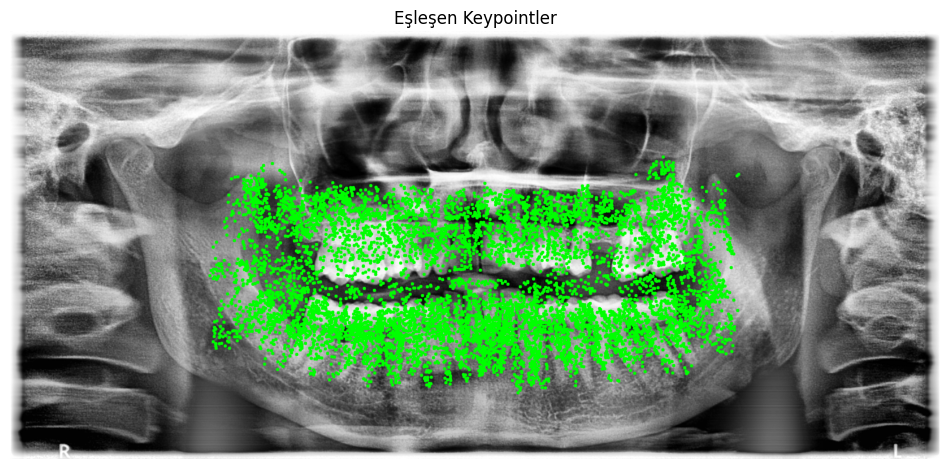

In [ ]:
import numpy as np
import cv2
import pickle
from skimage.feature import greycomatrix, greycoprops
import matplotlib.pyplot as plt

def preprocess_image(image):
    """
    Görüntü ön işleme: Normalizasyon, Gaussian Filtre, CLAHE, Unsharp Masking.

    Args:
        image (ndarray): Giriş görüntüsü.

    Returns:
        ndarray: Ön işlenmiş görüntü.
    """
    # Normalizasyon
    image = cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX)

    # Gaussian Filtre
    image = cv2.GaussianBlur(image, (5, 5), 0)

    # CLAHE
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    image = clahe.apply(image)

    # Unsharp Masking
    blurred = cv2.GaussianBlur(image, (5, 5), 0)
    image = cv2.addWeighted(image, 1.5, blurred, -0.5, 0)

    return image

def detect_teeth_regions(image):
    """
    Test görüntüsünde diş bölgelerini bulur.

    Args:
        image (ndarray): Giriş görüntüsü.

    Returns:
        ndarray: Diş bölgesini içeren maske.
    """
    # Kenar tespiti
    edges = cv2.Canny(image, threshold1=50, threshold2=150)

    # Morfolojik işlemler
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5))
    dilated = cv2.dilate(edges, kernel, iterations=2)
    eroded = cv2.erode(dilated, kernel, iterations=1)

    return eroded

def extract_cohog_features(image, patch, distances=[1], angles=[0, np.pi/2]):
    """
    CoHoG vektörü üretimi için GLCM matrisleri hesaplanır ve istatistiksel özellikler çıkarılır.

    Args:
        image (ndarray): Giriş görüntüsü.
        patch (ndarray): Diş bölgesinden alınan yama.
        distances (list): GLCM için mesafeler.
        angles (list): GLCM için açı değerleri (radyan).

    Returns:
        np.ndarray: CoHoG özellik vektörü.
    """
    features = []
    for angle in angles:
        glcm = greycomatrix(patch, distances=distances, angles=[angle],
                            levels=256, symmetric=True, normed=True)
        # İstatistiksel özellikler
        contrast = greycoprops(glcm, 'contrast').flatten()
        dissimilarity = greycoprops(glcm, 'dissimilarity').flatten()
        homogeneity = greycoprops(glcm, 'homogeneity').flatten()
        energy = greycoprops(glcm, 'energy').flatten()
        correlation = greycoprops(glcm, 'correlation').flatten()

        features.extend([contrast, dissimilarity, homogeneity, energy, correlation])

    return np.concatenate(features).flatten()

def extract_keypoints(image, mask):
    """
    Maskelenmiş görüntü üzerinde SIFT algoritması ile keypoint bulma.

    Args:
        image (ndarray): Giriş görüntüsü.
        mask (ndarray): Diş bölgesi maskesi.

    Returns:
        list: Sadece diş bölgesine ait keypointlerin koordinatları.
    """
    sift = cv2.SIFT_create()
    keypoints = sift.detect(image, None)

    # Sadece maskelenmiş alandaki keypointleri filtrele
    valid_keypoints = [kp for kp in keypoints if mask[int(kp.pt[1]), int(kp.pt[0])] > 0]
    keypoint_coords = [(int(kp.pt[0]), int(kp.pt[1])) for kp in valid_keypoints]

    return keypoint_coords

def test_image(image_path, all_keypoint_coords, glcm_vectors):
    """
    Test görüntüsünde kaydedilmiş tüm keypoint koordinatlarına göre CoHoG özelliklerini çıkar ve karşılaştır.

    Args:
        image_path (str): Test görüntüsünün dosya yolu.
        all_keypoint_coords (list): Tüm kaydedilmiş keypoint koordinatları.
        glcm_vectors (dict): Kaydedilen CoHoG özellik vektörleri.
    """
    # Görüntüyü yükle
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    preprocessed_image = preprocess_image(image)

    # Keypointlere göre yama çıkar ve CoHoG hesapla
    distances = [1]
    angles = [0, np.pi / 2]
    result_image = cv2.cvtColor(preprocessed_image, cv2.COLOR_GRAY2BGR)
    for (x, y) in all_keypoint_coords:
        patch = preprocessed_image[y-8:y+8, x-8:x+8]  # 16x16 yama
        if patch.shape != (16, 16):
            continue  # Yama boyutu uygun değilse atla

        glcm_features = extract_cohog_features(preprocessed_image, patch, distances, angles)

        # Benzerlik karşılaştırması
        best_match = None
        highest_similarity = -1
        for key, vector in glcm_vectors.items():
            similarity = np.dot(glcm_features, vector) / (np.linalg.norm(glcm_features) * np.linalg.norm(vector))
            if similarity > highest_similarity:
                highest_similarity = similarity
                best_match = key

        # Eğer eşleşme bulunduysa işaretle
        if highest_similarity > 0.8:  # Benzerlik eşiği
            cv2.circle(result_image, (x, y), radius=5, color=(0, 255, 0), thickness=-1)

        print(f"Keypoint ({x}, {y}) için en iyi eşleşme: {best_match} (Benzerlik: {highest_similarity})")

    # Görselleştirme
    plt.figure(figsize=(12, 6))
    plt.title("Eşleşen Keypointler")
    plt.imshow(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.show()

def process_images(image_paths, label_paths, output_file):
    """
    Görüntülerden ve etiketlerinden CoHoG özellik vektörlerini üretir ve kaydeder.

    Args:
        image_paths (list): Görüntü dosya yolları.
        label_paths (list): Etiket dosya yolları.
        output_file (str): Çıktı dosyasının yolu (pkl formatında).
    """
    cohog_features = {}
    keypoint_data = {}

    for img_path, lbl_path in zip(image_paths, label_paths):
        image = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
        label = cv2.imread(lbl_path, cv2.IMREAD_GRAYSCALE)

        if image is None or label is None:
            print(f"Dosya yüklenemedi: {img_path} veya {lbl_path}")
            continue

        # Görüntü ön işleme
        preprocessed_image = preprocess_image(image)

        # CoHoG özellikleri
        features = extract_cohog_features(preprocessed_image, label)
        cohog_features[img_path] = features

        # Keypointlerin bulunması
        keypoints = extract_keypoints(preprocessed_image, label)
        keypoint_data[img_path] = keypoints

    with open(output_file, 'wb') as f:
        pickle.dump((cohog_features, keypoint_data), f)
        print(f"Veriler '{output_file}' dosyasına kaydedildi.")

# Görüntü ve label dosya yolları
image_files = ["img2.png", "img3.png", "img9.png"]
label_files = ["label1.png", "label2.png", "label8.png"]

# Çıktı dosyası
output_pkl_file = "cohog_features_and_keypoints.pkl"

# İşlem başlat
process_images(image_files, label_files, output_pkl_file)

# Test işlemi
with open(output_pkl_file, 'rb') as f:
    glcm_vectors, keypoint_data = pickle.load(f)

# Tüm keypoint koordinatlarını birleştir
all_keypoint_coords = []
for coords in keypoint_data.values():
    all_keypoint_coords.extend(coords)

# Test keypointlerini CoHoG ile karşılaştır
test_image("img4.png", all_keypoint_coords, glcm_vectors)


### Ara Deneme GLCM
Bu kısımda ön işleme yapılan görüntülerde label ile çarpıldıktan sonra SIFT ile key pointleri bulunmuş ve buradan alınan patch'ler GLCM matrisini ile kodlanmıştır. Sonuçta görülen eşleşmelerin başarılı bir şekilde gerçekleşmediği için bu yöntemden vazgeçilmiştir.

In [ ]:
import cv2
import numpy as np
from skimage.feature import hog
from skimage.util import view_as_windows
from scipy.ndimage import gaussian_filter
import pickle
import matplotlib.pyplot as plt

def apply_clahe(image):
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    return clahe.apply(image)

def unsharp_mask(image):
    kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
    return cv2.filter2D(image, -1, kernel)

def normalize_image(image):
    return (image - np.min(image)) / (np.max(image) - np.min(image)) * 255

def pipeline_1(image):
    normalized = normalize_image(image)
    gaussian_filtered = gaussian_filter(normalized, sigma=1)
    clahe_applied = apply_clahe(gaussian_filtered.astype(np.uint8))
    sharpened = unsharp_mask(clahe_applied)
    return sharpened

def compute_hog_features(image):
    """
    HoG özellik vektörü oluşturur.

    :param image: Görüntü patchi (2D numpy array)
    :return: HoG özellik vektörü (1D numpy array)
    """
    hog_features = hog(
        image,
        orientations=9,
        pixels_per_cell=(8, 8),
        cells_per_block=(2, 2),
        block_norm='L2-Hys',
        visualize=False,
        feature_vector=True,
        transform_sqrt=True
    )
    return hog_features

# Görüntü ve maske dosyaları
image_label_pairs = [
    ("img6.png", "label5.png"),
    ("img10.png", "label9.png"),
    ("img2.png", "label1.png")
]

# HoG özelliklerini ve koordinatları saklamak için listeler
hog_feature_matrix = []
patch_coordinates = []

# Modelleme işlemi
for image_path, label_path in image_label_pairs:
    # Görüntüyü ve maskeyi yükle
    original_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    preprocessed_image = pipeline_1(original_image)
    mask = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)

    # Maskeyi yeniden boyutlandır
    resized_mask = cv2.resize(mask, (preprocessed_image.shape[1], preprocessed_image.shape[0]))
    resized_mask = resized_mask.astype(np.uint8)

    # Patch çıkarma
    patch_size = (16, 16)
    patches = view_as_windows(preprocessed_image, patch_size, step=patch_size[0])

    for i, row in enumerate(patches):
        for j, patch in enumerate(row):
            # Maskelenmiş alanları seç
            if np.any(resized_mask[i * patch_size[0]:(i + 1) * patch_size[0],
                                   j * patch_size[1]:(j + 1) * patch_size[1]]):
                # HoG hesapla ve kaydet
                hog_vector = compute_hog_features(patch)
                hog_feature_matrix.append(hog_vector)
                patch_coordinates.append((i, j))

# Verileri kaydet
with open("hog_feature_matrix.pkl", "wb") as f:
    pickle.dump(hog_feature_matrix, f)

with open("patch_coordinates.pkl", "wb") as f:
    pickle.dump(patch_coordinates, f)

print(f"Toplam {len(hog_feature_matrix)} HoG vektörü ve {len(patch_coordinates)} koordinat kaydedildi.")


Toplam 7741 HoG vektörü ve 7741 koordinat kaydedildi.


Benzer patch sayısı: 1681


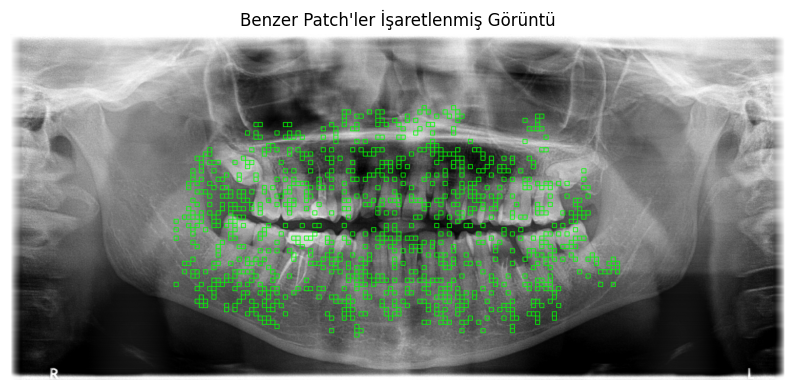

Test tamamlandı.


In [ ]:
import cv2
import numpy as np
from skimage.feature import hog
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter
import pickle

def apply_clahe(image):
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    return clahe.apply(image)

def unsharp_mask(image):
    kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
    return cv2.filter2D(image, -1, kernel)

def normalize_image(image):
    return (image - np.min(image)) / (np.max(image) - np.min(image)) * 255

def pipeline_1(image):
    normalized = normalize_image(image)
    gaussian_filtered = gaussian_filter(normalized, sigma=1)
    clahe_applied = apply_clahe(gaussian_filtered.astype(np.uint8))
    sharpened = unsharp_mask(clahe_applied)
    return sharpened

def compute_hog_features(image):
    """
    HoG özellik vektörü oluşturur.

    :param image: Görüntü patchi (2D numpy array)
    :return: HoG özellik vektörü (1D numpy array)
    """
    hog_features = hog(
        image,
        orientations=9,
        pixels_per_cell=(8, 8),
        cells_per_block=(2, 2),
        block_norm='L2-Hys',
        visualize=False,
        feature_vector=True,
        transform_sqrt=True
    )
    return hog_features

# Benzerlik ölçütleri
def euclidean_distance(vec1, vec2):
    return np.sqrt(np.sum((vec1 - vec2) ** 2))

def cross_correlation(vec1, vec2):
    return np.sum(vec1 * vec2) / (np.sqrt(np.sum(vec1 ** 2)) * np.sqrt(np.sum(vec2 ** 2)))

# Test görüntüsü dosya yolu
test_image_path = "img3.png"

# Test görüntüsünü yükle
test_image = cv2.imread(test_image_path, cv2.IMREAD_GRAYSCALE)
if test_image is None:
    raise FileNotFoundError(f"Test görüntüsü '{test_image_path}' yüklenemedi. Lütfen dosya yolunu kontrol edin.")

# Test görüntüsüne Pipeline 1 uygula
test_image_processed = pipeline_1(test_image)

# Model verilerini yükle
with open("hog_feature_matrix.pkl", "rb") as f:
    model_hog_features = pickle.load(f)

with open("patch_coordinates.pkl", "rb") as f:
    patch_coordinates = pickle.load(f)

# Patch boyutunu tanımla
patch_size = (16, 16)
similar_patches = []
marked_image = cv2.cvtColor(test_image, cv2.COLOR_GRAY2BGR)  # İşaretlemeler için renkli görüntü

# Test görüntüsünden ilgili patchleri çıkar ve karşılaştır
for (i, j) in patch_coordinates:
    patch = test_image_processed[i * patch_size[0]:(i + 1) * patch_size[0],
                                  j * patch_size[1]:(j + 1) * patch_size[1]]
    if patch.shape != (16, 16):  # Eğer patch boyutu uygun değilse atla
        continue
    patch_hog = compute_hog_features(patch)

    for model_hog in model_hog_features:
        # Benzerlik ölçütlerini hesapla
        distance = euclidean_distance(patch_hog, model_hog)
        correlation = cross_correlation(patch_hog, model_hog)

        # Öklidyen Mesafe ve Çapraz Korelasyon ile filtrele
        if distance < 0.3 and correlation > 0.6:  # Eşik değerler
            similar_patches.append((i, j))
            # İşaretleme: Görüntü üzerinde dikdörtgen çiz
            start_point = (j * patch_size[1], i * patch_size[0])
            end_point = ((j + 1) * patch_size[1], (i + 1) * patch_size[0])
            cv2.rectangle(marked_image, start_point, end_point, (0, 255, 0), 2)
            break

# Sonuçları yazdır ve işaretlenmiş görüntüyü göster
print(f"Benzer patch sayısı: {len(similar_patches)}")

# İşaretlenmiş görüntüyü görselleştir
plt.figure(figsize=(10, 10))
plt.title("Benzer Patch'ler İşaretlenmiş Görüntü")
plt.imshow(cv2.cvtColor(marked_image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

print("Test tamamlandı.")


### LBP+HOG


In [ ]:


import cv2
import numpy as np
import pickle
from skimage.feature import local_binary_pattern, hog

# Normalizasyon
def normalize_image(image):
    return cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX)

# Gaussian Filtre uygulaması
def apply_gaussian_filter(image, kernel_size=(5, 5)):
    return cv2.GaussianBlur(image, kernel_size, 0)

# CLAHE uygulaması
def apply_clahe(image, clip_limit=2.0, tile_grid_size=(8, 8)):
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
    return clahe.apply(image)

# Unsharp Masking uygulaması
def apply_unsharp_mask(image, strength=1.5, smooth=1.0):
    blurred = cv2.GaussianBlur(image, (9, 9), smooth)
    return cv2.addWeighted(image, strength, blurred, -smooth, 0)

# LBP parametreleri
def apply_lbp(image, radius=3, n_points=8 * 3):
    return local_binary_pattern(image, n_points, radius, method="uniform")

# Görüntüyü oku ve gri tonlamaya çevir
def read_and_preprocess_image(image_path):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    if image is None:
        raise ValueError(f"{image_path} yüklenemedi!")
    return image

# Görüntü maskeleme
def mask_image(image, label):
    masked = cv2.bitwise_and(image, image, mask=label)
    return masked

# HoG özelliği çıkarımı
def extract_hog_features(image, pixels_per_cell=(8, 8), cells_per_block=(2, 2)):
    features = hog(
        image,
        pixels_per_cell=pixels_per_cell,
        cells_per_block=cells_per_block,
        visualize=False
    )
    return features

# Görüntü yolları
image_paths = ["img2.png", "img3.png", "img9.png"]
label_paths = ["label1.png", "label2.png", "label8.png"]

# HoG vektörlerini saklamak için liste
hog_vectors = []

# Her bir görüntü üzerinde işlemleri gerçekleştir
for img_path, lbl_path in zip(image_paths, label_paths):
    # Görüntüleri yükle
    image = read_and_preprocess_image(img_path)
    label = read_and_preprocess_image(lbl_path)

    # Ön işleme: Normalizasyon -> Gaussian Filtre -> CLAHE -> Unsharp Masking
    image = normalize_image(image)
    image = apply_gaussian_filter(image)
    image = apply_clahe(image)
    image = apply_unsharp_mask(image)

    # LBP uygula
    lbp_image = apply_lbp(image)

    # Maskeleme yap
    masked_image = mask_image(lbp_image, label)

    # Diş üzerindeki pikselleri doğrula
    if np.sum(label) == 0:
        raise ValueError(f"Label {lbl_path} diş bölgesi içermiyor!")

    # HoG özelliklerini çıkar
    hog_features = extract_hog_features(masked_image)
    hog_vectors.append(hog_features)

# Vektörleri .pkl dosyasına kaydet
output_path = "hog_vectors.pkl"
with open(output_path, "wb") as f:
    pickle.dump(hog_vectors, f)

print(f"HoG vektörleri {output_path} dosyasına kaydedildi!")


HoG vektörleri hog_vectors.pkl dosyasına kaydedildi!


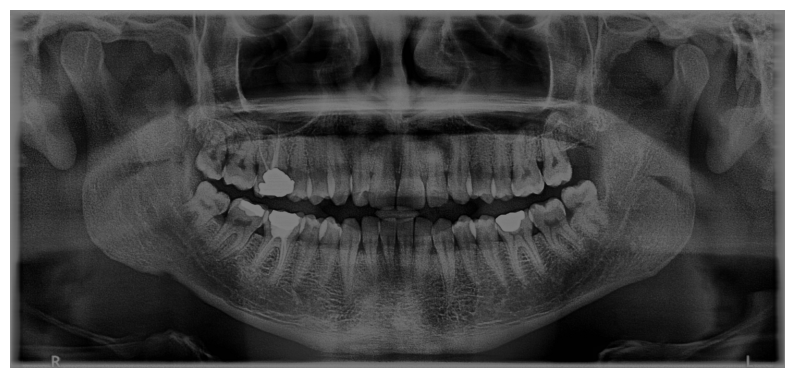

In [ ]:
import cv2
import numpy as np
import pickle
import matplotlib.pyplot as plt
from skimage.feature import local_binary_pattern, hog

# Normalizasyon
def normalize_image(image):
    return cv2.normalize(image, None, 0, 255, cv2.NORM_MINMAX)

# Gaussian Filtre uygulaması
def apply_gaussian_filter(image, kernel_size=(5, 5)):
    return cv2.GaussianBlur(image, kernel_size, 0)

# CLAHE uygulaması
def apply_clahe(image, clip_limit=2.0, tile_grid_size=(8, 8)):
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
    return clahe.apply(image)

# Unsharp Masking uygulaması
def apply_unsharp_mask(image, strength=1.5, smooth=1.0):
    blurred = cv2.GaussianBlur(image, (9, 9), smooth)
    return cv2.addWeighted(image, strength, blurred, -smooth, 0)

# LBP parametreleri
def apply_lbp(image, radius=3, n_points=8 * 3):
    return local_binary_pattern(image, n_points, radius, method="uniform")

# Görüntüyü oku ve gri tonlamaya çevir
def read_and_preprocess_image(image_path):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    if image is None:
        raise ValueError(f"{image_path} yüklenemedi!")
    return image

# HoG özelliği çıkarımı
def extract_hog_features(image, pixels_per_cell=(8, 8), cells_per_block=(2, 2)):
    if image.shape[0] < 16 or image.shape[1] < 16:
        raise ValueError("Giriş görüntüsü çok küçük. HoG için minimum 16x16 boyutunda olmalıdır.")
    features, _ = hog(
        image,
        pixels_per_cell=pixels_per_cell,
        cells_per_block=cells_per_block,
        visualize=True,
        feature_vector=True
    )
    return features

# Modelleme aşamasında bulunan pikselleri çıkar
with open("hog_vectors.pkl", "rb") as f:
    modeled_hog_vectors = pickle.load(f)

# Tek bir test görüntüsü yolu
test_img_path = "img2.png"

# Test aşamasını gerçekleştirme
# Görüntüyü yükle ve ön işlemleri uygula
test_image = read_and_preprocess_image(test_img_path)
test_image = normalize_image(test_image)
test_image = apply_gaussian_filter(test_image)
test_image = apply_clahe(test_image)
test_image = apply_unsharp_mask(test_image)

# LBP uygula
lbp_test_image = apply_lbp(test_image)

# Her piksel için HoG özelliklerini çıkar
test_hog_features = []
patch_size = 16  # Minimum boyut kontrolü için
for i in range(0, lbp_test_image.shape[0] - patch_size + 1, 8):
    for j in range(0, lbp_test_image.shape[1] - patch_size + 1, 8):
        patch = lbp_test_image[i:i + patch_size, j:j + patch_size]
        hog_feature = extract_hog_features(patch)
        test_hog_features.append((hog_feature, (i, j)))

# Eşleşen noktaları bul ve işaretle
matching_points = []
for hog_feature, coord in test_hog_features:
    for model_hog in modeled_hog_vectors:
        if hog_feature.shape == model_hog.shape:  # Boyut kontrolü
            similarity = np.linalg.norm(hog_feature - model_hog)
            if similarity < 0.5:  # Eşik değeri
                matching_points.append(coord)
                break

# Test görüntüsü üzerinde işaretle
marked_image = cv2.cvtColor(test_image, cv2.COLOR_GRAY2BGR)
for y, x in matching_points:
    cv2.circle(marked_image, (x + patch_size // 2, y + patch_size // 2), 3, (0, 255, 0), -1)

# Sonuç görüntüsünü göster
plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(marked_image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()


### LBP+GLCM

In [ ]:
import cv2
import numpy as np
import pickle
from skimage.feature import local_binary_pattern, greycomatrix, greycoprops
from skimage.io import imread
from skimage.transform import resize
import os

# Dosya yolları
data_folder = ""
images = ["img2.png", "img3.png", "img9.png"]
labels = ["label1.png", "label2.png", "label8.png"]

# Parametreler
lbp_radius = 1
lbp_points = 8 * lbp_radius
glcm_distances = [1]
glcm_angles = [0, np.pi/4, np.pi/2, 3*np.pi/4]
output_file = "output_vectors.pkl"

# Sonuçları saklamak için listeler
result_vectors = []
keypoints_coordinates = []

for img_name, label_name in zip(images, labels):
    # Görüntü ve etiket yükleme
    img_path = os.path.join(data_folder, img_name)
    label_path = os.path.join(data_folder, label_name)
    img = imread(img_path, as_gray=True)
    label = imread(label_path, as_gray=True)

    # Etiketi görüntü boyutuna yeniden boyutlandırma
    label_resized = resize(label, img.shape, anti_aliasing=True)

    # Normalizasyon
    img_normalized = cv2.normalize(img, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    # Gaussian Filtre
    img_gaussian = cv2.GaussianBlur(img_normalized, (5, 5), 0)

    # CLAHE
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    img_clahe = clahe.apply(img_gaussian)

    # Unsharp Masking
    gaussian_blurred = cv2.GaussianBlur(img_clahe, (9, 9), 10.0)
    img_unsharp = cv2.addWeighted(img_clahe, 1.5, gaussian_blurred, -0.5, 0)

    # LBP hesaplama
    lbp_image = local_binary_pattern(img_unsharp, lbp_points, lbp_radius, method="uniform")

    # Label maskesi oluşturma
    mask = label_resized > 0.5
    lbp_masked = lbp_image * mask

    # SIFT ile anahtar noktaları bulma
    sift = cv2.SIFT_create()
    keypoints, _ = sift.detectAndCompute((img_unsharp * mask).astype(np.uint8), None)

    # Anahtar noktaların koordinatlarını kaydetme
    keypoints_coords = [(int(kp.pt[0]), int(kp.pt[1])) for kp in keypoints if mask[int(kp.pt[1]), int(kp.pt[0])]]
    keypoints_coordinates.append({"image": img_name, "keypoints": keypoints_coords})

    # GLCM hesaplama
    glcm = greycomatrix((lbp_masked * 255).astype(np.uint8),
                        distances=glcm_distances,
                        angles=glcm_angles,
                        levels=256,
                        symmetric=True,
                        normed=True)

    # GLCM özellikleri çıkarma
    glcm_features = {
        "contrast": greycoprops(glcm, "contrast").mean(),
        "dissimilarity": greycoprops(glcm, "dissimilarity").mean(),
        "homogeneity": greycoprops(glcm, "homogeneity").mean(),
        "energy": greycoprops(glcm, "energy").mean(),
        "correlation": greycoprops(glcm, "correlation").mean()
    }

    result_vectors.append({"image": img_name, "features": glcm_features})

# Sonuçları kaydetme
with open(output_file, "wb") as f:
    pickle.dump({"vectors": result_vectors, "keypoints": keypoints_coordinates}, f)

print(f"Sonuçlar {output_file} dosyasına kaydedildi.")


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

Sonuçlar output_vectors.pkl dosyasına kaydedildi.


/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

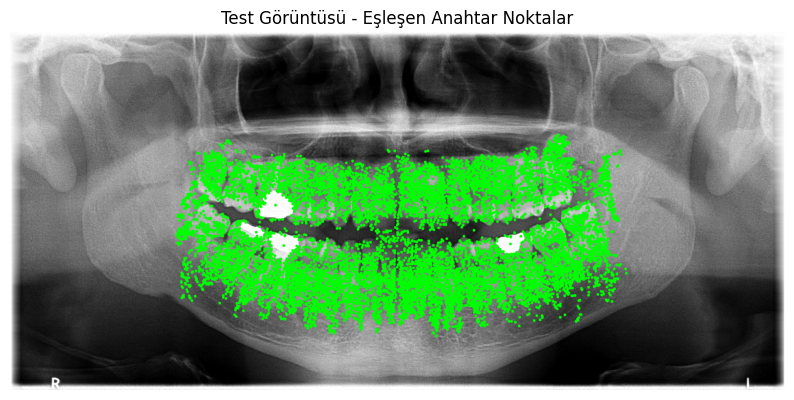

Sonuçlar output_vectors.pkl dosyasına ve test çıktısı test_output.png olarak kaydedildi.


In [ ]:
import cv2
import numpy as np
import pickle
from skimage.feature import local_binary_pattern, greycomatrix, greycoprops
from skimage.io import imread
from skimage.transform import resize
import matplotlib.pyplot as plt
import os

# Dosya yolları
data_folder = ""
images = ["img2.png", "img3.png", "img9.png"]
labels = ["label1.png", "label2.png", "label8.png"]
test_image = "img2.png"
test_output_file = "test_output.png"

# Parametreler
lbp_radius = 1
lbp_points = 8 * lbp_radius
glcm_distances = [1]
glcm_angles = [0, np.pi/4, np.pi/2, 3*np.pi/4]
output_file = "output_vectors.pkl"

# Sonuçları saklamak için listeler
result_vectors = []
keypoints_coordinates = []

for img_name, label_name in zip(images, labels):
    # Görüntü ve etiket yükleme
    img_path = os.path.join(data_folder, img_name)
    label_path = os.path.join(data_folder, label_name)
    img = imread(img_path, as_gray=True)
    label = imread(label_path, as_gray=True)

    # Etiketi görüntü boyutuna yeniden boyutlandırma
    label_resized = resize(label, img.shape, anti_aliasing=True)

    # Normalizasyon
    img_normalized = cv2.normalize(img, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    # Gaussian Filtre
    img_gaussian = cv2.GaussianBlur(img_normalized, (5, 5), 0)

    # CLAHE
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    img_clahe = clahe.apply(img_gaussian)

    # Unsharp Masking
    gaussian_blurred = cv2.GaussianBlur(img_clahe, (9, 9), 10.0)
    img_unsharp = cv2.addWeighted(img_clahe, 1.5, gaussian_blurred, -0.5, 0)

    # LBP hesaplama
    lbp_image = local_binary_pattern(img_unsharp, lbp_points, lbp_radius, method="uniform")

    # Label maskesi oluşturma
    mask = label_resized > 0.5
    lbp_masked = lbp_image * mask

    # SIFT ile anahtar noktaları bulma
    sift = cv2.SIFT_create()
    keypoints, _ = sift.detectAndCompute((img_unsharp * mask).astype(np.uint8), None)

    # Anahtar noktaların koordinatlarını kaydetme
    keypoints_coords = [(int(kp.pt[0]), int(kp.pt[1])) for kp in keypoints if mask[int(kp.pt[1]), int(kp.pt[0])]]
    keypoints_coordinates.append({"image": img_name, "keypoints": keypoints_coords})

    # GLCM hesaplama
    glcm = greycomatrix((lbp_masked * 255).astype(np.uint8),
                        distances=glcm_distances,
                        angles=glcm_angles,
                        levels=256,
                        symmetric=True,
                        normed=True)

    # GLCM özellikleri çıkarma
    glcm_features = {
        "contrast": greycoprops(glcm, "contrast").mean(),
        "dissimilarity": greycoprops(glcm, "dissimilarity").mean(),
        "homogeneity": greycoprops(glcm, "homogeneity").mean(),
        "energy": greycoprops(glcm, "energy").mean(),
        "correlation": greycoprops(glcm, "correlation").mean()
    }

    result_vectors.append({"image": img_name, "features": glcm_features})

# Test görüntüsü işleme
test_img = imread(os.path.join(data_folder, test_image), as_gray=True)
test_img_normalized = cv2.normalize(test_img, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
test_img_gaussian = cv2.GaussianBlur(test_img_normalized, (5, 5), 0)
test_img_clahe = clahe.apply(test_img_gaussian)
test_img_unsharp = cv2.addWeighted(test_img_clahe, 1.5,
                                    cv2.GaussianBlur(test_img_clahe, (9, 9), 10.0), -0.5, 0)

# LBP hesaplama
test_lbp_image = local_binary_pattern(test_img_unsharp, lbp_points, lbp_radius, method="uniform")

# Anahtar noktaları bulma
sift = cv2.SIFT_create()
keypoints_test, _ = sift.detectAndCompute(test_img_unsharp.astype(np.uint8), None)

# Anahtar noktaları eşleme
matched_points = []
for coords in keypoints_coordinates:
    for ref_point in coords["keypoints"]:
        for kp in keypoints_test:
            if abs(kp.pt[0] - ref_point[0]) < 5 and abs(kp.pt[1] - ref_point[1]) < 5:
                matched_points.append((int(kp.pt[0]), int(kp.pt[1])))

# GLCM hesaplama için maskeleme
mask_test = np.zeros_like(test_lbp_image, dtype=bool)
for pt in matched_points:
    mask_test[pt[1], pt[0]] = True
test_glcm = greycomatrix((test_lbp_image * mask_test * 255).astype(np.uint8),
                         distances=glcm_distances,
                         angles=glcm_angles,
                         levels=256,
                         symmetric=True,
                         normed=True)

# Test görüntüsünde eşleşen noktaları işaretleme
output_img = cv2.cvtColor((test_img_normalized).astype(np.uint8), cv2.COLOR_GRAY2BGR)
for pt in matched_points:
    cv2.circle(output_img, pt, 5, (0, 255, 0), -1)

cv2.imwrite(os.path.join(data_folder, test_output_file), output_img)

# Çıktı görüntüsünü gösterme
plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
plt.title("Test Görüntüsü - Eşleşen Anahtar Noktalar")
plt.axis("off")
plt.show()

# Sonuçları kaydetme
with open(output_file, "wb") as f:
    pickle.dump({"vectors": result_vectors, "keypoints": keypoints_coordinates}, f)

print(f"Sonuçlar {output_file} dosyasına ve test çıktısı {test_output_file} olarak kaydedildi.")


In [ ]:
!pip uninstall -y scikit-image
!pip install scikit-image

Found existing installation: scikit-image 0.25.0
Uninstalling scikit-image-0.25.0:
  Successfully uninstalled scikit-image-0.25.0
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.8/14.8 MB 56.1 MB/s eta 0:00:00


In [ ]:
!pip install scikit_image==0.19.3

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.9/13.9 MB 58.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 75.6 MB/s eta 0:00:00
  Attempting uninstall: scikit_image
    Found existing installation: scikit-image 0.25.0
    Uninstalling scikit-image-0.25.0:
      Successfully uninstalled scikit-image-0.25.0
